In [1]:
from IPython import display

import torch
import torchvision

from torch import nn,optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets

import numpy as np
from utils import Logger

In [3]:
transformation = transforms.Compose([transforms.ToTensor(),transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))])

In [4]:
data = datasets.MNIST('./data',train = True, transform = transformation,download = True)

In [5]:
data_loader = torch.utils.data.DataLoader(data,batch_size = 100,shuffle = True)
total_batches = len(data_loader)

In [6]:
# Making the Discriminator Network

class Discriminator_Network(nn.Module):
    
    def __init__(self):
        super().__init__()
        input_size = 784
        output_size = 1
        
        self.hidden_1 = nn.Sequential(nn.Linear(input_size,1024),nn.LeakyReLU(0.2),nn.Dropout(0.3))
        self.hidden_2 = nn.Sequential(nn.Linear(1024,512),nn.LeakyReLU(0.2),nn.Dropout(0.3))
        self.hidden_3 = nn.Sequential(nn.Linear(512,256),nn.LeakyReLU(0.2),nn.Dropout(0.3))
        self.out = nn.Sequential(nn.Linear(256,output_size),nn.Sigmoid())
        
    
    def forward(self,x):
        x = self.hidden_1(x)
        x = self.hidden_2(x)
        x = self.hidden_3(x)
        x = self.out(x)
        return x
        

In [7]:
# Making the Generator Network

class Generator_Network(nn.Module):
    
    def __init__(self):
        super().__init__()
        input_size = 100
        output_size = 784
        
        self.hidden_1 = nn.Sequential(nn.Linear(input_size,256),nn.LeakyReLU(0.2))
        self.hidden_2 = nn.Sequential(nn.Linear(256,512),nn.LeakyReLU(0.2))
        self.hidden_3 = nn.Sequential(nn.Linear(512,1024),nn.LeakyReLU(0.2))
        self.out = nn.Sequential(nn.Linear(1024,output_size),nn.Tanh())
        
    def forward(self,x):
        x = self.hidden_1(x)
        x = self.hidden_2(x)
        x = self.hidden_3(x)
        x = self.out(x)
        return x
        
        

In [8]:
discriminator = Discriminator_Network()
generator = Generator_Network()

In [9]:
# Function to convert image to vectors and vectors to images

def image_to_vec(x):
    return x.view(len(x),784)

def vec_to_image(x):
    return x.view(len(x),1,28,28)

In [10]:
# Noise to feed to Generator Network

def create_noise(size):
    return Variable(torch.randn(size,100))

In [11]:
loss_func = nn.BCELoss()

In [12]:
# Generating ground truth labels

def real_targets(size):
    return Variable(torch.ones(size,1))

def fake_targets(size):
    return Variable(torch.zeros(size,1))


In [13]:
# Training function for Discriminator

def train_discriminator(optimizer,real_images,fake_images):
    
    N = len(real_images)
    optimizer.zero_grad()
    
    preds_real = discriminator(real_images)
    error_real = loss_func(preds_real,real_targets(N))
    error_real.backward()
    
    preds_fake = discriminator(fake_images)
    error_fake = loss_func(preds_fake,fake_targets(N))
    error_fake.backward()
    
    optimizer.step()
    
    total_error = error_real + error_fake
    return total_error,preds_real,preds_fake
    

In [14]:
def train_generator(optimizer,fake_images):
    
    N = len(fake_images)
    optimizer.zero_grad()
    
    preds_fake = discriminator(fake_images)
    error_fake = loss_func(preds_fake,real_targets(N))
    error_fake.backward()
    
    optimizer.step()
    
    return error_fake

In [15]:
# Test Samples
num_test_samples = 16
test_noise = create_noise(num_test_samples)

In [16]:
# Logger Instance

logger = Logger(model_name = 'Vanilla_GAN',data_name='MNIST')

In [17]:
num_epochs = 200

In [18]:
# Creating Optimizers for networks

gen_optim = optim.Adam(generator.parameters(),lr = 0.0002)
disc_optim = optim.Adam(discriminator.parameters(),lr = 0.0002)

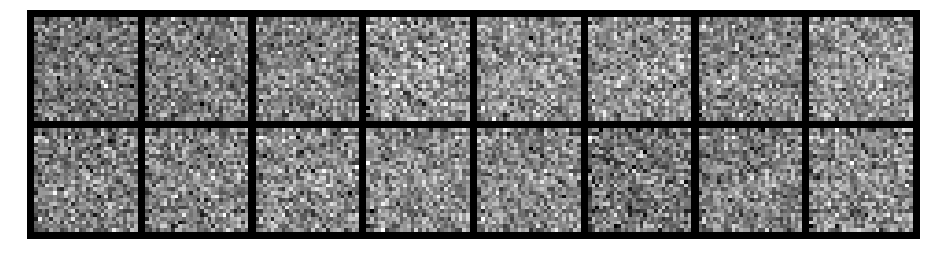

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.3905, Generator Loss: 0.6624
D(x): 0.5144, D(G(z)): 0.5159


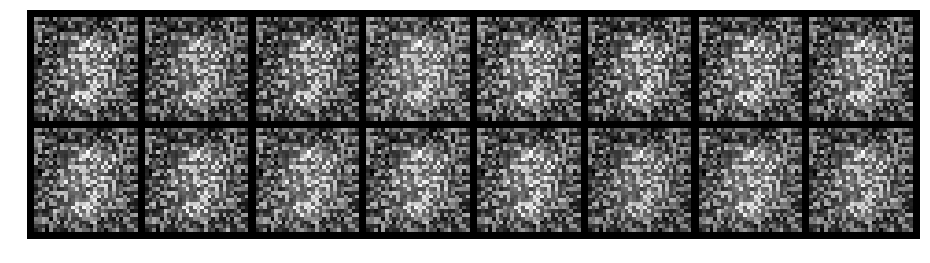

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 0.7077, Generator Loss: 2.3106
D(x): 0.7717, D(G(z)): 0.2550


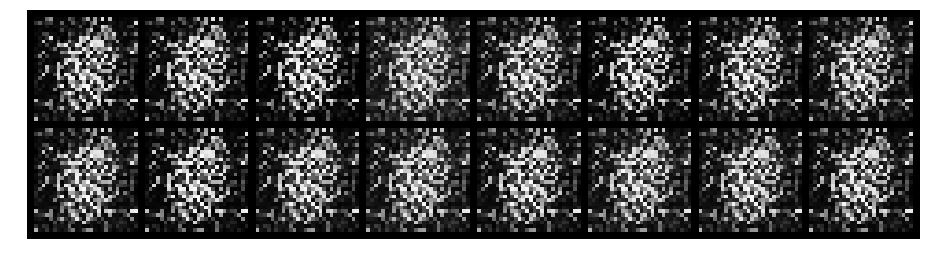

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.2510, Generator Loss: 3.5656
D(x): 0.9603, D(G(z)): 0.1723


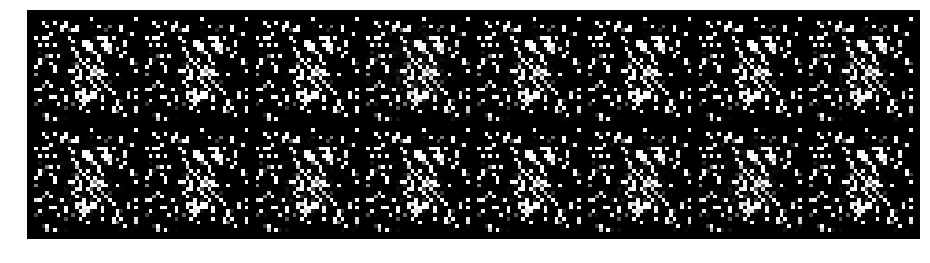

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 0.0497, Generator Loss: 6.1724
D(x): 0.9689, D(G(z)): 0.0116


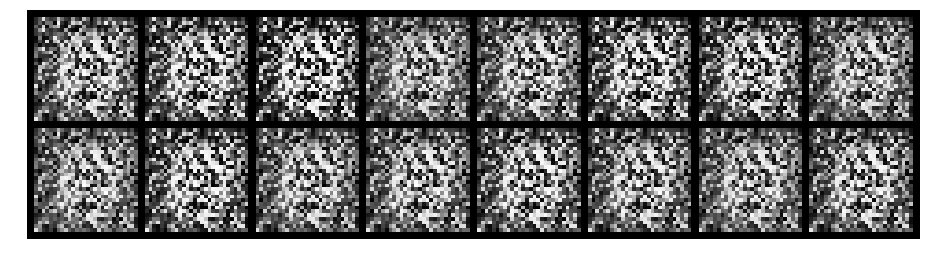

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 0.1068, Generator Loss: 6.4517
D(x): 0.9477, D(G(z)): 0.0409


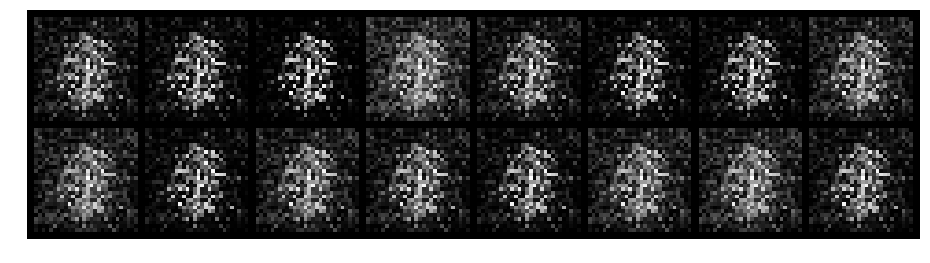

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 0.7210, Generator Loss: 4.5058
D(x): 0.8269, D(G(z)): 0.3143


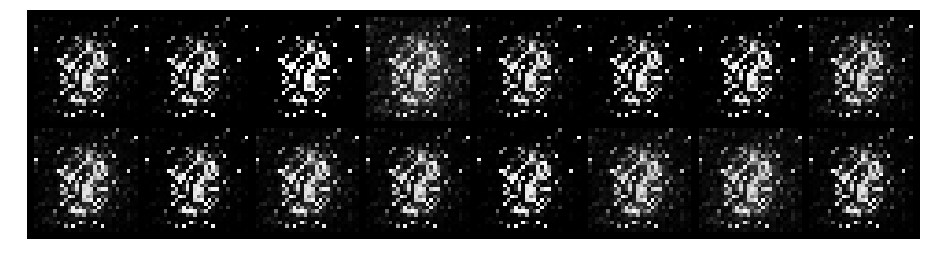

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 0.8116, Generator Loss: 4.6169
D(x): 0.8084, D(G(z)): 0.3147


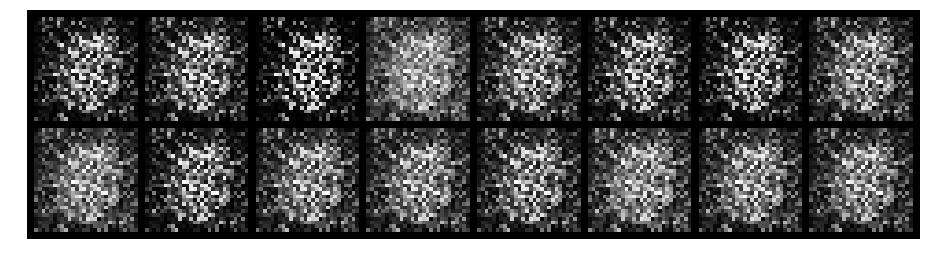

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 0.5147, Generator Loss: 4.7072
D(x): 0.8629, D(G(z)): 0.1949


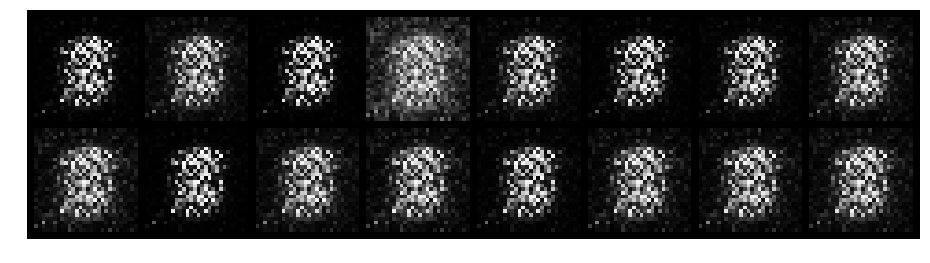

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 0.9908, Generator Loss: 7.0295
D(x): 0.7934, D(G(z)): 0.2593


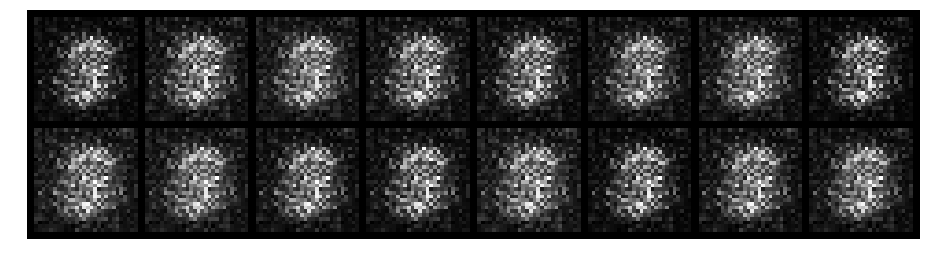

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 0.4271, Generator Loss: 3.7616
D(x): 0.9024, D(G(z)): 0.1995


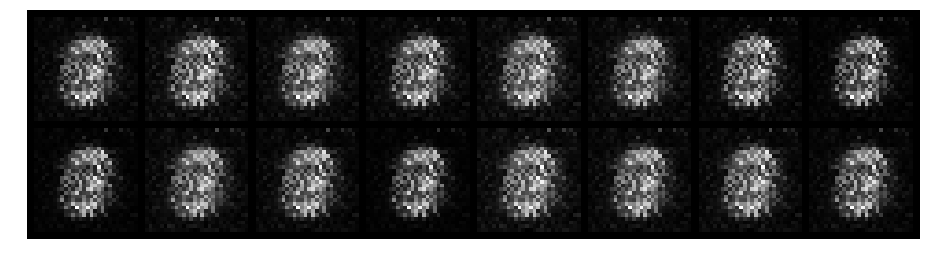

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 1.6680, Generator Loss: 1.7993
D(x): 0.6591, D(G(z)): 0.5109


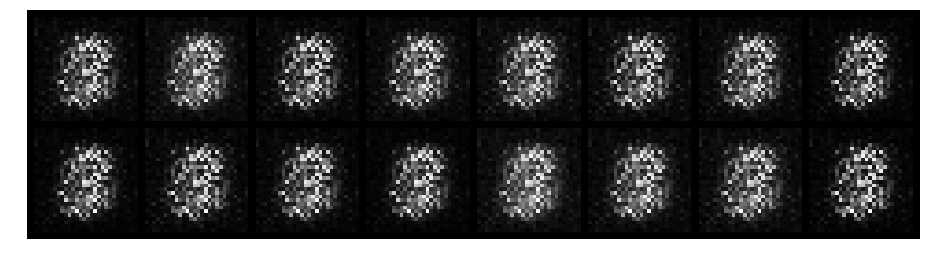

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 0.3875, Generator Loss: 3.0712
D(x): 0.8899, D(G(z)): 0.1516


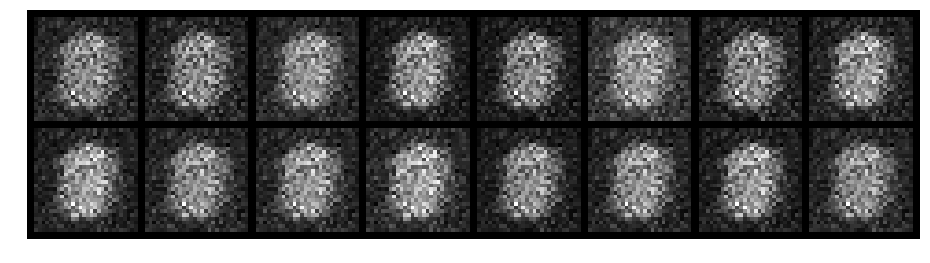

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 0.6559, Generator Loss: 1.4320
D(x): 0.8115, D(G(z)): 0.3092


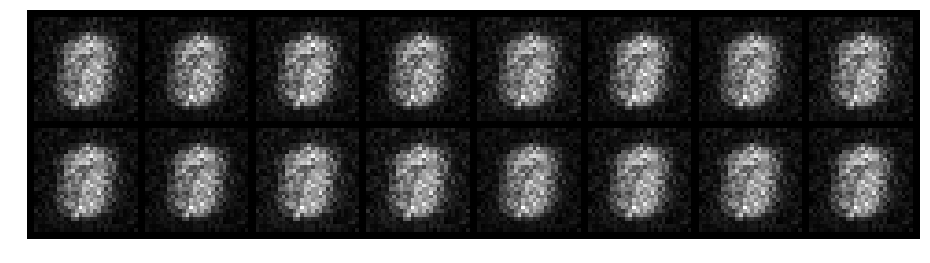

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 0.5956, Generator Loss: 1.5347
D(x): 0.7519, D(G(z)): 0.2150


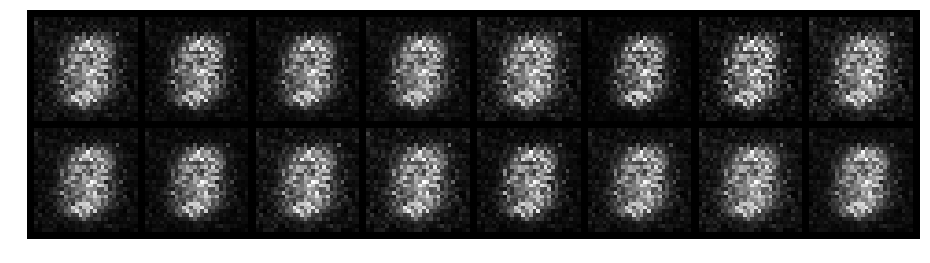

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 0.6867, Generator Loss: 1.8808
D(x): 0.7685, D(G(z)): 0.2631


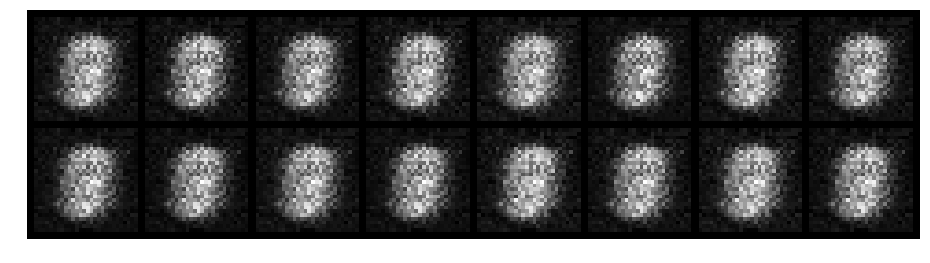

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 0.4868, Generator Loss: 2.4351
D(x): 0.8448, D(G(z)): 0.2256


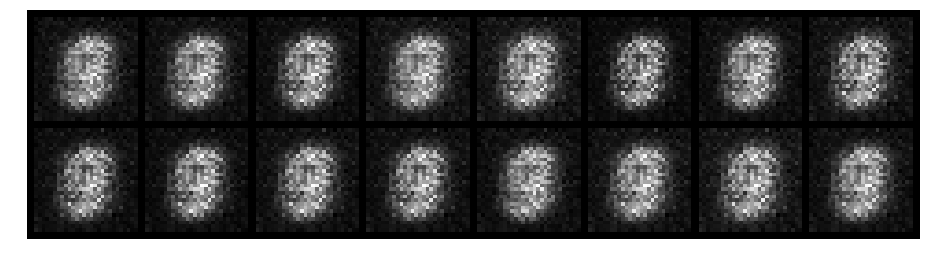

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 0.4973, Generator Loss: 2.2172
D(x): 0.8382, D(G(z)): 0.1389


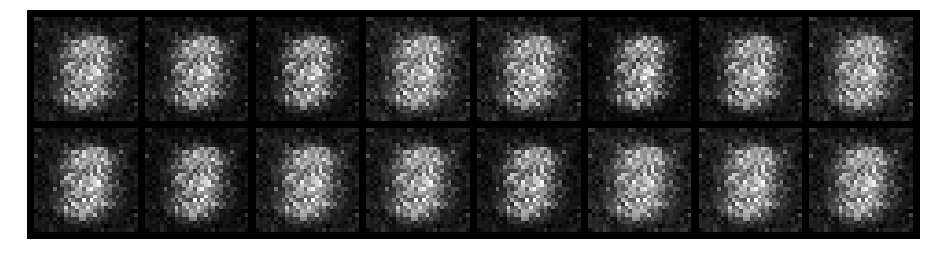

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 0.4630, Generator Loss: 3.2409
D(x): 0.8723, D(G(z)): 0.1712


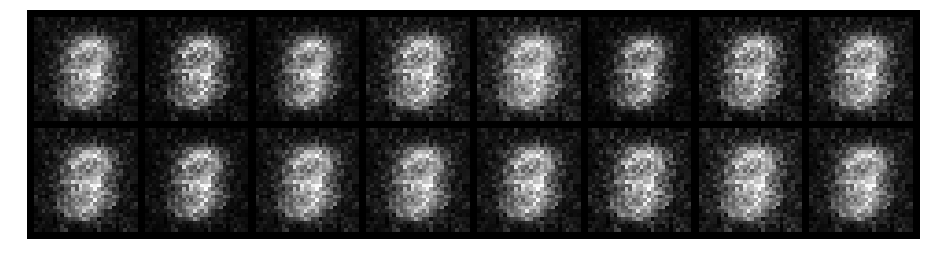

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 0.2445, Generator Loss: 2.3986
D(x): 0.9289, D(G(z)): 0.1236


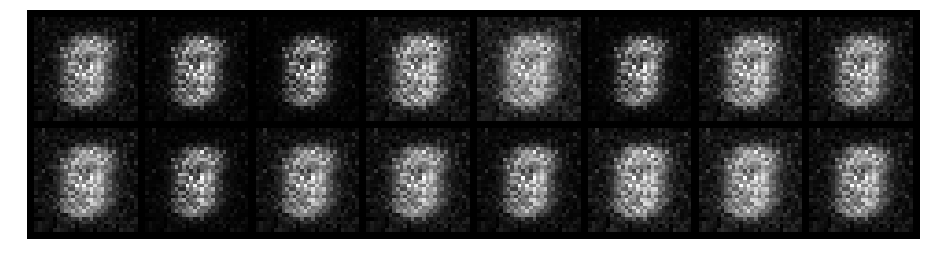

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 0.2675, Generator Loss: 3.8266
D(x): 0.9368, D(G(z)): 0.1204


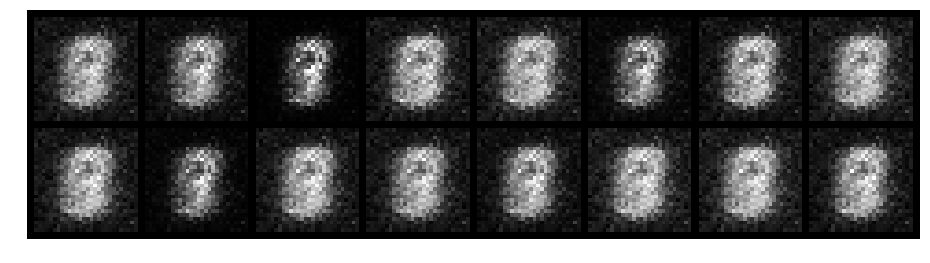

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 0.4485, Generator Loss: 2.8644
D(x): 0.8598, D(G(z)): 0.1471


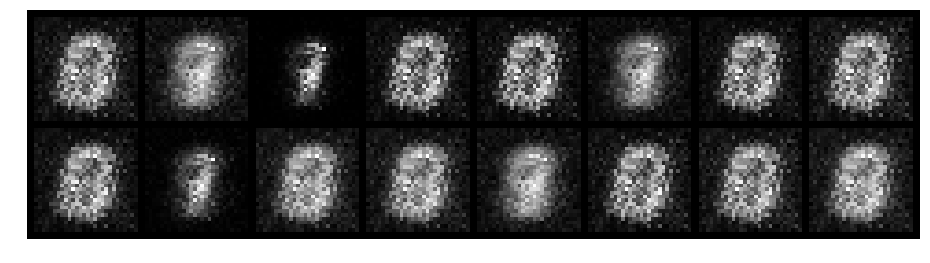

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 0.6874, Generator Loss: 3.6317
D(x): 0.7621, D(G(z)): 0.1360


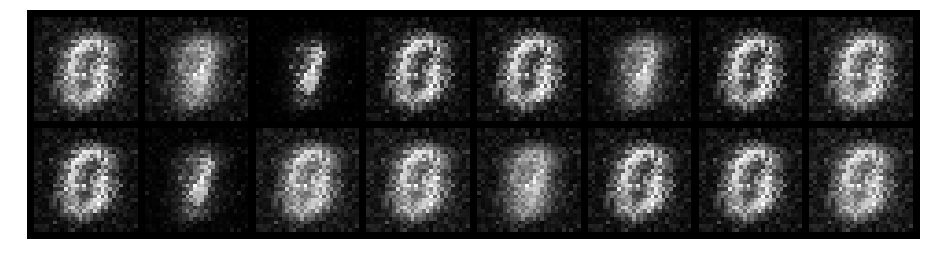

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 0.5090, Generator Loss: 2.8795
D(x): 0.8553, D(G(z)): 0.1816


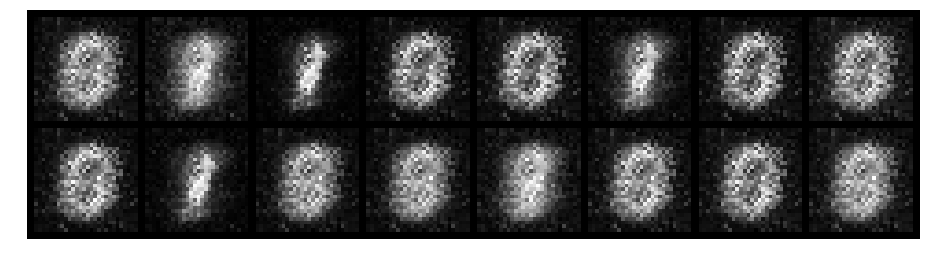

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 0.4366, Generator Loss: 3.1280
D(x): 0.8702, D(G(z)): 0.1313


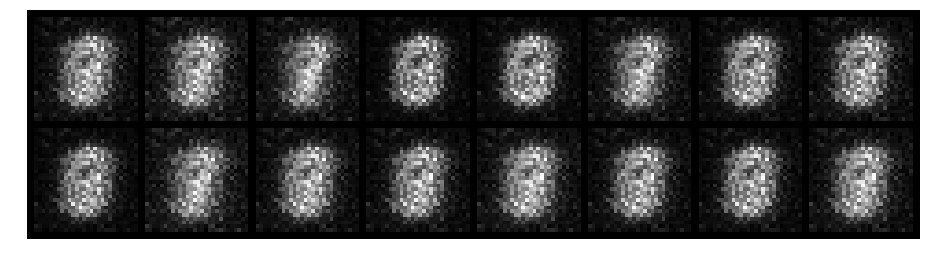

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 0.2618, Generator Loss: 4.3834
D(x): 0.9304, D(G(z)): 0.0640


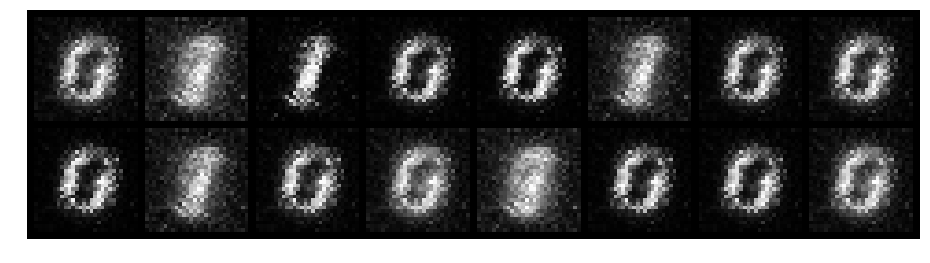

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.7637, Generator Loss: 3.3378
D(x): 0.8523, D(G(z)): 0.2696


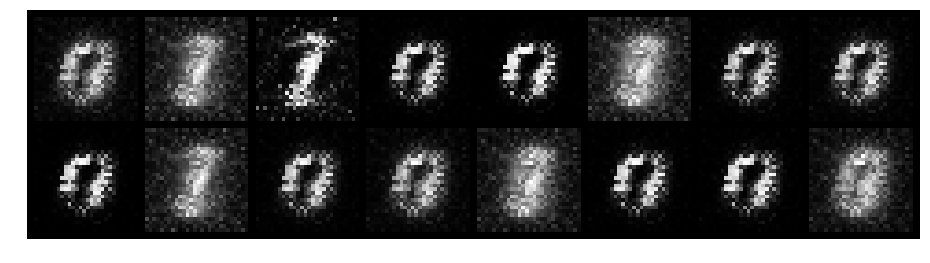

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.4285, Generator Loss: 4.1144
D(x): 0.9434, D(G(z)): 0.1429


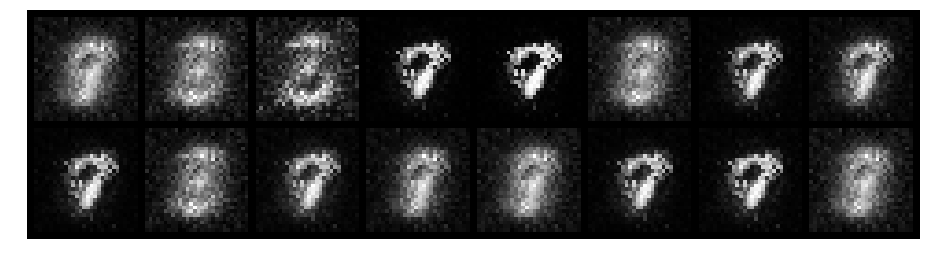

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.5631, Generator Loss: 3.1637
D(x): 0.7971, D(G(z)): 0.1173


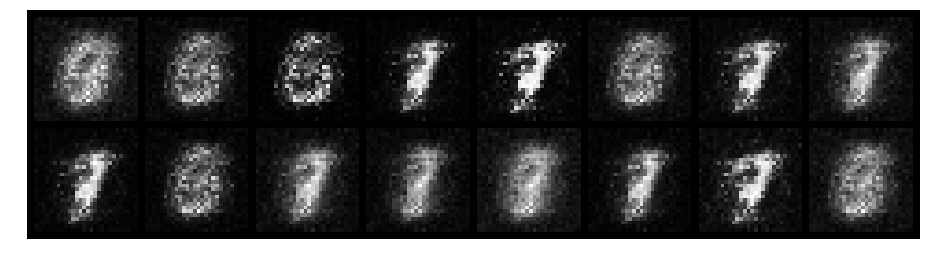

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.6442, Generator Loss: 3.0365
D(x): 0.7916, D(G(z)): 0.1422


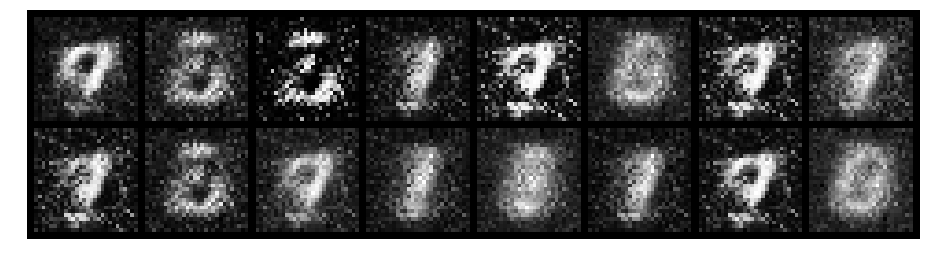

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.4359, Generator Loss: 3.5452
D(x): 0.8798, D(G(z)): 0.1261


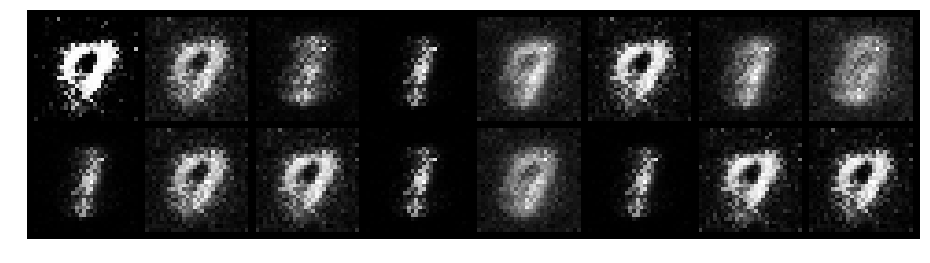

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.4989, Generator Loss: 2.3472
D(x): 0.8982, D(G(z)): 0.1996


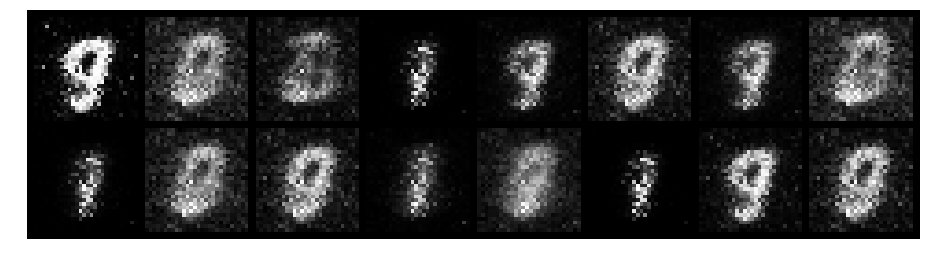

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.1614, Generator Loss: 5.2038
D(x): 0.9126, D(G(z)): 0.0296


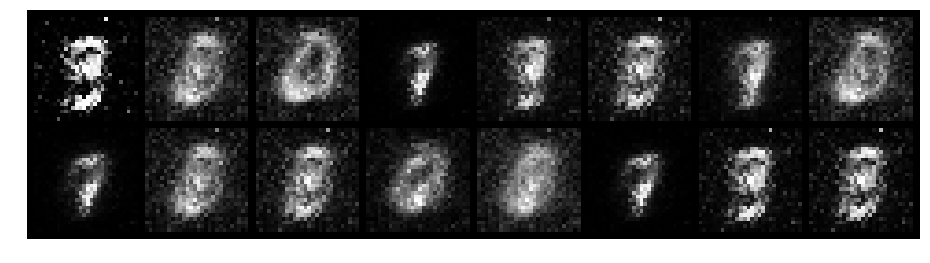

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.3662, Generator Loss: 4.4599
D(x): 0.9009, D(G(z)): 0.1203


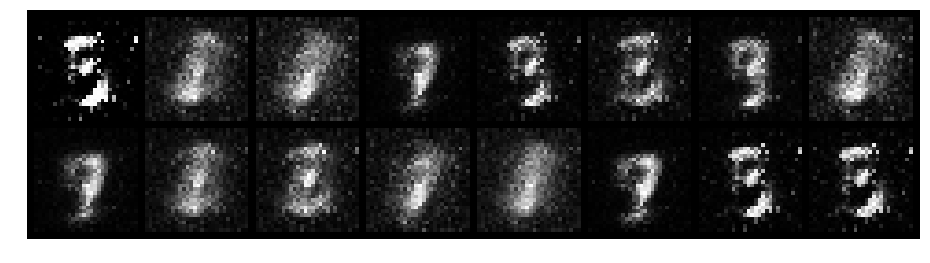

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.3845, Generator Loss: 2.7472
D(x): 0.8780, D(G(z)): 0.1245


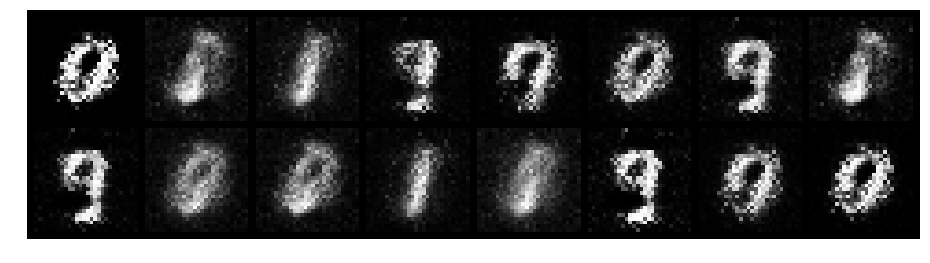

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.6318, Generator Loss: 3.1037
D(x): 0.8434, D(G(z)): 0.1856


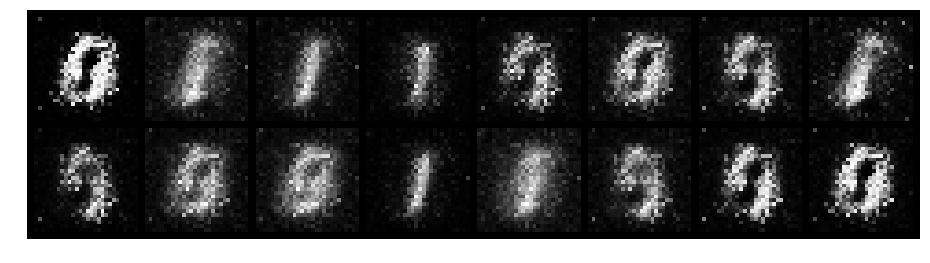

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.3909, Generator Loss: 4.0452
D(x): 0.8554, D(G(z)): 0.0416


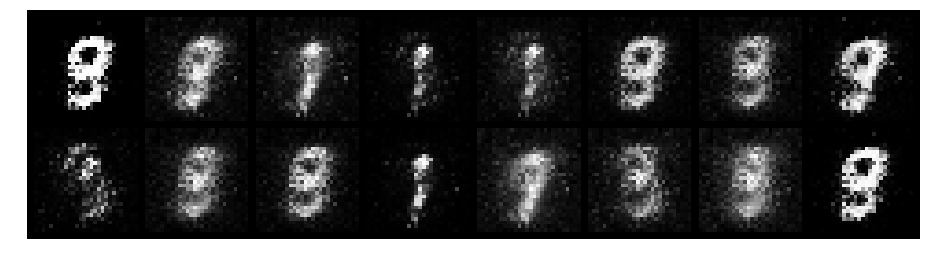

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.2675, Generator Loss: 2.9508
D(x): 0.9510, D(G(z)): 0.1389


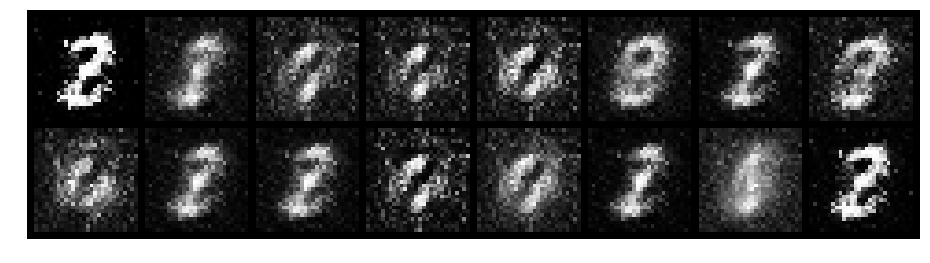

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.4713, Generator Loss: 2.4619
D(x): 0.8893, D(G(z)): 0.1775


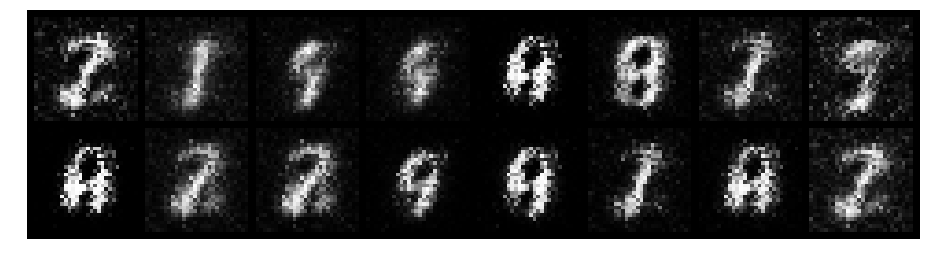

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 0.6296, Generator Loss: 2.7217
D(x): 0.8516, D(G(z)): 0.2177


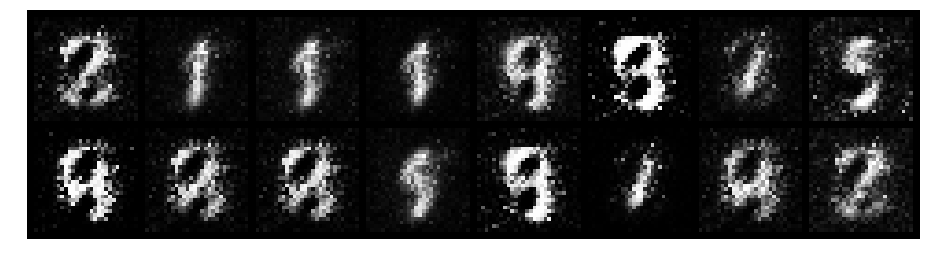

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.4559, Generator Loss: 2.6012
D(x): 0.8580, D(G(z)): 0.1968


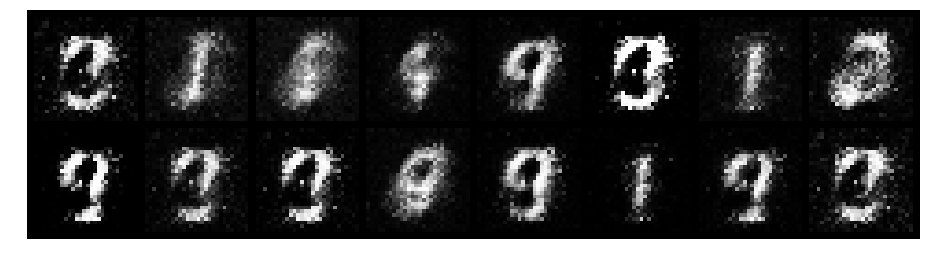

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.6564, Generator Loss: 2.1313
D(x): 0.7974, D(G(z)): 0.1591


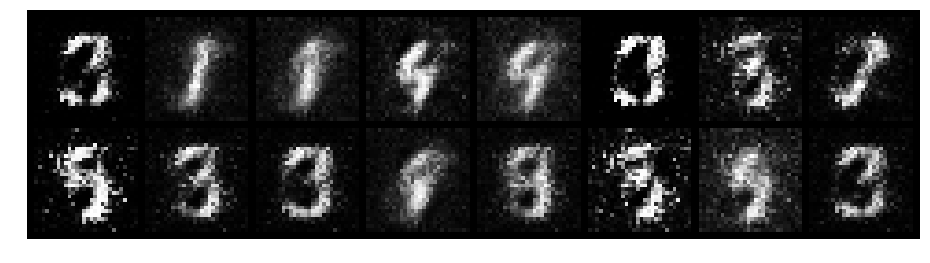

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.5497, Generator Loss: 2.5641
D(x): 0.8657, D(G(z)): 0.1690


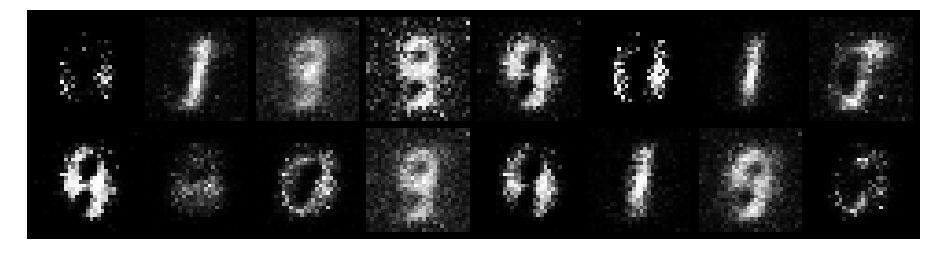

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.6914, Generator Loss: 2.8982
D(x): 0.8341, D(G(z)): 0.2086


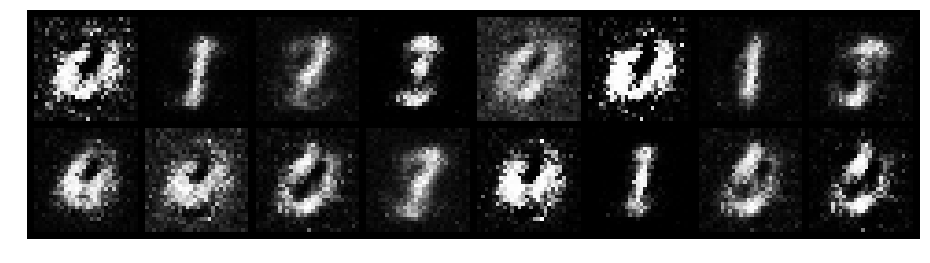

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.6818, Generator Loss: 3.4264
D(x): 0.8321, D(G(z)): 0.1628


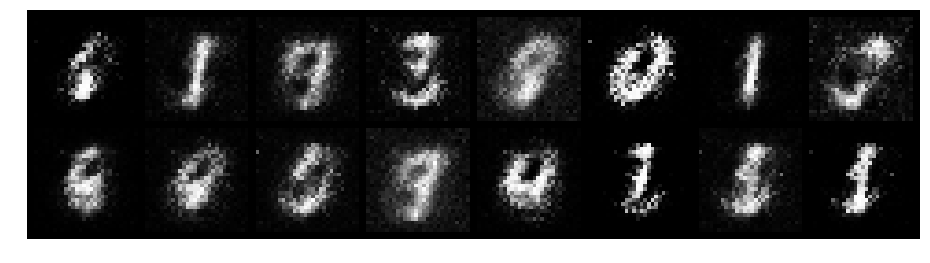

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.4458, Generator Loss: 2.1370
D(x): 0.9145, D(G(z)): 0.2076


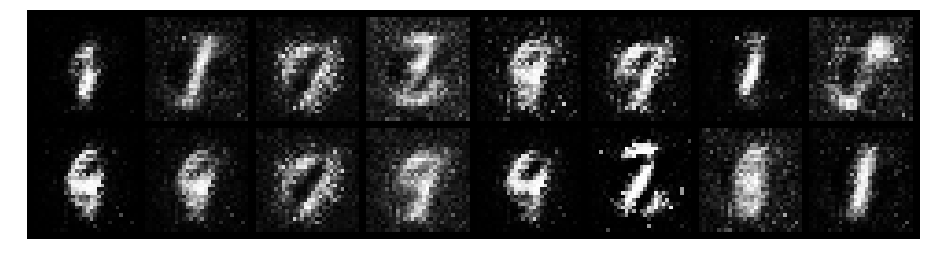

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.4072, Generator Loss: 3.1841
D(x): 0.8761, D(G(z)): 0.1366


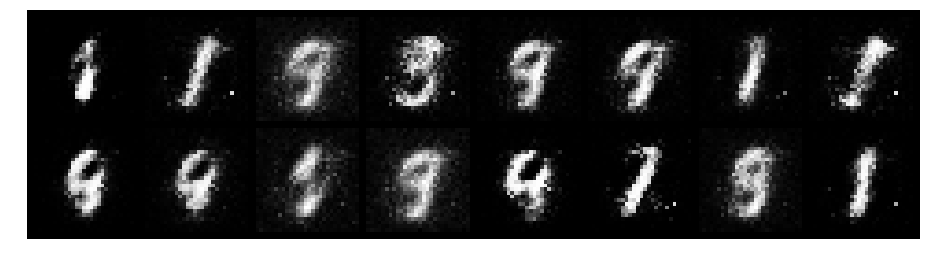

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.5935, Generator Loss: 2.7131
D(x): 0.7940, D(G(z)): 0.1085


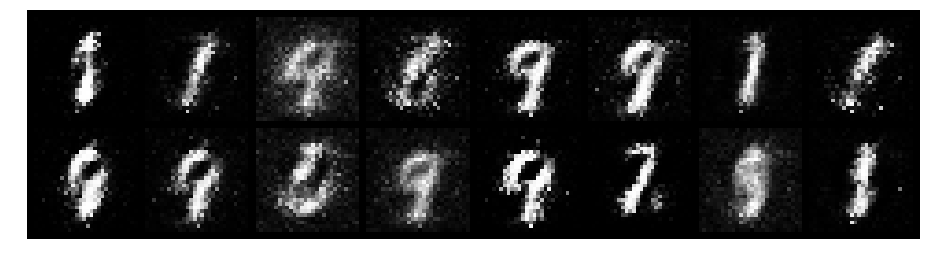

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.4765, Generator Loss: 3.2287
D(x): 0.8749, D(G(z)): 0.1491


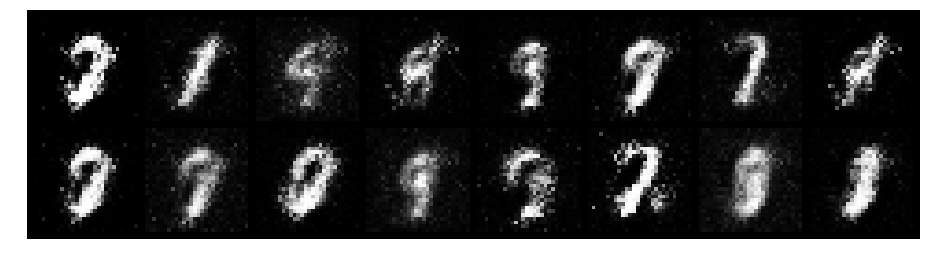

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.8008, Generator Loss: 2.1923
D(x): 0.7230, D(G(z)): 0.1694


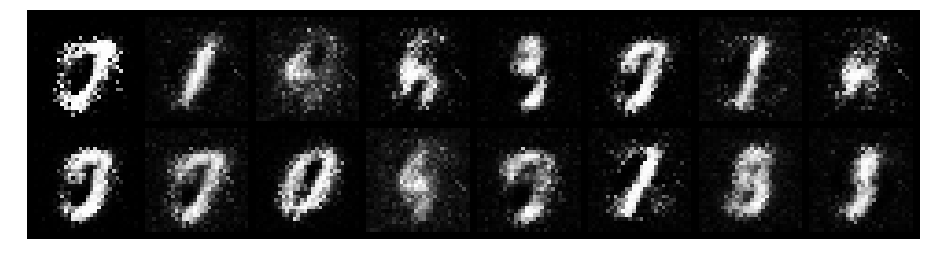

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.4008, Generator Loss: 3.2603
D(x): 0.8252, D(G(z)): 0.0898


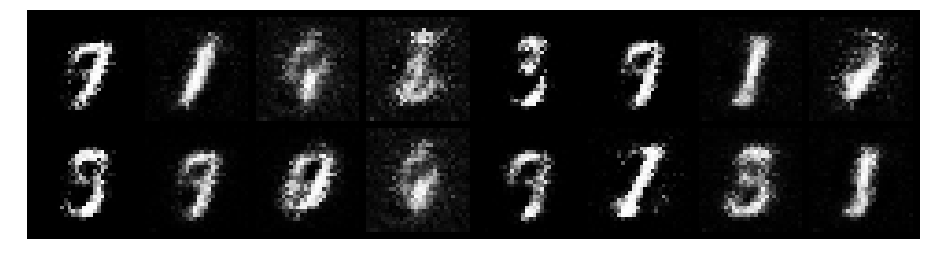

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.3816, Generator Loss: 2.6305
D(x): 0.8812, D(G(z)): 0.1430


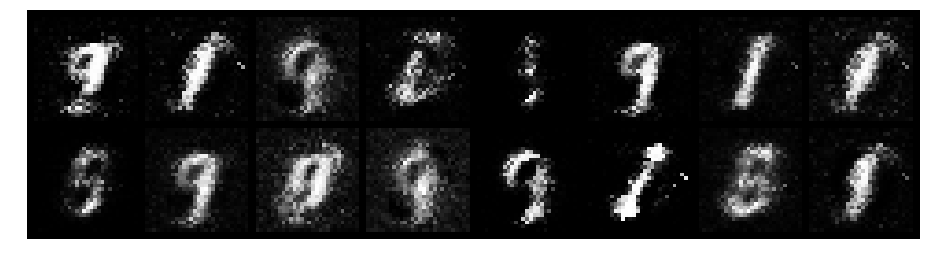

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.4068, Generator Loss: 3.3640
D(x): 0.8523, D(G(z)): 0.1042


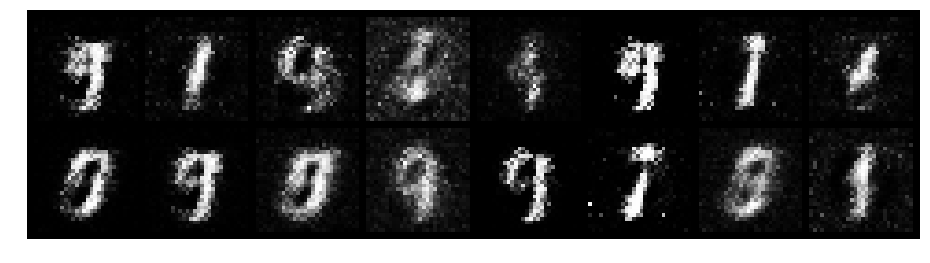

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.5630, Generator Loss: 2.1101
D(x): 0.8545, D(G(z)): 0.2063


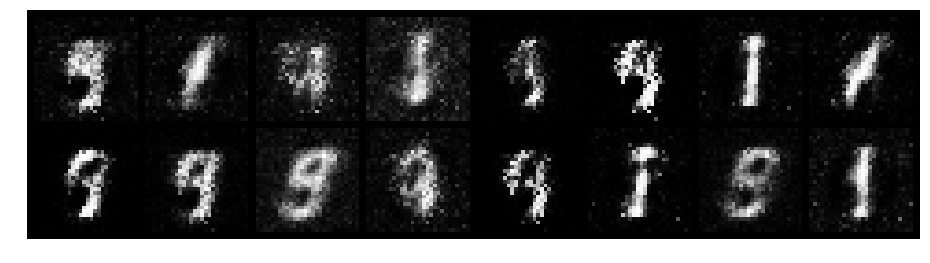

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.3862, Generator Loss: 3.8719
D(x): 0.8536, D(G(z)): 0.1081


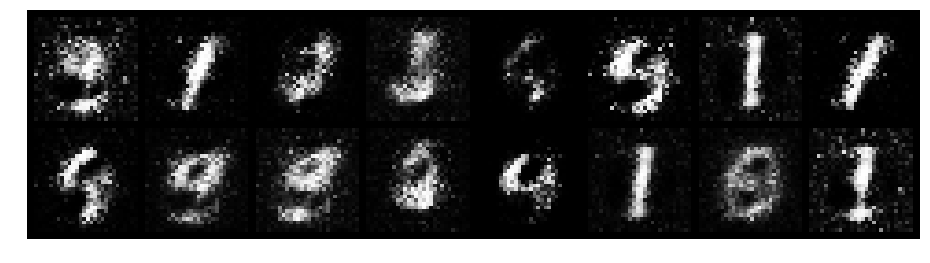

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.6176, Generator Loss: 2.8654
D(x): 0.7752, D(G(z)): 0.1399


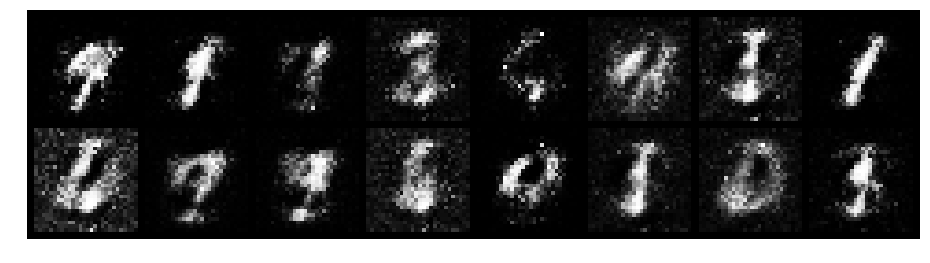

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.7424, Generator Loss: 1.9987
D(x): 0.7892, D(G(z)): 0.2238


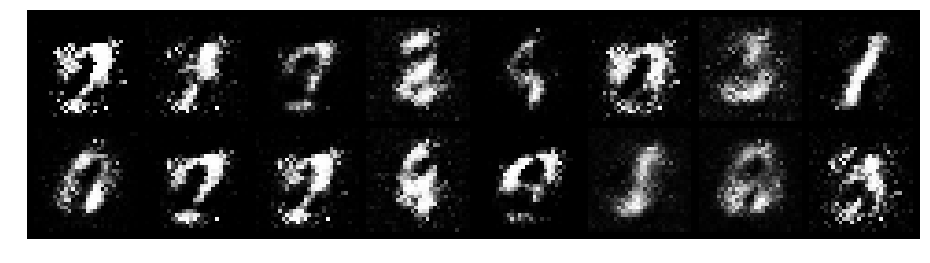

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.6144, Generator Loss: 2.4943
D(x): 0.7932, D(G(z)): 0.2099


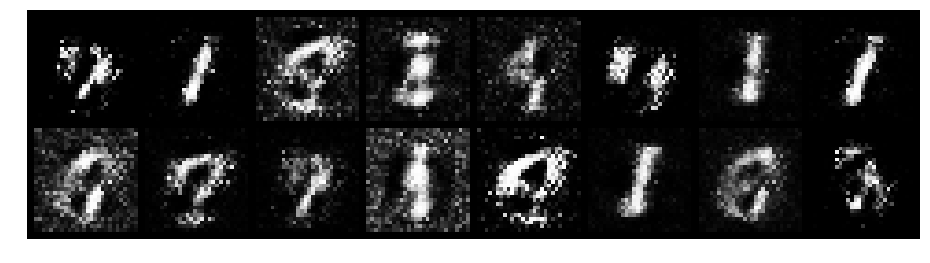

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.5179, Generator Loss: 3.1646
D(x): 0.8314, D(G(z)): 0.1434


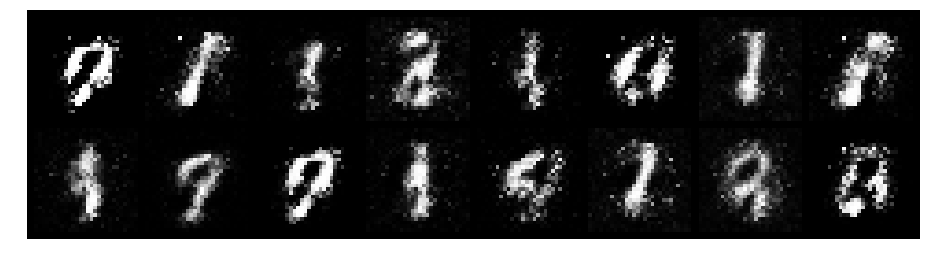

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.5622, Generator Loss: 2.5368
D(x): 0.8309, D(G(z)): 0.2169


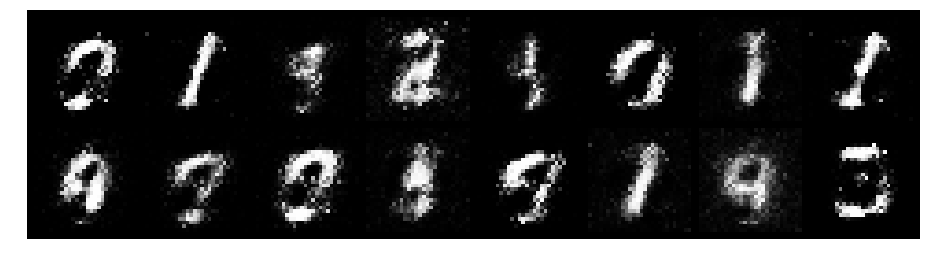

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.6782, Generator Loss: 2.5187
D(x): 0.7036, D(G(z)): 0.1357


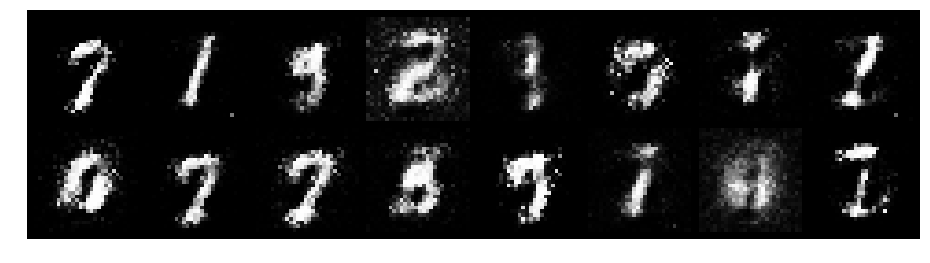

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.6181, Generator Loss: 2.3619
D(x): 0.7342, D(G(z)): 0.0869


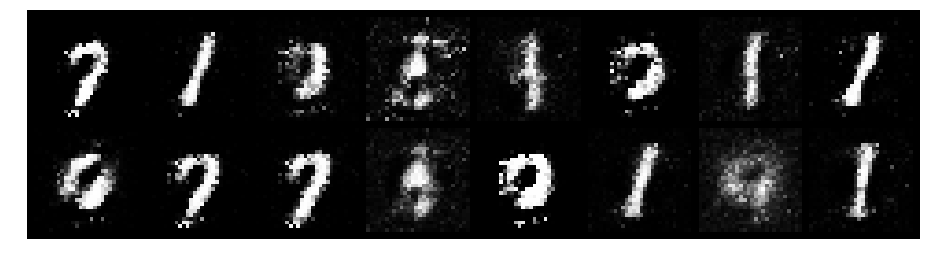

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.8783, Generator Loss: 2.2738
D(x): 0.7391, D(G(z)): 0.2257


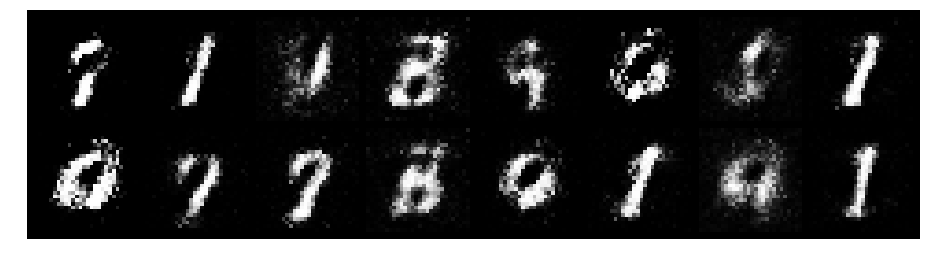

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.5801, Generator Loss: 3.3136
D(x): 0.7859, D(G(z)): 0.1473


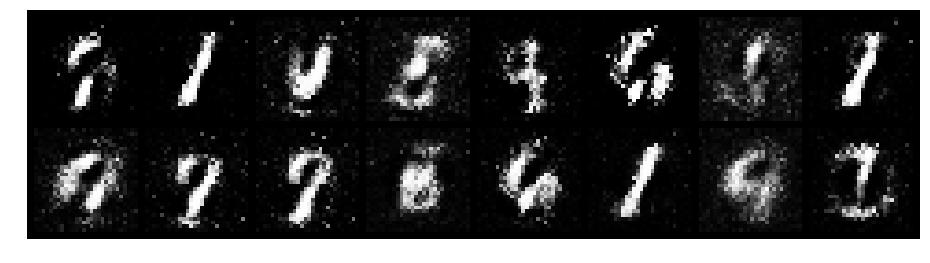

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.6084, Generator Loss: 2.4620
D(x): 0.7513, D(G(z)): 0.1551


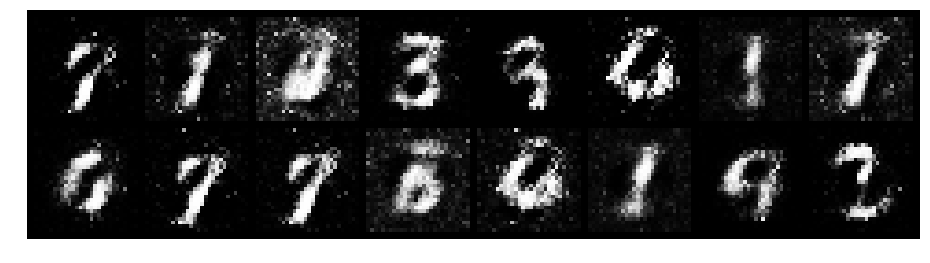

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.5271, Generator Loss: 3.1827
D(x): 0.8263, D(G(z)): 0.1632


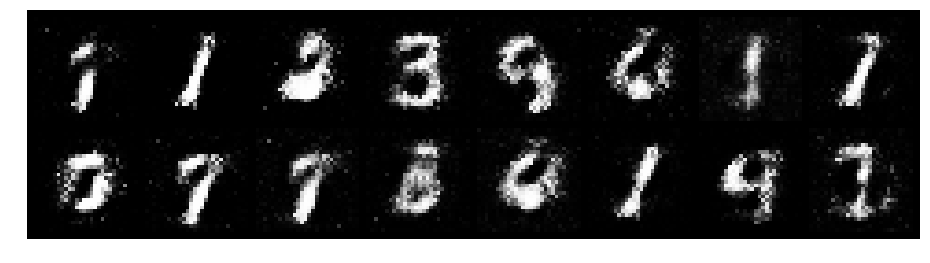

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 0.4351, Generator Loss: 2.4342
D(x): 0.8552, D(G(z)): 0.1483


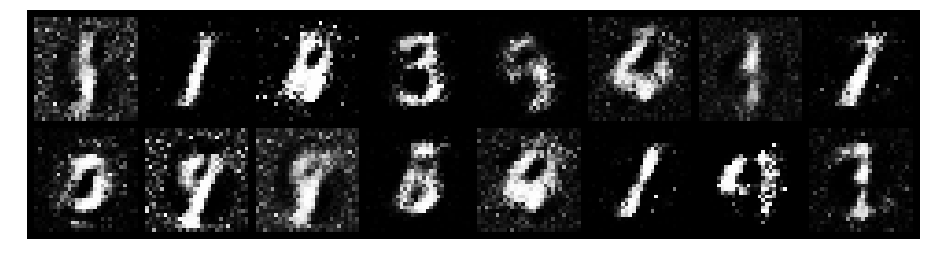

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.5600, Generator Loss: 2.6858
D(x): 0.8402, D(G(z)): 0.1770


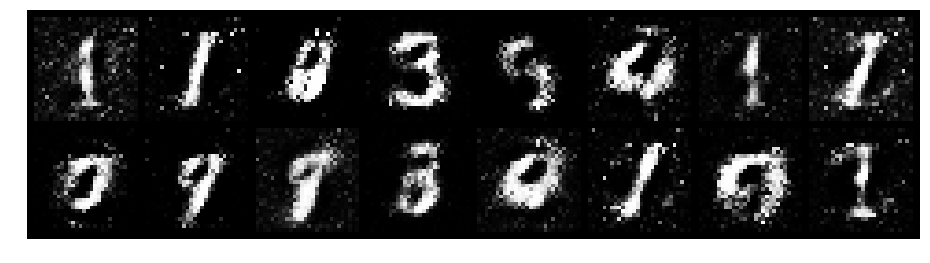

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.6689, Generator Loss: 2.4719
D(x): 0.8219, D(G(z)): 0.2245


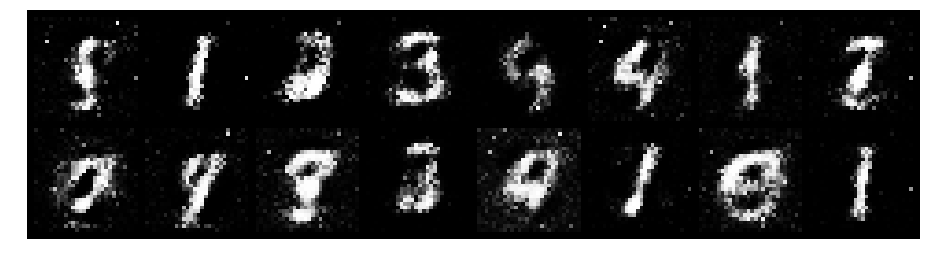

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.5019, Generator Loss: 3.2353
D(x): 0.8279, D(G(z)): 0.1692


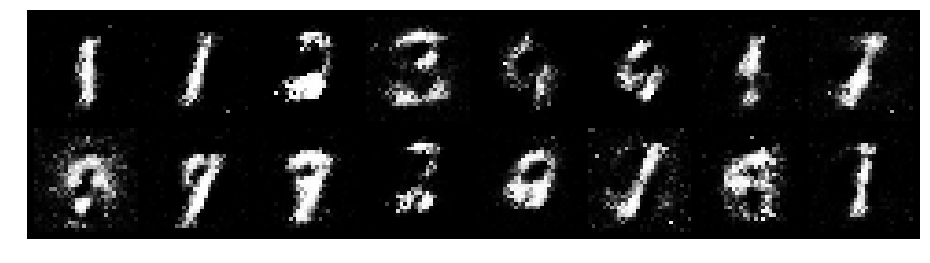

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 0.6418, Generator Loss: 2.3463
D(x): 0.8253, D(G(z)): 0.2259


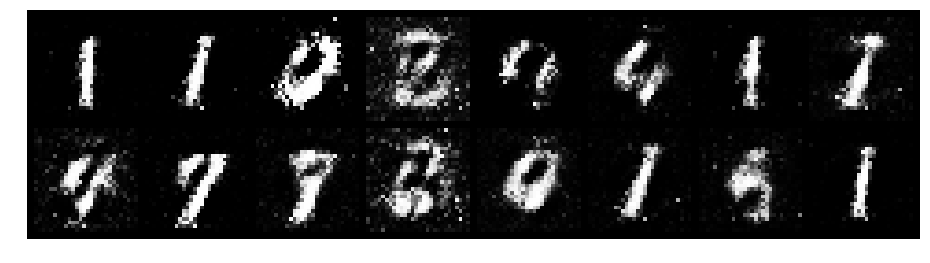

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.6385, Generator Loss: 2.6480
D(x): 0.8246, D(G(z)): 0.1850


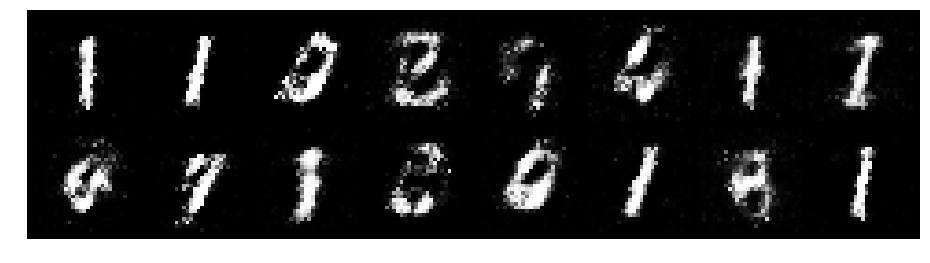

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 0.5859, Generator Loss: 2.1471
D(x): 0.7746, D(G(z)): 0.1481


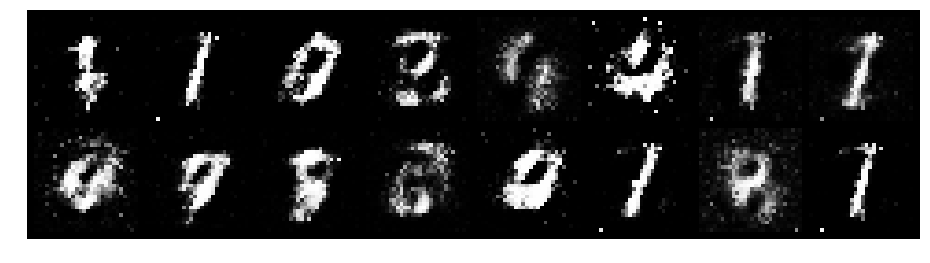

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.6569, Generator Loss: 1.6857
D(x): 0.7941, D(G(z)): 0.2184


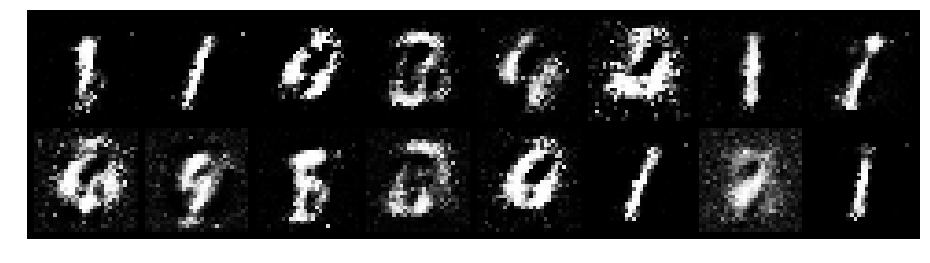

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.9517, Generator Loss: 1.4927
D(x): 0.7400, D(G(z)): 0.2892


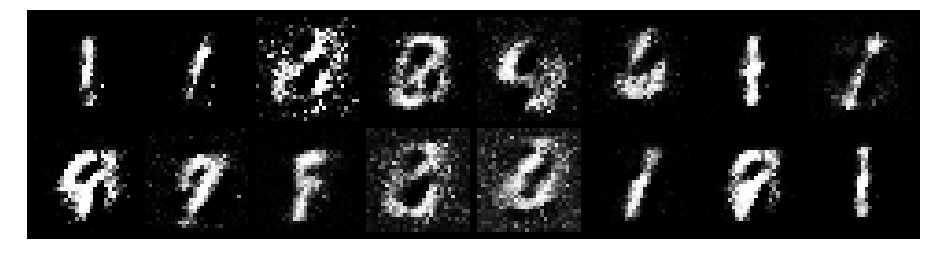

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.5370, Generator Loss: 2.3544
D(x): 0.8026, D(G(z)): 0.1822


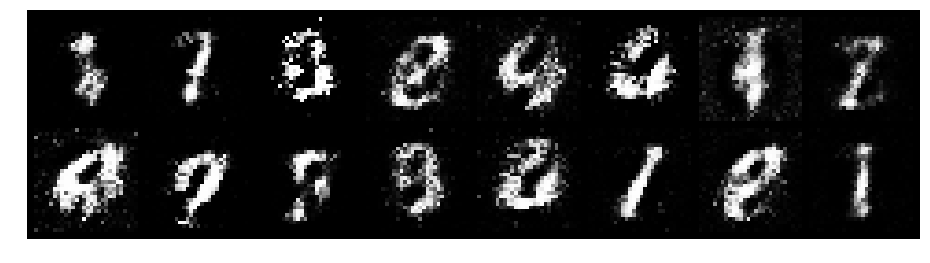

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 0.9447, Generator Loss: 1.8530
D(x): 0.6061, D(G(z)): 0.2075


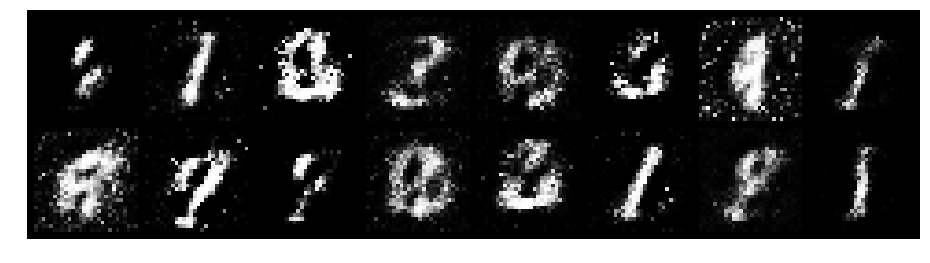

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.6236, Generator Loss: 1.7073
D(x): 0.7750, D(G(z)): 0.1967


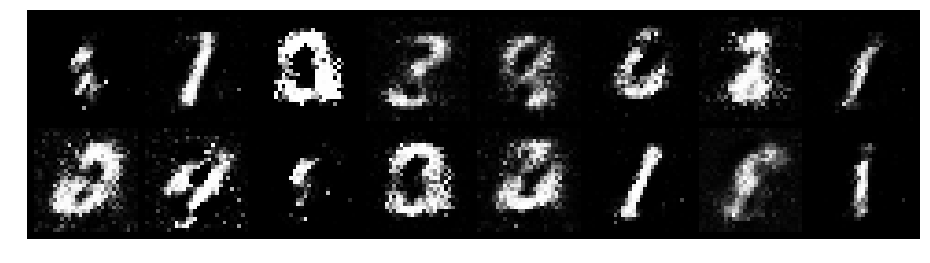

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 1.0367, Generator Loss: 1.7378
D(x): 0.6722, D(G(z)): 0.2772


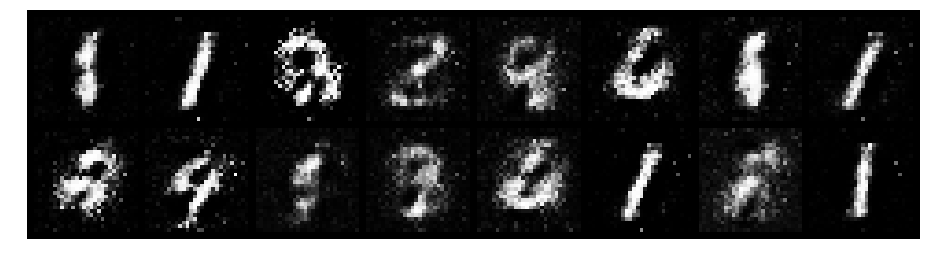

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.5729, Generator Loss: 2.2813
D(x): 0.7602, D(G(z)): 0.1332


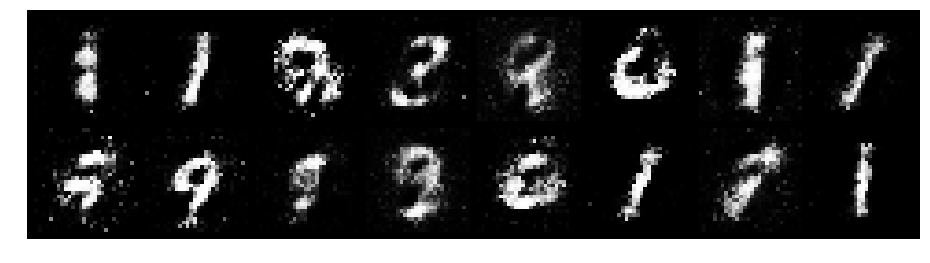

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.8298, Generator Loss: 1.8591
D(x): 0.8018, D(G(z)): 0.2985


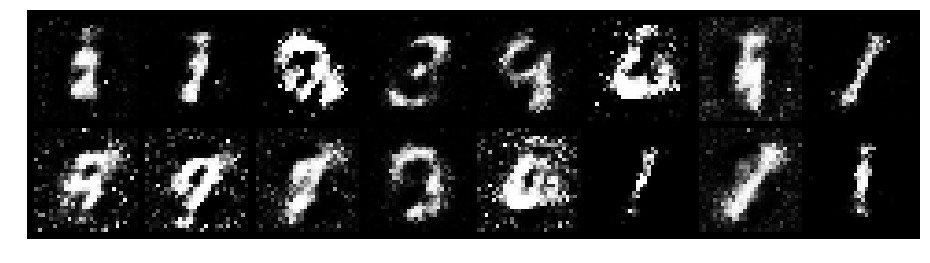

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.5918, Generator Loss: 2.6257
D(x): 0.7916, D(G(z)): 0.1731


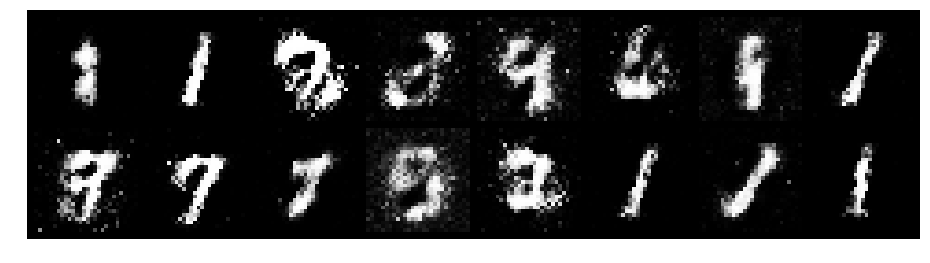

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.9661, Generator Loss: 1.8697
D(x): 0.6779, D(G(z)): 0.2327


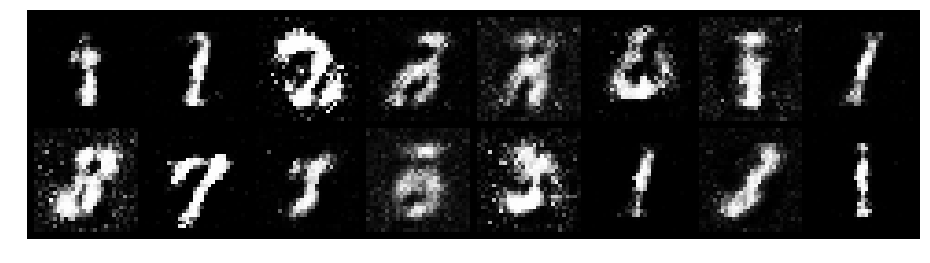

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.7677, Generator Loss: 1.7407
D(x): 0.8251, D(G(z)): 0.2791


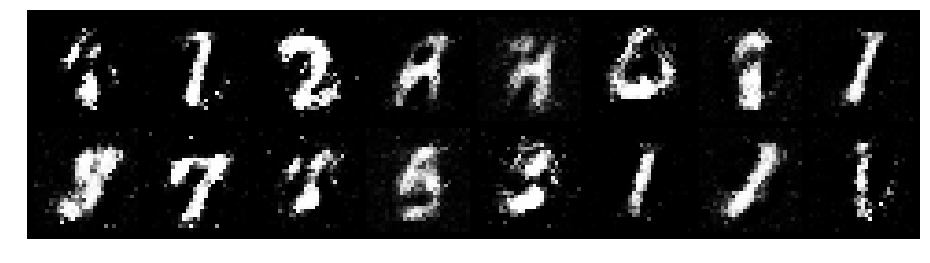

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 0.7041, Generator Loss: 1.9044
D(x): 0.7768, D(G(z)): 0.2585


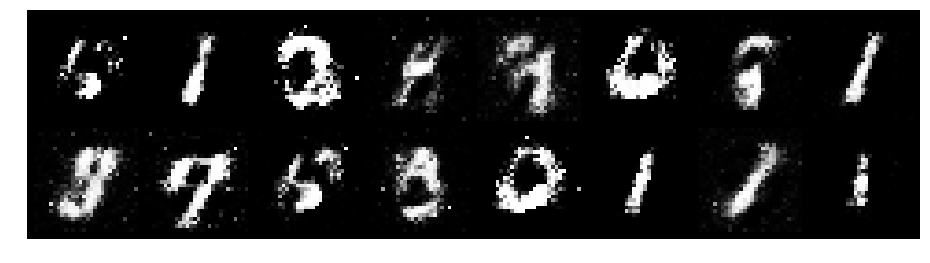

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.8701, Generator Loss: 1.6699
D(x): 0.8184, D(G(z)): 0.2979


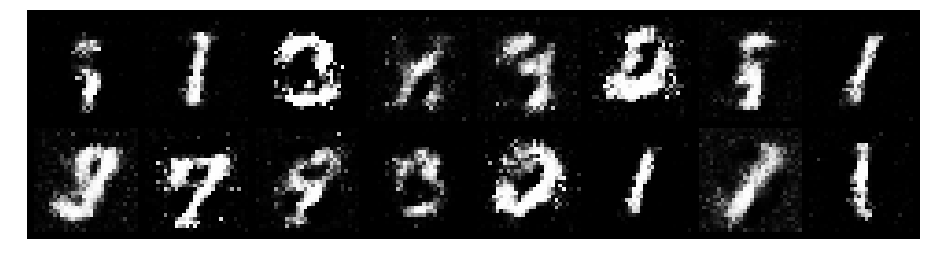

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.8402, Generator Loss: 2.3290
D(x): 0.8013, D(G(z)): 0.2791


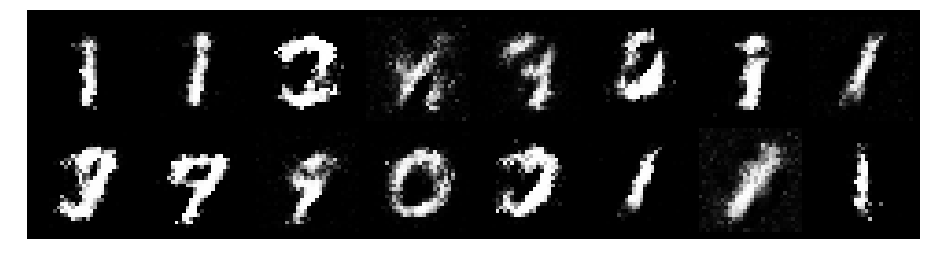

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 1.5099, Generator Loss: 1.9790
D(x): 0.5025, D(G(z)): 0.2249


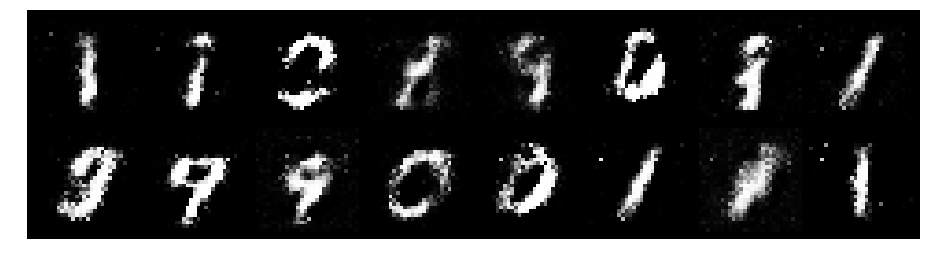

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 0.8005, Generator Loss: 1.8082
D(x): 0.6727, D(G(z)): 0.1595


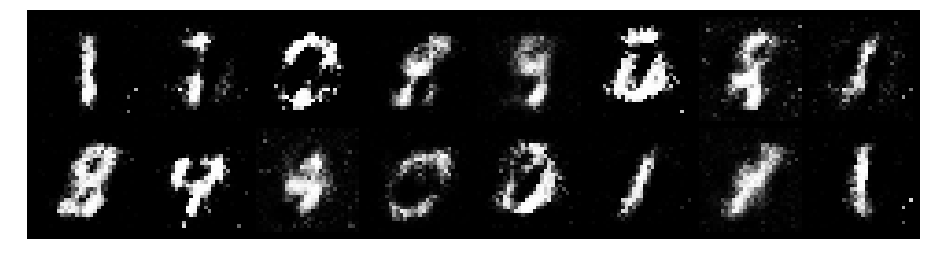

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.9341, Generator Loss: 1.4069
D(x): 0.7321, D(G(z)): 0.3007


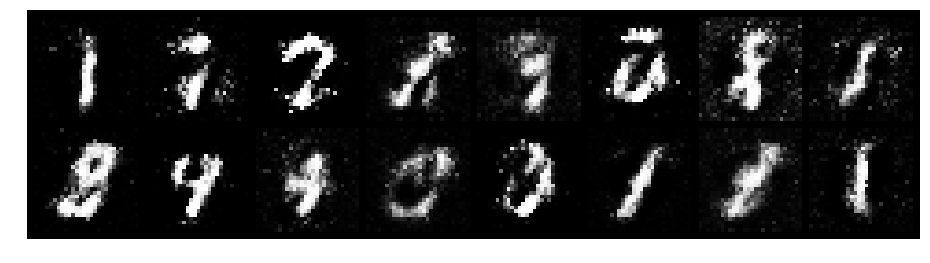

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.8558, Generator Loss: 2.2019
D(x): 0.7089, D(G(z)): 0.2343


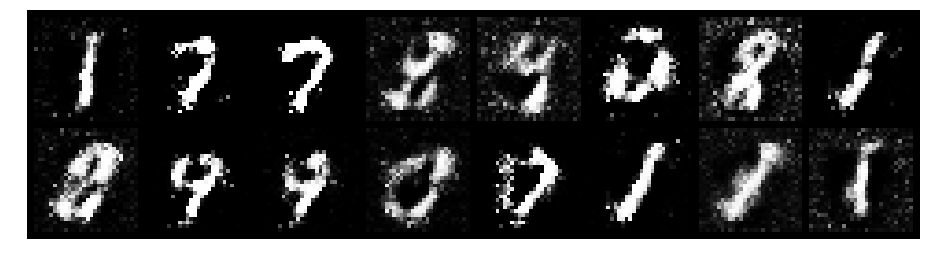

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.9161, Generator Loss: 1.7573
D(x): 0.7832, D(G(z)): 0.3270


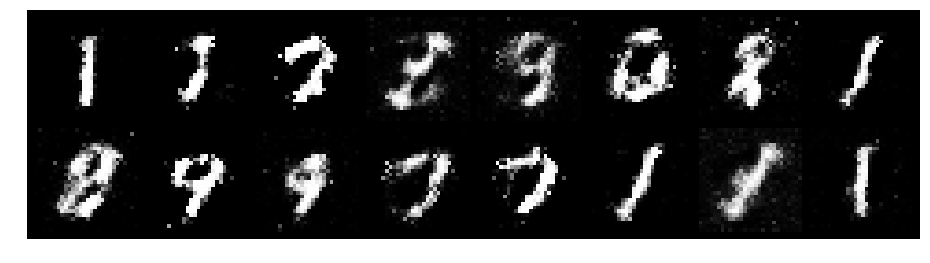

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.8101, Generator Loss: 2.3280
D(x): 0.6570, D(G(z)): 0.1169


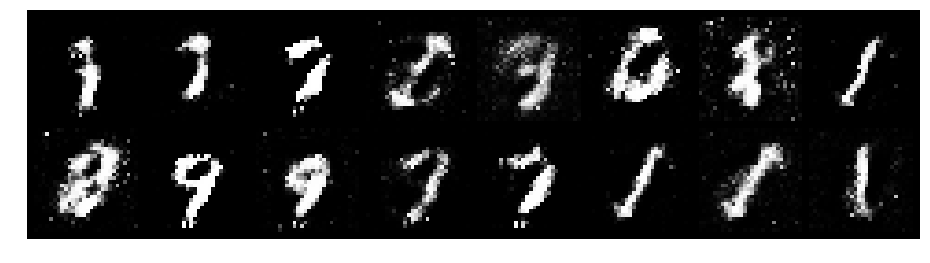

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.5778, Generator Loss: 2.1649
D(x): 0.8036, D(G(z)): 0.1917


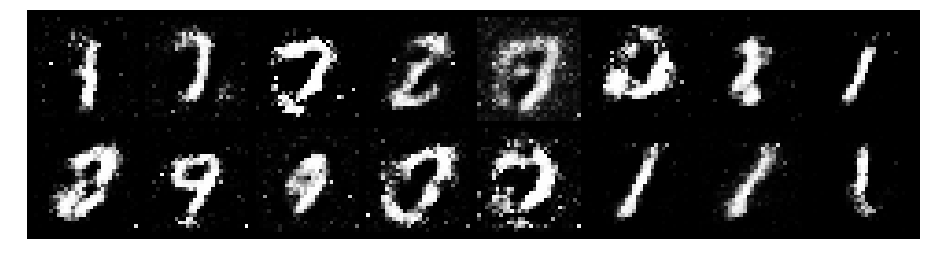

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.5449, Generator Loss: 2.1629
D(x): 0.8434, D(G(z)): 0.2112


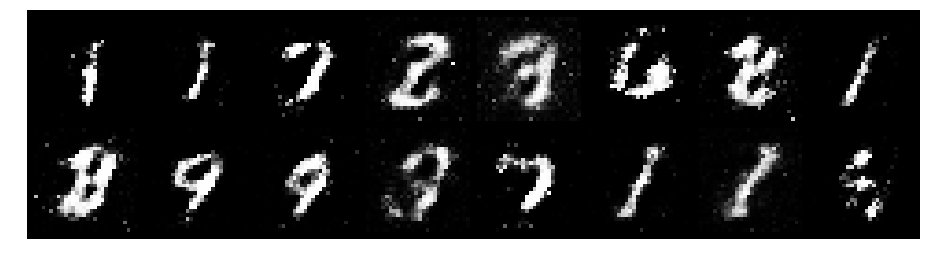

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.7725, Generator Loss: 2.5869
D(x): 0.6758, D(G(z)): 0.1412


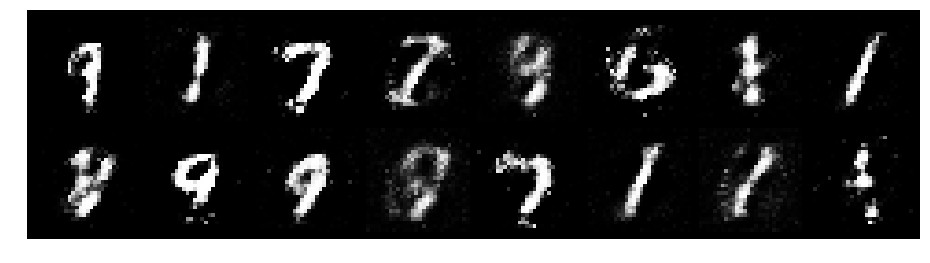

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.7886, Generator Loss: 1.6031
D(x): 0.7759, D(G(z)): 0.3024


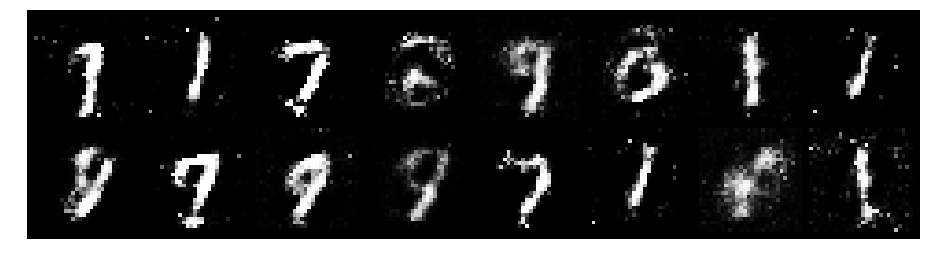

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 0.7419, Generator Loss: 1.7498
D(x): 0.7245, D(G(z)): 0.2158


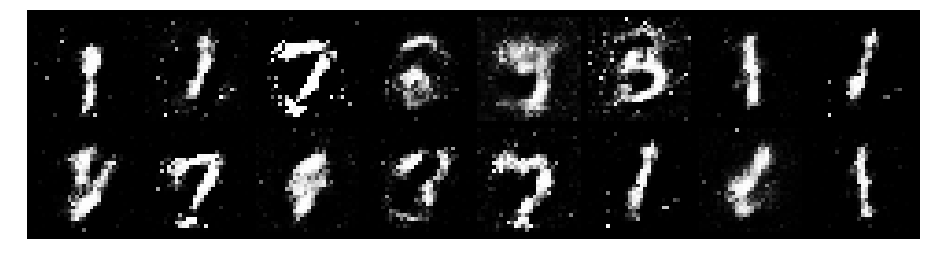

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.6250, Generator Loss: 2.2223
D(x): 0.7705, D(G(z)): 0.1921


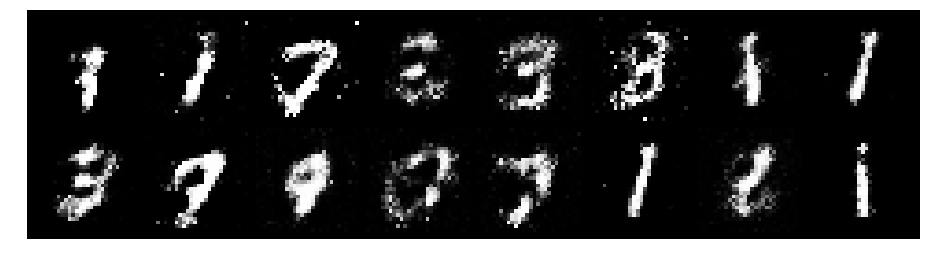

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 1.1097, Generator Loss: 2.2958
D(x): 0.6204, D(G(z)): 0.2109


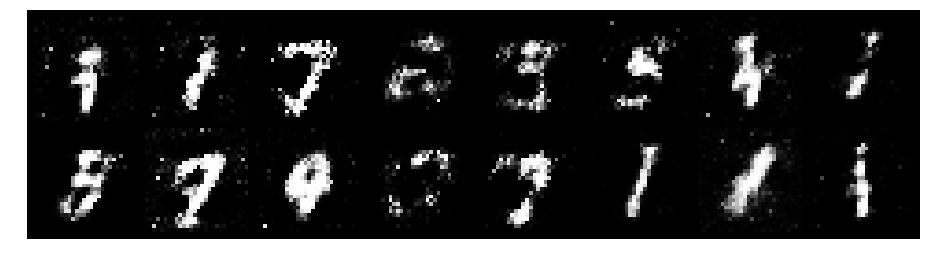

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 0.9047, Generator Loss: 1.7877
D(x): 0.7252, D(G(z)): 0.2881


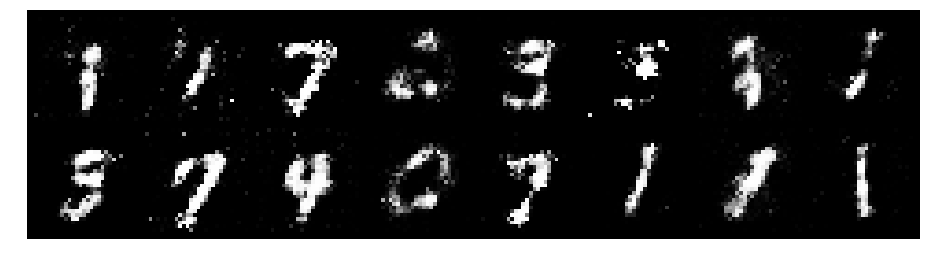

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.8449, Generator Loss: 1.7259
D(x): 0.7488, D(G(z)): 0.2998


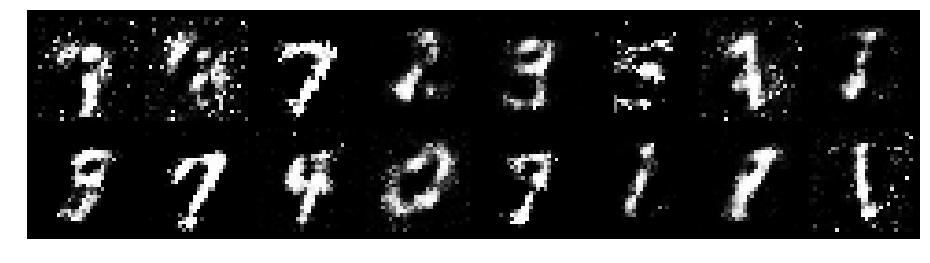

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.7414, Generator Loss: 1.6147
D(x): 0.8059, D(G(z)): 0.3020


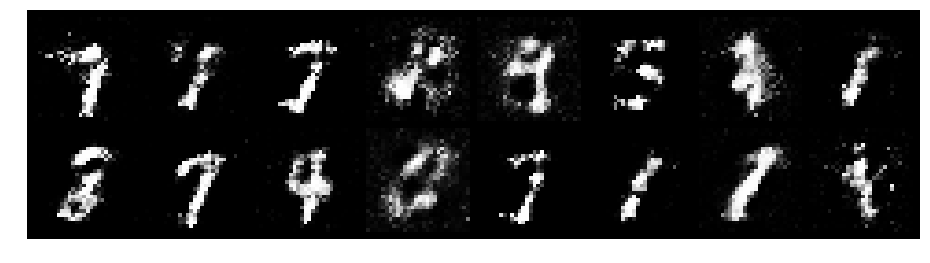

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 0.9234, Generator Loss: 2.0402
D(x): 0.6944, D(G(z)): 0.2542


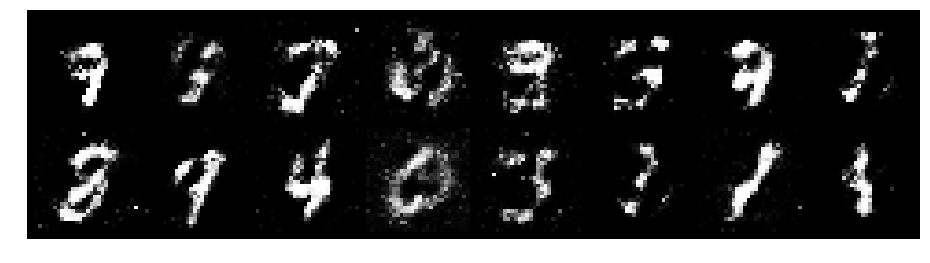

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 1.1201, Generator Loss: 1.8676
D(x): 0.6749, D(G(z)): 0.3090


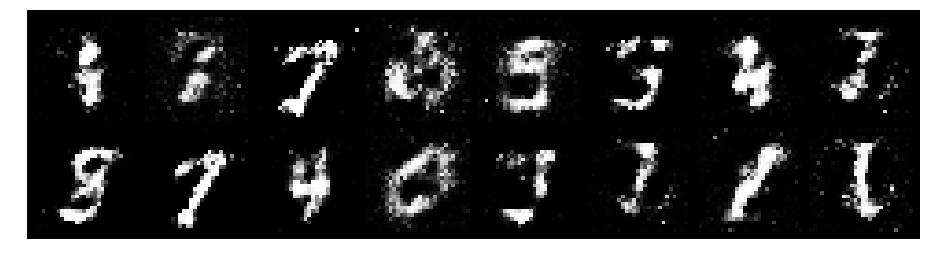

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.8882, Generator Loss: 1.5727
D(x): 0.6765, D(G(z)): 0.2403


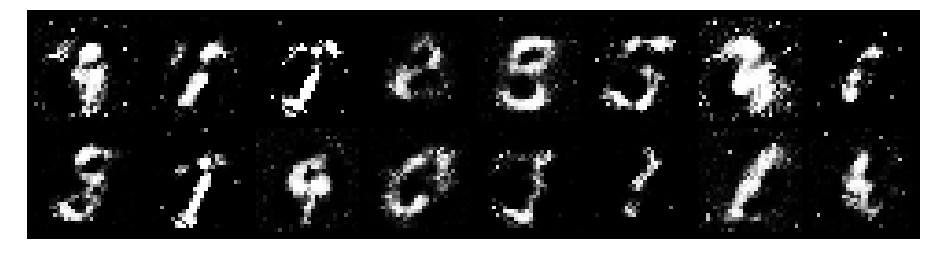

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 0.6306, Generator Loss: 2.1899
D(x): 0.7795, D(G(z)): 0.2067


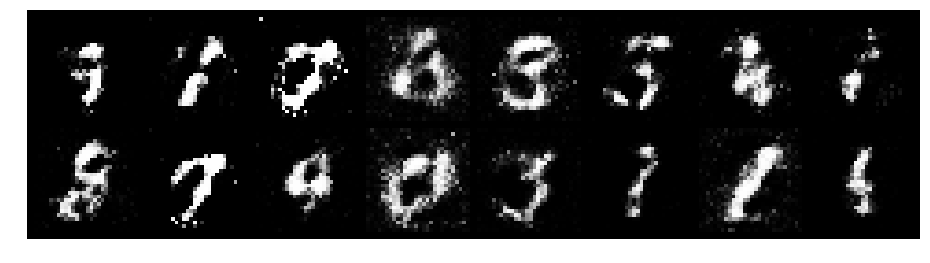

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 0.8263, Generator Loss: 1.8461
D(x): 0.7656, D(G(z)): 0.2417


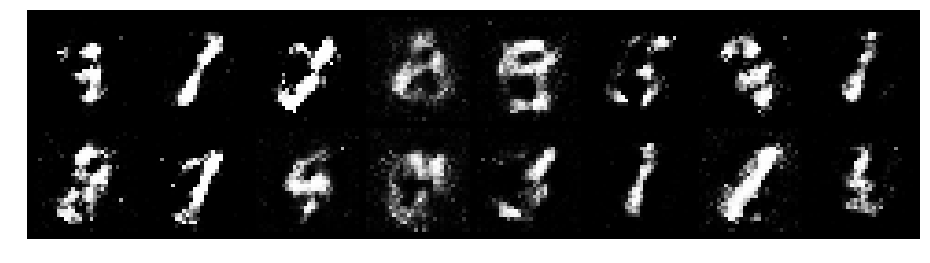

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 0.8967, Generator Loss: 1.8143
D(x): 0.7831, D(G(z)): 0.3476


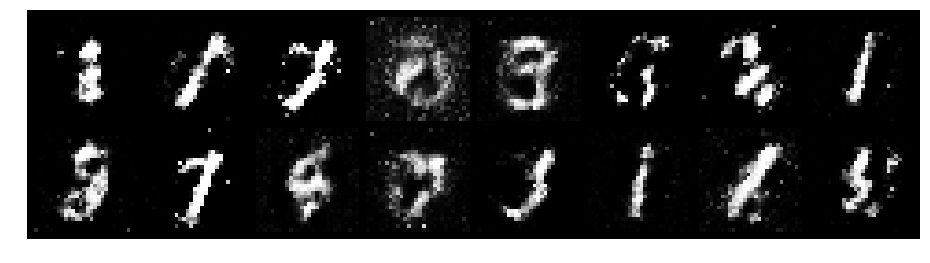

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 0.8682, Generator Loss: 1.4220
D(x): 0.7270, D(G(z)): 0.2821


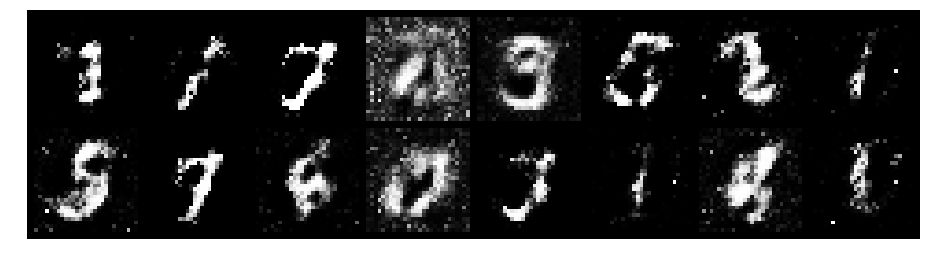

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 1.1232, Generator Loss: 1.6954
D(x): 0.6322, D(G(z)): 0.3023


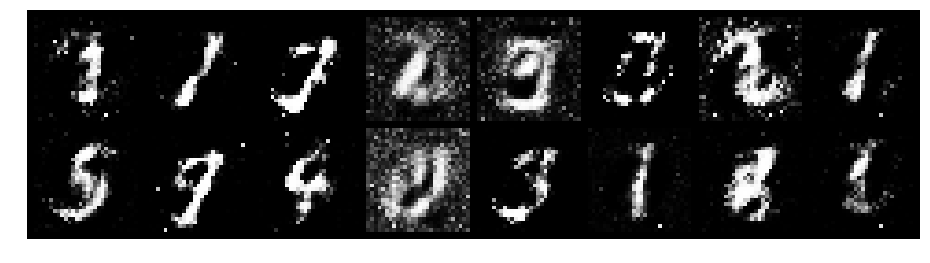

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 0.8751, Generator Loss: 1.4245
D(x): 0.7020, D(G(z)): 0.3059


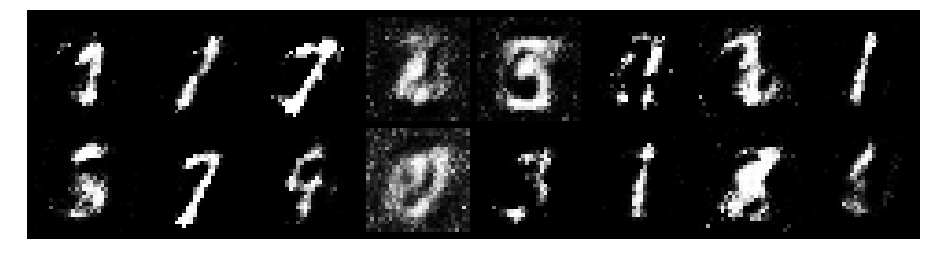

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 0.9063, Generator Loss: 1.9368
D(x): 0.6600, D(G(z)): 0.2602


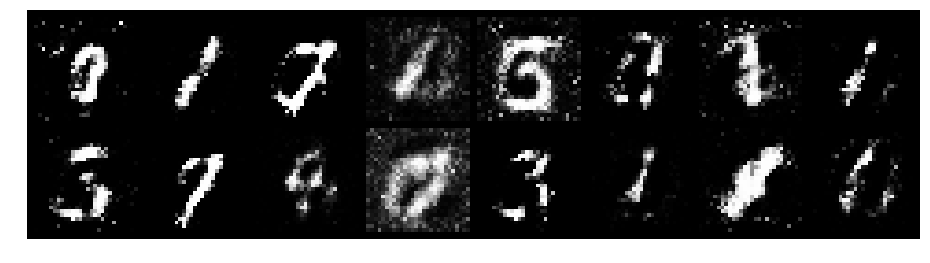

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.6803, Generator Loss: 2.2925
D(x): 0.7834, D(G(z)): 0.2568


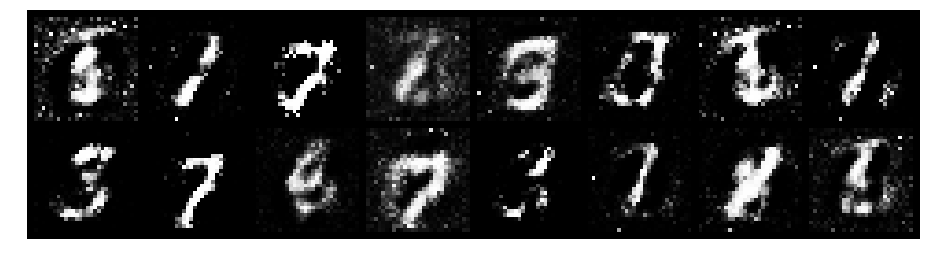

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.8512, Generator Loss: 1.5331
D(x): 0.6937, D(G(z)): 0.2876


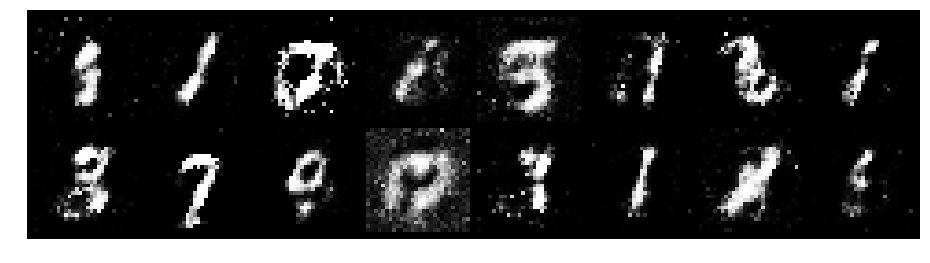

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 0.7554, Generator Loss: 2.0738
D(x): 0.7093, D(G(z)): 0.2145


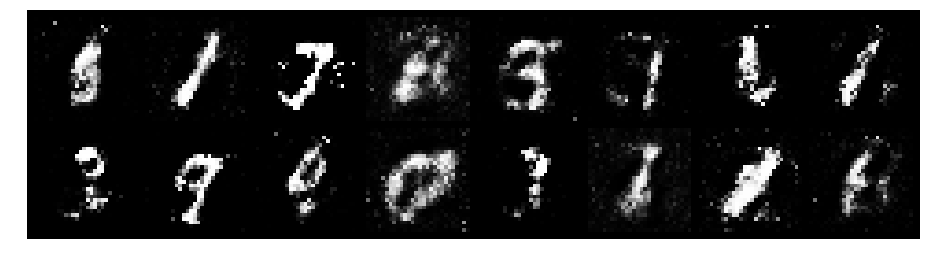

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 0.7417, Generator Loss: 1.8161
D(x): 0.7223, D(G(z)): 0.2333


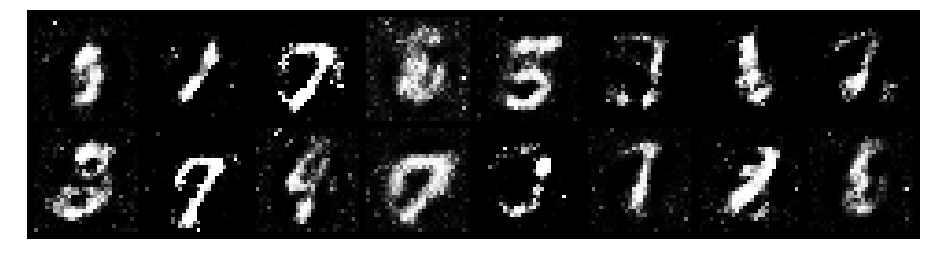

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 0.6047, Generator Loss: 2.1538
D(x): 0.7786, D(G(z)): 0.1975


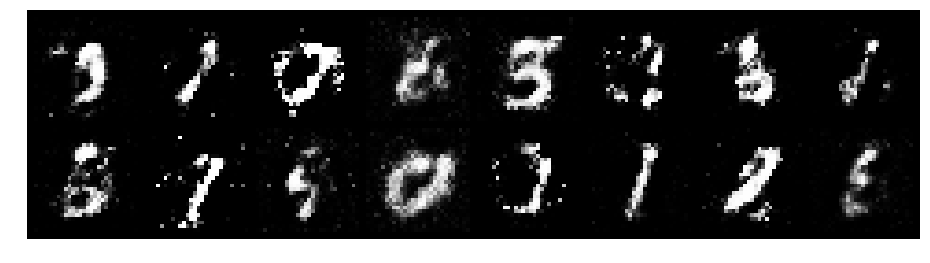

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.7407, Generator Loss: 1.8648
D(x): 0.7212, D(G(z)): 0.2419


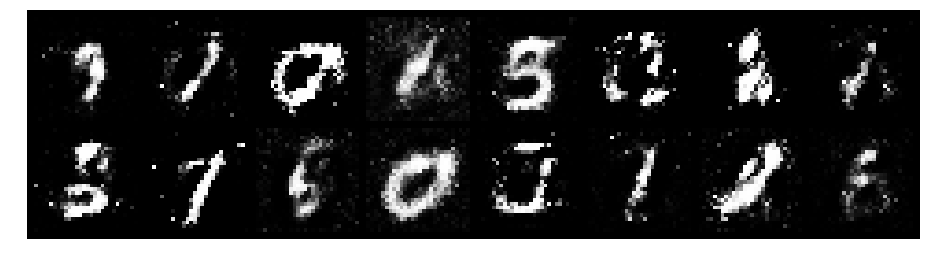

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 0.7462, Generator Loss: 1.9605
D(x): 0.7106, D(G(z)): 0.1724


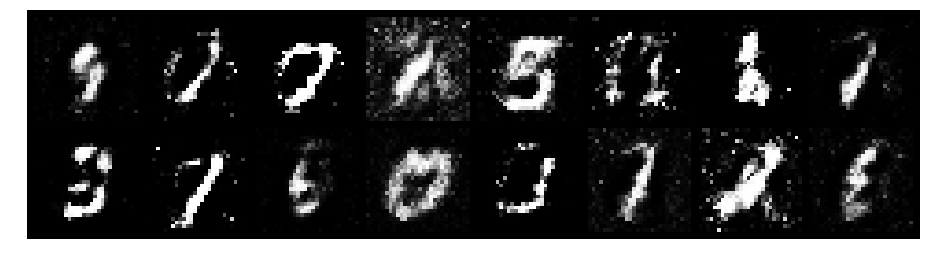

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 0.9355, Generator Loss: 1.5237
D(x): 0.7945, D(G(z)): 0.3648


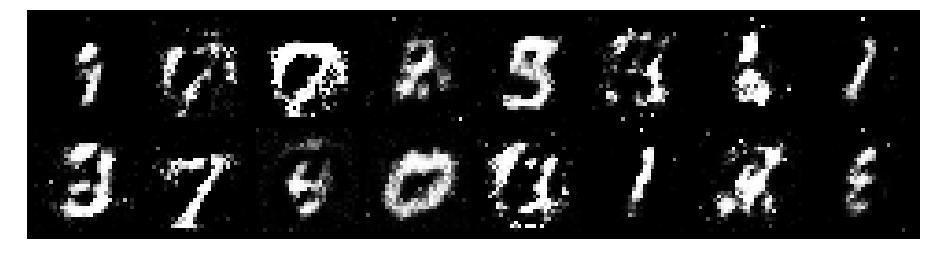

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 0.9629, Generator Loss: 1.4445
D(x): 0.7374, D(G(z)): 0.2786


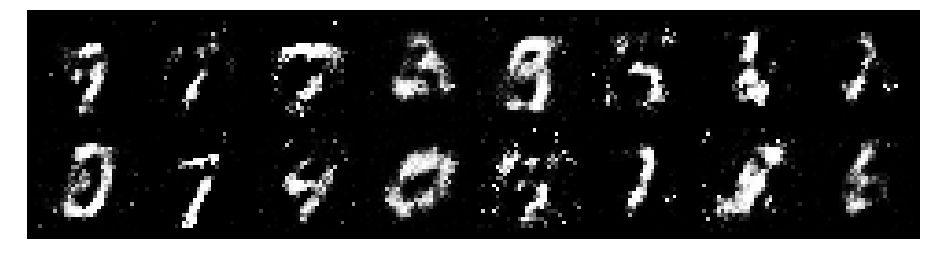

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 0.9469, Generator Loss: 1.4848
D(x): 0.6710, D(G(z)): 0.3042


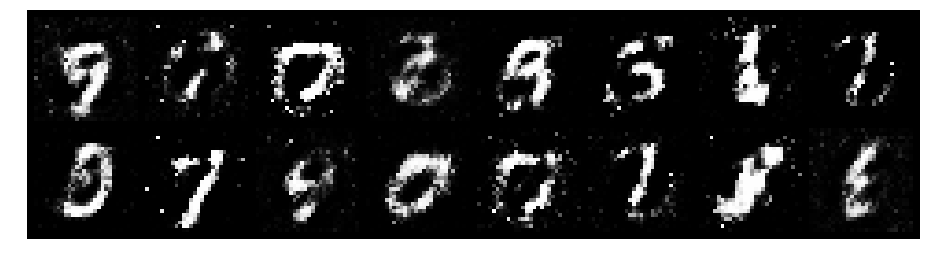

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 0.9347, Generator Loss: 1.5235
D(x): 0.7191, D(G(z)): 0.3274


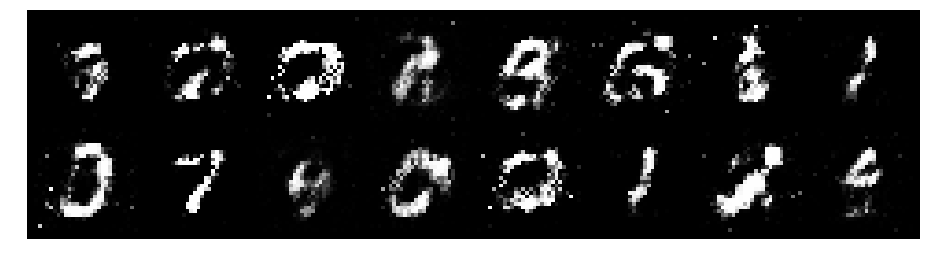

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 0.8669, Generator Loss: 1.3357
D(x): 0.7281, D(G(z)): 0.3305


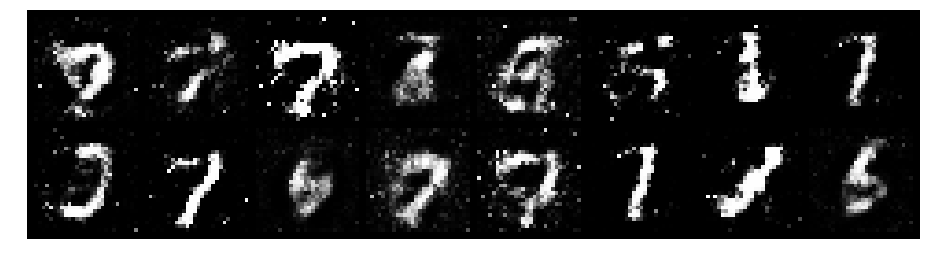

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.8766, Generator Loss: 1.5709
D(x): 0.7205, D(G(z)): 0.3046


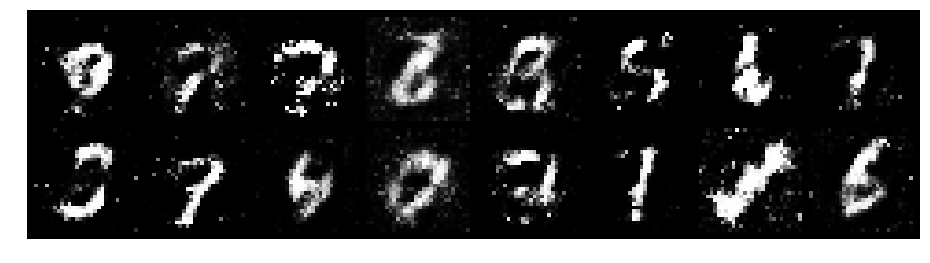

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 1.0636, Generator Loss: 1.3493
D(x): 0.6704, D(G(z)): 0.3916


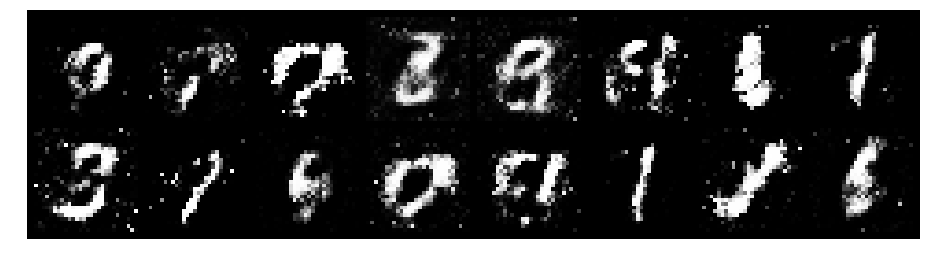

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 0.8888, Generator Loss: 1.5262
D(x): 0.7044, D(G(z)): 0.3293


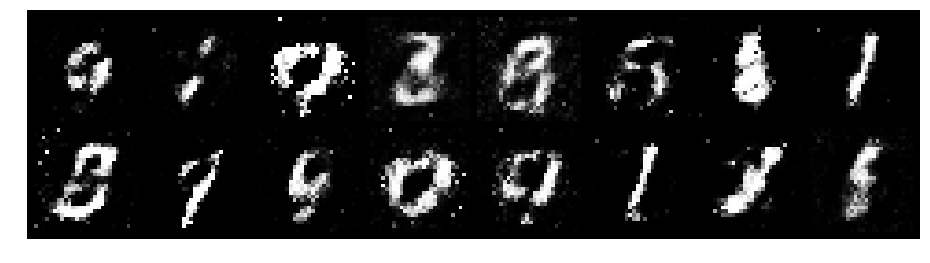

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 0.8544, Generator Loss: 2.2407
D(x): 0.6918, D(G(z)): 0.2091


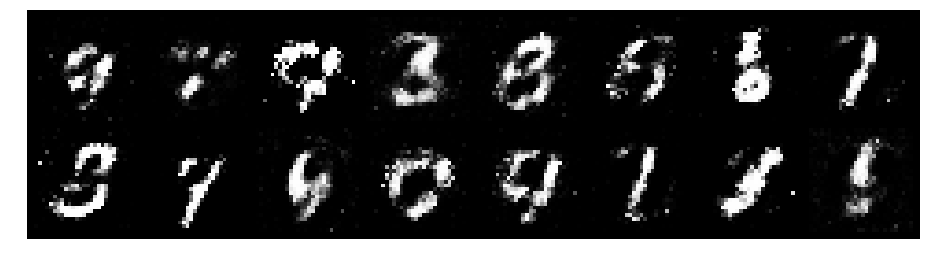

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 0.6680, Generator Loss: 1.7522
D(x): 0.7492, D(G(z)): 0.2050


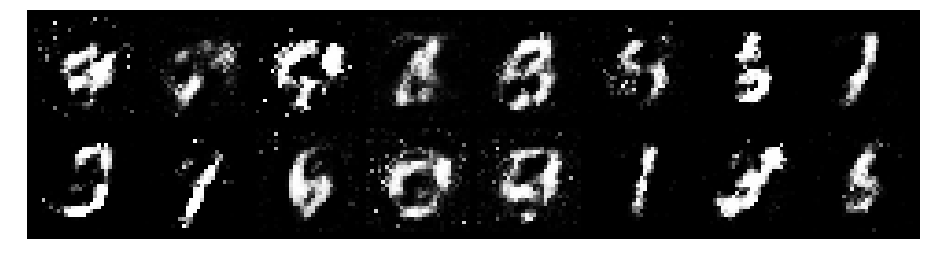

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 0.8177, Generator Loss: 2.0620
D(x): 0.7675, D(G(z)): 0.2739


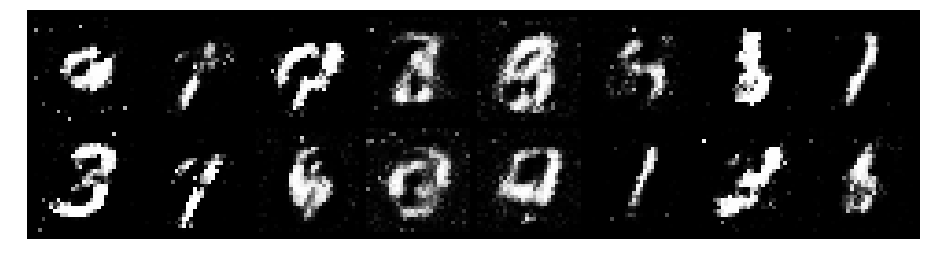

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 0.9951, Generator Loss: 1.6301
D(x): 0.6284, D(G(z)): 0.2687


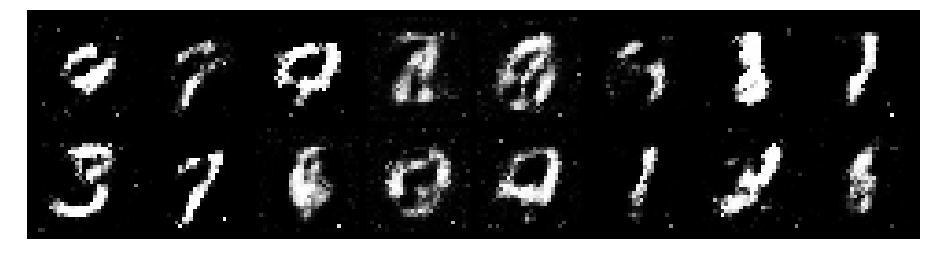

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 0.9275, Generator Loss: 1.8205
D(x): 0.8063, D(G(z)): 0.3648


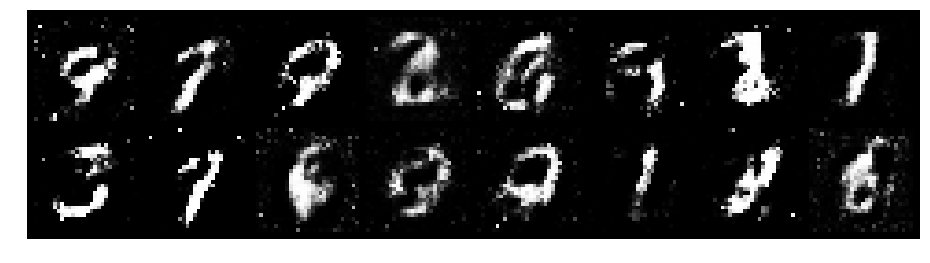

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 1.1454, Generator Loss: 1.0604
D(x): 0.6600, D(G(z)): 0.3334


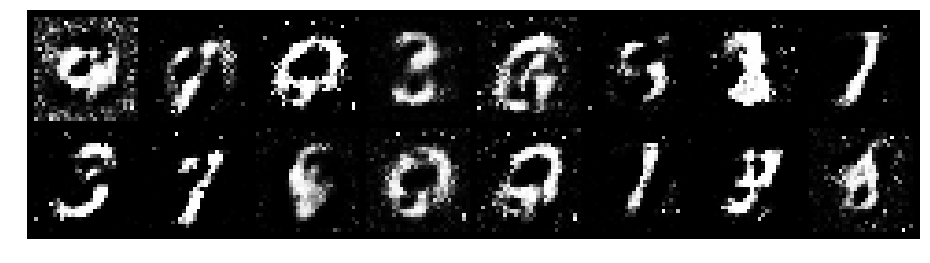

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 0.8394, Generator Loss: 1.9502
D(x): 0.7601, D(G(z)): 0.3248


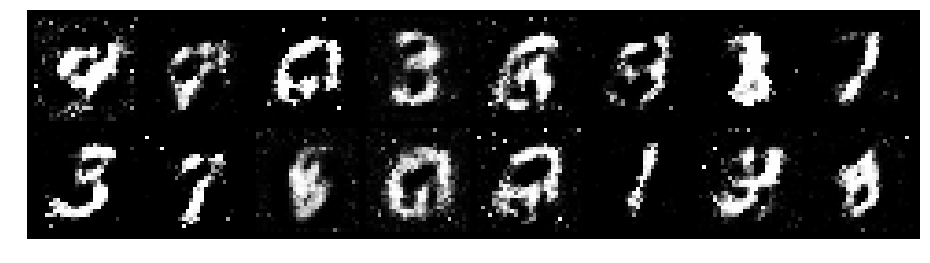

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 1.0308, Generator Loss: 1.1459
D(x): 0.6727, D(G(z)): 0.3319


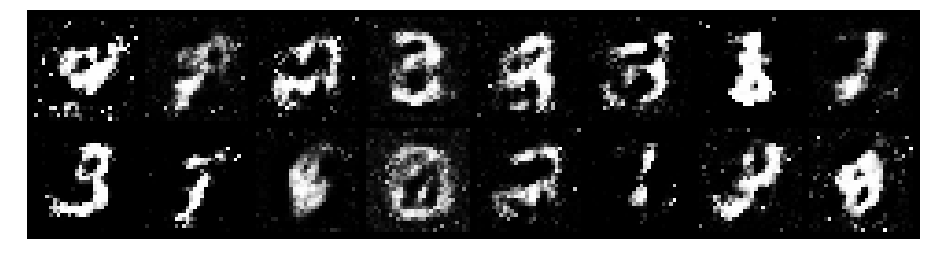

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 0.9594, Generator Loss: 1.3651
D(x): 0.6790, D(G(z)): 0.3500


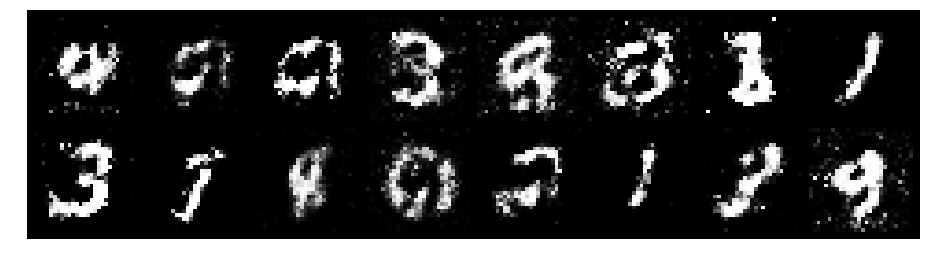

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.9672, Generator Loss: 1.7003
D(x): 0.7425, D(G(z)): 0.3329


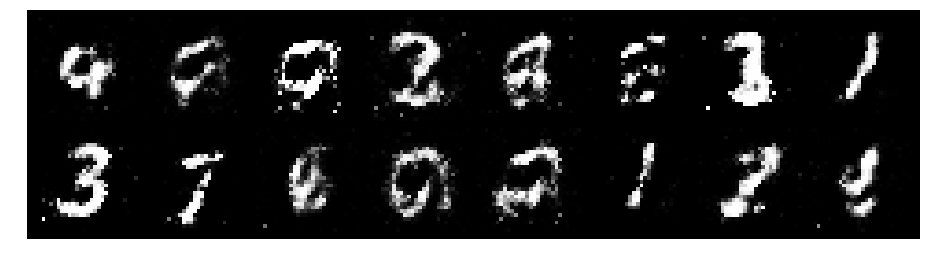

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 0.8978, Generator Loss: 1.7972
D(x): 0.7182, D(G(z)): 0.2772


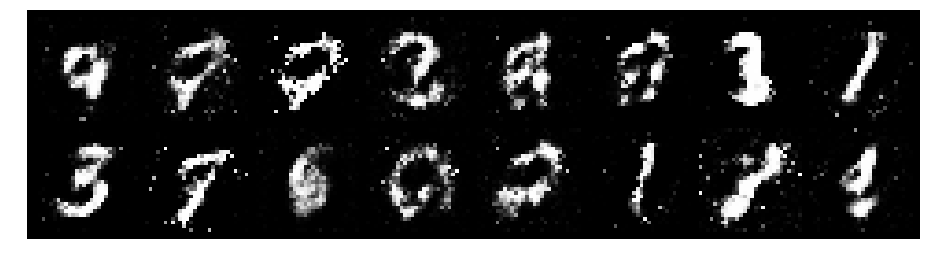

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 0.8978, Generator Loss: 1.4829
D(x): 0.7342, D(G(z)): 0.3595


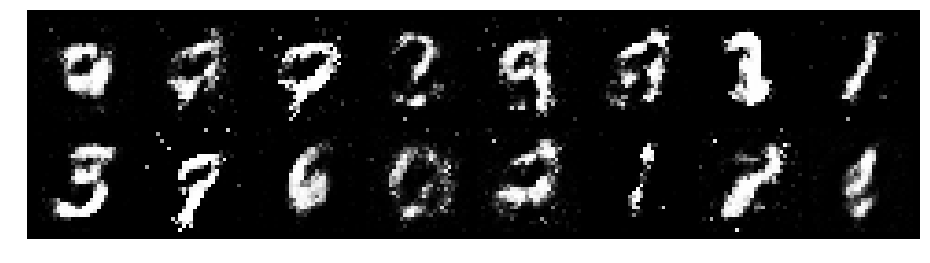

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 0.7730, Generator Loss: 1.5313
D(x): 0.7351, D(G(z)): 0.2894


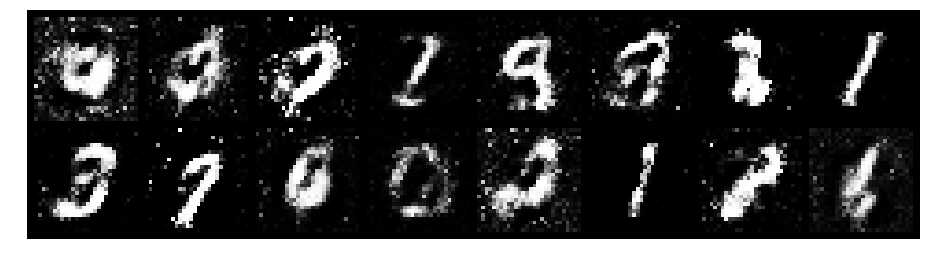

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 1.0238, Generator Loss: 1.4792
D(x): 0.6696, D(G(z)): 0.3124


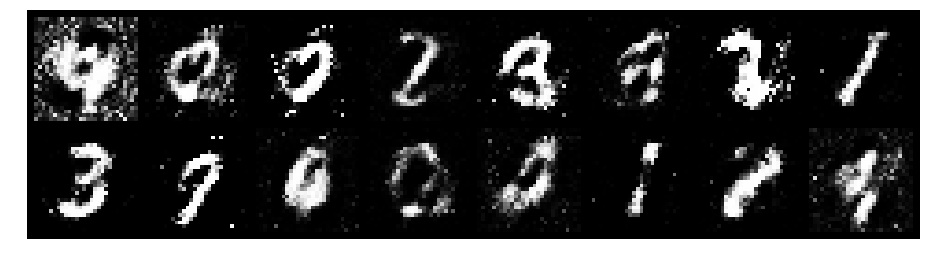

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 1.1600, Generator Loss: 1.1776
D(x): 0.6764, D(G(z)): 0.3918


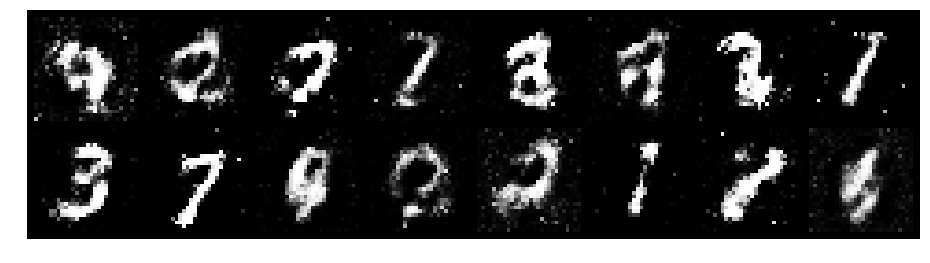

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 1.0905, Generator Loss: 1.9071
D(x): 0.7409, D(G(z)): 0.3722


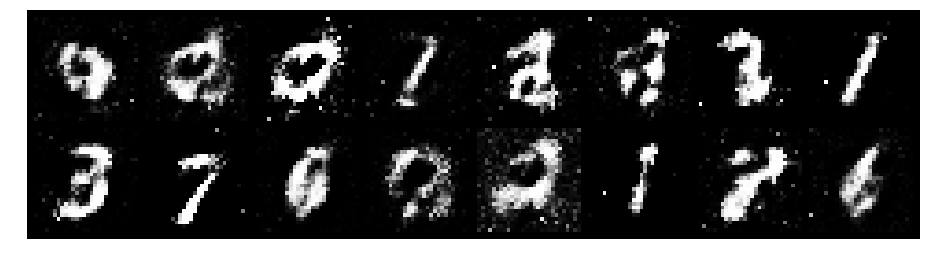

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 0.7719, Generator Loss: 2.1899
D(x): 0.8170, D(G(z)): 0.3046


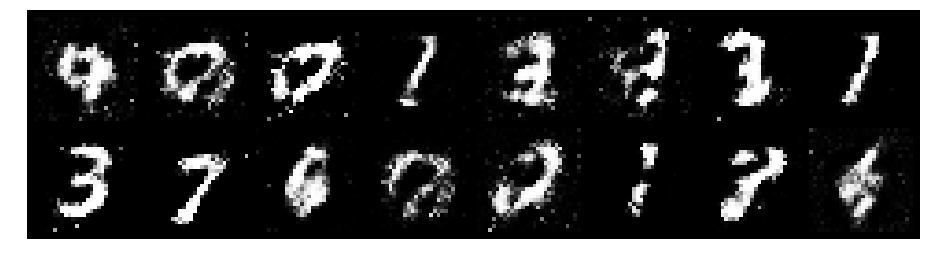

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 0.7983, Generator Loss: 1.3965
D(x): 0.6772, D(G(z)): 0.2340


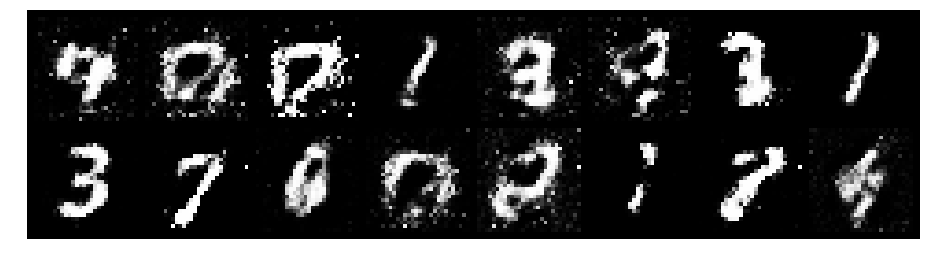

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 1.2520, Generator Loss: 1.3708
D(x): 0.6696, D(G(z)): 0.4114


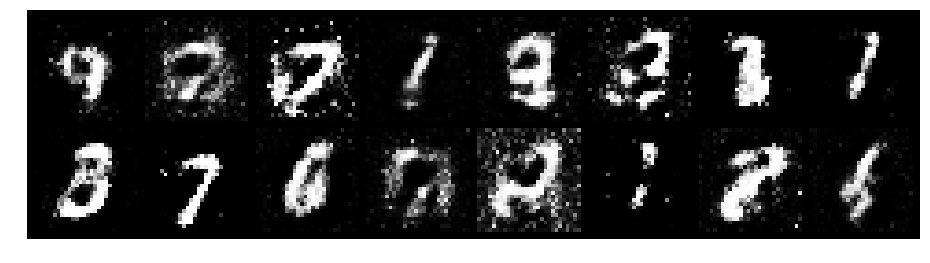

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 1.1012, Generator Loss: 1.1295
D(x): 0.6620, D(G(z)): 0.3889


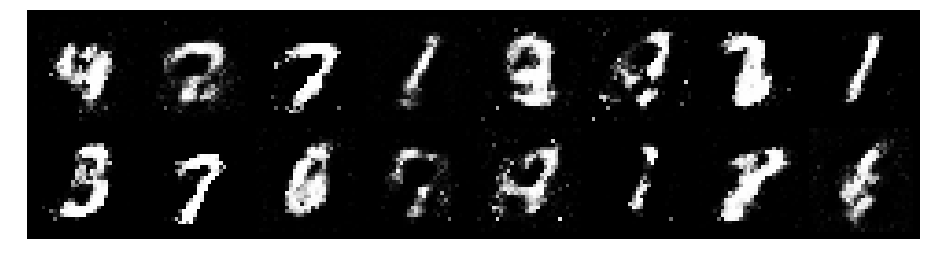

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 0.9723, Generator Loss: 1.3946
D(x): 0.6796, D(G(z)): 0.3038


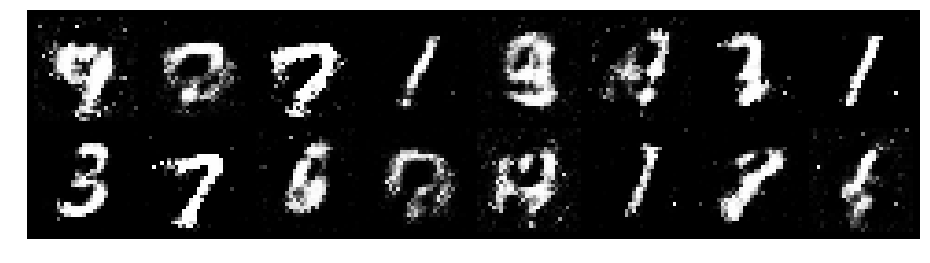

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 0.8188, Generator Loss: 1.5839
D(x): 0.7179, D(G(z)): 0.2570


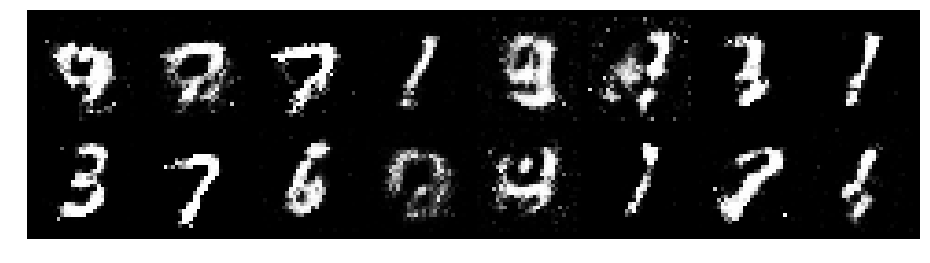

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.7764, Generator Loss: 1.9171
D(x): 0.6898, D(G(z)): 0.2189


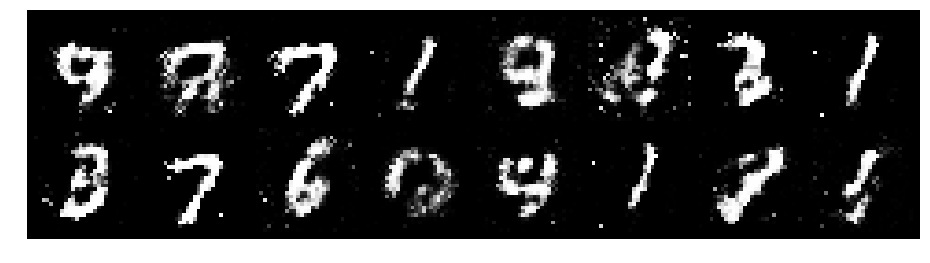

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 0.9713, Generator Loss: 1.5472
D(x): 0.7395, D(G(z)): 0.3868


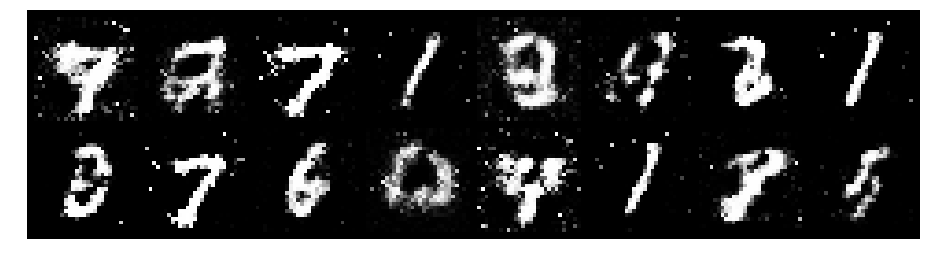

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 1.0786, Generator Loss: 1.4819
D(x): 0.6160, D(G(z)): 0.3186


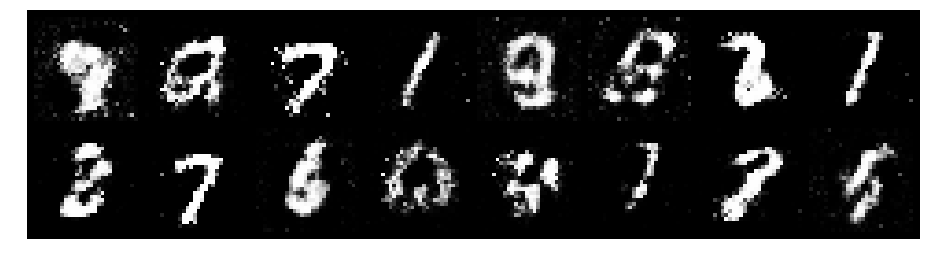

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 0.9505, Generator Loss: 1.6011
D(x): 0.6961, D(G(z)): 0.3518


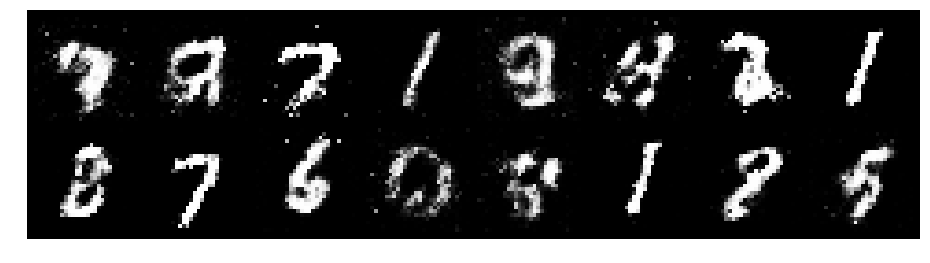

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 0.7019, Generator Loss: 1.7428
D(x): 0.7410, D(G(z)): 0.2204


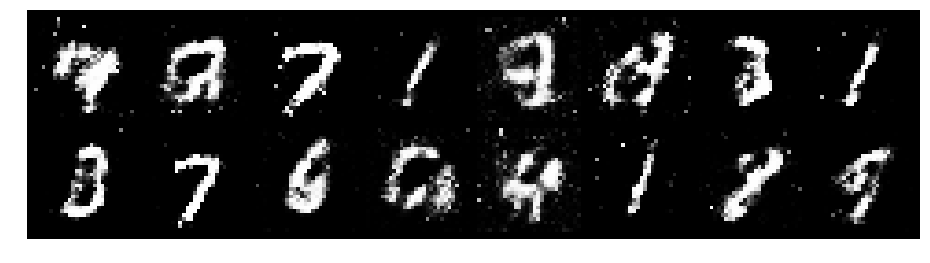

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 0.8332, Generator Loss: 1.5342
D(x): 0.7294, D(G(z)): 0.3198


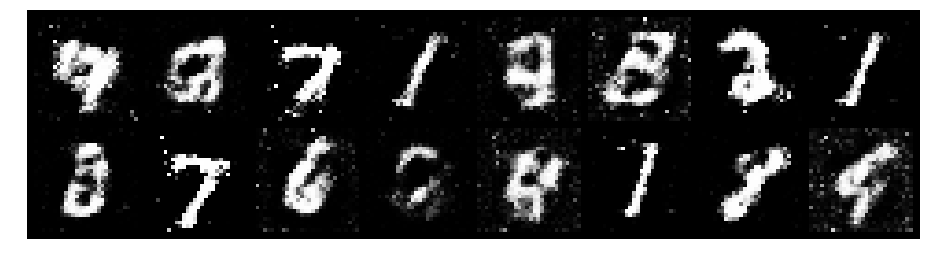

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 0.8665, Generator Loss: 1.5380
D(x): 0.6763, D(G(z)): 0.2753


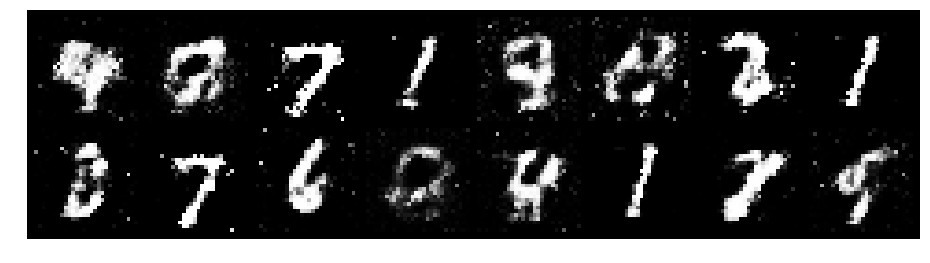

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 0.8805, Generator Loss: 1.2979
D(x): 0.6900, D(G(z)): 0.2703


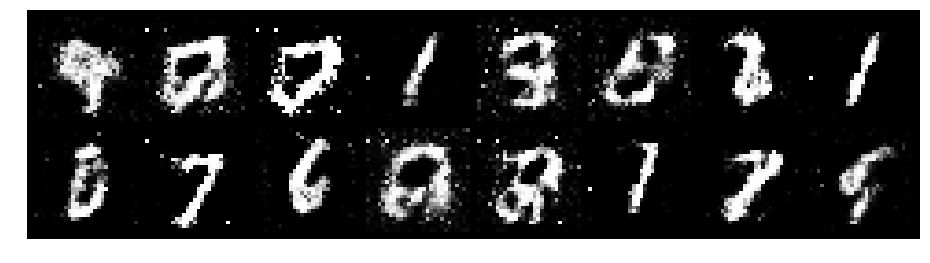

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 0.8311, Generator Loss: 1.9563
D(x): 0.6943, D(G(z)): 0.2396


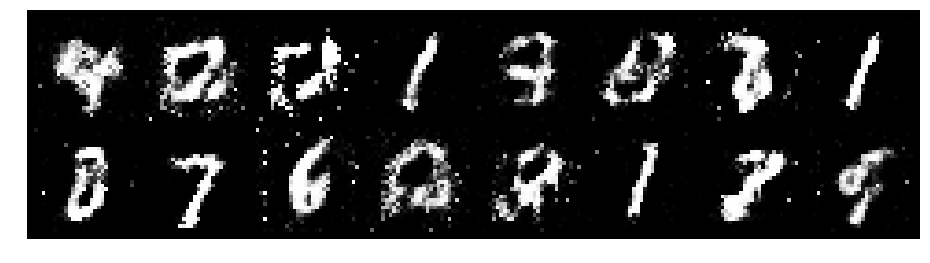

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 1.1088, Generator Loss: 1.3287
D(x): 0.6382, D(G(z)): 0.3206


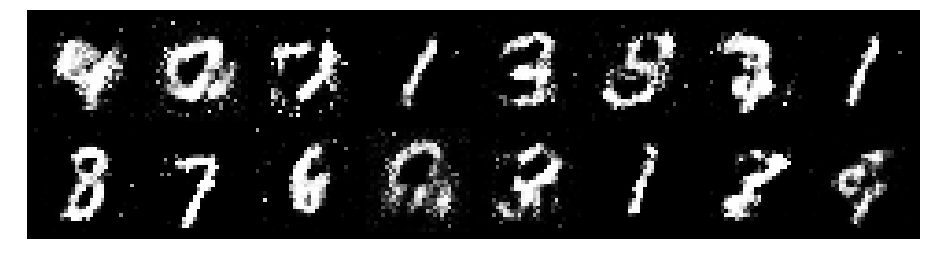

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 0.8218, Generator Loss: 1.9464
D(x): 0.6662, D(G(z)): 0.1991


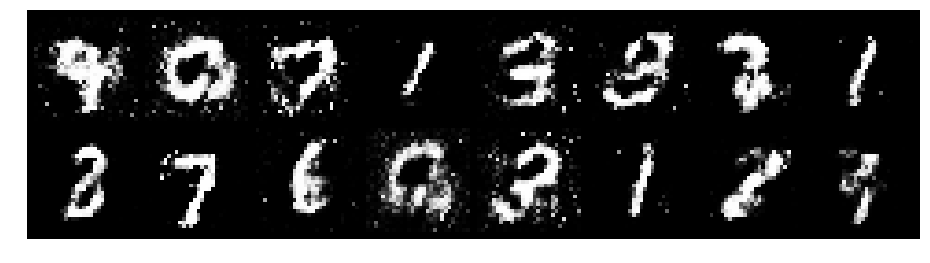

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 0.7408, Generator Loss: 1.8575
D(x): 0.7830, D(G(z)): 0.2610


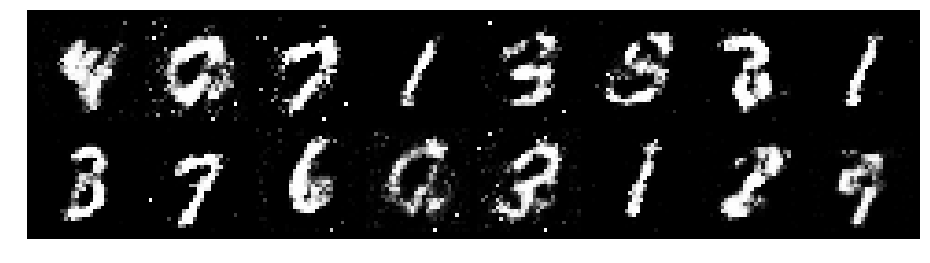

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 0.8896, Generator Loss: 1.4658
D(x): 0.7267, D(G(z)): 0.3197


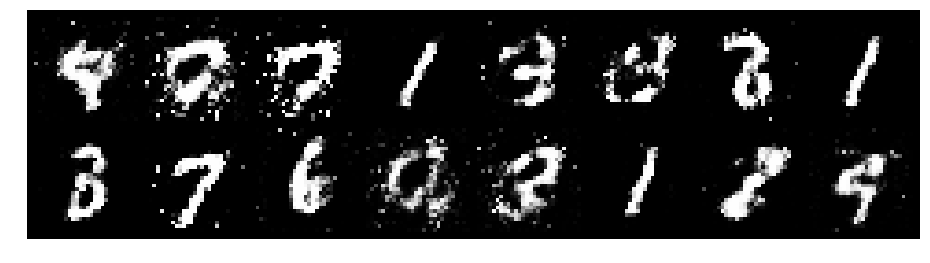

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 0.8325, Generator Loss: 1.4408
D(x): 0.7317, D(G(z)): 0.3337


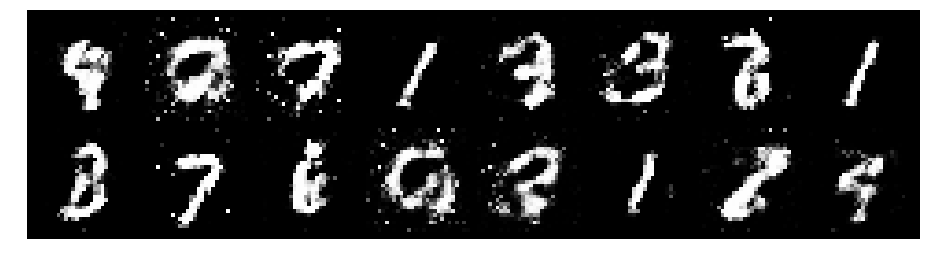

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 0.8067, Generator Loss: 1.5355
D(x): 0.7147, D(G(z)): 0.2844


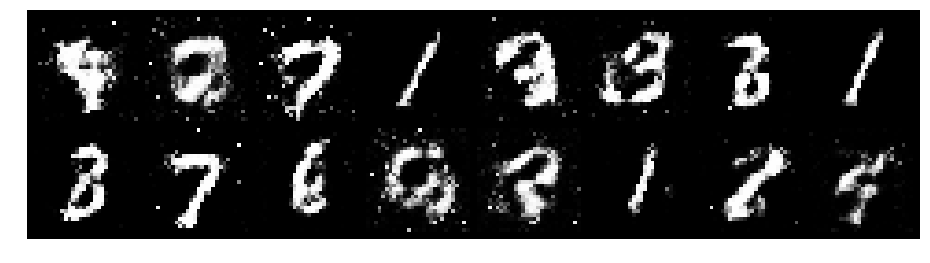

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 0.9751, Generator Loss: 1.5569
D(x): 0.6652, D(G(z)): 0.3086


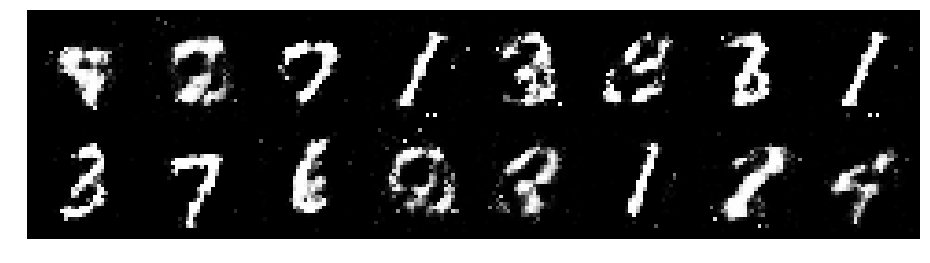

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 0.8531, Generator Loss: 1.5405
D(x): 0.7203, D(G(z)): 0.3149


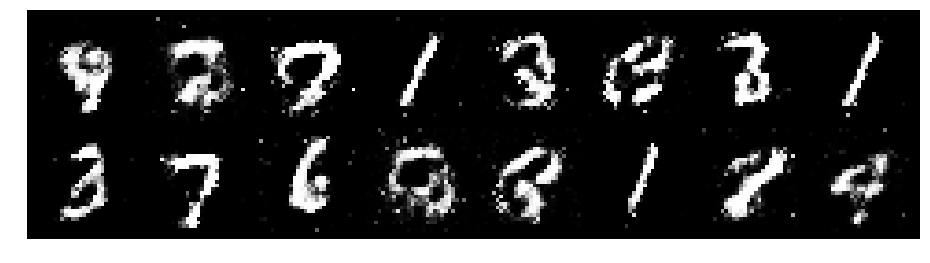

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 0.8016, Generator Loss: 2.0134
D(x): 0.7372, D(G(z)): 0.2656


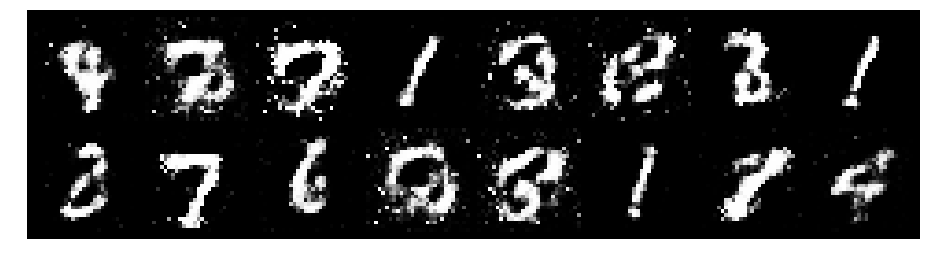

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 0.6847, Generator Loss: 2.0605
D(x): 0.7782, D(G(z)): 0.2406


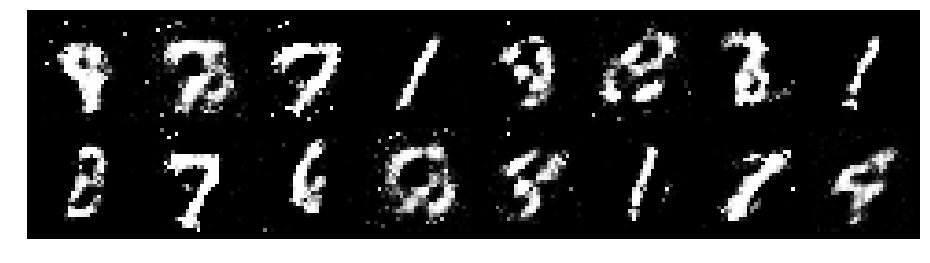

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 0.9469, Generator Loss: 1.5334
D(x): 0.6315, D(G(z)): 0.2370


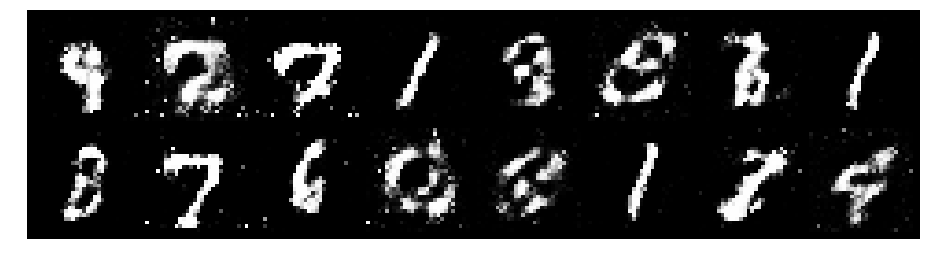

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 0.9686, Generator Loss: 1.7219
D(x): 0.6473, D(G(z)): 0.2692


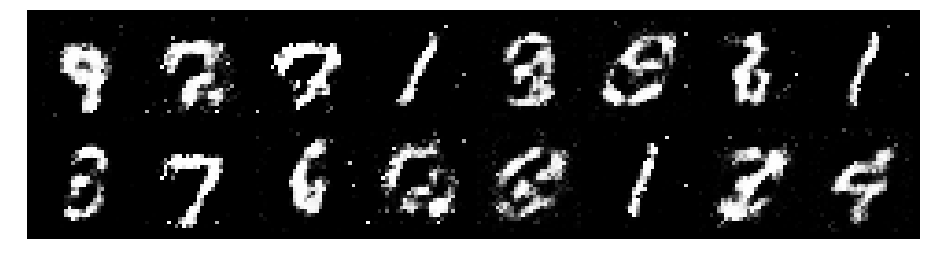

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 0.8572, Generator Loss: 1.5828
D(x): 0.7137, D(G(z)): 0.3016


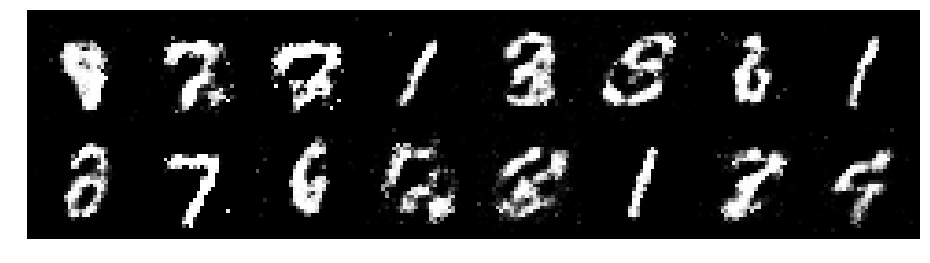

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 0.8702, Generator Loss: 1.5483
D(x): 0.8052, D(G(z)): 0.3663


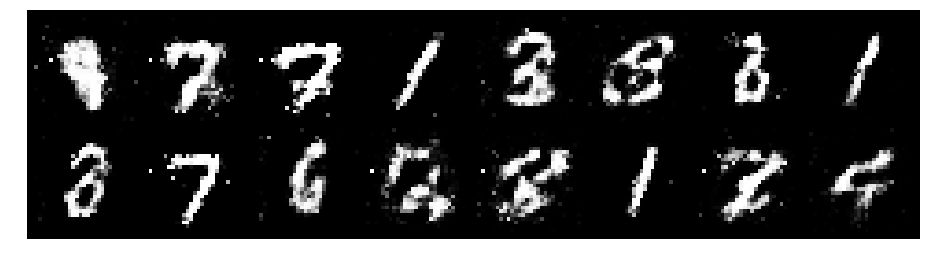

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 1.0669, Generator Loss: 1.2136
D(x): 0.6998, D(G(z)): 0.3735


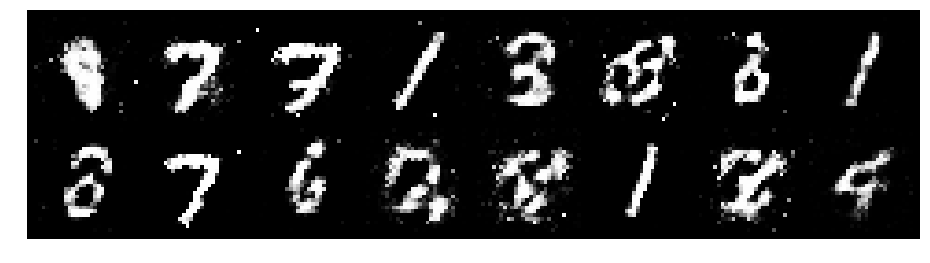

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 1.2652, Generator Loss: 1.6048
D(x): 0.6282, D(G(z)): 0.3444


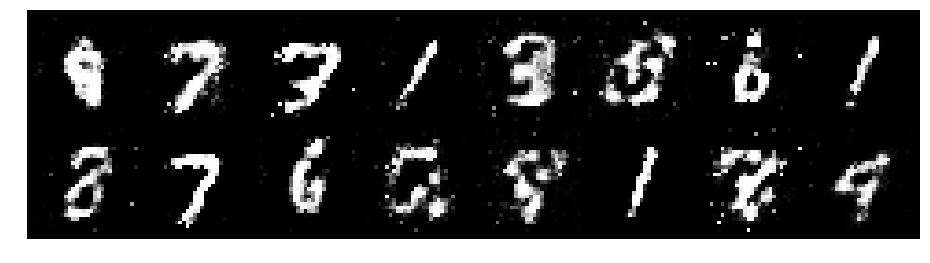

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 0.9287, Generator Loss: 1.2145
D(x): 0.6810, D(G(z)): 0.2970


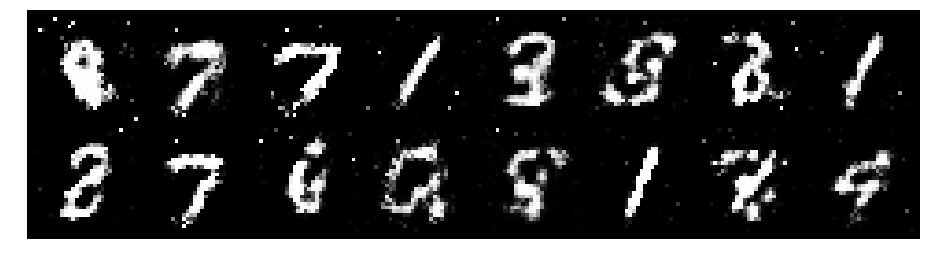

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 0.8563, Generator Loss: 1.1745
D(x): 0.7309, D(G(z)): 0.3452


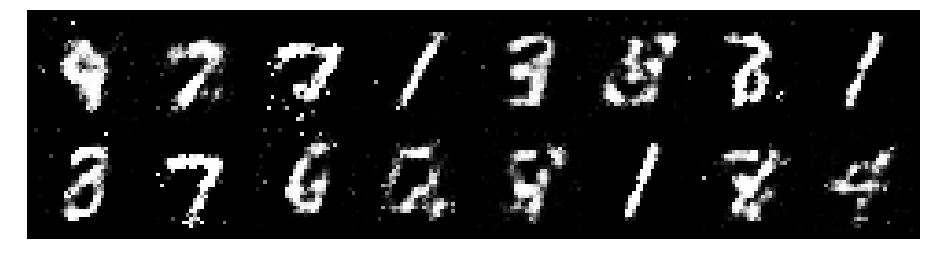

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 0.9374, Generator Loss: 1.5216
D(x): 0.6950, D(G(z)): 0.3409


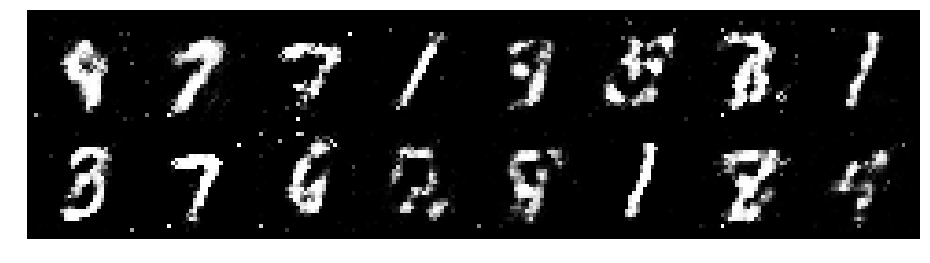

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 1.0514, Generator Loss: 1.1374
D(x): 0.6796, D(G(z)): 0.4204


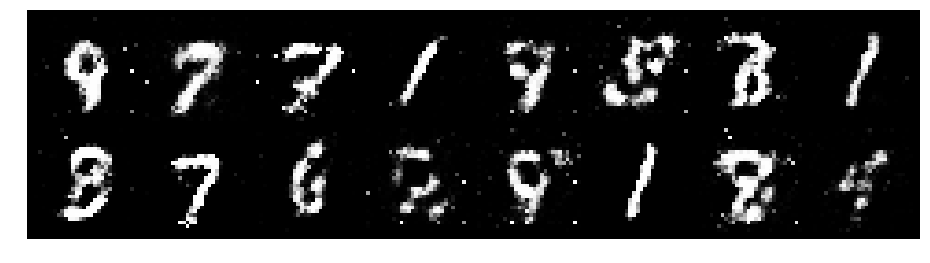

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 0.7816, Generator Loss: 1.7364
D(x): 0.6999, D(G(z)): 0.2591


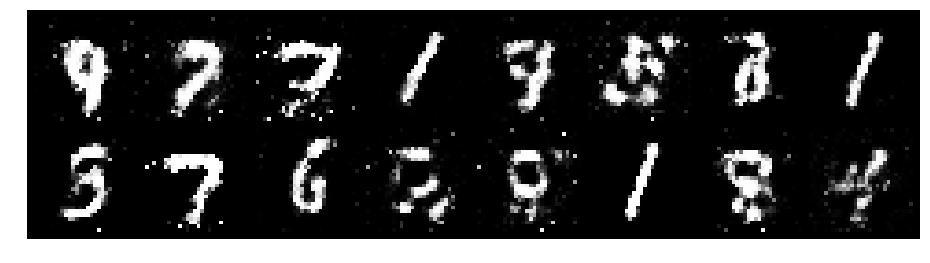

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 1.0705, Generator Loss: 1.4094
D(x): 0.6852, D(G(z)): 0.3482


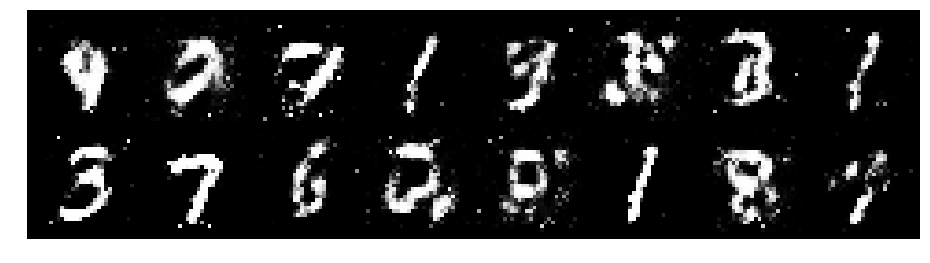

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 1.0467, Generator Loss: 1.3621
D(x): 0.6189, D(G(z)): 0.2806


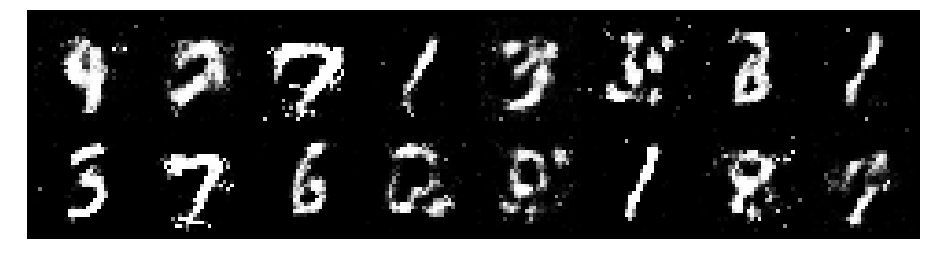

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 0.9758, Generator Loss: 1.7298
D(x): 0.7097, D(G(z)): 0.3338


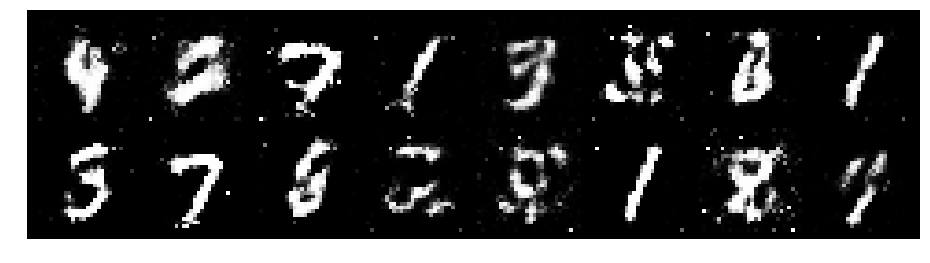

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 0.9927, Generator Loss: 1.4848
D(x): 0.6921, D(G(z)): 0.3276


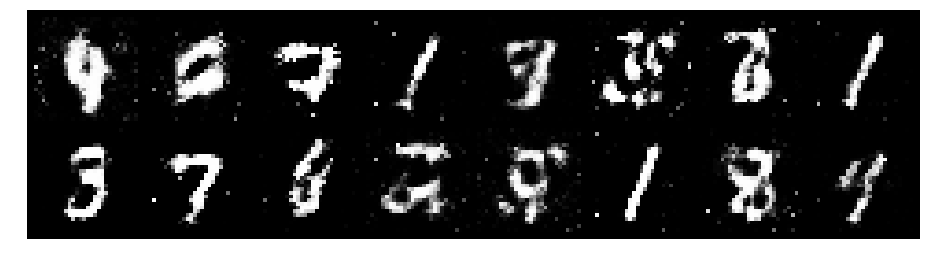

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 1.1821, Generator Loss: 0.9444
D(x): 0.6500, D(G(z)): 0.4471


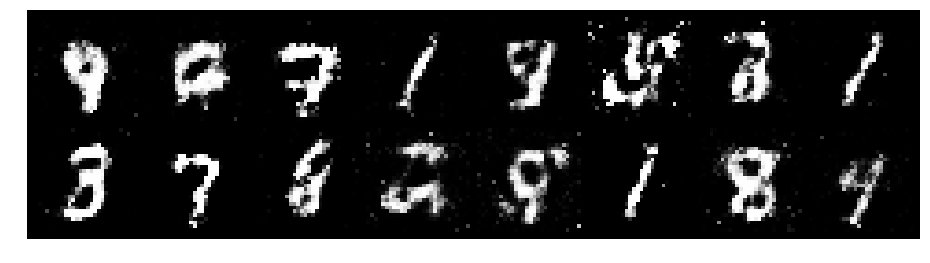

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 1.1996, Generator Loss: 0.9384
D(x): 0.6646, D(G(z)): 0.4358


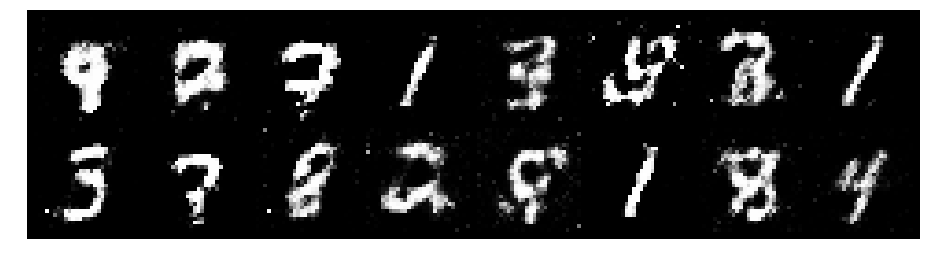

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 0.9233, Generator Loss: 1.4789
D(x): 0.7111, D(G(z)): 0.3163


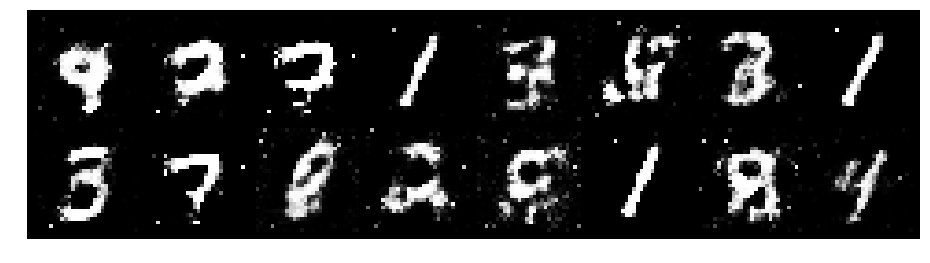

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 0.9377, Generator Loss: 1.2921
D(x): 0.6899, D(G(z)): 0.3246


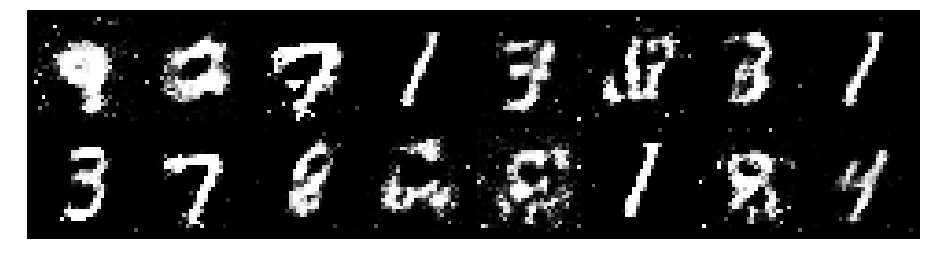

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 0.9491, Generator Loss: 1.6689
D(x): 0.6887, D(G(z)): 0.3188


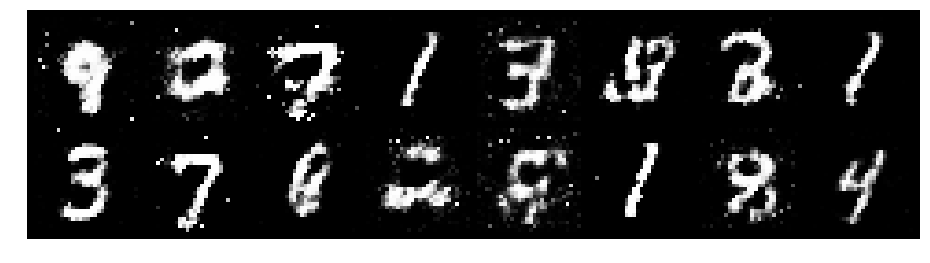

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 1.1888, Generator Loss: 1.3441
D(x): 0.6479, D(G(z)): 0.3469


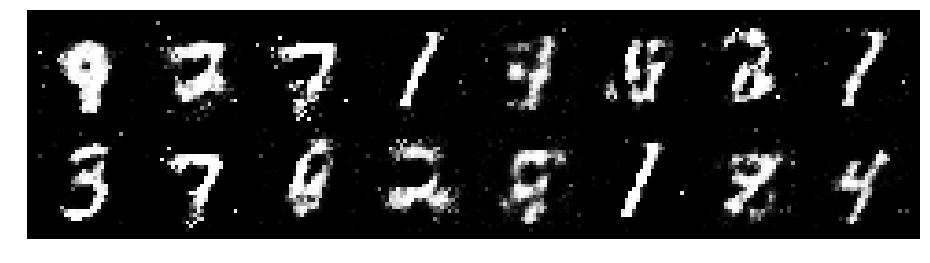

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 1.2480, Generator Loss: 1.2089
D(x): 0.6674, D(G(z)): 0.4380


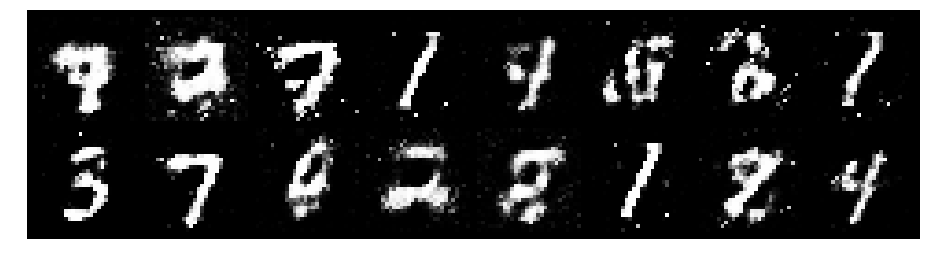

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 0.7978, Generator Loss: 1.4095
D(x): 0.7260, D(G(z)): 0.3134


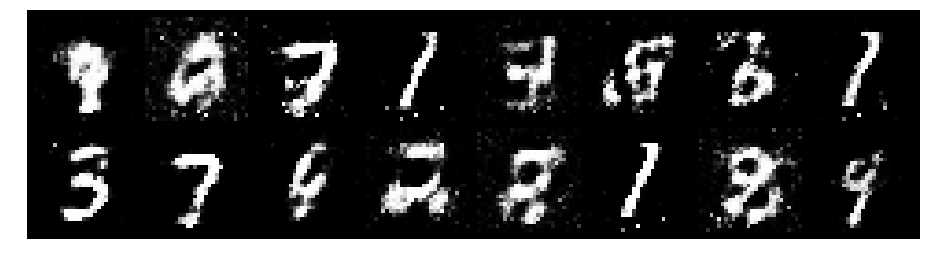

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 1.2084, Generator Loss: 1.4259
D(x): 0.6971, D(G(z)): 0.4292


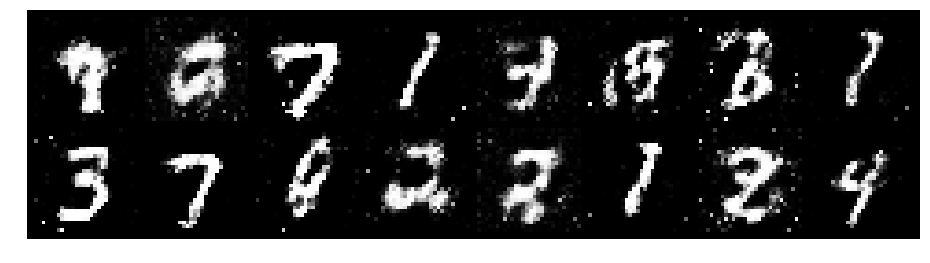

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 0.9039, Generator Loss: 1.5208
D(x): 0.6913, D(G(z)): 0.3039


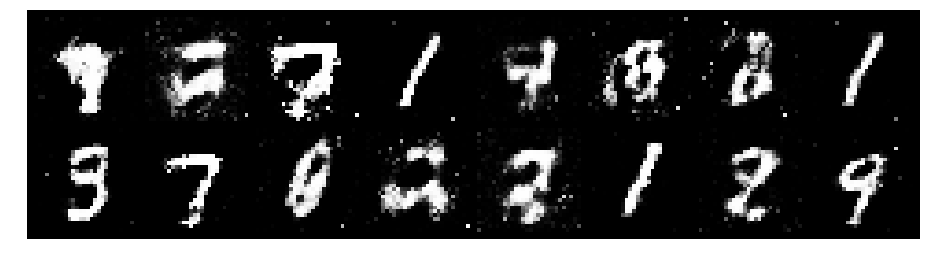

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 0.8879, Generator Loss: 1.3114
D(x): 0.7542, D(G(z)): 0.3632


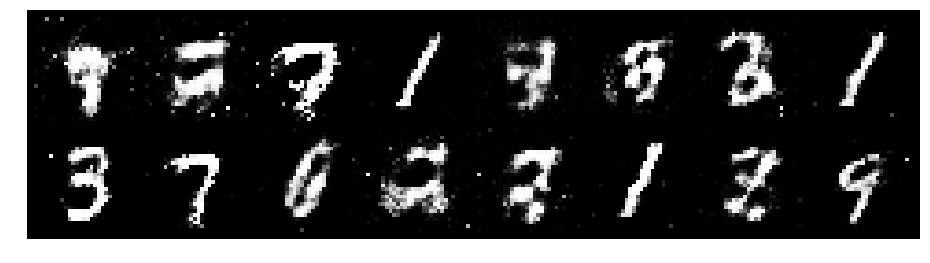

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 0.9665, Generator Loss: 1.4725
D(x): 0.7099, D(G(z)): 0.3239


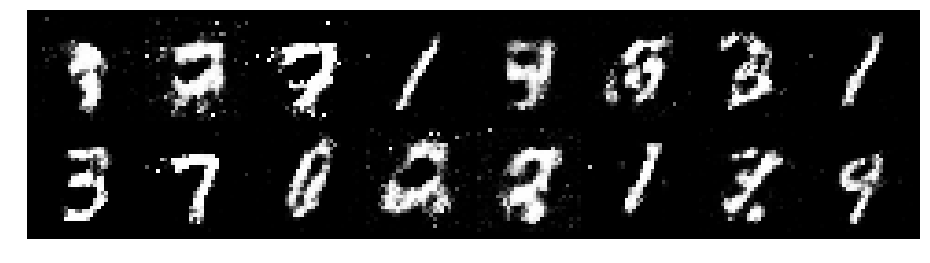

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 0.9252, Generator Loss: 1.5075
D(x): 0.7292, D(G(z)): 0.3691


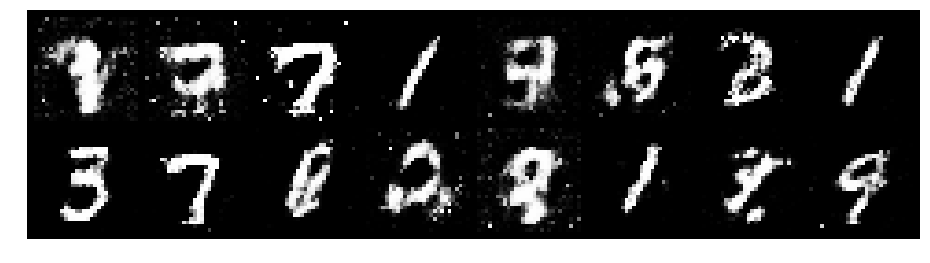

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 1.0376, Generator Loss: 1.2349
D(x): 0.6543, D(G(z)): 0.3551


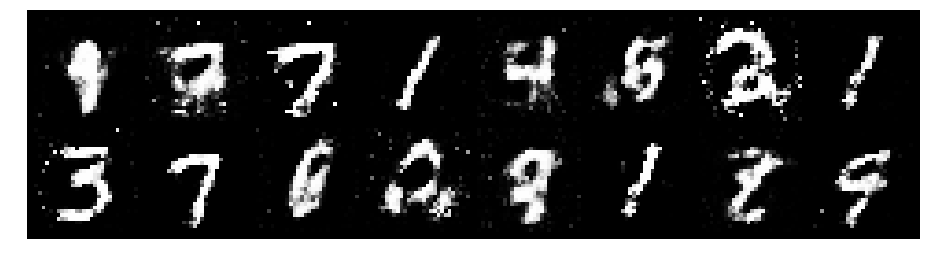

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 1.2534, Generator Loss: 1.0057
D(x): 0.6243, D(G(z)): 0.4498


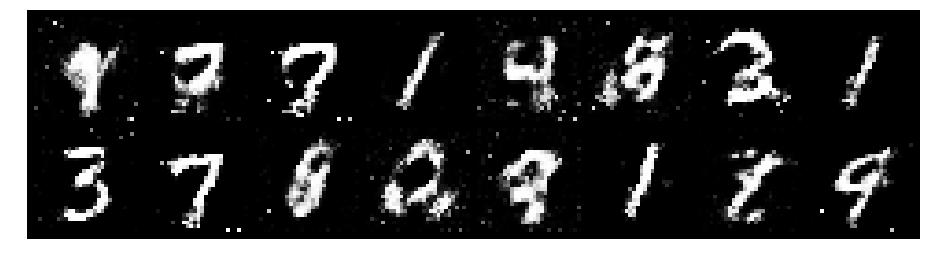

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 1.0410, Generator Loss: 0.9901
D(x): 0.6648, D(G(z)): 0.3906


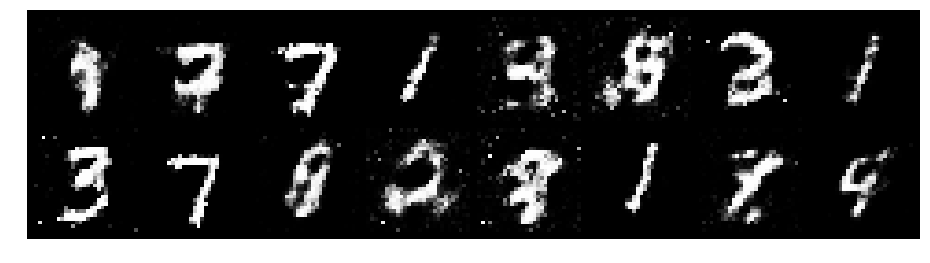

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 0.8548, Generator Loss: 1.3543
D(x): 0.7556, D(G(z)): 0.3590


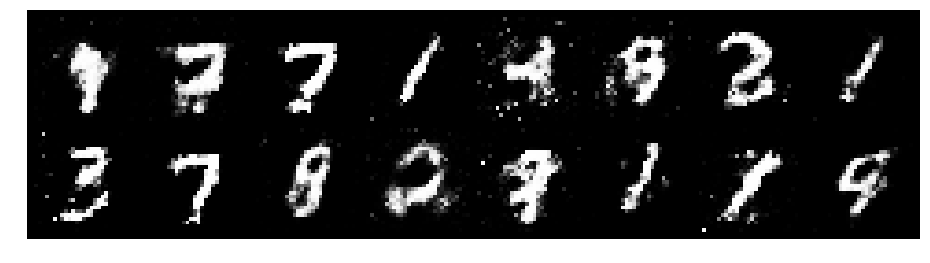

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 0.9206, Generator Loss: 1.4978
D(x): 0.6804, D(G(z)): 0.2875


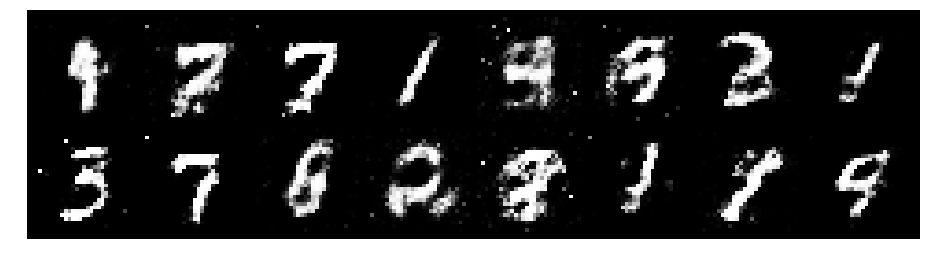

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 1.0419, Generator Loss: 1.2966
D(x): 0.6148, D(G(z)): 0.3262


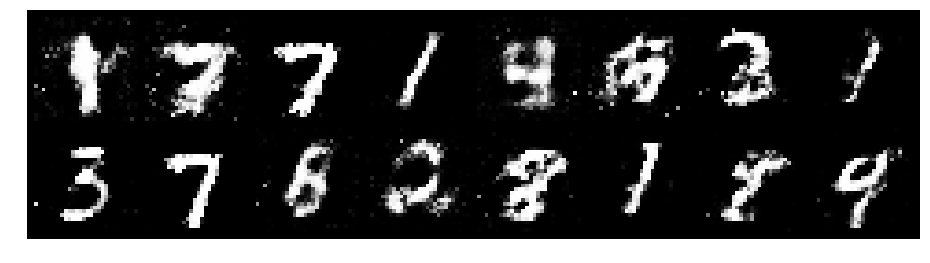

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 1.1529, Generator Loss: 1.2734
D(x): 0.6597, D(G(z)): 0.4166


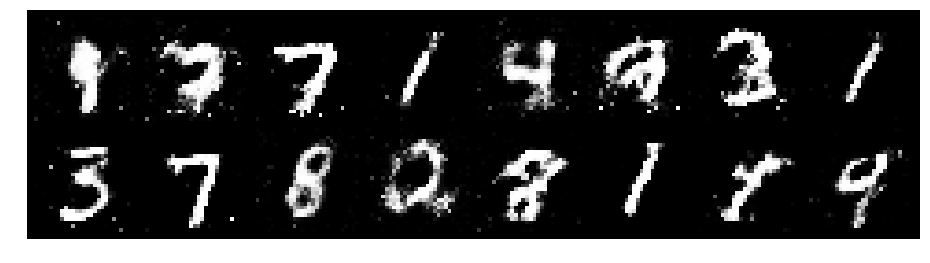

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 1.0497, Generator Loss: 1.3569
D(x): 0.6648, D(G(z)): 0.3466


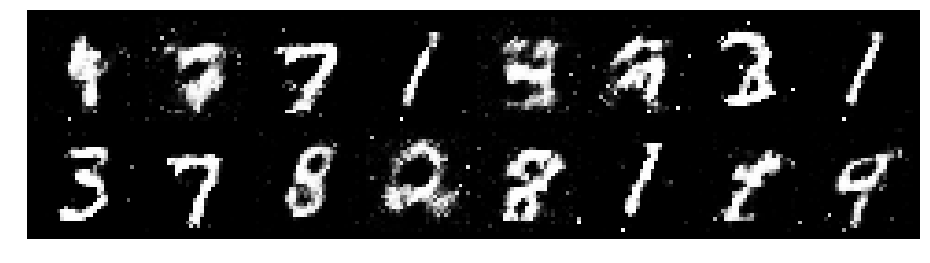

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 0.9771, Generator Loss: 1.4148
D(x): 0.6858, D(G(z)): 0.3533


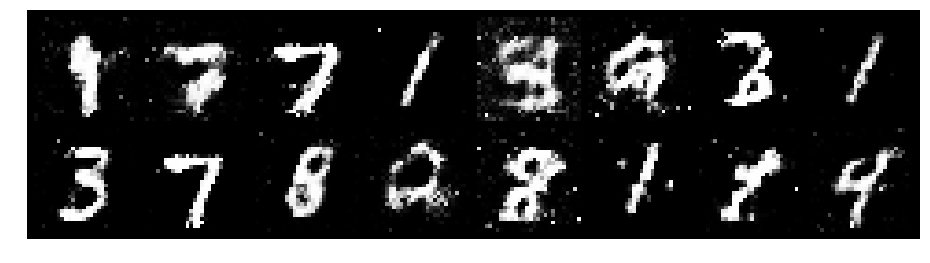

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 1.1822, Generator Loss: 1.0267
D(x): 0.6332, D(G(z)): 0.4028


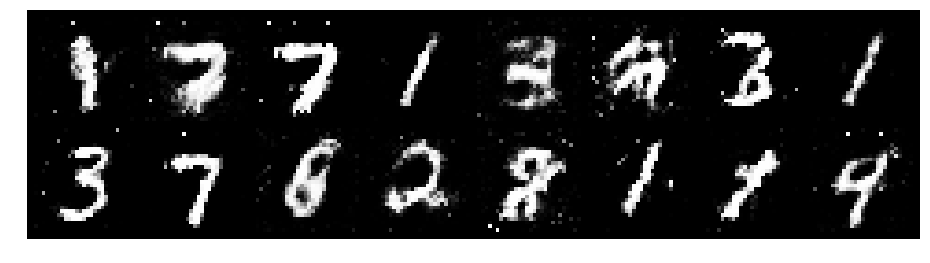

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 0.9737, Generator Loss: 1.3764
D(x): 0.6478, D(G(z)): 0.3166


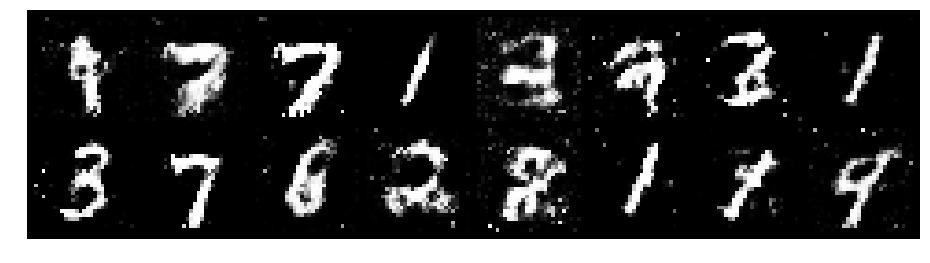

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 0.9932, Generator Loss: 1.4564
D(x): 0.6562, D(G(z)): 0.3232


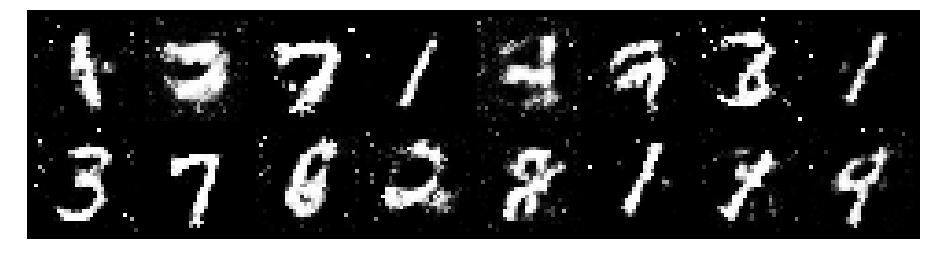

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 0.9366, Generator Loss: 1.7468
D(x): 0.6760, D(G(z)): 0.2968


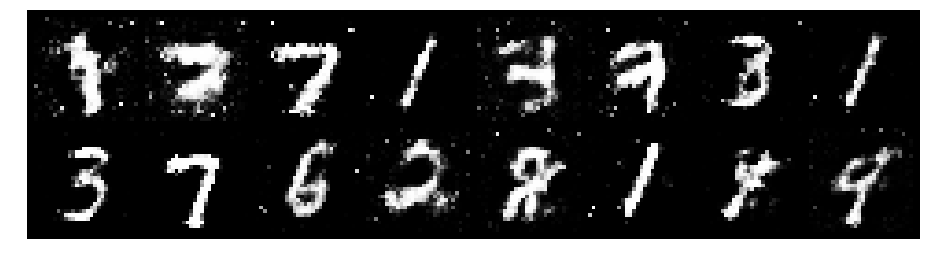

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 1.0298, Generator Loss: 1.5268
D(x): 0.7042, D(G(z)): 0.3610


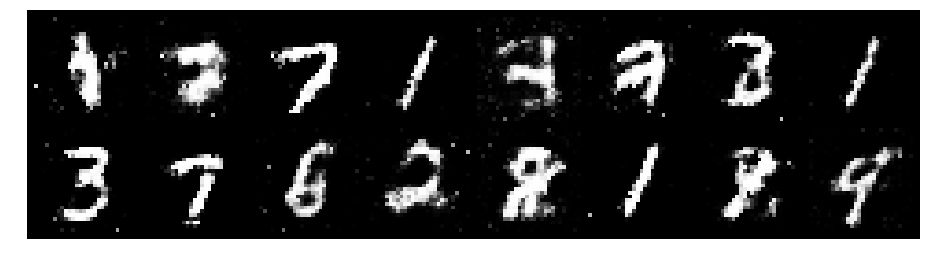

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 1.0597, Generator Loss: 1.3123
D(x): 0.5805, D(G(z)): 0.2683


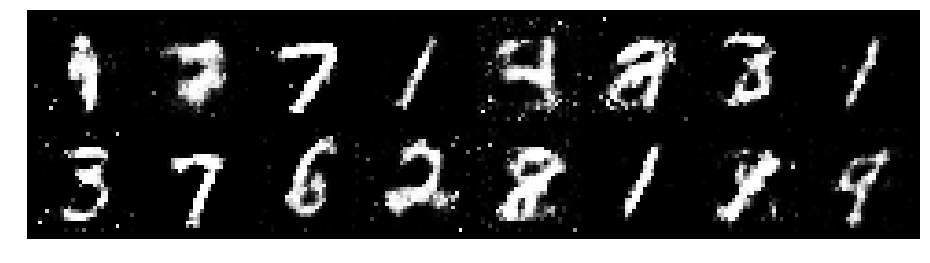

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 0.8949, Generator Loss: 1.6556
D(x): 0.6967, D(G(z)): 0.2756


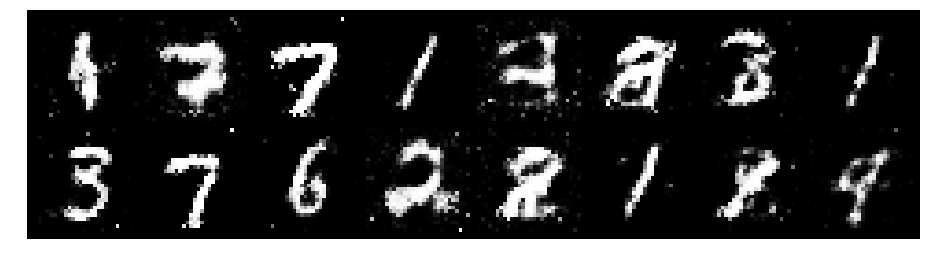

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 1.1636, Generator Loss: 1.1011
D(x): 0.6136, D(G(z)): 0.3656


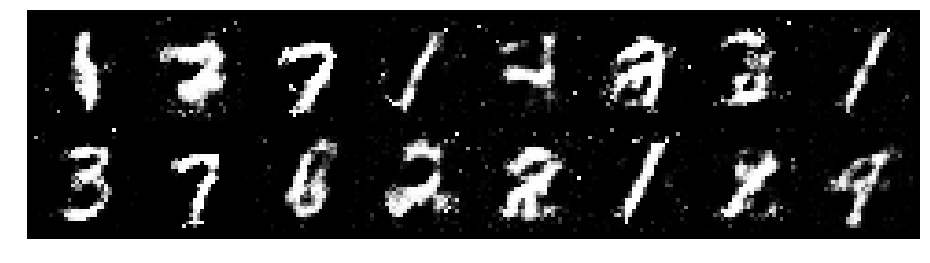

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 0.9806, Generator Loss: 1.2706
D(x): 0.6306, D(G(z)): 0.2898


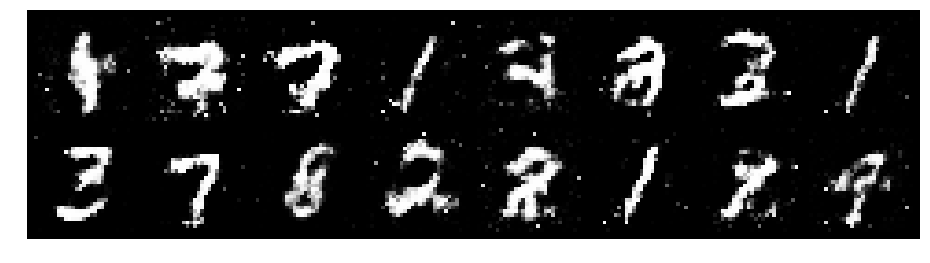

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 0.8581, Generator Loss: 1.6646
D(x): 0.7063, D(G(z)): 0.3102


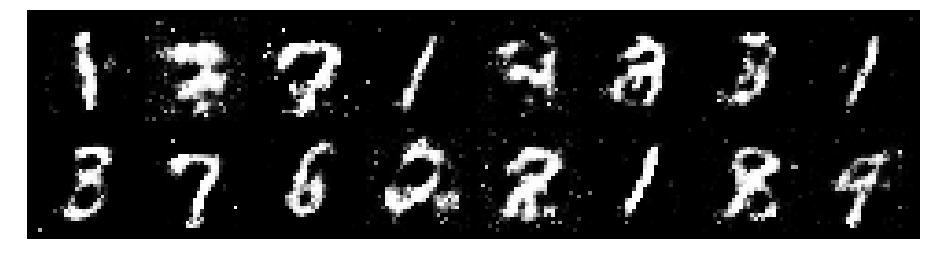

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 1.0071, Generator Loss: 1.2747
D(x): 0.6361, D(G(z)): 0.3285


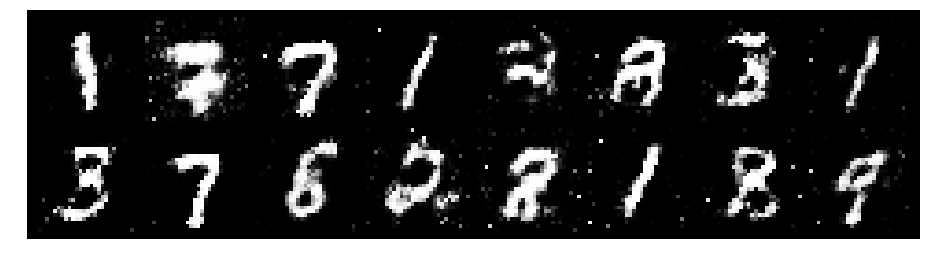

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 1.0117, Generator Loss: 1.2302
D(x): 0.7131, D(G(z)): 0.3954


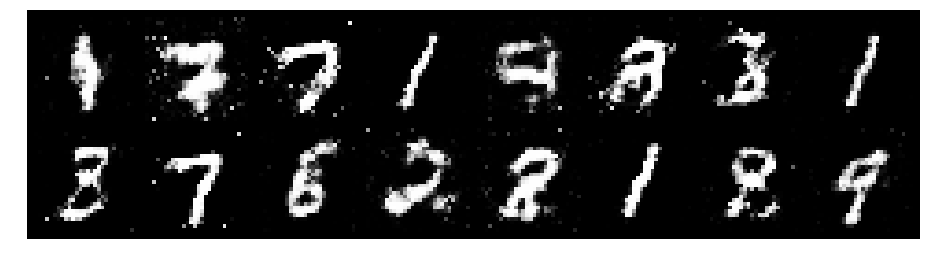

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 1.0401, Generator Loss: 1.8271
D(x): 0.6294, D(G(z)): 0.3105


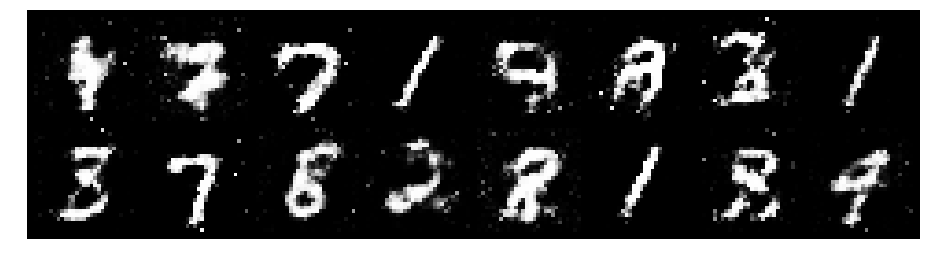

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 1.2698, Generator Loss: 1.3420
D(x): 0.5085, D(G(z)): 0.2746


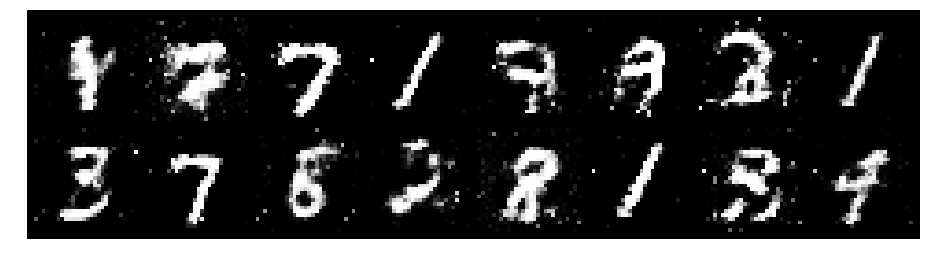

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 1.2042, Generator Loss: 1.3204
D(x): 0.6551, D(G(z)): 0.3990


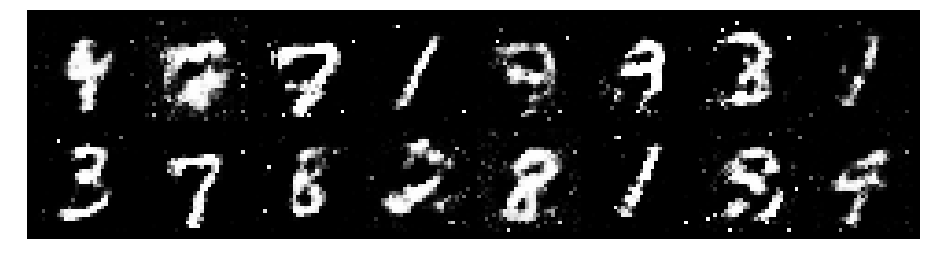

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 0.9042, Generator Loss: 1.3002
D(x): 0.6908, D(G(z)): 0.3245


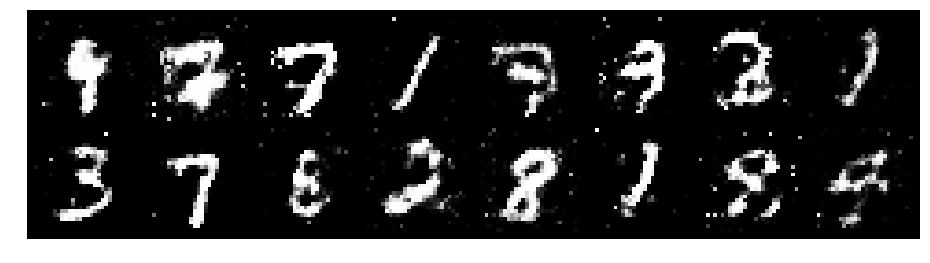

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 1.0951, Generator Loss: 1.5679
D(x): 0.6614, D(G(z)): 0.3813


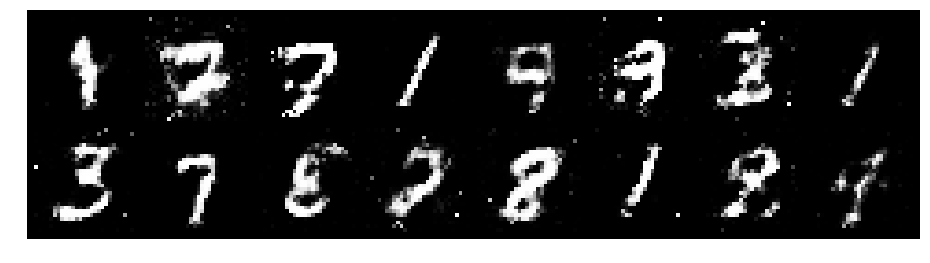

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 1.0816, Generator Loss: 1.3356
D(x): 0.6550, D(G(z)): 0.3839


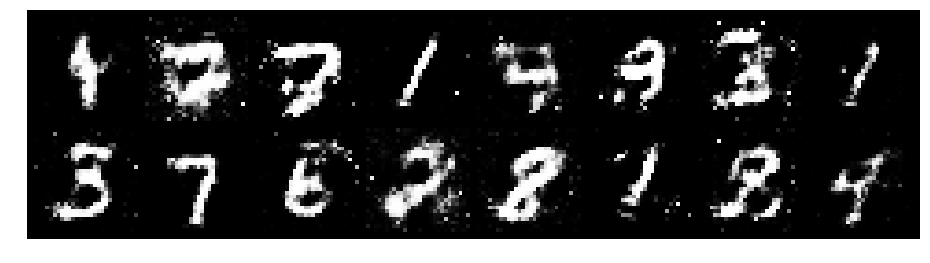

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.2138, Generator Loss: 1.2379
D(x): 0.5613, D(G(z)): 0.3808


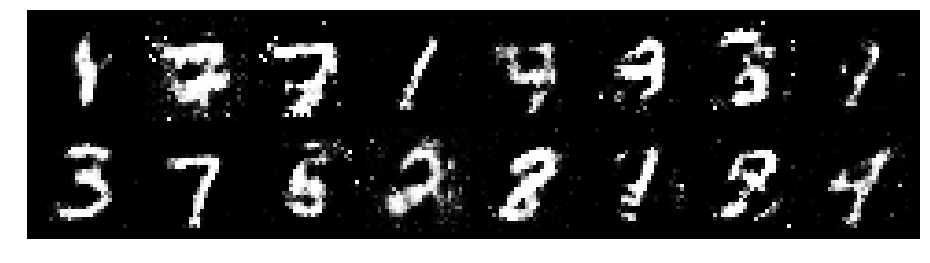

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 1.1810, Generator Loss: 1.1311
D(x): 0.5153, D(G(z)): 0.2939


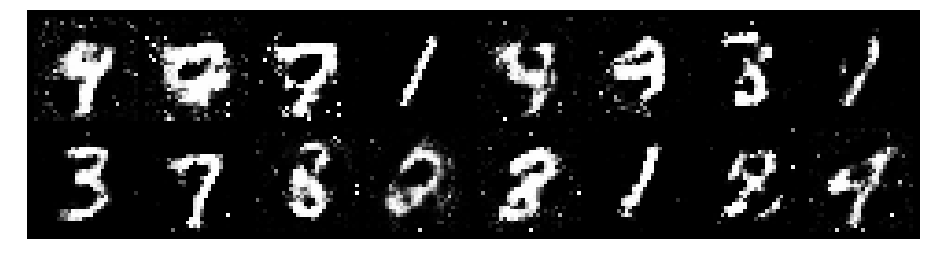

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 1.1638, Generator Loss: 1.1212
D(x): 0.6566, D(G(z)): 0.4281


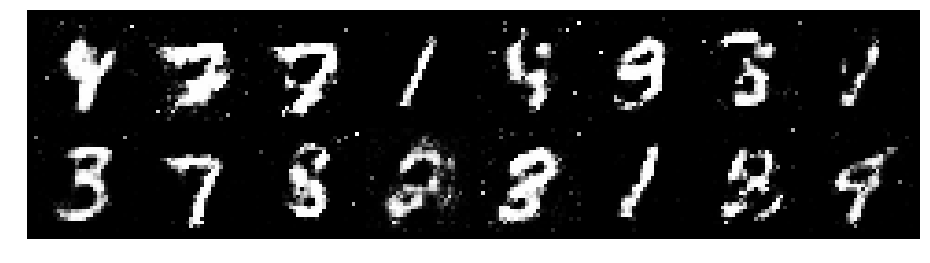

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 1.1629, Generator Loss: 1.4283
D(x): 0.7111, D(G(z)): 0.4291


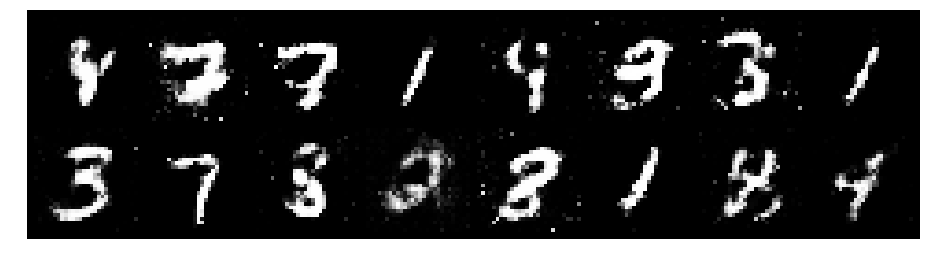

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.1425, Generator Loss: 1.1760
D(x): 0.6543, D(G(z)): 0.4045


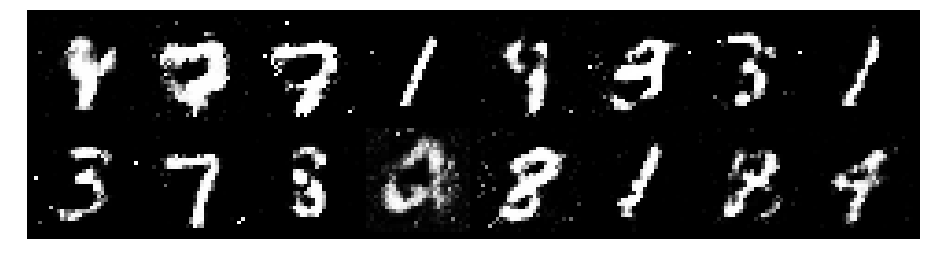

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 1.1467, Generator Loss: 1.3596
D(x): 0.5667, D(G(z)): 0.3162


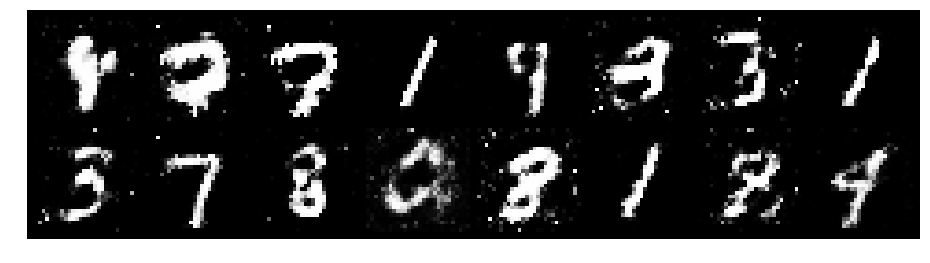

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 1.0664, Generator Loss: 1.6756
D(x): 0.6269, D(G(z)): 0.2953


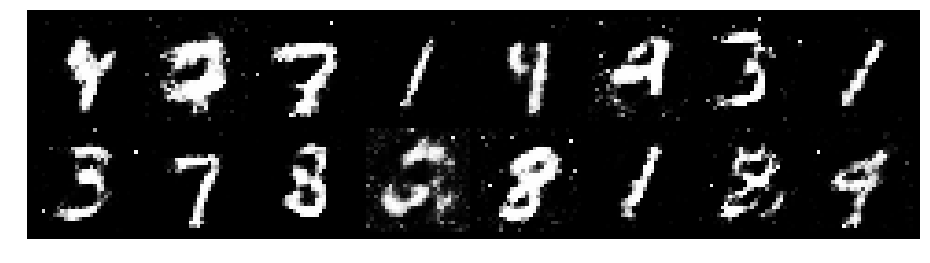

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 0.8146, Generator Loss: 1.5288
D(x): 0.7476, D(G(z)): 0.3242


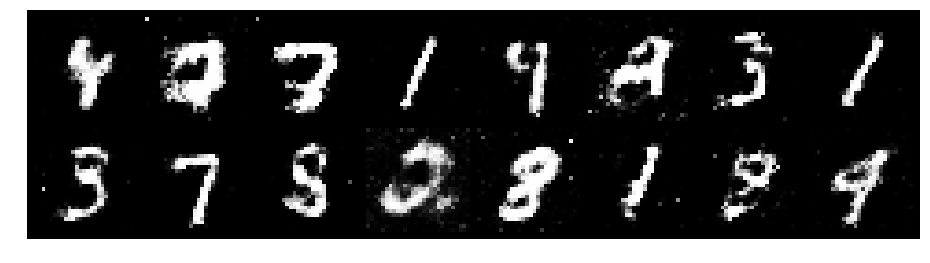

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 1.0794, Generator Loss: 1.1163
D(x): 0.5754, D(G(z)): 0.2906


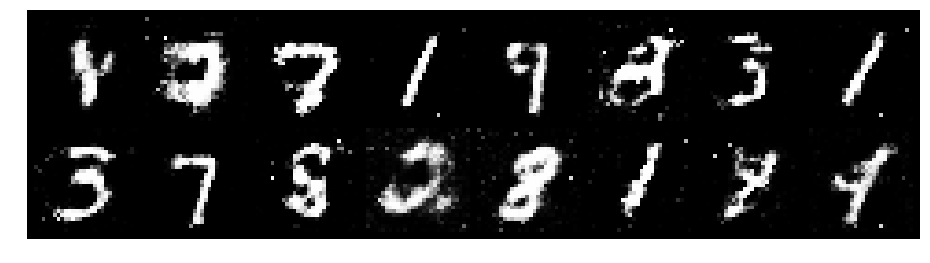

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 1.0717, Generator Loss: 1.1893
D(x): 0.6220, D(G(z)): 0.3712


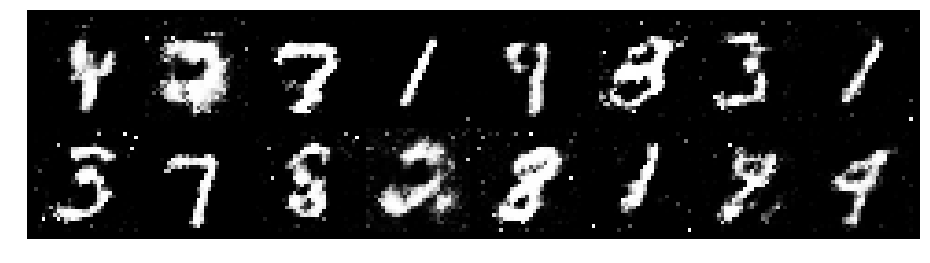

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 1.0715, Generator Loss: 1.6179
D(x): 0.6277, D(G(z)): 0.3187


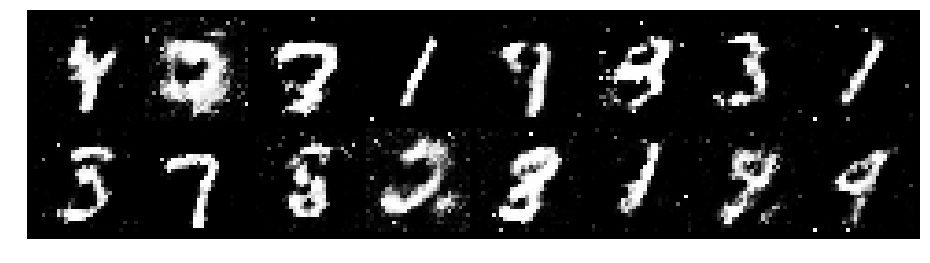

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 0.8705, Generator Loss: 1.3437
D(x): 0.6830, D(G(z)): 0.2963


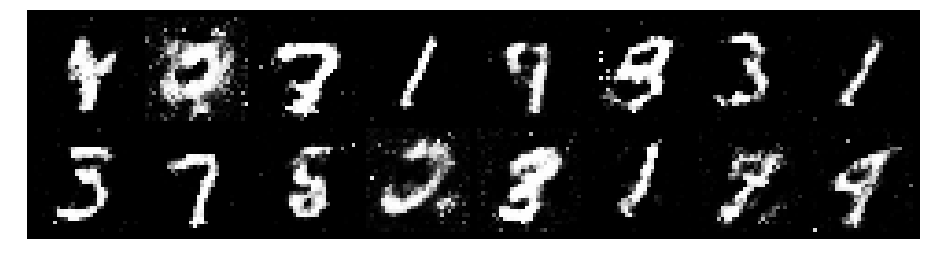

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 1.2046, Generator Loss: 1.3658
D(x): 0.6416, D(G(z)): 0.4065


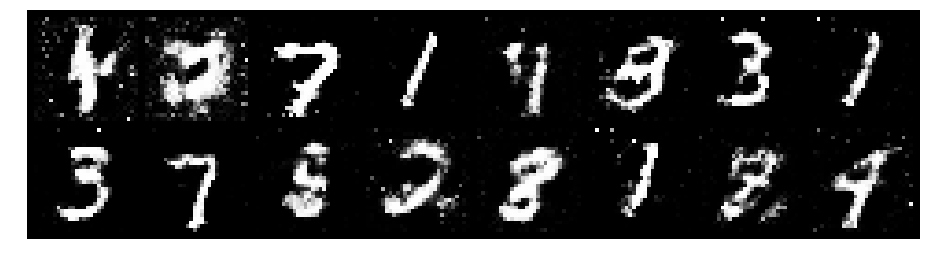

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.2238, Generator Loss: 1.1714
D(x): 0.5679, D(G(z)): 0.3726


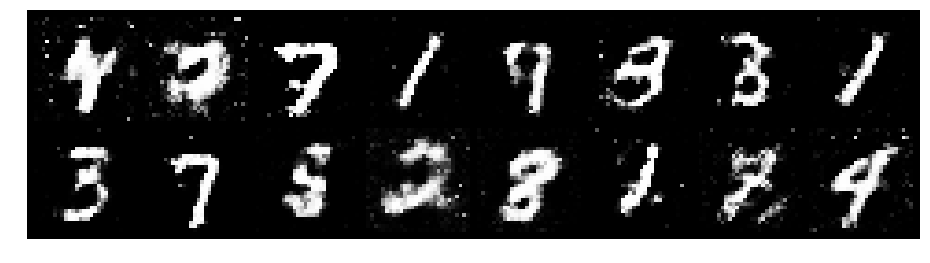

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 0.9869, Generator Loss: 1.5743
D(x): 0.6683, D(G(z)): 0.3338


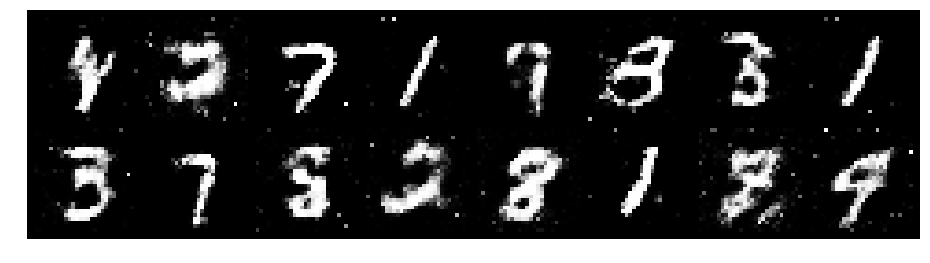

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 1.0339, Generator Loss: 1.4799
D(x): 0.6297, D(G(z)): 0.3226


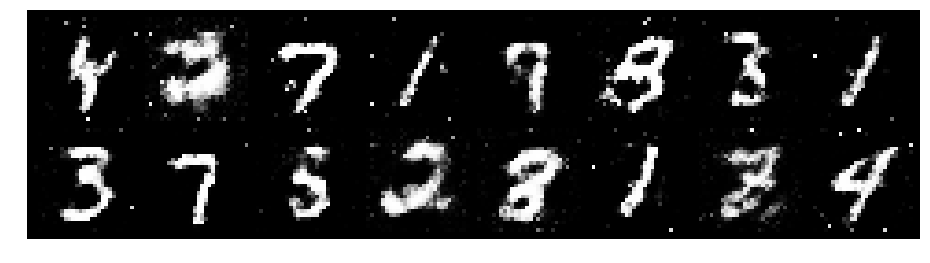

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 0.9825, Generator Loss: 1.6782
D(x): 0.6164, D(G(z)): 0.2917


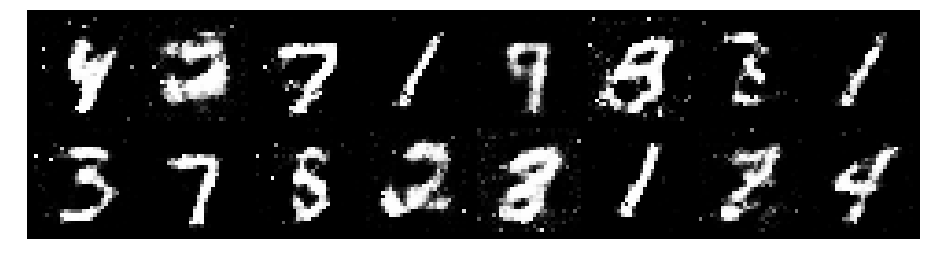

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 0.8736, Generator Loss: 1.5997
D(x): 0.7584, D(G(z)): 0.3305


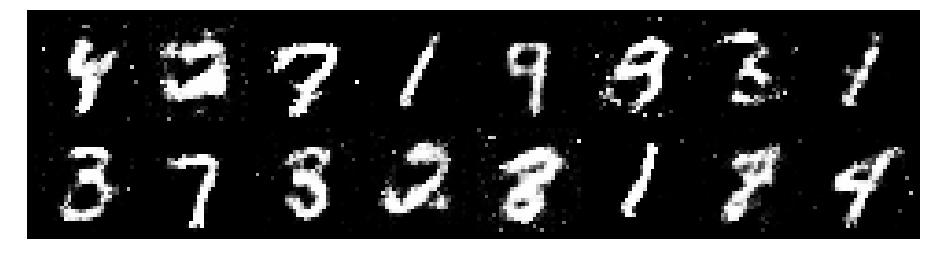

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 0.9461, Generator Loss: 1.4829
D(x): 0.6649, D(G(z)): 0.3061


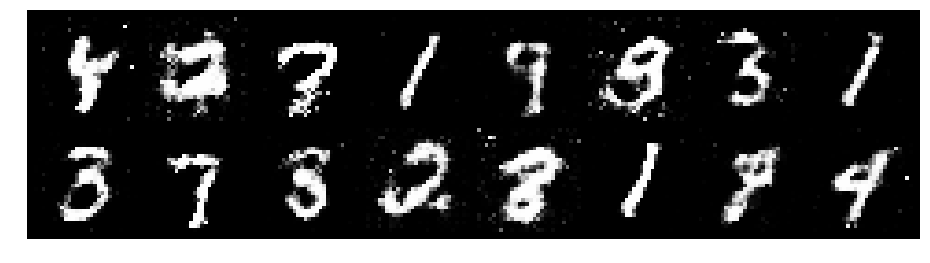

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 0.9711, Generator Loss: 1.3785
D(x): 0.6186, D(G(z)): 0.3083


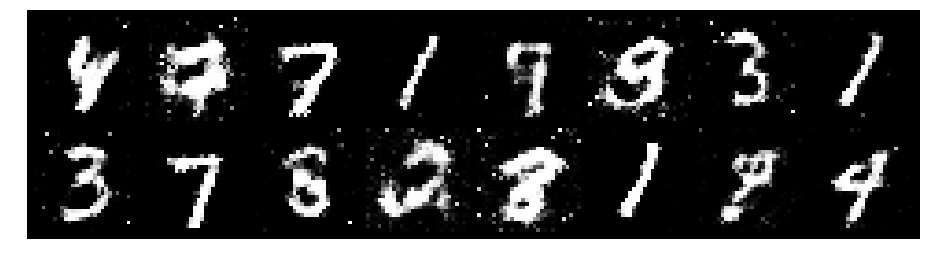

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 1.0729, Generator Loss: 1.3199
D(x): 0.6583, D(G(z)): 0.3991


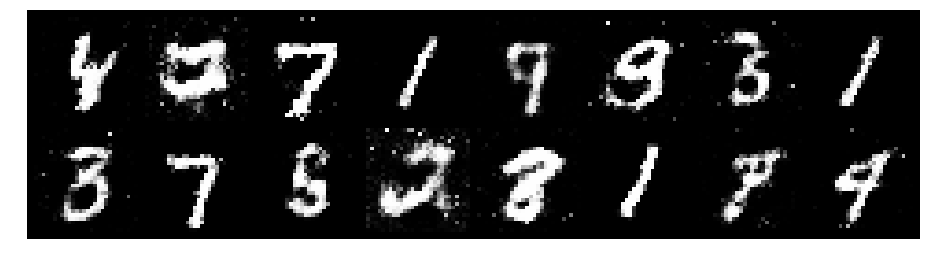

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 1.0338, Generator Loss: 1.3326
D(x): 0.6082, D(G(z)): 0.3114


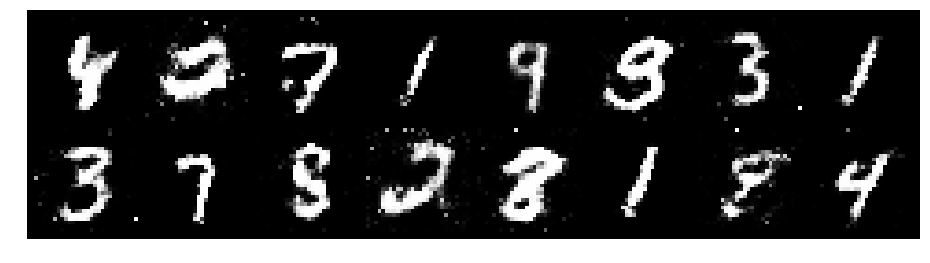

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 1.1293, Generator Loss: 1.0749
D(x): 0.6738, D(G(z)): 0.4563


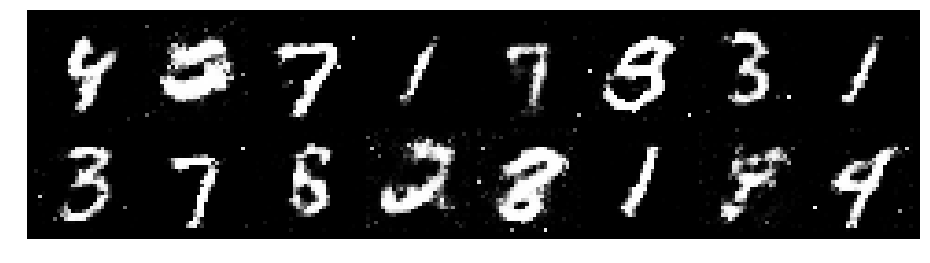

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 1.0515, Generator Loss: 1.3545
D(x): 0.5323, D(G(z)): 0.2628


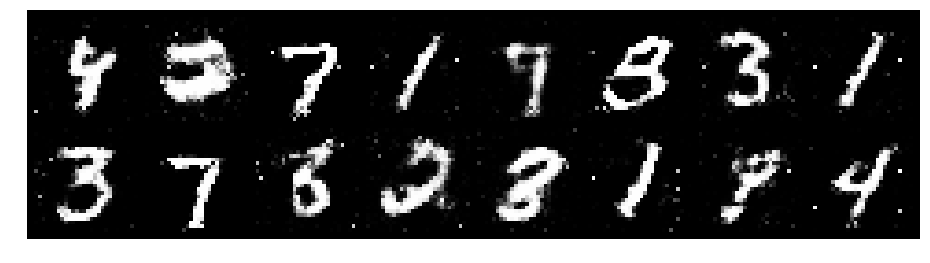

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.0496, Generator Loss: 1.1558
D(x): 0.6938, D(G(z)): 0.4021


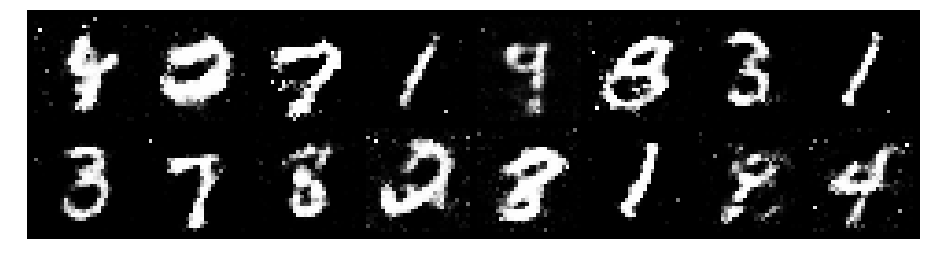

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 1.3189, Generator Loss: 1.3446
D(x): 0.5085, D(G(z)): 0.3328


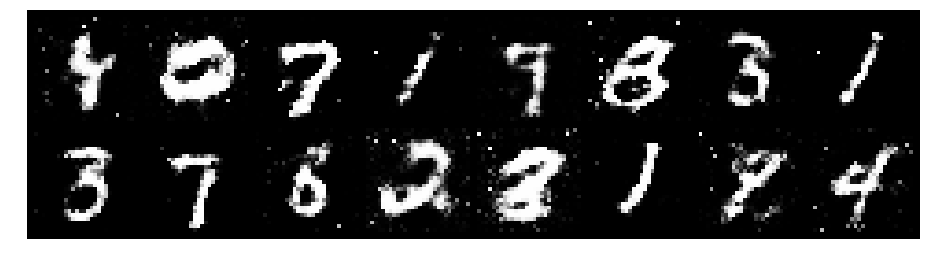

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 1.0827, Generator Loss: 1.4074
D(x): 0.6526, D(G(z)): 0.3657


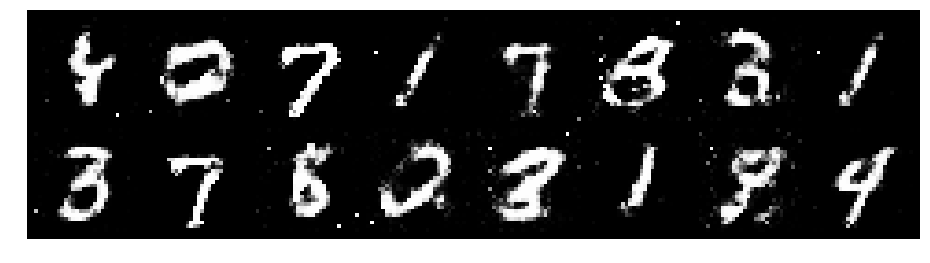

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 1.1559, Generator Loss: 1.1741
D(x): 0.6050, D(G(z)): 0.4028


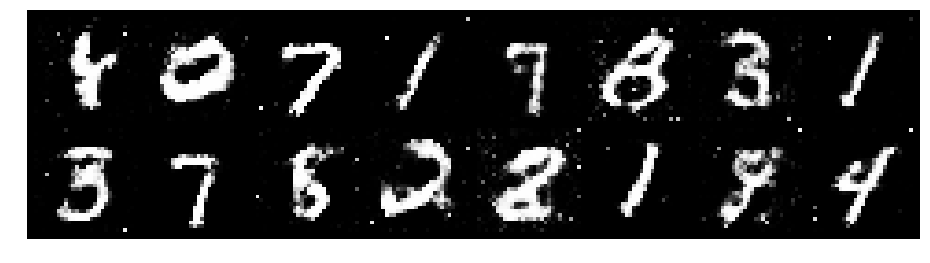

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.0990, Generator Loss: 1.3669
D(x): 0.6183, D(G(z)): 0.3672


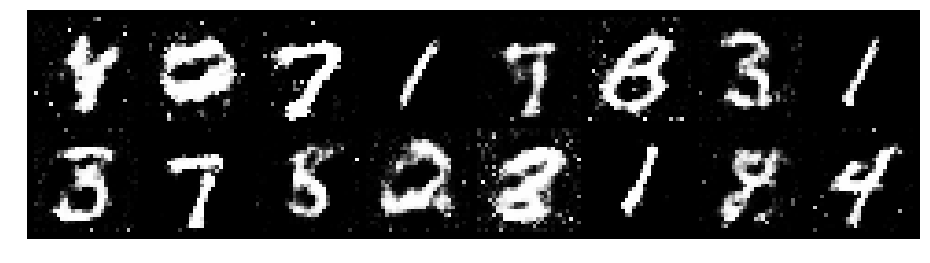

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 1.1232, Generator Loss: 0.9938
D(x): 0.6239, D(G(z)): 0.3820


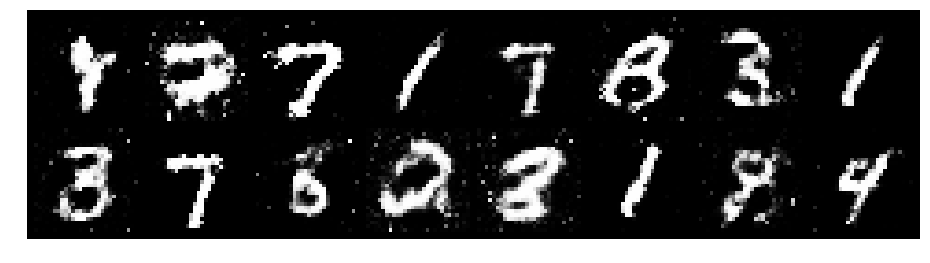

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 1.1610, Generator Loss: 1.0631
D(x): 0.6154, D(G(z)): 0.4023


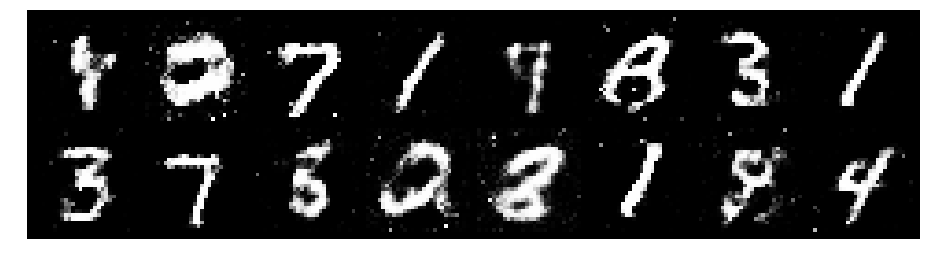

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 1.1112, Generator Loss: 1.2728
D(x): 0.6064, D(G(z)): 0.3705


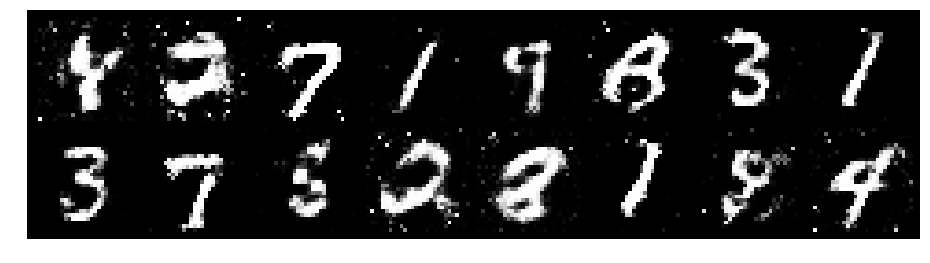

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 1.1780, Generator Loss: 1.1851
D(x): 0.6096, D(G(z)): 0.4092


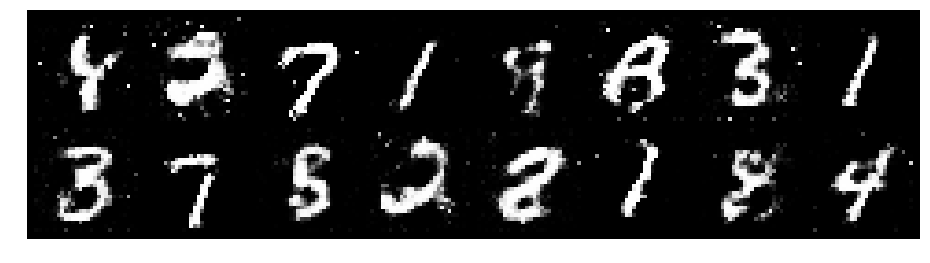

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 1.0497, Generator Loss: 1.1985
D(x): 0.6394, D(G(z)): 0.3564


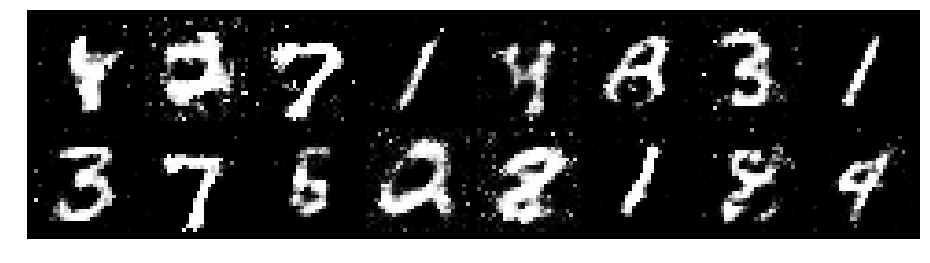

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 1.0923, Generator Loss: 1.1381
D(x): 0.7041, D(G(z)): 0.4082


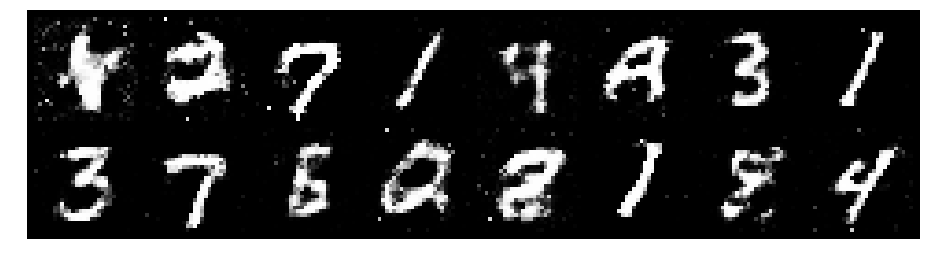

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 1.0264, Generator Loss: 1.2795
D(x): 0.6578, D(G(z)): 0.3374


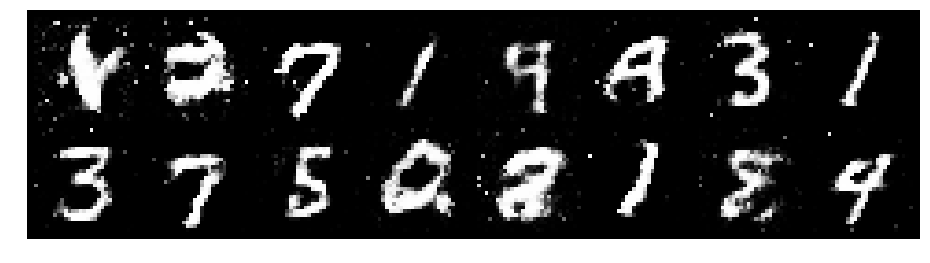

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 1.3313, Generator Loss: 1.3274
D(x): 0.5951, D(G(z)): 0.4253


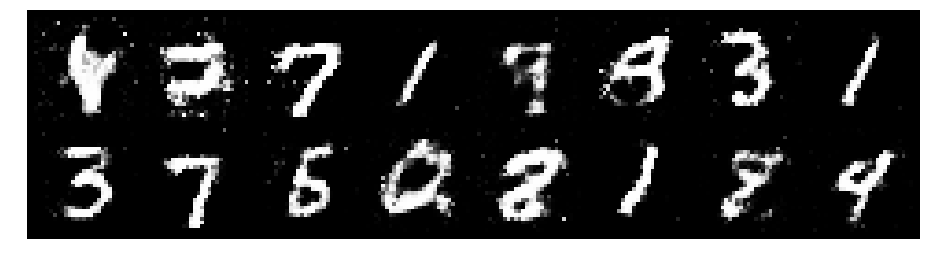

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 1.1652, Generator Loss: 1.3105
D(x): 0.5841, D(G(z)): 0.3396


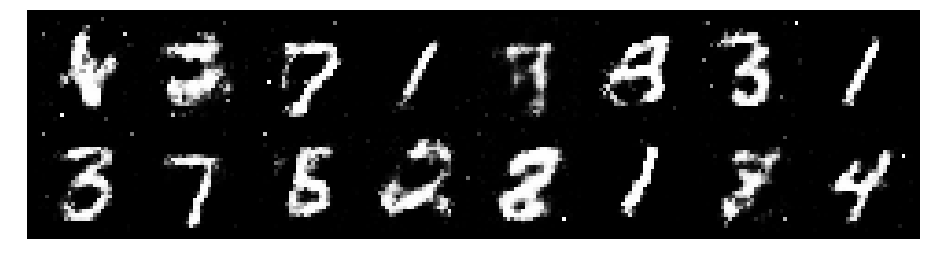

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 1.0170, Generator Loss: 1.3020
D(x): 0.6190, D(G(z)): 0.3187


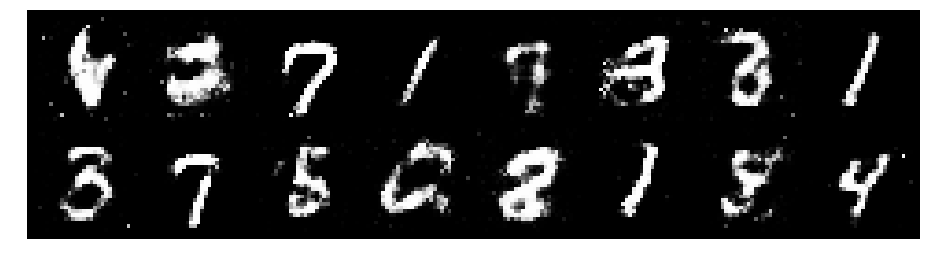

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 1.1875, Generator Loss: 1.3759
D(x): 0.6018, D(G(z)): 0.3771


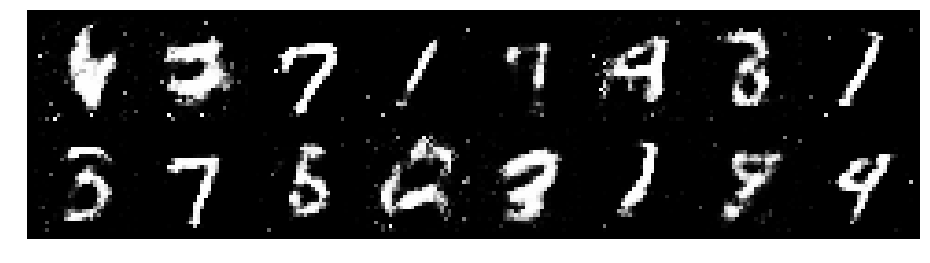

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 0.9942, Generator Loss: 1.4568
D(x): 0.6711, D(G(z)): 0.3658


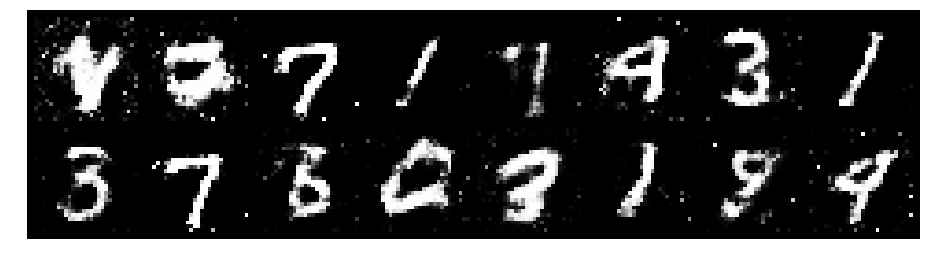

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 0.9501, Generator Loss: 1.3611
D(x): 0.6785, D(G(z)): 0.3498


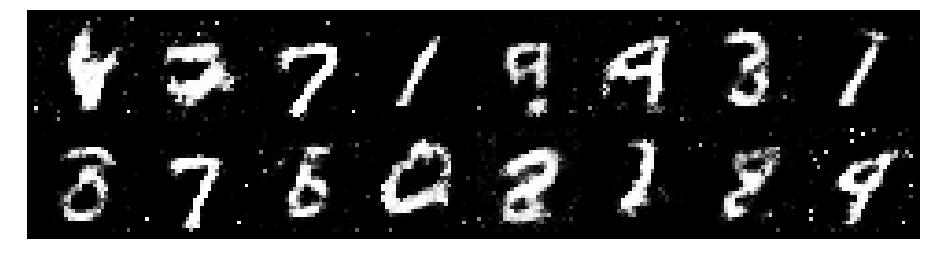

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 1.1543, Generator Loss: 1.3801
D(x): 0.6562, D(G(z)): 0.4075


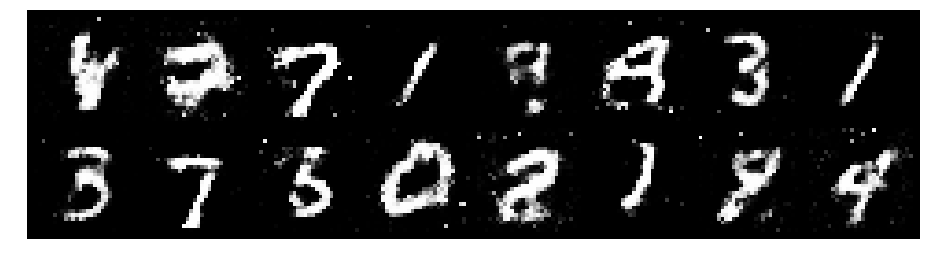

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 1.1891, Generator Loss: 1.5765
D(x): 0.6141, D(G(z)): 0.3742


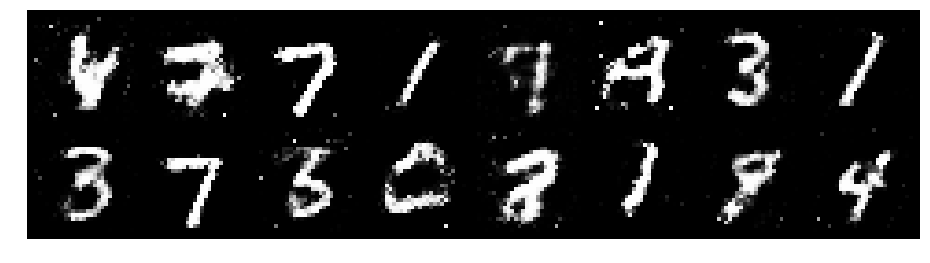

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 0.9629, Generator Loss: 1.3098
D(x): 0.6348, D(G(z)): 0.3338


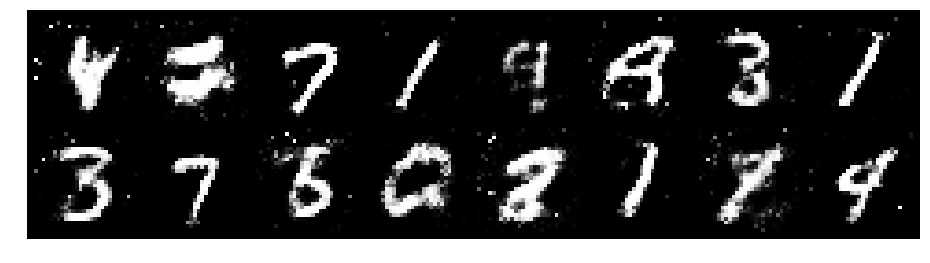

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 1.0521, Generator Loss: 1.3314
D(x): 0.6703, D(G(z)): 0.3915


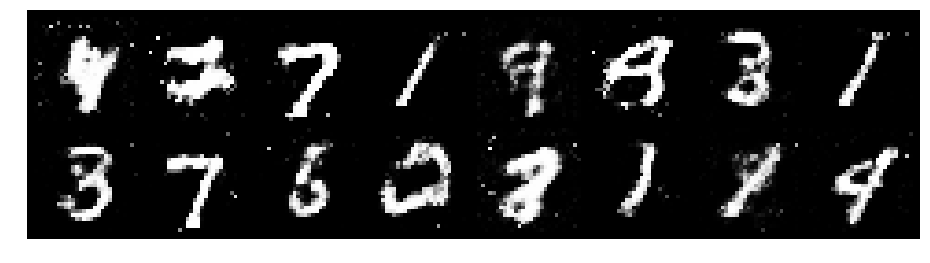

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.0206, Generator Loss: 1.2181
D(x): 0.6944, D(G(z)): 0.3822


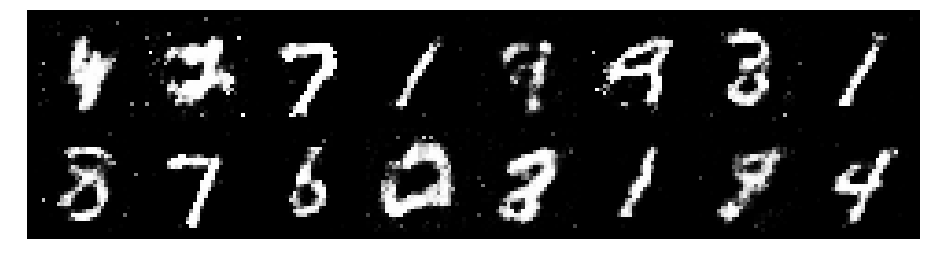

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.1630, Generator Loss: 1.1930
D(x): 0.6638, D(G(z)): 0.4281


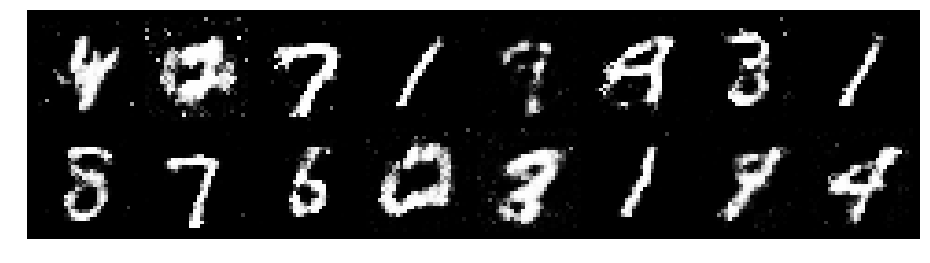

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 1.1177, Generator Loss: 1.3231
D(x): 0.6861, D(G(z)): 0.3957


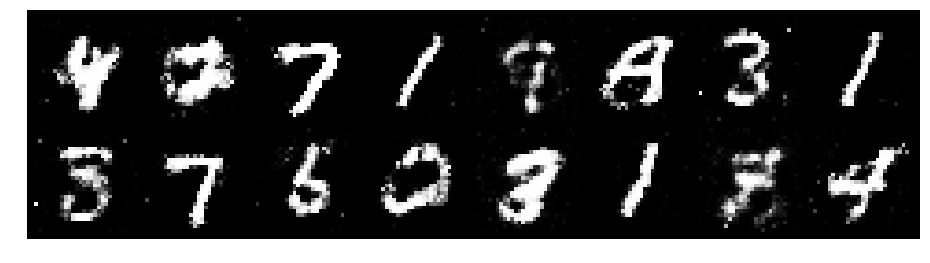

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 1.4353, Generator Loss: 1.1069
D(x): 0.5353, D(G(z)): 0.4513


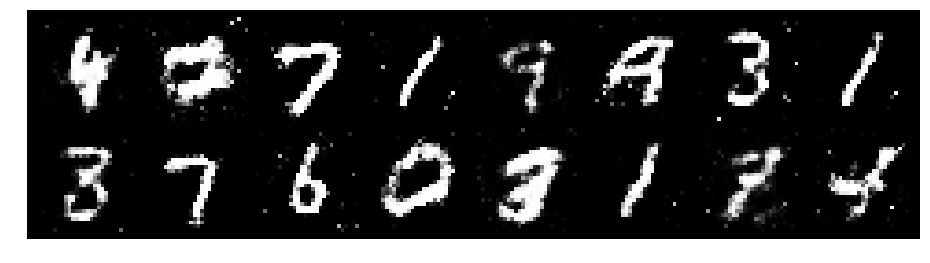

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.2628, Generator Loss: 1.1125
D(x): 0.5764, D(G(z)): 0.4003


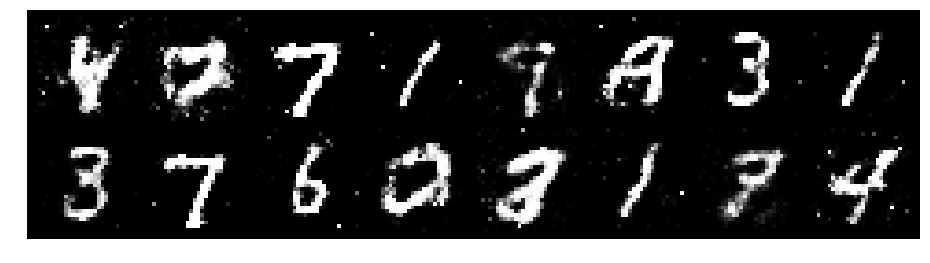

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 1.0366, Generator Loss: 1.3201
D(x): 0.6345, D(G(z)): 0.3503


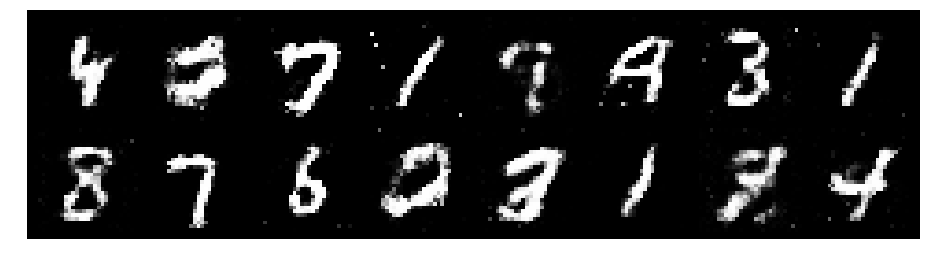

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 1.0486, Generator Loss: 1.1921
D(x): 0.6862, D(G(z)): 0.3920


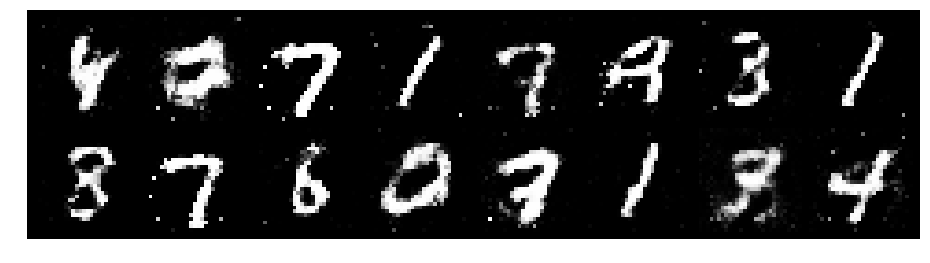

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 1.1523, Generator Loss: 1.1053
D(x): 0.6042, D(G(z)): 0.4037


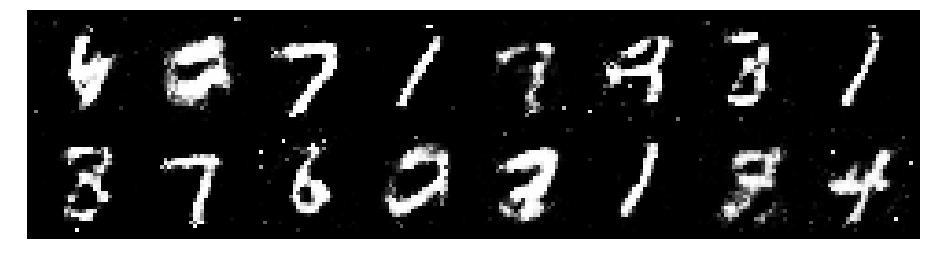

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.2459, Generator Loss: 1.2129
D(x): 0.5687, D(G(z)): 0.4162


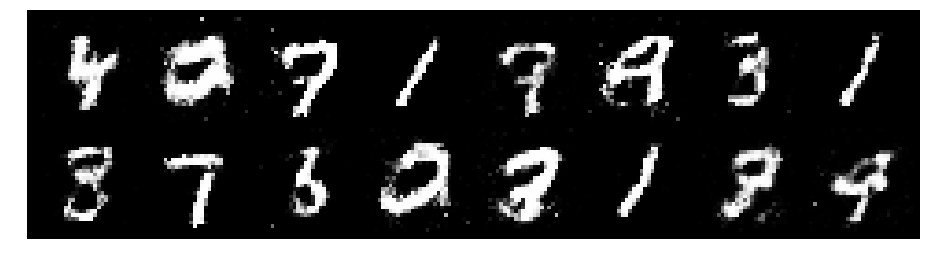

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 1.0928, Generator Loss: 1.2381
D(x): 0.6038, D(G(z)): 0.3601


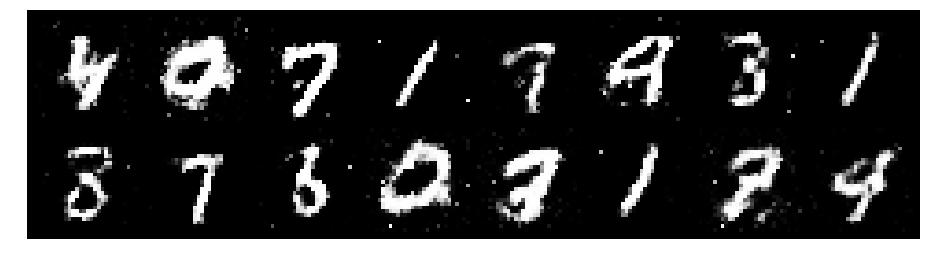

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 1.1876, Generator Loss: 1.0569
D(x): 0.6413, D(G(z)): 0.4287


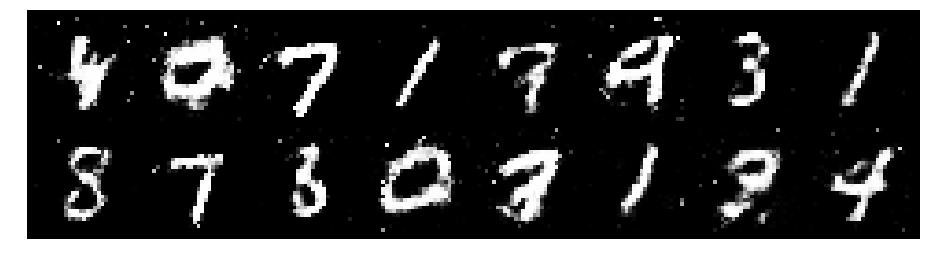

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.1470, Generator Loss: 1.0696
D(x): 0.6317, D(G(z)): 0.4009


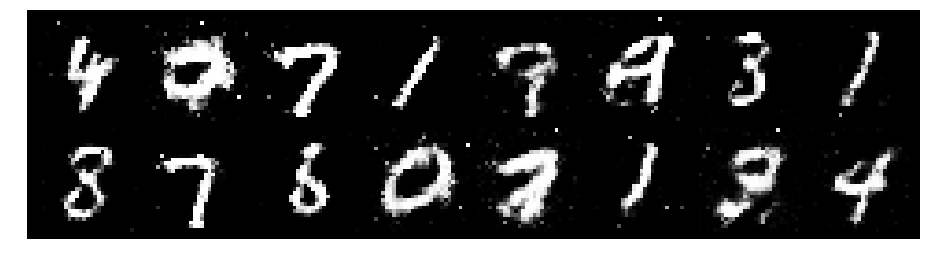

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.0567, Generator Loss: 1.1097
D(x): 0.6559, D(G(z)): 0.3993


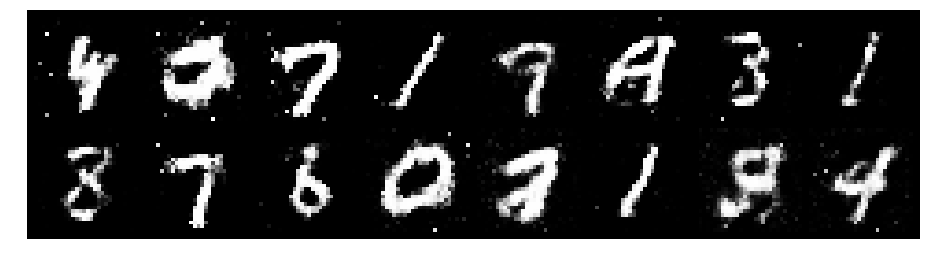

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.1598, Generator Loss: 1.2605
D(x): 0.6254, D(G(z)): 0.3987


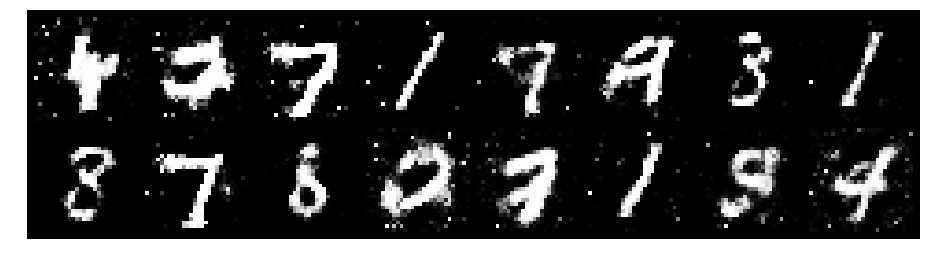

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.3484, Generator Loss: 1.0535
D(x): 0.6005, D(G(z)): 0.4801


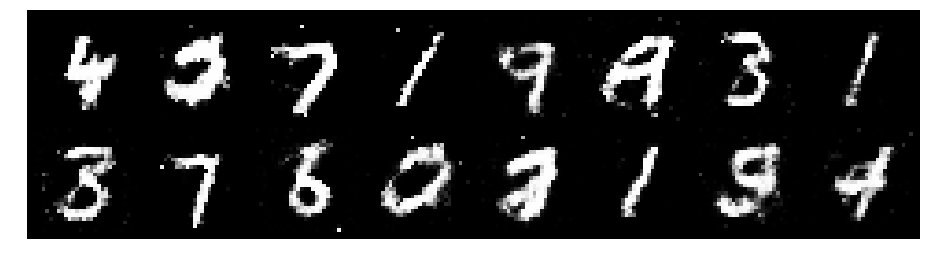

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.1882, Generator Loss: 1.0182
D(x): 0.6026, D(G(z)): 0.4108


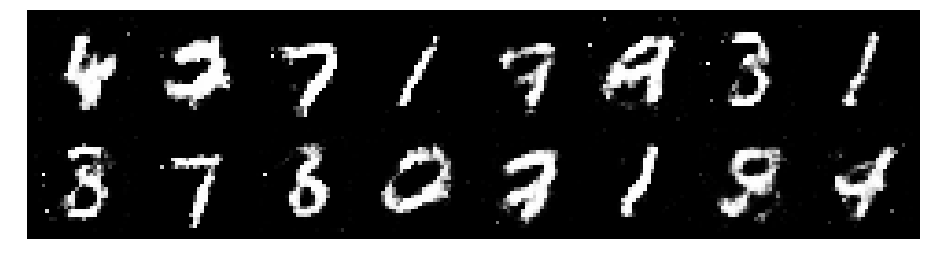

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 1.2195, Generator Loss: 1.0701
D(x): 0.6403, D(G(z)): 0.4490


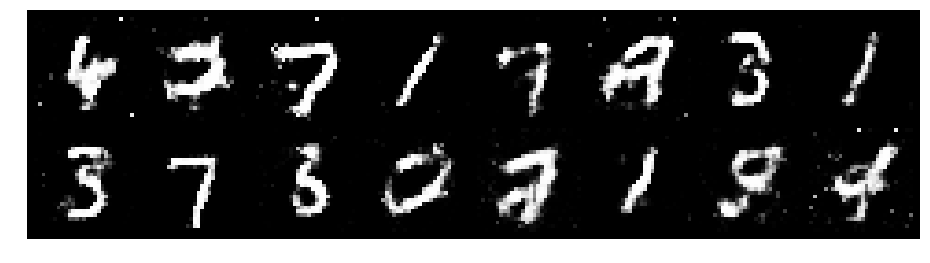

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 1.1966, Generator Loss: 0.9204
D(x): 0.5844, D(G(z)): 0.4073


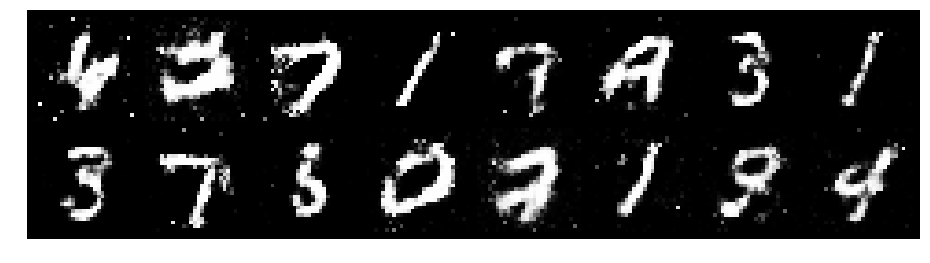

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.1518, Generator Loss: 0.9882
D(x): 0.6102, D(G(z)): 0.3996


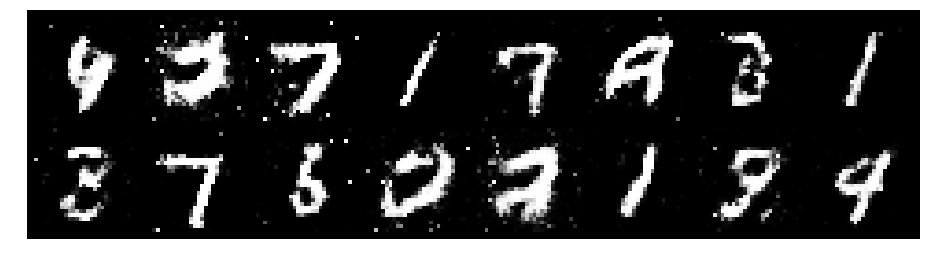

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.0436, Generator Loss: 1.3519
D(x): 0.6624, D(G(z)): 0.3482


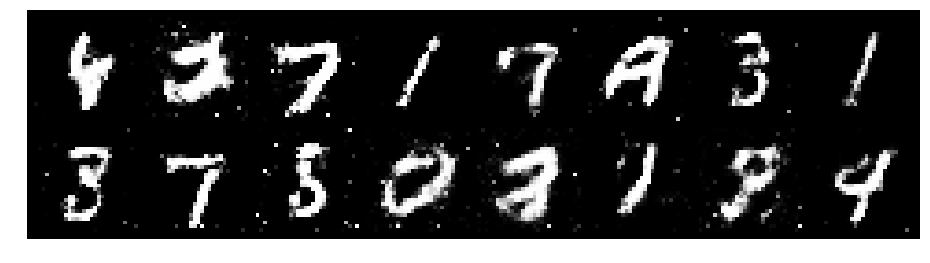

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.1472, Generator Loss: 1.1676
D(x): 0.6211, D(G(z)): 0.3974


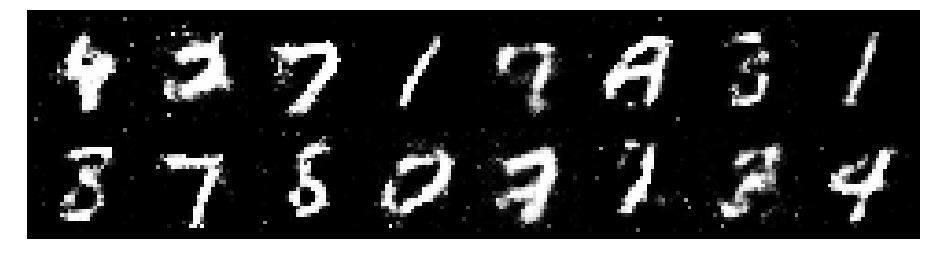

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.0564, Generator Loss: 1.1792
D(x): 0.5710, D(G(z)): 0.3168


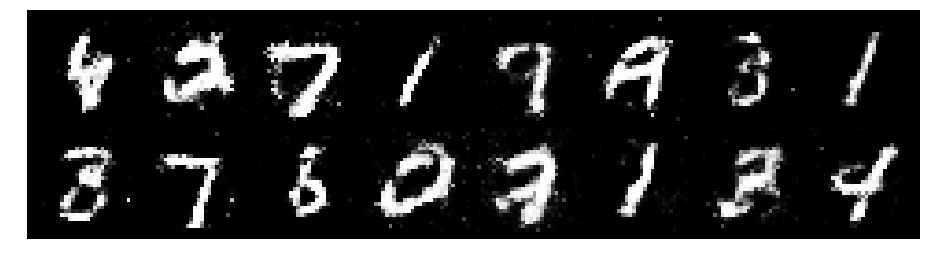

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.0539, Generator Loss: 1.3264
D(x): 0.6566, D(G(z)): 0.3601


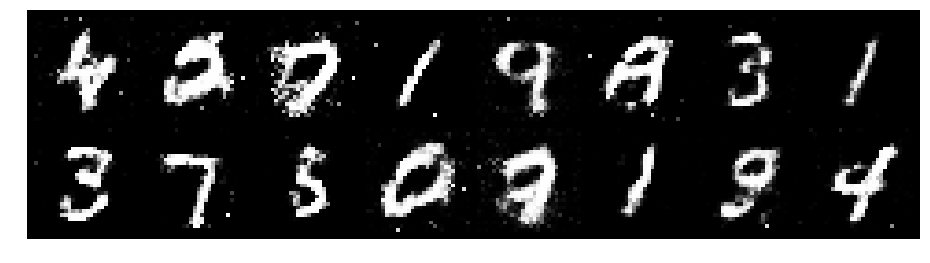

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 0.9749, Generator Loss: 1.0578
D(x): 0.7100, D(G(z)): 0.4112


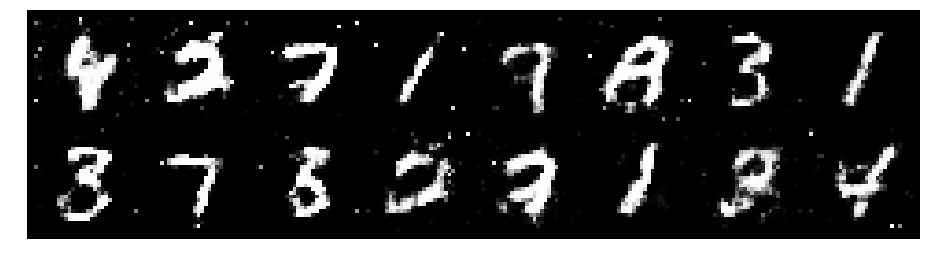

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.2368, Generator Loss: 0.9452
D(x): 0.5907, D(G(z)): 0.4327


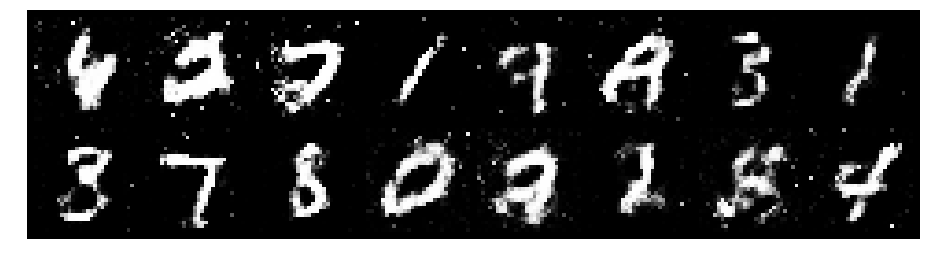

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.1357, Generator Loss: 1.0637
D(x): 0.6381, D(G(z)): 0.4119


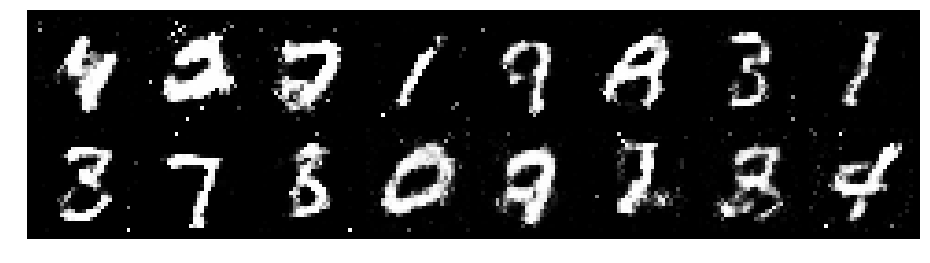

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 1.1447, Generator Loss: 1.0262
D(x): 0.6145, D(G(z)): 0.4083


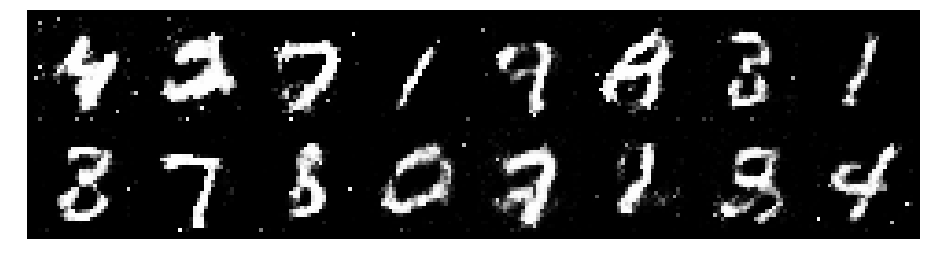

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.3199, Generator Loss: 1.4869
D(x): 0.6349, D(G(z)): 0.4187


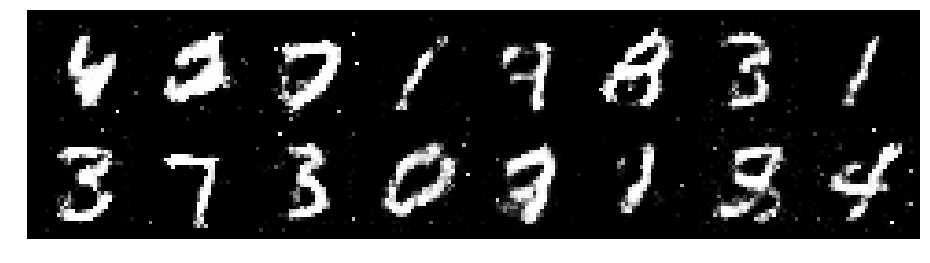

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 1.1723, Generator Loss: 1.0109
D(x): 0.6050, D(G(z)): 0.3851


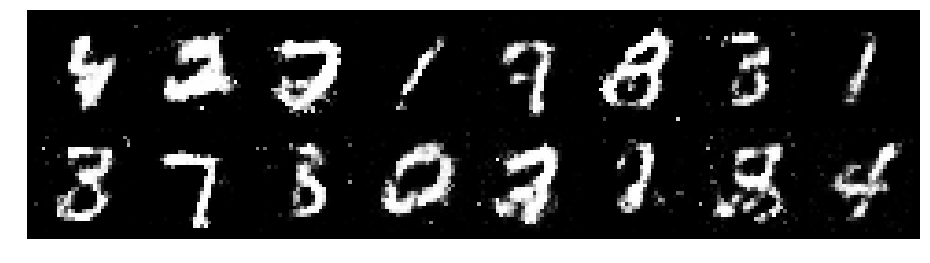

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.1450, Generator Loss: 1.1461
D(x): 0.6370, D(G(z)): 0.4008


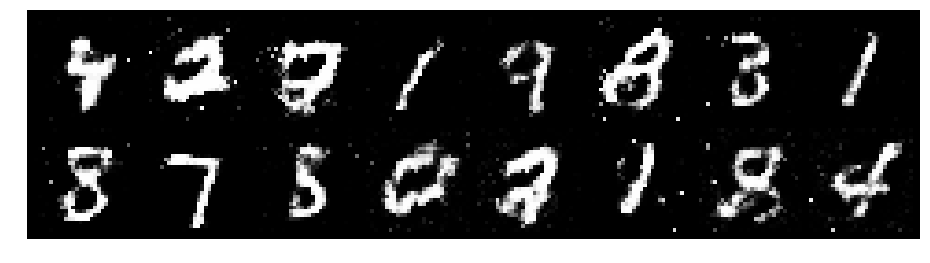

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 1.1222, Generator Loss: 1.0156
D(x): 0.6207, D(G(z)): 0.4043


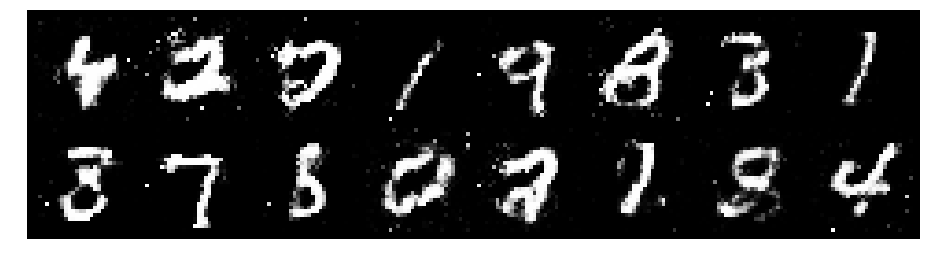

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.0387, Generator Loss: 1.1661
D(x): 0.5806, D(G(z)): 0.3180


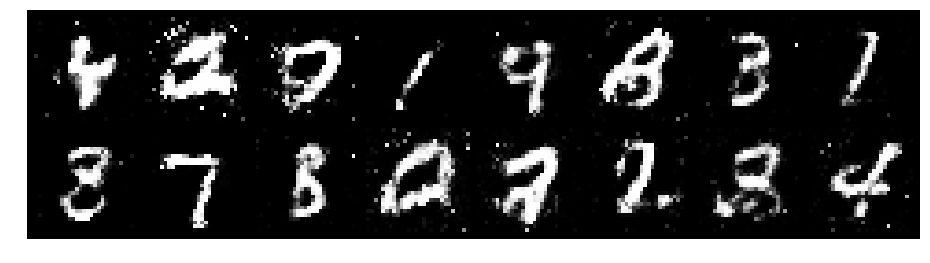

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.0842, Generator Loss: 1.0815
D(x): 0.6837, D(G(z)): 0.4421


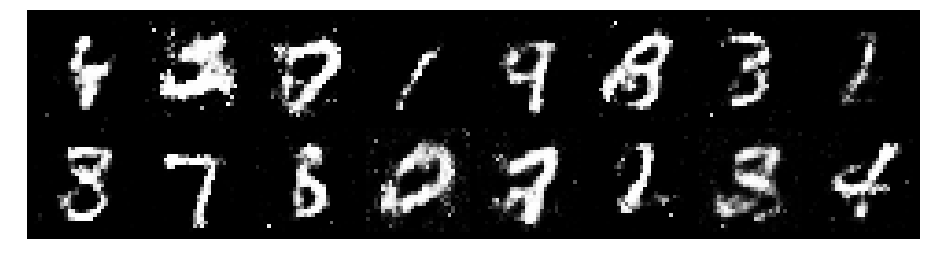

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 0.9837, Generator Loss: 1.1899
D(x): 0.6418, D(G(z)): 0.3295


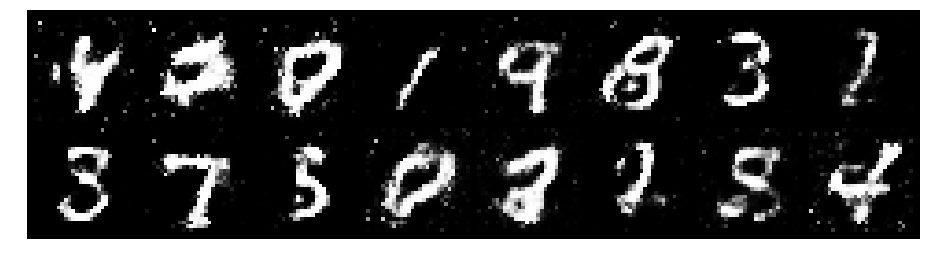

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 0.9974, Generator Loss: 1.3399
D(x): 0.6643, D(G(z)): 0.3613


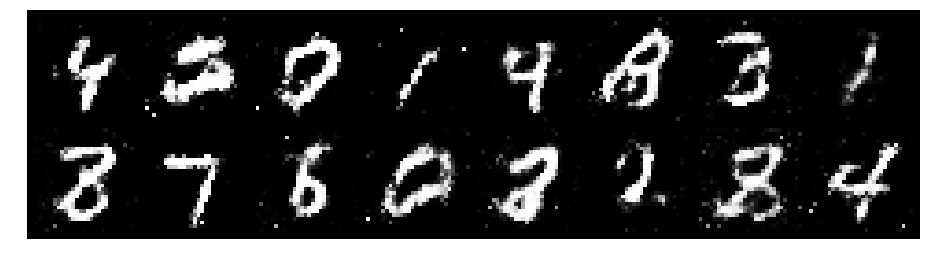

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.1743, Generator Loss: 1.0520
D(x): 0.6405, D(G(z)): 0.4326


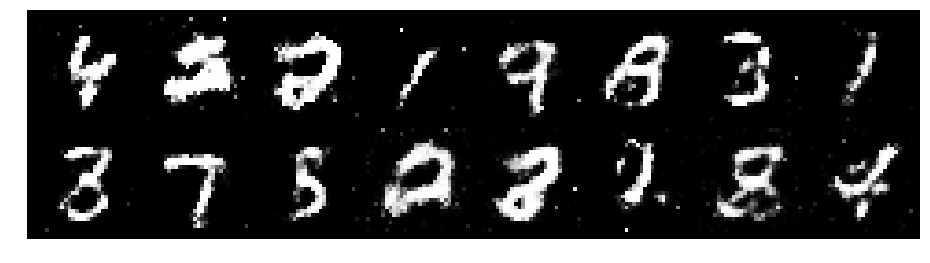

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.2075, Generator Loss: 1.1078
D(x): 0.5882, D(G(z)): 0.4070


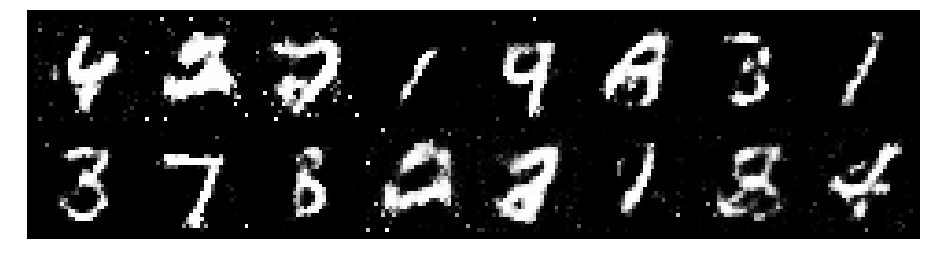

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 1.2266, Generator Loss: 1.0925
D(x): 0.5276, D(G(z)): 0.3795


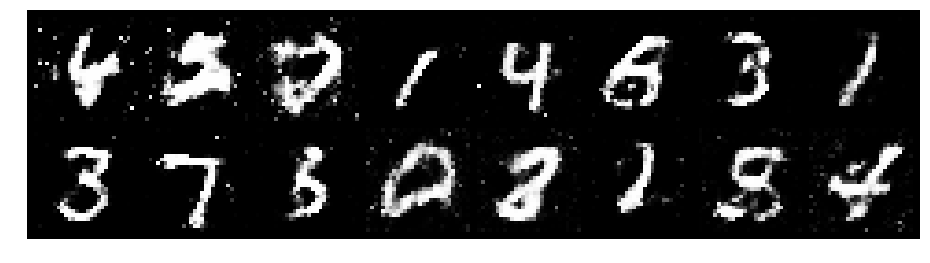

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 1.2362, Generator Loss: 0.9293
D(x): 0.5887, D(G(z)): 0.4509


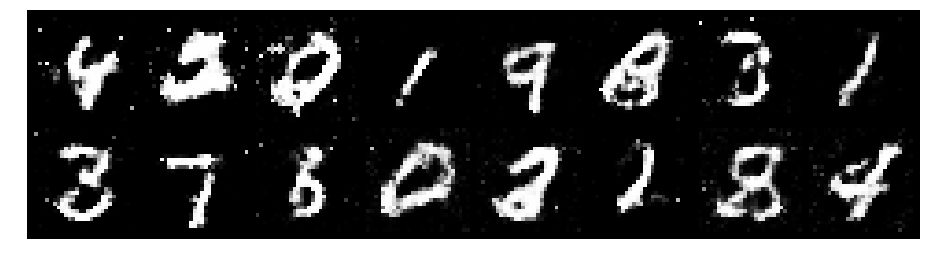

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.2454, Generator Loss: 0.9542
D(x): 0.5642, D(G(z)): 0.4257


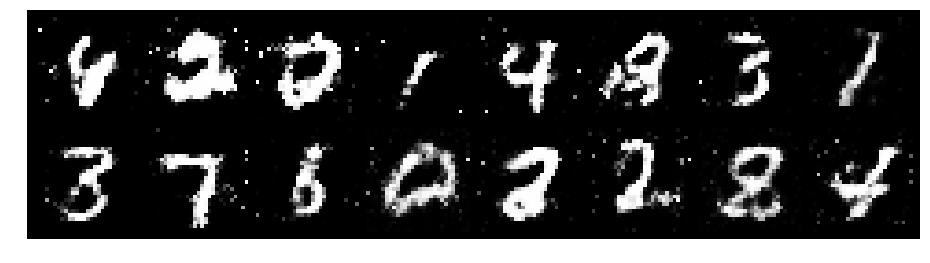

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.2759, Generator Loss: 0.9988
D(x): 0.5969, D(G(z)): 0.4736


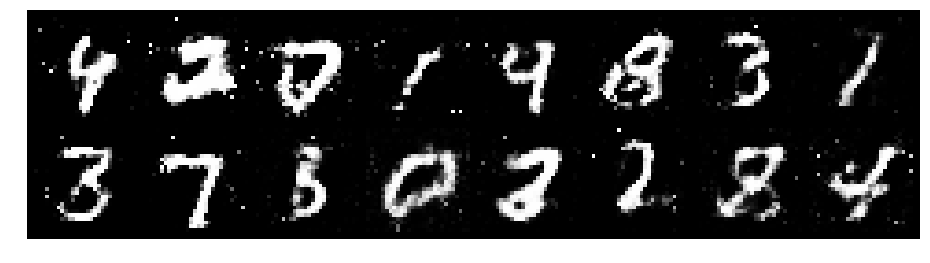

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.1921, Generator Loss: 0.8503
D(x): 0.5911, D(G(z)): 0.4347


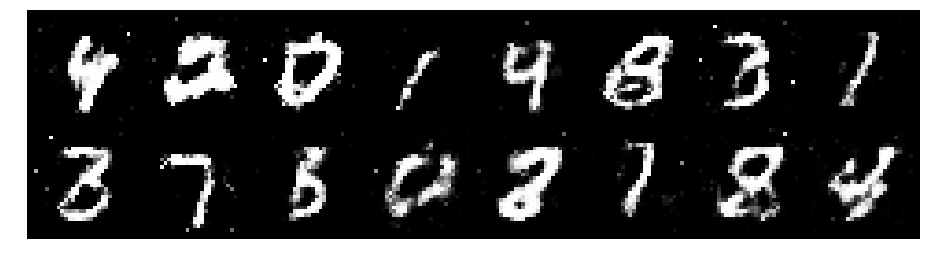

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.3129, Generator Loss: 1.1569
D(x): 0.5105, D(G(z)): 0.3781


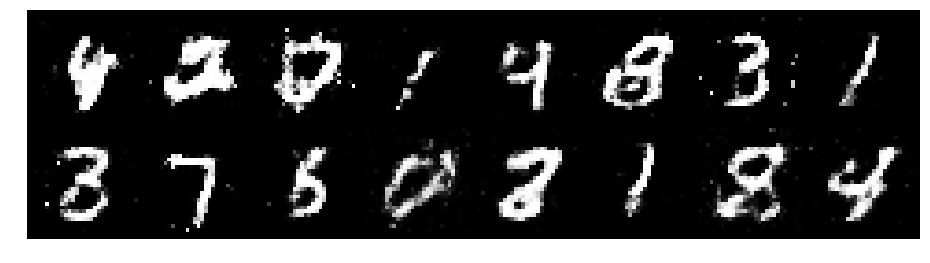

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.1537, Generator Loss: 1.0819
D(x): 0.5820, D(G(z)): 0.3751


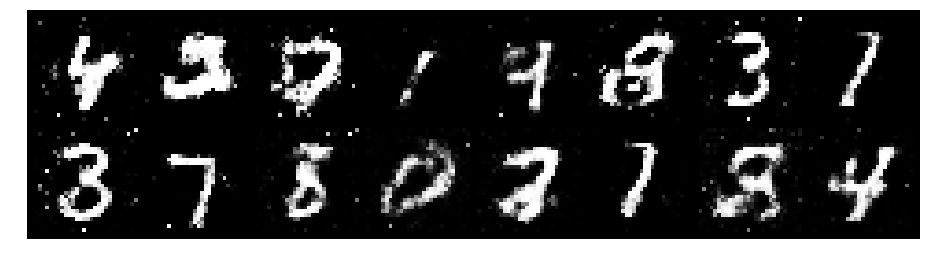

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.1390, Generator Loss: 1.1606
D(x): 0.5671, D(G(z)): 0.3478


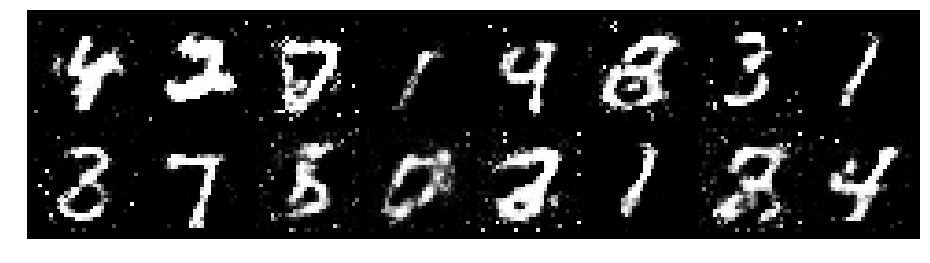

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.2839, Generator Loss: 1.0072
D(x): 0.5701, D(G(z)): 0.4410


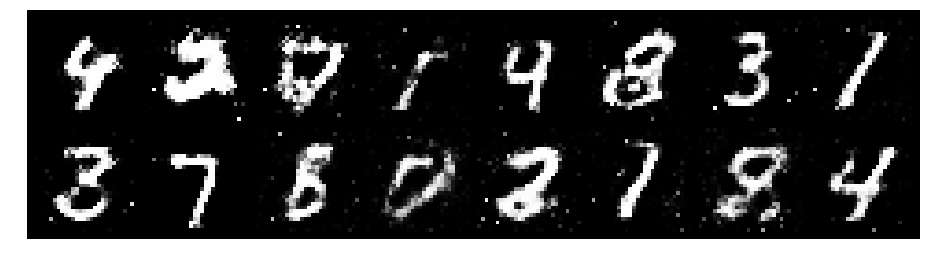

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.2022, Generator Loss: 0.9115
D(x): 0.6574, D(G(z)): 0.4810


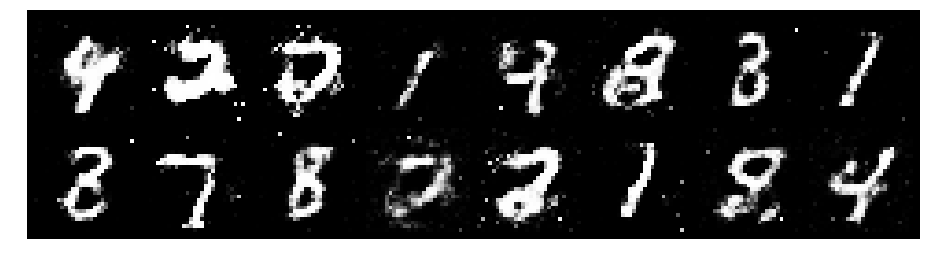

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.2122, Generator Loss: 0.9838
D(x): 0.6509, D(G(z)): 0.4816


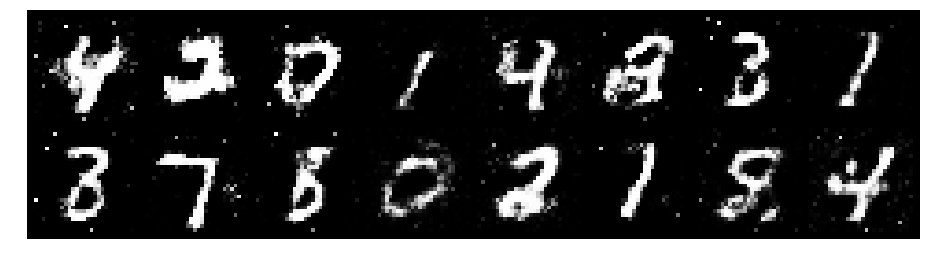

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.1182, Generator Loss: 1.1574
D(x): 0.5503, D(G(z)): 0.3474


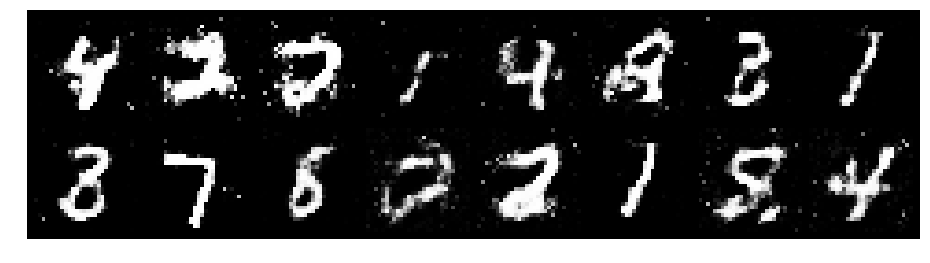

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.0946, Generator Loss: 1.2814
D(x): 0.5861, D(G(z)): 0.3538


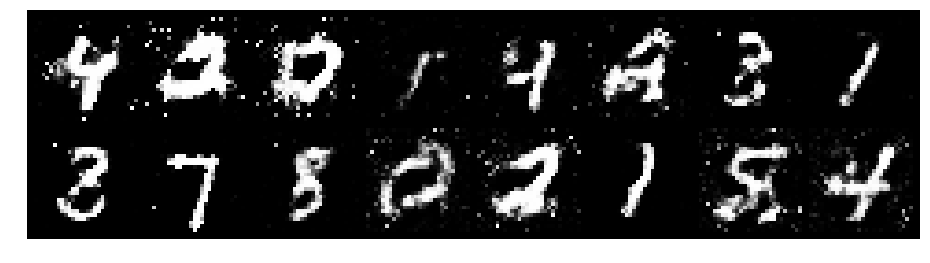

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.0475, Generator Loss: 1.2753
D(x): 0.6623, D(G(z)): 0.3851


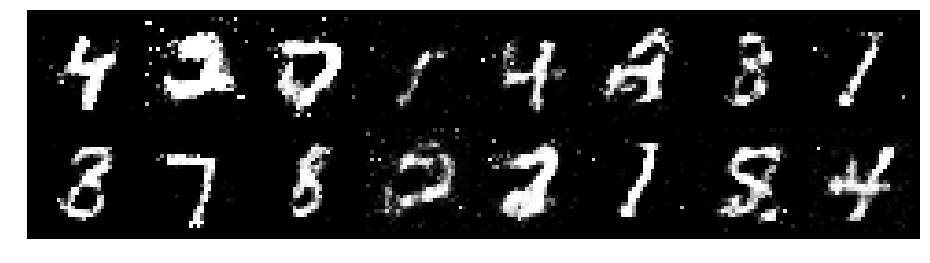

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 0.9580, Generator Loss: 1.3240
D(x): 0.6357, D(G(z)): 0.3225


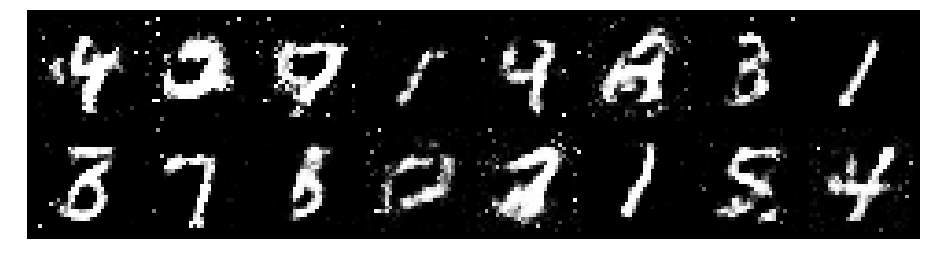

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.0335, Generator Loss: 1.0336
D(x): 0.6308, D(G(z)): 0.3660


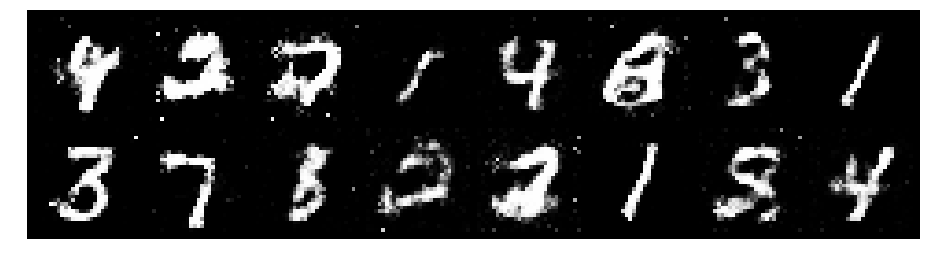

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.0840, Generator Loss: 1.0456
D(x): 0.6350, D(G(z)): 0.3866


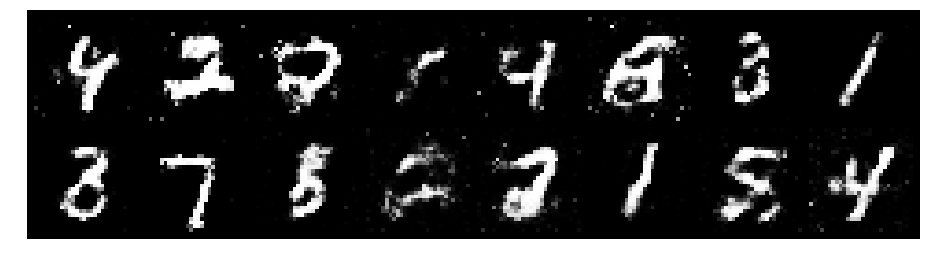

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.1588, Generator Loss: 0.9938
D(x): 0.5849, D(G(z)): 0.3887


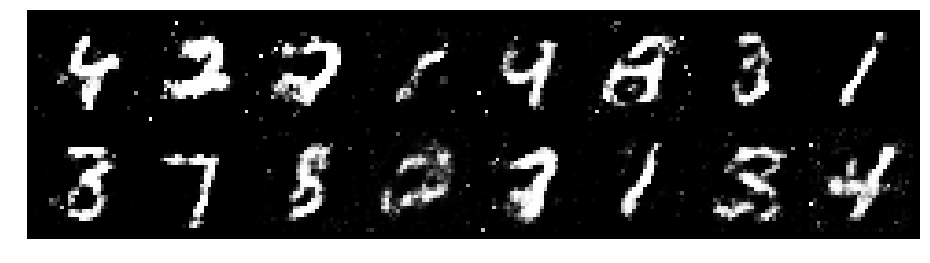

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.1944, Generator Loss: 1.0016
D(x): 0.6201, D(G(z)): 0.4365


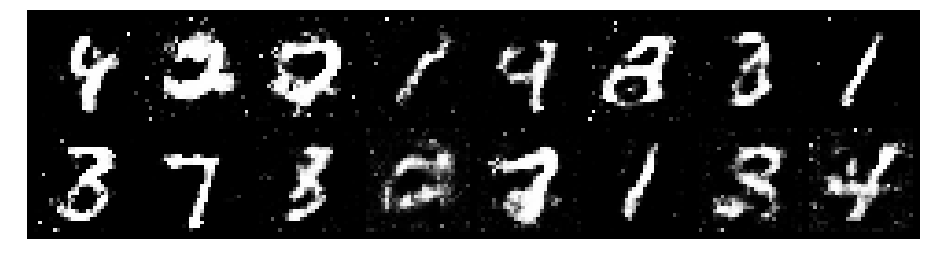

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.3342, Generator Loss: 1.0135
D(x): 0.5956, D(G(z)): 0.4656


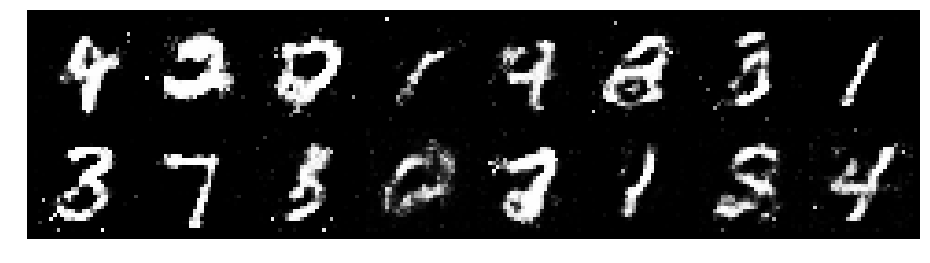

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.2831, Generator Loss: 0.9608
D(x): 0.5464, D(G(z)): 0.4122


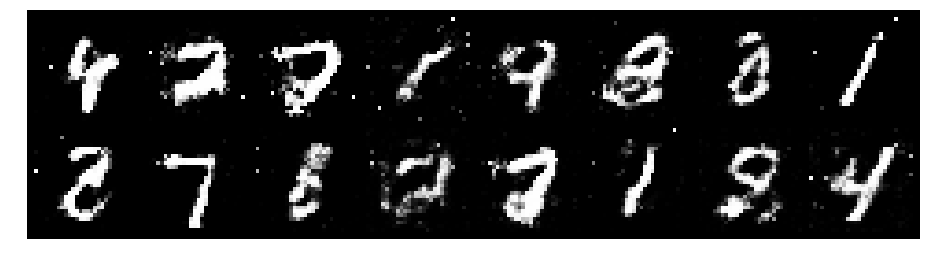

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.1690, Generator Loss: 1.2045
D(x): 0.5876, D(G(z)): 0.4000


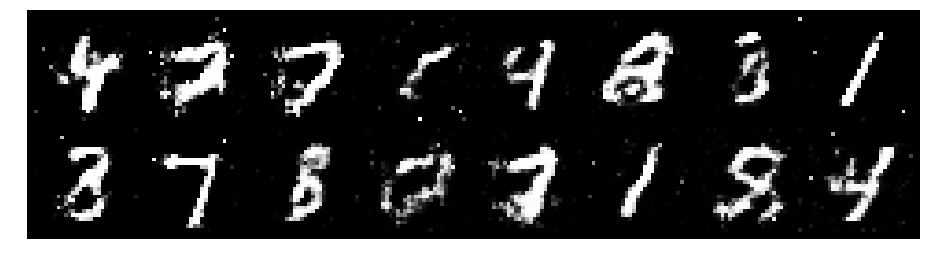

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.1838, Generator Loss: 0.8530
D(x): 0.6060, D(G(z)): 0.4265


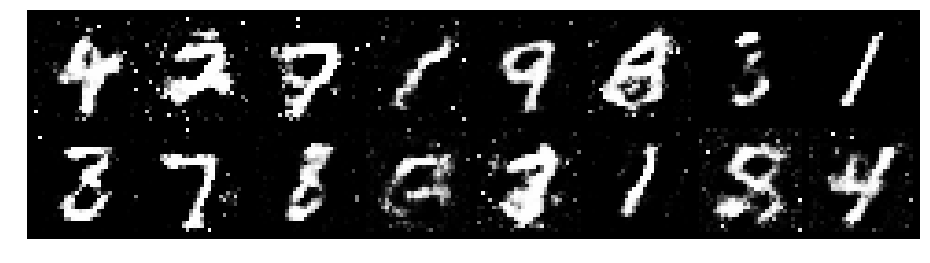

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.1214, Generator Loss: 1.0145
D(x): 0.6618, D(G(z)): 0.4190


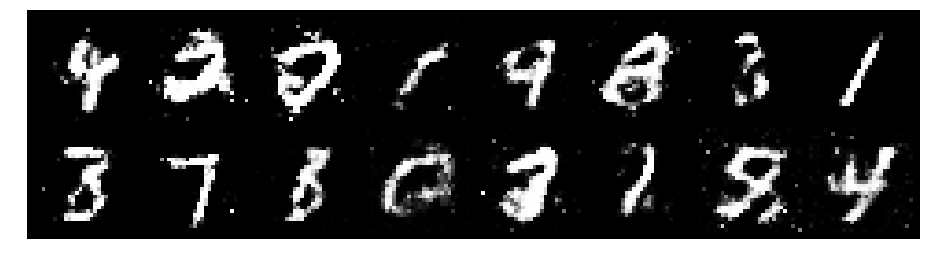

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.1899, Generator Loss: 0.9326
D(x): 0.5675, D(G(z)): 0.4121


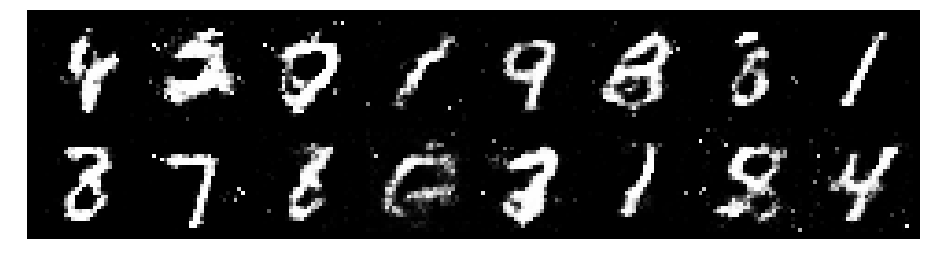

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.2054, Generator Loss: 1.0063
D(x): 0.5673, D(G(z)): 0.3898


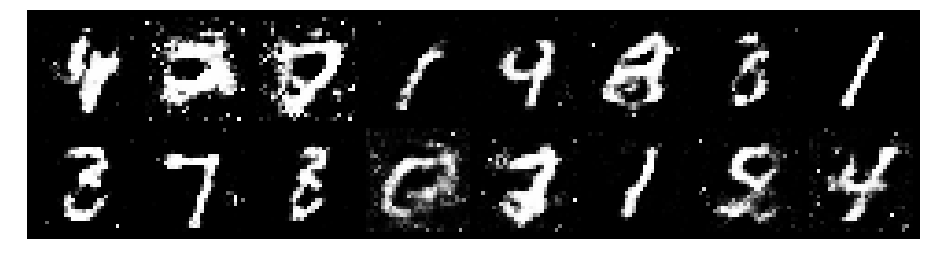

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.2084, Generator Loss: 1.0199
D(x): 0.6182, D(G(z)): 0.4516


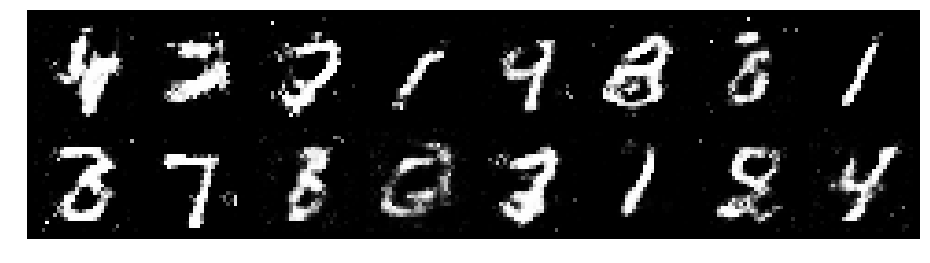

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.1437, Generator Loss: 1.1134
D(x): 0.5958, D(G(z)): 0.3772


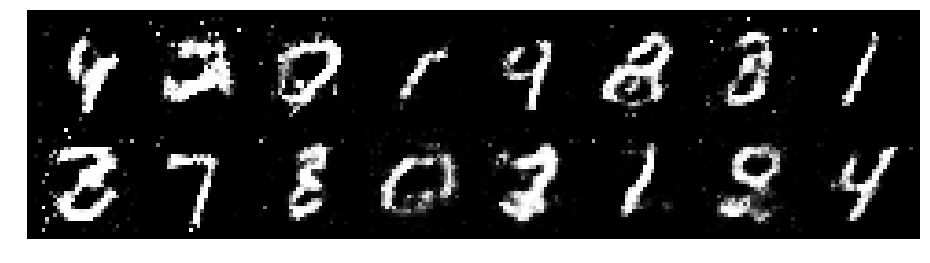

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.2331, Generator Loss: 0.9649
D(x): 0.5390, D(G(z)): 0.4093


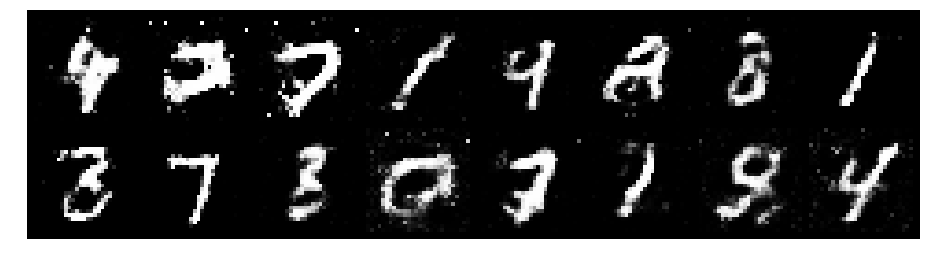

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.3650, Generator Loss: 0.9414
D(x): 0.5594, D(G(z)): 0.4594


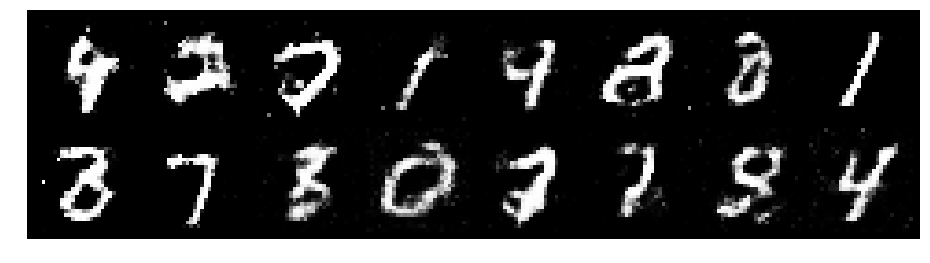

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 1.3219, Generator Loss: 0.9323
D(x): 0.5550, D(G(z)): 0.4404


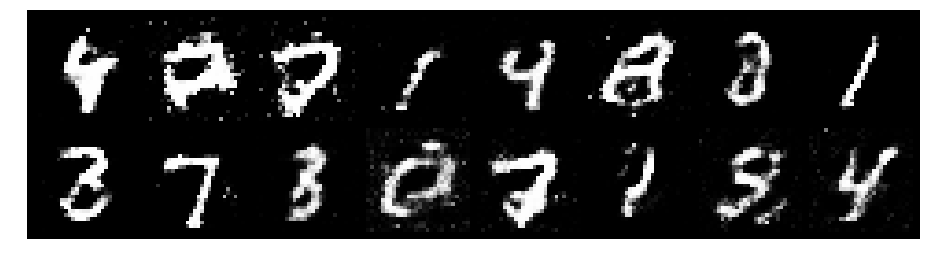

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.3165, Generator Loss: 0.8719
D(x): 0.5222, D(G(z)): 0.4084


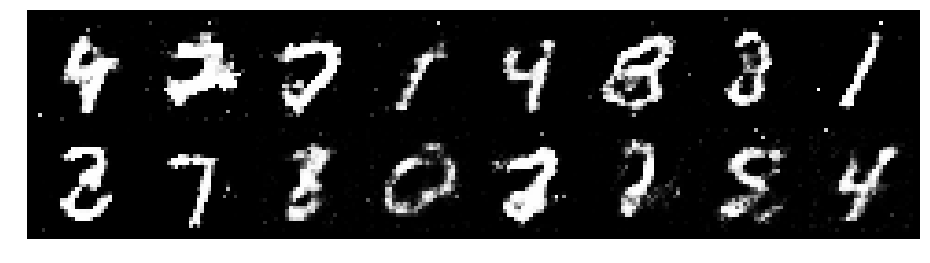

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.2222, Generator Loss: 1.0755
D(x): 0.5768, D(G(z)): 0.4130


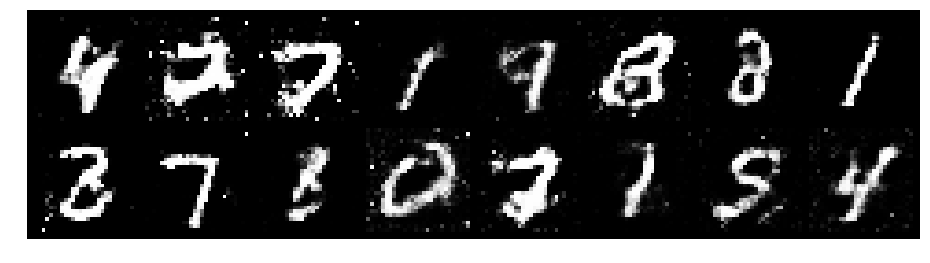

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.3204, Generator Loss: 1.0766
D(x): 0.5320, D(G(z)): 0.4238


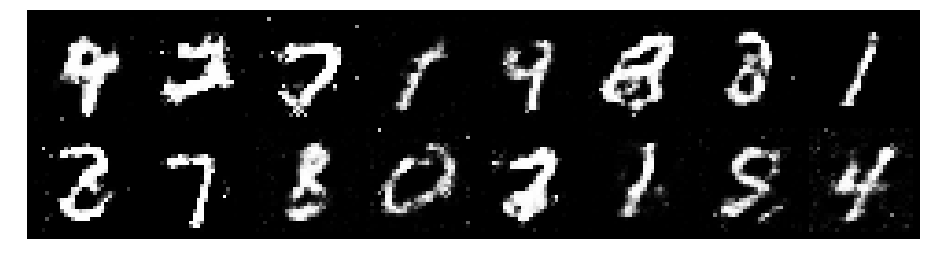

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.2268, Generator Loss: 1.0456
D(x): 0.6154, D(G(z)): 0.4379


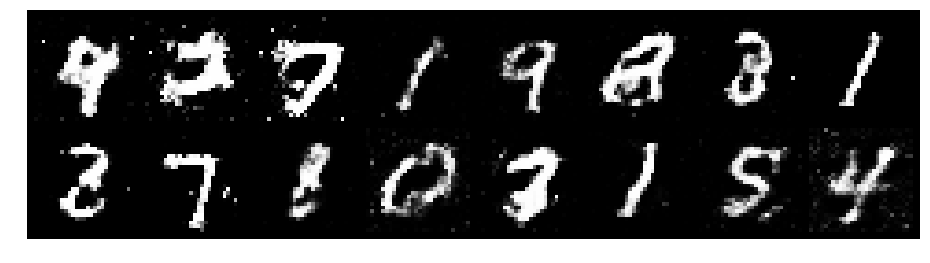

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.2104, Generator Loss: 1.0183
D(x): 0.6432, D(G(z)): 0.4481


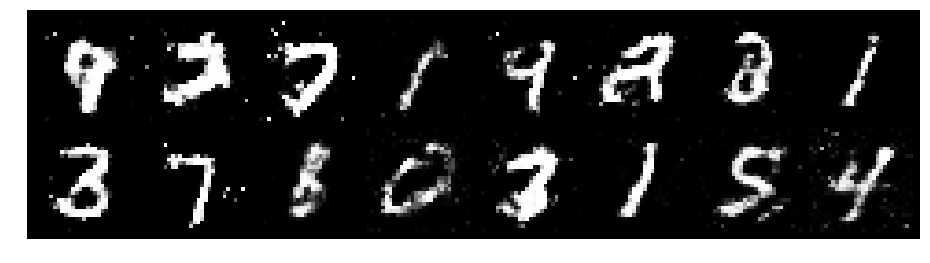

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.0562, Generator Loss: 1.0952
D(x): 0.5985, D(G(z)): 0.3283


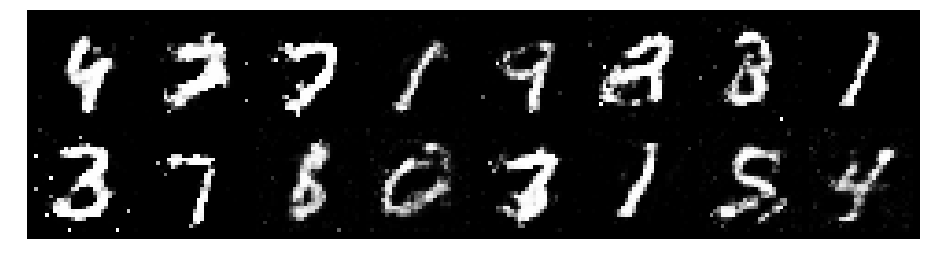

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.2015, Generator Loss: 1.0130
D(x): 0.6272, D(G(z)): 0.4311


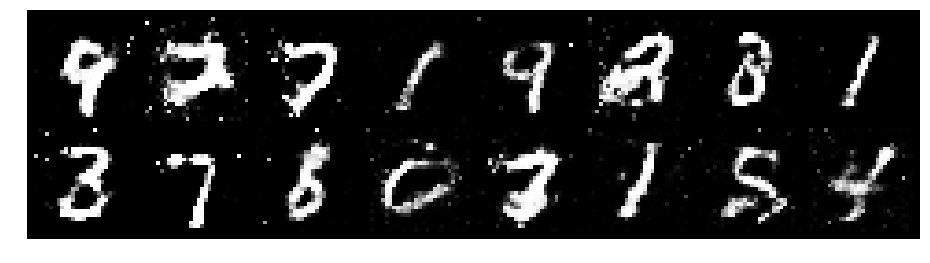

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.2543, Generator Loss: 0.9616
D(x): 0.5691, D(G(z)): 0.4238


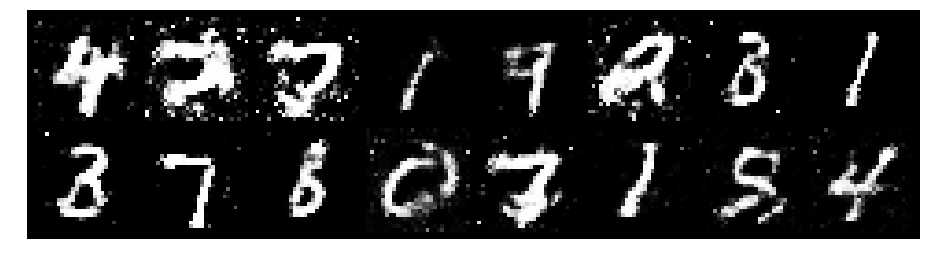

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.2315, Generator Loss: 0.9142
D(x): 0.5732, D(G(z)): 0.4259


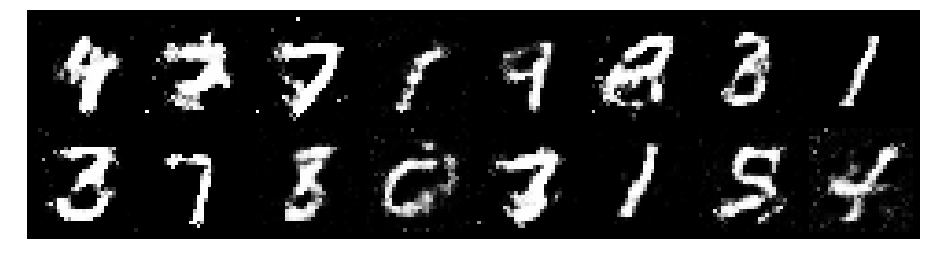

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.2039, Generator Loss: 0.8581
D(x): 0.5885, D(G(z)): 0.4149


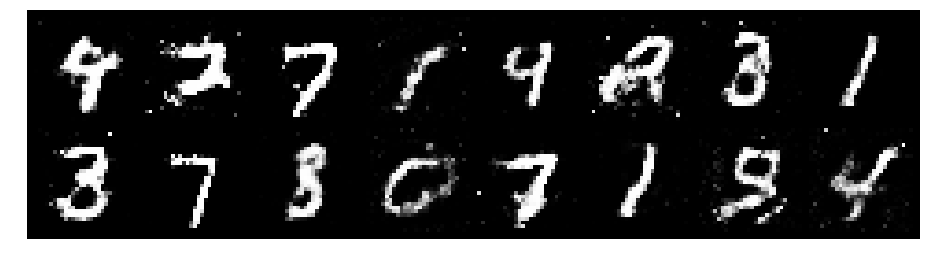

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.2900, Generator Loss: 0.9471
D(x): 0.5463, D(G(z)): 0.4400


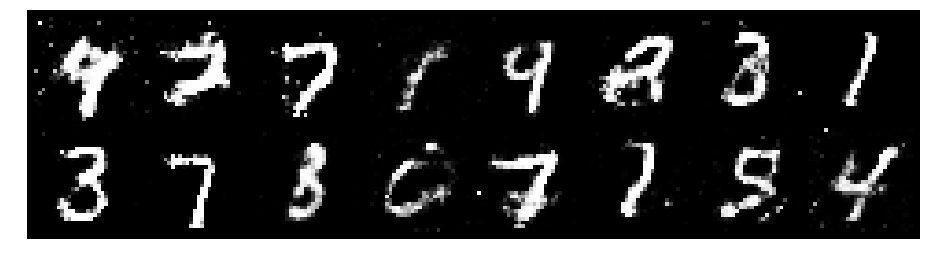

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.1866, Generator Loss: 1.0593
D(x): 0.5962, D(G(z)): 0.3956


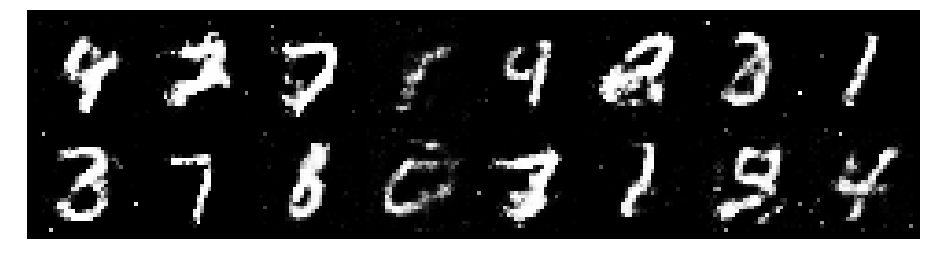

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.1505, Generator Loss: 1.1383
D(x): 0.5416, D(G(z)): 0.3563


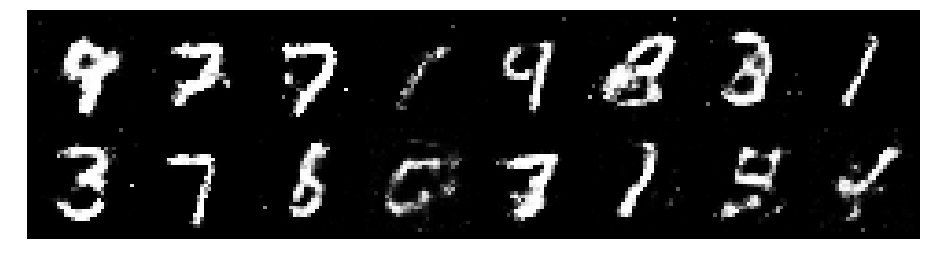

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.2294, Generator Loss: 0.9378
D(x): 0.5701, D(G(z)): 0.4327


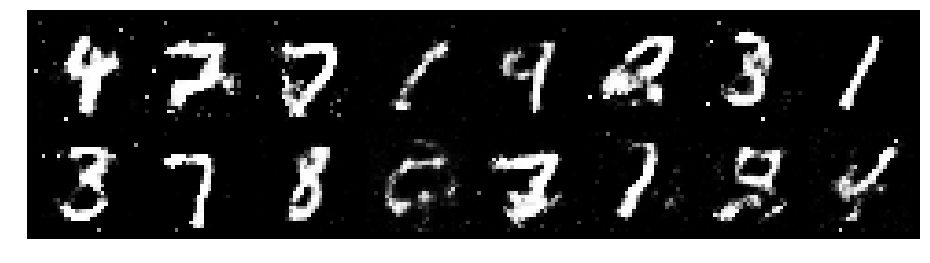

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.2418, Generator Loss: 0.9126
D(x): 0.6116, D(G(z)): 0.4663


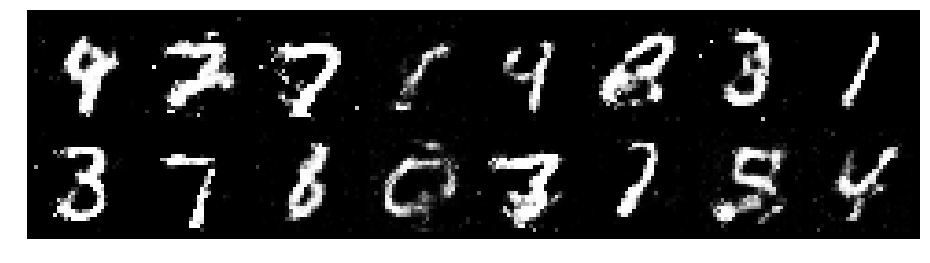

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.2375, Generator Loss: 0.8978
D(x): 0.5543, D(G(z)): 0.4192


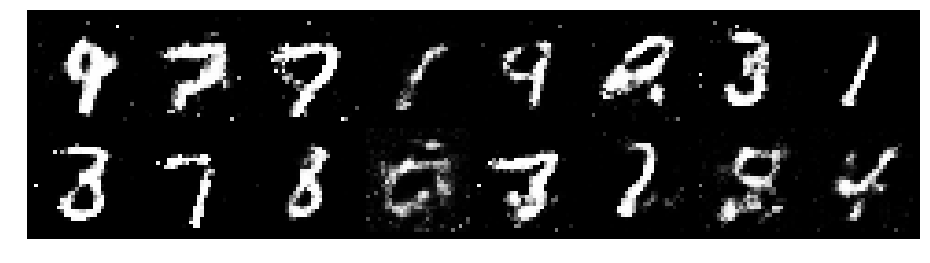

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.2134, Generator Loss: 0.9713
D(x): 0.5915, D(G(z)): 0.4359


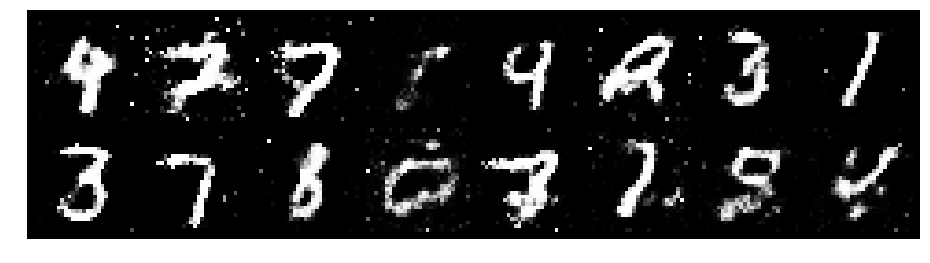

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.2692, Generator Loss: 0.9713
D(x): 0.5481, D(G(z)): 0.4277


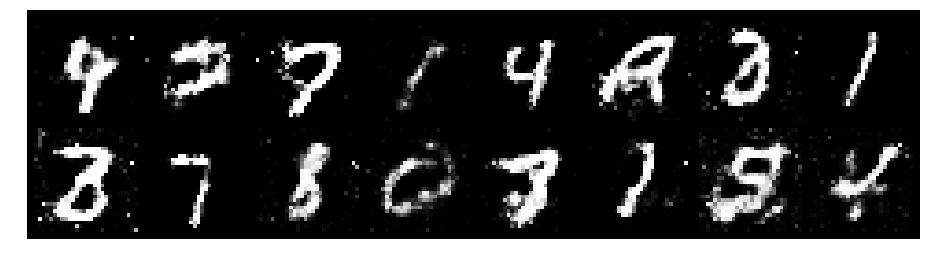

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.2372, Generator Loss: 1.2054
D(x): 0.6060, D(G(z)): 0.4067


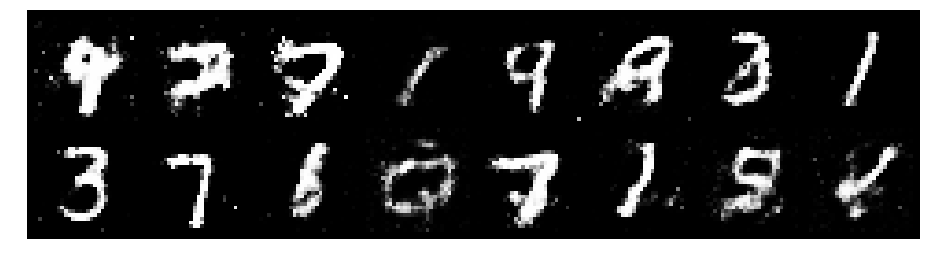

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.0164, Generator Loss: 1.1900
D(x): 0.6285, D(G(z)): 0.3473


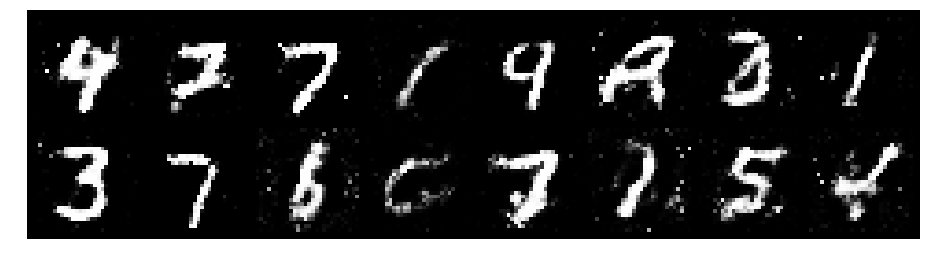

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.1785, Generator Loss: 0.9758
D(x): 0.5885, D(G(z)): 0.4241


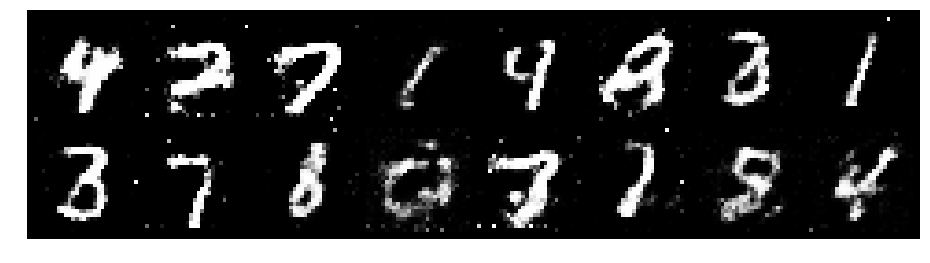

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.2119, Generator Loss: 0.8982
D(x): 0.6033, D(G(z)): 0.4451


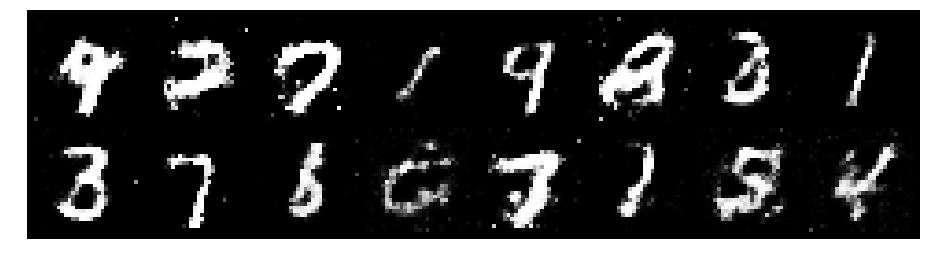

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.1813, Generator Loss: 0.8435
D(x): 0.6063, D(G(z)): 0.4495


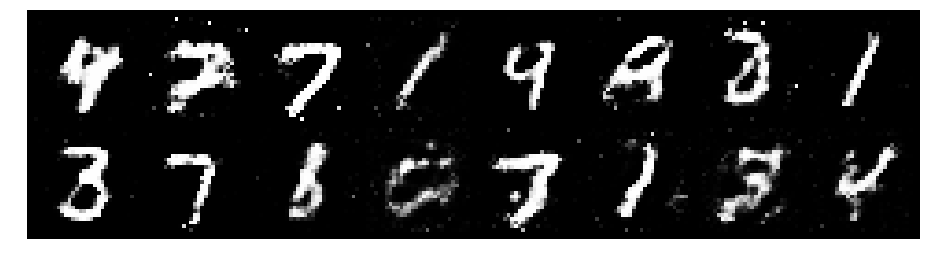

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.2411, Generator Loss: 1.0036
D(x): 0.6561, D(G(z)): 0.4666


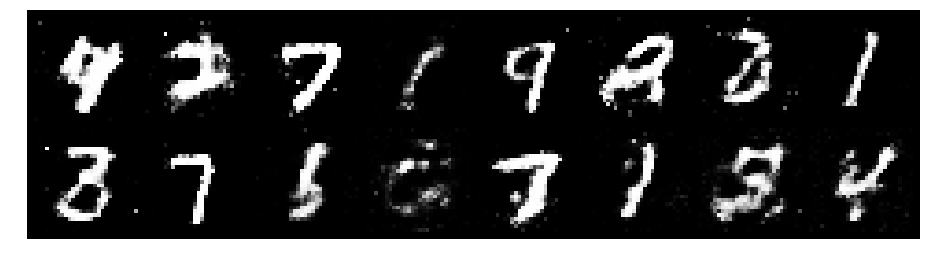

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 0.9295, Generator Loss: 1.2337
D(x): 0.6719, D(G(z)): 0.3453


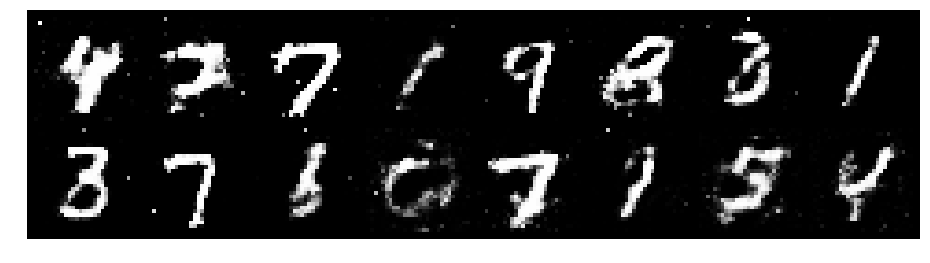

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.1882, Generator Loss: 0.9374
D(x): 0.6510, D(G(z)): 0.4355


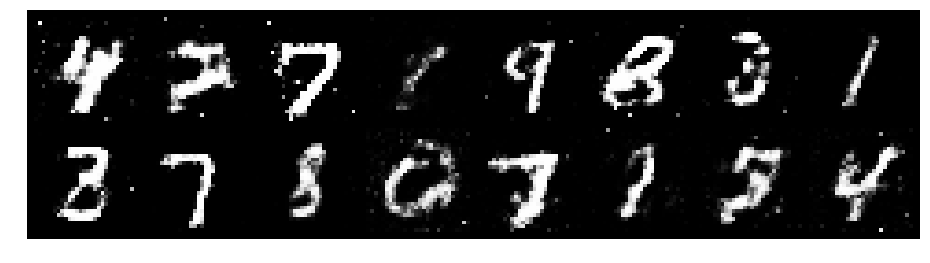

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.2331, Generator Loss: 1.2845
D(x): 0.5657, D(G(z)): 0.3680


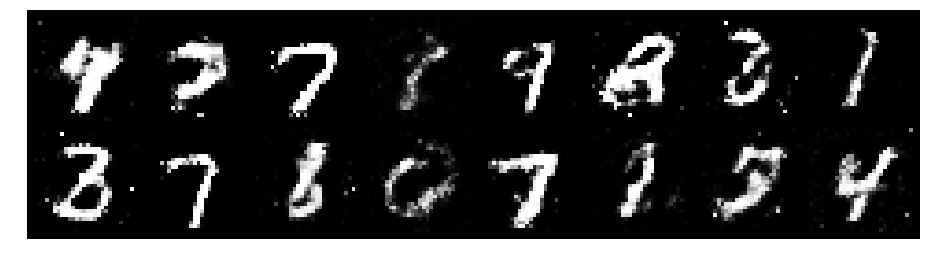

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.1935, Generator Loss: 1.0760
D(x): 0.5924, D(G(z)): 0.4078


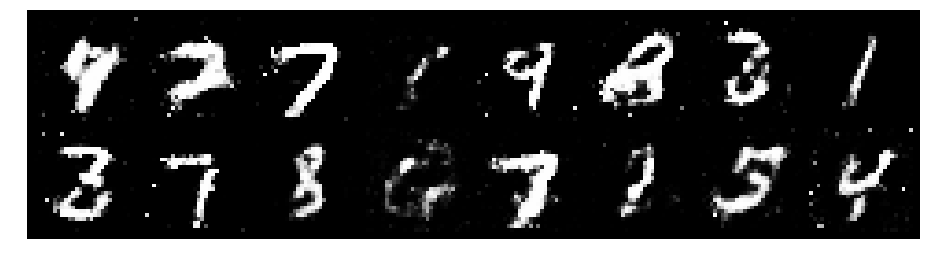

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.2603, Generator Loss: 1.2241
D(x): 0.5202, D(G(z)): 0.3560


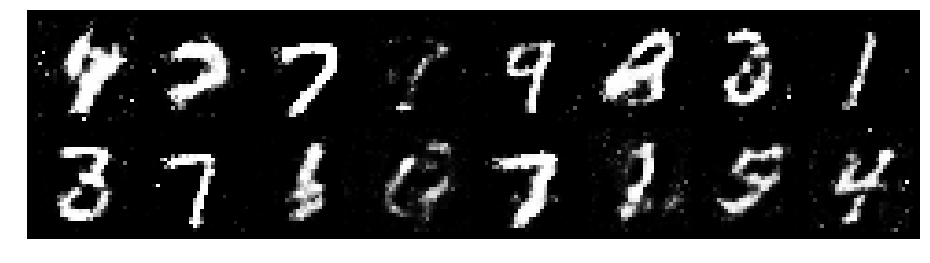

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.1809, Generator Loss: 1.1334
D(x): 0.6427, D(G(z)): 0.4289


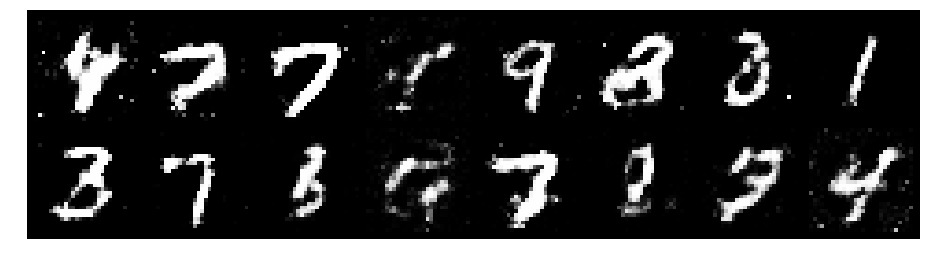

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.1485, Generator Loss: 0.9760
D(x): 0.6371, D(G(z)): 0.4322


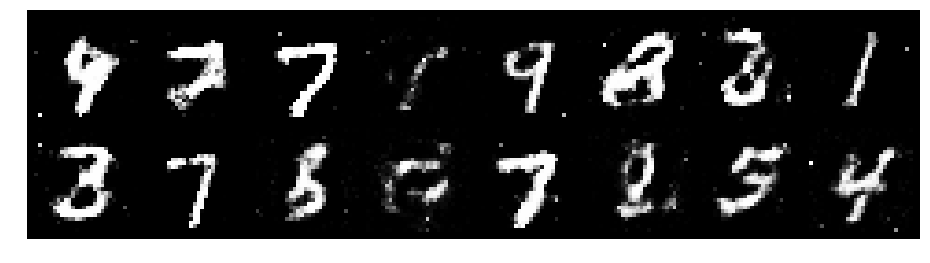

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.0895, Generator Loss: 1.0603
D(x): 0.6059, D(G(z)): 0.3815


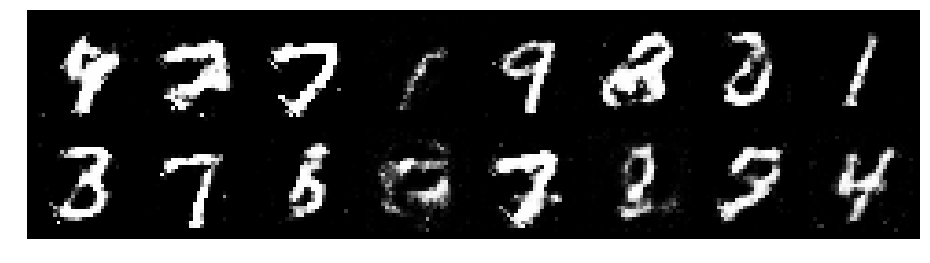

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.1953, Generator Loss: 1.1078
D(x): 0.5471, D(G(z)): 0.3731


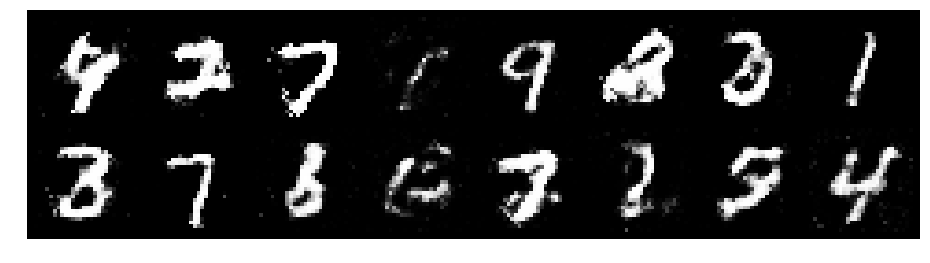

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.2068, Generator Loss: 0.8230
D(x): 0.6422, D(G(z)): 0.4632


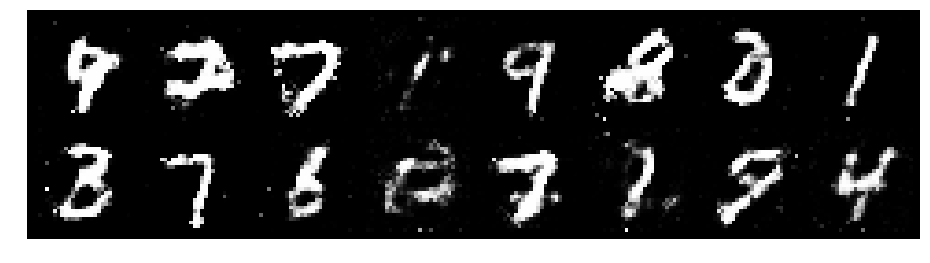

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.1620, Generator Loss: 1.3323
D(x): 0.6389, D(G(z)): 0.4336


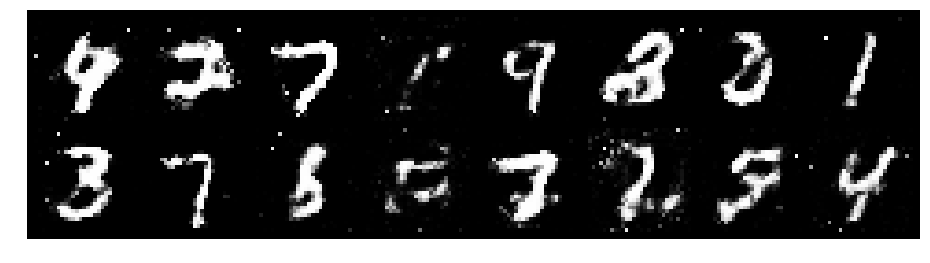

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.1208, Generator Loss: 1.1335
D(x): 0.6543, D(G(z)): 0.4028


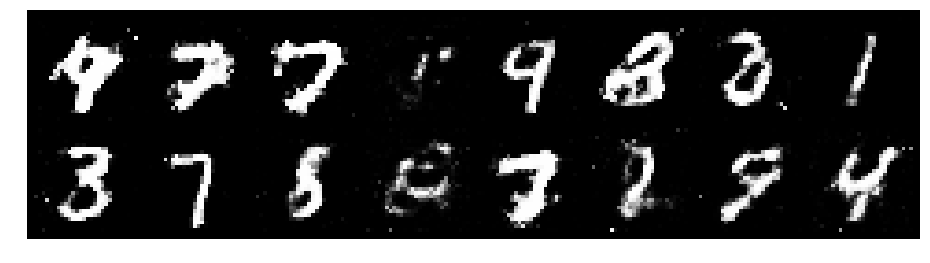

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.0840, Generator Loss: 1.0851
D(x): 0.6217, D(G(z)): 0.3821


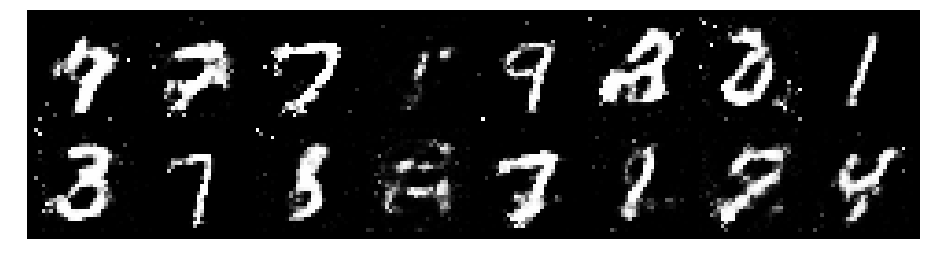

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.1691, Generator Loss: 1.2270
D(x): 0.5579, D(G(z)): 0.3637


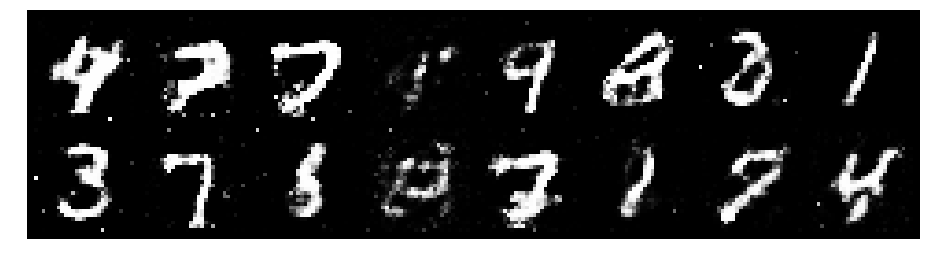

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.1556, Generator Loss: 1.1770
D(x): 0.5878, D(G(z)): 0.3845


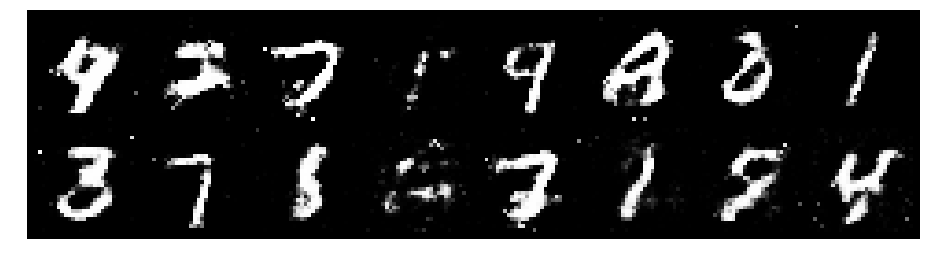

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.0719, Generator Loss: 1.0560
D(x): 0.6409, D(G(z)): 0.3933


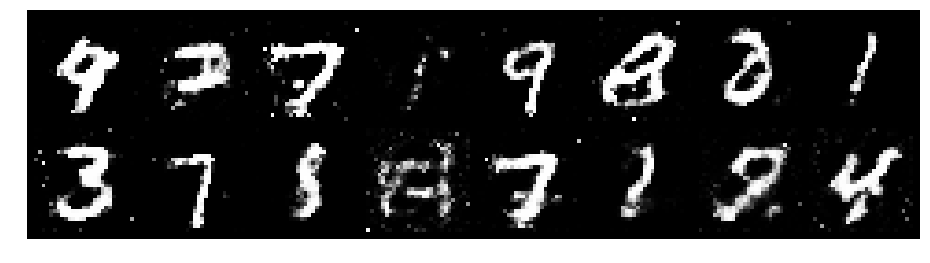

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.0705, Generator Loss: 1.1705
D(x): 0.6268, D(G(z)): 0.3840


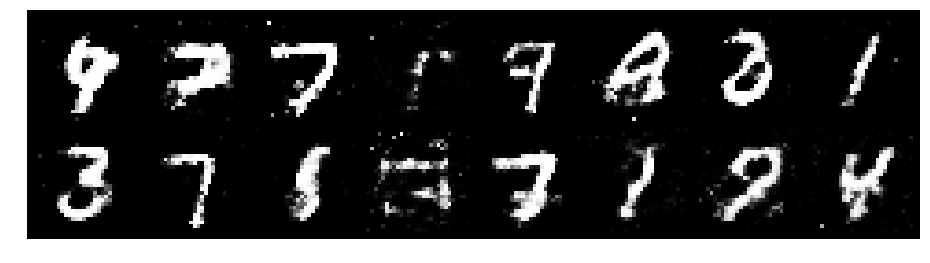

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.2358, Generator Loss: 0.7580
D(x): 0.5516, D(G(z)): 0.4321


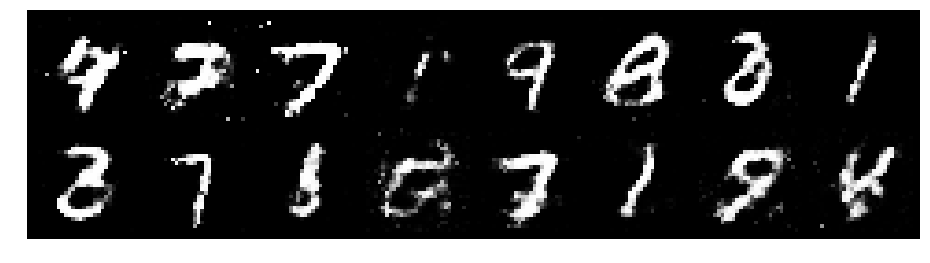

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.2375, Generator Loss: 0.8761
D(x): 0.6264, D(G(z)): 0.4661


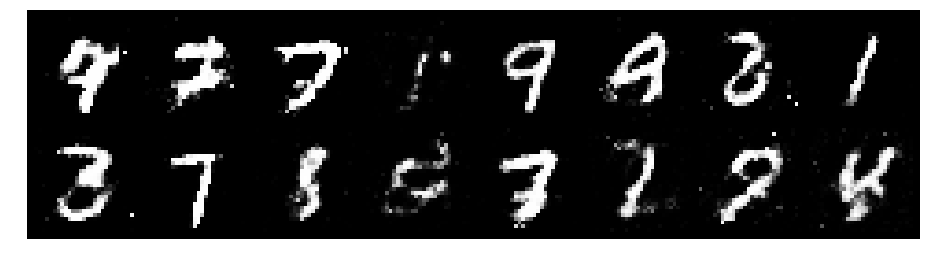

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.1822, Generator Loss: 0.8364
D(x): 0.5773, D(G(z)): 0.4065


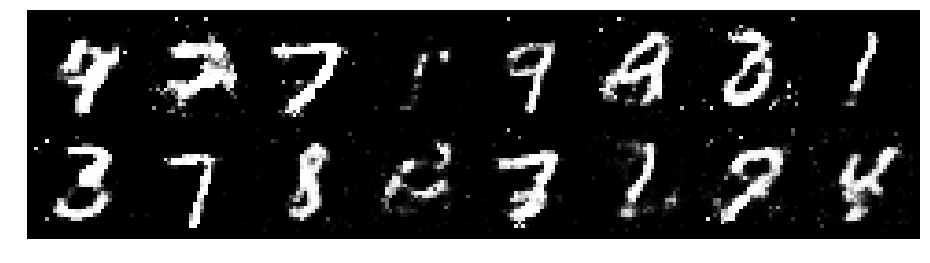

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.3223, Generator Loss: 0.9258
D(x): 0.5450, D(G(z)): 0.4191


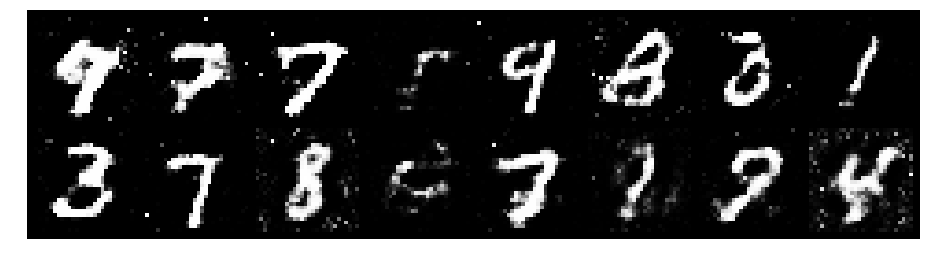

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.2156, Generator Loss: 0.7802
D(x): 0.6772, D(G(z)): 0.4943


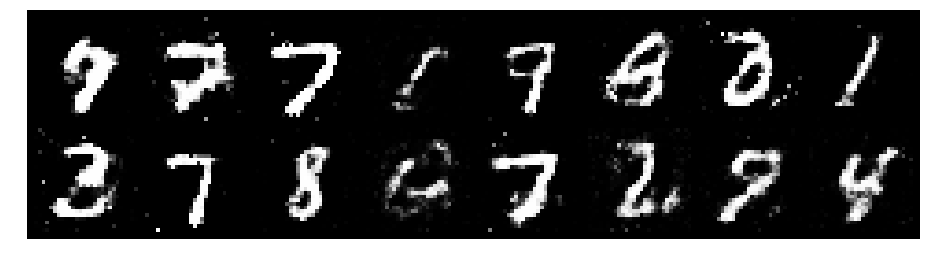

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.2574, Generator Loss: 0.8532
D(x): 0.5692, D(G(z)): 0.4417


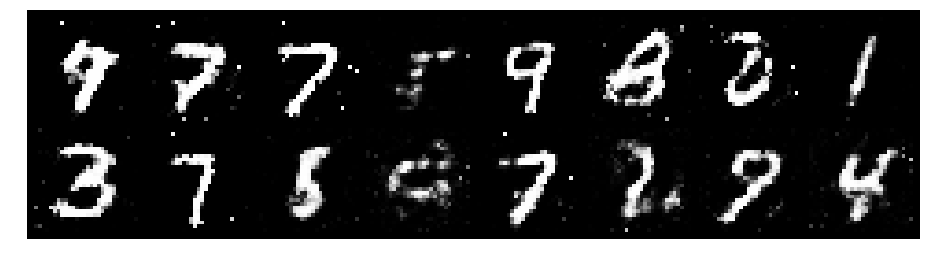

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.2901, Generator Loss: 0.9501
D(x): 0.5598, D(G(z)): 0.4560


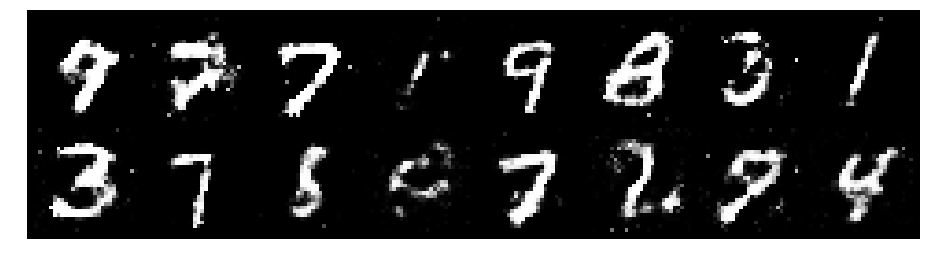

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.2768, Generator Loss: 0.9697
D(x): 0.6036, D(G(z)): 0.4468


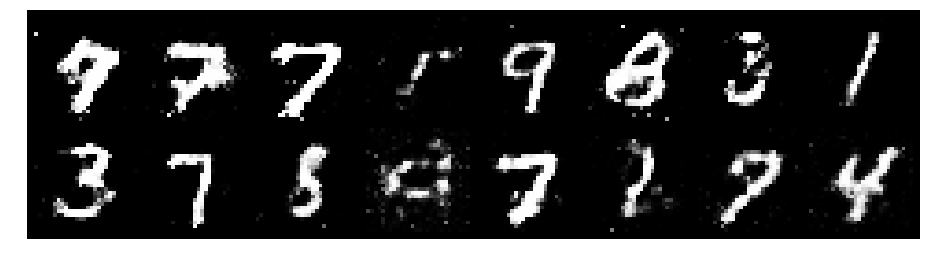

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.1391, Generator Loss: 1.2752
D(x): 0.5814, D(G(z)): 0.3756


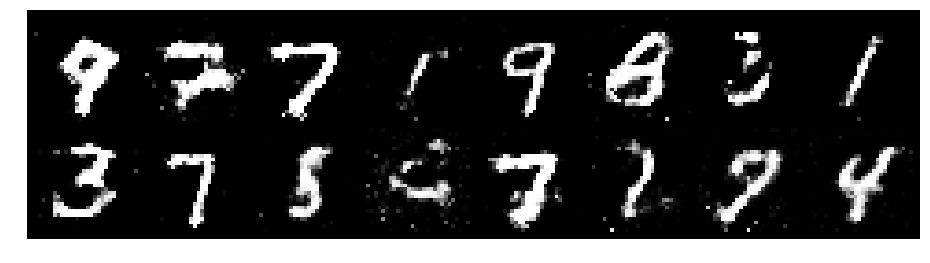

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.1377, Generator Loss: 1.0780
D(x): 0.6451, D(G(z)): 0.4223


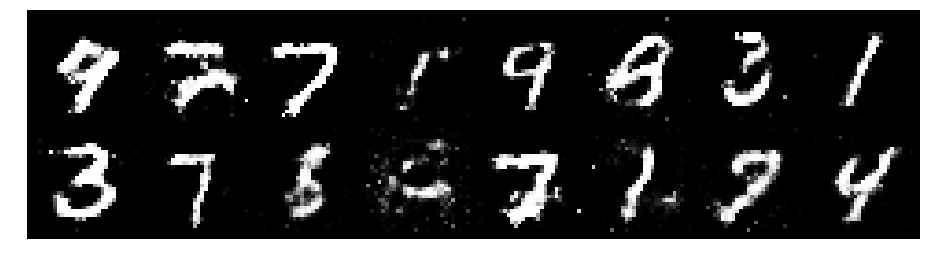

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.1011, Generator Loss: 1.1147
D(x): 0.6560, D(G(z)): 0.4178


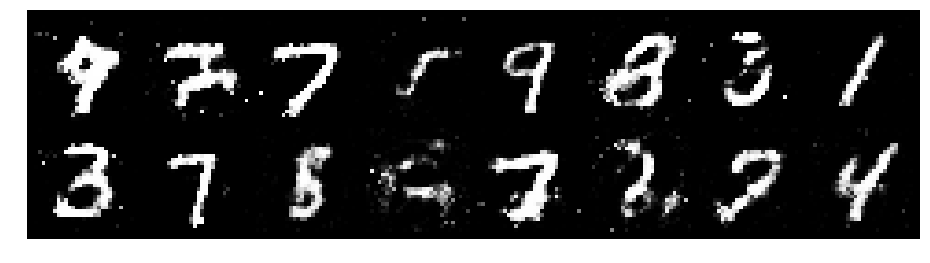

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.2605, Generator Loss: 0.9780
D(x): 0.5732, D(G(z)): 0.4315


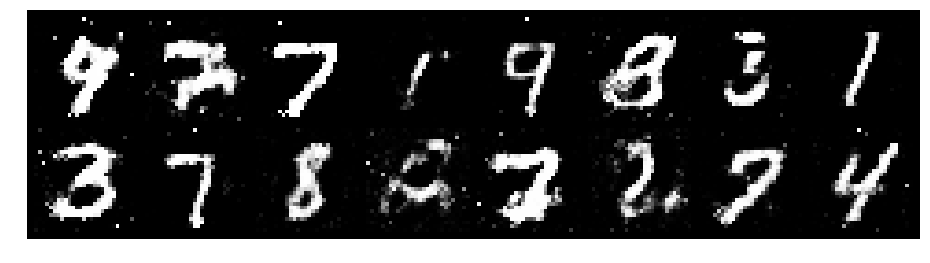

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.3231, Generator Loss: 0.8876
D(x): 0.5870, D(G(z)): 0.4756


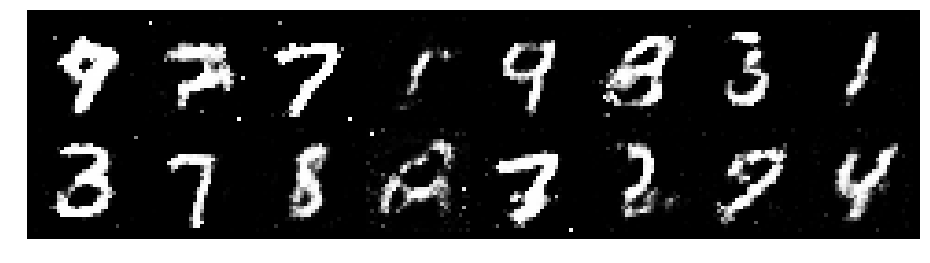

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.2964, Generator Loss: 0.9023
D(x): 0.5343, D(G(z)): 0.4217


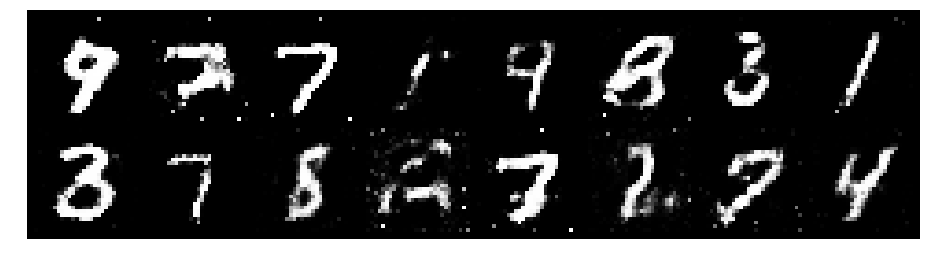

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.1509, Generator Loss: 1.1203
D(x): 0.6610, D(G(z)): 0.4632


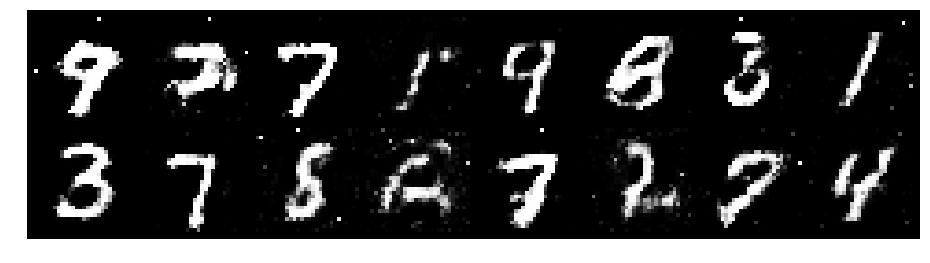

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.0622, Generator Loss: 1.0666
D(x): 0.5947, D(G(z)): 0.3591


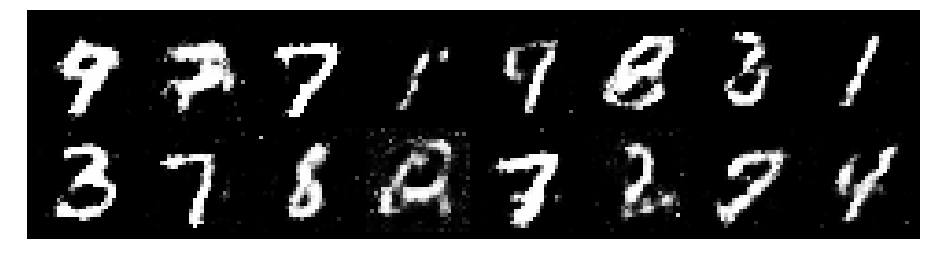

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.0500, Generator Loss: 1.0580
D(x): 0.6389, D(G(z)): 0.3764


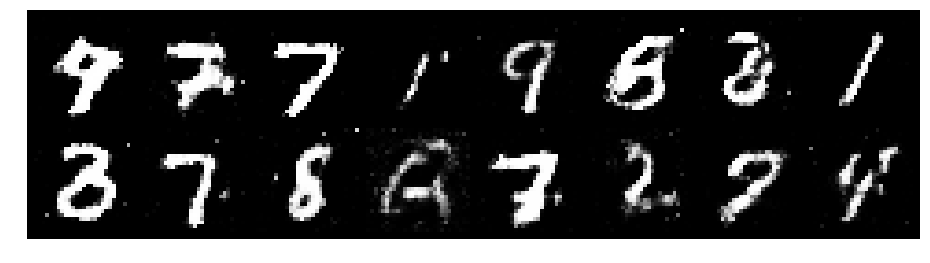

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.2412, Generator Loss: 1.0176
D(x): 0.6039, D(G(z)): 0.4184


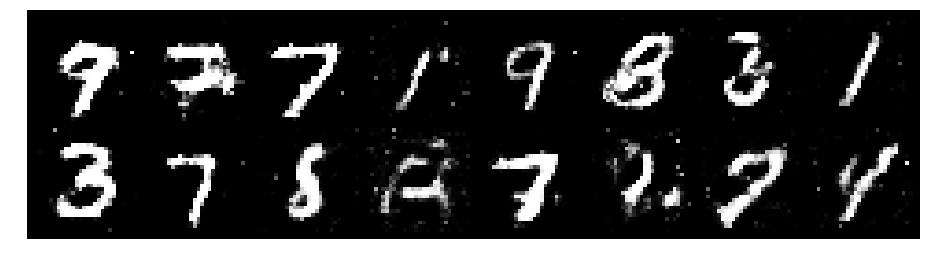

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.0330, Generator Loss: 1.7730
D(x): 0.6028, D(G(z)): 0.2953


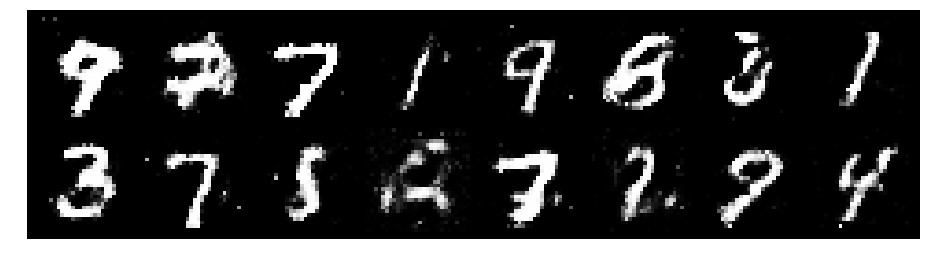

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.0777, Generator Loss: 1.1137
D(x): 0.6346, D(G(z)): 0.3796


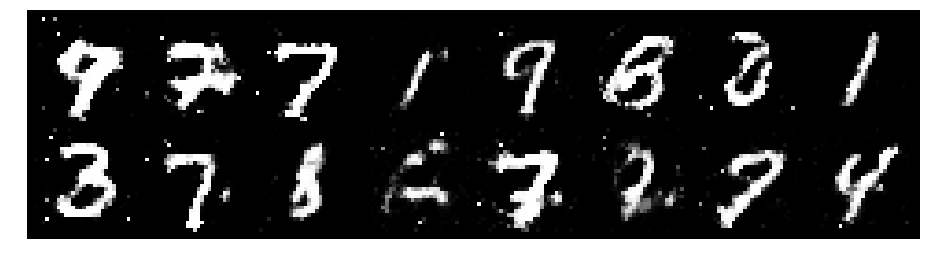

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.2060, Generator Loss: 0.9030
D(x): 0.6020, D(G(z)): 0.4661


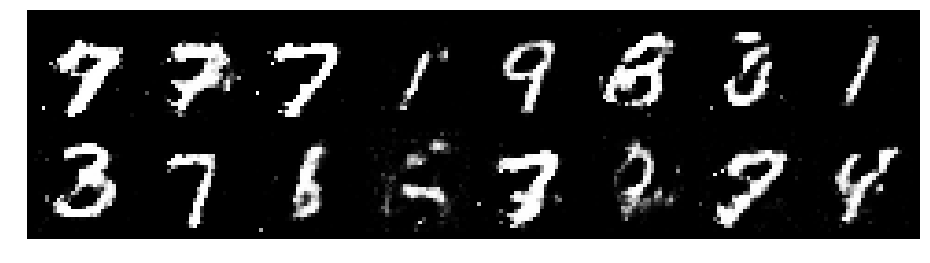

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.1518, Generator Loss: 1.0186
D(x): 0.5637, D(G(z)): 0.3547


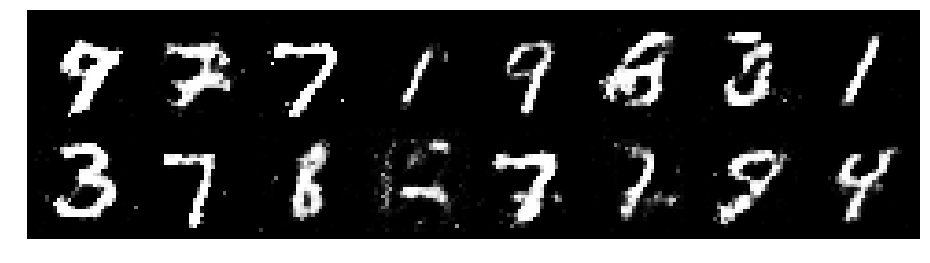

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.1249, Generator Loss: 0.9317
D(x): 0.6567, D(G(z)): 0.4162


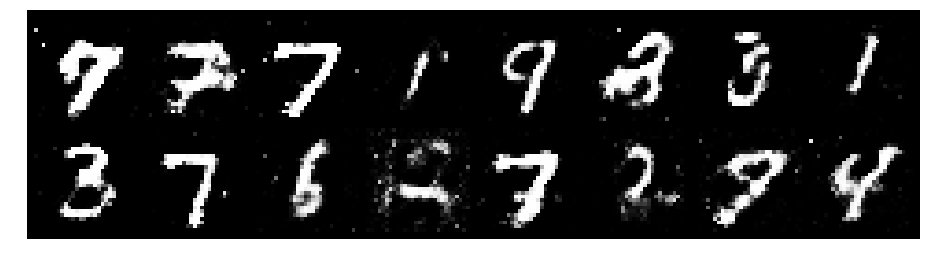

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.0680, Generator Loss: 1.2121
D(x): 0.6141, D(G(z)): 0.3752


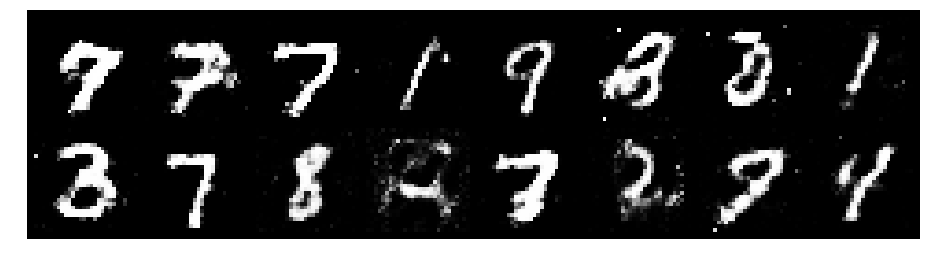

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.1568, Generator Loss: 1.1893
D(x): 0.5650, D(G(z)): 0.3689


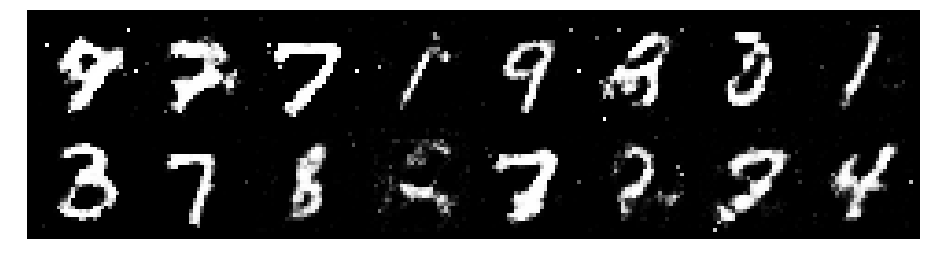

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.2876, Generator Loss: 0.9288
D(x): 0.5934, D(G(z)): 0.4706


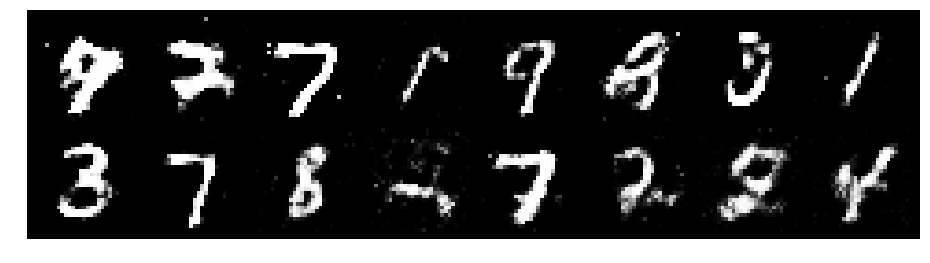

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.2430, Generator Loss: 0.8170
D(x): 0.5708, D(G(z)): 0.4394


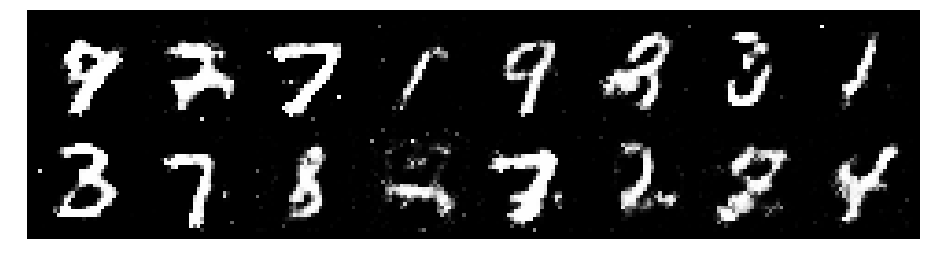

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.3427, Generator Loss: 0.9239
D(x): 0.6365, D(G(z)): 0.5179


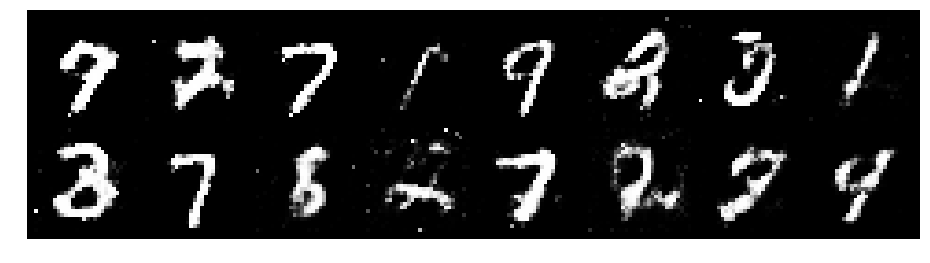

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.2967, Generator Loss: 0.9797
D(x): 0.5658, D(G(z)): 0.4471


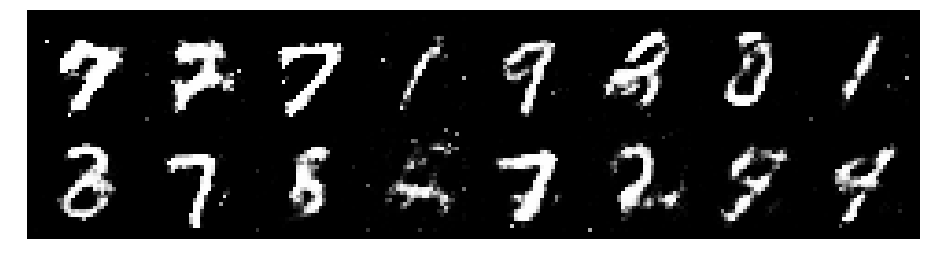

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.1176, Generator Loss: 0.9088
D(x): 0.5989, D(G(z)): 0.4004


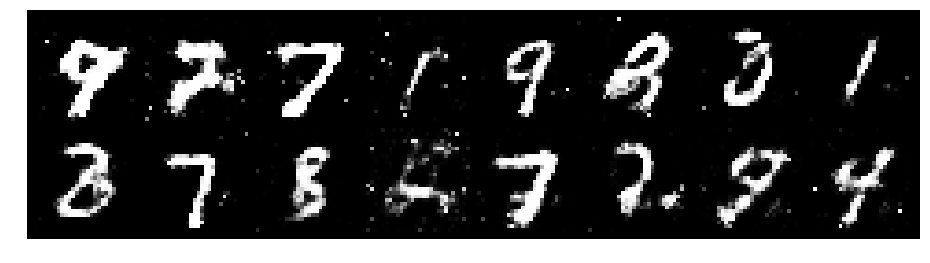

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.2706, Generator Loss: 0.9051
D(x): 0.5738, D(G(z)): 0.4473


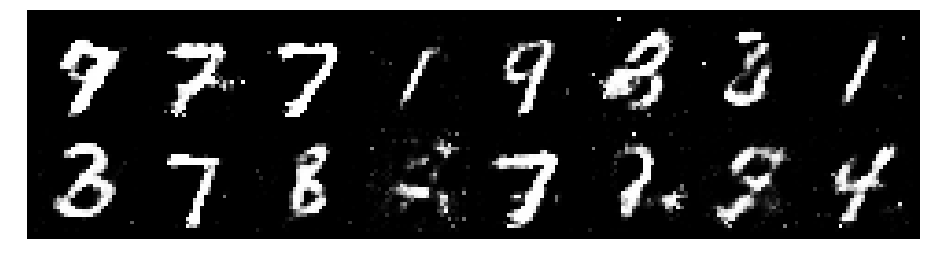

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.2883, Generator Loss: 0.9449
D(x): 0.5599, D(G(z)): 0.4319


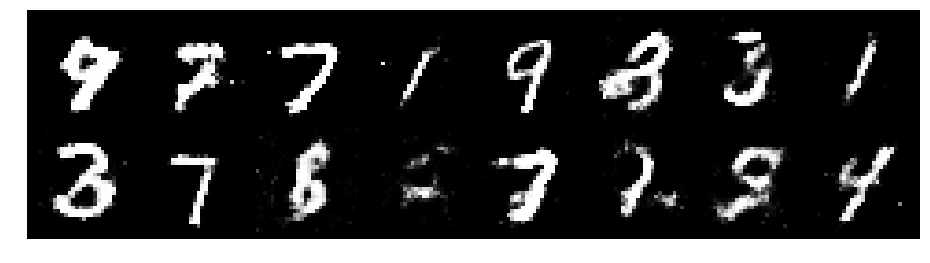

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.0998, Generator Loss: 1.1047
D(x): 0.6047, D(G(z)): 0.3667


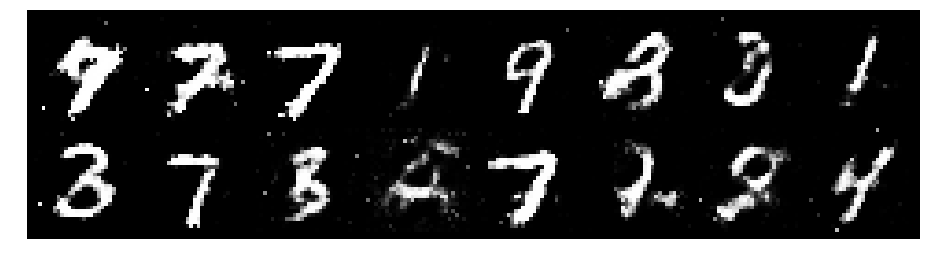

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.1514, Generator Loss: 1.3368
D(x): 0.6125, D(G(z)): 0.3850


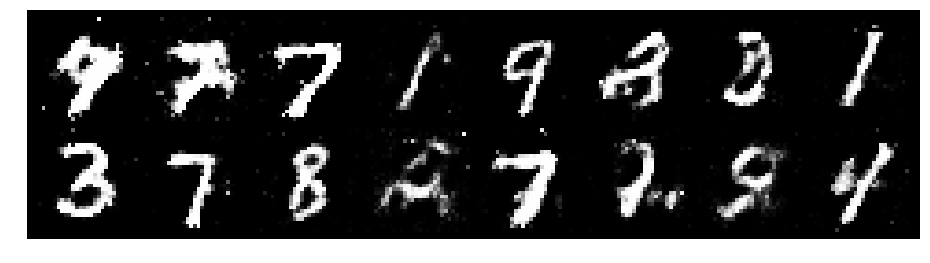

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.1568, Generator Loss: 1.0220
D(x): 0.6055, D(G(z)): 0.3955


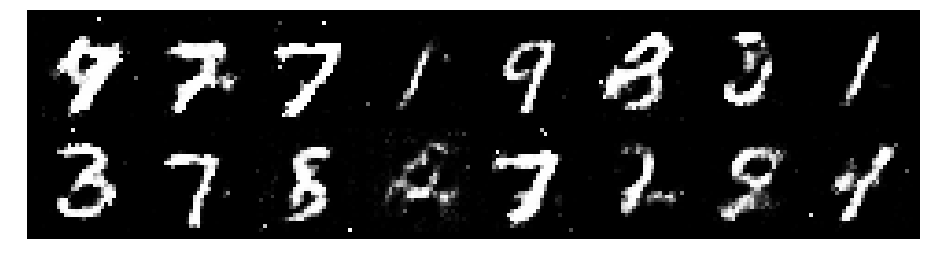

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.1768, Generator Loss: 1.1400
D(x): 0.5795, D(G(z)): 0.3817


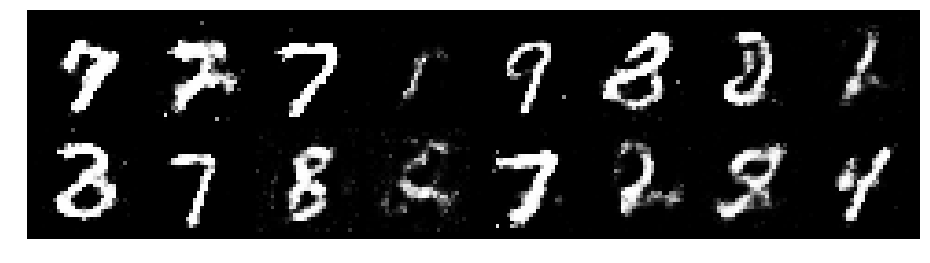

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.1758, Generator Loss: 0.8713
D(x): 0.5538, D(G(z)): 0.3845


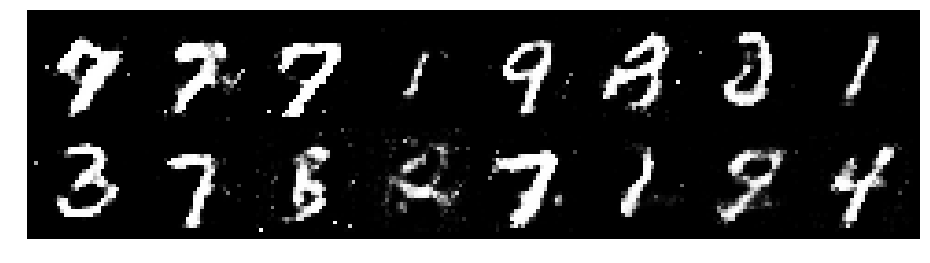

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.1375, Generator Loss: 1.0426
D(x): 0.5993, D(G(z)): 0.3924


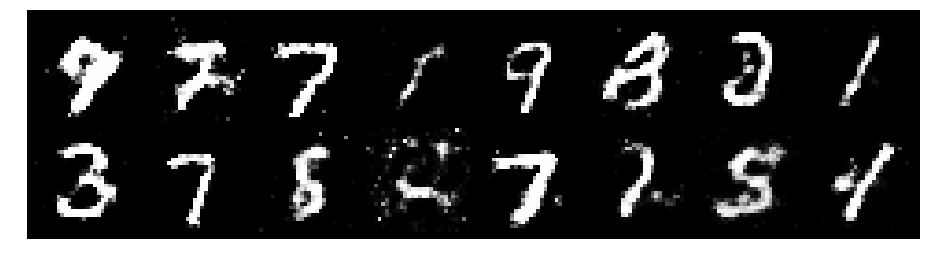

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.2478, Generator Loss: 0.9834
D(x): 0.5216, D(G(z)): 0.3707


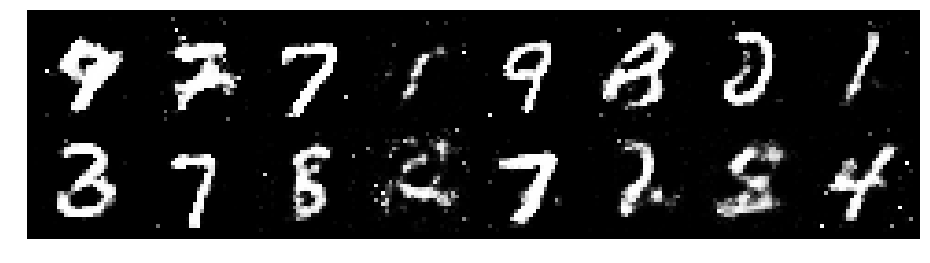

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.0703, Generator Loss: 1.0199
D(x): 0.5904, D(G(z)): 0.3656


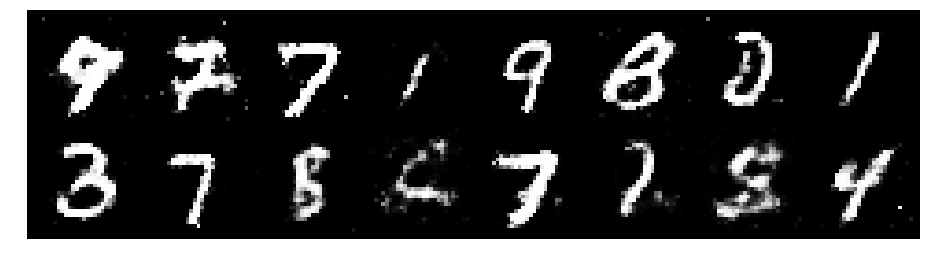

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.1404, Generator Loss: 1.1989
D(x): 0.5631, D(G(z)): 0.3538


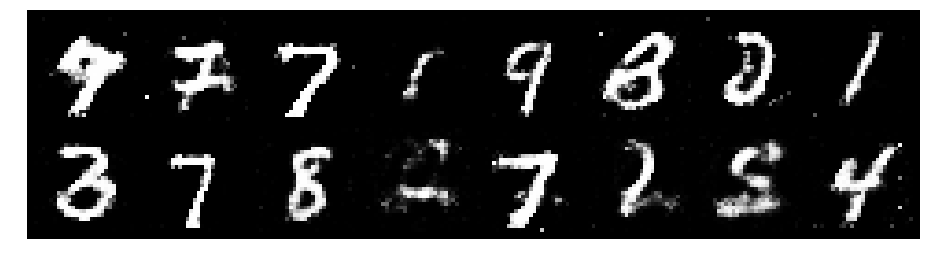

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.1967, Generator Loss: 0.9015
D(x): 0.5834, D(G(z)): 0.3991


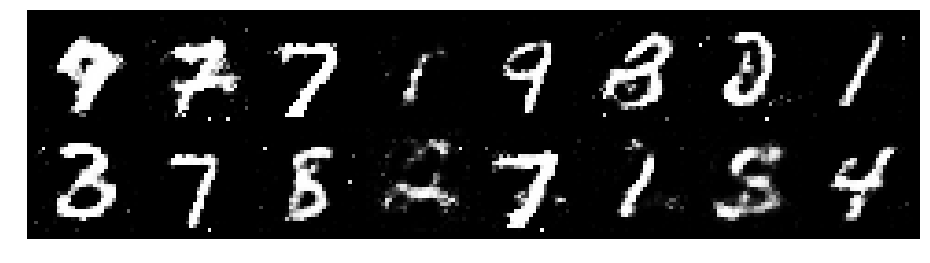

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.1595, Generator Loss: 0.8570
D(x): 0.5725, D(G(z)): 0.4037


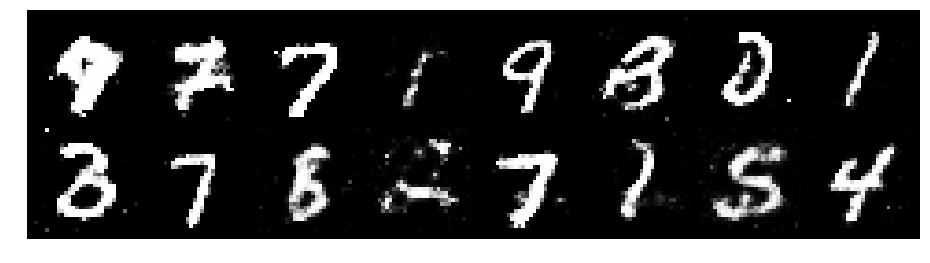

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.2454, Generator Loss: 0.9037
D(x): 0.5814, D(G(z)): 0.4403


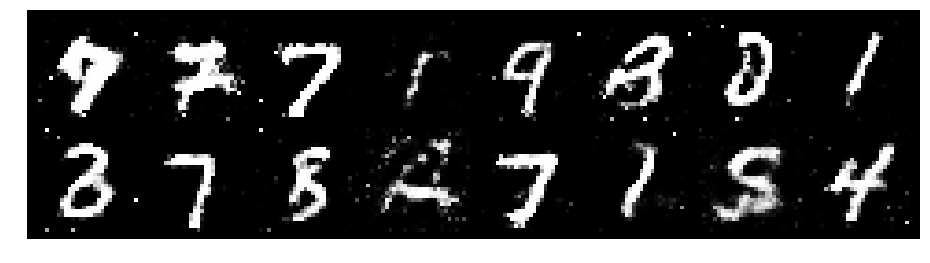

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.2835, Generator Loss: 0.8542
D(x): 0.6230, D(G(z)): 0.4764


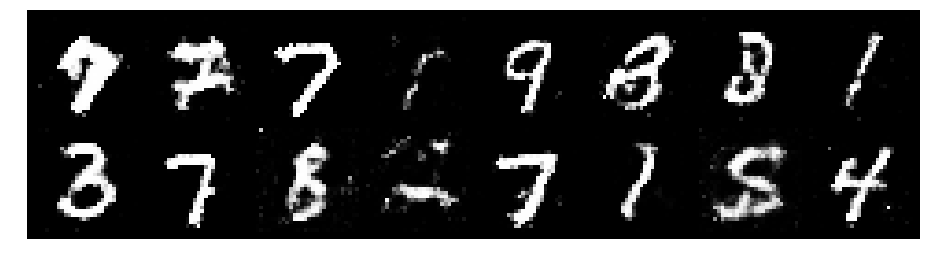

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.1477, Generator Loss: 0.9917
D(x): 0.6027, D(G(z)): 0.4268


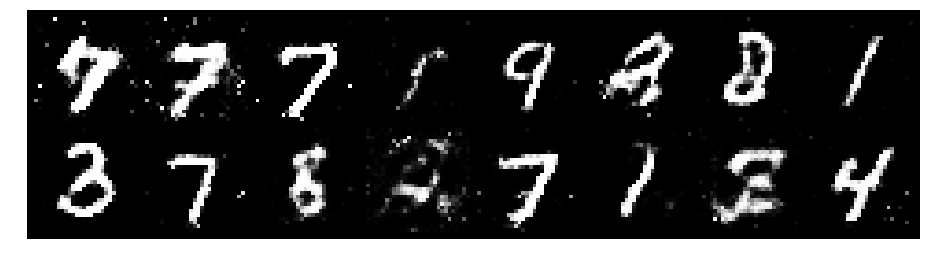

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.1822, Generator Loss: 0.9358
D(x): 0.5734, D(G(z)): 0.4235


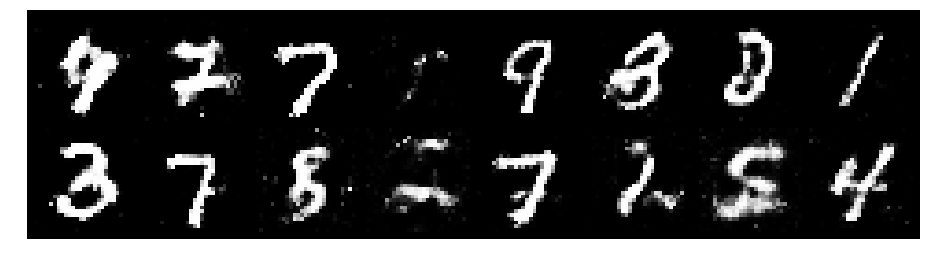

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.3226, Generator Loss: 0.9241
D(x): 0.5281, D(G(z)): 0.4424


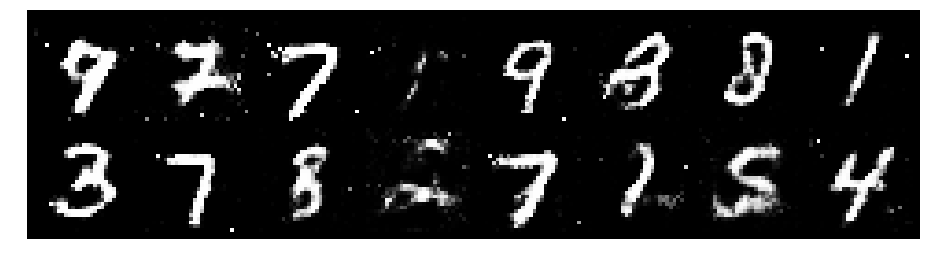

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.4321, Generator Loss: 0.9808
D(x): 0.5437, D(G(z)): 0.4702


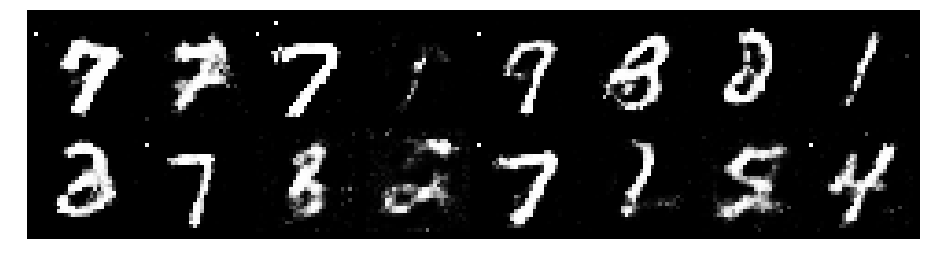

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.2674, Generator Loss: 0.8900
D(x): 0.5948, D(G(z)): 0.4305


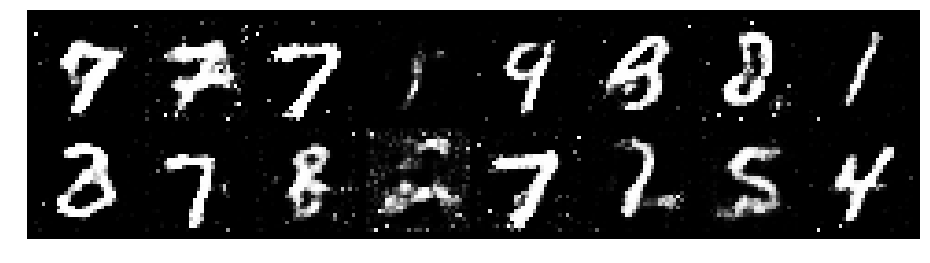

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.2197, Generator Loss: 1.1037
D(x): 0.5796, D(G(z)): 0.4033


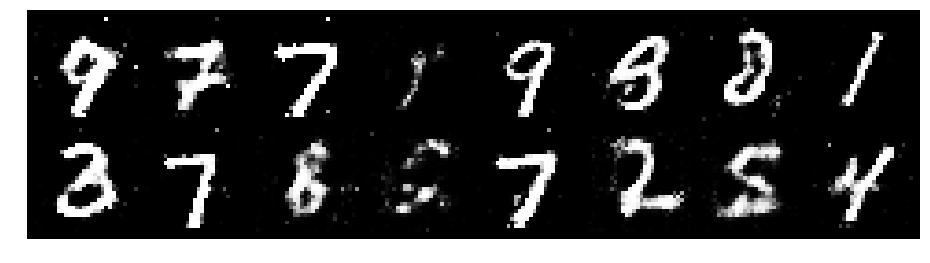

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.1520, Generator Loss: 1.0590
D(x): 0.6086, D(G(z)): 0.4109


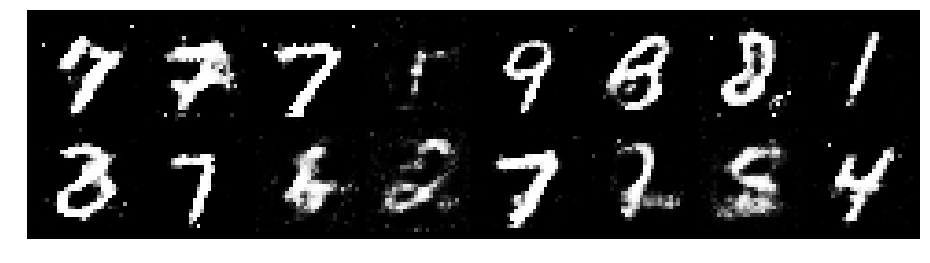

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.2660, Generator Loss: 0.8610
D(x): 0.5622, D(G(z)): 0.4493


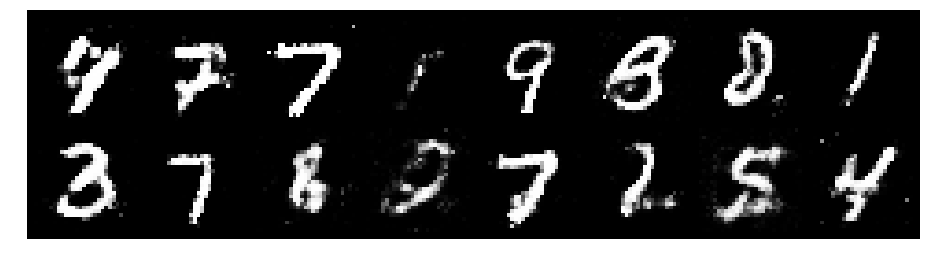

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.3534, Generator Loss: 0.7320
D(x): 0.5601, D(G(z)): 0.5066


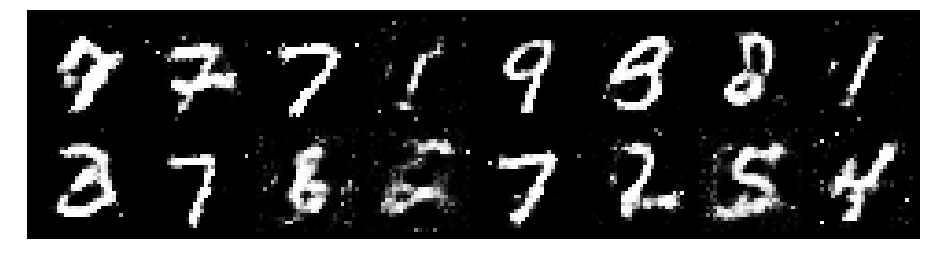

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.3308, Generator Loss: 0.8553
D(x): 0.5937, D(G(z)): 0.4877


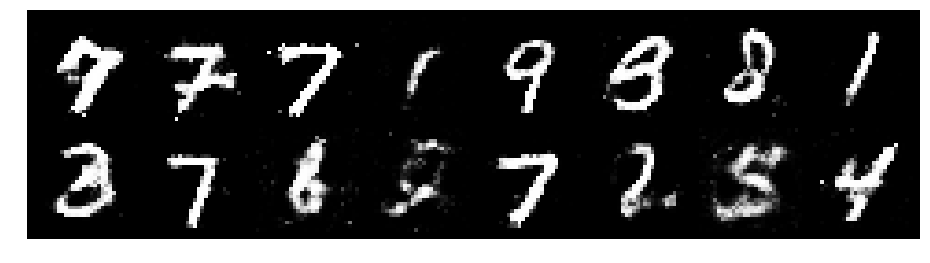

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.1378, Generator Loss: 1.0893
D(x): 0.5780, D(G(z)): 0.3689


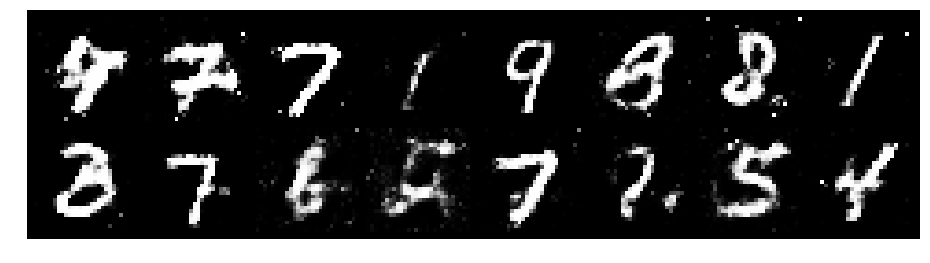

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.2270, Generator Loss: 1.0139
D(x): 0.5697, D(G(z)): 0.4373


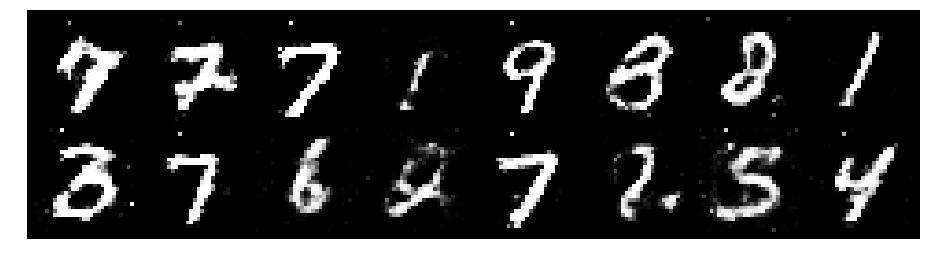

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.2692, Generator Loss: 1.0687
D(x): 0.5932, D(G(z)): 0.4512


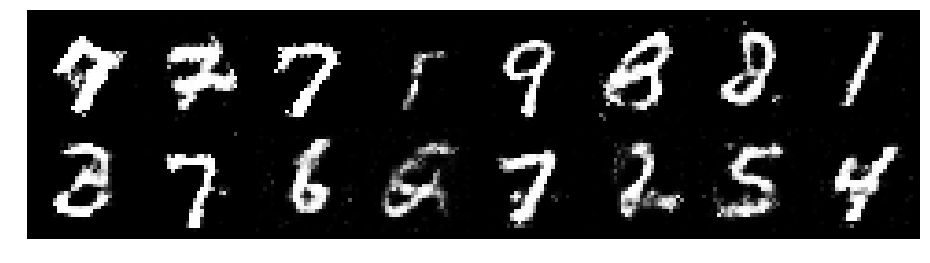

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.2516, Generator Loss: 1.0292
D(x): 0.5756, D(G(z)): 0.4367


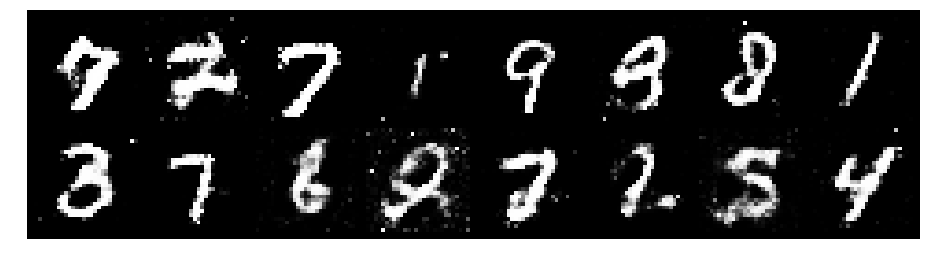

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.2126, Generator Loss: 0.9513
D(x): 0.5599, D(G(z)): 0.4053


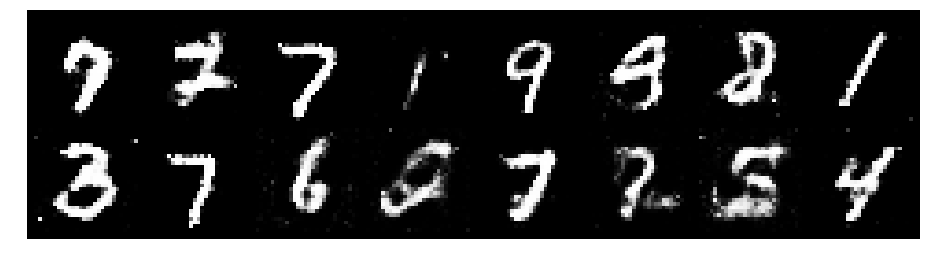

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.1365, Generator Loss: 0.9613
D(x): 0.6042, D(G(z)): 0.4166


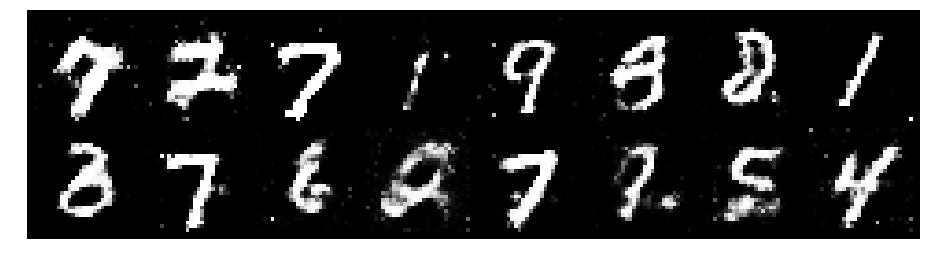

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.1631, Generator Loss: 0.8591
D(x): 0.5931, D(G(z)): 0.4339


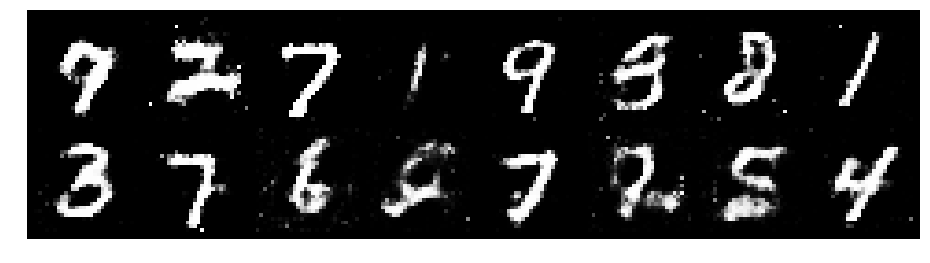

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.2598, Generator Loss: 0.9095
D(x): 0.5708, D(G(z)): 0.4279


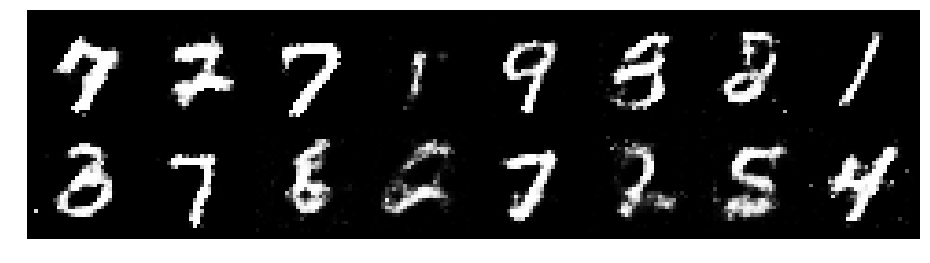

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.1186, Generator Loss: 1.0639
D(x): 0.6052, D(G(z)): 0.3956


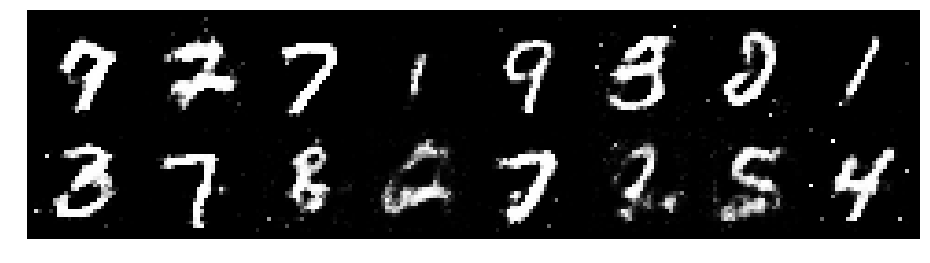

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.1730, Generator Loss: 0.8807
D(x): 0.5747, D(G(z)): 0.4183


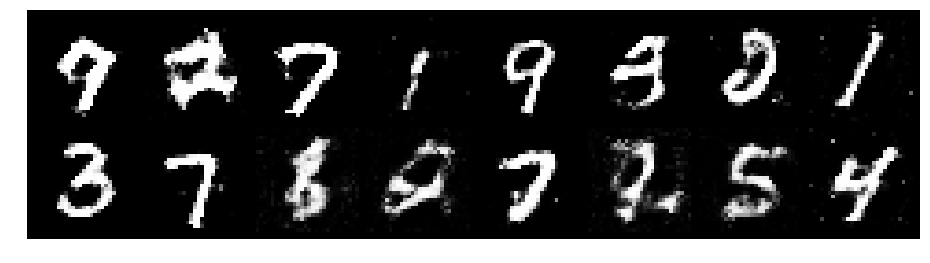

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.2496, Generator Loss: 0.8191
D(x): 0.5908, D(G(z)): 0.4810


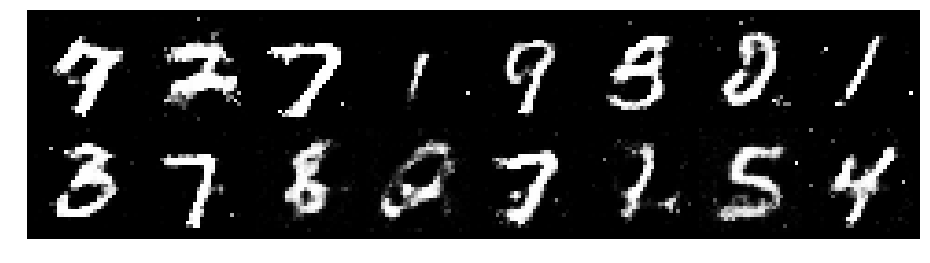

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.1649, Generator Loss: 1.0126
D(x): 0.5928, D(G(z)): 0.3943


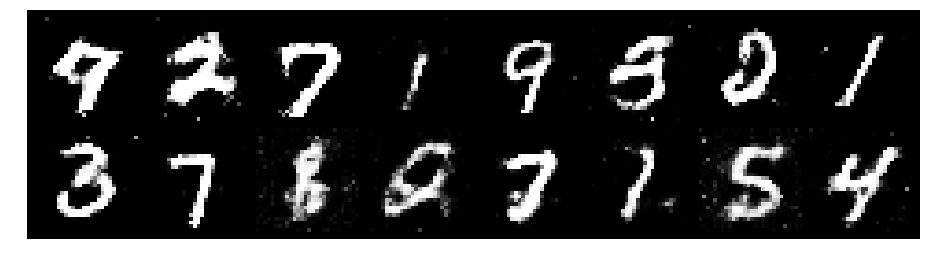

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.3793, Generator Loss: 0.8580
D(x): 0.5279, D(G(z)): 0.4112


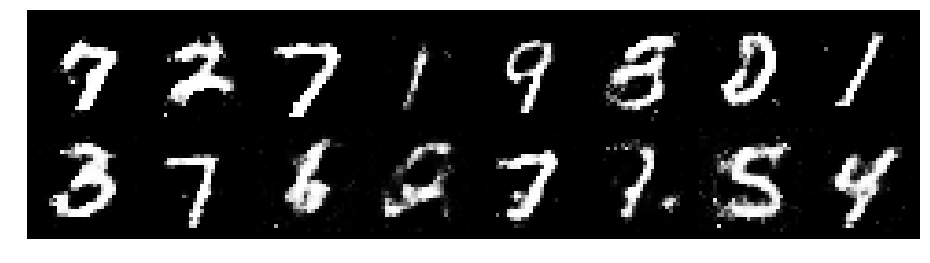

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.2260, Generator Loss: 1.0562
D(x): 0.5377, D(G(z)): 0.3844


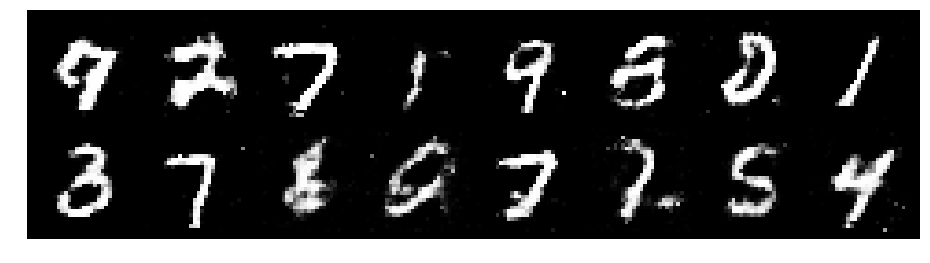

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.3089, Generator Loss: 0.8288
D(x): 0.5930, D(G(z)): 0.5079


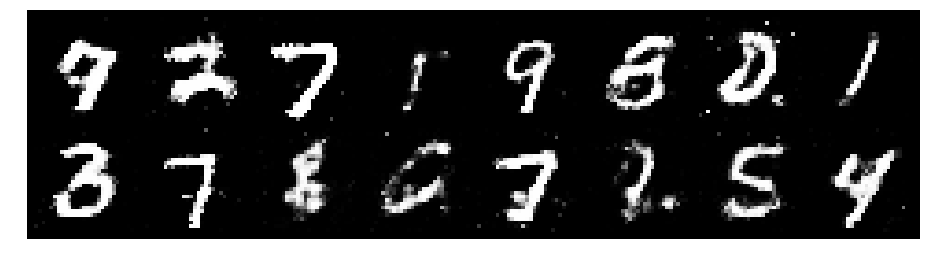

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.2731, Generator Loss: 0.9381
D(x): 0.5811, D(G(z)): 0.4374


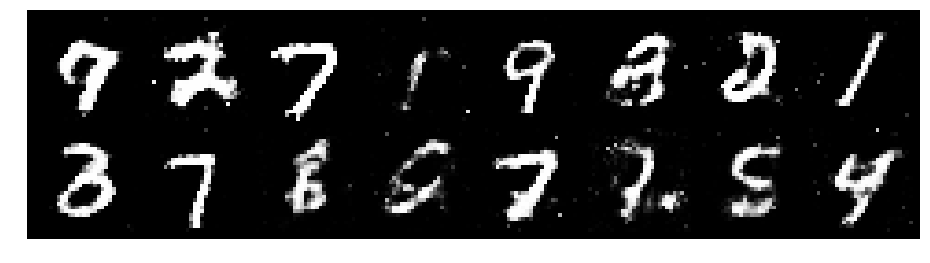

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.2272, Generator Loss: 1.1129
D(x): 0.5676, D(G(z)): 0.4147


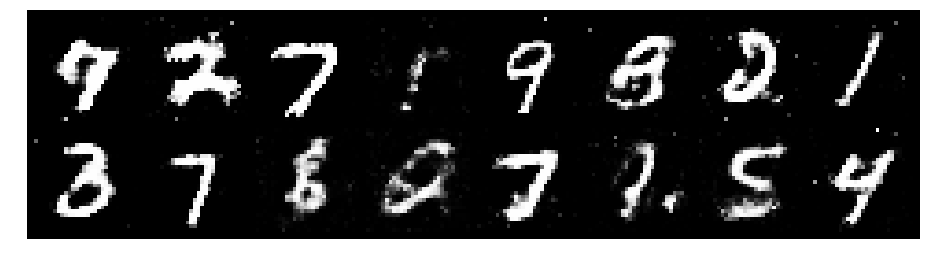

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.1299, Generator Loss: 0.9074
D(x): 0.6183, D(G(z)): 0.4192


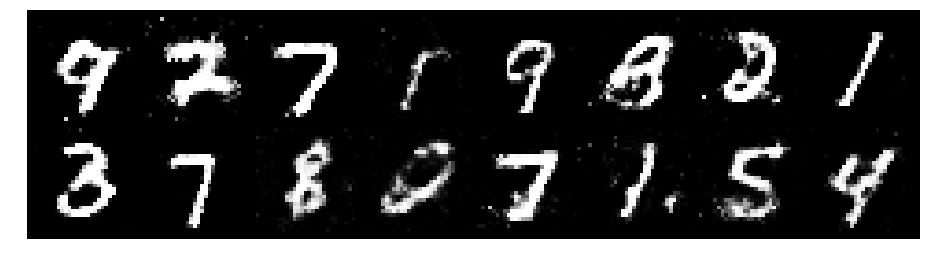

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.2707, Generator Loss: 1.0226
D(x): 0.5283, D(G(z)): 0.3777


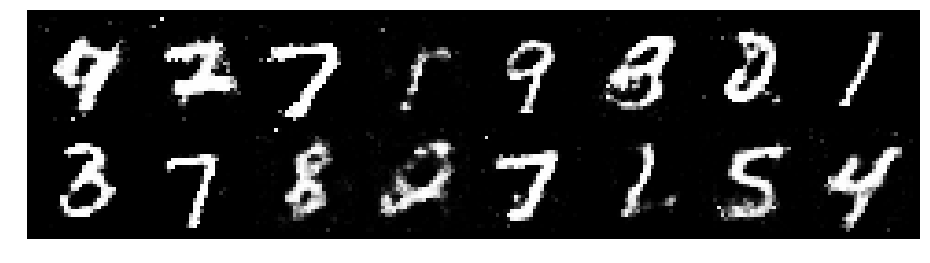

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.2164, Generator Loss: 0.9171
D(x): 0.5821, D(G(z)): 0.4322


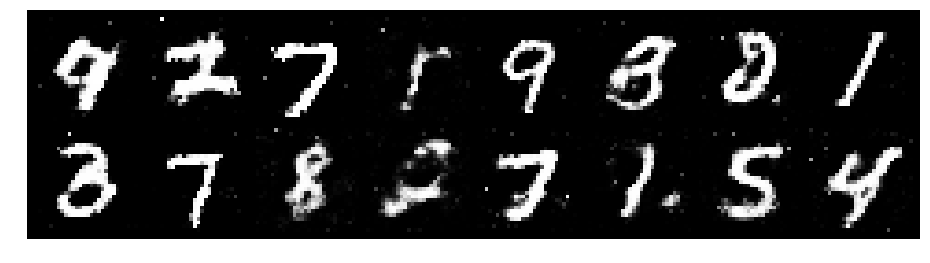

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.2489, Generator Loss: 0.9351
D(x): 0.6568, D(G(z)): 0.4838


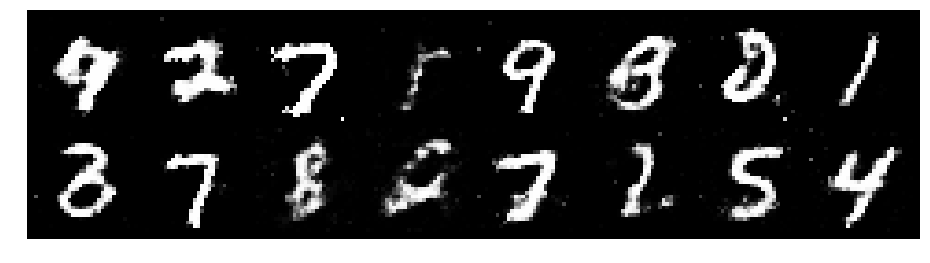

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.2469, Generator Loss: 1.0313
D(x): 0.5750, D(G(z)): 0.4135


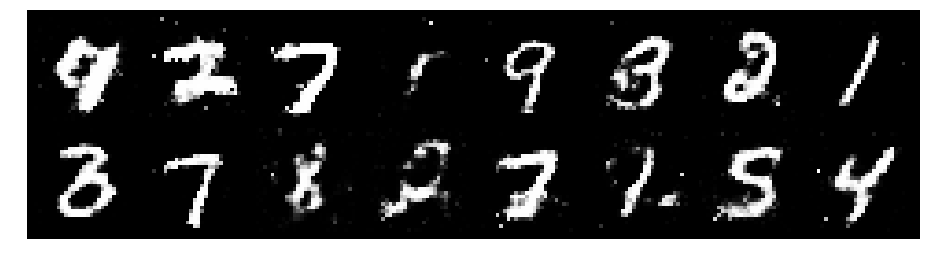

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.0294, Generator Loss: 1.1975
D(x): 0.6284, D(G(z)): 0.3708


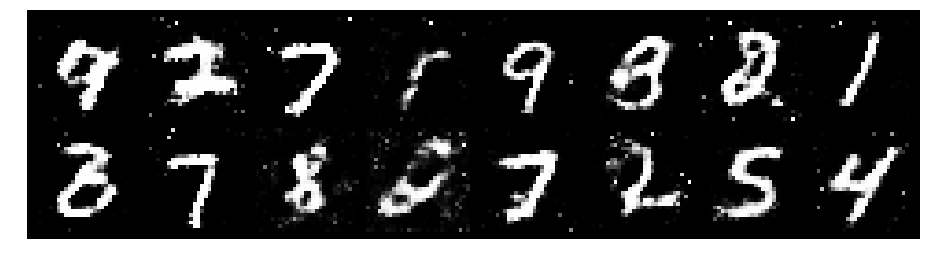

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.3312, Generator Loss: 0.8756
D(x): 0.5126, D(G(z)): 0.4550


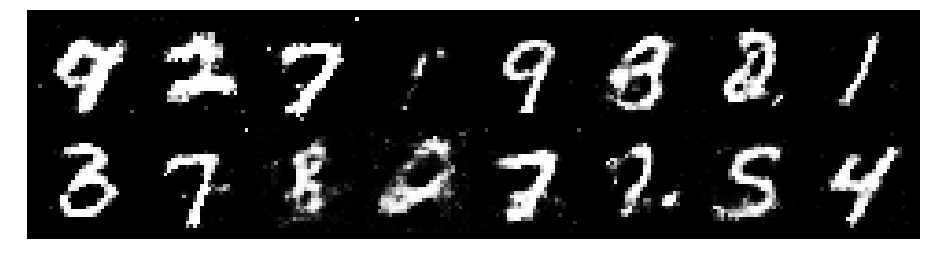

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.1037, Generator Loss: 1.0833
D(x): 0.6098, D(G(z)): 0.3718


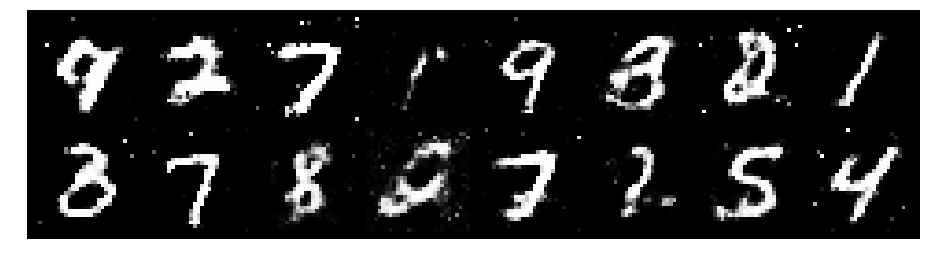

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.2619, Generator Loss: 1.1064
D(x): 0.5714, D(G(z)): 0.4274


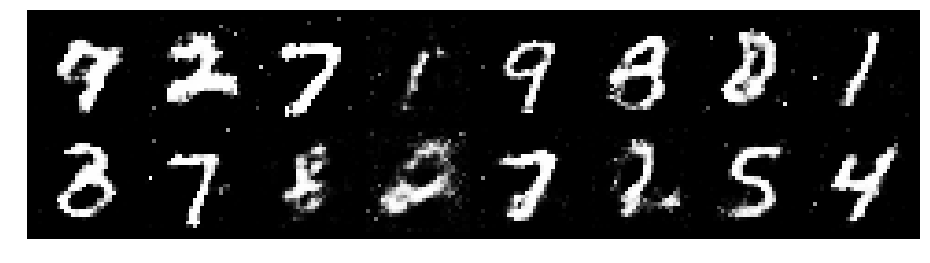

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.1717, Generator Loss: 1.0697
D(x): 0.5986, D(G(z)): 0.4210


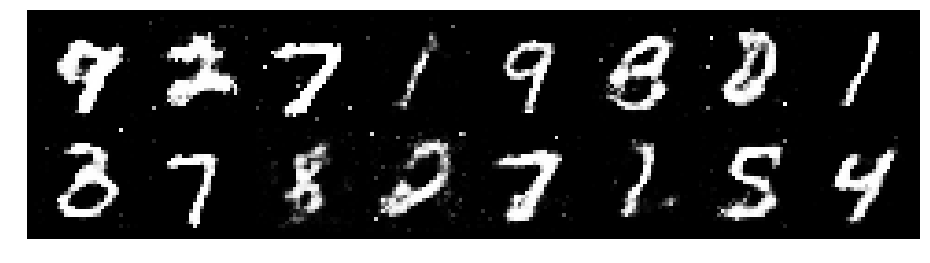

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.1273, Generator Loss: 1.1370
D(x): 0.6188, D(G(z)): 0.3879


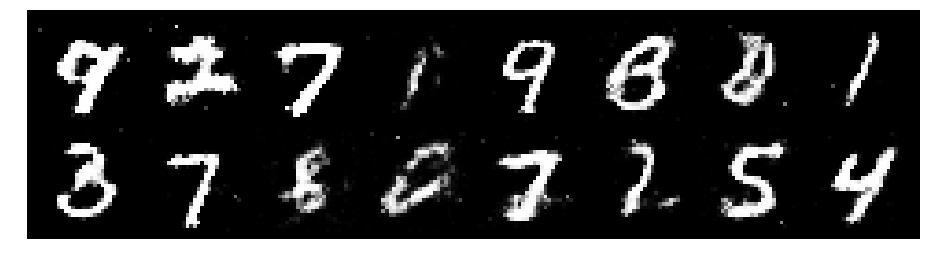

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.1684, Generator Loss: 1.4044
D(x): 0.5934, D(G(z)): 0.3817


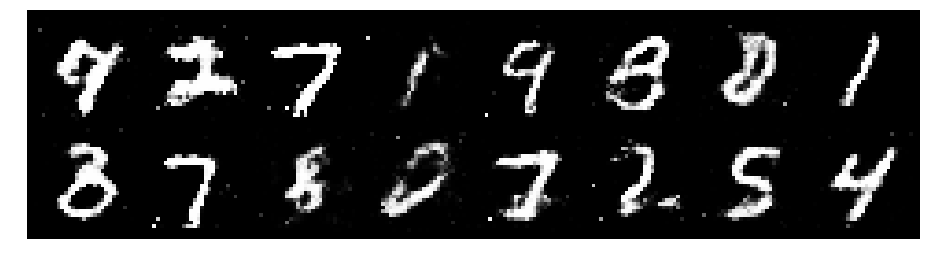

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.1181, Generator Loss: 0.9738
D(x): 0.6163, D(G(z)): 0.4177


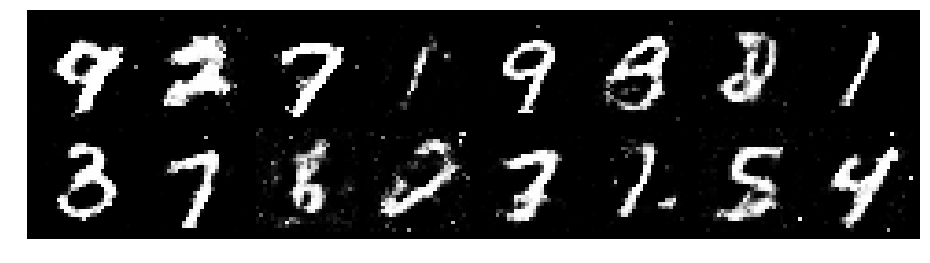

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.2303, Generator Loss: 0.8440
D(x): 0.5631, D(G(z)): 0.4430


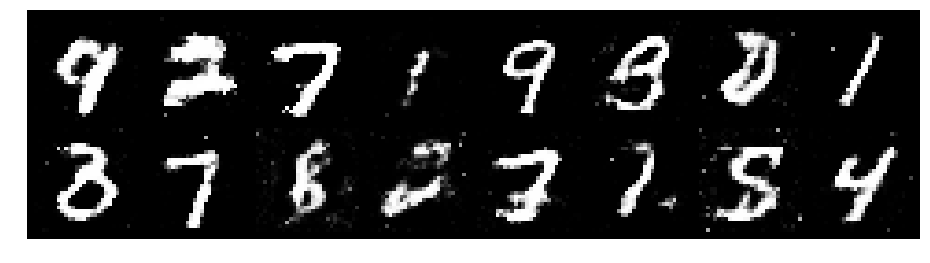

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.2468, Generator Loss: 0.8368
D(x): 0.5838, D(G(z)): 0.4552


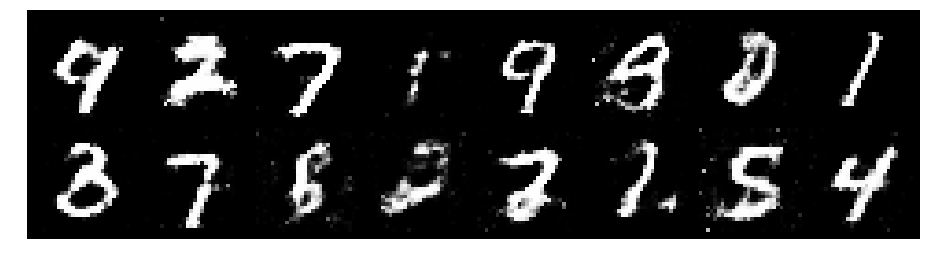

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.3932, Generator Loss: 0.8592
D(x): 0.5381, D(G(z)): 0.4694


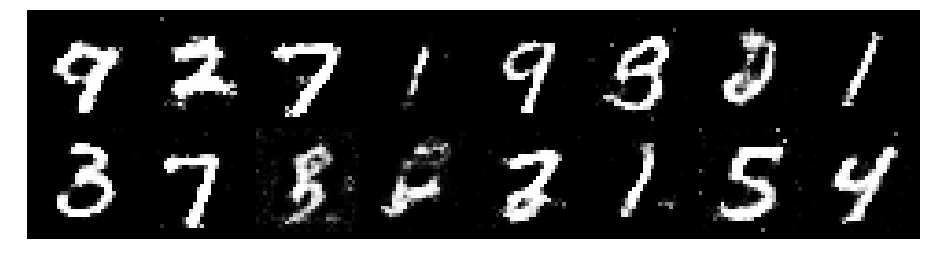

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.1738, Generator Loss: 0.9911
D(x): 0.6742, D(G(z)): 0.4600


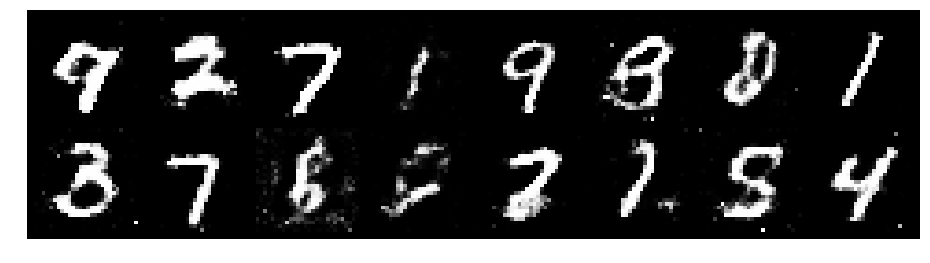

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.1447, Generator Loss: 0.8952
D(x): 0.5983, D(G(z)): 0.4157


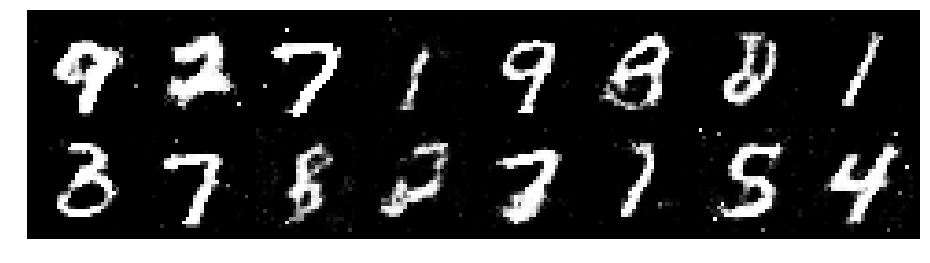

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.2855, Generator Loss: 0.9390
D(x): 0.5592, D(G(z)): 0.4508


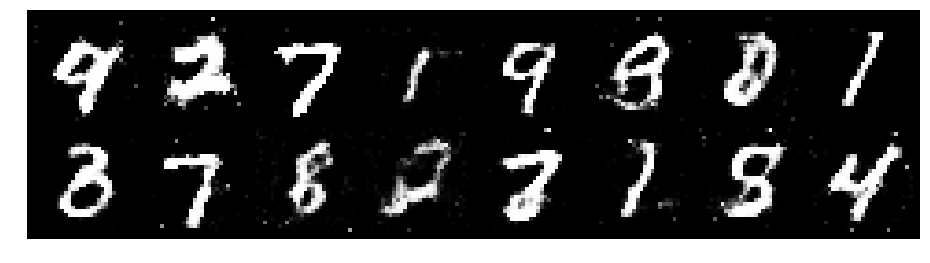

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.2977, Generator Loss: 0.8718
D(x): 0.5563, D(G(z)): 0.4510


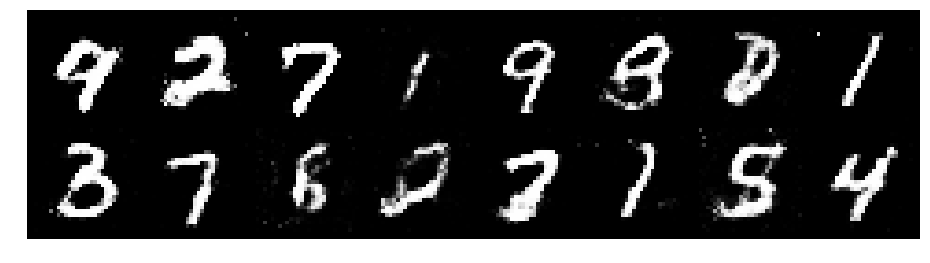

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.2420, Generator Loss: 1.0138
D(x): 0.6490, D(G(z)): 0.4666


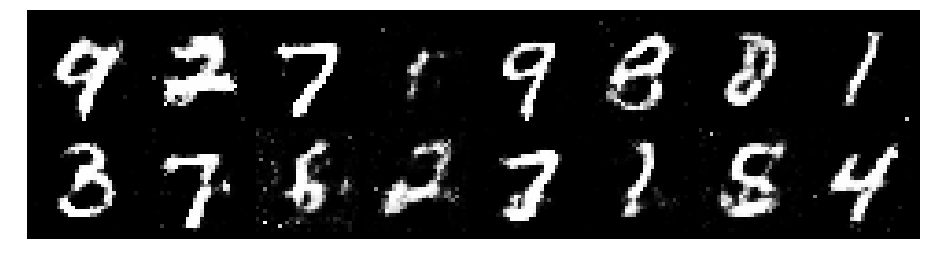

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.2625, Generator Loss: 1.0313
D(x): 0.5238, D(G(z)): 0.3980


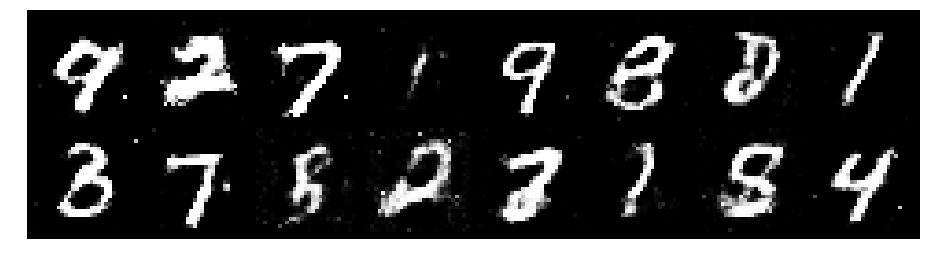

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.3119, Generator Loss: 0.9403
D(x): 0.5601, D(G(z)): 0.4501


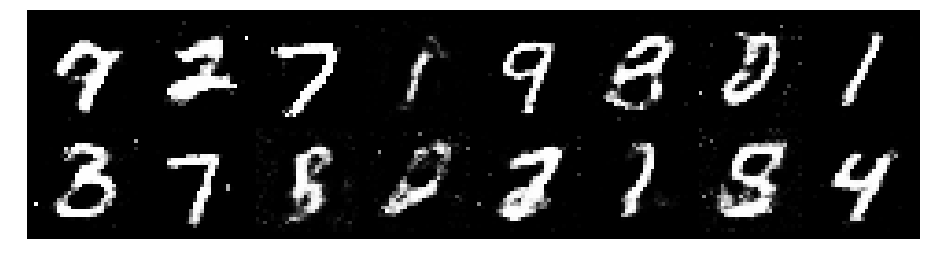

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.3291, Generator Loss: 0.9598
D(x): 0.5473, D(G(z)): 0.4248


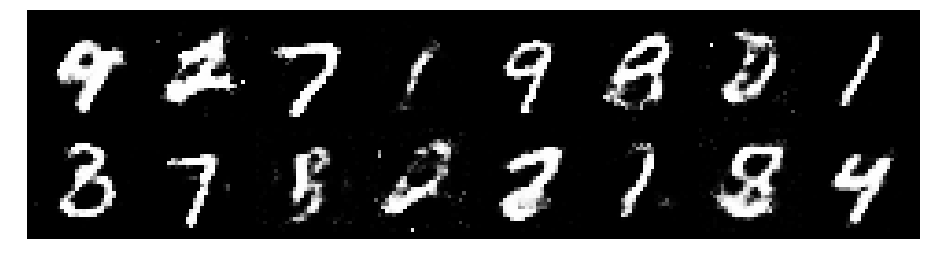

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.2436, Generator Loss: 0.8374
D(x): 0.5729, D(G(z)): 0.4391


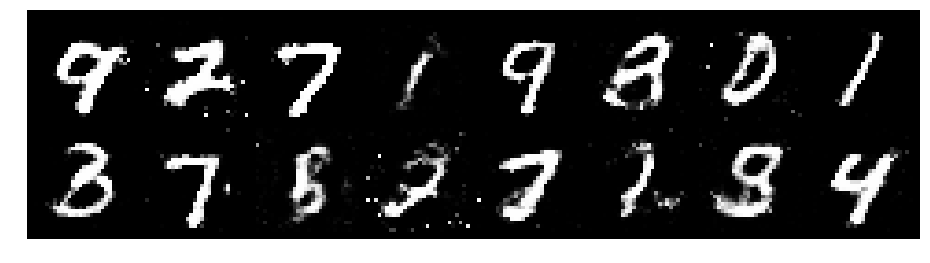

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.1880, Generator Loss: 1.1552
D(x): 0.5956, D(G(z)): 0.4056


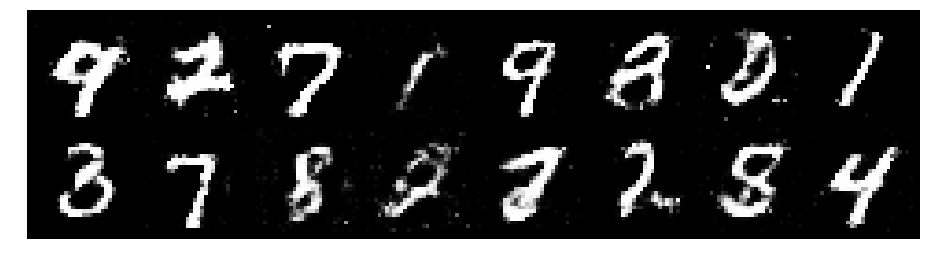

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.1681, Generator Loss: 0.8799
D(x): 0.5827, D(G(z)): 0.4119


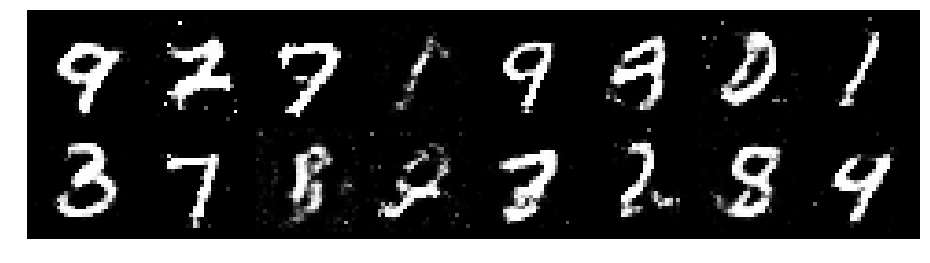

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.1175, Generator Loss: 0.9996
D(x): 0.6143, D(G(z)): 0.4066


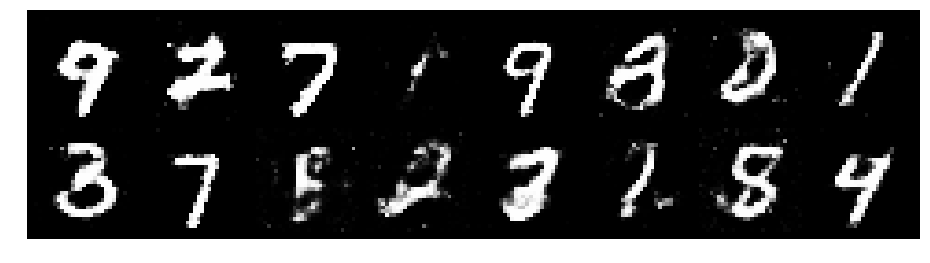

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.2448, Generator Loss: 0.9813
D(x): 0.5751, D(G(z)): 0.4034


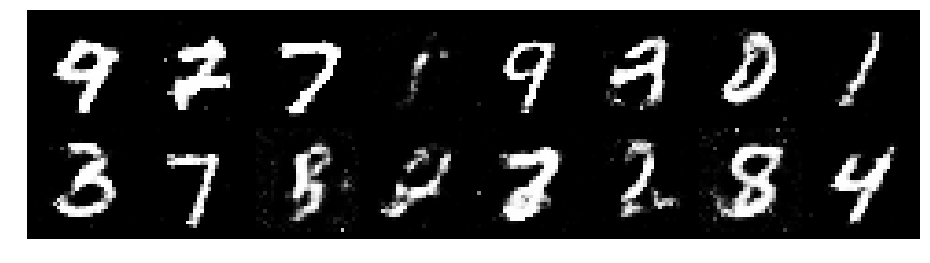

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.2981, Generator Loss: 1.0844
D(x): 0.5742, D(G(z)): 0.4134


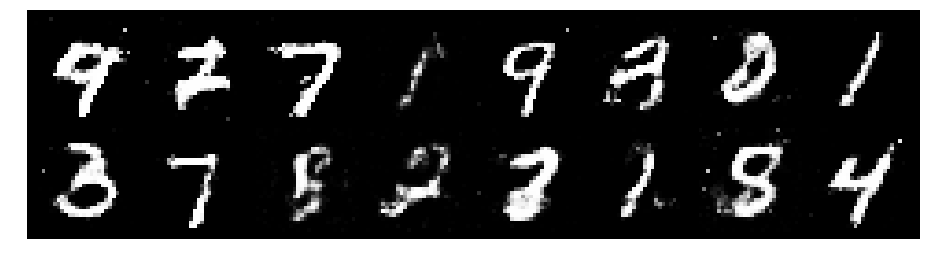

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.2177, Generator Loss: 1.2288
D(x): 0.6291, D(G(z)): 0.4569


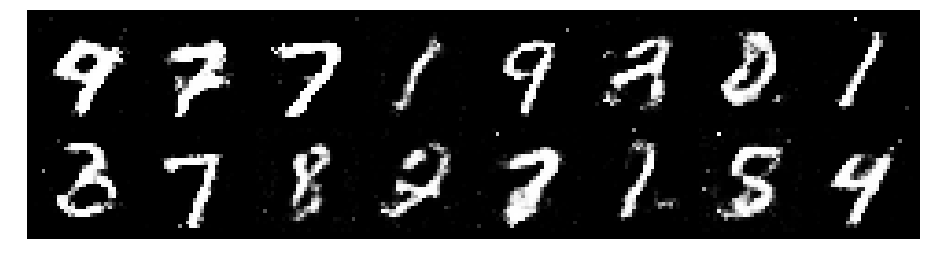

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.2503, Generator Loss: 1.0390
D(x): 0.5482, D(G(z)): 0.4022


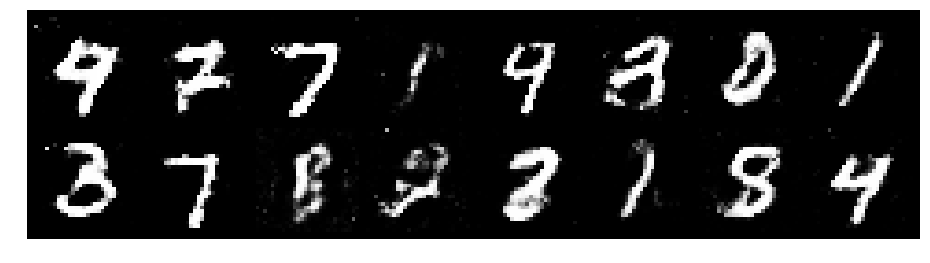

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.2033, Generator Loss: 0.9958
D(x): 0.5557, D(G(z)): 0.3927


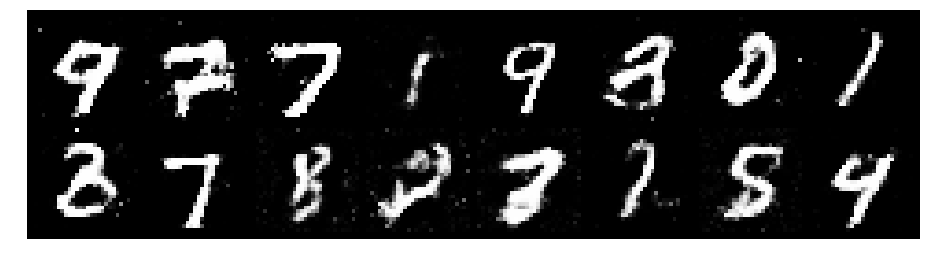

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.2770, Generator Loss: 1.0168
D(x): 0.5803, D(G(z)): 0.4317


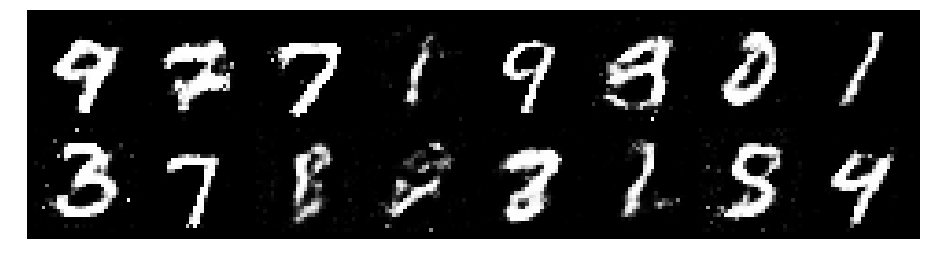

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.2865, Generator Loss: 0.9435
D(x): 0.5468, D(G(z)): 0.4077


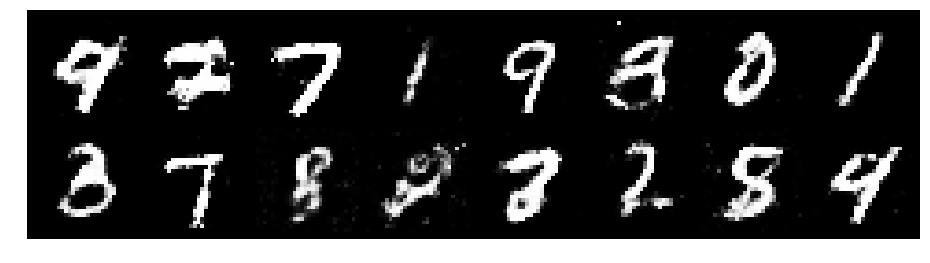

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.2950, Generator Loss: 0.8595
D(x): 0.5641, D(G(z)): 0.4592


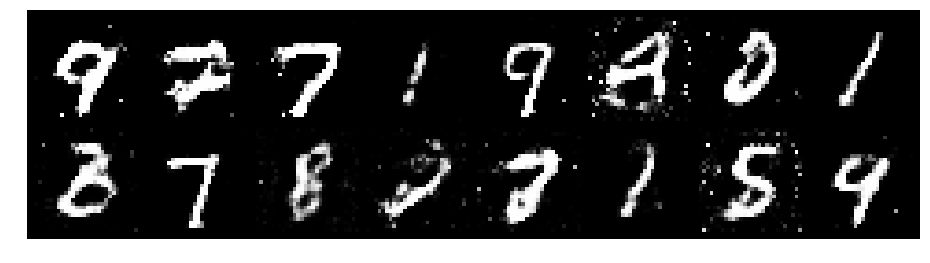

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.2649, Generator Loss: 1.1674
D(x): 0.6049, D(G(z)): 0.4523


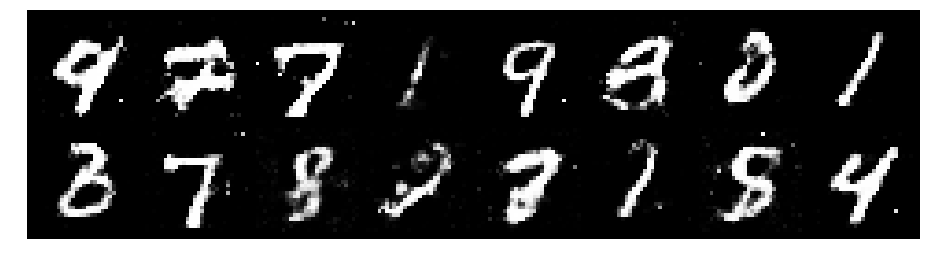

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.2102, Generator Loss: 0.8941
D(x): 0.5580, D(G(z)): 0.4231


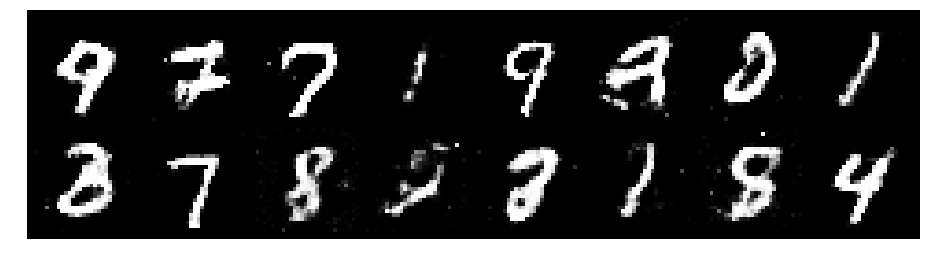

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.2648, Generator Loss: 0.7866
D(x): 0.5531, D(G(z)): 0.4294


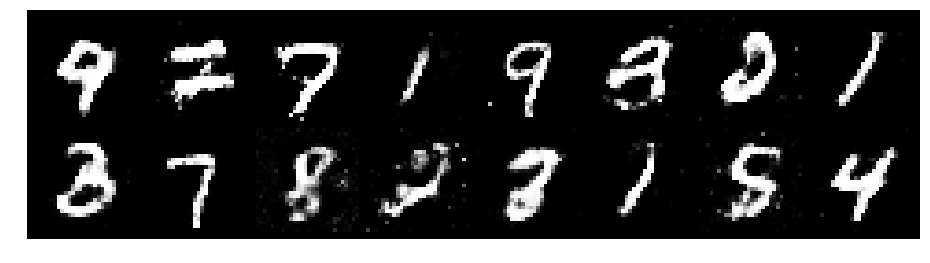

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.2734, Generator Loss: 0.9047
D(x): 0.5700, D(G(z)): 0.4360


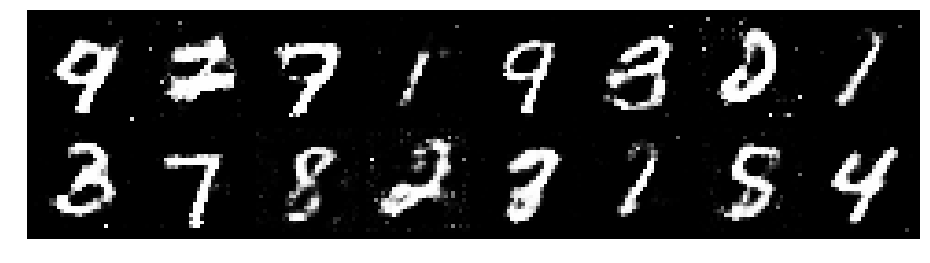

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.0324, Generator Loss: 1.1906
D(x): 0.6131, D(G(z)): 0.3358


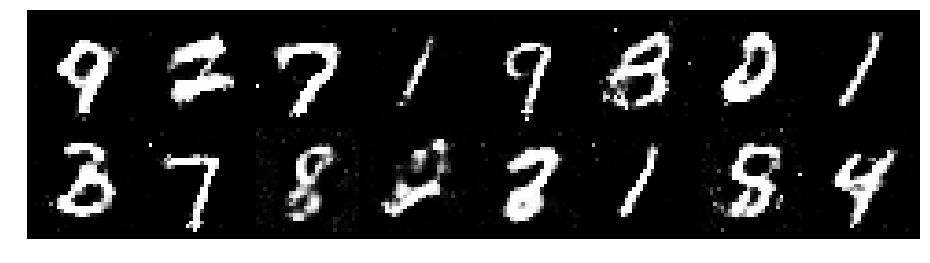

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.1206, Generator Loss: 1.1542
D(x): 0.5943, D(G(z)): 0.3667


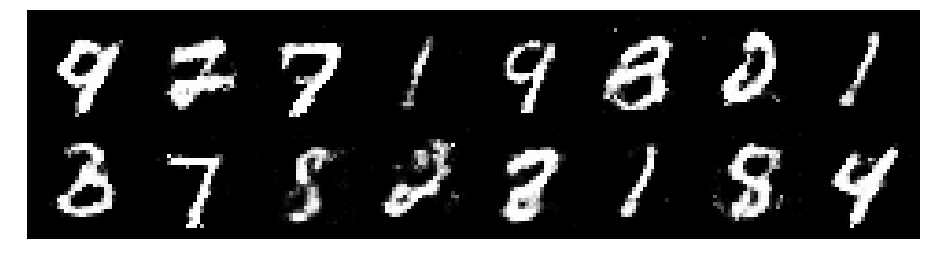

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.2576, Generator Loss: 0.8721
D(x): 0.5835, D(G(z)): 0.4630


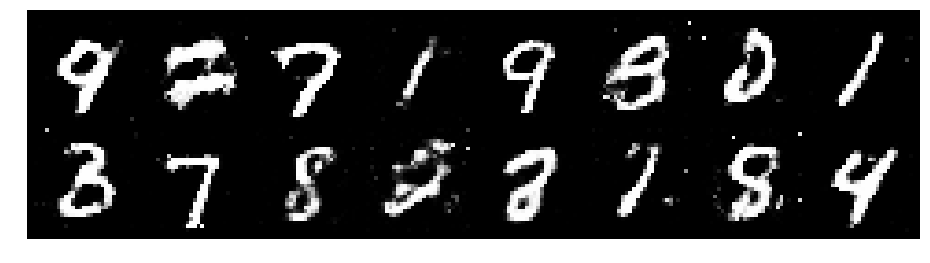

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.2846, Generator Loss: 1.0009
D(x): 0.5461, D(G(z)): 0.4132


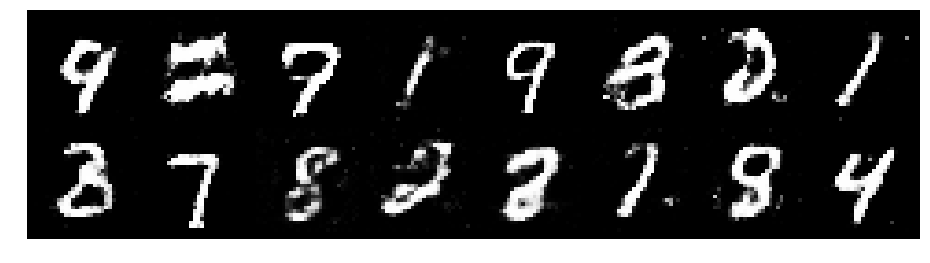

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.2960, Generator Loss: 0.9346
D(x): 0.5758, D(G(z)): 0.4617


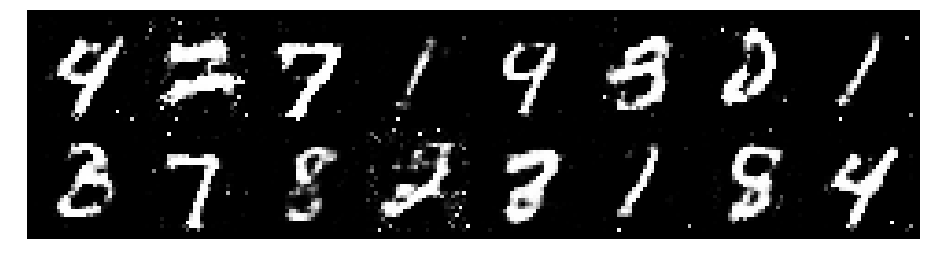

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.2988, Generator Loss: 0.8994
D(x): 0.5320, D(G(z)): 0.4314


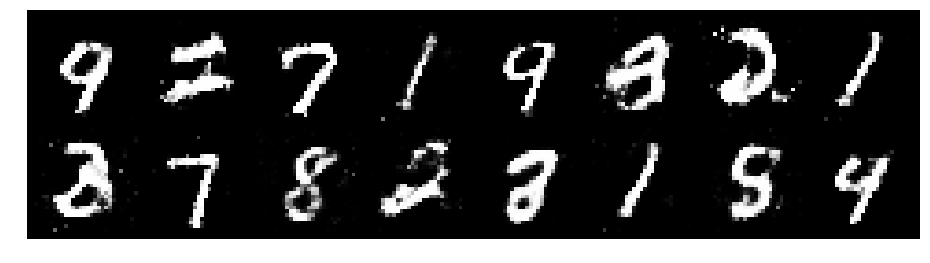

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.2426, Generator Loss: 0.8946
D(x): 0.5404, D(G(z)): 0.4331


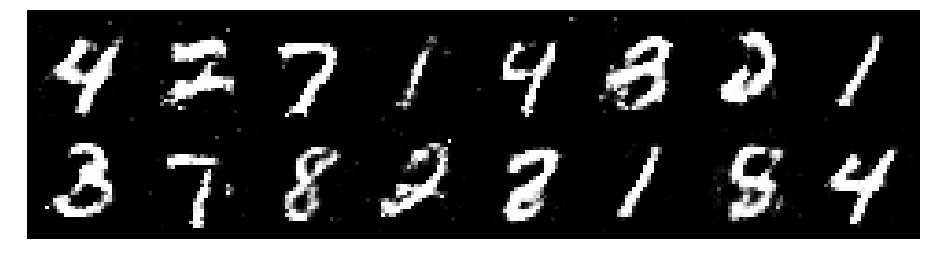

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.0877, Generator Loss: 1.1157
D(x): 0.5659, D(G(z)): 0.3539


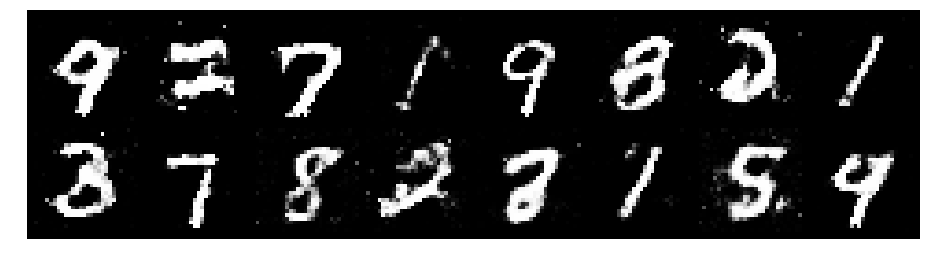

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.1848, Generator Loss: 0.9313
D(x): 0.5639, D(G(z)): 0.4004


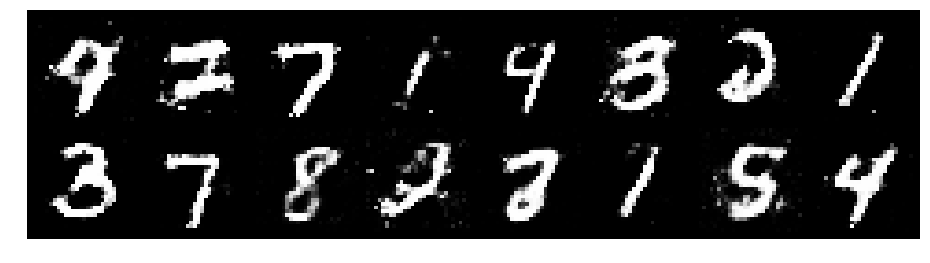

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.2212, Generator Loss: 0.7674
D(x): 0.5937, D(G(z)): 0.4639


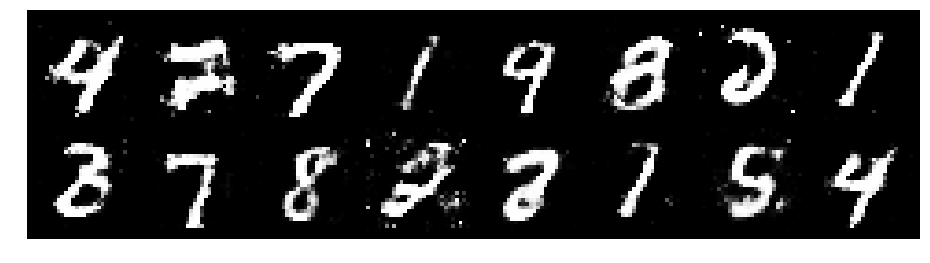

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.2189, Generator Loss: 0.8168
D(x): 0.5751, D(G(z)): 0.4477


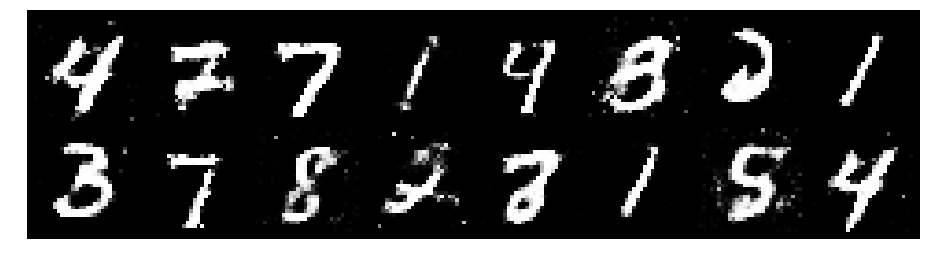

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.1199, Generator Loss: 0.9672
D(x): 0.6278, D(G(z)): 0.4244


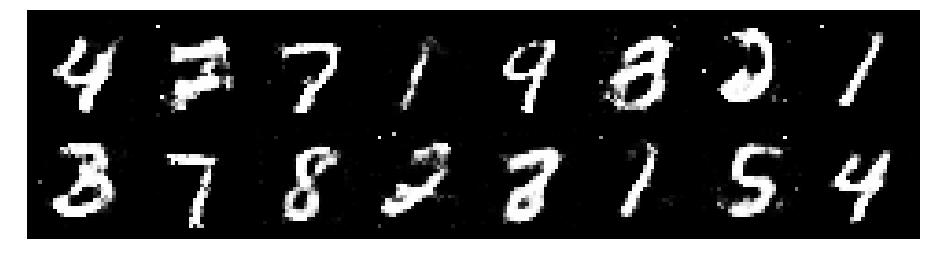

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.2458, Generator Loss: 1.0884
D(x): 0.5633, D(G(z)): 0.4108


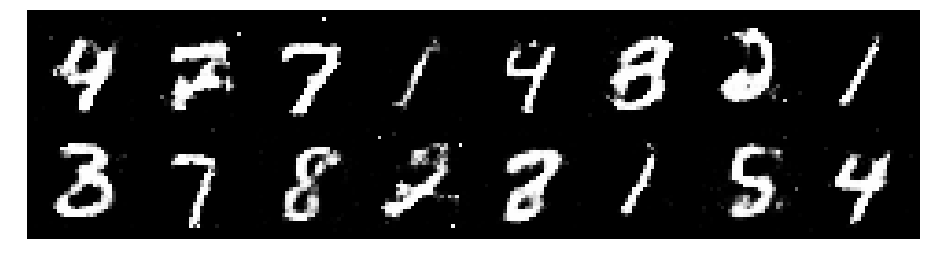

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.3285, Generator Loss: 0.9033
D(x): 0.5403, D(G(z)): 0.4576


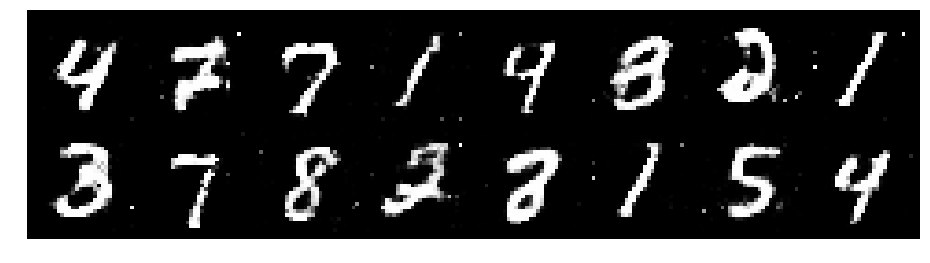

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.2355, Generator Loss: 0.8962
D(x): 0.5853, D(G(z)): 0.4552


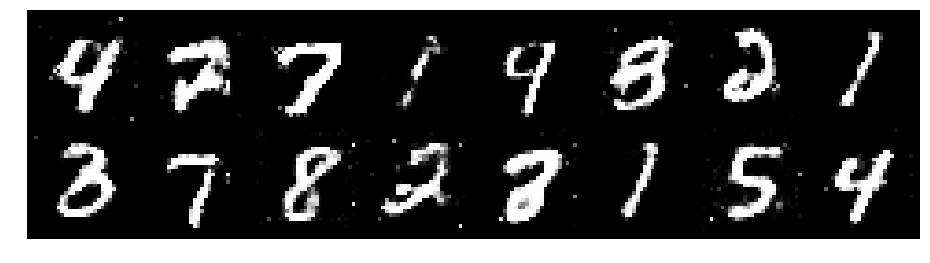

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.0922, Generator Loss: 1.1800
D(x): 0.5815, D(G(z)): 0.3700


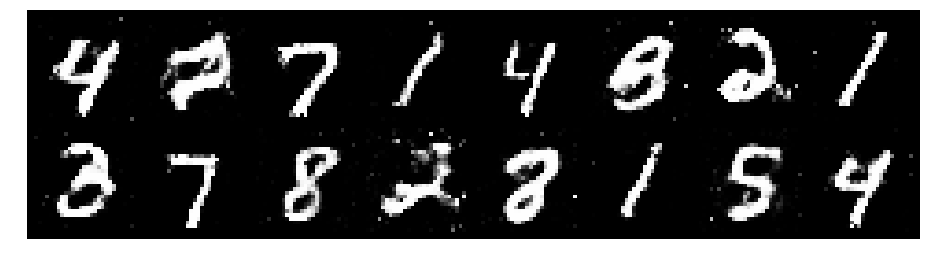

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.1446, Generator Loss: 1.2408
D(x): 0.6013, D(G(z)): 0.3903


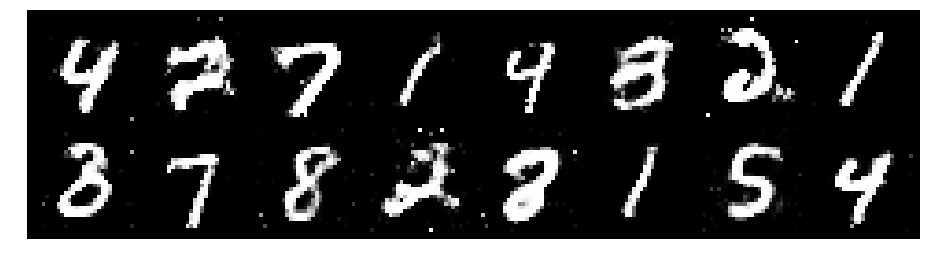

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.2646, Generator Loss: 1.0001
D(x): 0.5831, D(G(z)): 0.4279


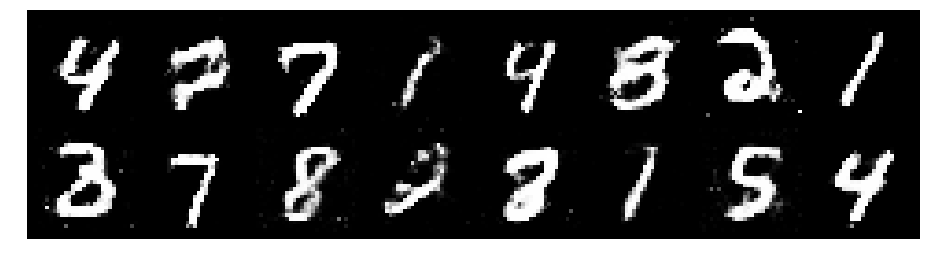

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.1319, Generator Loss: 1.0709
D(x): 0.5777, D(G(z)): 0.3617


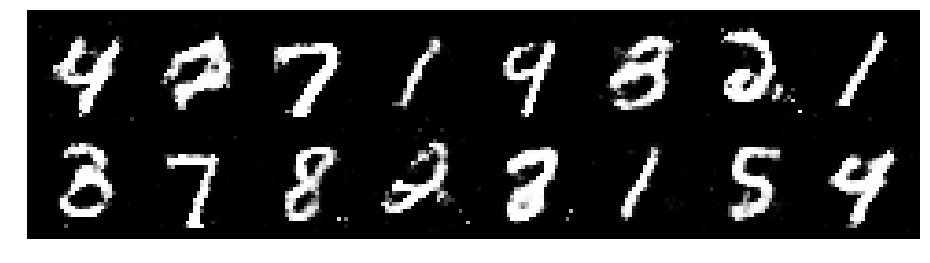

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.1537, Generator Loss: 1.0793
D(x): 0.5749, D(G(z)): 0.3721


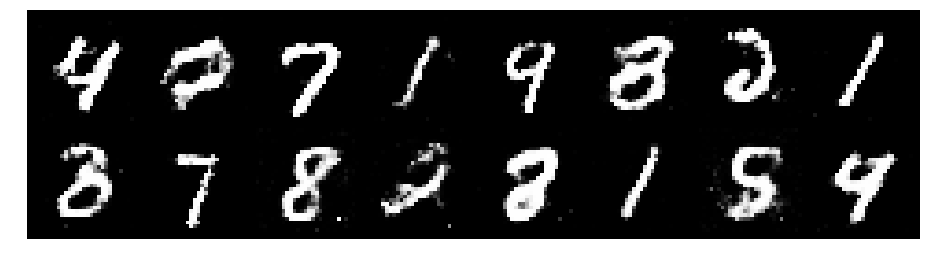

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.2164, Generator Loss: 0.9276
D(x): 0.5539, D(G(z)): 0.4024


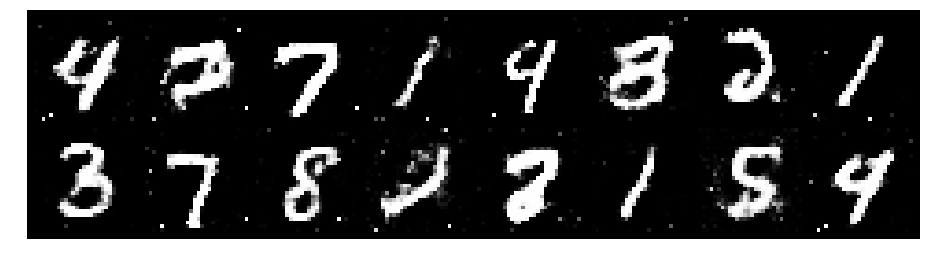

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.1638, Generator Loss: 0.9574
D(x): 0.5873, D(G(z)): 0.4259


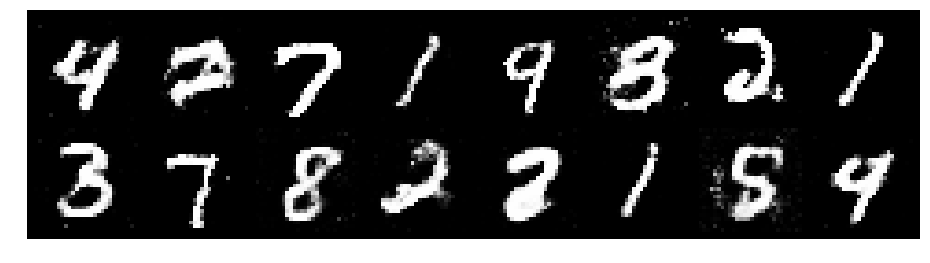

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.3326, Generator Loss: 1.0468
D(x): 0.5270, D(G(z)): 0.4077


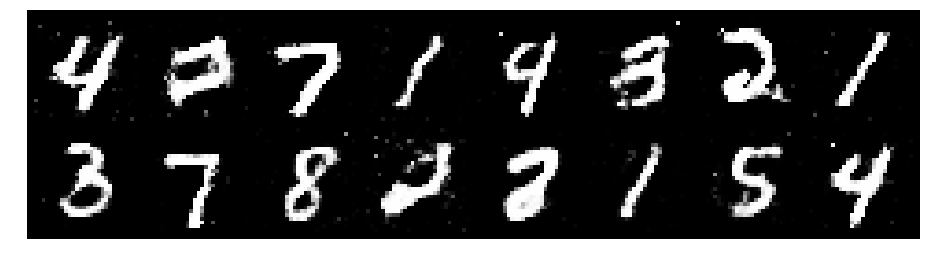

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.2638, Generator Loss: 0.9119
D(x): 0.5526, D(G(z)): 0.4469


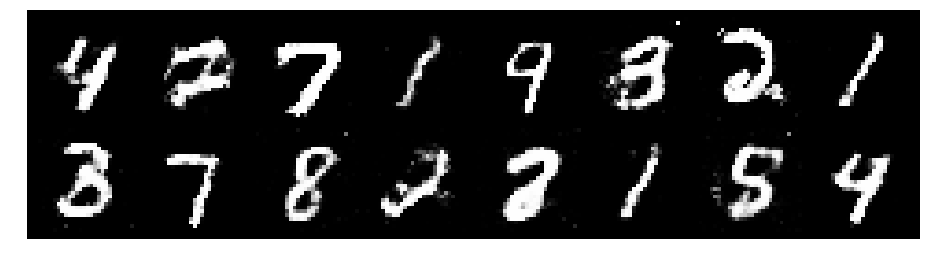

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.0009, Generator Loss: 1.3654
D(x): 0.6007, D(G(z)): 0.3101


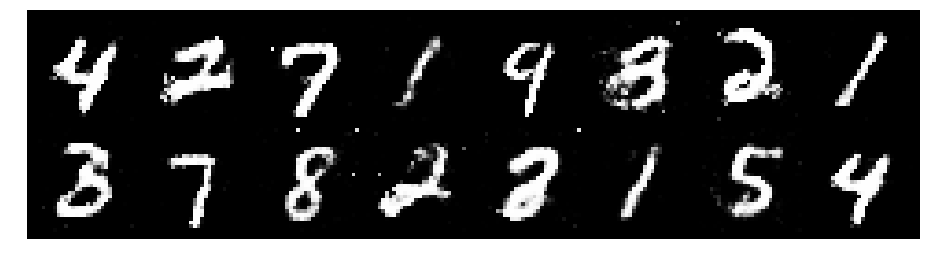

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.0731, Generator Loss: 1.2818
D(x): 0.6114, D(G(z)): 0.3617


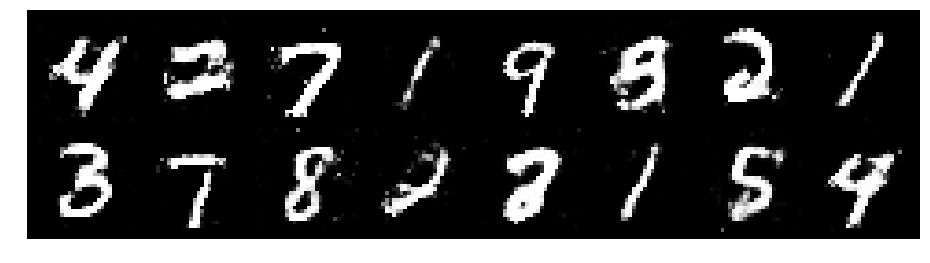

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.2404, Generator Loss: 0.9409
D(x): 0.6387, D(G(z)): 0.4747


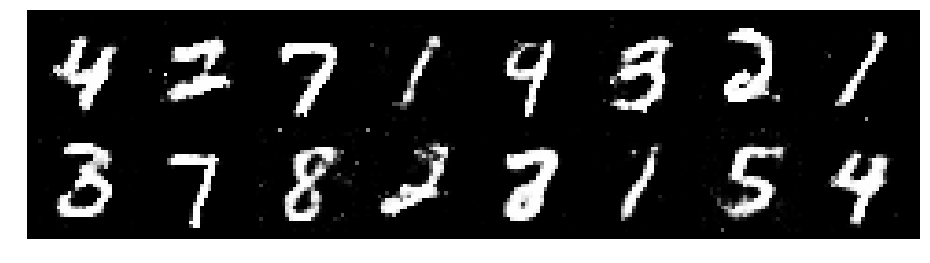

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.2165, Generator Loss: 0.9607
D(x): 0.6104, D(G(z)): 0.4627


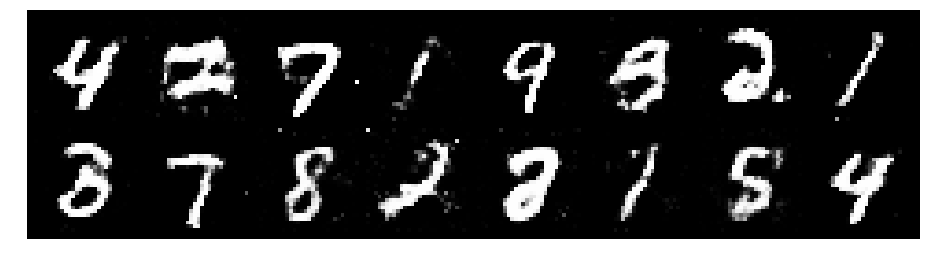

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.3129, Generator Loss: 0.8291
D(x): 0.5946, D(G(z)): 0.4760


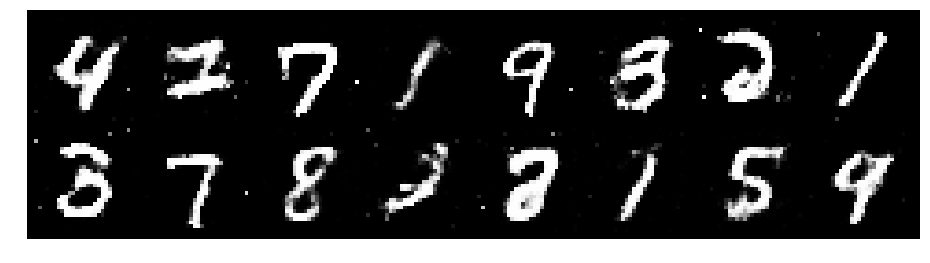

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.2007, Generator Loss: 1.1157
D(x): 0.5607, D(G(z)): 0.3732


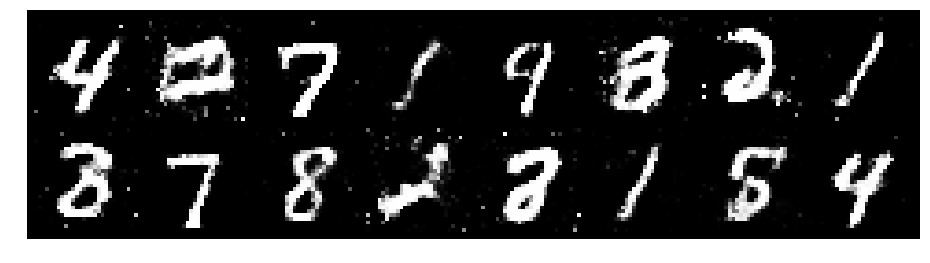

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.2624, Generator Loss: 0.9578
D(x): 0.5425, D(G(z)): 0.4102


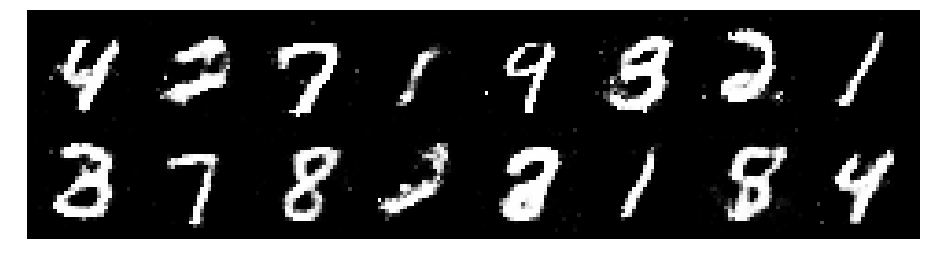

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.1622, Generator Loss: 1.0714
D(x): 0.5486, D(G(z)): 0.3962


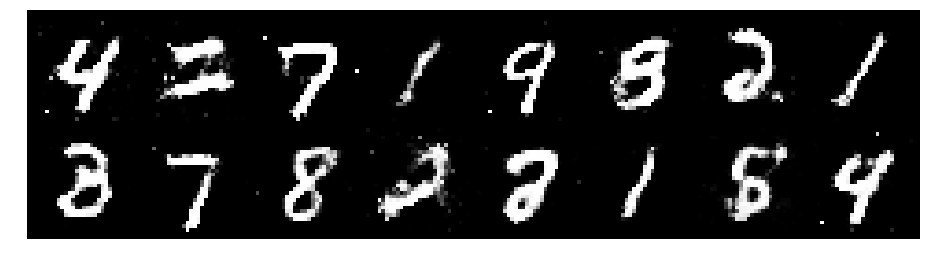

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.2767, Generator Loss: 0.9661
D(x): 0.5883, D(G(z)): 0.4577


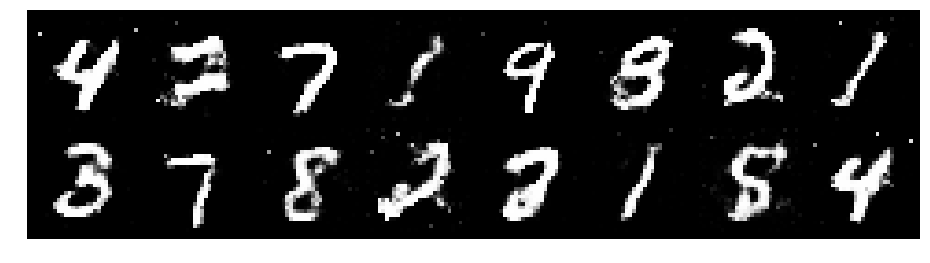

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.2552, Generator Loss: 1.2761
D(x): 0.5325, D(G(z)): 0.3837


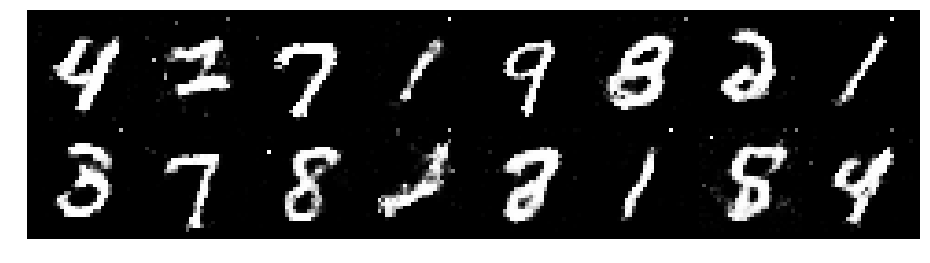

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.2077, Generator Loss: 1.0496
D(x): 0.5563, D(G(z)): 0.4058


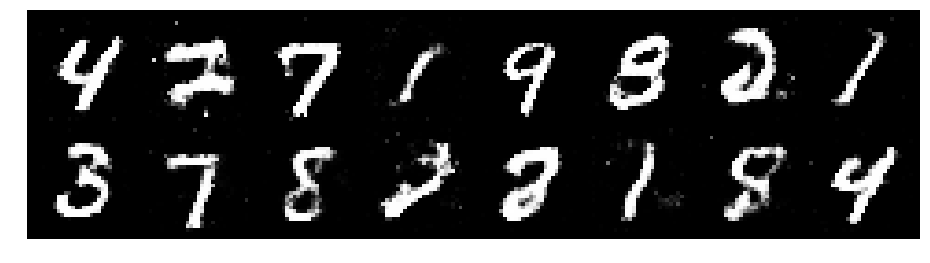

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.1913, Generator Loss: 0.8629
D(x): 0.5854, D(G(z)): 0.4342


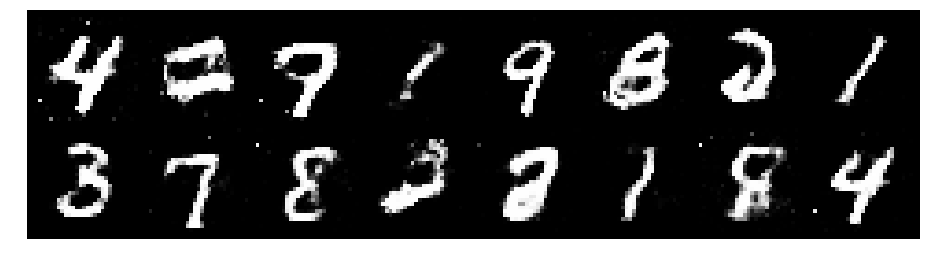

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.3025, Generator Loss: 0.9391
D(x): 0.5537, D(G(z)): 0.4372


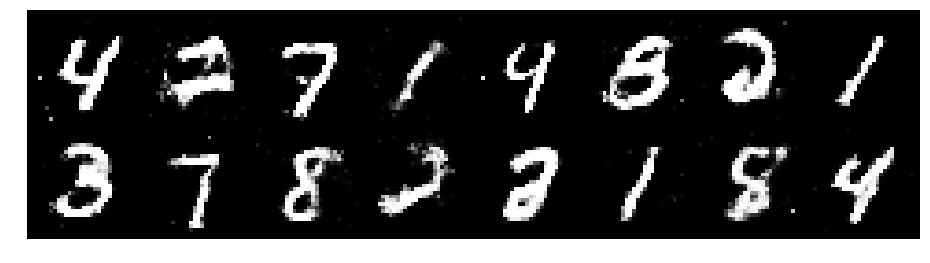

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.2218, Generator Loss: 0.8548
D(x): 0.5934, D(G(z)): 0.4616


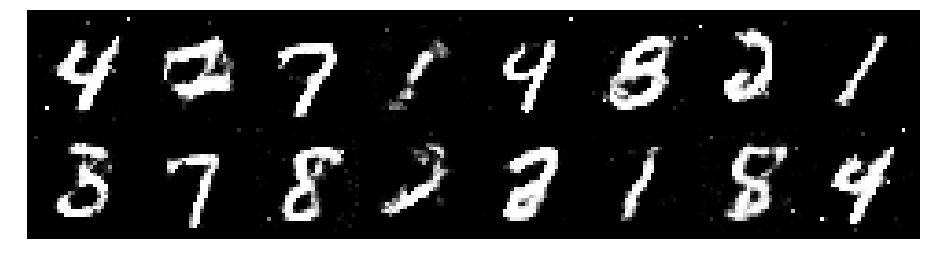

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.1191, Generator Loss: 1.2162
D(x): 0.6154, D(G(z)): 0.4020


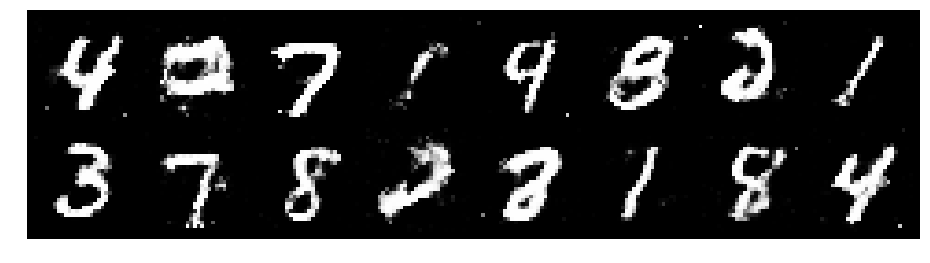

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.1470, Generator Loss: 1.0355
D(x): 0.6264, D(G(z)): 0.4226


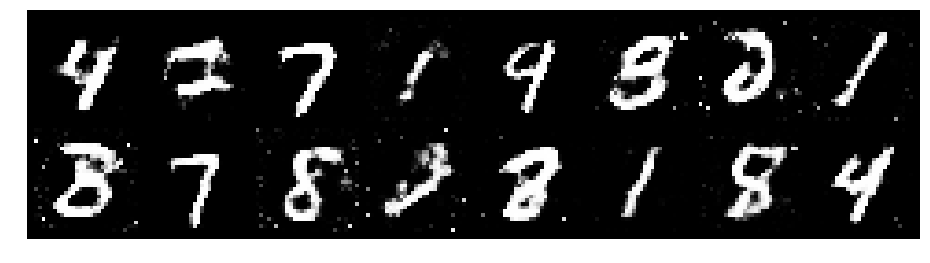

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.2539, Generator Loss: 0.8700
D(x): 0.5385, D(G(z)): 0.4234


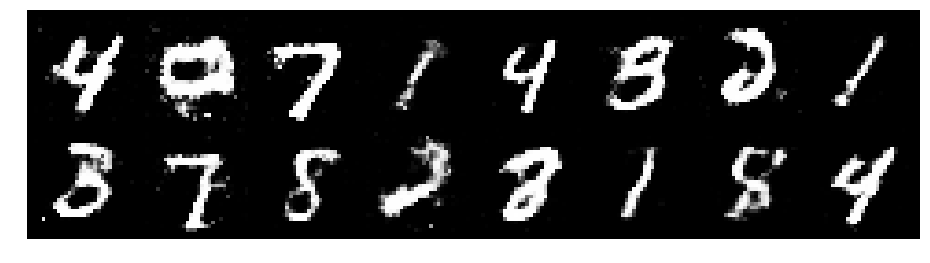

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.2682, Generator Loss: 0.9069
D(x): 0.5498, D(G(z)): 0.4416


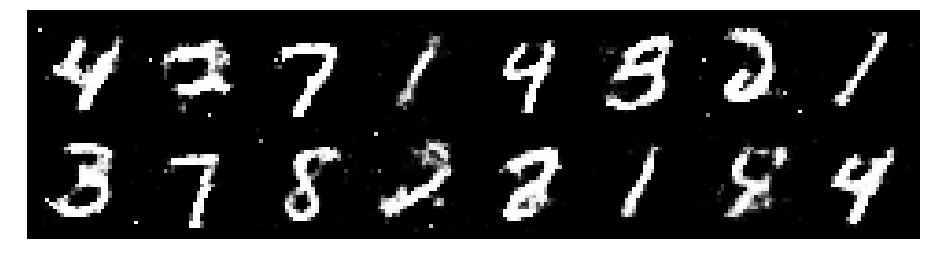

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.3165, Generator Loss: 0.8048
D(x): 0.5478, D(G(z)): 0.4707


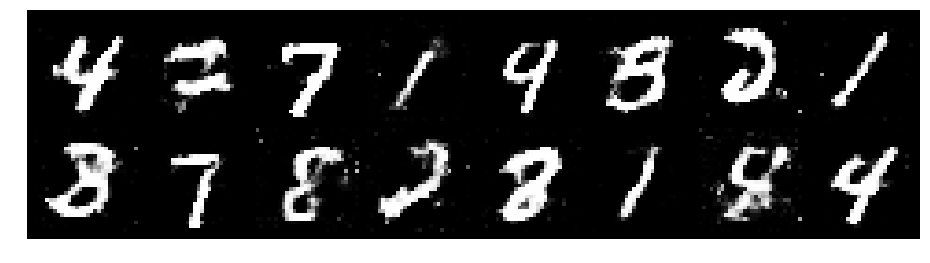

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.3236, Generator Loss: 0.8809
D(x): 0.5218, D(G(z)): 0.4336


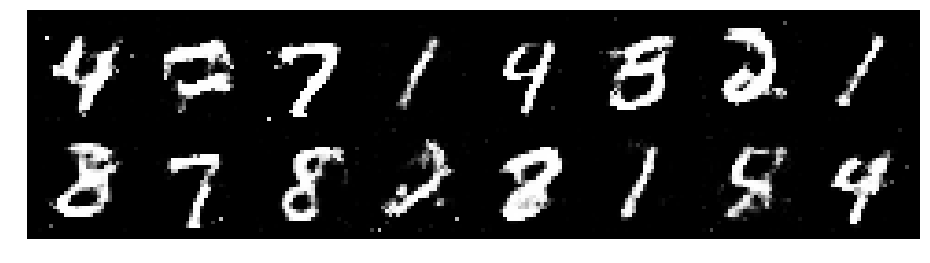

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.1421, Generator Loss: 0.9041
D(x): 0.5951, D(G(z)): 0.4391


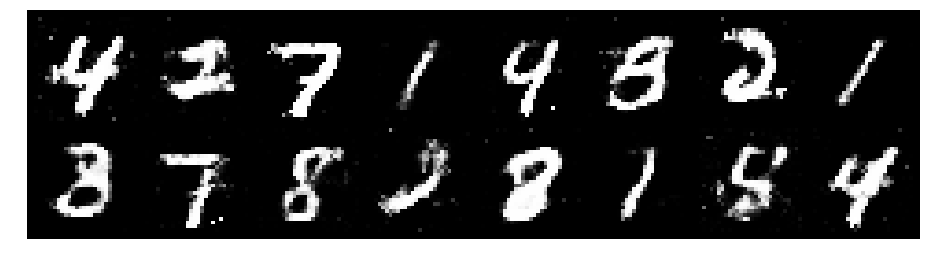

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.2782, Generator Loss: 1.0112
D(x): 0.5620, D(G(z)): 0.4346


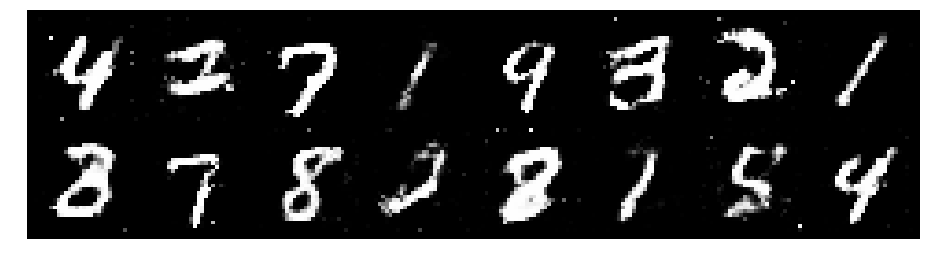

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.3009, Generator Loss: 1.0982
D(x): 0.5398, D(G(z)): 0.4185


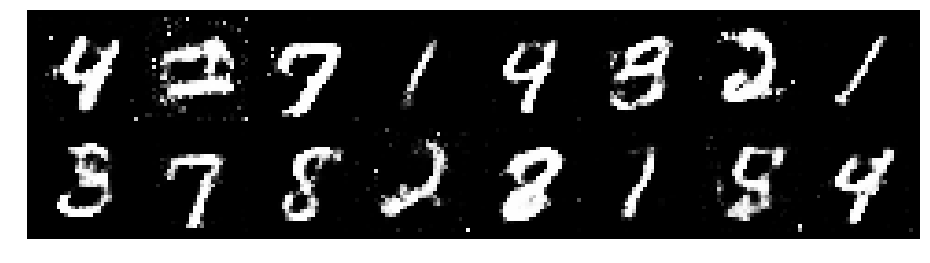

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.2526, Generator Loss: 0.8652
D(x): 0.5365, D(G(z)): 0.4034


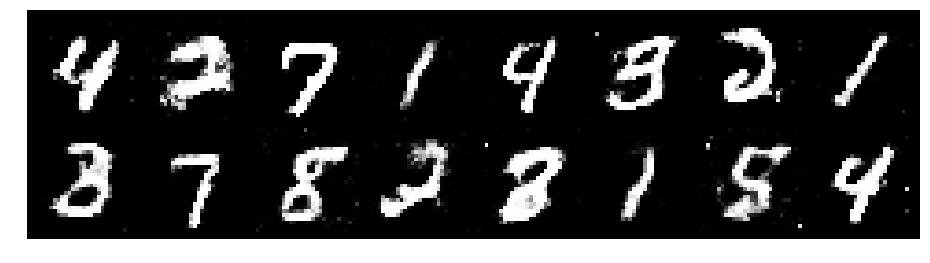

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.1925, Generator Loss: 0.9206
D(x): 0.5801, D(G(z)): 0.4079


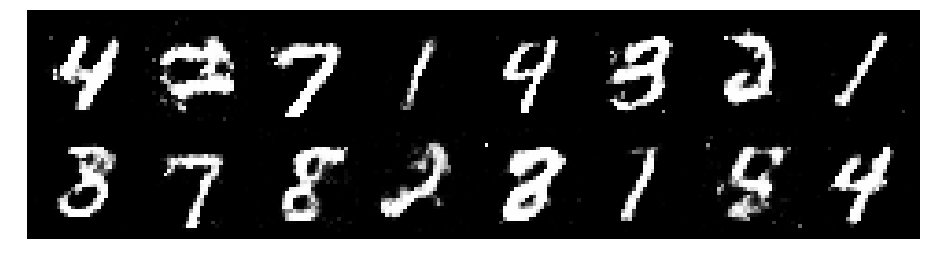

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.1614, Generator Loss: 1.0284
D(x): 0.5805, D(G(z)): 0.4008


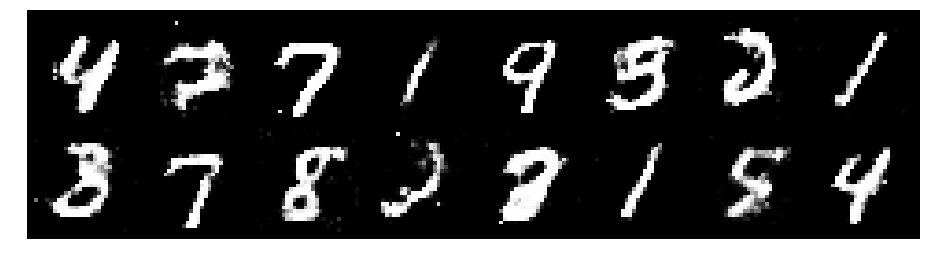

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.1813, Generator Loss: 0.9067
D(x): 0.6047, D(G(z)): 0.4490


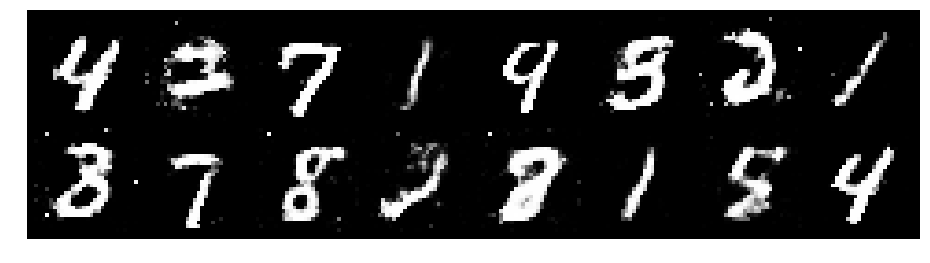

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.2343, Generator Loss: 0.8312
D(x): 0.6065, D(G(z)): 0.4580


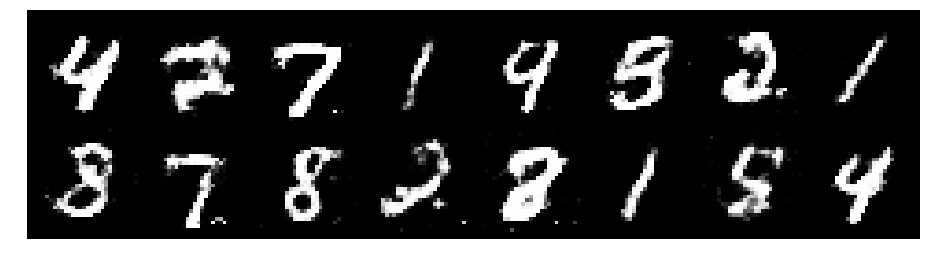

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.3346, Generator Loss: 0.8195
D(x): 0.5730, D(G(z)): 0.4769


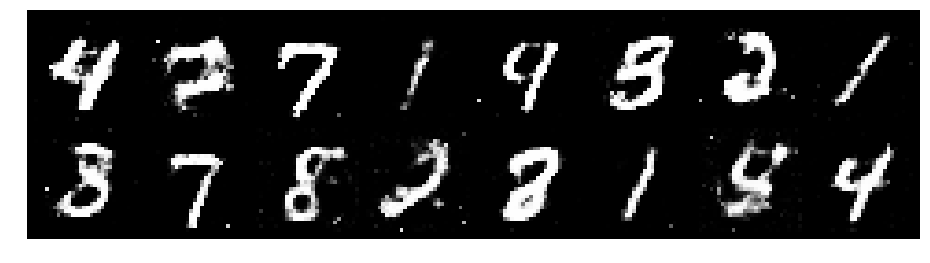

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.2445, Generator Loss: 0.9142
D(x): 0.5933, D(G(z)): 0.4243


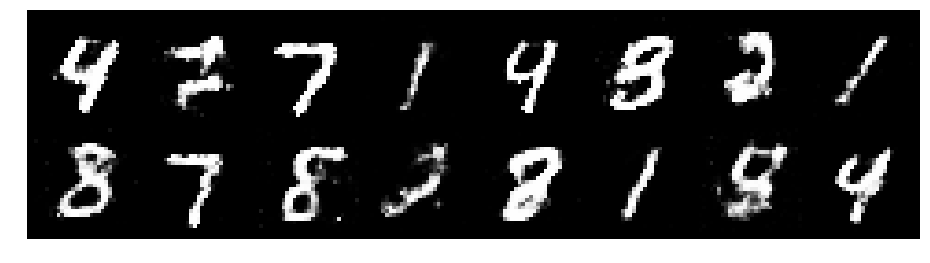

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.2526, Generator Loss: 0.9431
D(x): 0.5677, D(G(z)): 0.4470


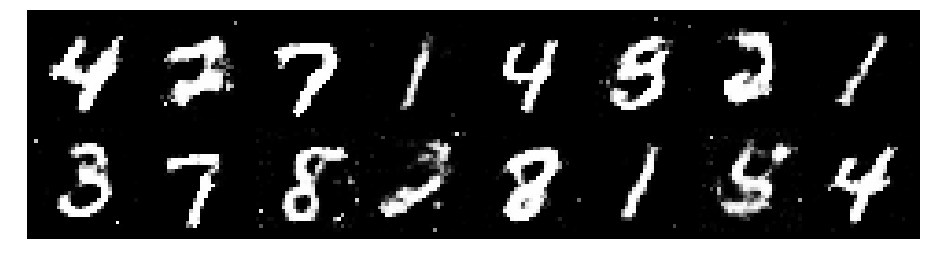

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.2814, Generator Loss: 0.9142
D(x): 0.5734, D(G(z)): 0.4549


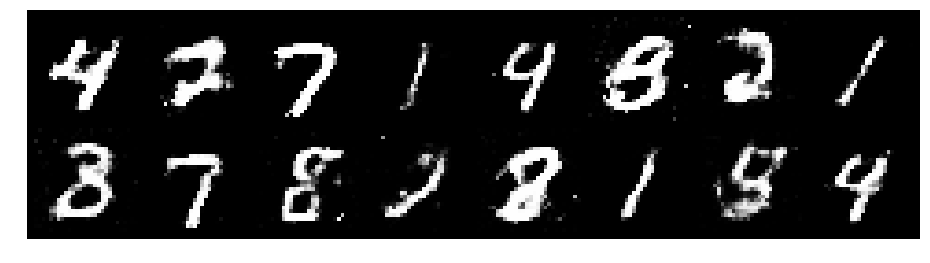

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.2521, Generator Loss: 0.9898
D(x): 0.5517, D(G(z)): 0.4340


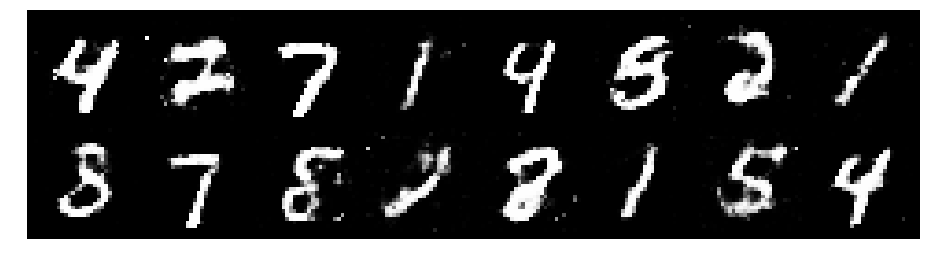

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.1114, Generator Loss: 1.0241
D(x): 0.6281, D(G(z)): 0.4105


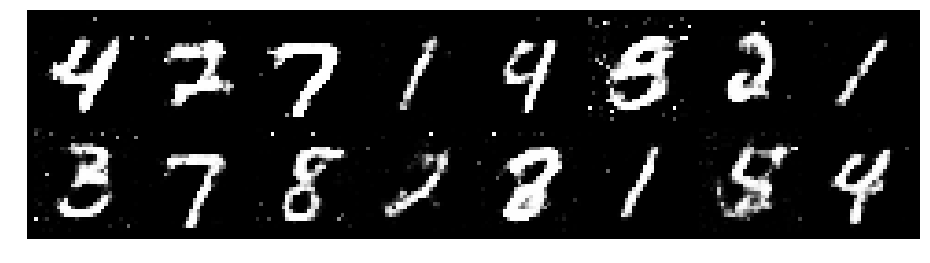

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.3293, Generator Loss: 0.8941
D(x): 0.5571, D(G(z)): 0.4548


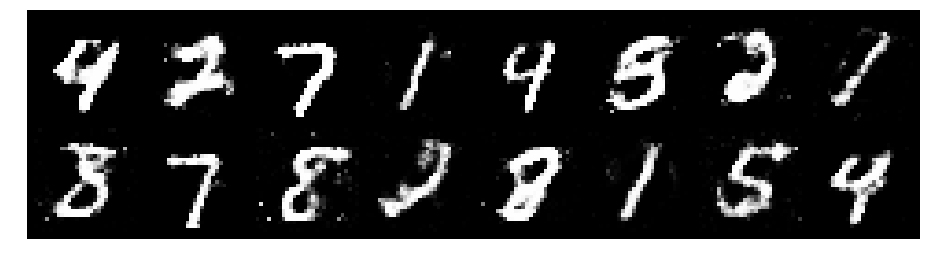

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.1969, Generator Loss: 0.8402
D(x): 0.5672, D(G(z)): 0.4395


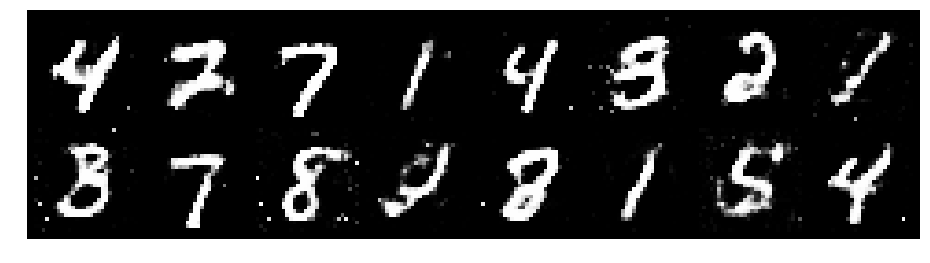

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.2381, Generator Loss: 0.7893
D(x): 0.5921, D(G(z)): 0.4561


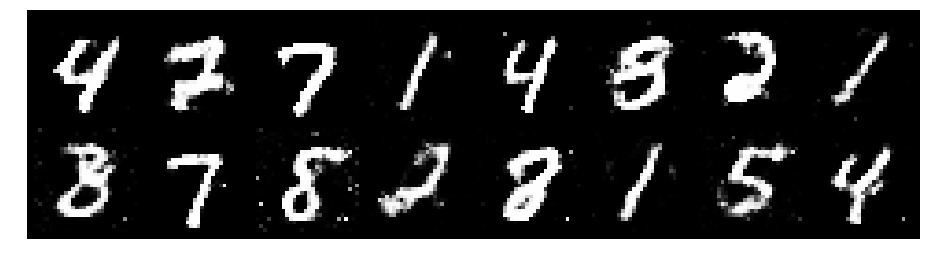

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.2402, Generator Loss: 1.0356
D(x): 0.5513, D(G(z)): 0.4098


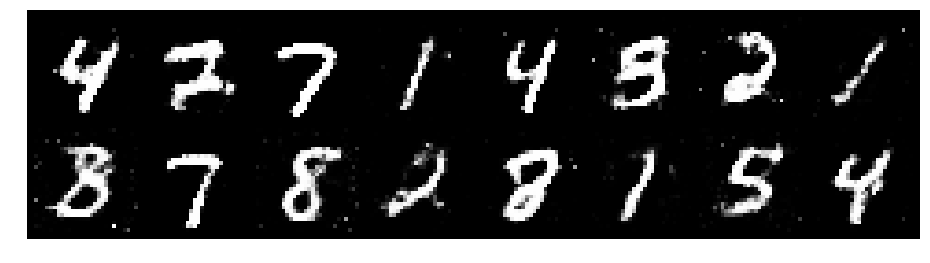

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.2916, Generator Loss: 1.2118
D(x): 0.5586, D(G(z)): 0.4351


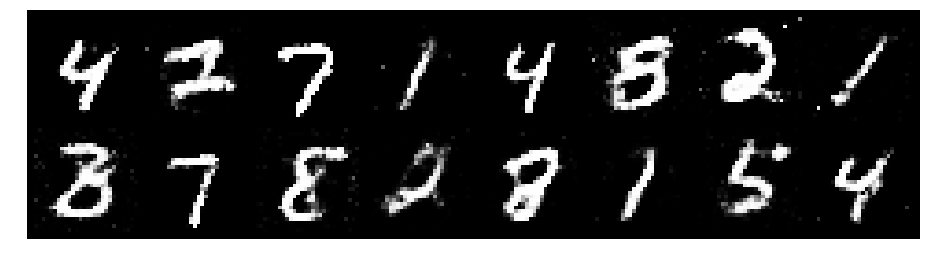

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.1738, Generator Loss: 0.9574
D(x): 0.5954, D(G(z)): 0.4378


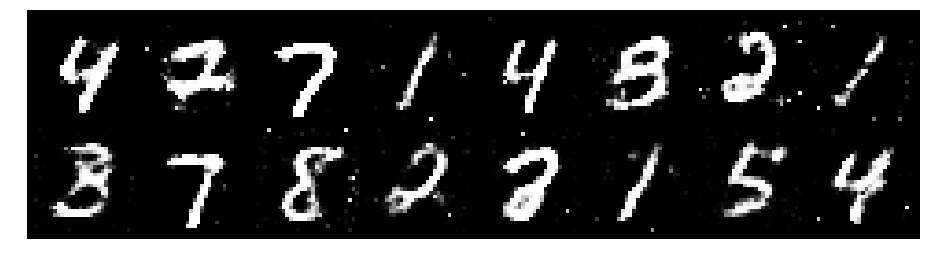

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.2225, Generator Loss: 0.9148
D(x): 0.5362, D(G(z)): 0.3969


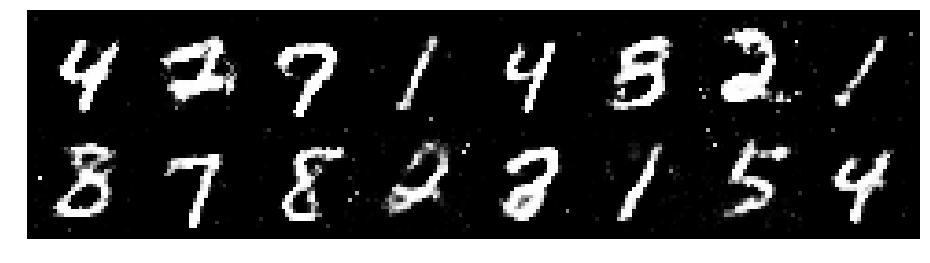

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.3799, Generator Loss: 1.0436
D(x): 0.5492, D(G(z)): 0.4488


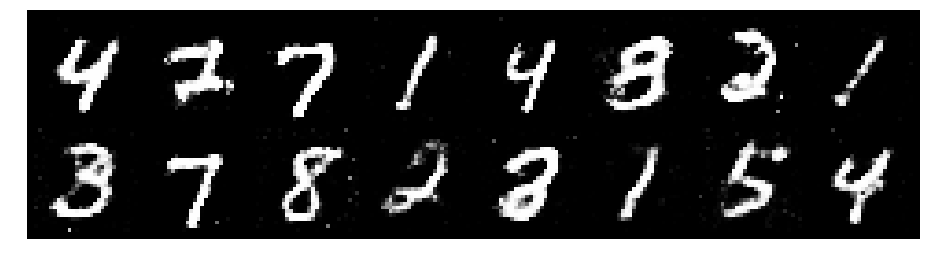

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.2431, Generator Loss: 0.8955
D(x): 0.5836, D(G(z)): 0.4362


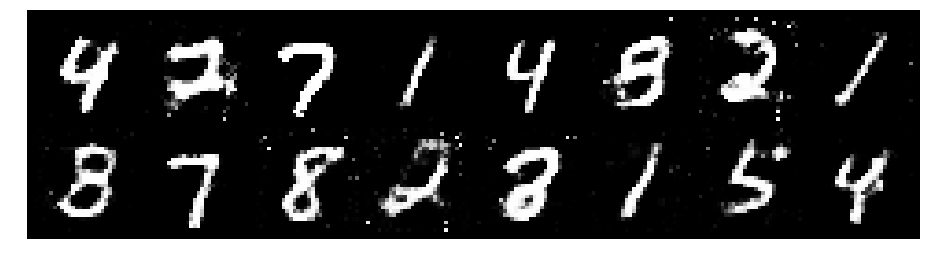

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.4021, Generator Loss: 1.0394
D(x): 0.5675, D(G(z)): 0.4617


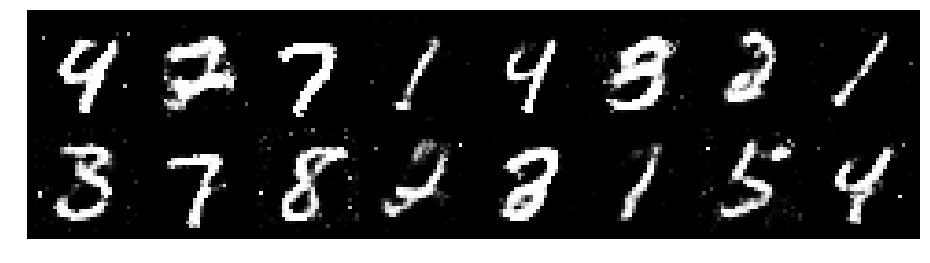

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.1204, Generator Loss: 0.9513
D(x): 0.6190, D(G(z)): 0.4307


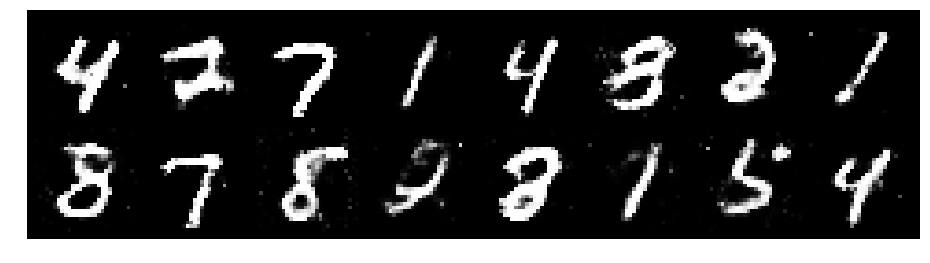

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.2451, Generator Loss: 0.9462
D(x): 0.5665, D(G(z)): 0.4383


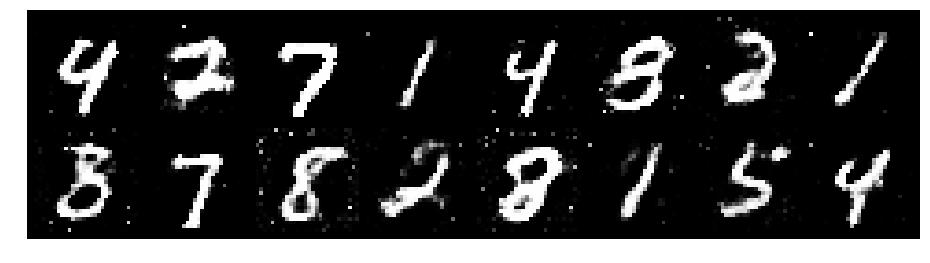

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.2903, Generator Loss: 0.7787
D(x): 0.5622, D(G(z)): 0.4759


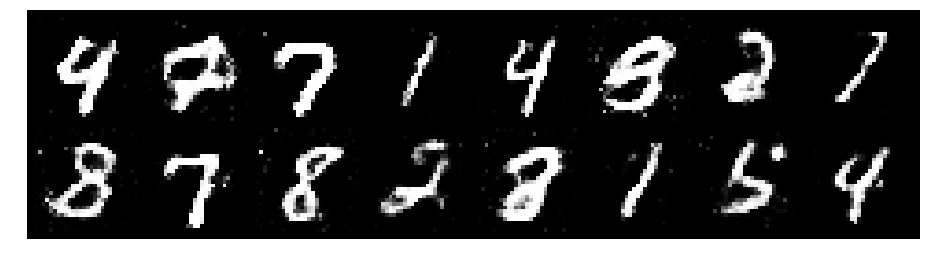

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.3239, Generator Loss: 0.8113
D(x): 0.5579, D(G(z)): 0.4763


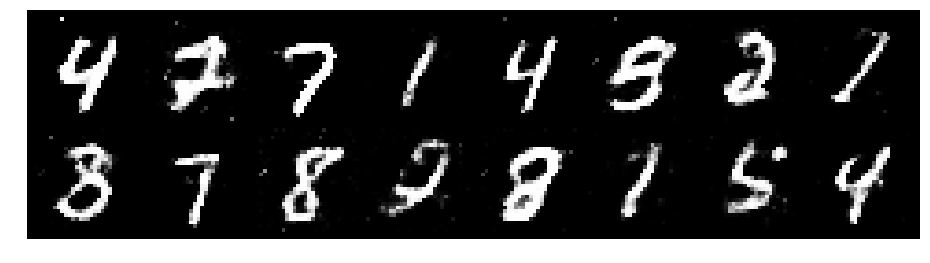

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.3188, Generator Loss: 0.7589
D(x): 0.5623, D(G(z)): 0.4622


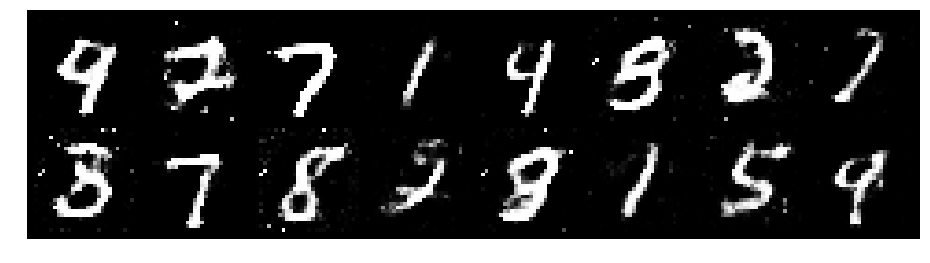

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.2376, Generator Loss: 0.8466
D(x): 0.5772, D(G(z)): 0.4423


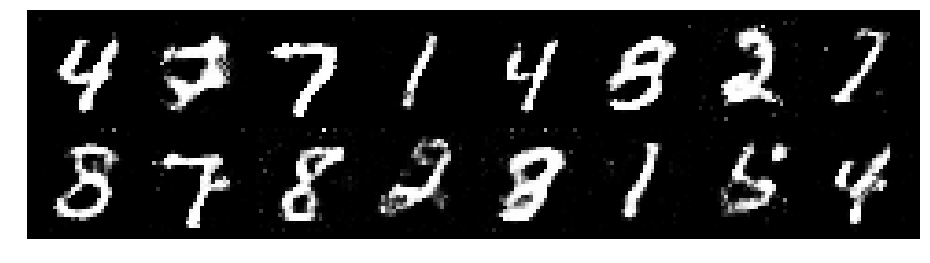

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.2080, Generator Loss: 1.0128
D(x): 0.5517, D(G(z)): 0.3785


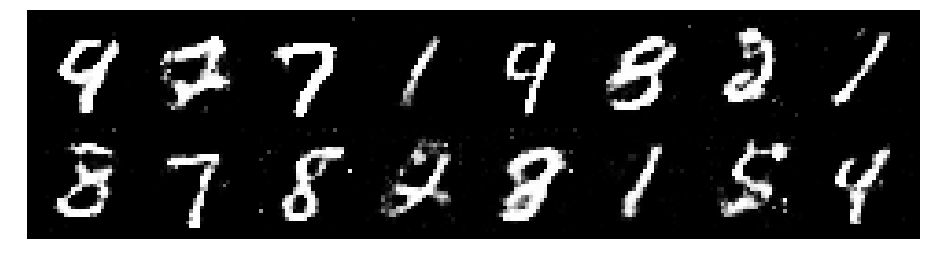

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.1484, Generator Loss: 1.0647
D(x): 0.5793, D(G(z)): 0.3901


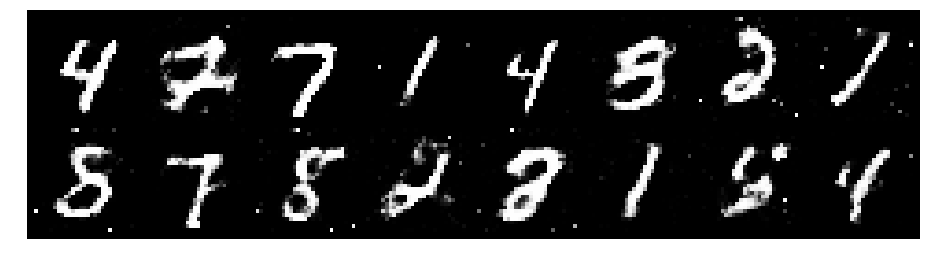

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.1237, Generator Loss: 0.9812
D(x): 0.6313, D(G(z)): 0.4158


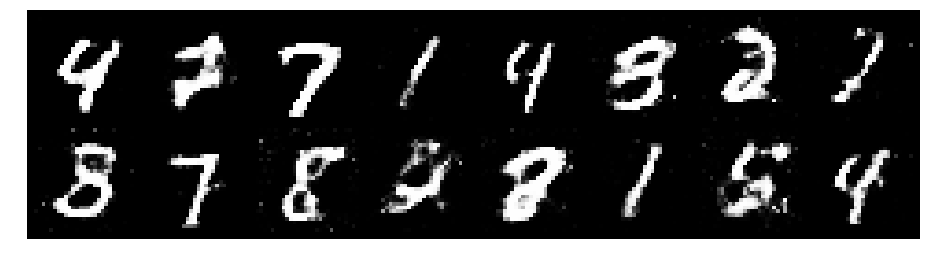

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.1306, Generator Loss: 0.9353
D(x): 0.5973, D(G(z)): 0.4109


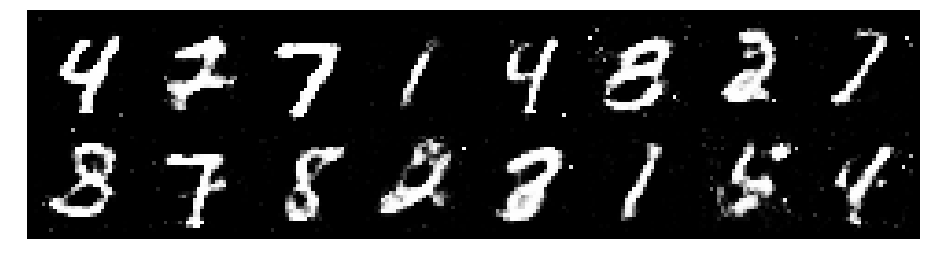

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.2628, Generator Loss: 0.9064
D(x): 0.5233, D(G(z)): 0.4205


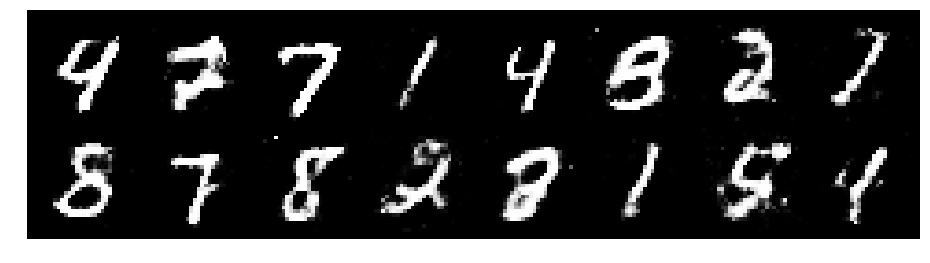

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.1429, Generator Loss: 1.1062
D(x): 0.5677, D(G(z)): 0.3760


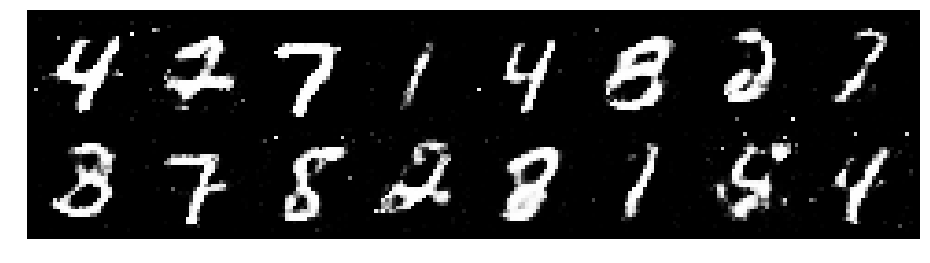

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.3412, Generator Loss: 1.0650
D(x): 0.5409, D(G(z)): 0.4404


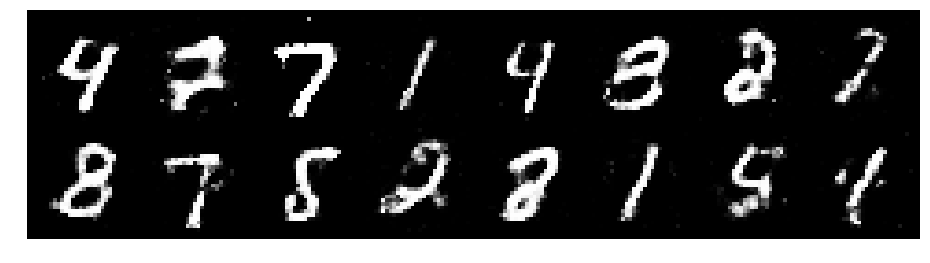

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.2170, Generator Loss: 0.8531
D(x): 0.5755, D(G(z)): 0.4578


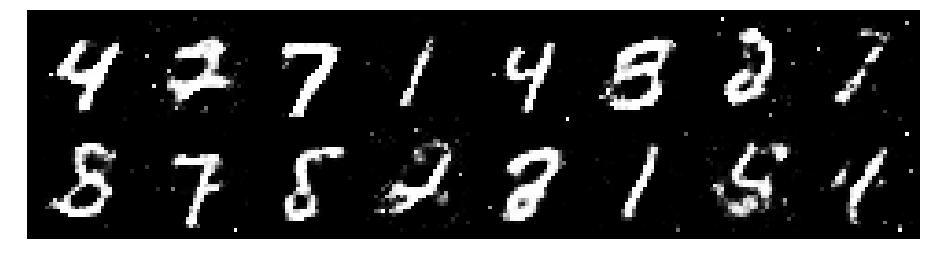

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.2587, Generator Loss: 0.9054
D(x): 0.5561, D(G(z)): 0.4575


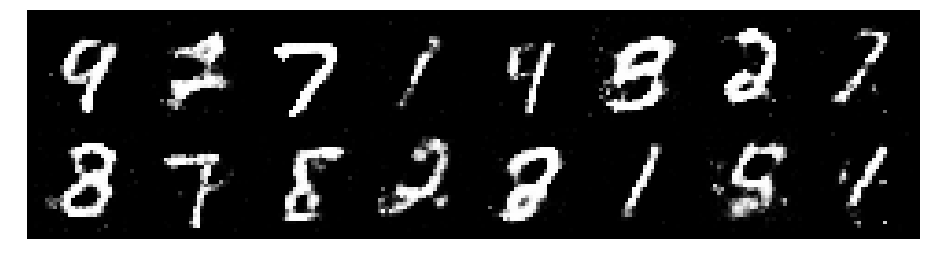

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.1698, Generator Loss: 1.1602
D(x): 0.5862, D(G(z)): 0.3883


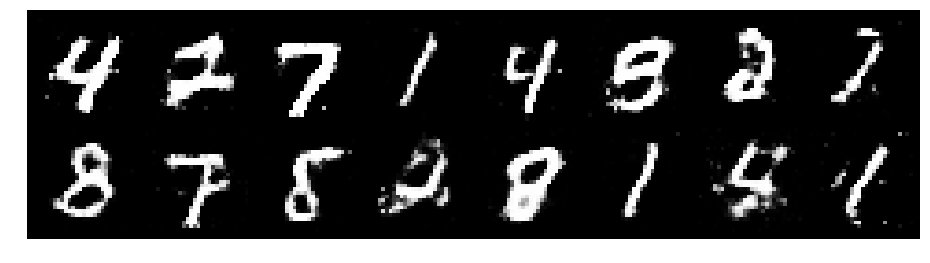

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.2103, Generator Loss: 0.9211
D(x): 0.5468, D(G(z)): 0.4209


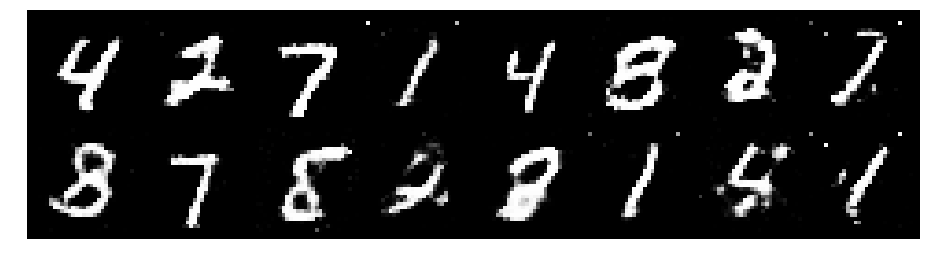

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.2801, Generator Loss: 0.8951
D(x): 0.5793, D(G(z)): 0.4652


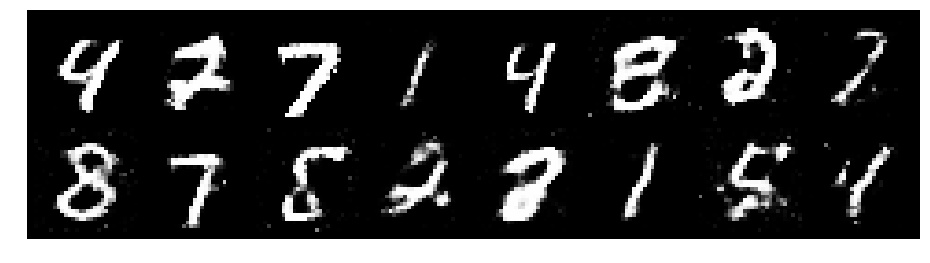

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.3409, Generator Loss: 0.7771
D(x): 0.5489, D(G(z)): 0.4836


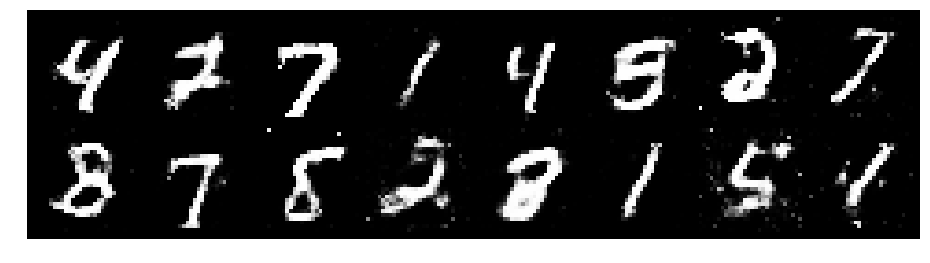

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.1887, Generator Loss: 1.0186
D(x): 0.5615, D(G(z)): 0.3974


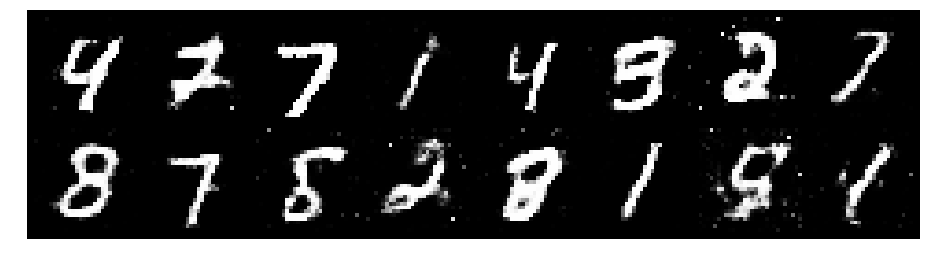

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.3082, Generator Loss: 0.9642
D(x): 0.5164, D(G(z)): 0.4025


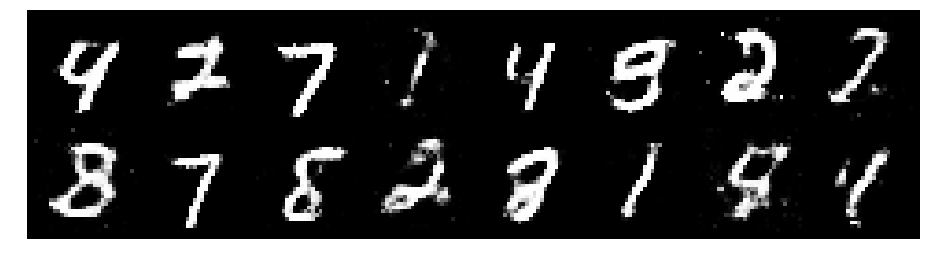

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.1966, Generator Loss: 1.0728
D(x): 0.6503, D(G(z)): 0.4725


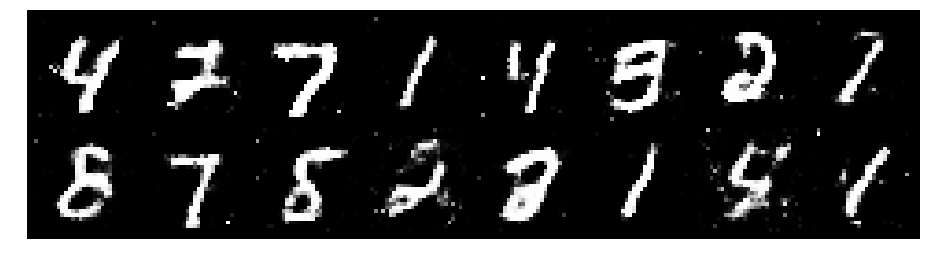

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.1474, Generator Loss: 0.9216
D(x): 0.5661, D(G(z)): 0.3896


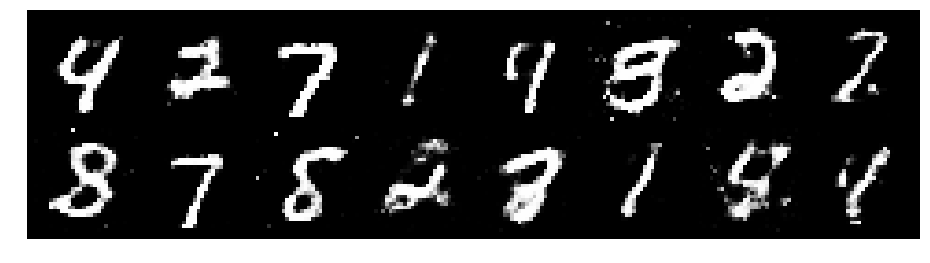

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.2169, Generator Loss: 0.9965
D(x): 0.5637, D(G(z)): 0.4003


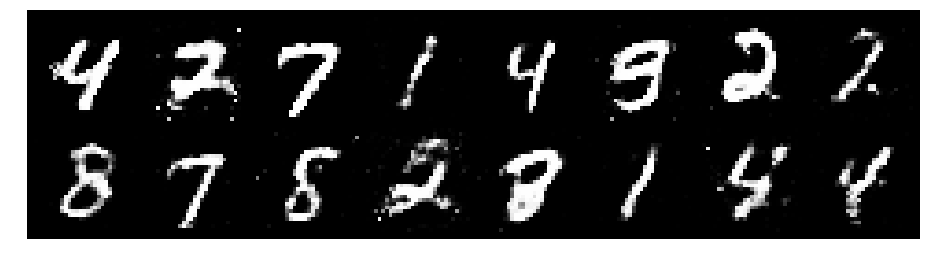

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.2673, Generator Loss: 0.9687
D(x): 0.5556, D(G(z)): 0.4387


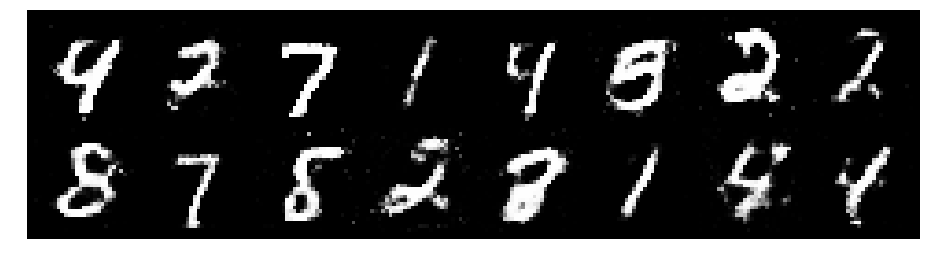

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.2636, Generator Loss: 1.0234
D(x): 0.5159, D(G(z)): 0.3998


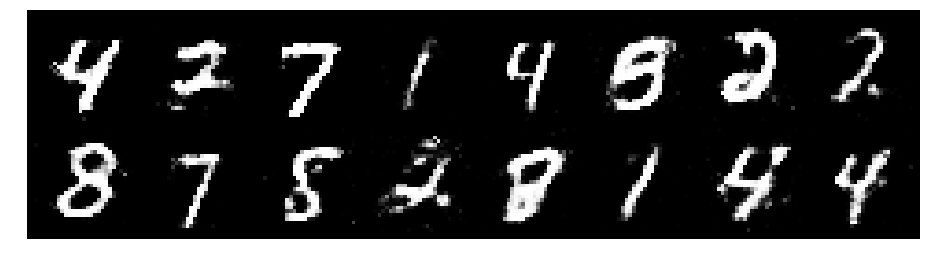

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.1760, Generator Loss: 1.1150
D(x): 0.5750, D(G(z)): 0.3922


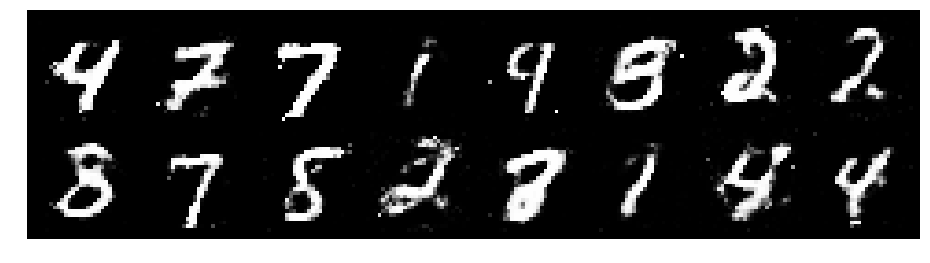

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.2726, Generator Loss: 0.9125
D(x): 0.6106, D(G(z)): 0.4648


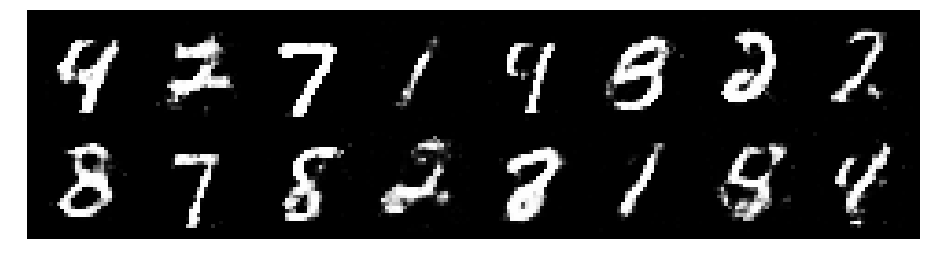

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.2817, Generator Loss: 1.2463
D(x): 0.6308, D(G(z)): 0.4485


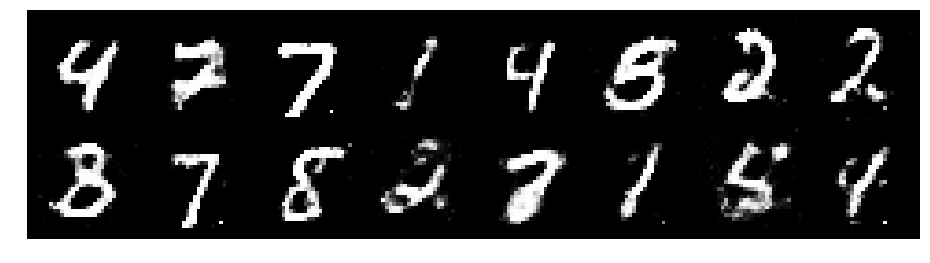

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.1616, Generator Loss: 1.0541
D(x): 0.5767, D(G(z)): 0.3904


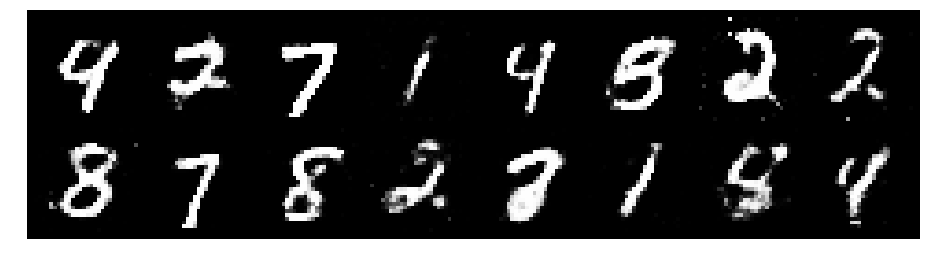

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.2097, Generator Loss: 1.0009
D(x): 0.5629, D(G(z)): 0.4089


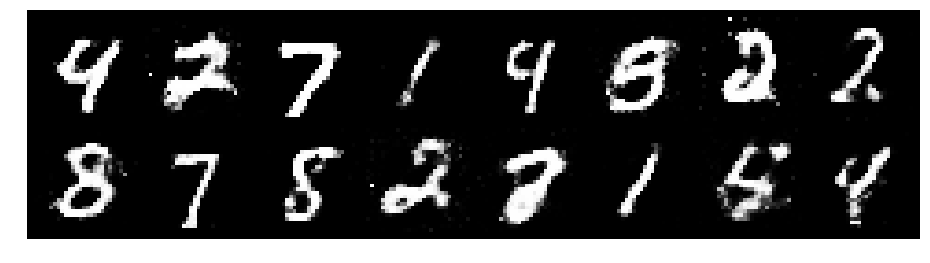

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.2559, Generator Loss: 0.9989
D(x): 0.5483, D(G(z)): 0.4272


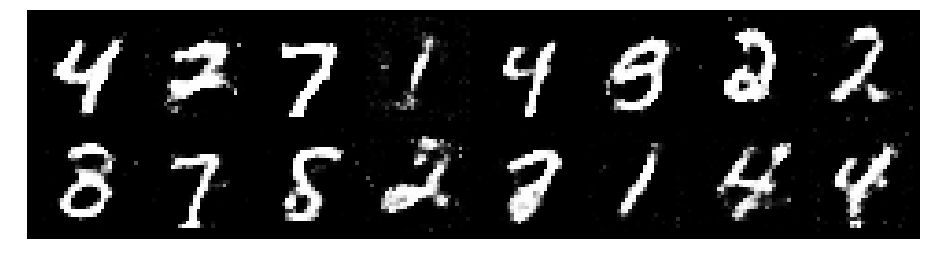

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.2443, Generator Loss: 0.9447
D(x): 0.5326, D(G(z)): 0.4178


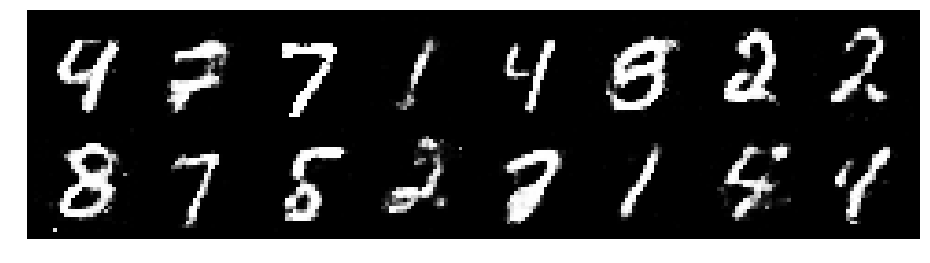

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.1740, Generator Loss: 0.8542
D(x): 0.6011, D(G(z)): 0.4335


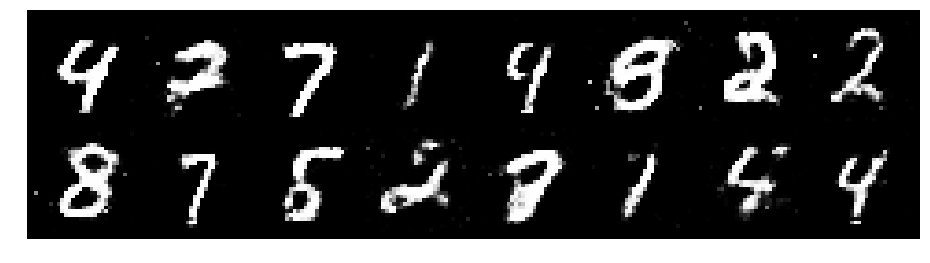

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.2829, Generator Loss: 0.8263
D(x): 0.5650, D(G(z)): 0.4519


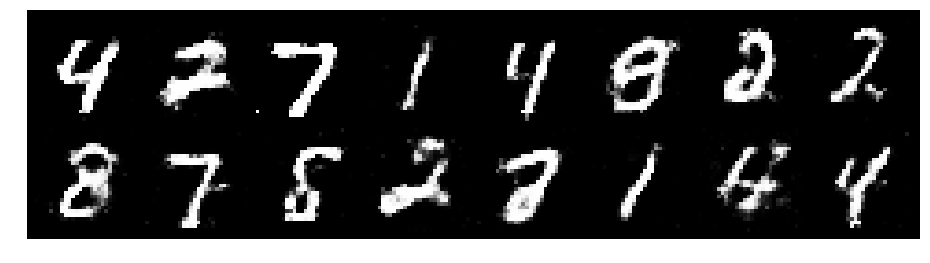

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.2000, Generator Loss: 0.9680
D(x): 0.5525, D(G(z)): 0.4031


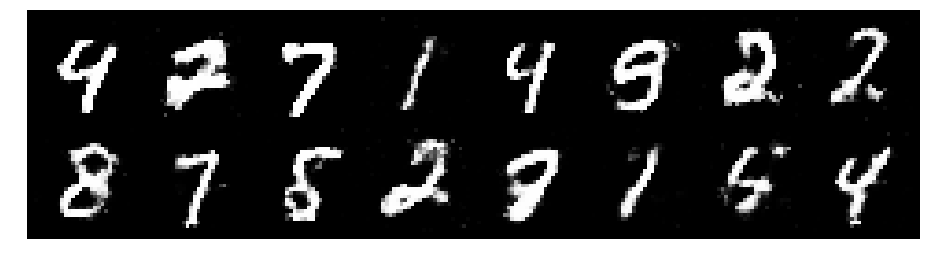

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.2598, Generator Loss: 0.8625
D(x): 0.5386, D(G(z)): 0.4290


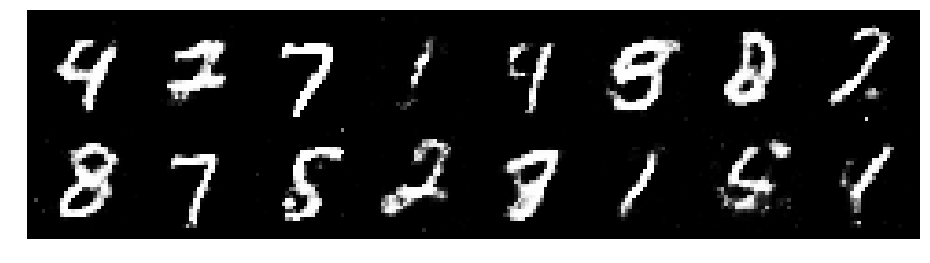

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.1824, Generator Loss: 0.9123
D(x): 0.5761, D(G(z)): 0.4279


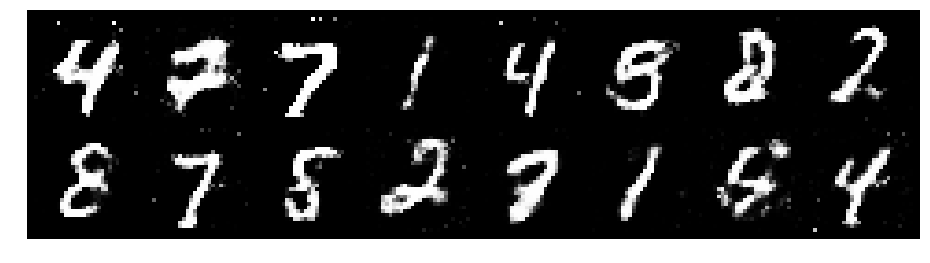

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.2604, Generator Loss: 0.9784
D(x): 0.5450, D(G(z)): 0.4384


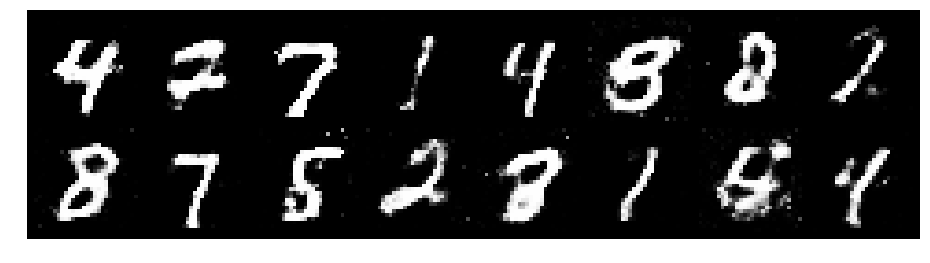

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.3637, Generator Loss: 0.8879
D(x): 0.5711, D(G(z)): 0.4904


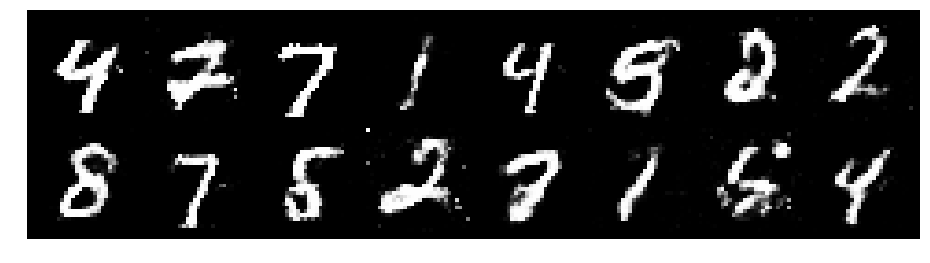

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.2064, Generator Loss: 0.9101
D(x): 0.5738, D(G(z)): 0.4249


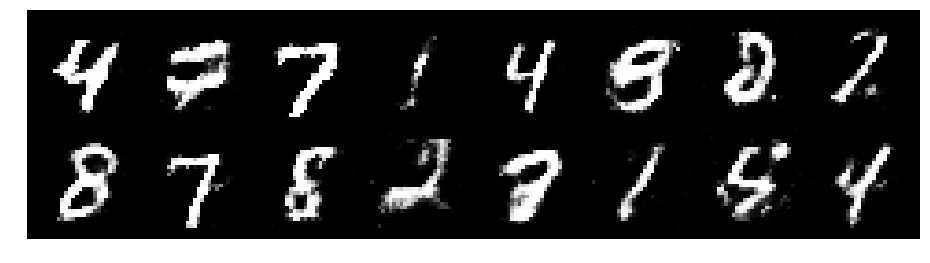

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.2668, Generator Loss: 0.9419
D(x): 0.5984, D(G(z)): 0.4691


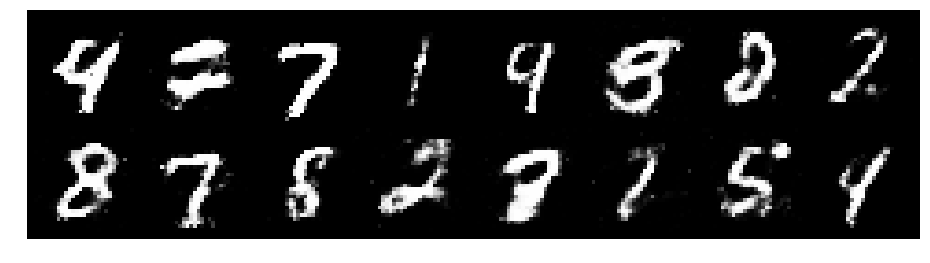

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.3374, Generator Loss: 0.7702
D(x): 0.5569, D(G(z)): 0.4908


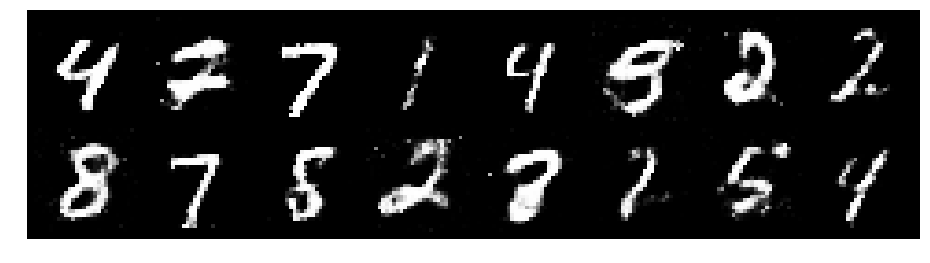

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.3376, Generator Loss: 0.8530
D(x): 0.5580, D(G(z)): 0.4766


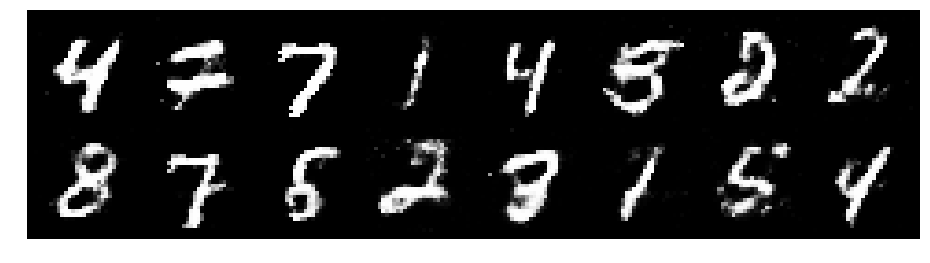

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.2895, Generator Loss: 0.8274
D(x): 0.5999, D(G(z)): 0.4963


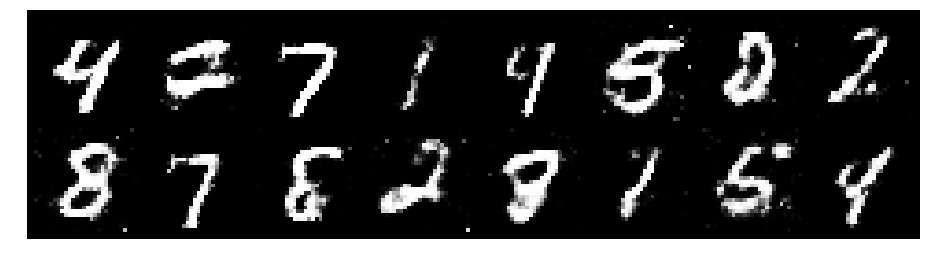

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.1863, Generator Loss: 0.7896
D(x): 0.5963, D(G(z)): 0.4451


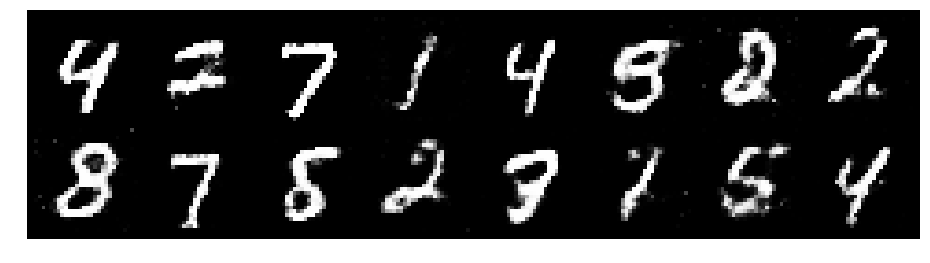

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.2356, Generator Loss: 0.9093
D(x): 0.5447, D(G(z)): 0.4046


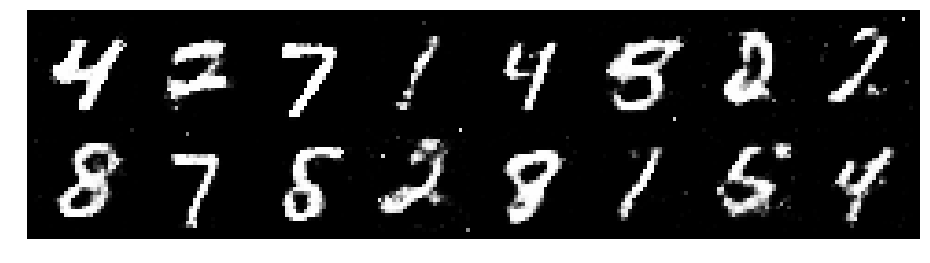

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.1908, Generator Loss: 0.9991
D(x): 0.5758, D(G(z)): 0.4186


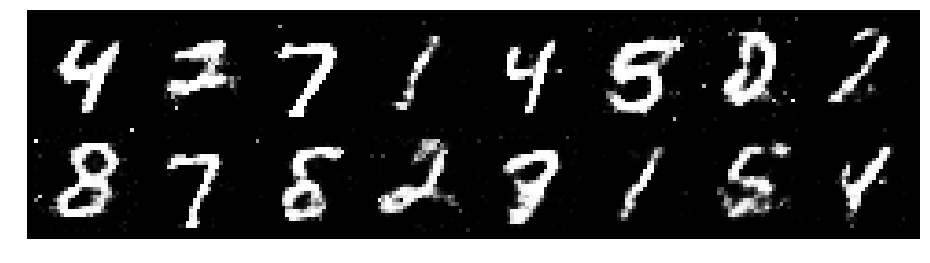

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.1844, Generator Loss: 0.9827
D(x): 0.5994, D(G(z)): 0.4233


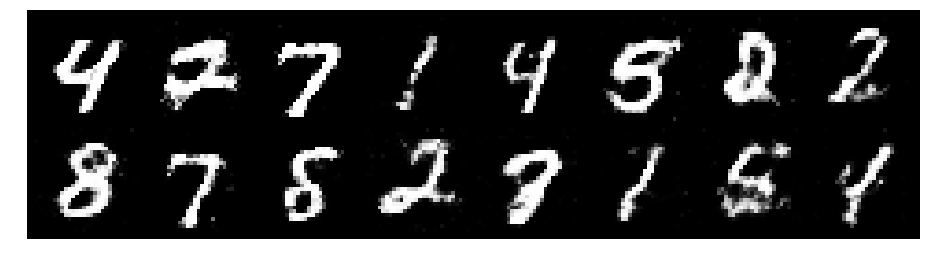

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.1761, Generator Loss: 0.9328
D(x): 0.5786, D(G(z)): 0.4259


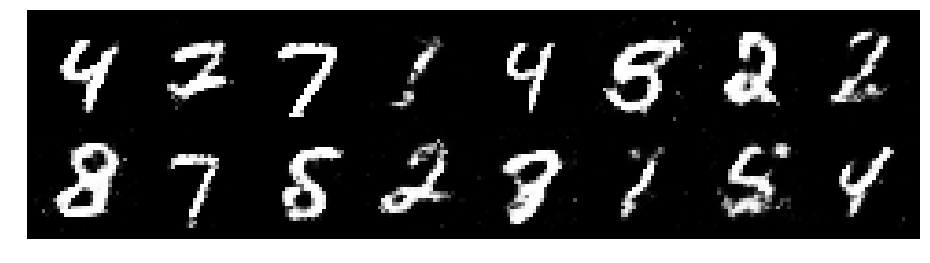

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.4317, Generator Loss: 0.8873
D(x): 0.5298, D(G(z)): 0.4661


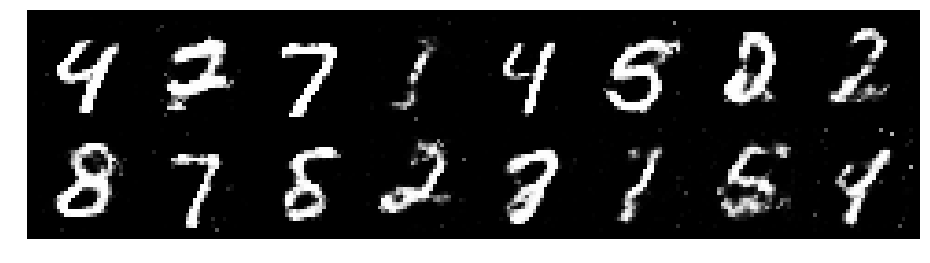

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.3390, Generator Loss: 0.9871
D(x): 0.5367, D(G(z)): 0.4517


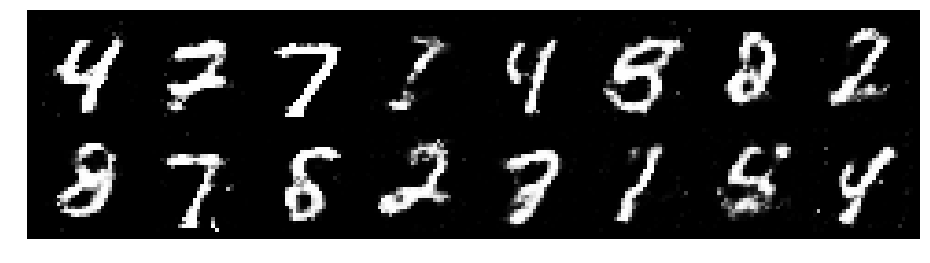

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.3569, Generator Loss: 0.8098
D(x): 0.5827, D(G(z)): 0.4971


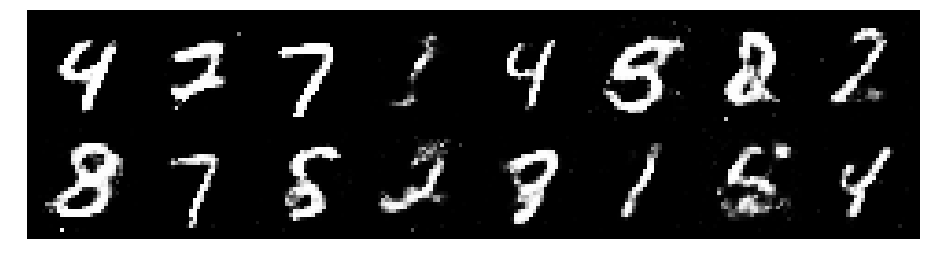

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.2575, Generator Loss: 1.1603
D(x): 0.5851, D(G(z)): 0.4284


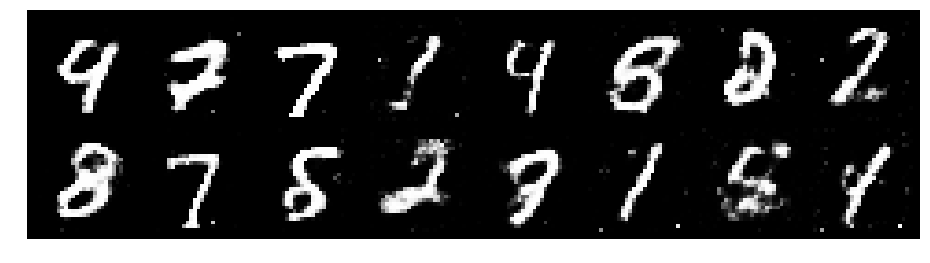

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.2202, Generator Loss: 0.9954
D(x): 0.5769, D(G(z)): 0.4231


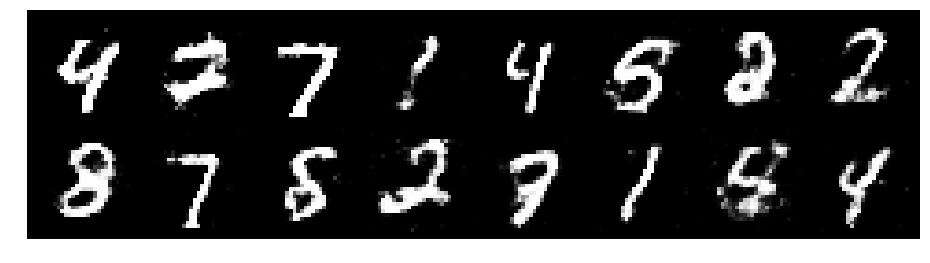

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.0868, Generator Loss: 0.9589
D(x): 0.6111, D(G(z)): 0.4012


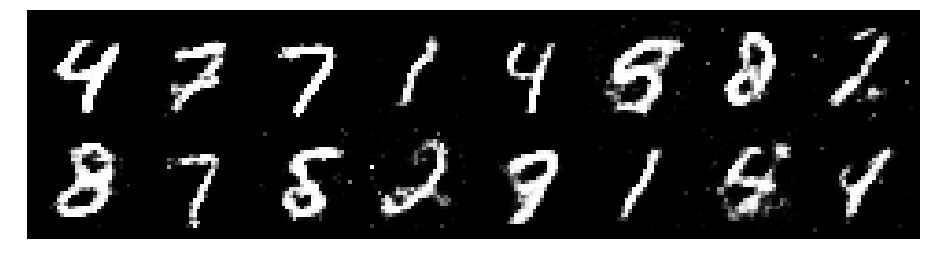

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.2891, Generator Loss: 0.9607
D(x): 0.5437, D(G(z)): 0.4283


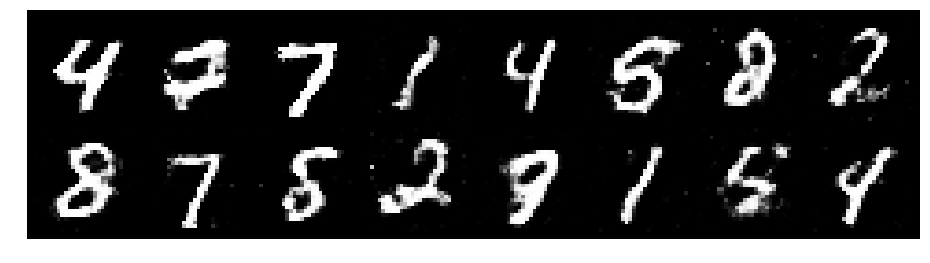

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.3481, Generator Loss: 0.8939
D(x): 0.5529, D(G(z)): 0.4527


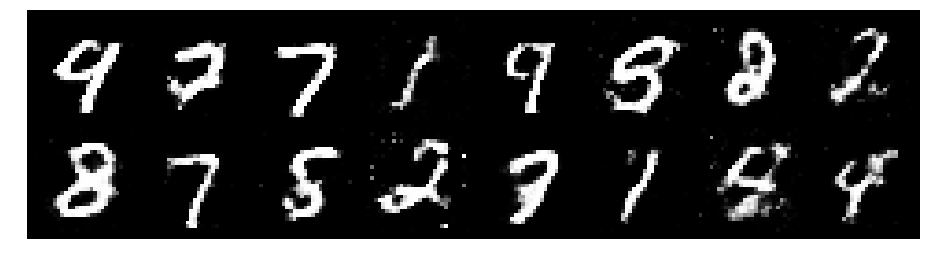

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.2579, Generator Loss: 0.9132
D(x): 0.6127, D(G(z)): 0.4361


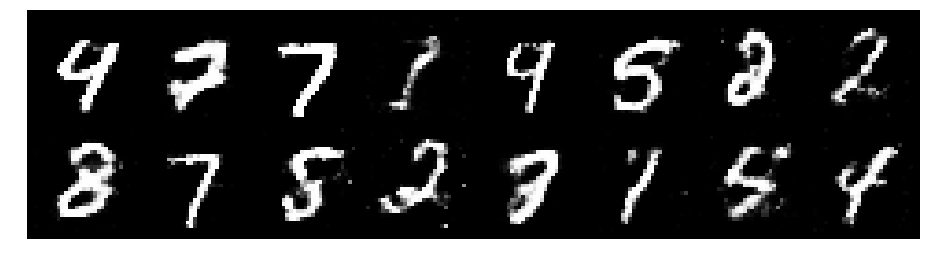

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.1262, Generator Loss: 1.0313
D(x): 0.5821, D(G(z)): 0.3970


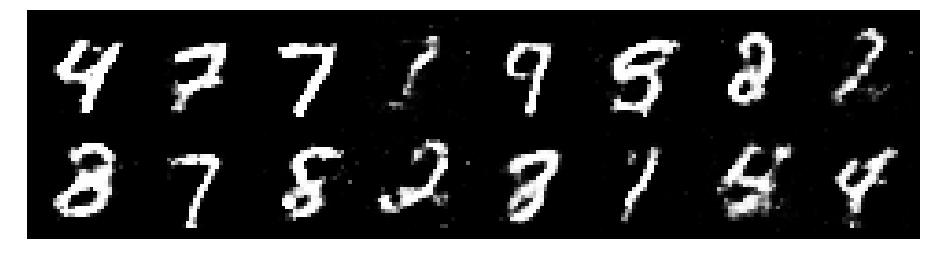

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.1764, Generator Loss: 1.0665
D(x): 0.5715, D(G(z)): 0.4045


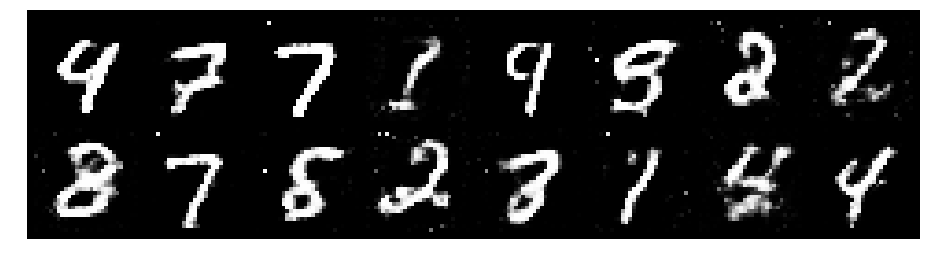

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.3063, Generator Loss: 1.0602
D(x): 0.5511, D(G(z)): 0.4345


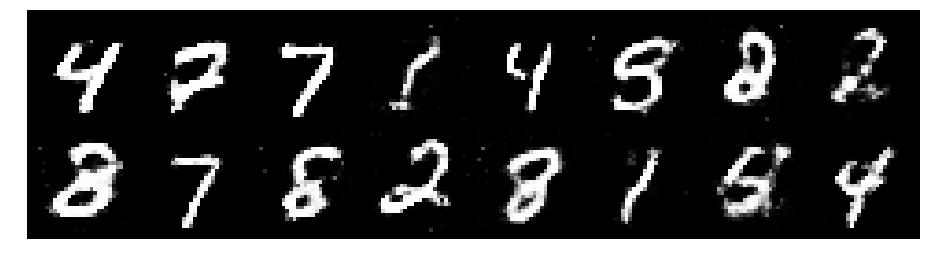

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.4104, Generator Loss: 0.8294
D(x): 0.5453, D(G(z)): 0.5010


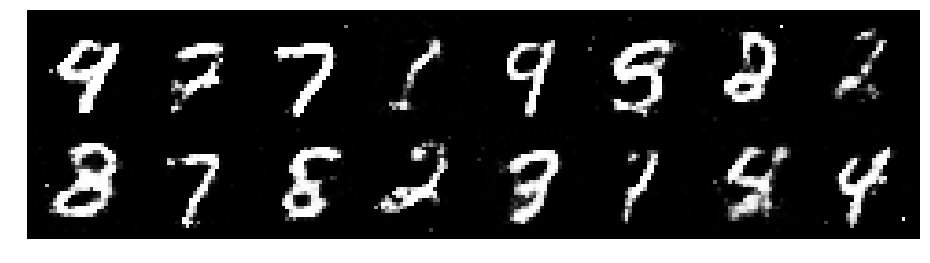

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.3022, Generator Loss: 1.0195
D(x): 0.5633, D(G(z)): 0.4487


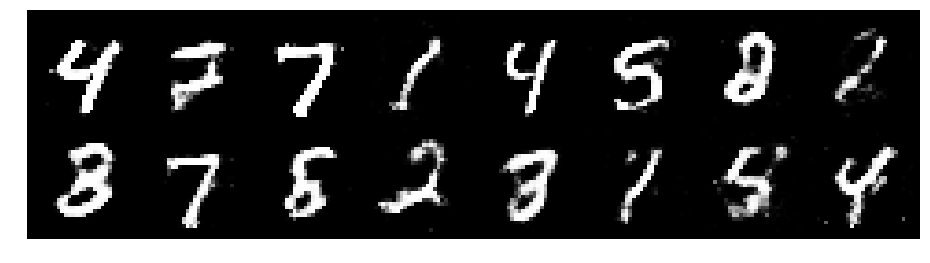

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.3354, Generator Loss: 0.9386
D(x): 0.5819, D(G(z)): 0.4607


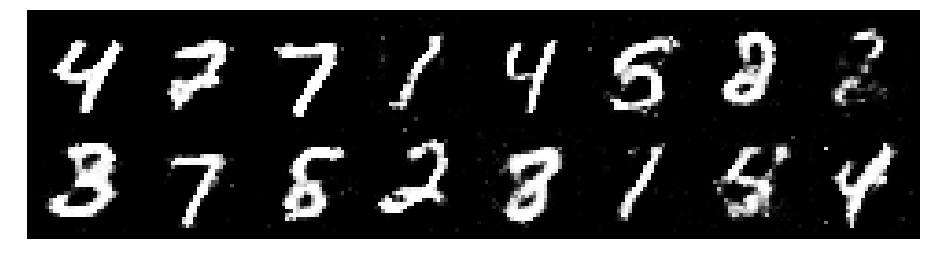

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.3181, Generator Loss: 1.0419
D(x): 0.5327, D(G(z)): 0.4201


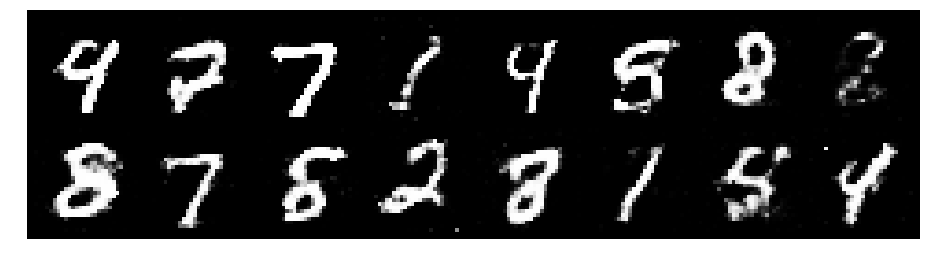

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.1840, Generator Loss: 0.8491
D(x): 0.5909, D(G(z)): 0.4337


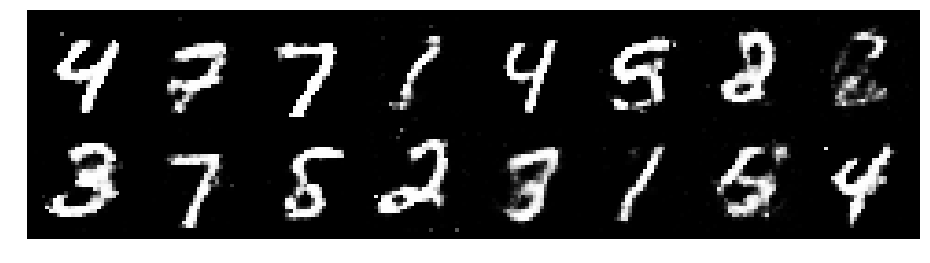

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.3687, Generator Loss: 0.8777
D(x): 0.5057, D(G(z)): 0.4308


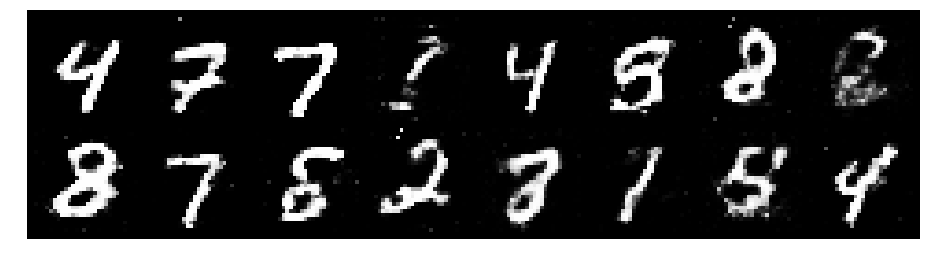

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.3335, Generator Loss: 0.8112
D(x): 0.5684, D(G(z)): 0.4884


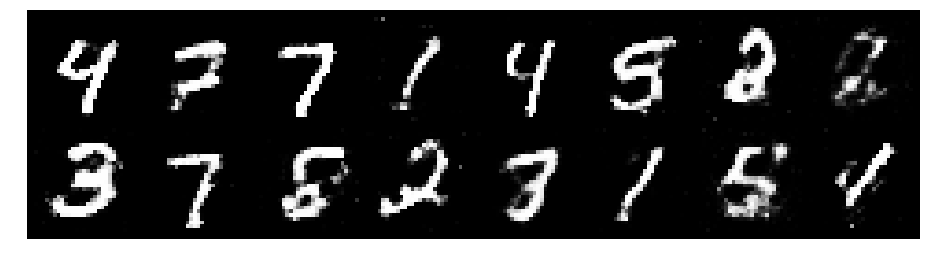

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.3123, Generator Loss: 0.8726
D(x): 0.5487, D(G(z)): 0.4492


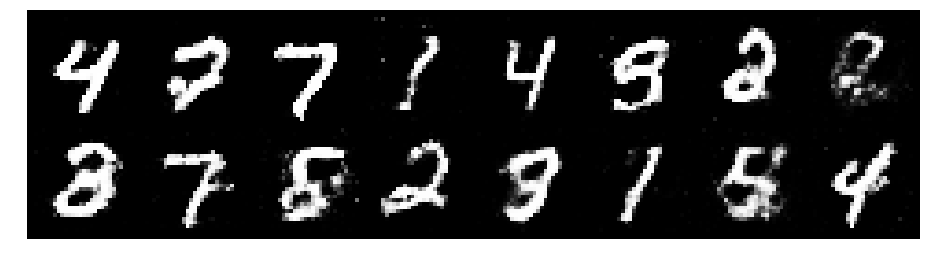

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.2701, Generator Loss: 0.7101
D(x): 0.5865, D(G(z)): 0.4904


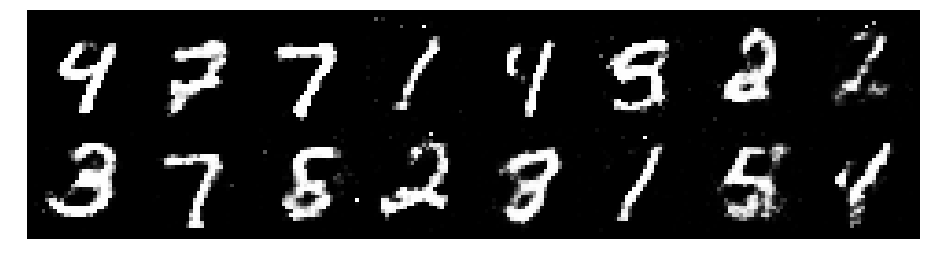

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.2793, Generator Loss: 0.9914
D(x): 0.6175, D(G(z)): 0.4757


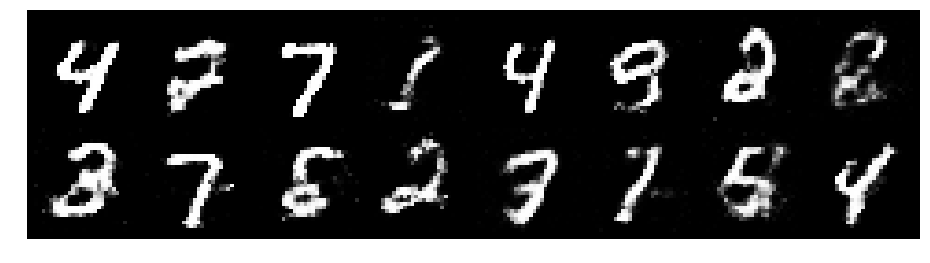

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.2485, Generator Loss: 0.8607
D(x): 0.5641, D(G(z)): 0.4412


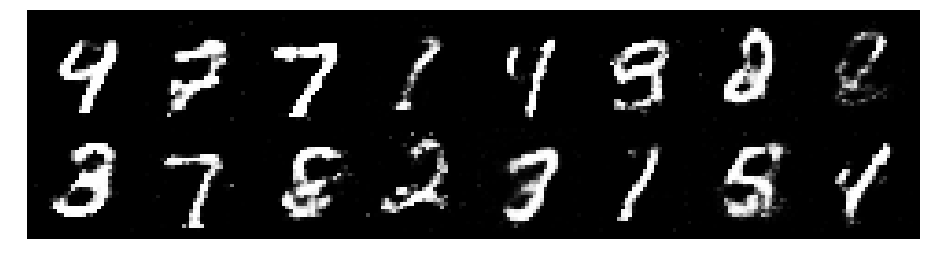

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.2156, Generator Loss: 0.9296
D(x): 0.5836, D(G(z)): 0.4490


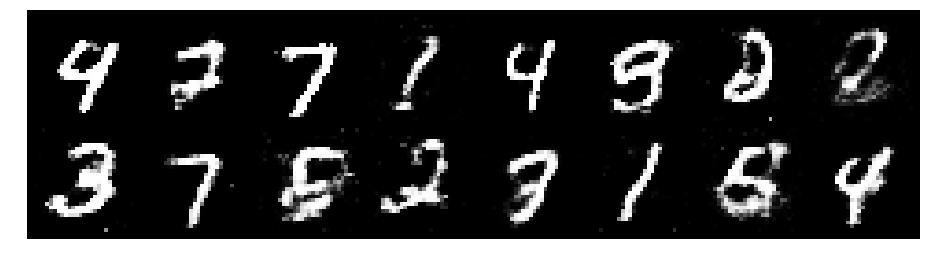

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.2370, Generator Loss: 0.9245
D(x): 0.5381, D(G(z)): 0.4276


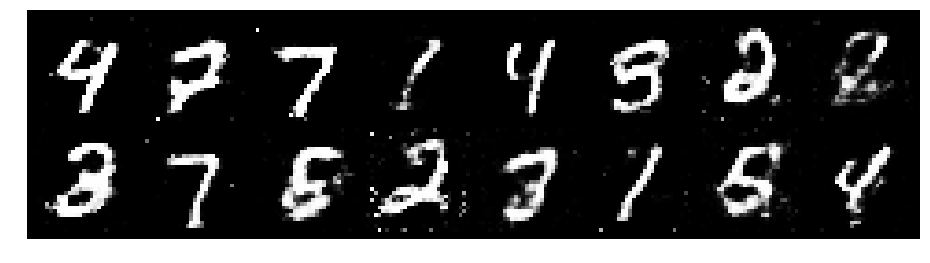

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.3037, Generator Loss: 0.8433
D(x): 0.5713, D(G(z)): 0.4609


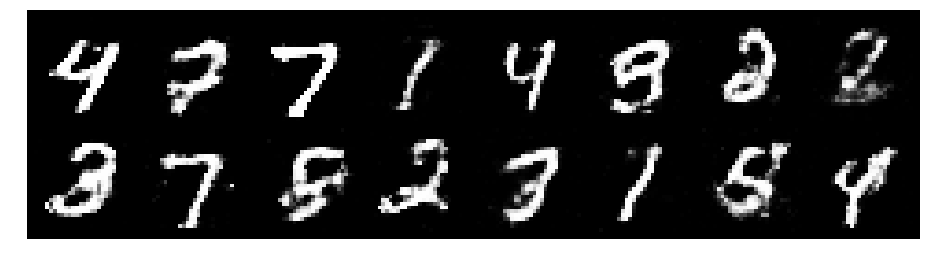

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.2275, Generator Loss: 1.0295
D(x): 0.5604, D(G(z)): 0.4176


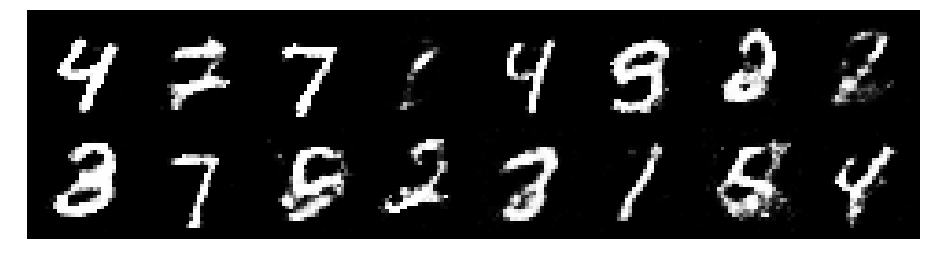

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.0993, Generator Loss: 0.9649
D(x): 0.5928, D(G(z)): 0.3893


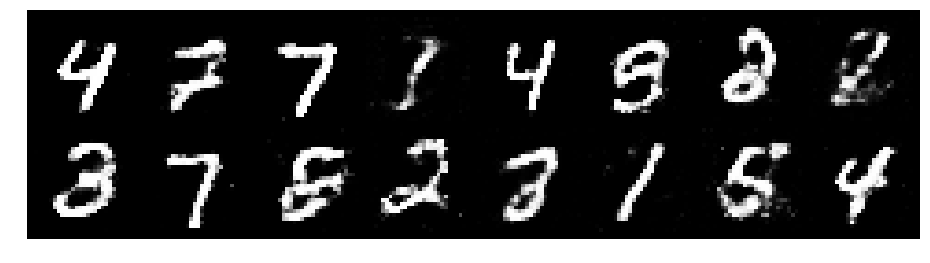

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.3242, Generator Loss: 0.8245
D(x): 0.5327, D(G(z)): 0.4611


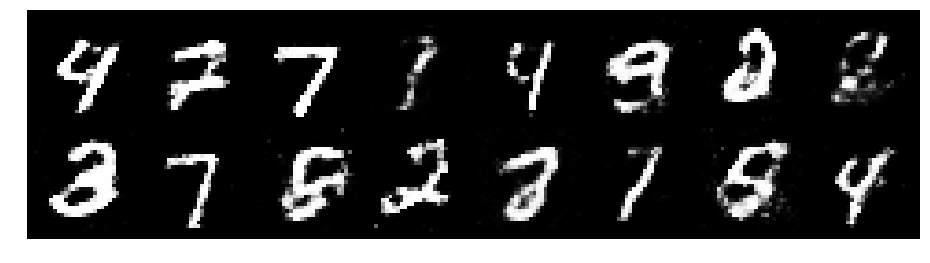

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.0931, Generator Loss: 0.9148
D(x): 0.6166, D(G(z)): 0.4111


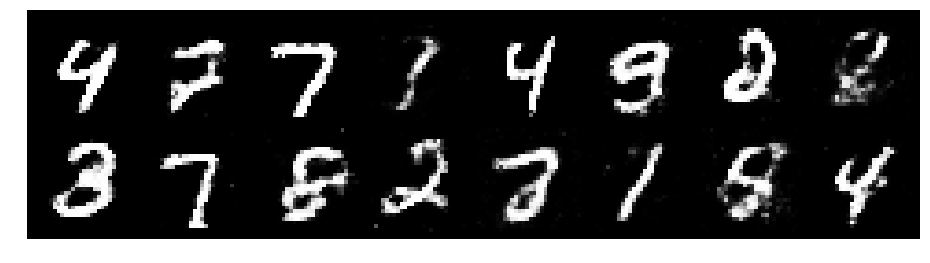

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.2546, Generator Loss: 1.0420
D(x): 0.5504, D(G(z)): 0.4326


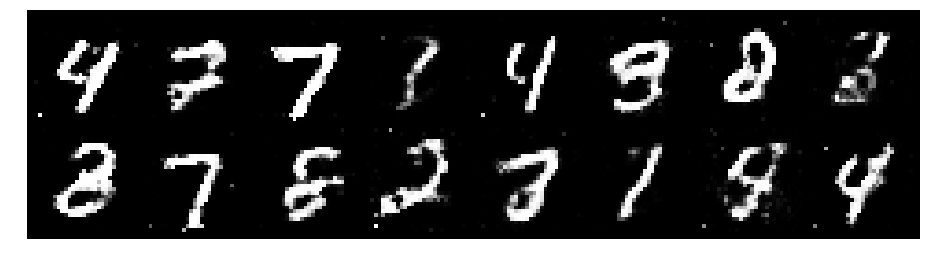

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.1308, Generator Loss: 0.9296
D(x): 0.5868, D(G(z)): 0.4080


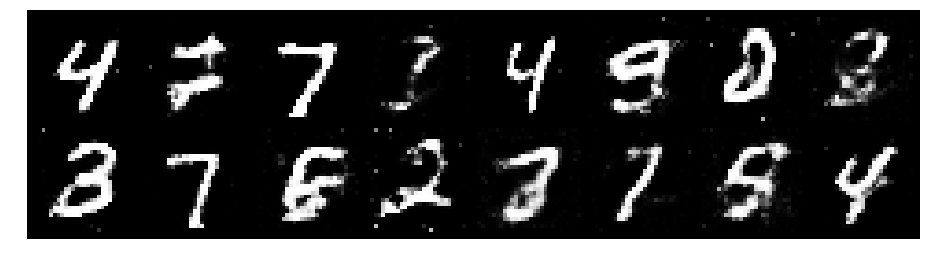

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.4144, Generator Loss: 0.8685
D(x): 0.5147, D(G(z)): 0.4685


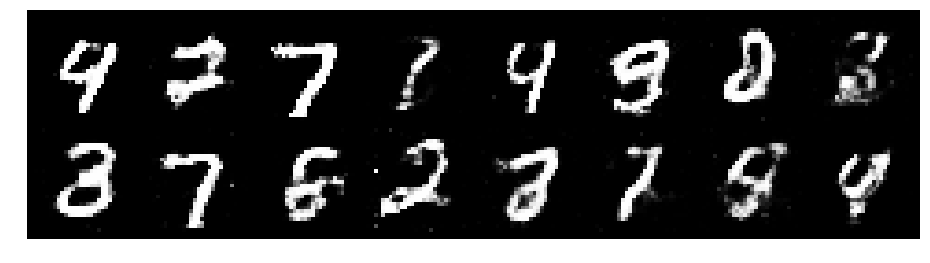

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.2158, Generator Loss: 0.9844
D(x): 0.5625, D(G(z)): 0.4032


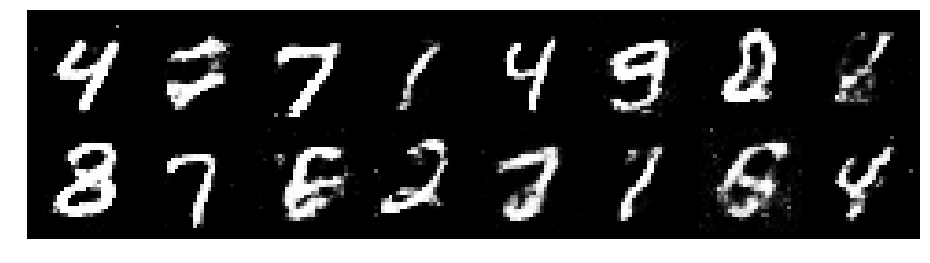

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.2209, Generator Loss: 0.9442
D(x): 0.5486, D(G(z)): 0.4113


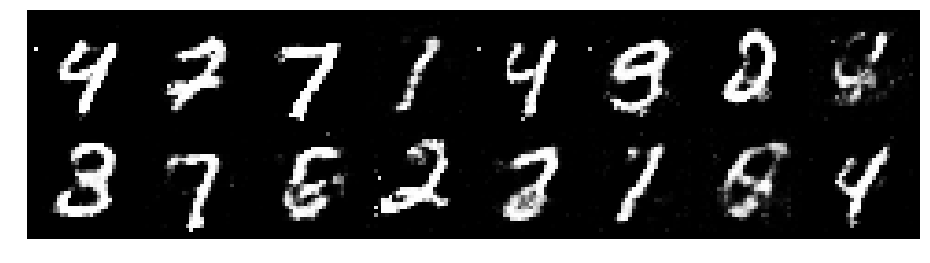

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.2859, Generator Loss: 0.9231
D(x): 0.5620, D(G(z)): 0.4517


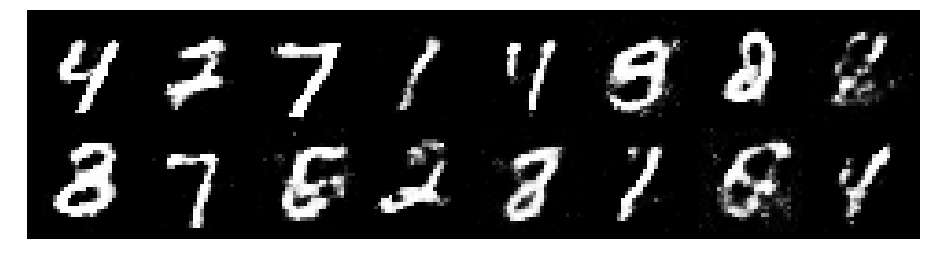

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.2159, Generator Loss: 0.7493
D(x): 0.5765, D(G(z)): 0.4463


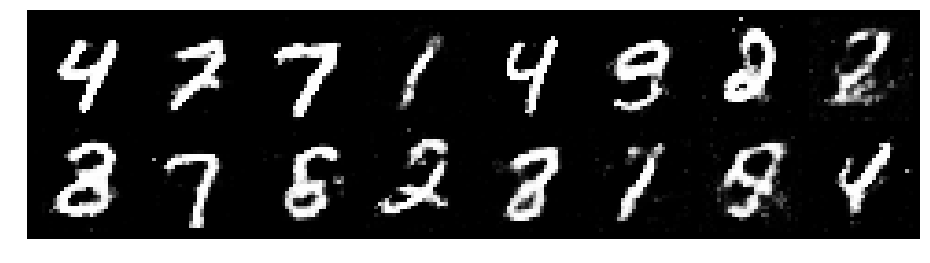

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.3420, Generator Loss: 0.8279
D(x): 0.5363, D(G(z)): 0.4604


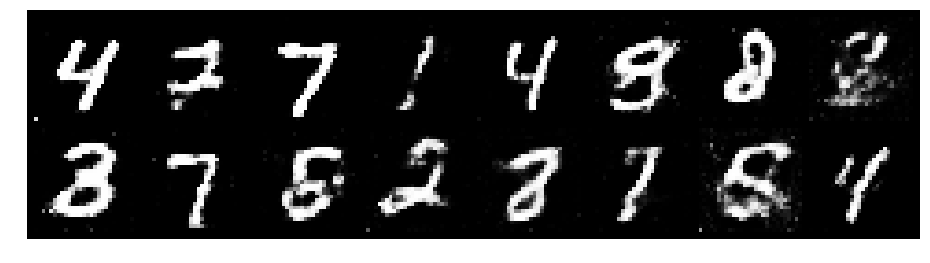

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.1248, Generator Loss: 1.0388
D(x): 0.5844, D(G(z)): 0.3891


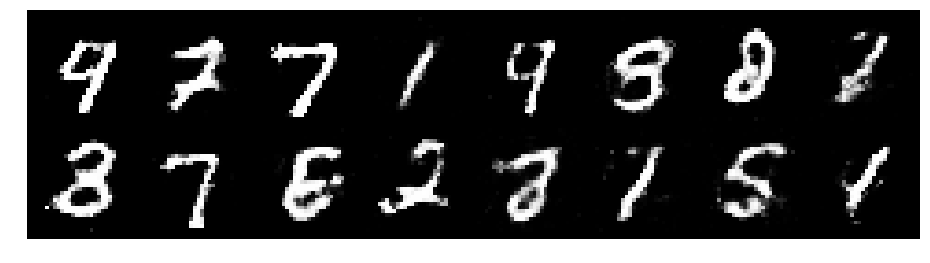

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.1243, Generator Loss: 0.9037
D(x): 0.6009, D(G(z)): 0.4132


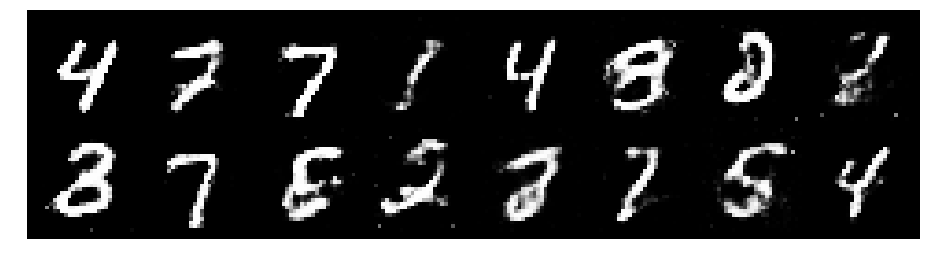

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.2172, Generator Loss: 0.9178
D(x): 0.5496, D(G(z)): 0.4231


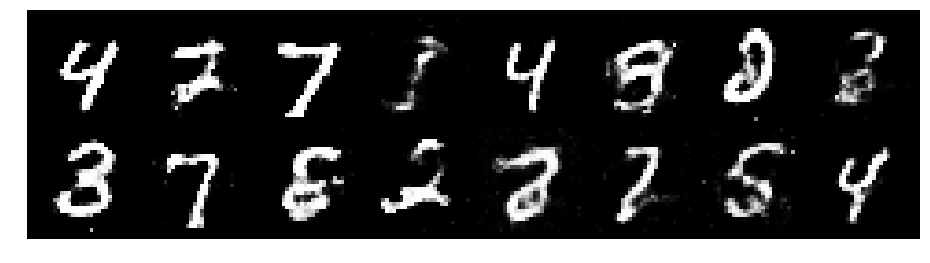

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.2752, Generator Loss: 0.9651
D(x): 0.5399, D(G(z)): 0.4428


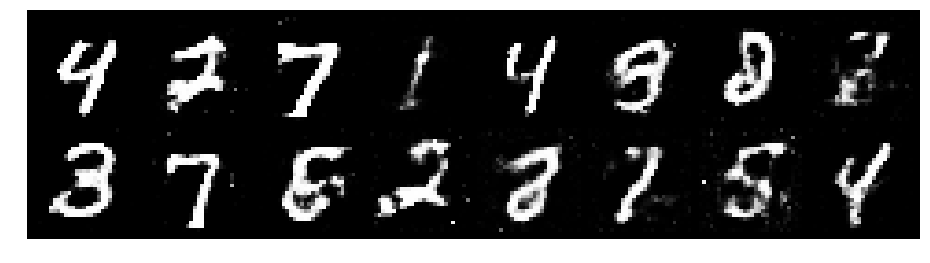

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.2280, Generator Loss: 0.8945
D(x): 0.5604, D(G(z)): 0.4303


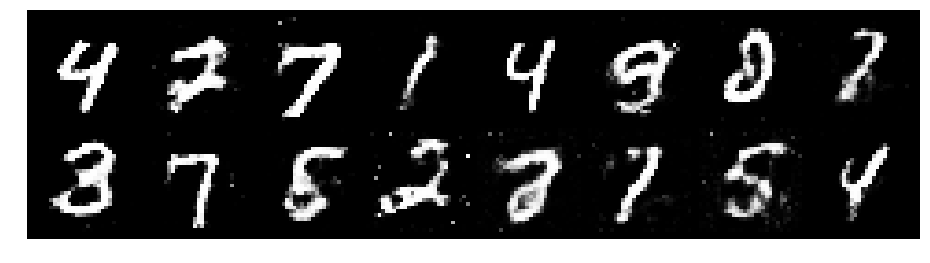

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.1822, Generator Loss: 0.9101
D(x): 0.5665, D(G(z)): 0.4148


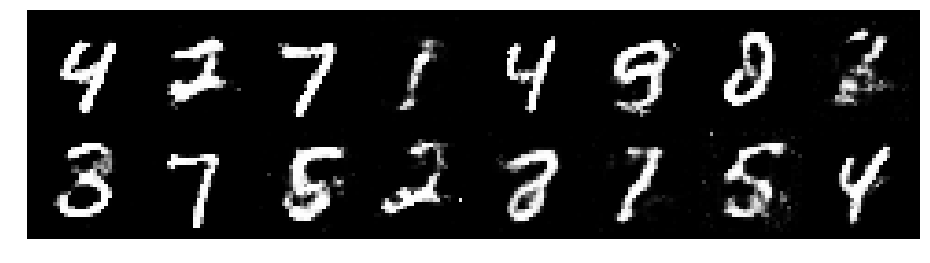

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.1938, Generator Loss: 1.0010
D(x): 0.6002, D(G(z)): 0.4297


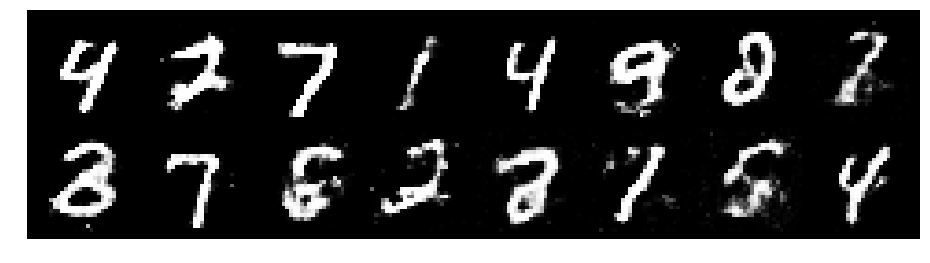

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.1389, Generator Loss: 1.0824
D(x): 0.5670, D(G(z)): 0.3753


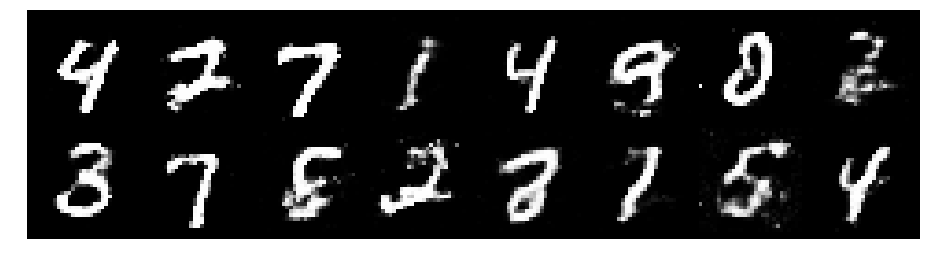

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.1280, Generator Loss: 1.0443
D(x): 0.5641, D(G(z)): 0.3589


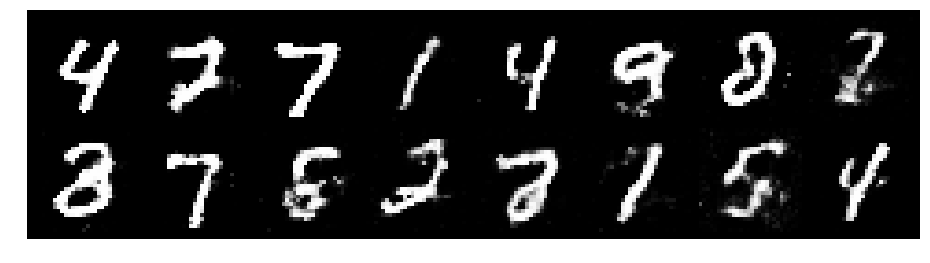

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.1633, Generator Loss: 0.9771
D(x): 0.5769, D(G(z)): 0.4125


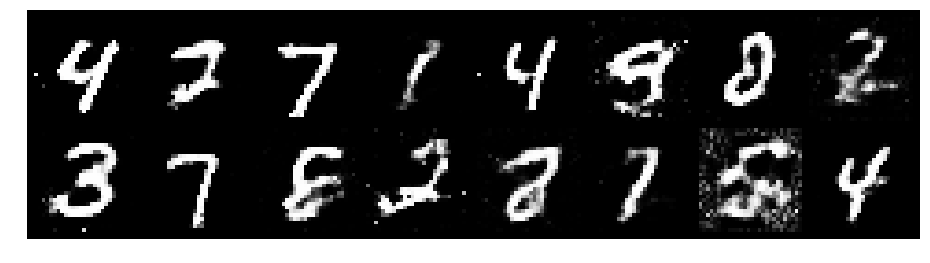

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.2051, Generator Loss: 1.0592
D(x): 0.5385, D(G(z)): 0.3711


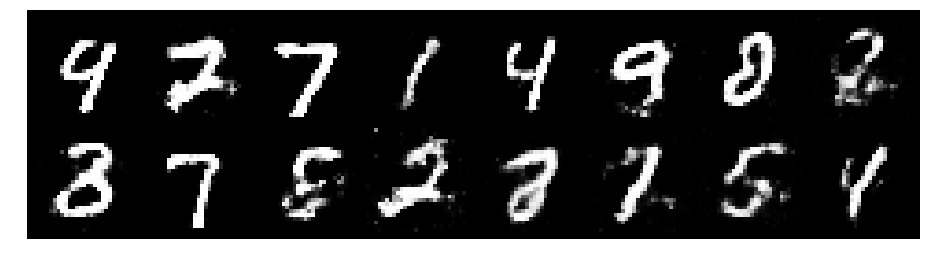

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.2722, Generator Loss: 0.8708
D(x): 0.5971, D(G(z)): 0.4448


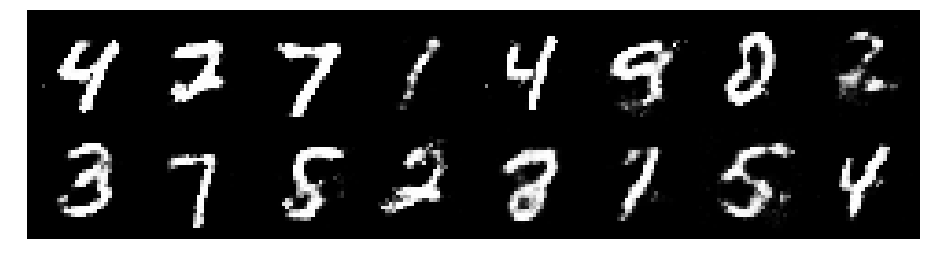

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.2878, Generator Loss: 0.8918
D(x): 0.5428, D(G(z)): 0.4465


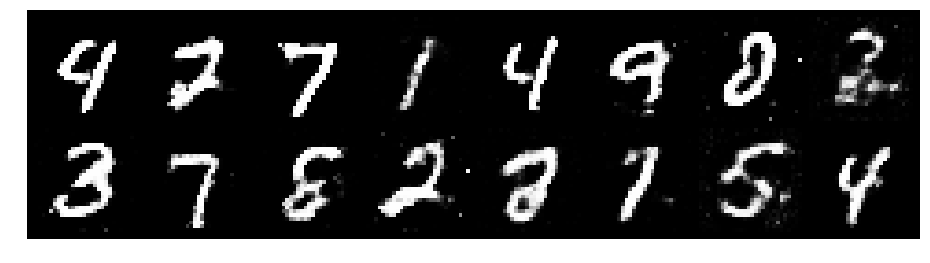

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.2996, Generator Loss: 0.8411
D(x): 0.6027, D(G(z)): 0.4874


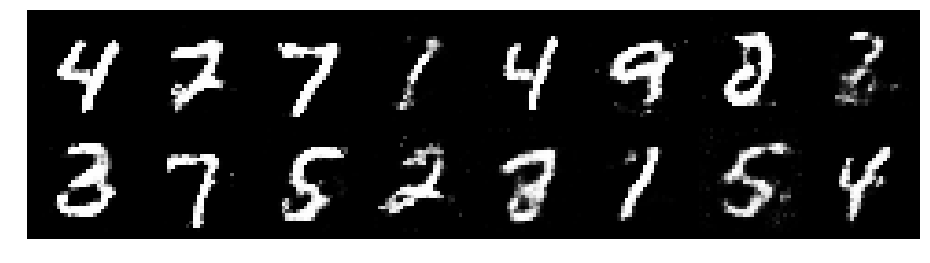

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.1715, Generator Loss: 1.0120
D(x): 0.5865, D(G(z)): 0.4045


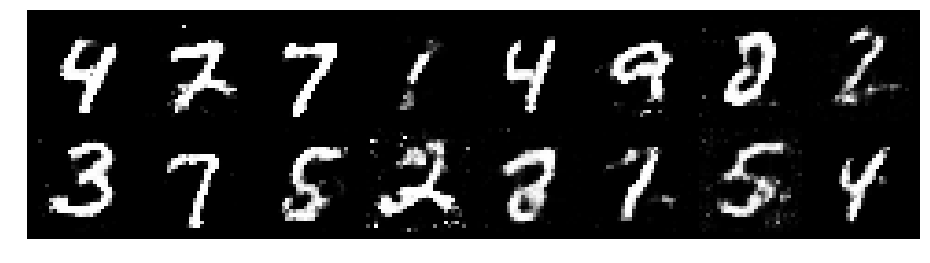

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.1939, Generator Loss: 0.8726
D(x): 0.5882, D(G(z)): 0.4373


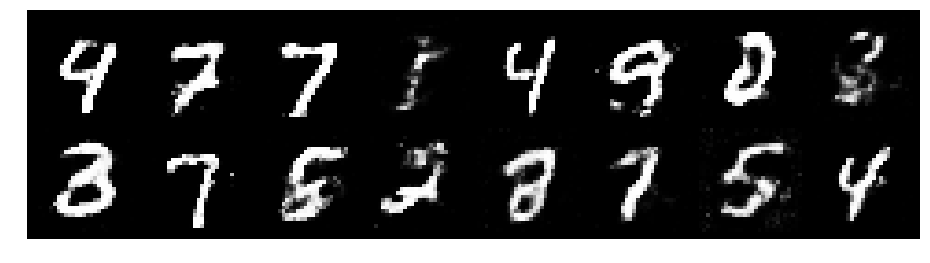

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.1874, Generator Loss: 0.7559
D(x): 0.6052, D(G(z)): 0.4655


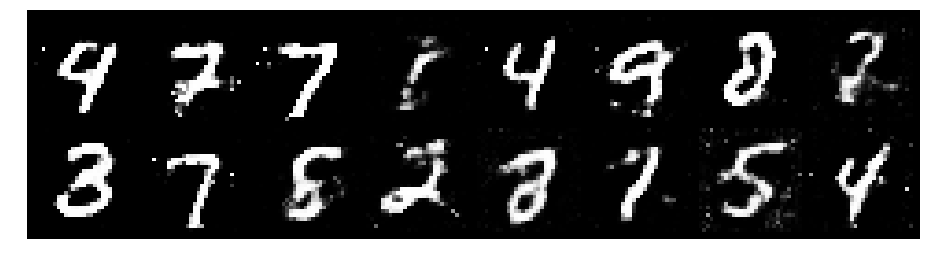

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.2687, Generator Loss: 0.9596
D(x): 0.5438, D(G(z)): 0.4354


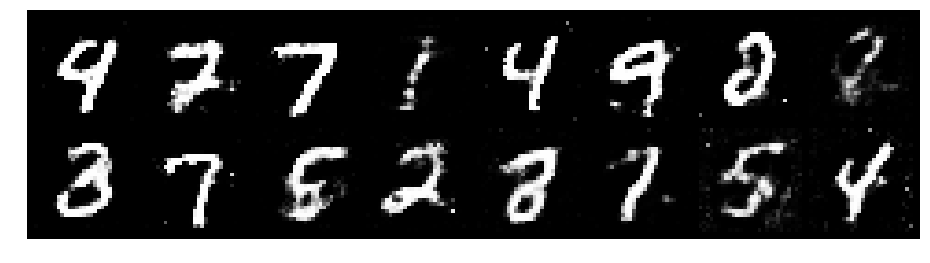

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.1394, Generator Loss: 1.0621
D(x): 0.5599, D(G(z)): 0.3553


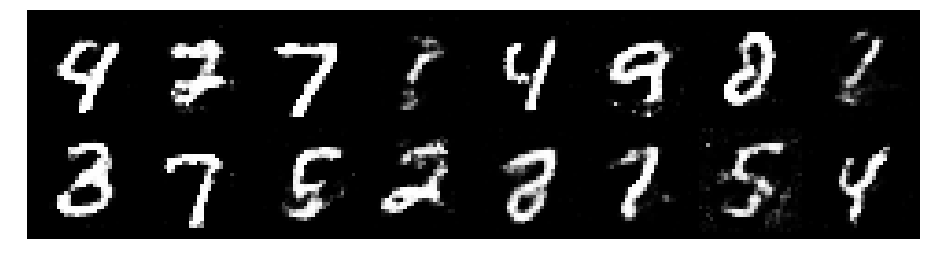

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.0563, Generator Loss: 0.9958
D(x): 0.6451, D(G(z)): 0.4006


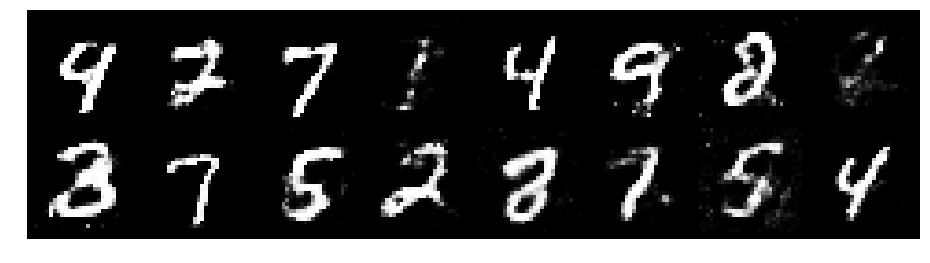

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.1710, Generator Loss: 0.9483
D(x): 0.5663, D(G(z)): 0.4146


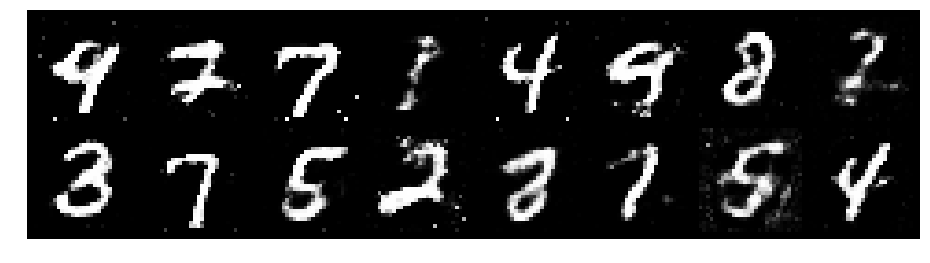

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.1701, Generator Loss: 0.9713
D(x): 0.5562, D(G(z)): 0.3995


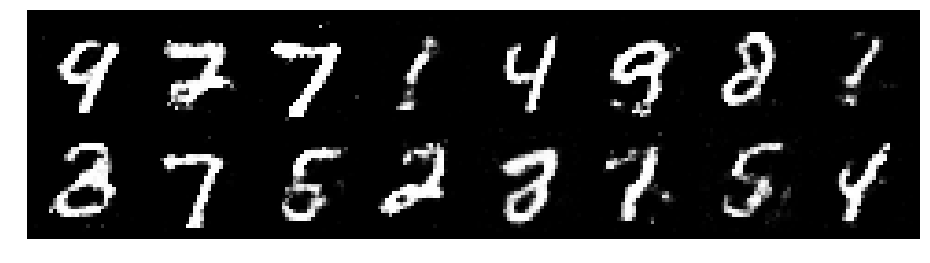

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.1996, Generator Loss: 0.9144
D(x): 0.5877, D(G(z)): 0.4463


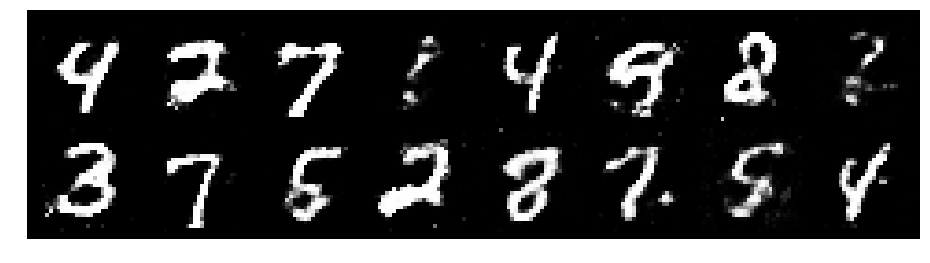

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.2612, Generator Loss: 0.9346
D(x): 0.5868, D(G(z)): 0.4459


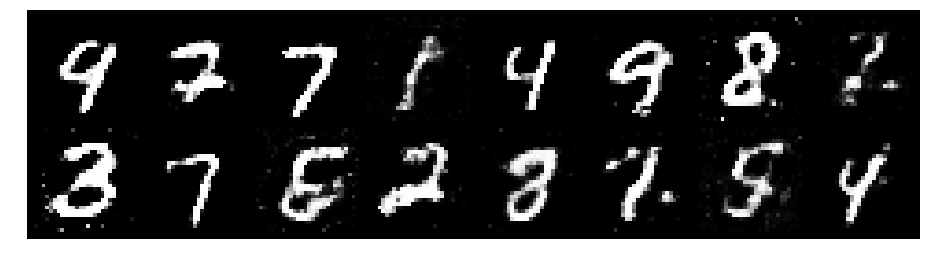

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.1768, Generator Loss: 1.0638
D(x): 0.5554, D(G(z)): 0.3848


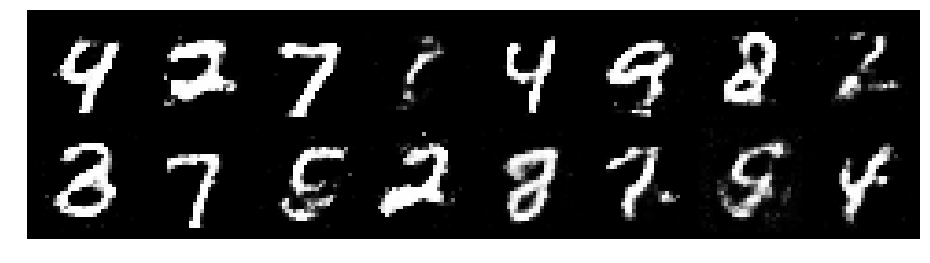

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.1542, Generator Loss: 0.9555
D(x): 0.5885, D(G(z)): 0.4152


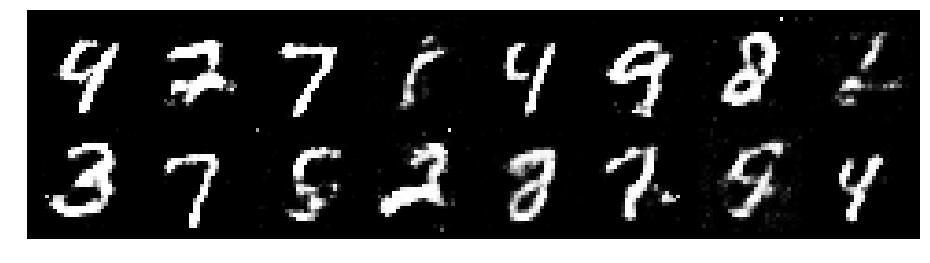

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.2712, Generator Loss: 0.9251
D(x): 0.5683, D(G(z)): 0.4394


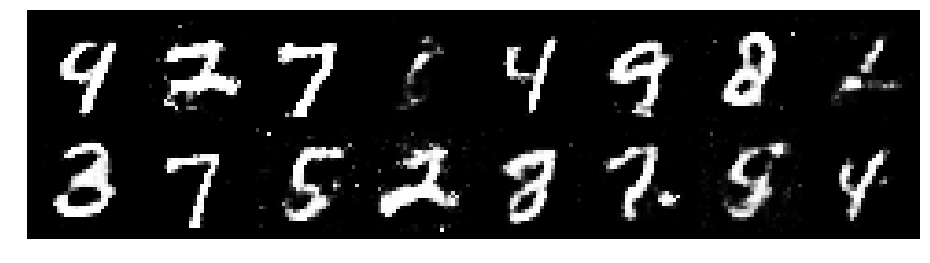

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.4215, Generator Loss: 0.7746
D(x): 0.5047, D(G(z)): 0.4686


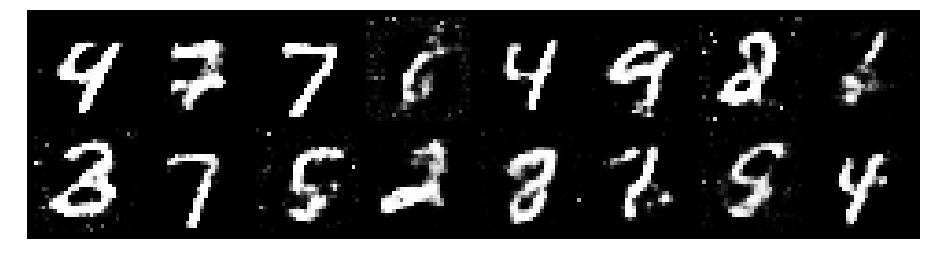

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.2225, Generator Loss: 0.8710
D(x): 0.5798, D(G(z)): 0.4561


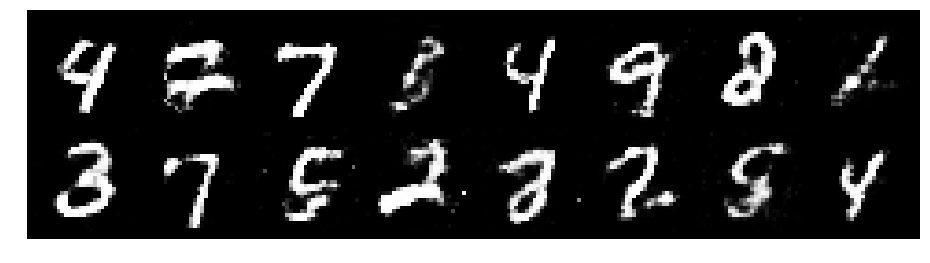

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.1699, Generator Loss: 0.9678
D(x): 0.6017, D(G(z)): 0.4352


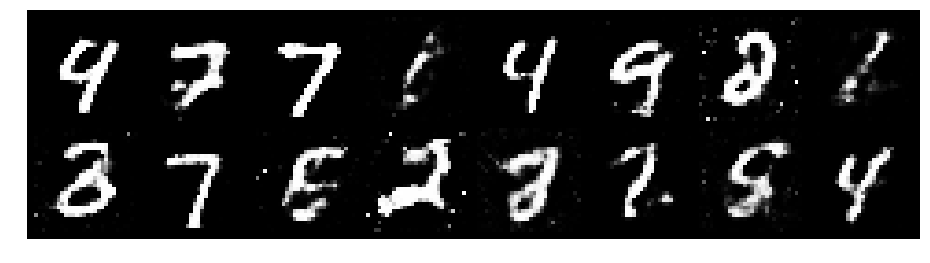

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.2223, Generator Loss: 1.0108
D(x): 0.5256, D(G(z)): 0.3989


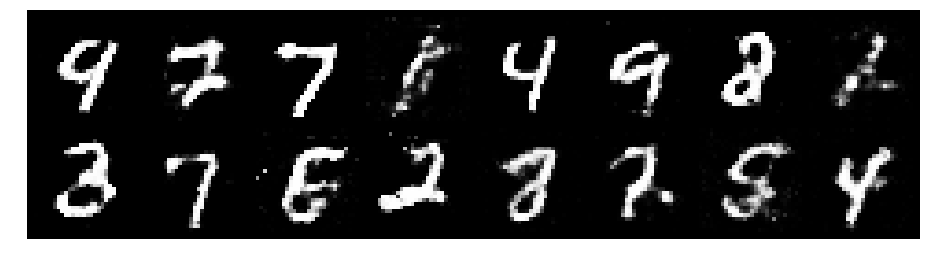

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.3030, Generator Loss: 0.8286
D(x): 0.5405, D(G(z)): 0.4446


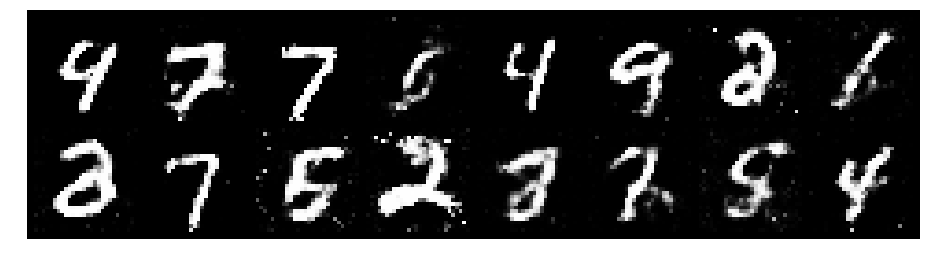

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.2820, Generator Loss: 0.8683
D(x): 0.5270, D(G(z)): 0.4280


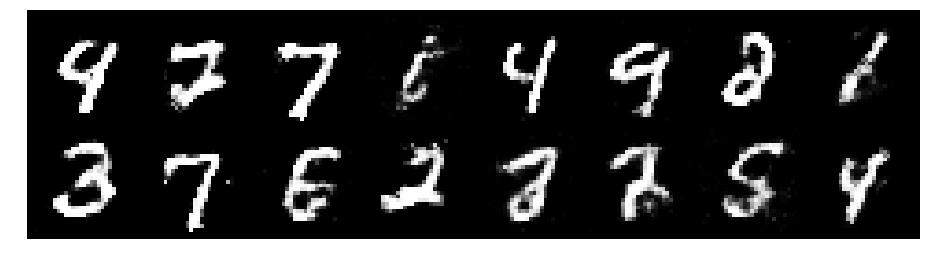

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.1271, Generator Loss: 1.1140
D(x): 0.5713, D(G(z)): 0.3734


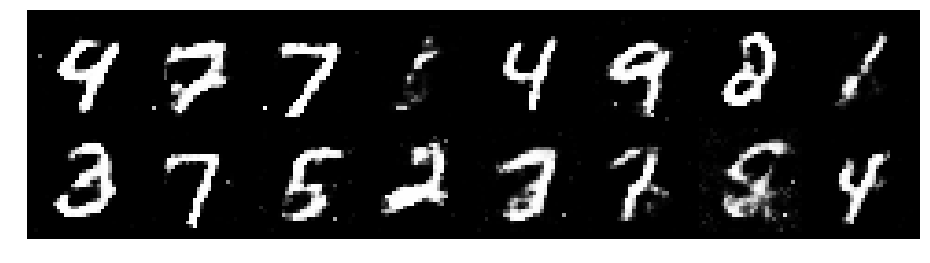

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.1018, Generator Loss: 1.0404
D(x): 0.6016, D(G(z)): 0.3853


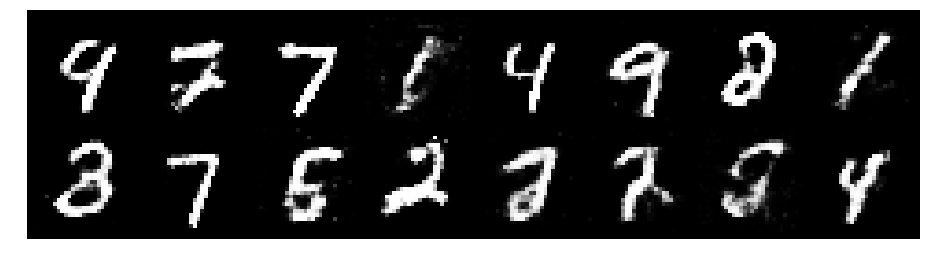

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.1766, Generator Loss: 0.9305
D(x): 0.6099, D(G(z)): 0.4369


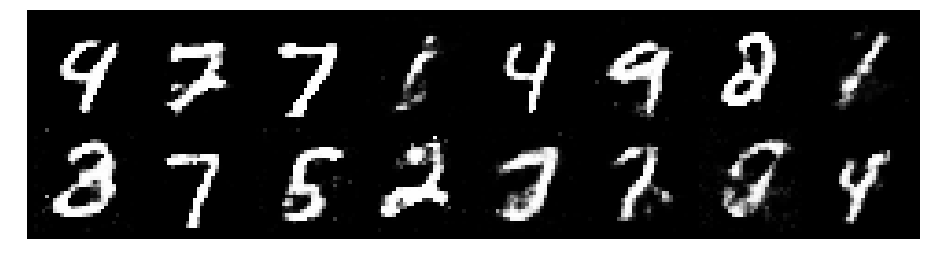

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.2528, Generator Loss: 0.8934
D(x): 0.5572, D(G(z)): 0.4255


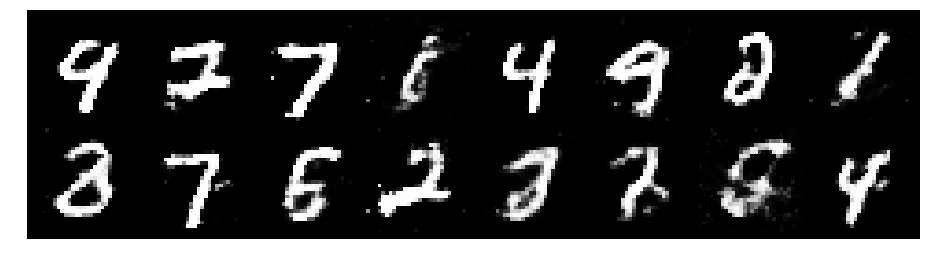

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.1283, Generator Loss: 0.9629
D(x): 0.5787, D(G(z)): 0.3819


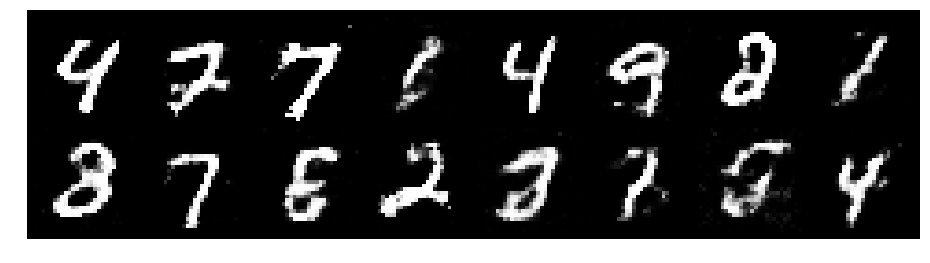

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.3136, Generator Loss: 0.8626
D(x): 0.5505, D(G(z)): 0.4465


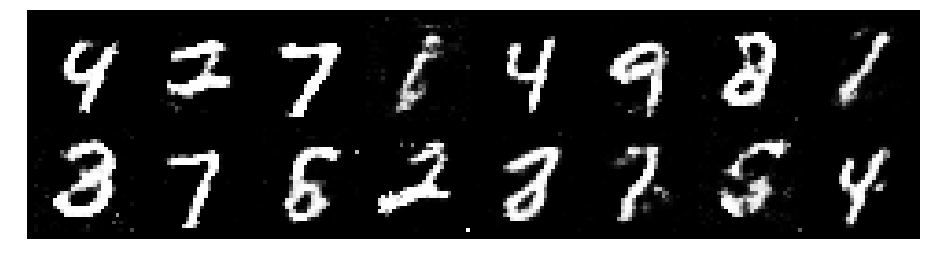

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.3221, Generator Loss: 0.9304
D(x): 0.5698, D(G(z)): 0.4507


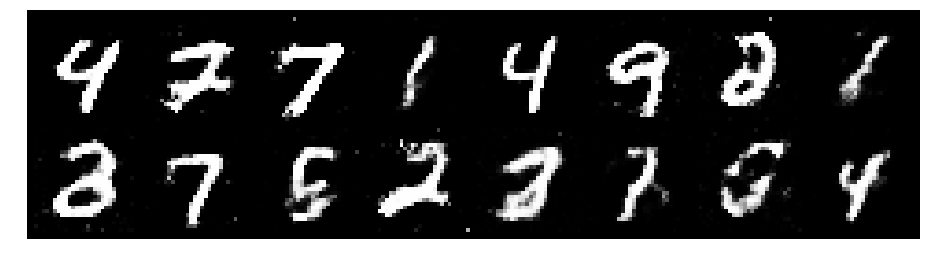

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.3255, Generator Loss: 0.7450
D(x): 0.6127, D(G(z)): 0.5081


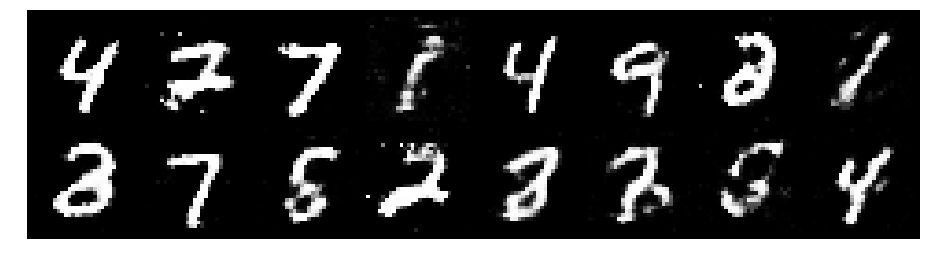

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.2956, Generator Loss: 0.8456
D(x): 0.6355, D(G(z)): 0.4958


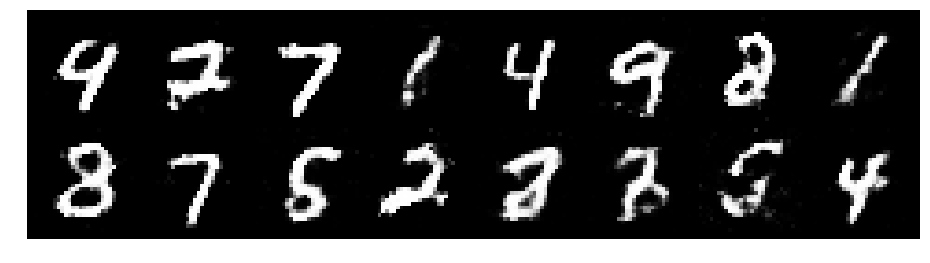

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.4215, Generator Loss: 0.9551
D(x): 0.5412, D(G(z)): 0.4481


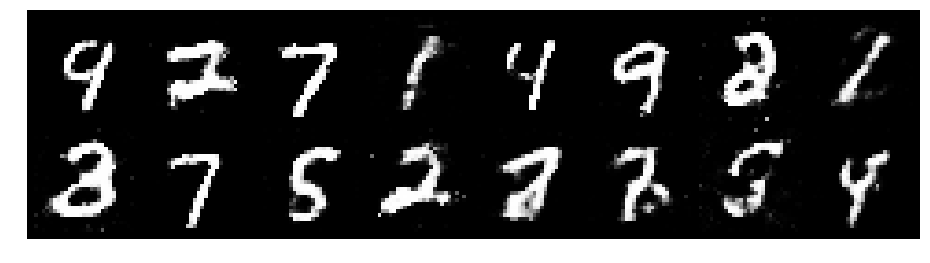

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.2603, Generator Loss: 0.8518
D(x): 0.5528, D(G(z)): 0.4333


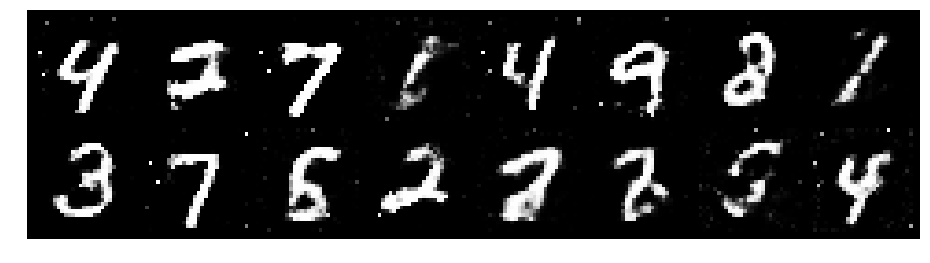

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.3778, Generator Loss: 0.8642
D(x): 0.5233, D(G(z)): 0.4539


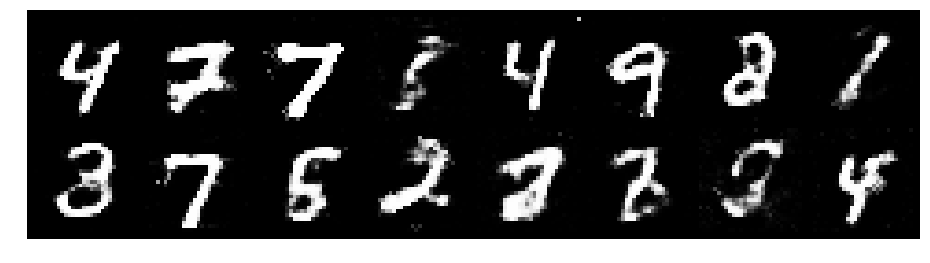

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.2662, Generator Loss: 1.0387
D(x): 0.5688, D(G(z)): 0.4054


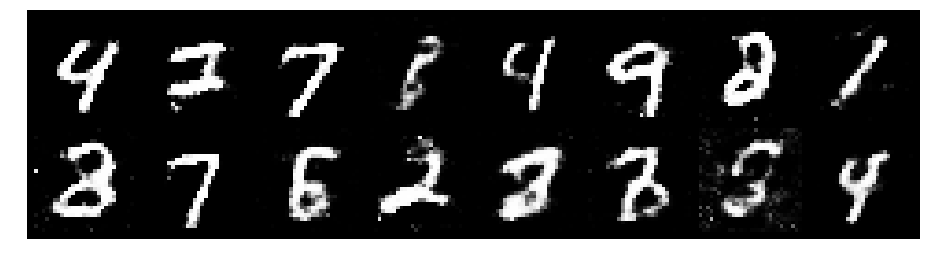

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.2636, Generator Loss: 0.8513
D(x): 0.5773, D(G(z)): 0.4414


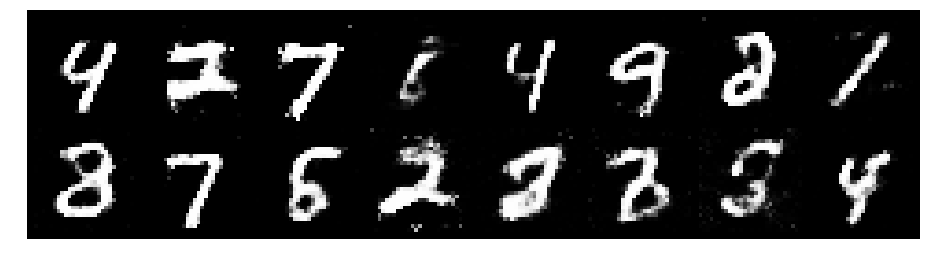

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.0909, Generator Loss: 0.9967
D(x): 0.6244, D(G(z)): 0.4179


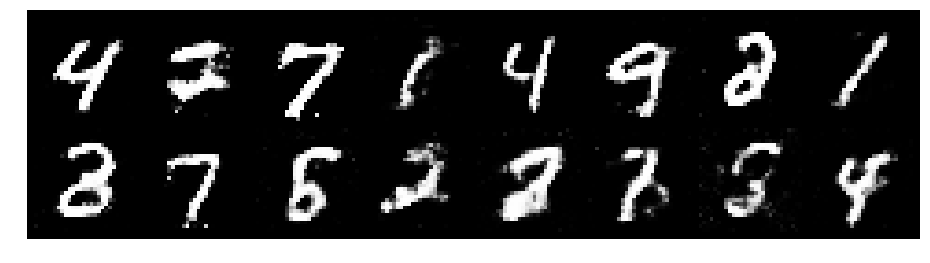

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.2155, Generator Loss: 0.8745
D(x): 0.6130, D(G(z)): 0.4564


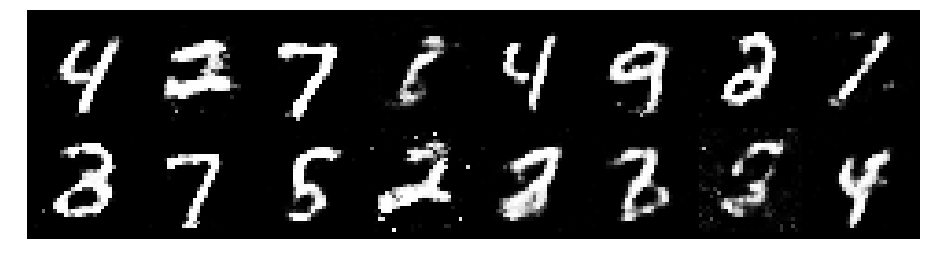

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.2000, Generator Loss: 0.7921
D(x): 0.5953, D(G(z)): 0.4570


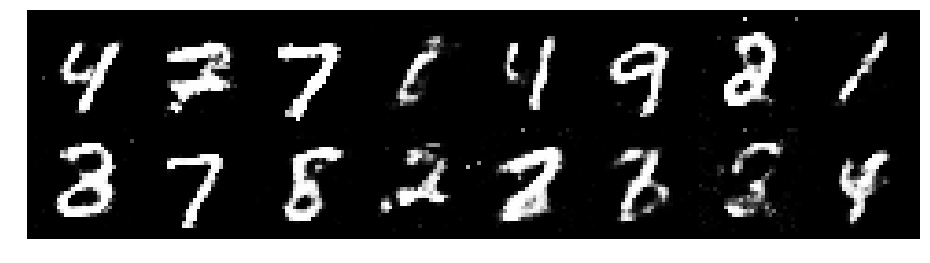

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.3806, Generator Loss: 1.0205
D(x): 0.5173, D(G(z)): 0.4208


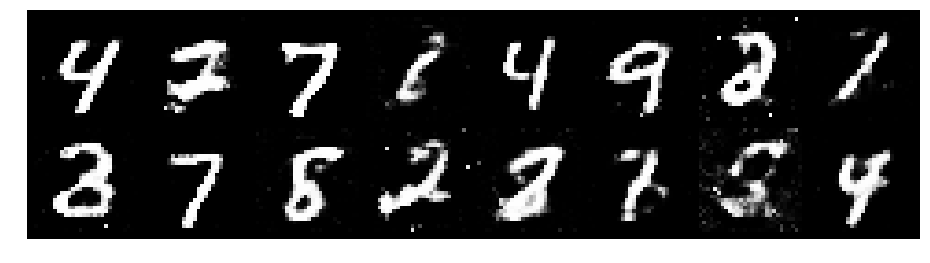

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.3472, Generator Loss: 0.8209
D(x): 0.6005, D(G(z)): 0.4962


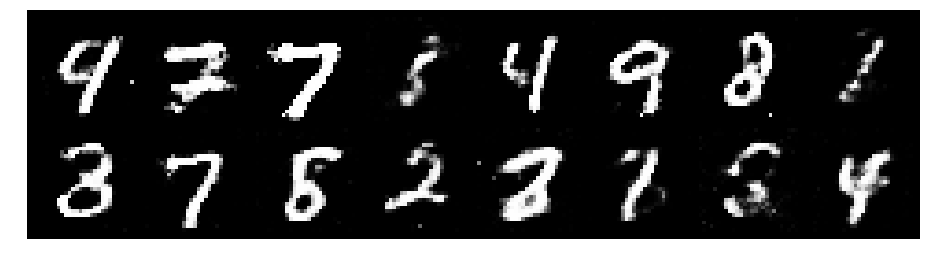

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.3230, Generator Loss: 0.8201
D(x): 0.5313, D(G(z)): 0.4540


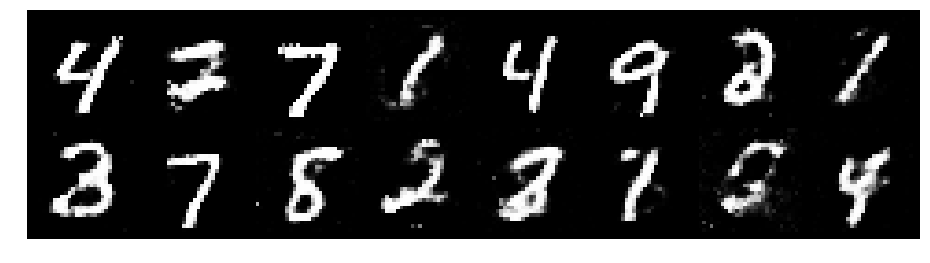

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.4090, Generator Loss: 0.7832
D(x): 0.5800, D(G(z)): 0.5061


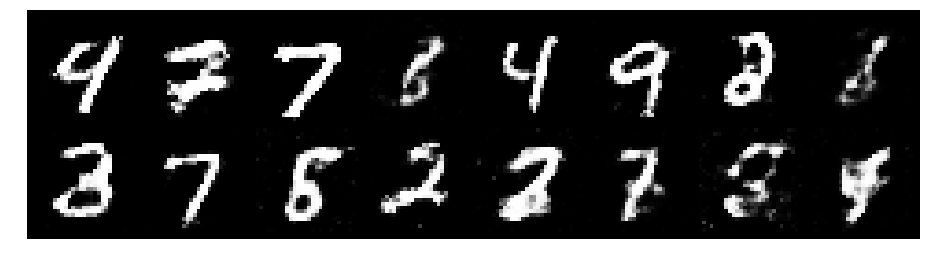

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.3032, Generator Loss: 0.9210
D(x): 0.5913, D(G(z)): 0.4803


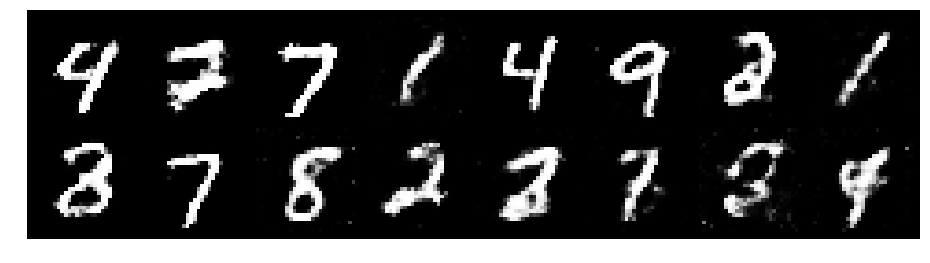

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.3040, Generator Loss: 0.9095
D(x): 0.5323, D(G(z)): 0.4396


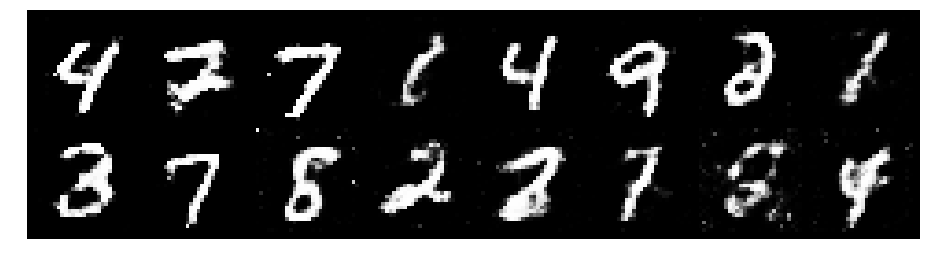

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.3703, Generator Loss: 1.0292
D(x): 0.5284, D(G(z)): 0.4233


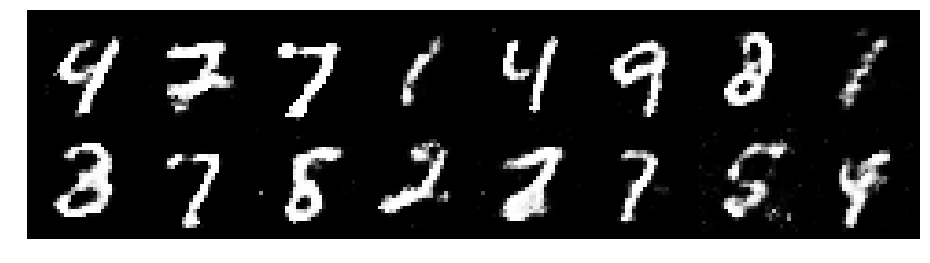

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.3596, Generator Loss: 0.9262
D(x): 0.5521, D(G(z)): 0.4305


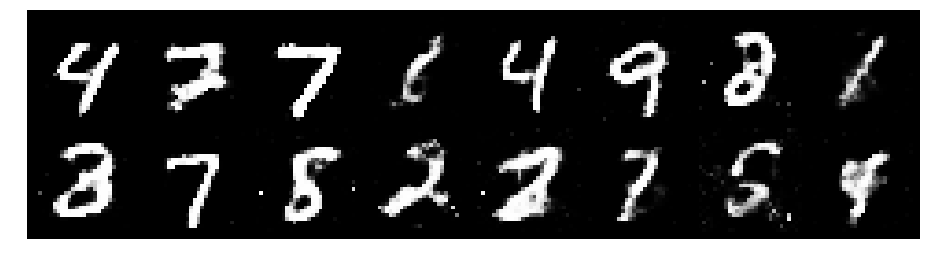

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.2633, Generator Loss: 0.9393
D(x): 0.5582, D(G(z)): 0.4162


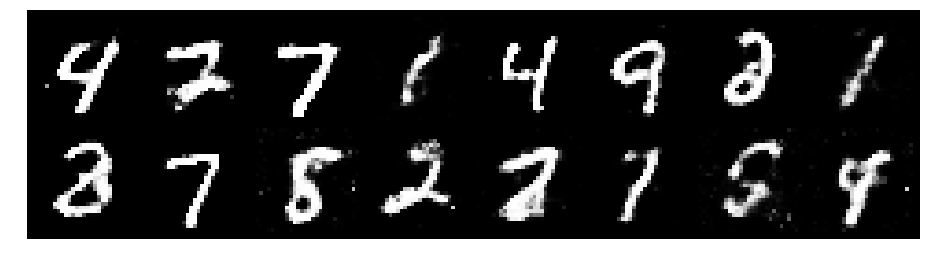

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.3566, Generator Loss: 0.8474
D(x): 0.5453, D(G(z)): 0.4356


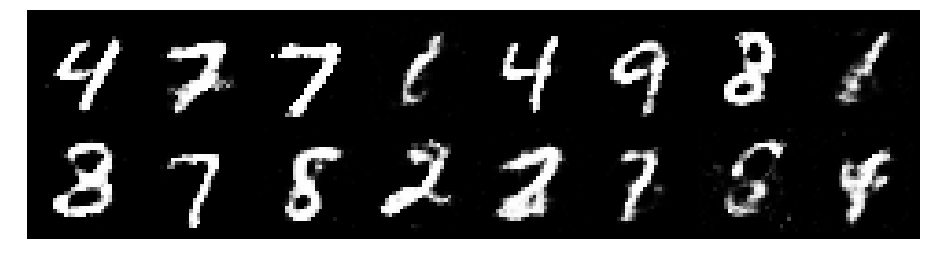

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.2124, Generator Loss: 1.0543
D(x): 0.5811, D(G(z)): 0.4014


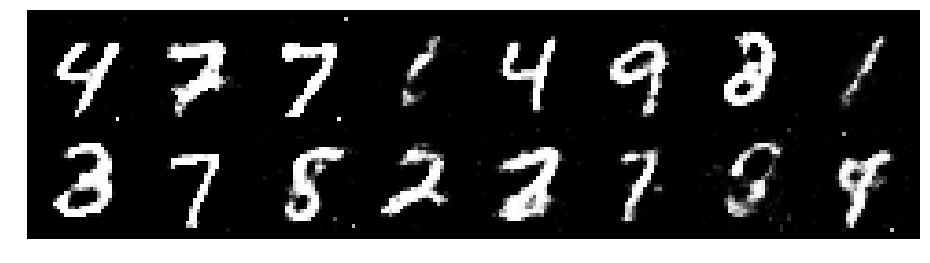

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.2488, Generator Loss: 0.8842
D(x): 0.5660, D(G(z)): 0.4167


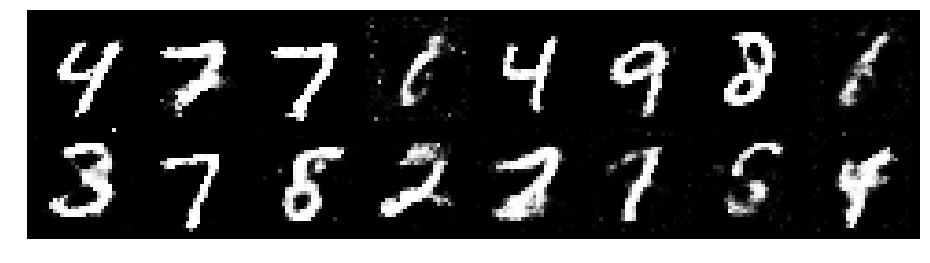

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.2420, Generator Loss: 0.9834
D(x): 0.5669, D(G(z)): 0.4133


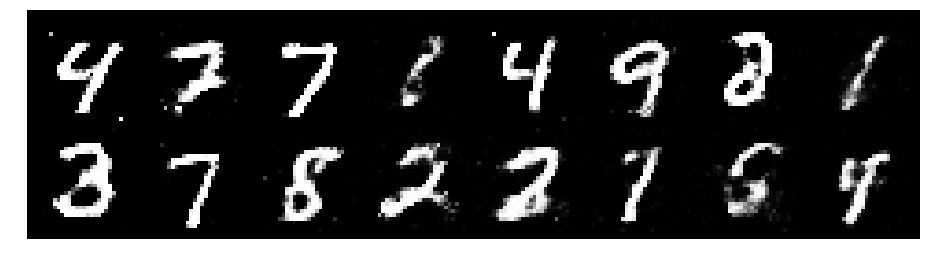

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.1391, Generator Loss: 1.0048
D(x): 0.5764, D(G(z)): 0.4013


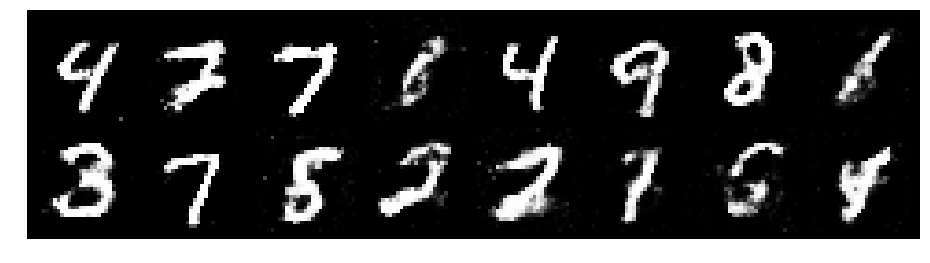

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.3047, Generator Loss: 0.8596
D(x): 0.5370, D(G(z)): 0.4531


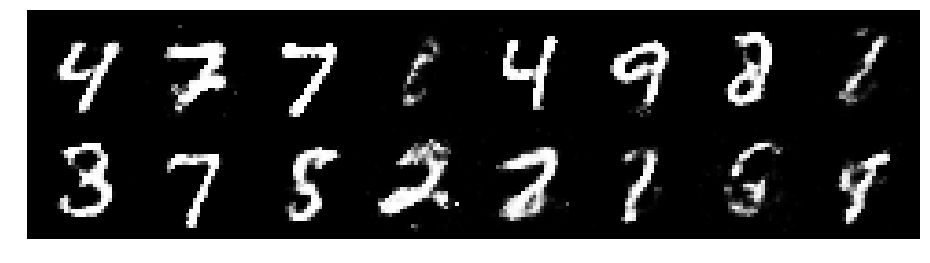

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.2828, Generator Loss: 0.8542
D(x): 0.5539, D(G(z)): 0.4655


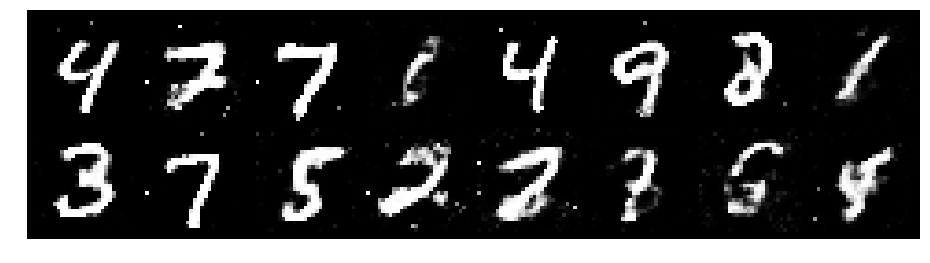

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.2648, Generator Loss: 0.8471
D(x): 0.5557, D(G(z)): 0.4478


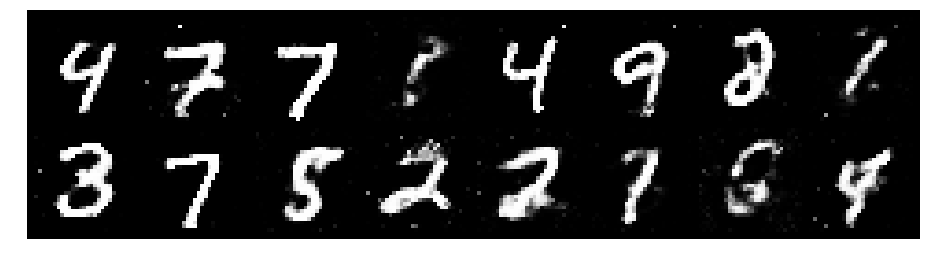

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.1770, Generator Loss: 0.8776
D(x): 0.5824, D(G(z)): 0.4315


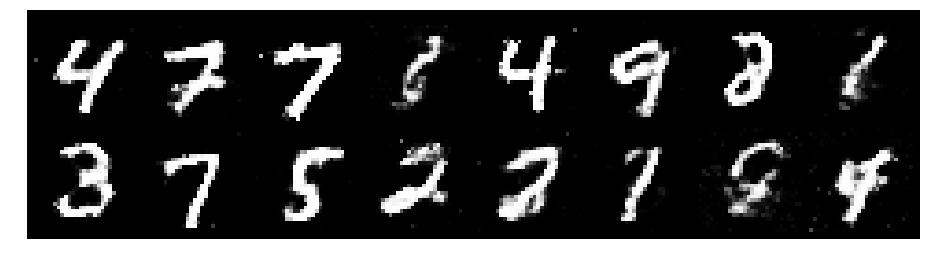

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.2847, Generator Loss: 0.9012
D(x): 0.5632, D(G(z)): 0.4493


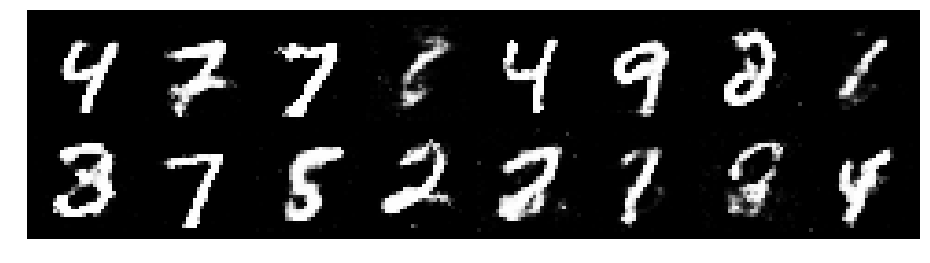

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.2924, Generator Loss: 0.8204
D(x): 0.5649, D(G(z)): 0.4732


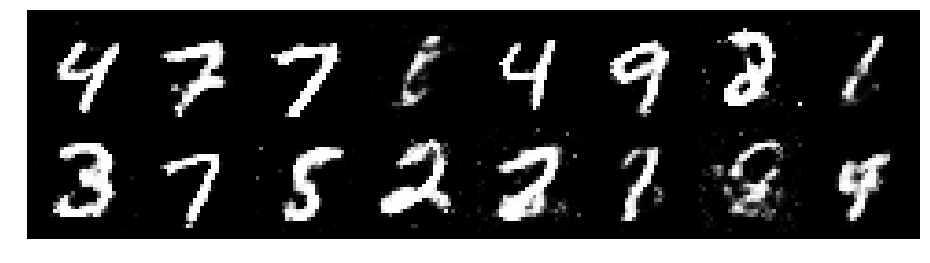

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.2727, Generator Loss: 0.8038
D(x): 0.6249, D(G(z)): 0.4879


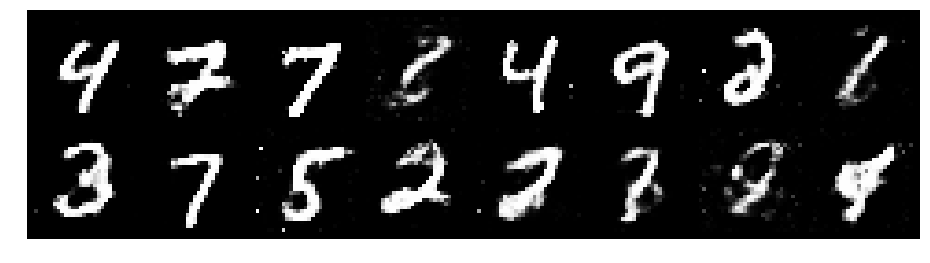

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.1905, Generator Loss: 1.1213
D(x): 0.5802, D(G(z)): 0.3984


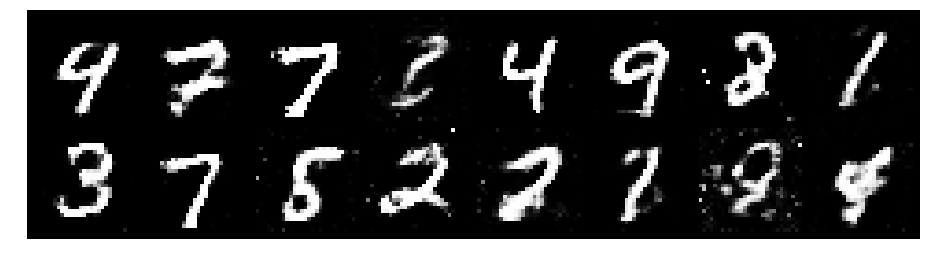

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.1228, Generator Loss: 1.1703
D(x): 0.5853, D(G(z)): 0.3921


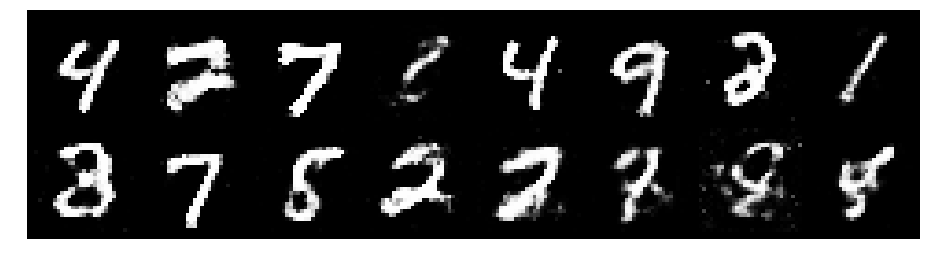

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.3175, Generator Loss: 0.8479
D(x): 0.6158, D(G(z)): 0.4944


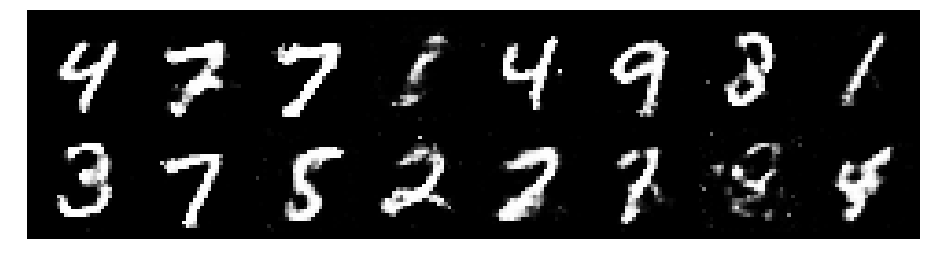

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.2411, Generator Loss: 1.0716
D(x): 0.5384, D(G(z)): 0.3842


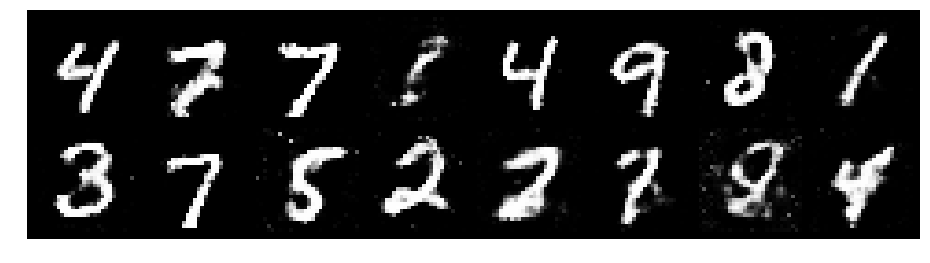

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.2101, Generator Loss: 1.0240
D(x): 0.5674, D(G(z)): 0.4087


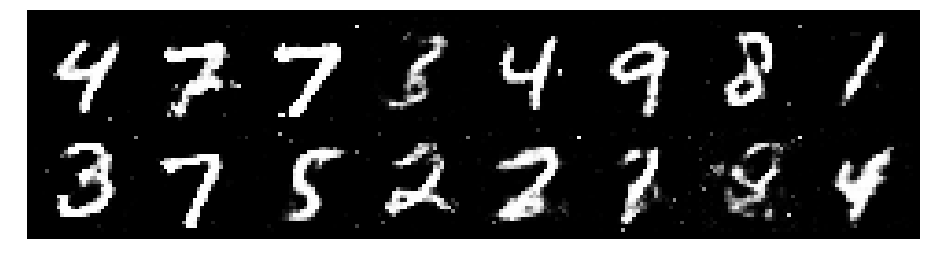

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.2355, Generator Loss: 0.9813
D(x): 0.5518, D(G(z)): 0.4300


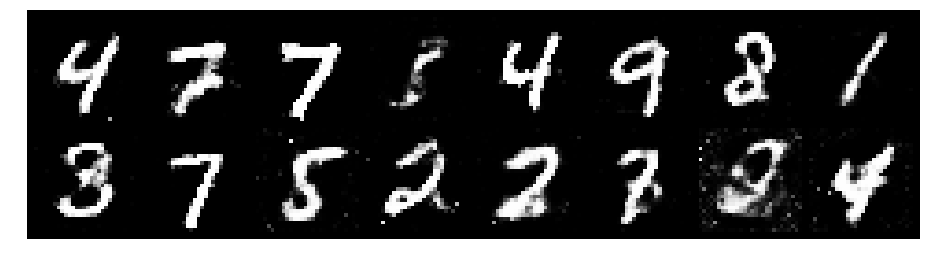

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.2517, Generator Loss: 0.8638
D(x): 0.5708, D(G(z)): 0.4413


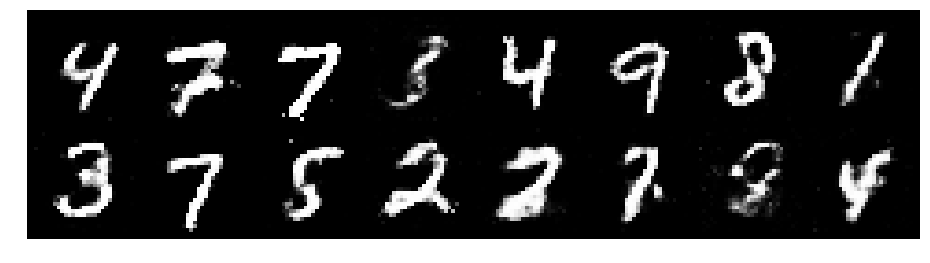

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.2309, Generator Loss: 1.0401
D(x): 0.5746, D(G(z)): 0.4264


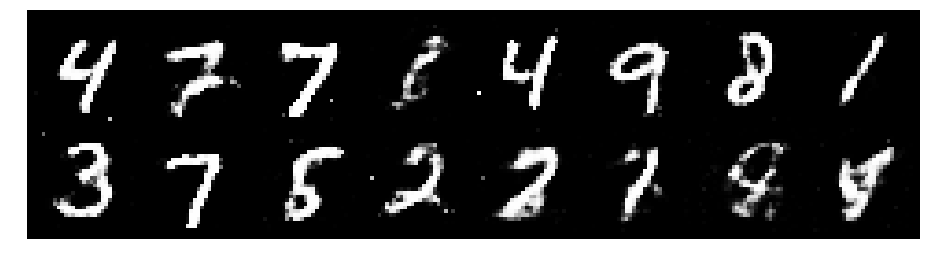

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.3984, Generator Loss: 0.8691
D(x): 0.5611, D(G(z)): 0.4766


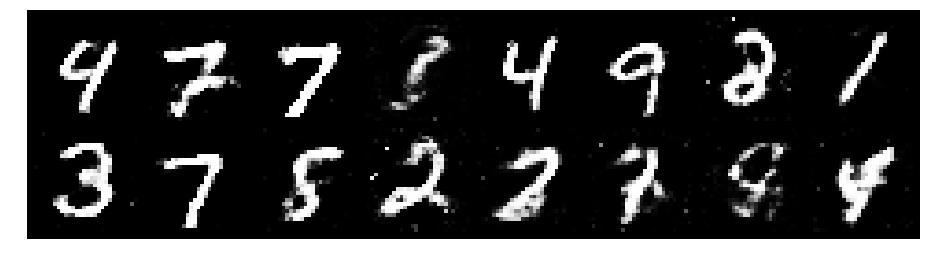

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.2678, Generator Loss: 1.1618
D(x): 0.6253, D(G(z)): 0.4603


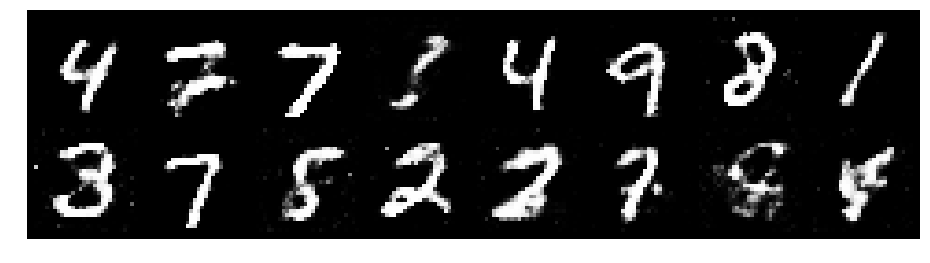

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.1913, Generator Loss: 0.9874
D(x): 0.5594, D(G(z)): 0.4018


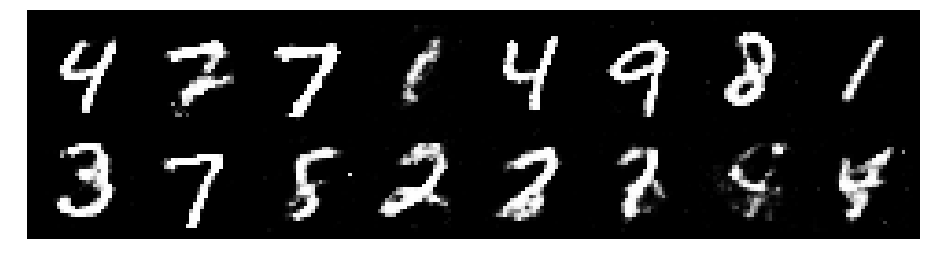

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.2766, Generator Loss: 0.8916
D(x): 0.5481, D(G(z)): 0.4521


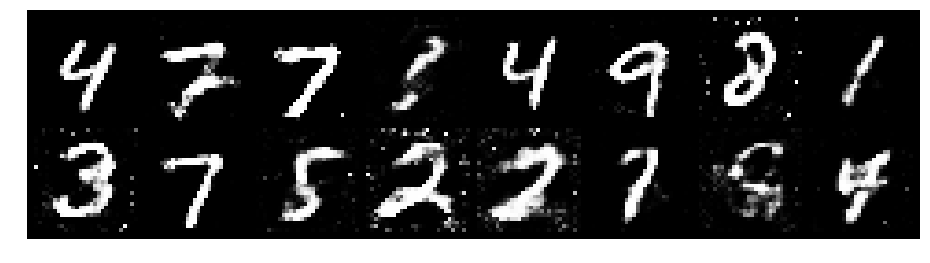

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.2206, Generator Loss: 0.9414
D(x): 0.5801, D(G(z)): 0.4242


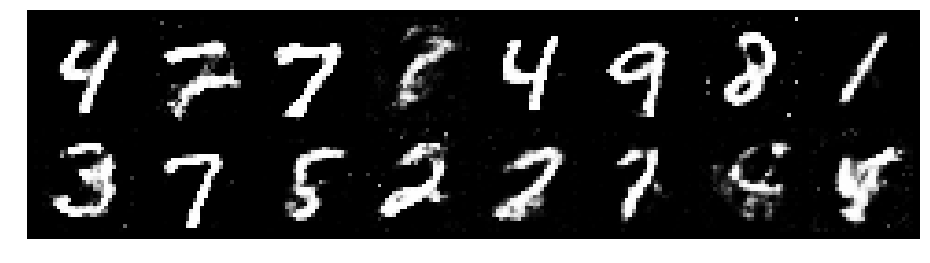

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.1417, Generator Loss: 1.2162
D(x): 0.5813, D(G(z)): 0.3795


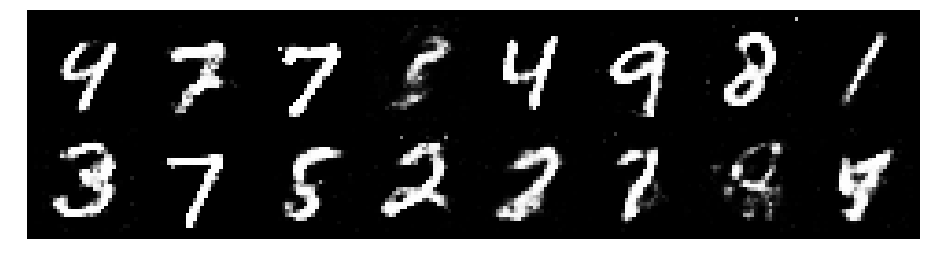

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.1301, Generator Loss: 1.1315
D(x): 0.5929, D(G(z)): 0.3875


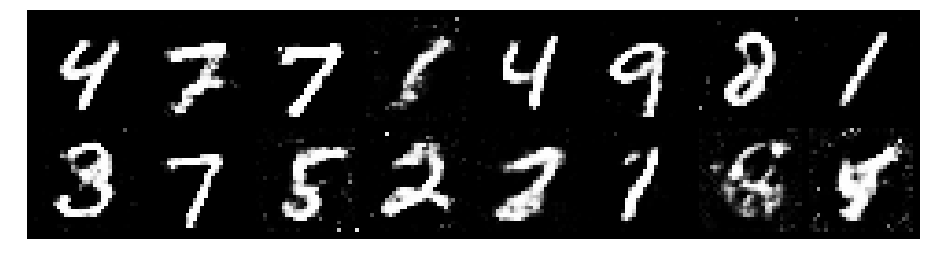

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.2275, Generator Loss: 0.9288
D(x): 0.5783, D(G(z)): 0.4411


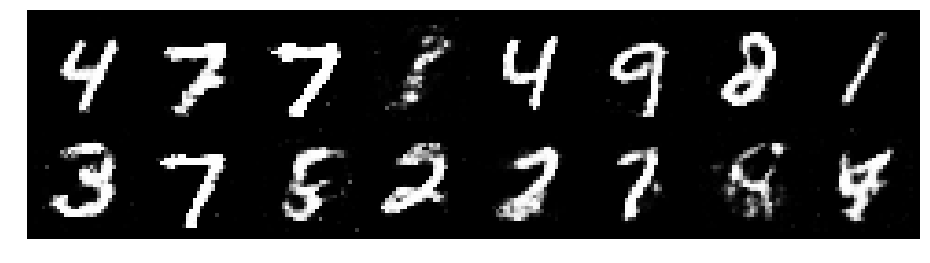

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.2106, Generator Loss: 0.8204
D(x): 0.5925, D(G(z)): 0.4539


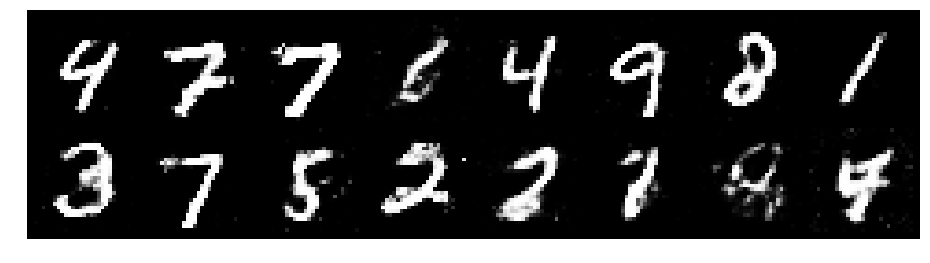

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.3047, Generator Loss: 0.8640
D(x): 0.5258, D(G(z)): 0.4413


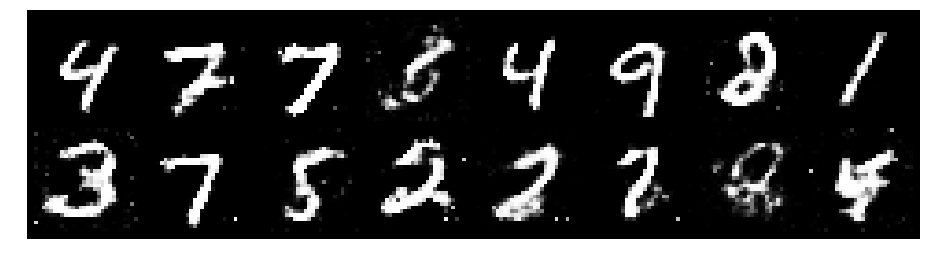

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.2217, Generator Loss: 0.7762
D(x): 0.5883, D(G(z)): 0.4610


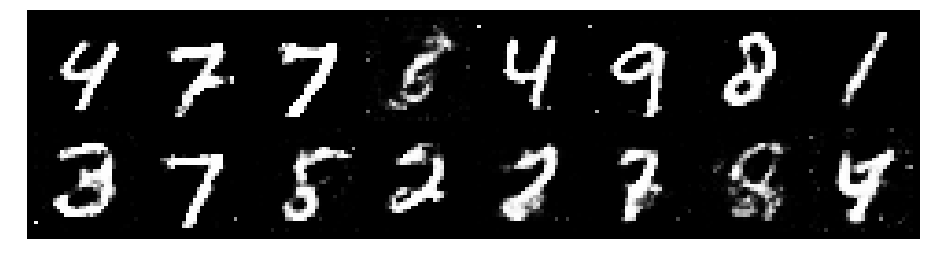

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.3138, Generator Loss: 0.8202
D(x): 0.5878, D(G(z)): 0.4909


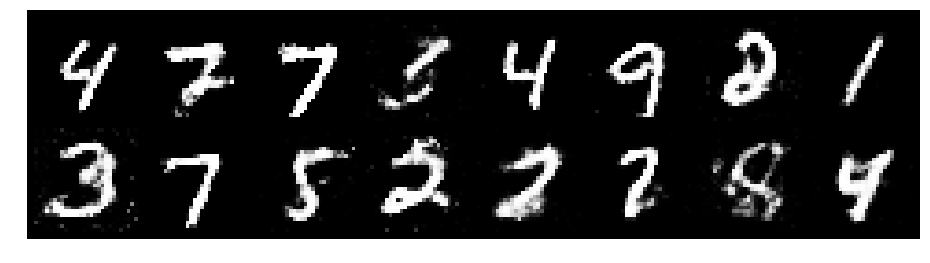

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.3420, Generator Loss: 0.8539
D(x): 0.5278, D(G(z)): 0.4483


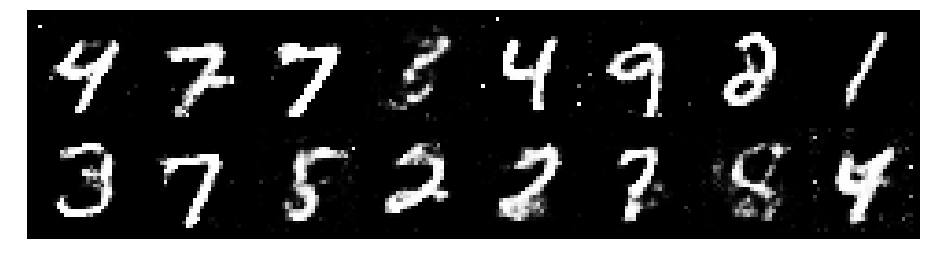

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.3017, Generator Loss: 0.8046
D(x): 0.5420, D(G(z)): 0.4555


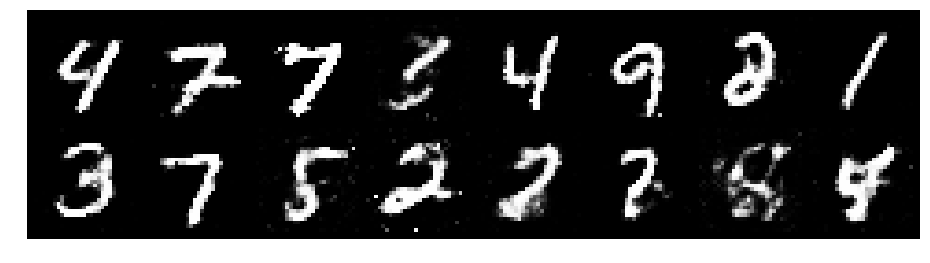

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.1759, Generator Loss: 0.9562
D(x): 0.5596, D(G(z)): 0.4129


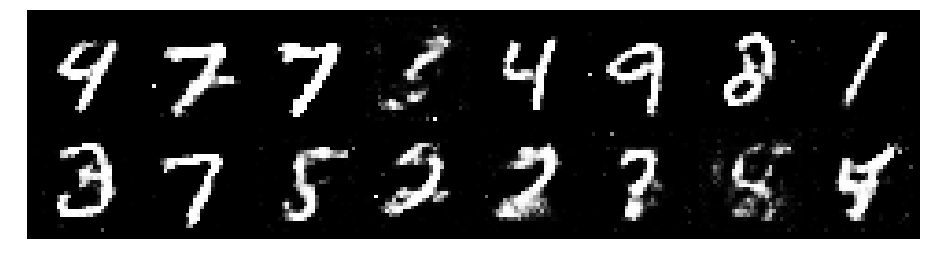

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.2115, Generator Loss: 0.9585
D(x): 0.5071, D(G(z)): 0.3716


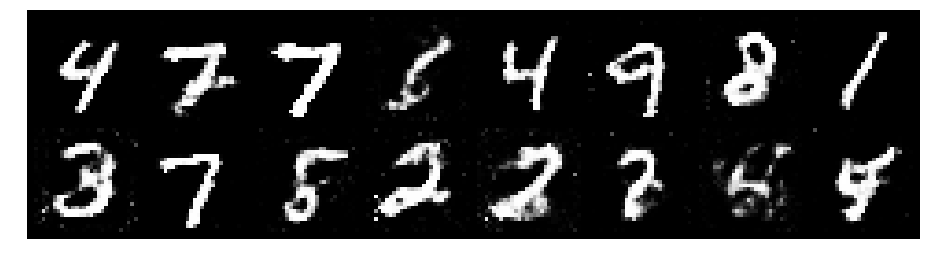

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.2519, Generator Loss: 0.8525
D(x): 0.5488, D(G(z)): 0.4443


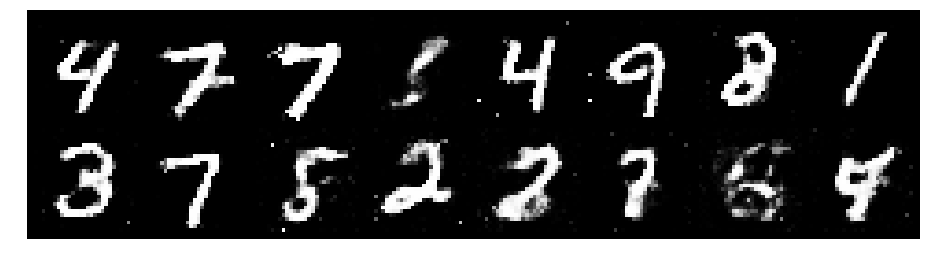

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.2800, Generator Loss: 0.9217
D(x): 0.5346, D(G(z)): 0.4379


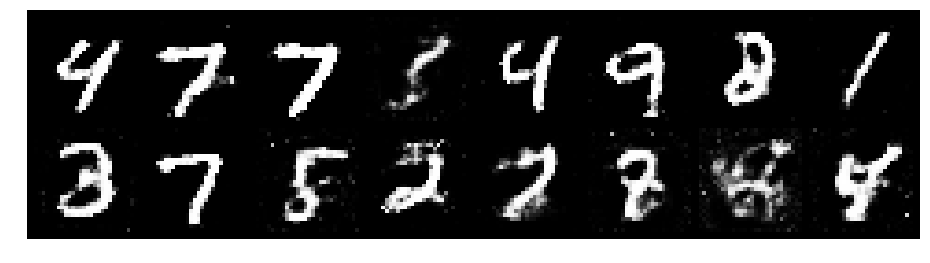

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.3110, Generator Loss: 0.7871
D(x): 0.5574, D(G(z)): 0.4537


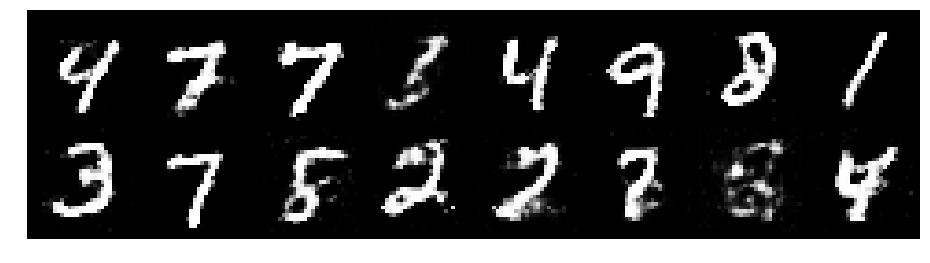

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.2633, Generator Loss: 0.9795
D(x): 0.5705, D(G(z)): 0.4451


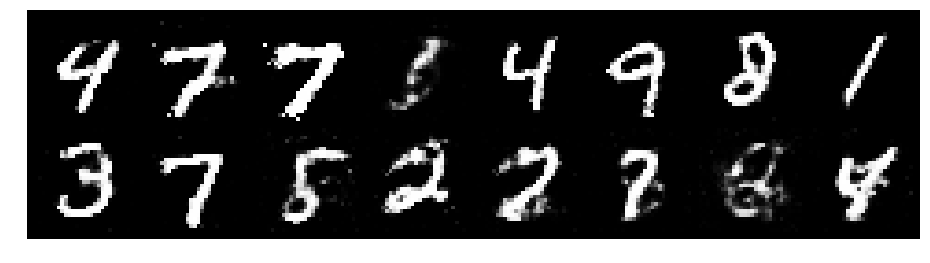

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.2017, Generator Loss: 1.0619
D(x): 0.5706, D(G(z)): 0.4028


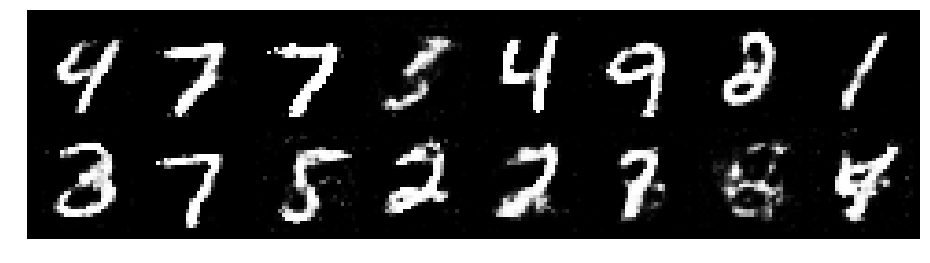

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.3988, Generator Loss: 0.9119
D(x): 0.5248, D(G(z)): 0.4541


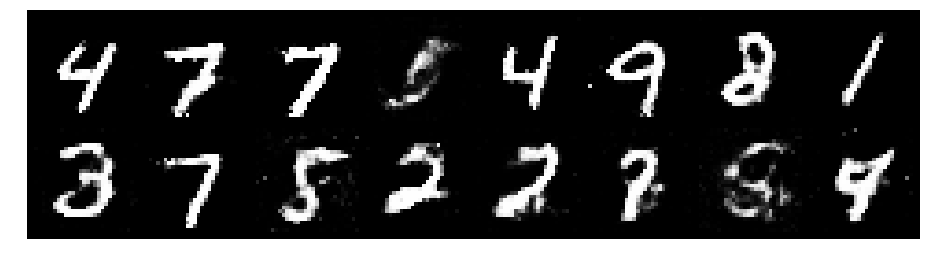

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.2446, Generator Loss: 0.9283
D(x): 0.5477, D(G(z)): 0.4251


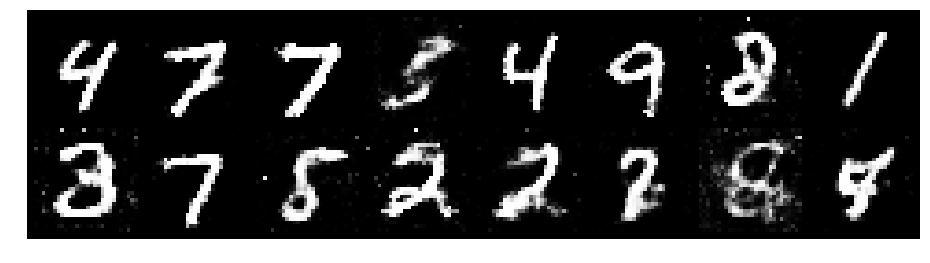

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.2004, Generator Loss: 0.8561
D(x): 0.5987, D(G(z)): 0.4515


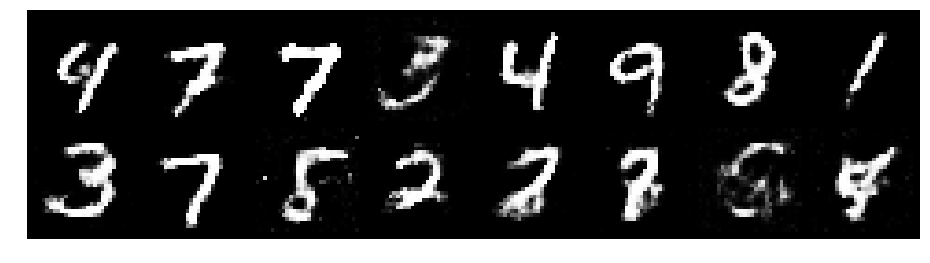

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.2323, Generator Loss: 0.9067
D(x): 0.6075, D(G(z)): 0.4529


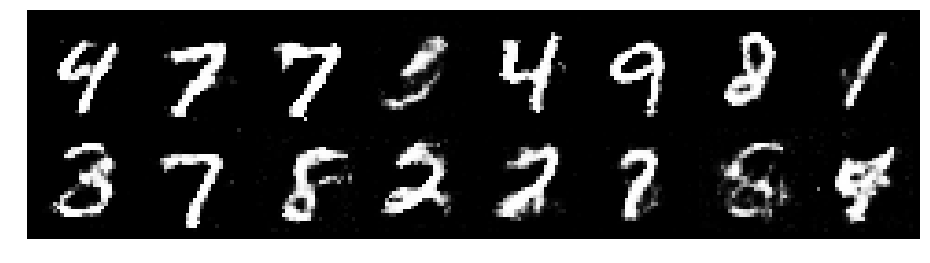

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.1966, Generator Loss: 0.9799
D(x): 0.5795, D(G(z)): 0.3903


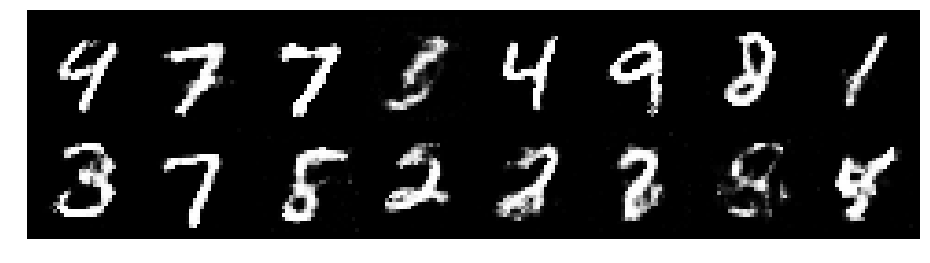

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.2420, Generator Loss: 0.9271
D(x): 0.5605, D(G(z)): 0.4243


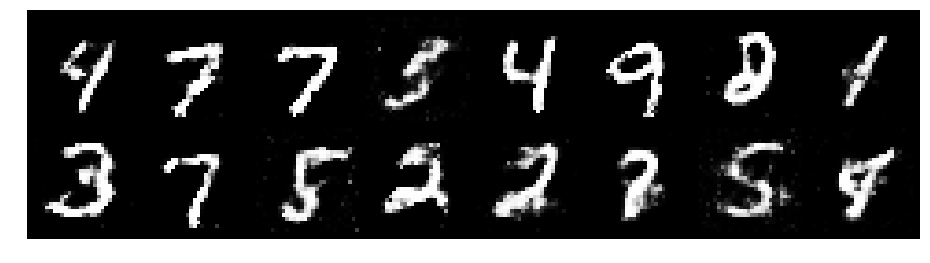

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.3059, Generator Loss: 0.9076
D(x): 0.5443, D(G(z)): 0.4555


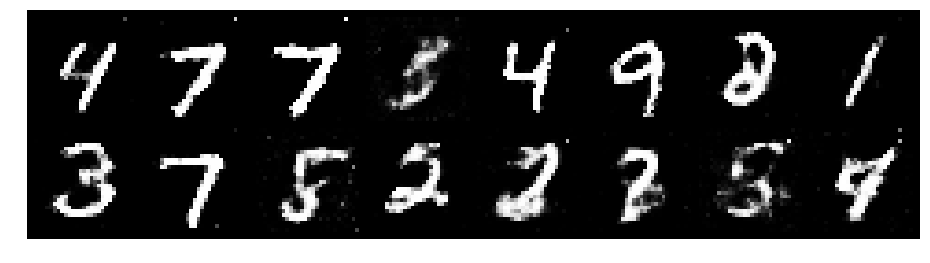

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.2332, Generator Loss: 0.9096
D(x): 0.5637, D(G(z)): 0.4367


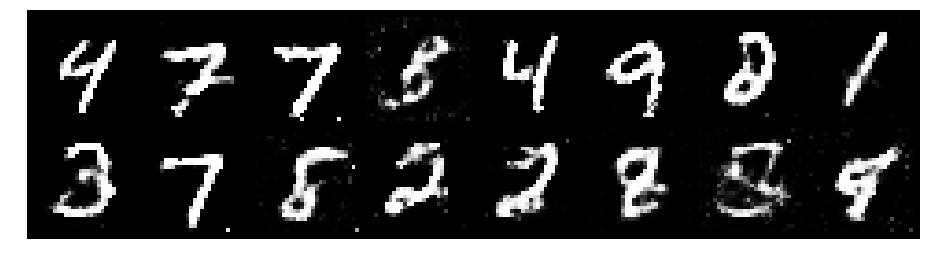

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.3180, Generator Loss: 0.8062
D(x): 0.5396, D(G(z)): 0.4656


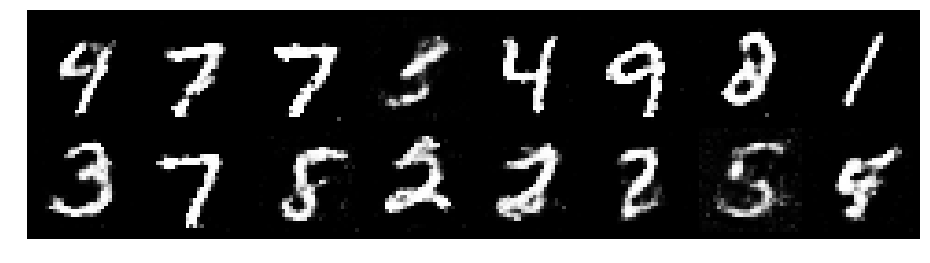

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.3670, Generator Loss: 0.8541
D(x): 0.5204, D(G(z)): 0.4653


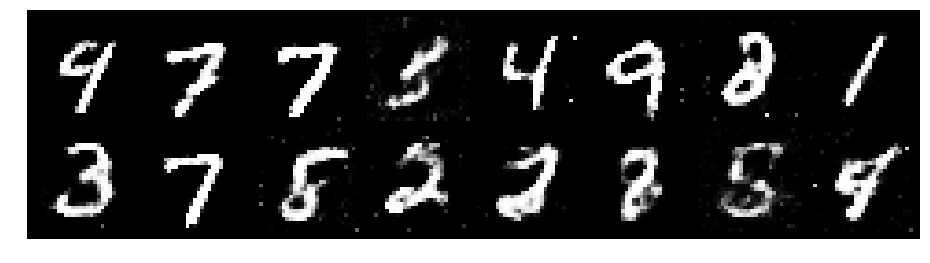

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.3711, Generator Loss: 0.9355
D(x): 0.5144, D(G(z)): 0.4455


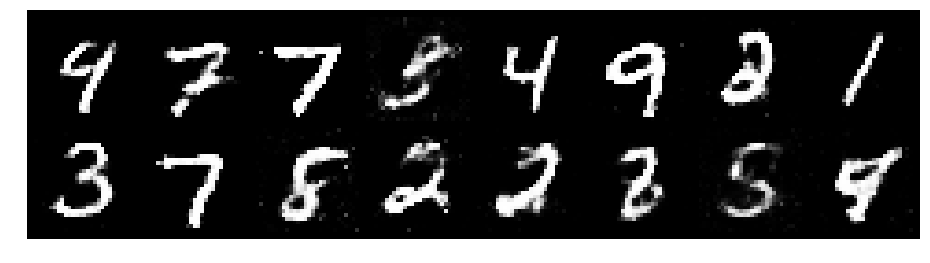

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.3237, Generator Loss: 0.8766
D(x): 0.5140, D(G(z)): 0.4164


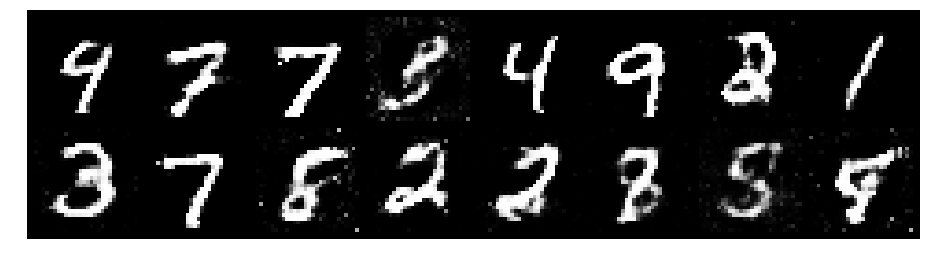

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.2621, Generator Loss: 0.9395
D(x): 0.5504, D(G(z)): 0.4349


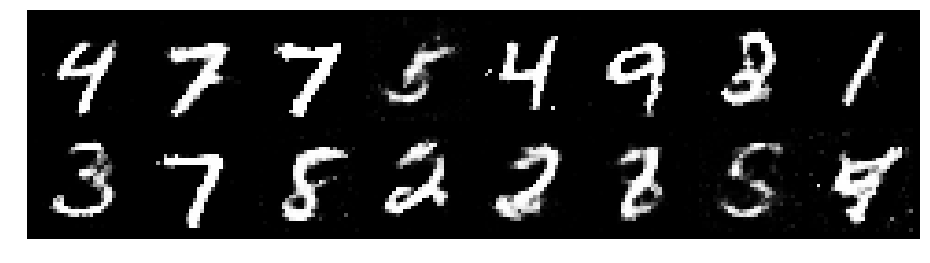

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.2357, Generator Loss: 0.8016
D(x): 0.5639, D(G(z)): 0.4487


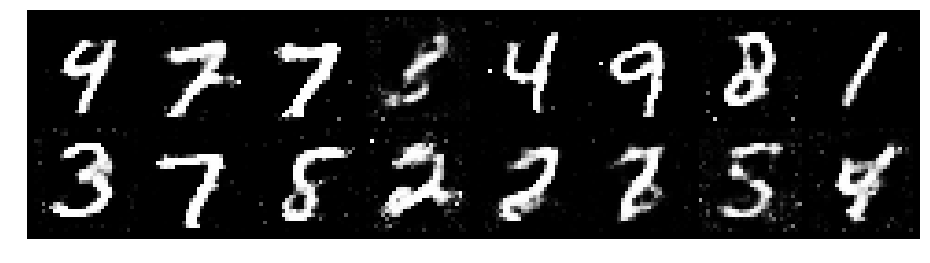

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.3301, Generator Loss: 0.8351
D(x): 0.5170, D(G(z)): 0.4328


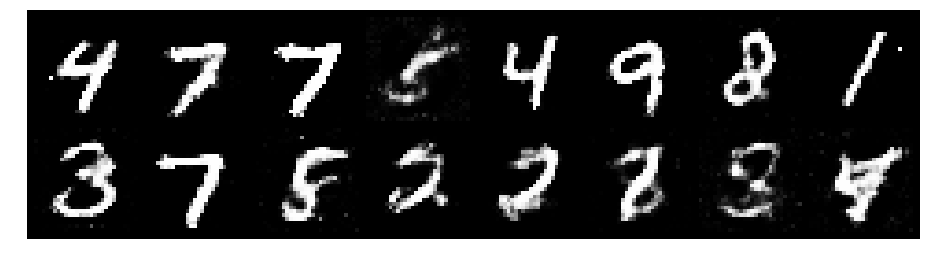

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.1365, Generator Loss: 0.7954
D(x): 0.6065, D(G(z)): 0.4335


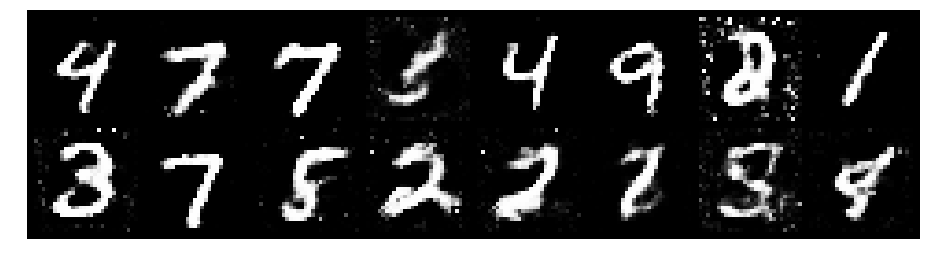

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.3208, Generator Loss: 0.8259
D(x): 0.5462, D(G(z)): 0.4675


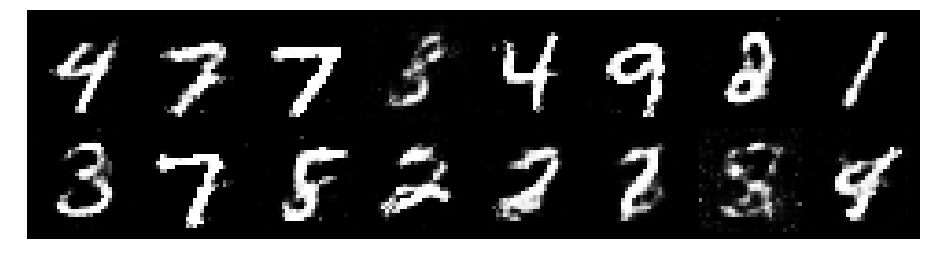

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.1944, Generator Loss: 1.0811
D(x): 0.5603, D(G(z)): 0.4044


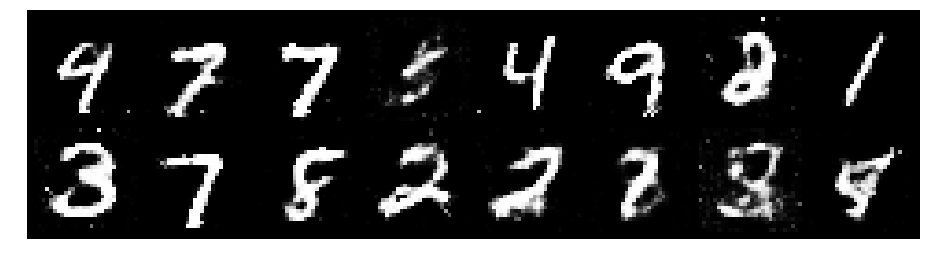

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.1759, Generator Loss: 0.8044
D(x): 0.5800, D(G(z)): 0.4416


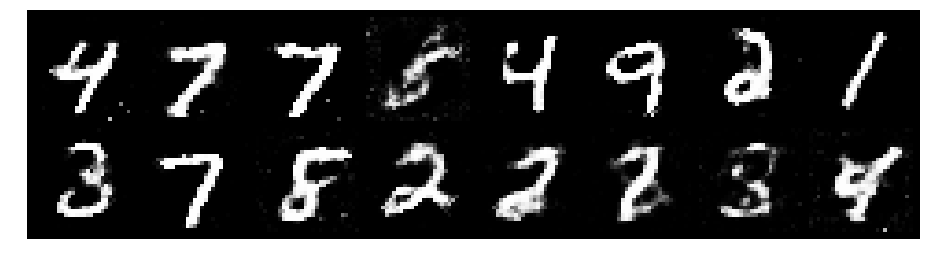

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.2345, Generator Loss: 0.9434
D(x): 0.5553, D(G(z)): 0.4318


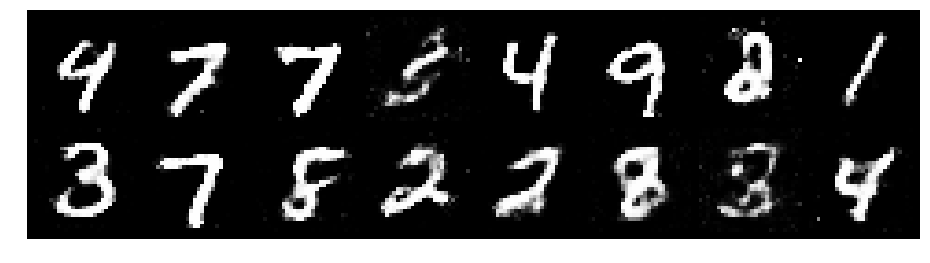

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.2546, Generator Loss: 0.8749
D(x): 0.5420, D(G(z)): 0.4066


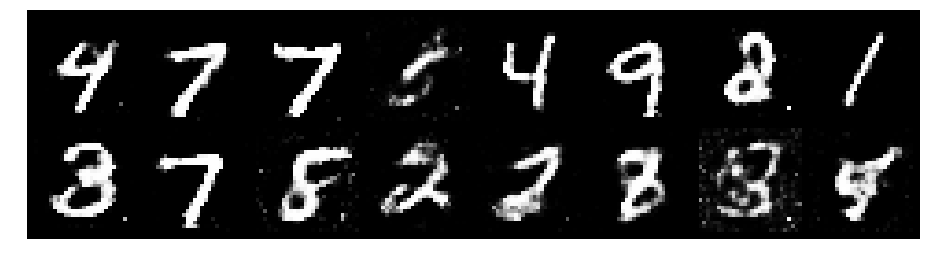

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.1841, Generator Loss: 1.1760
D(x): 0.5917, D(G(z)): 0.4023


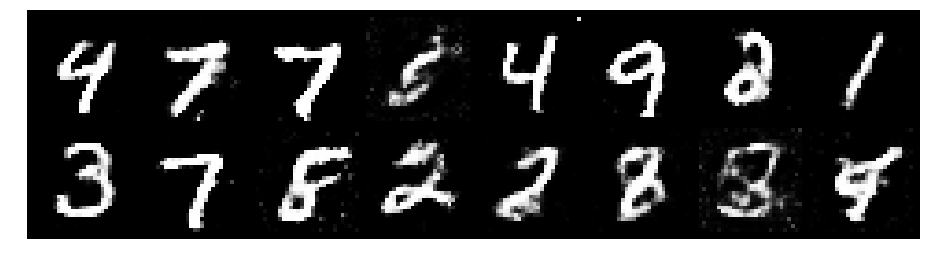

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.1327, Generator Loss: 1.1151
D(x): 0.6049, D(G(z)): 0.4003


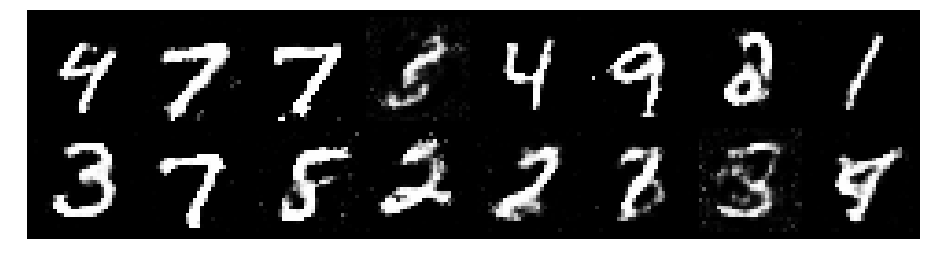

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.2617, Generator Loss: 0.9856
D(x): 0.5511, D(G(z)): 0.4328


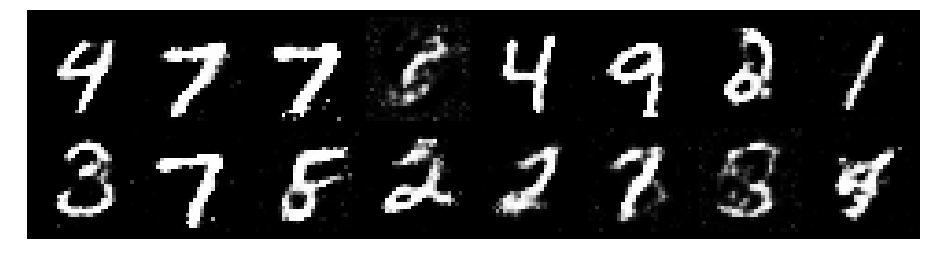

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.4473, Generator Loss: 1.0549
D(x): 0.5513, D(G(z)): 0.4659


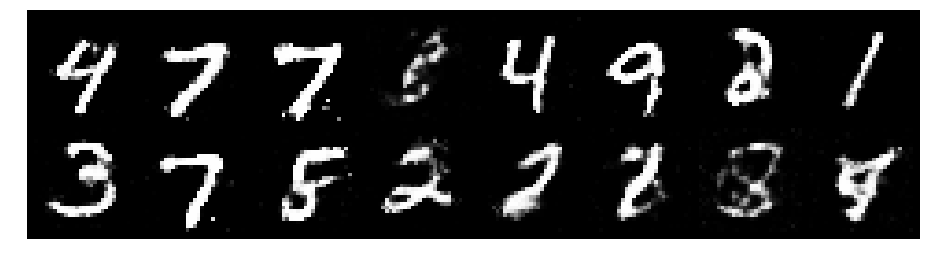

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.3521, Generator Loss: 0.7890
D(x): 0.5662, D(G(z)): 0.4910


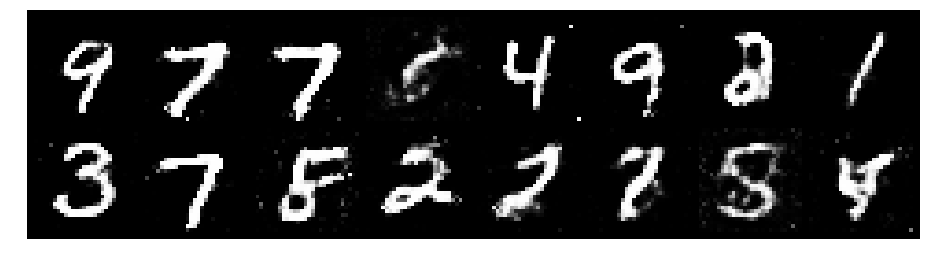

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.3134, Generator Loss: 0.9911
D(x): 0.5467, D(G(z)): 0.4479


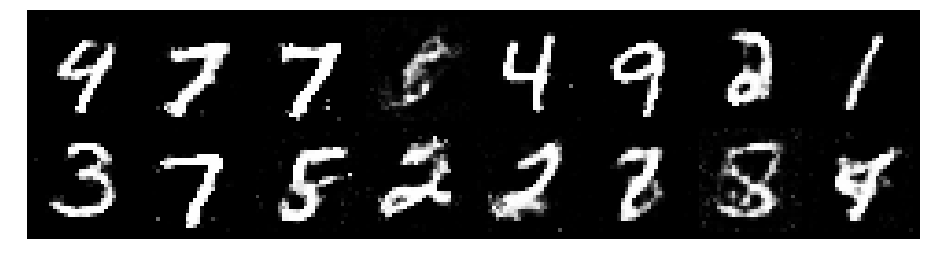

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.1880, Generator Loss: 0.9516
D(x): 0.6275, D(G(z)): 0.4281


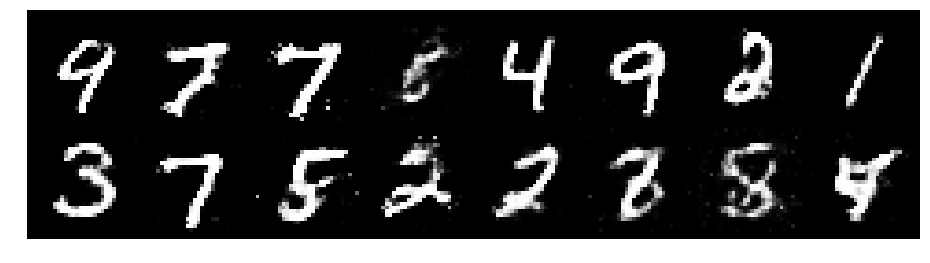

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.2707, Generator Loss: 0.8688
D(x): 0.5819, D(G(z)): 0.4587


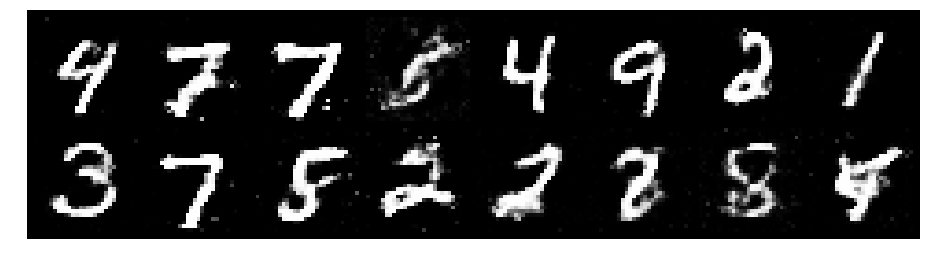

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.3265, Generator Loss: 0.7823
D(x): 0.5825, D(G(z)): 0.4899


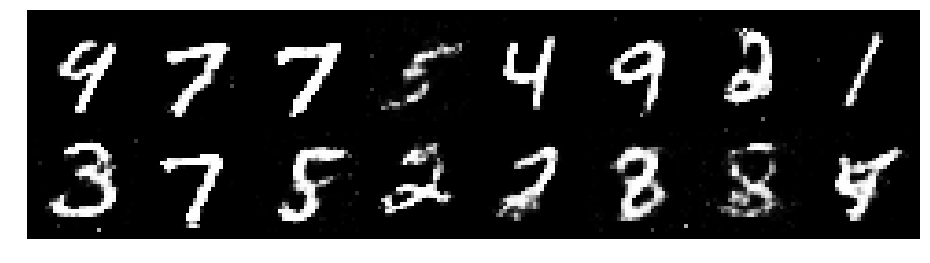

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.3560, Generator Loss: 0.9329
D(x): 0.5225, D(G(z)): 0.4366


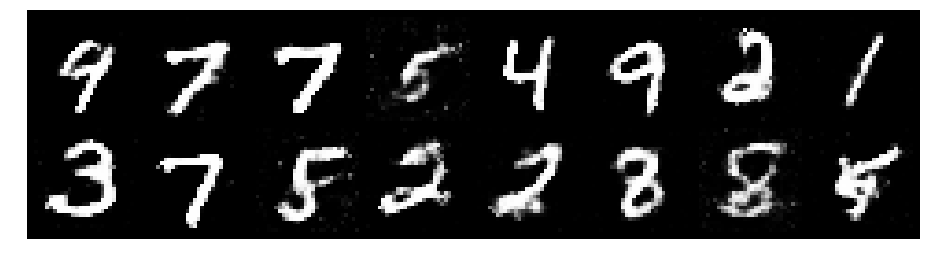

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.2297, Generator Loss: 0.9343
D(x): 0.5533, D(G(z)): 0.4015


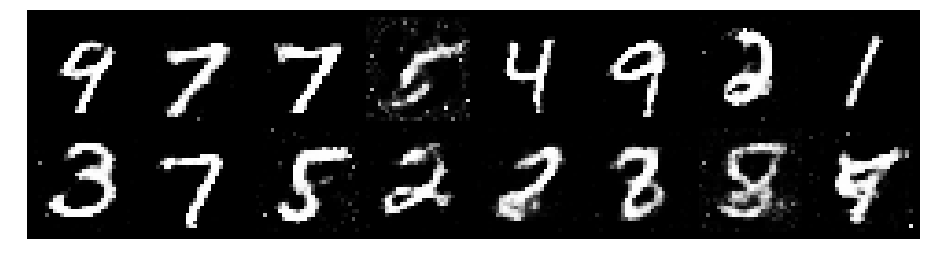

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.3220, Generator Loss: 0.8317
D(x): 0.5846, D(G(z)): 0.4908


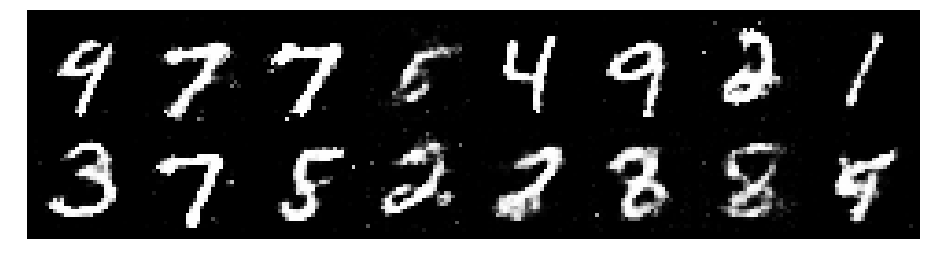

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.2705, Generator Loss: 0.9105
D(x): 0.5203, D(G(z)): 0.4125


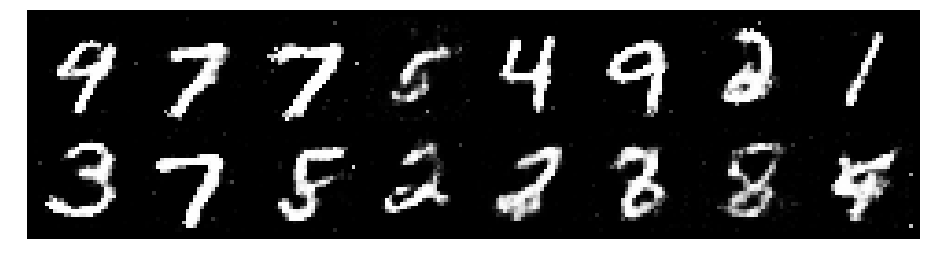

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.2586, Generator Loss: 0.8603
D(x): 0.5470, D(G(z)): 0.4526


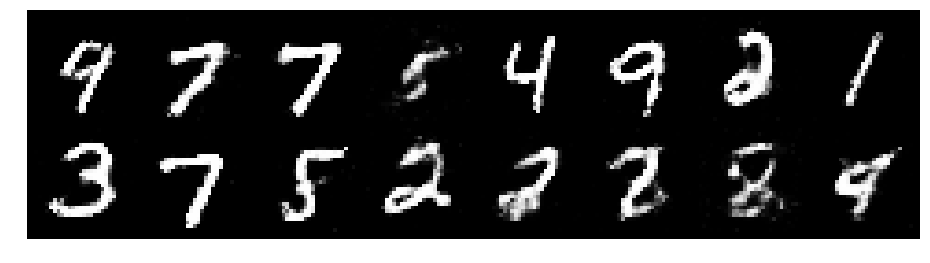

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.3499, Generator Loss: 0.7864
D(x): 0.5103, D(G(z)): 0.4603


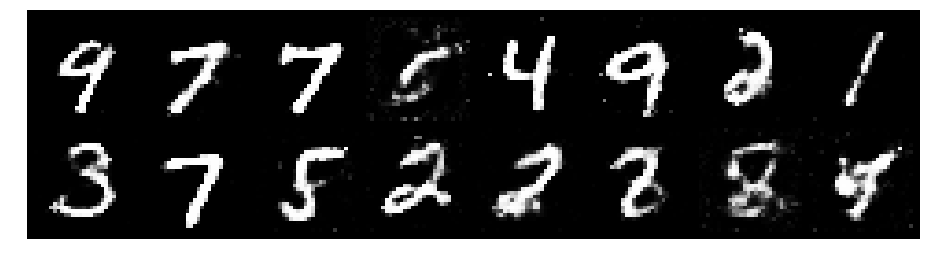

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.3983, Generator Loss: 0.8622
D(x): 0.5212, D(G(z)): 0.4676


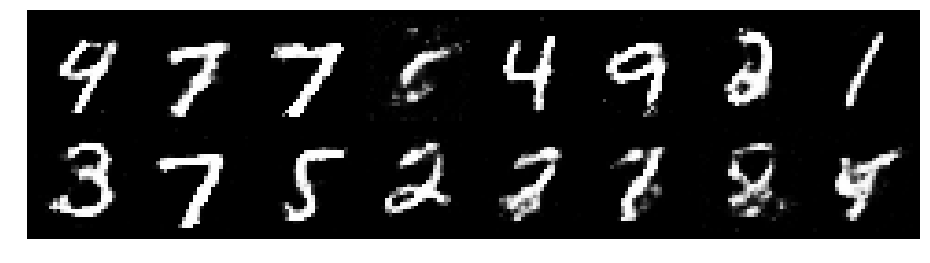

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.2812, Generator Loss: 0.9081
D(x): 0.5390, D(G(z)): 0.4459


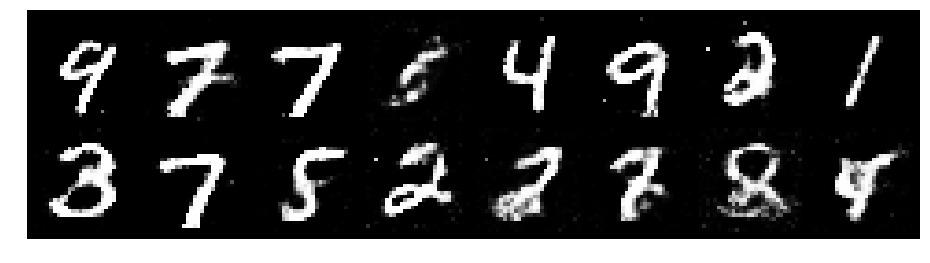

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.2913, Generator Loss: 0.8392
D(x): 0.5490, D(G(z)): 0.4399


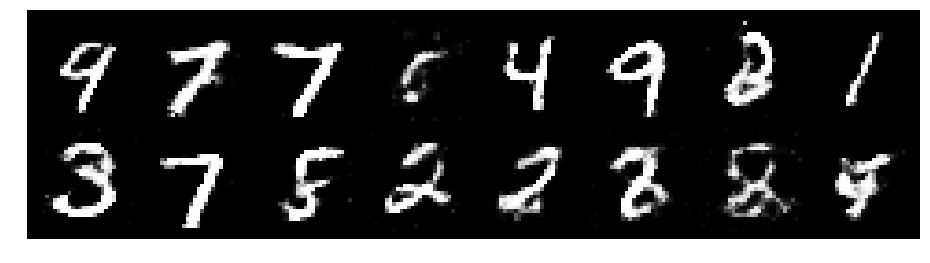

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.2692, Generator Loss: 0.8840
D(x): 0.6109, D(G(z)): 0.4820


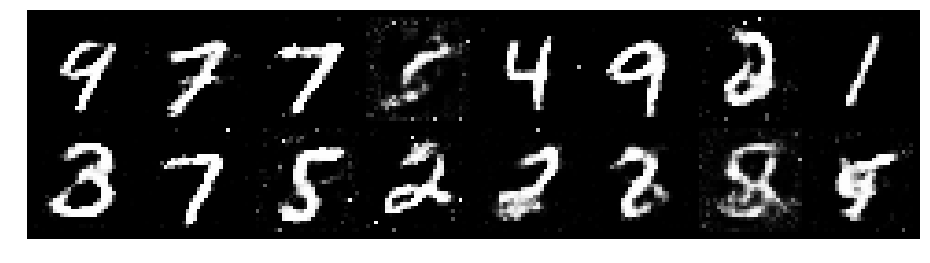

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.3021, Generator Loss: 0.8520
D(x): 0.5235, D(G(z)): 0.4390


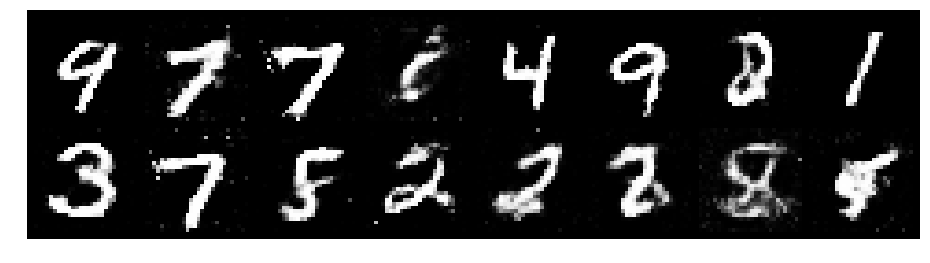

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.2214, Generator Loss: 0.9293
D(x): 0.5682, D(G(z)): 0.4233


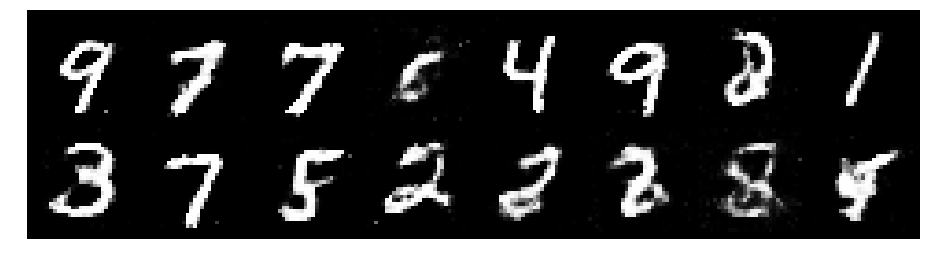

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.3948, Generator Loss: 0.8397
D(x): 0.5153, D(G(z)): 0.4793


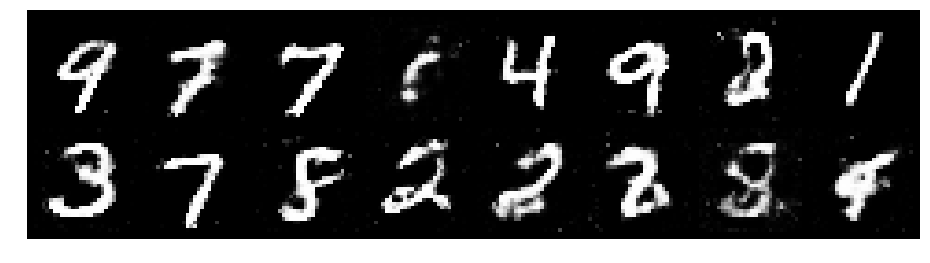

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.3922, Generator Loss: 0.8979
D(x): 0.5396, D(G(z)): 0.4755


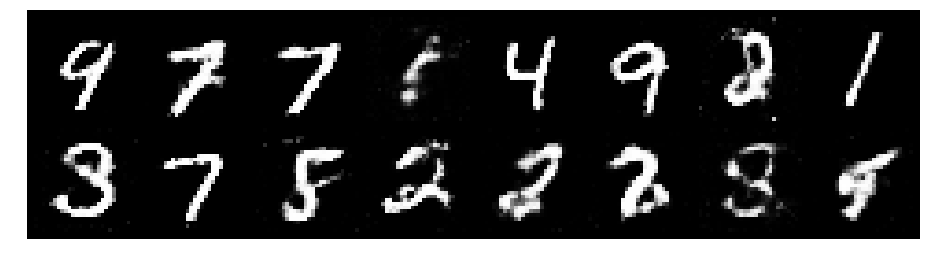

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.2482, Generator Loss: 0.9006
D(x): 0.5551, D(G(z)): 0.4409


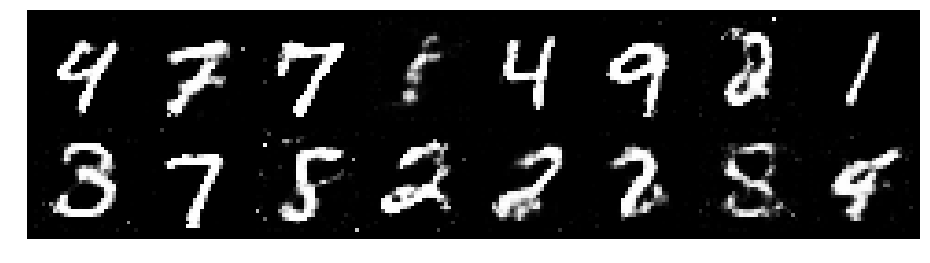

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.2266, Generator Loss: 0.8908
D(x): 0.5706, D(G(z)): 0.4435


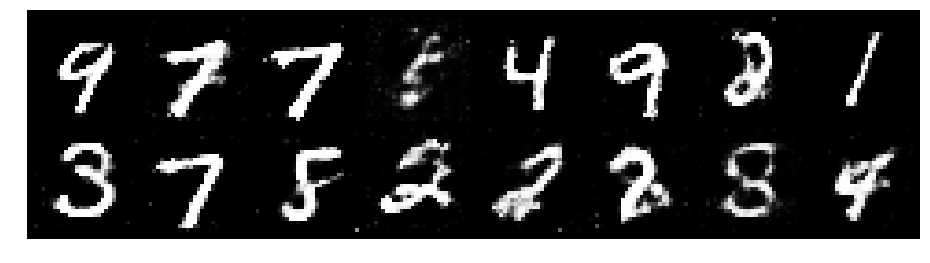

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.1795, Generator Loss: 1.0611
D(x): 0.5594, D(G(z)): 0.3945


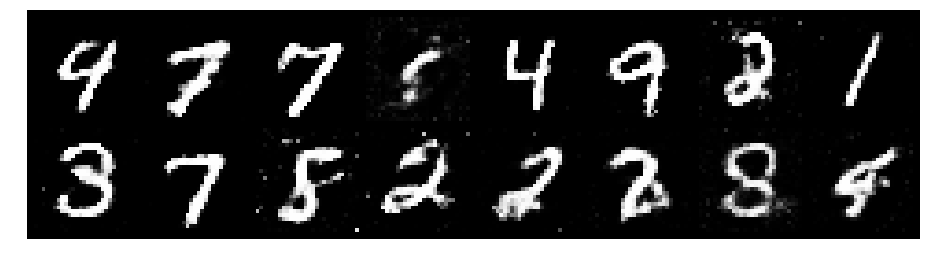

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.1789, Generator Loss: 0.9213
D(x): 0.6034, D(G(z)): 0.4362


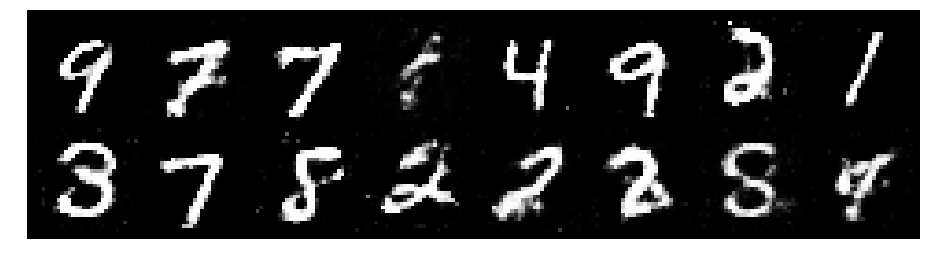

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.2055, Generator Loss: 0.9429
D(x): 0.6075, D(G(z)): 0.4351


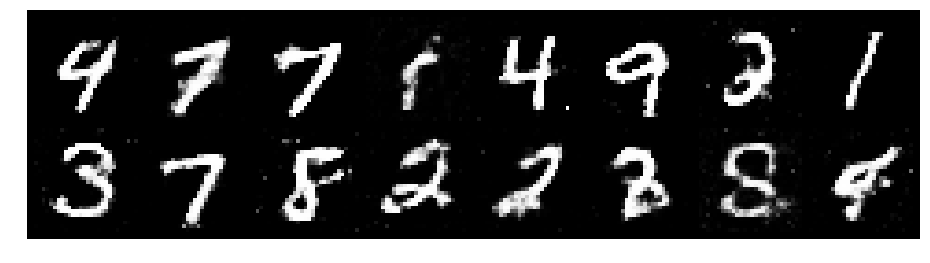

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.3667, Generator Loss: 0.8897
D(x): 0.5679, D(G(z)): 0.4739


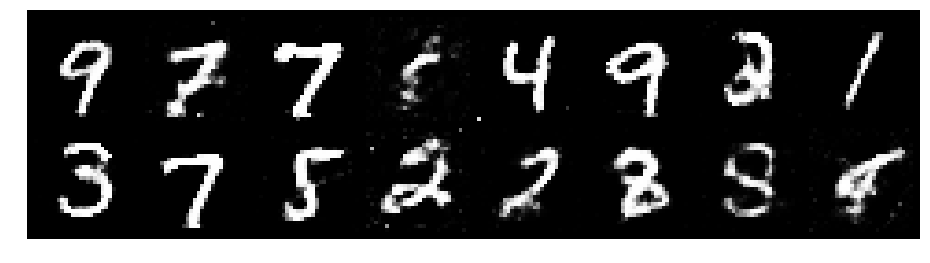

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.3228, Generator Loss: 0.8206
D(x): 0.5506, D(G(z)): 0.4782


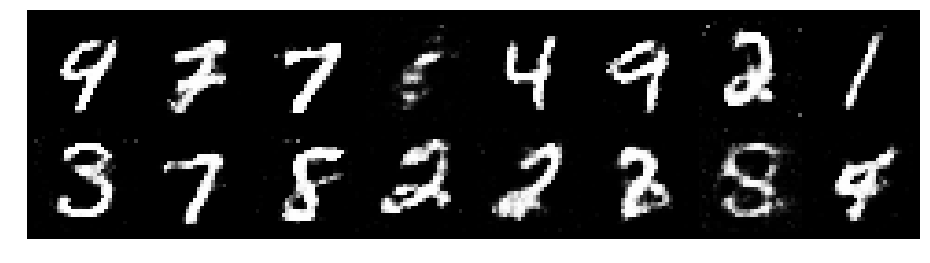

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.2780, Generator Loss: 0.8280
D(x): 0.5575, D(G(z)): 0.4653


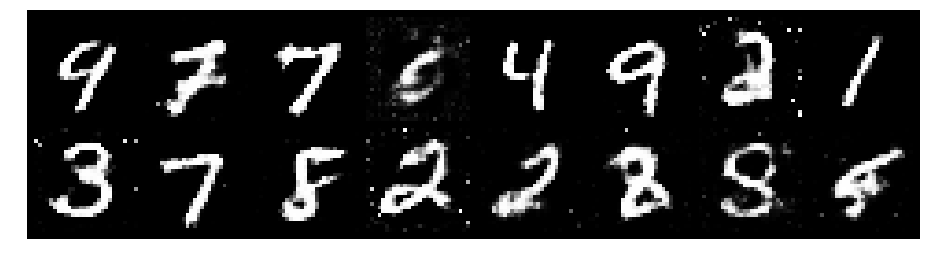

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.2665, Generator Loss: 0.9331
D(x): 0.5269, D(G(z)): 0.4151


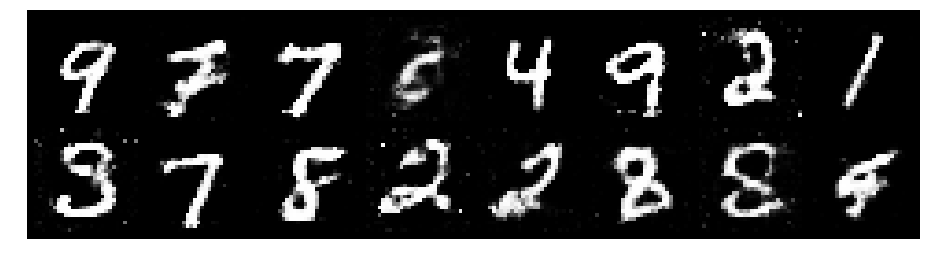

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.2071, Generator Loss: 0.9490
D(x): 0.5566, D(G(z)): 0.4044


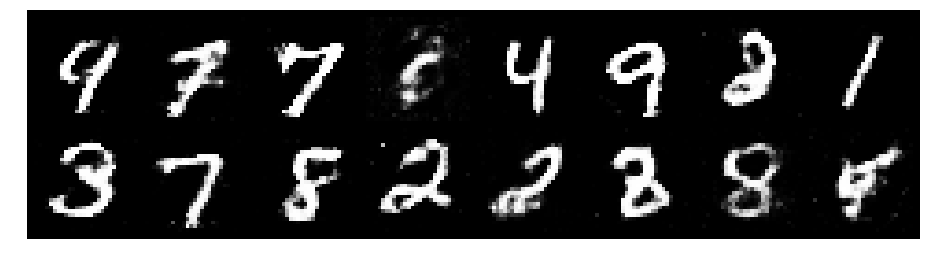

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.2032, Generator Loss: 0.8521
D(x): 0.5820, D(G(z)): 0.4270


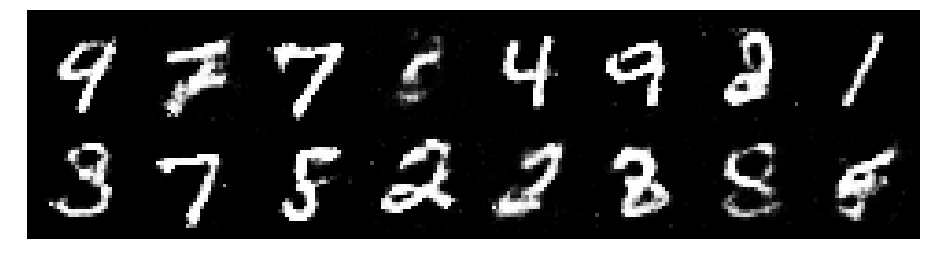

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.2701, Generator Loss: 0.8225
D(x): 0.5466, D(G(z)): 0.4529


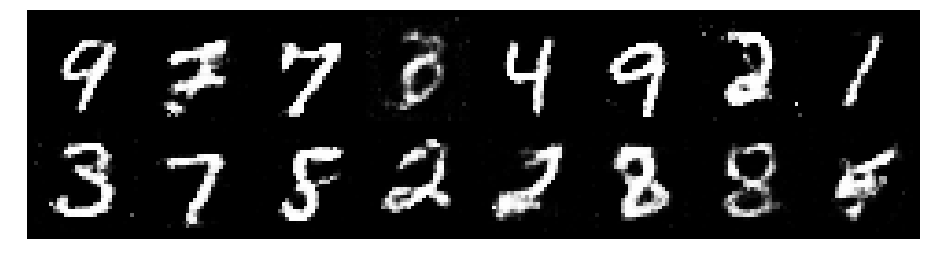

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.2779, Generator Loss: 0.7829
D(x): 0.5980, D(G(z)): 0.4968


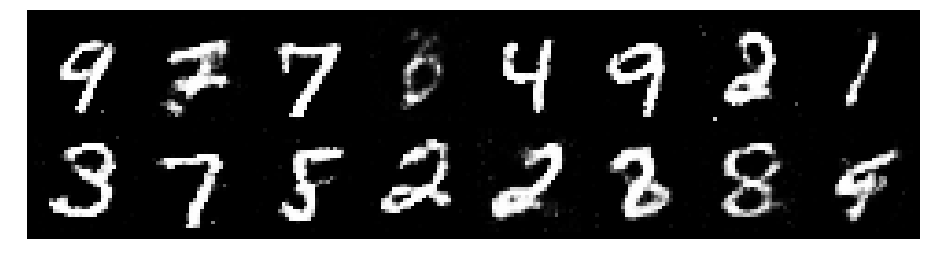

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.3046, Generator Loss: 0.8351
D(x): 0.5300, D(G(z)): 0.4564


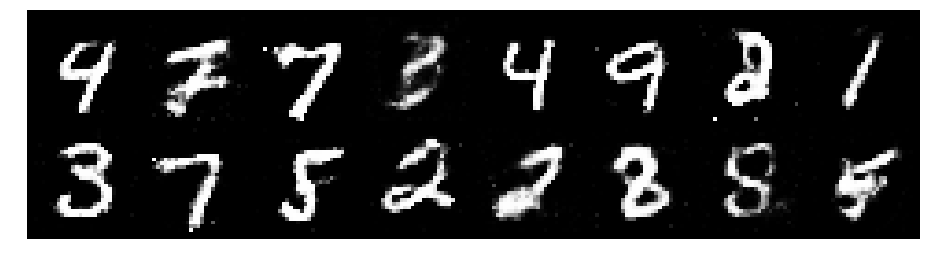

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.2250, Generator Loss: 0.9322
D(x): 0.5503, D(G(z)): 0.4239


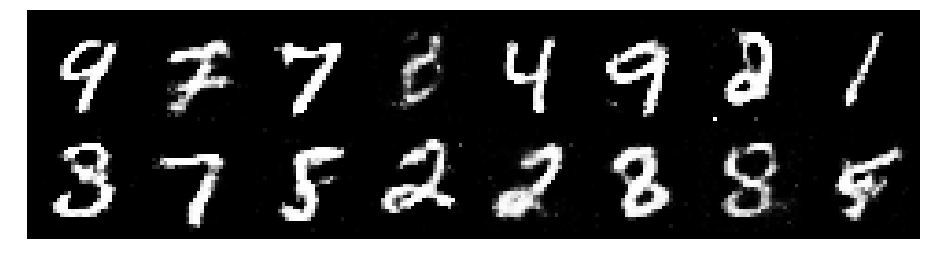

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.2502, Generator Loss: 0.9528
D(x): 0.5510, D(G(z)): 0.4298


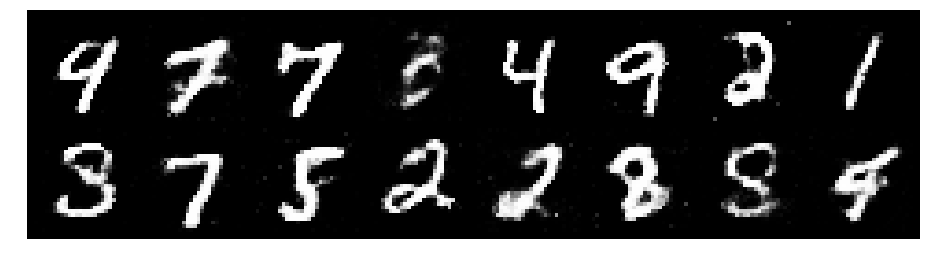

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.2959, Generator Loss: 0.7484
D(x): 0.5737, D(G(z)): 0.4827


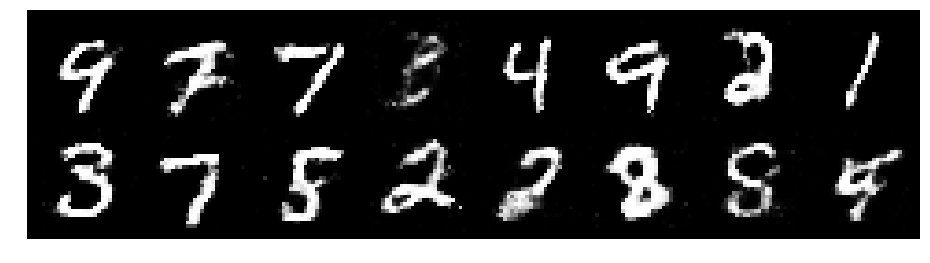

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.2688, Generator Loss: 0.9495
D(x): 0.5348, D(G(z)): 0.4290


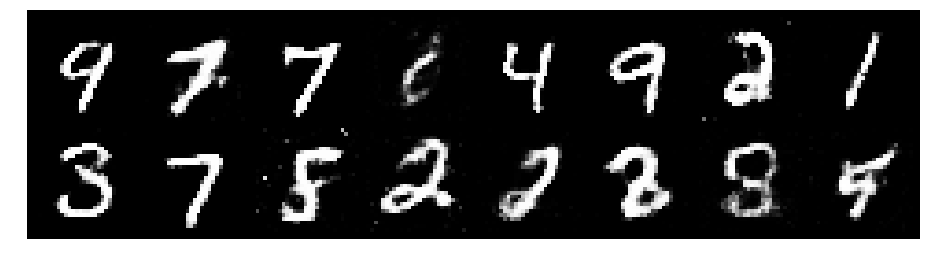

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.3184, Generator Loss: 0.8898
D(x): 0.5987, D(G(z)): 0.4878


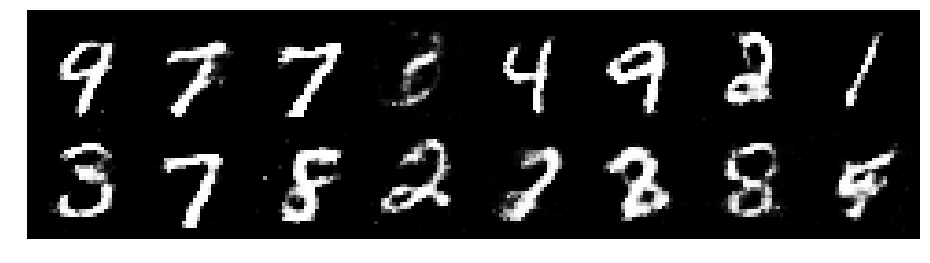

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.3874, Generator Loss: 0.9282
D(x): 0.5707, D(G(z)): 0.5070


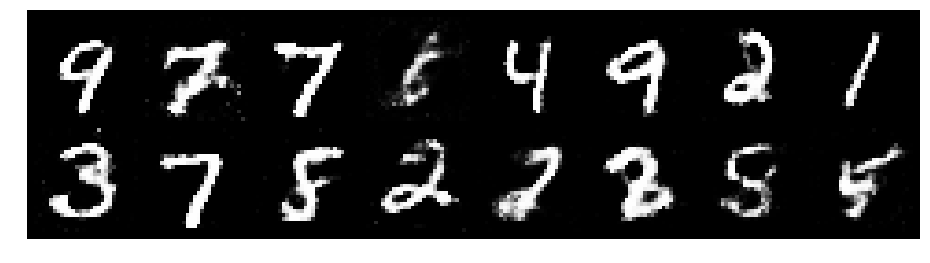

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.3242, Generator Loss: 0.9153
D(x): 0.5350, D(G(z)): 0.4415


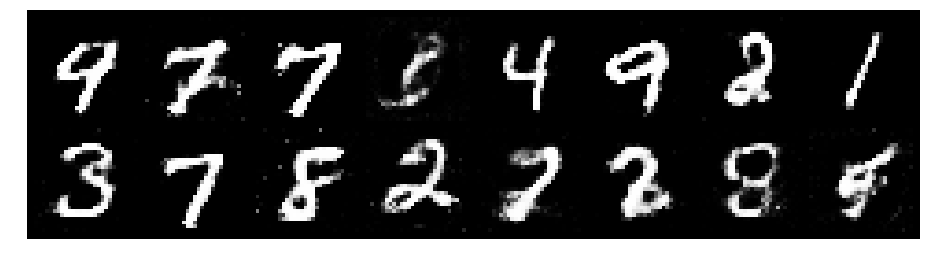

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.2659, Generator Loss: 0.9552
D(x): 0.5427, D(G(z)): 0.4240


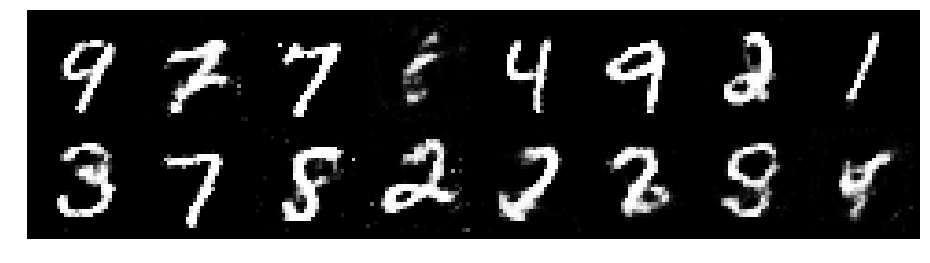

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.1702, Generator Loss: 1.0502
D(x): 0.5636, D(G(z)): 0.3934


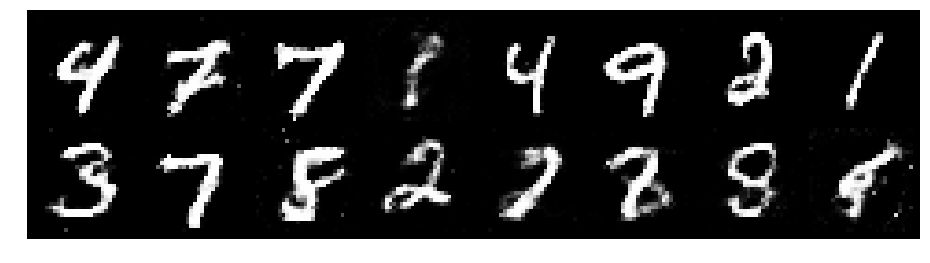

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.3938, Generator Loss: 0.8642
D(x): 0.4944, D(G(z)): 0.4618


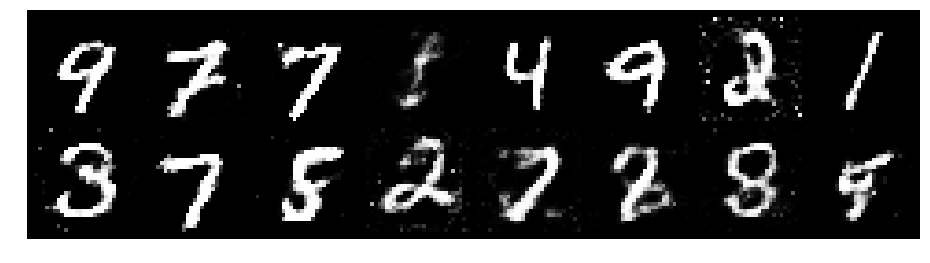

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.3260, Generator Loss: 0.7771
D(x): 0.5340, D(G(z)): 0.4741


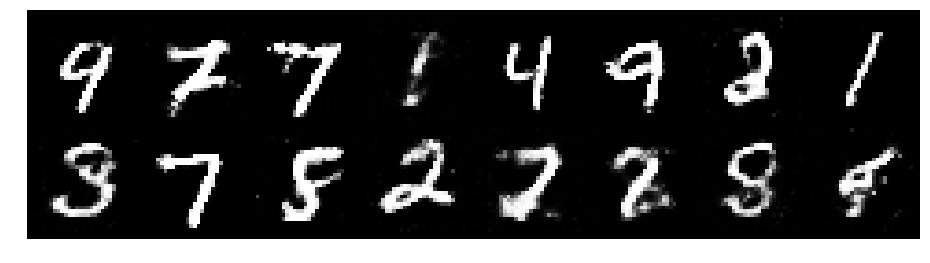

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.2998, Generator Loss: 0.8909
D(x): 0.5620, D(G(z)): 0.4616


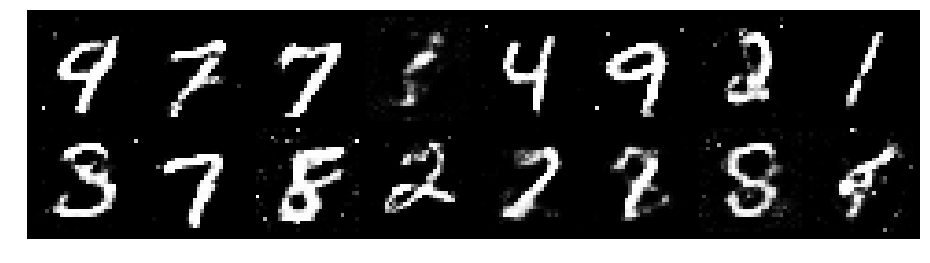

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.2939, Generator Loss: 0.9232
D(x): 0.5612, D(G(z)): 0.4613


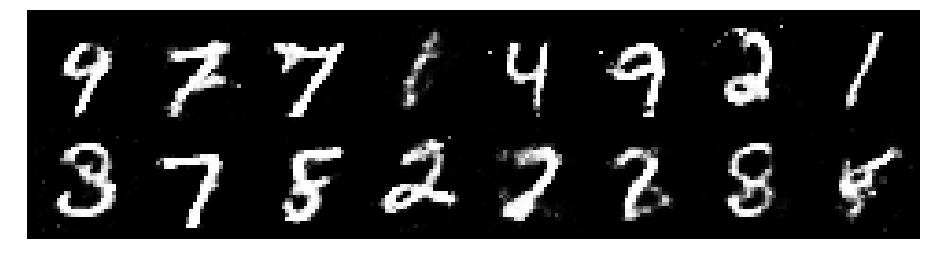

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.2715, Generator Loss: 0.8487
D(x): 0.5426, D(G(z)): 0.4530


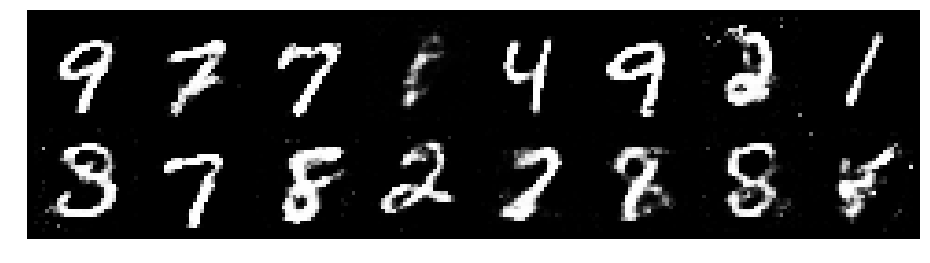

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.2497, Generator Loss: 0.9992
D(x): 0.5375, D(G(z)): 0.4276


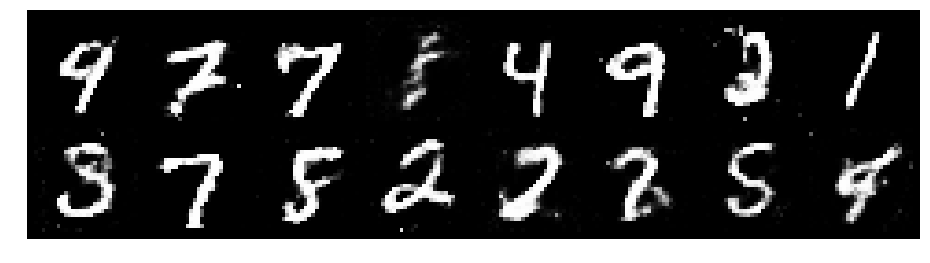

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.1857, Generator Loss: 1.0311
D(x): 0.5700, D(G(z)): 0.4189


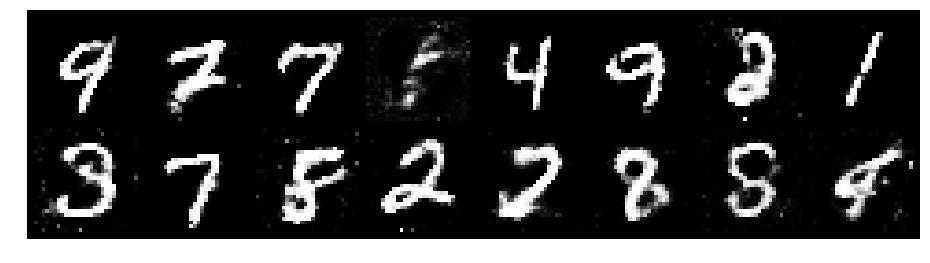

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.1359, Generator Loss: 1.0724
D(x): 0.5808, D(G(z)): 0.3997


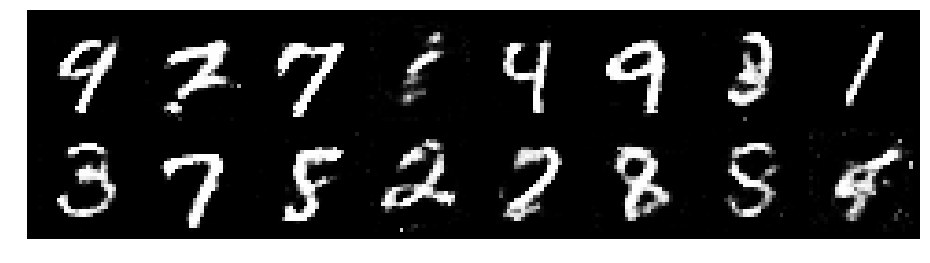

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.2243, Generator Loss: 0.9552
D(x): 0.5588, D(G(z)): 0.4349


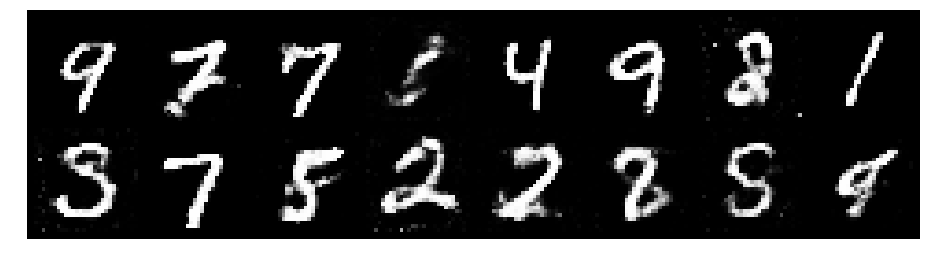

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.2445, Generator Loss: 0.9999
D(x): 0.5519, D(G(z)): 0.4009


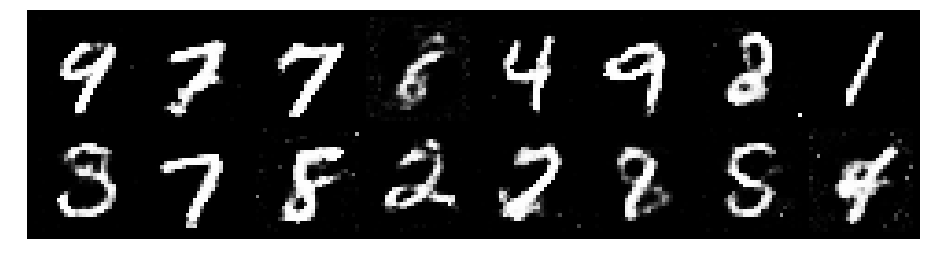

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.1677, Generator Loss: 0.9855
D(x): 0.5797, D(G(z)): 0.4051


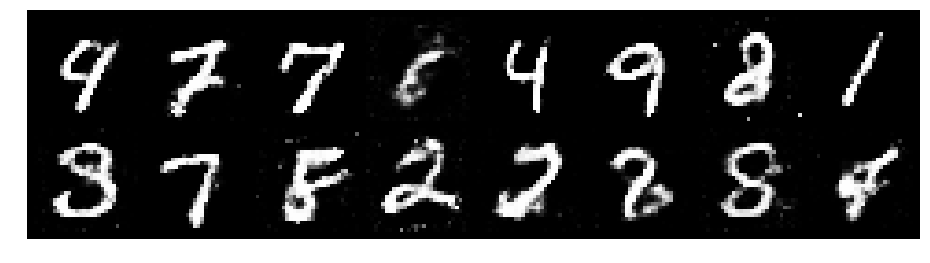

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.2395, Generator Loss: 0.7852
D(x): 0.6066, D(G(z)): 0.4686


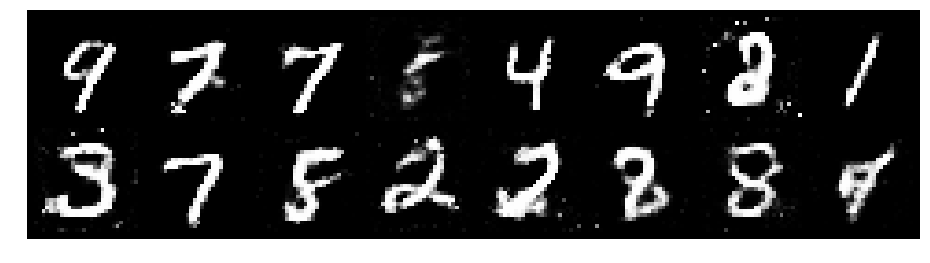

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.3159, Generator Loss: 0.8329
D(x): 0.5167, D(G(z)): 0.4487


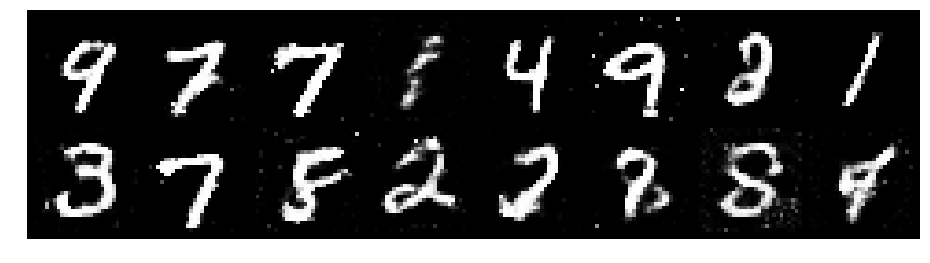

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.3478, Generator Loss: 0.7629
D(x): 0.5330, D(G(z)): 0.4871


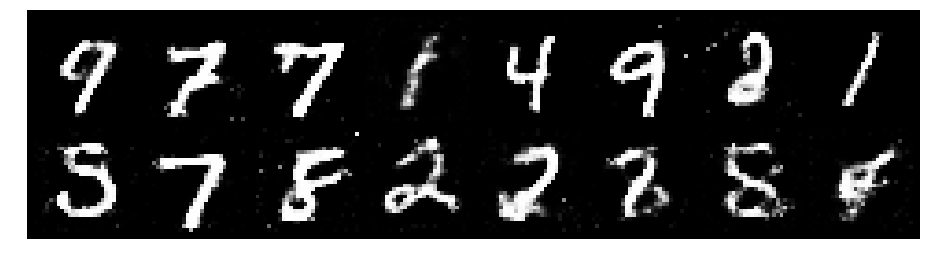

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.2819, Generator Loss: 0.9418
D(x): 0.5385, D(G(z)): 0.4410


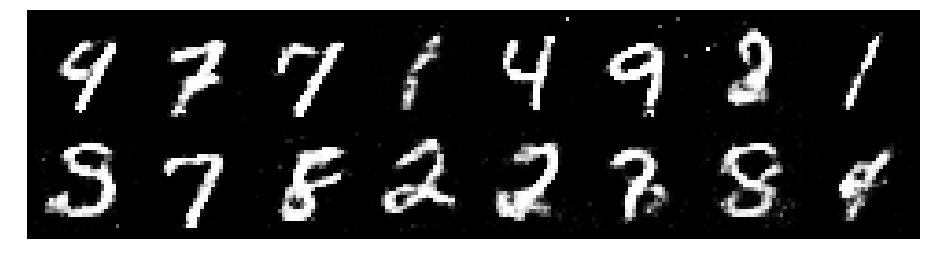

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.2160, Generator Loss: 0.9343
D(x): 0.5908, D(G(z)): 0.4374


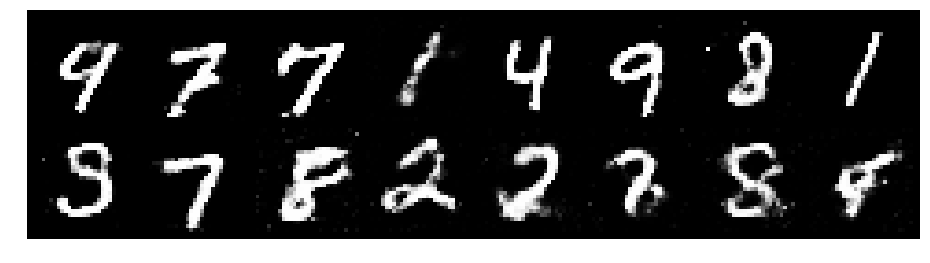

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.2094, Generator Loss: 0.9970
D(x): 0.5608, D(G(z)): 0.4028


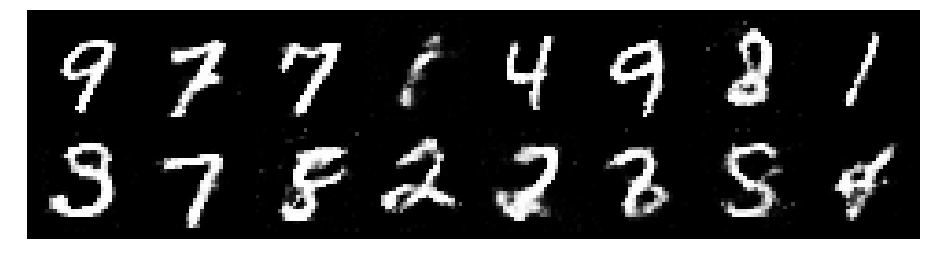

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.3224, Generator Loss: 1.0604
D(x): 0.5514, D(G(z)): 0.4269


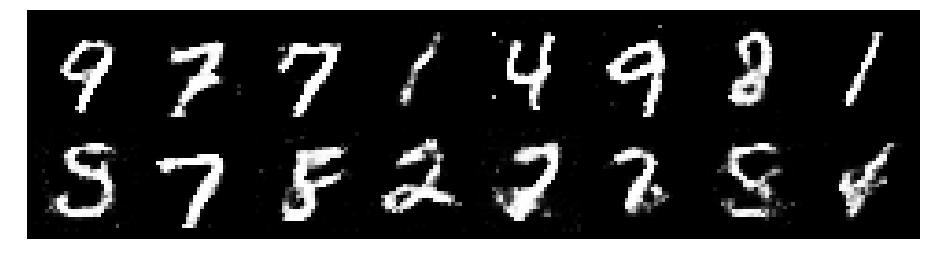

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.2168, Generator Loss: 0.9594
D(x): 0.5619, D(G(z)): 0.4180


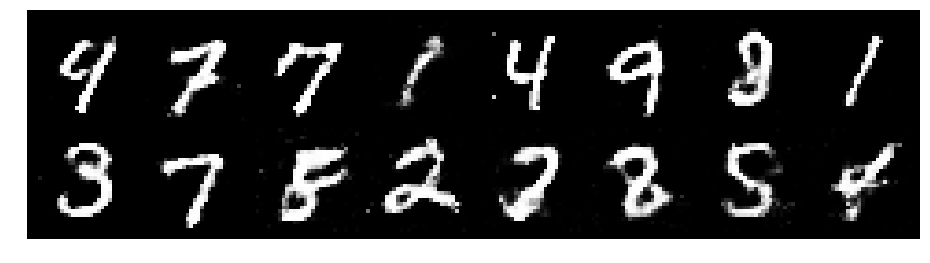

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.2738, Generator Loss: 0.9835
D(x): 0.5582, D(G(z)): 0.4426


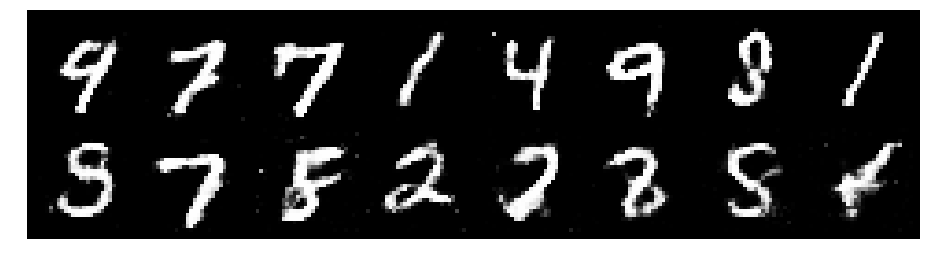

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.4723, Generator Loss: 0.7515
D(x): 0.4973, D(G(z)): 0.4688


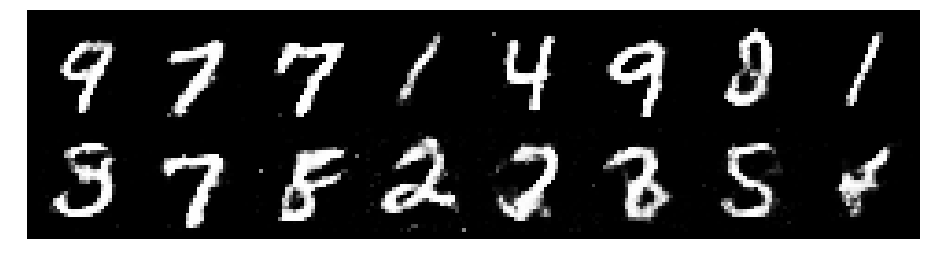

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.3331, Generator Loss: 0.9621
D(x): 0.5368, D(G(z)): 0.4333


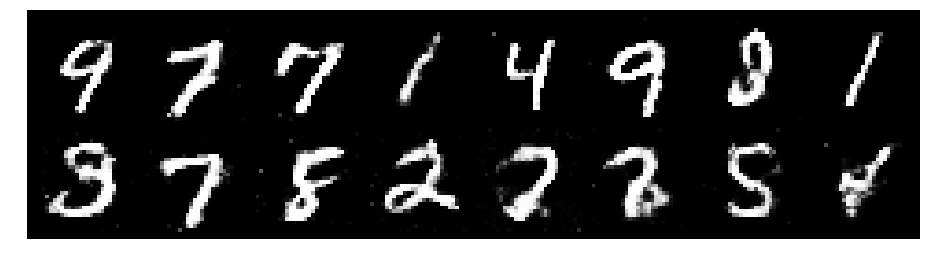

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 1.2803, Generator Loss: 0.9112
D(x): 0.6010, D(G(z)): 0.4697


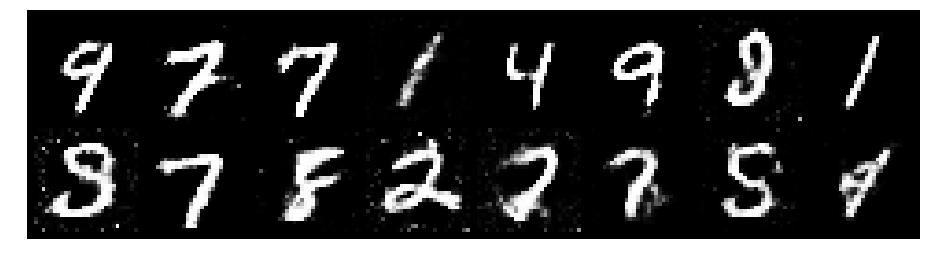

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.3165, Generator Loss: 0.8383
D(x): 0.5304, D(G(z)): 0.4532


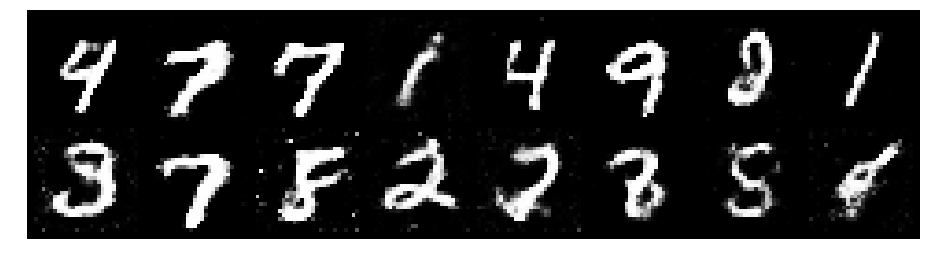

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.2596, Generator Loss: 0.8996
D(x): 0.5603, D(G(z)): 0.4229


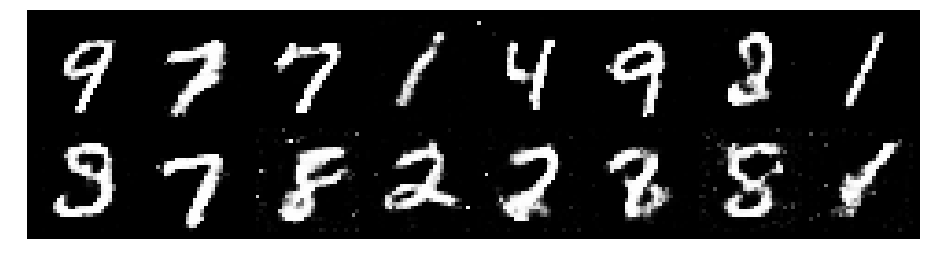

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.3071, Generator Loss: 0.8207
D(x): 0.5562, D(G(z)): 0.4807


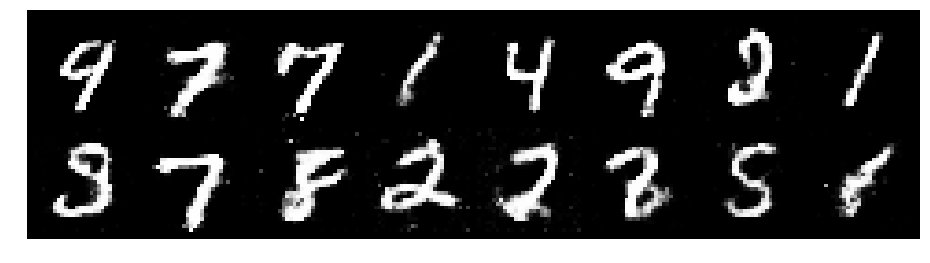

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.0609, Generator Loss: 0.9071
D(x): 0.6088, D(G(z)): 0.3964


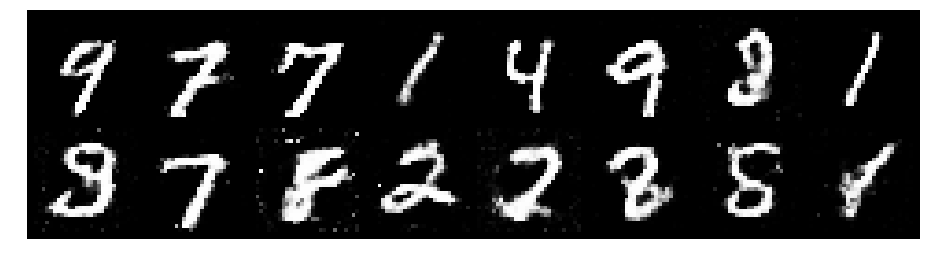

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.2436, Generator Loss: 0.9816
D(x): 0.5664, D(G(z)): 0.4415


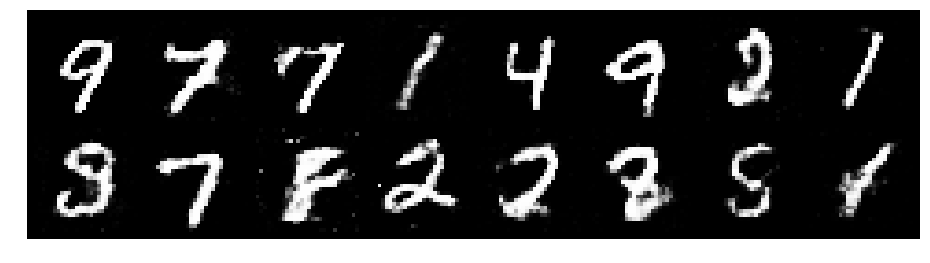

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.3186, Generator Loss: 1.0278
D(x): 0.5407, D(G(z)): 0.4318


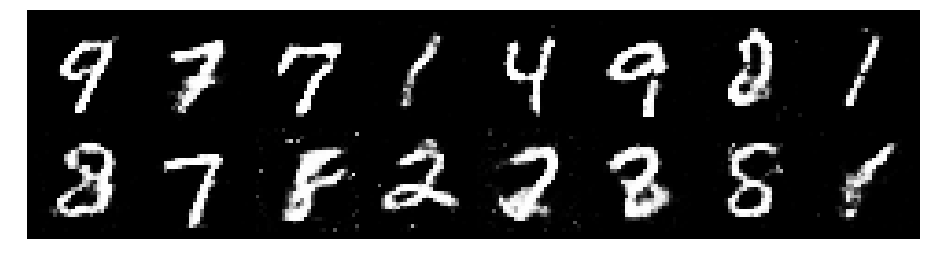

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.2745, Generator Loss: 0.8395
D(x): 0.5555, D(G(z)): 0.4548


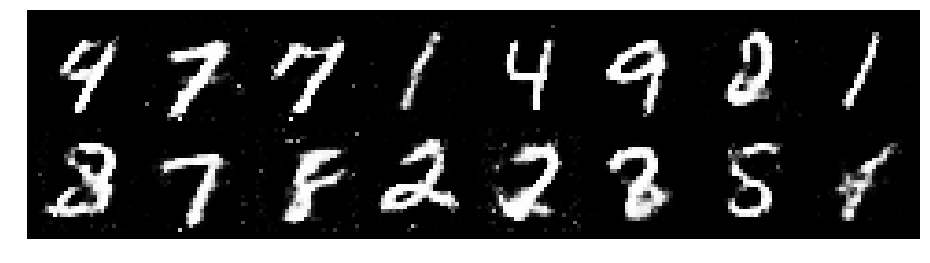

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.3890, Generator Loss: 0.9287
D(x): 0.4908, D(G(z)): 0.4408


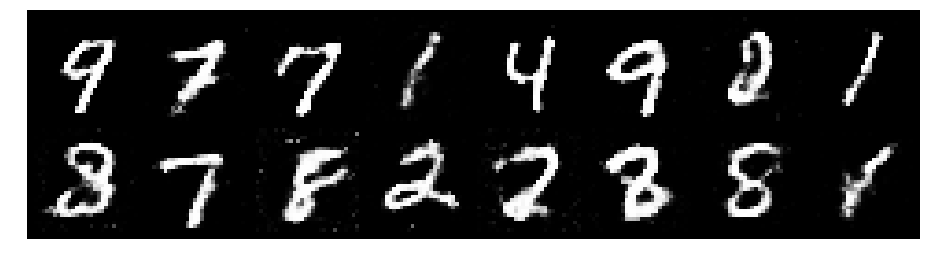

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 1.3866, Generator Loss: 0.8411
D(x): 0.5386, D(G(z)): 0.4900


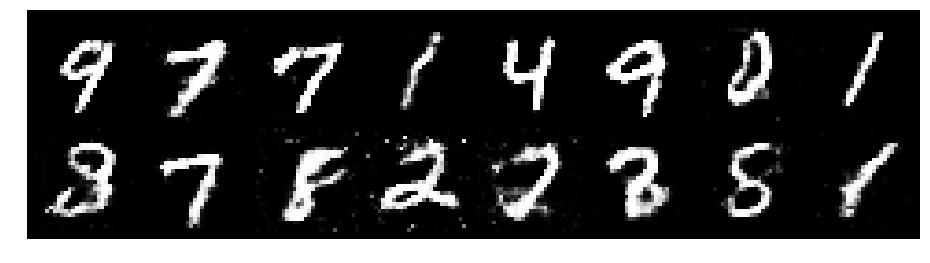

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.2339, Generator Loss: 0.7532
D(x): 0.5873, D(G(z)): 0.4616


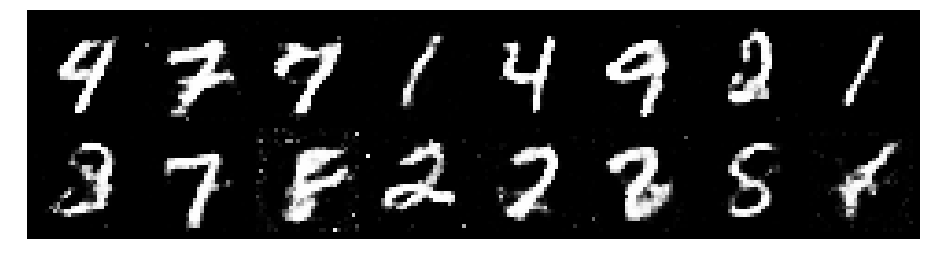

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.2443, Generator Loss: 0.9060
D(x): 0.5728, D(G(z)): 0.4588


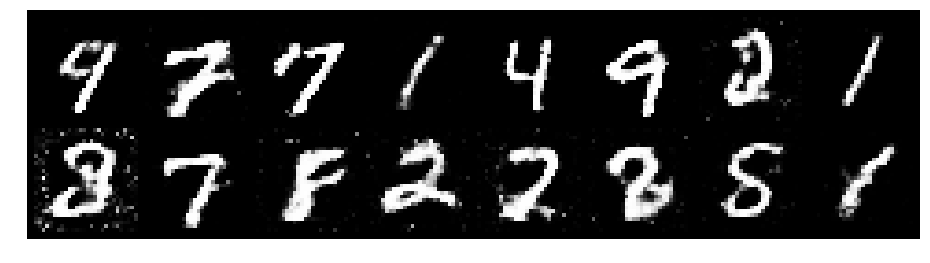

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.2481, Generator Loss: 0.8455
D(x): 0.5425, D(G(z)): 0.4384


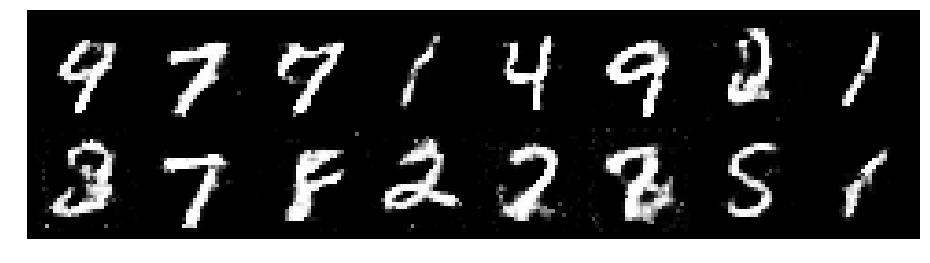

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 1.2379, Generator Loss: 0.8299
D(x): 0.5977, D(G(z)): 0.4744


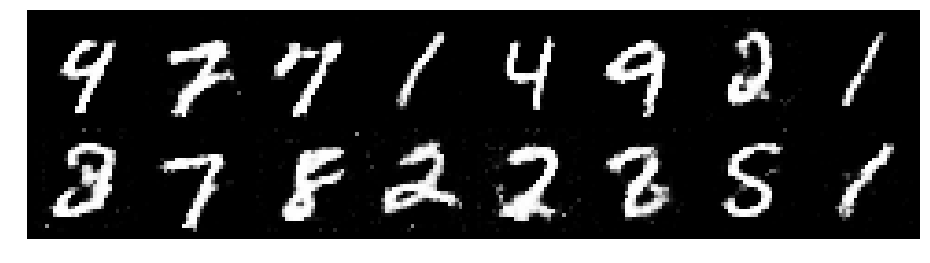

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.4196, Generator Loss: 0.7524
D(x): 0.5098, D(G(z)): 0.4836


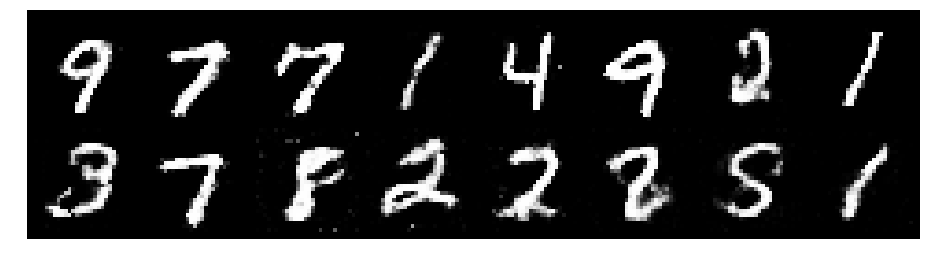

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 1.1070, Generator Loss: 1.0443
D(x): 0.6053, D(G(z)): 0.3847


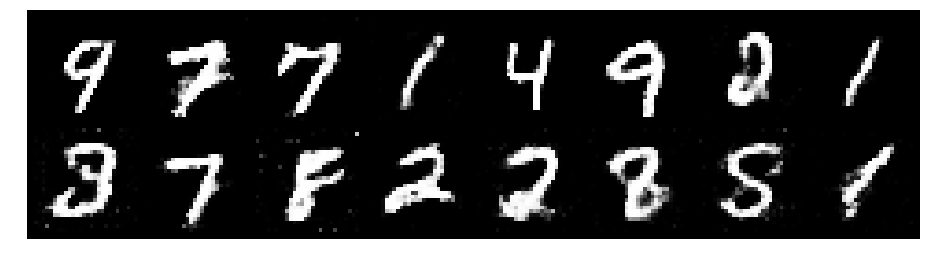

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.1149, Generator Loss: 0.9931
D(x): 0.6130, D(G(z)): 0.4160


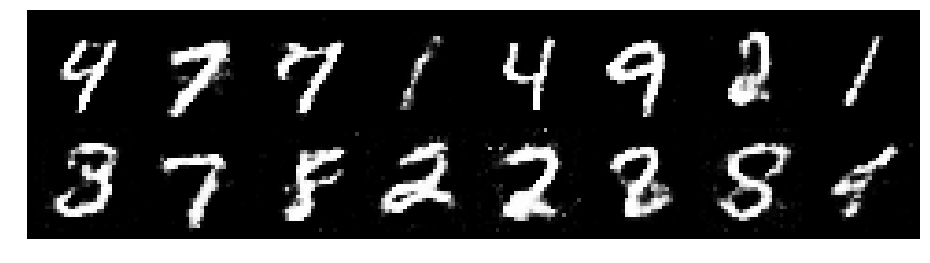

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 1.2252, Generator Loss: 0.9279
D(x): 0.5655, D(G(z)): 0.4367


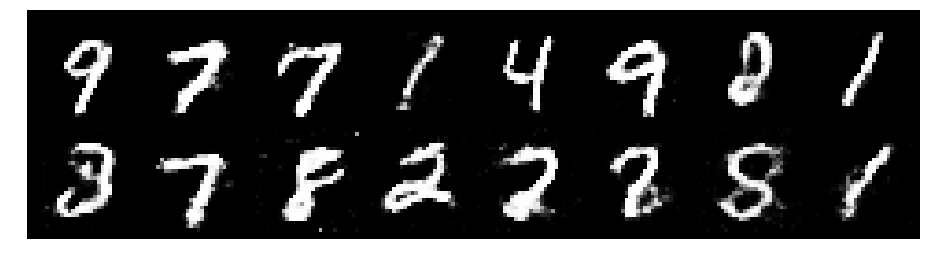

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.3774, Generator Loss: 0.7917
D(x): 0.5242, D(G(z)): 0.4860


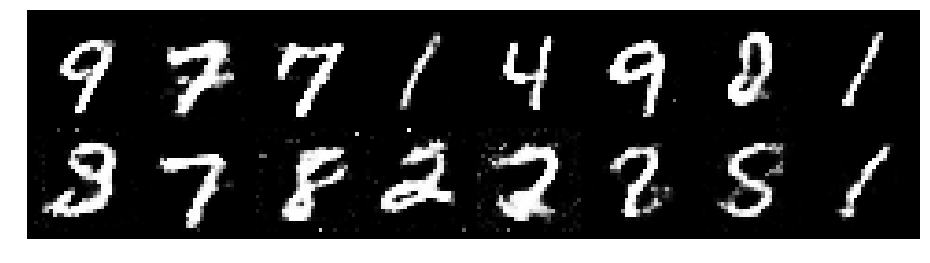

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.2489, Generator Loss: 0.8581
D(x): 0.5809, D(G(z)): 0.4397


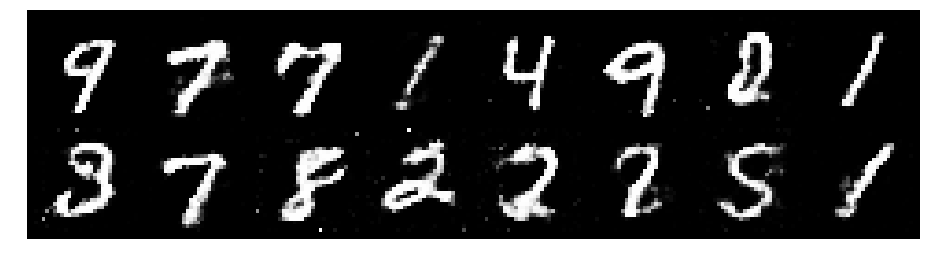

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.1338, Generator Loss: 0.9752
D(x): 0.5833, D(G(z)): 0.4004


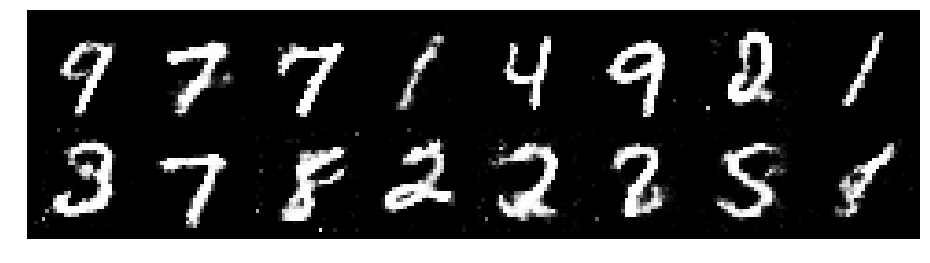

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.1514, Generator Loss: 0.9506
D(x): 0.5635, D(G(z)): 0.3787


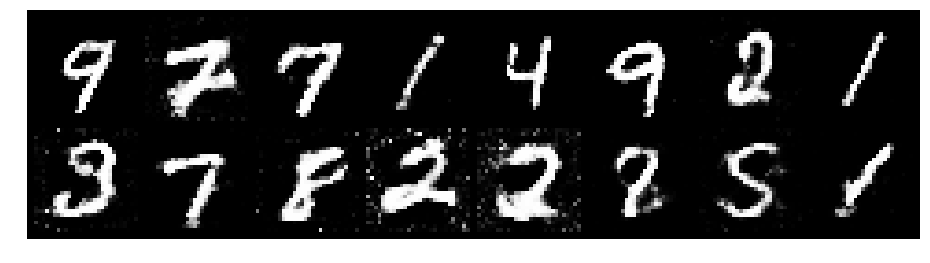

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.2678, Generator Loss: 0.9634
D(x): 0.5329, D(G(z)): 0.4432


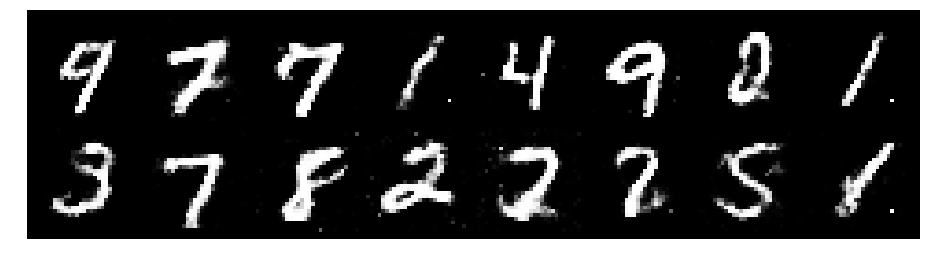

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.1916, Generator Loss: 1.0507
D(x): 0.5583, D(G(z)): 0.3864


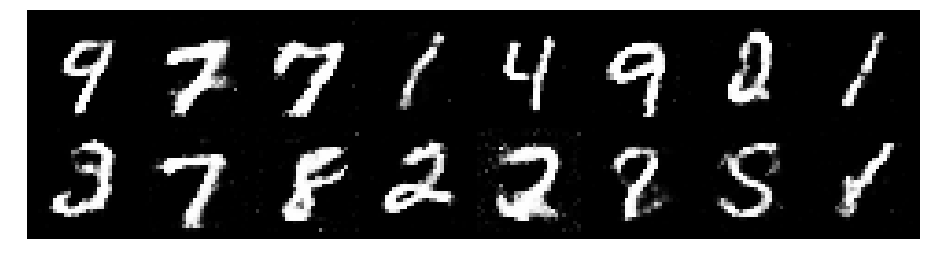

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 1.2264, Generator Loss: 1.0469
D(x): 0.5853, D(G(z)): 0.4100


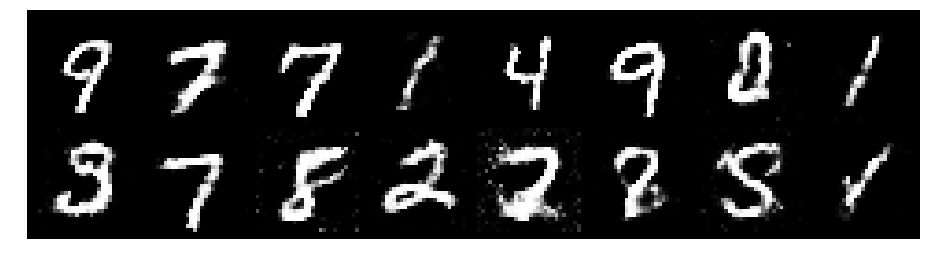

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.1931, Generator Loss: 0.8738
D(x): 0.5774, D(G(z)): 0.4279


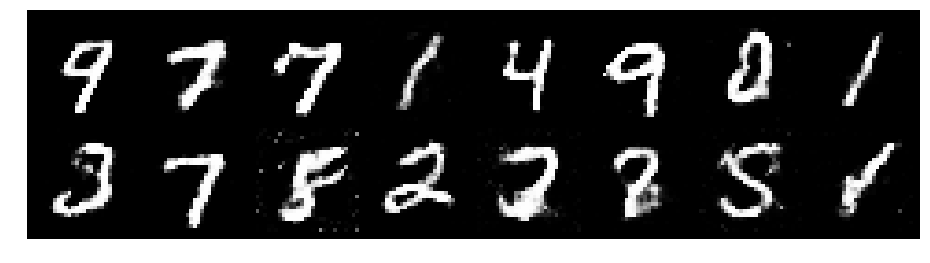

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.2001, Generator Loss: 1.0204
D(x): 0.5581, D(G(z)): 0.4074


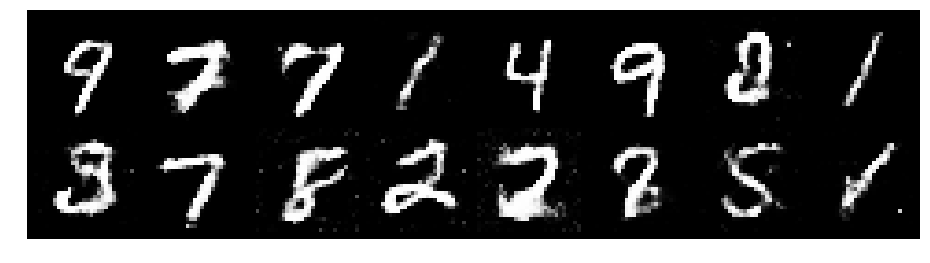

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 1.3469, Generator Loss: 0.8174
D(x): 0.5508, D(G(z)): 0.4567


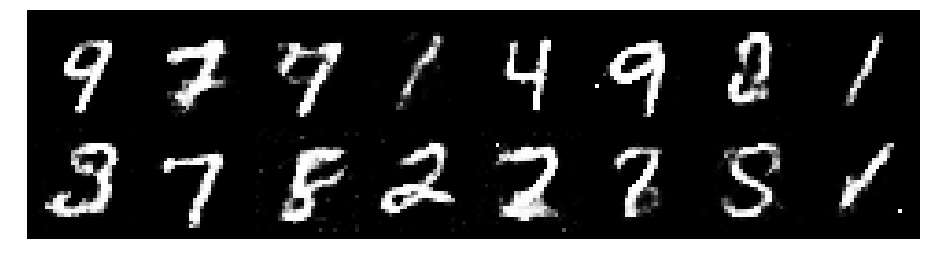

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.3867, Generator Loss: 0.7303
D(x): 0.5425, D(G(z)): 0.5057


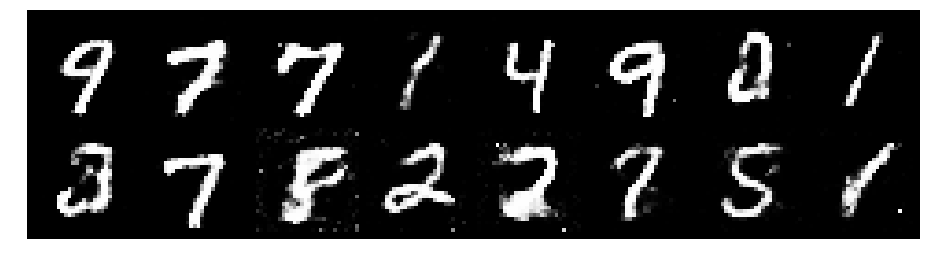

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.3952, Generator Loss: 0.8882
D(x): 0.5049, D(G(z)): 0.4563


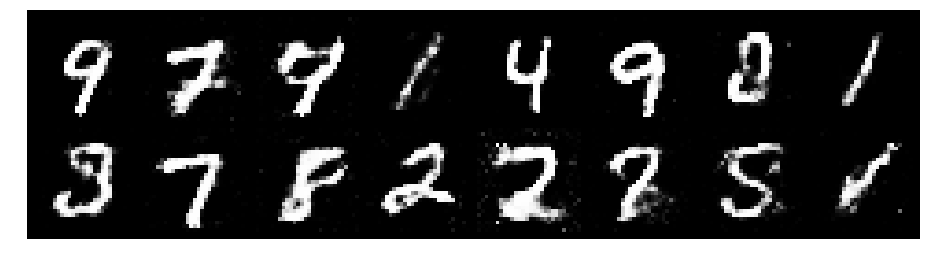

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.3238, Generator Loss: 0.8892
D(x): 0.5191, D(G(z)): 0.4436


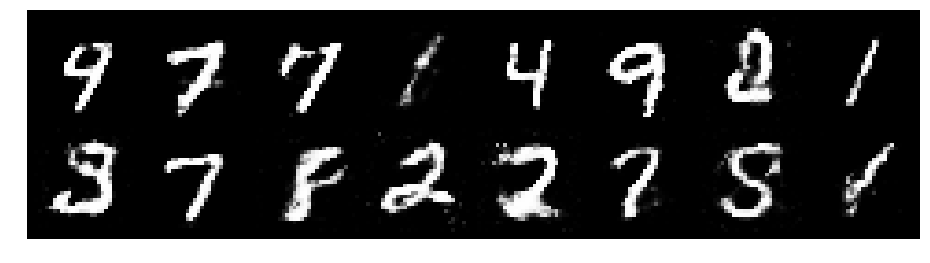

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.3835, Generator Loss: 0.7920
D(x): 0.5208, D(G(z)): 0.4804


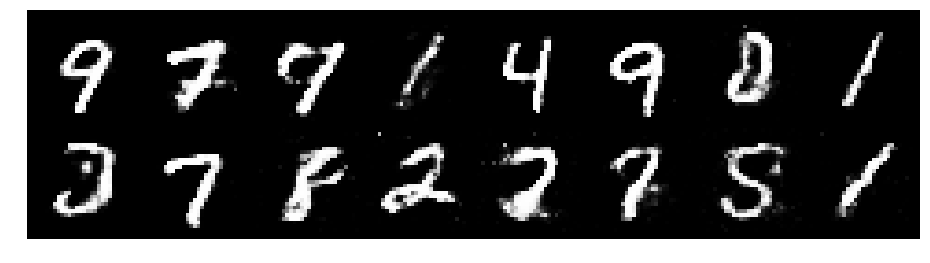

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.2876, Generator Loss: 0.9272
D(x): 0.5544, D(G(z)): 0.4522


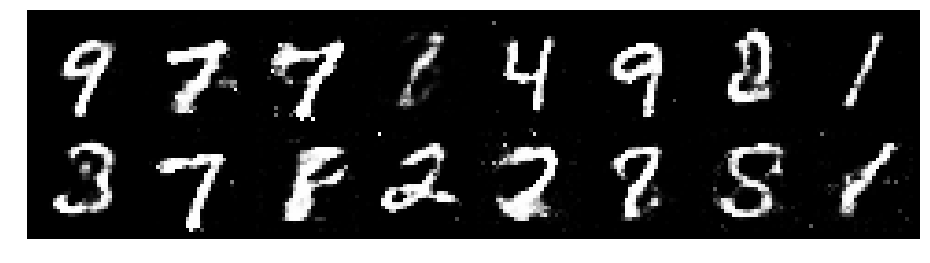

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.2381, Generator Loss: 0.9024
D(x): 0.5389, D(G(z)): 0.4226


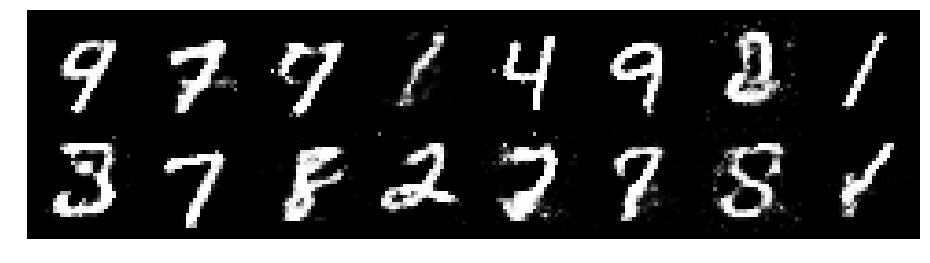

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.2994, Generator Loss: 0.9955
D(x): 0.5424, D(G(z)): 0.4325


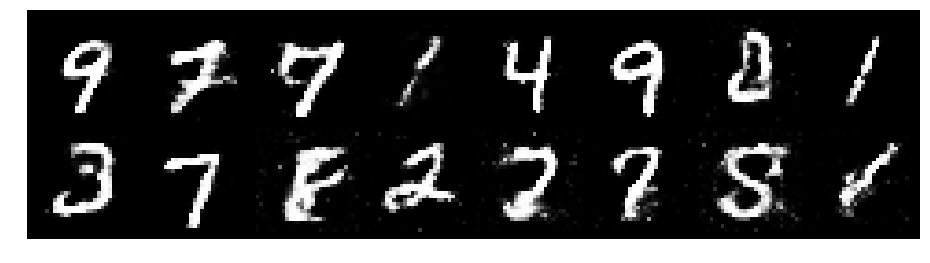

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.1950, Generator Loss: 0.9527
D(x): 0.5822, D(G(z)): 0.4430


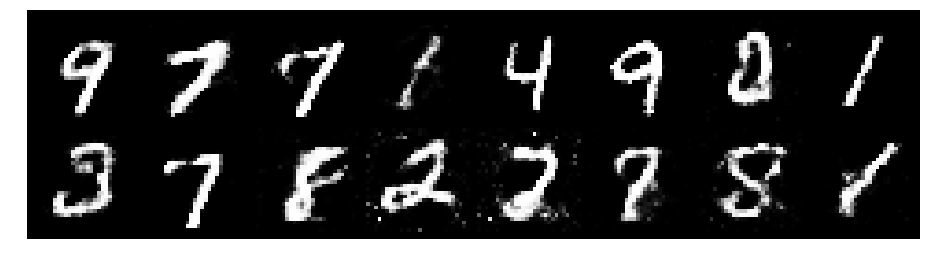

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.2441, Generator Loss: 0.9099
D(x): 0.5812, D(G(z)): 0.4588


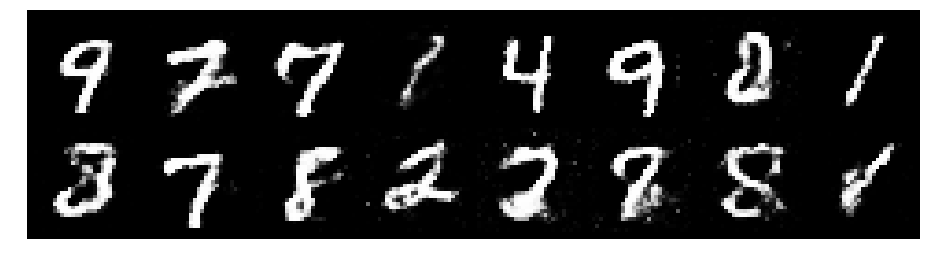

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.3227, Generator Loss: 0.9512
D(x): 0.5761, D(G(z)): 0.4674


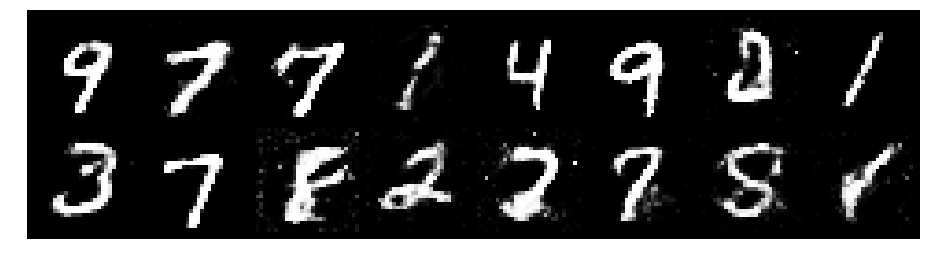

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.5645, Generator Loss: 0.8923
D(x): 0.5618, D(G(z)): 0.5178


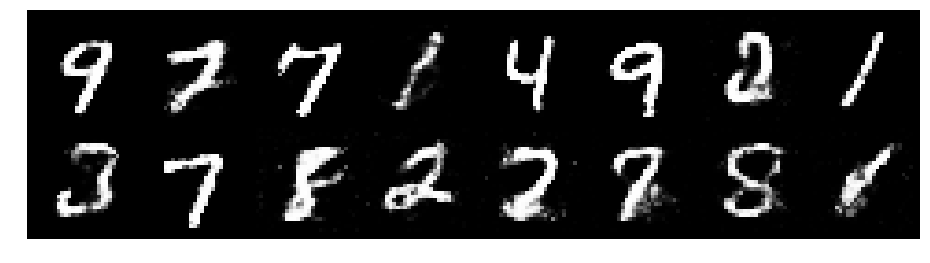

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.2719, Generator Loss: 0.9266
D(x): 0.5738, D(G(z)): 0.4573


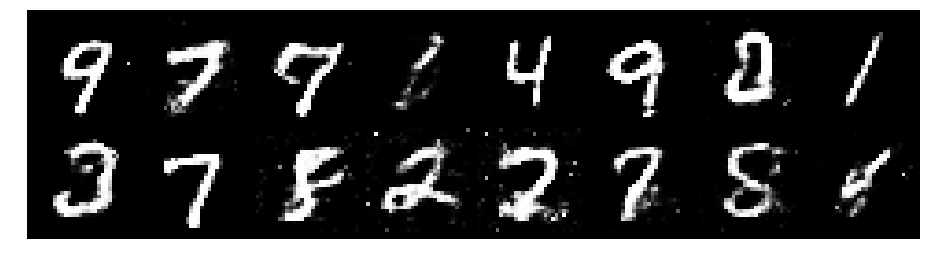

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.3836, Generator Loss: 0.7801
D(x): 0.5221, D(G(z)): 0.4741


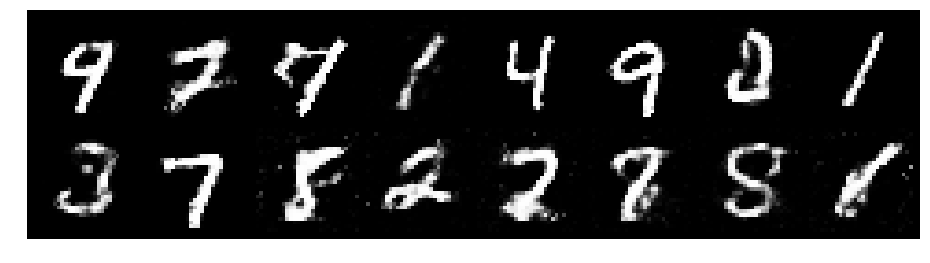

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.3583, Generator Loss: 0.8426
D(x): 0.5304, D(G(z)): 0.4697


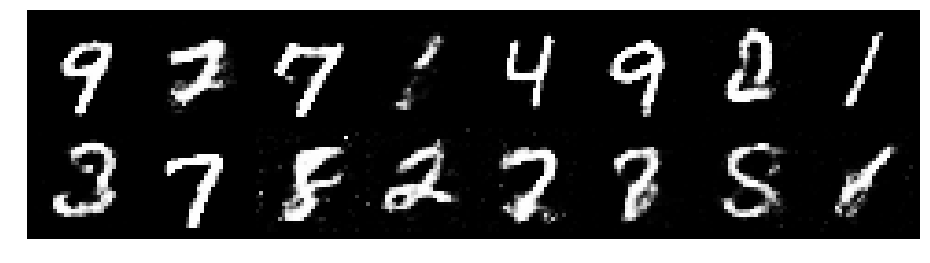

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.3070, Generator Loss: 0.9296
D(x): 0.5178, D(G(z)): 0.4277


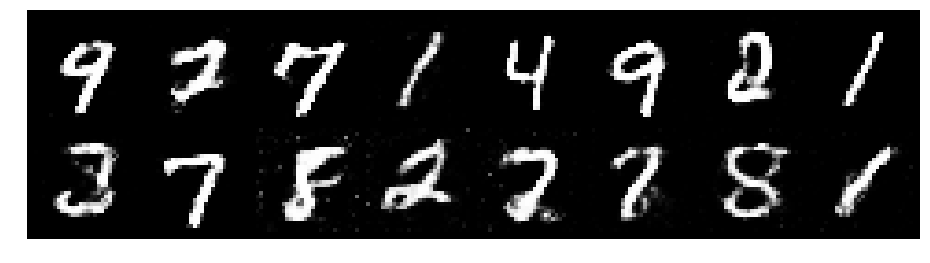

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.2714, Generator Loss: 1.1202
D(x): 0.5116, D(G(z)): 0.3779


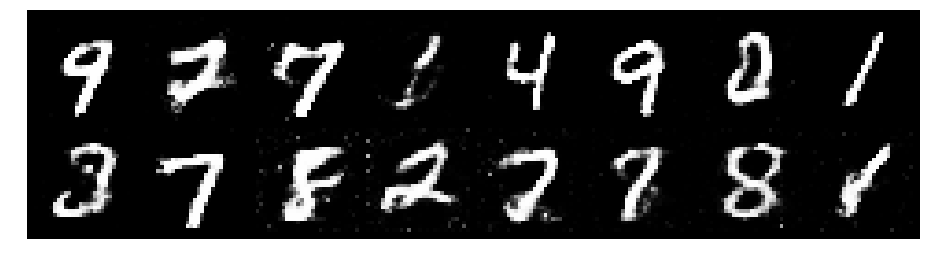

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.1616, Generator Loss: 0.9740
D(x): 0.5850, D(G(z)): 0.3998


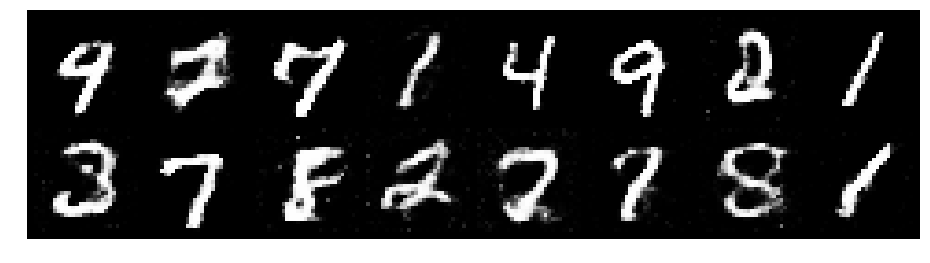

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.4034, Generator Loss: 0.8741
D(x): 0.5264, D(G(z)): 0.4624


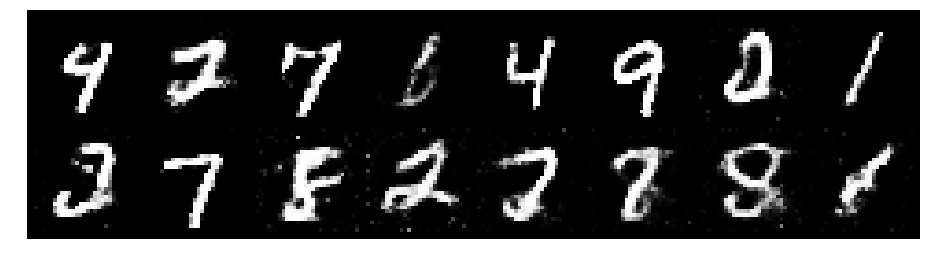

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 1.2602, Generator Loss: 0.7976
D(x): 0.5514, D(G(z)): 0.4498


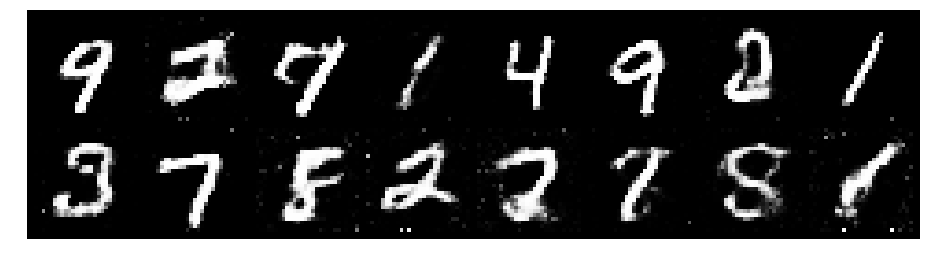

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.2843, Generator Loss: 0.8707
D(x): 0.5553, D(G(z)): 0.4445


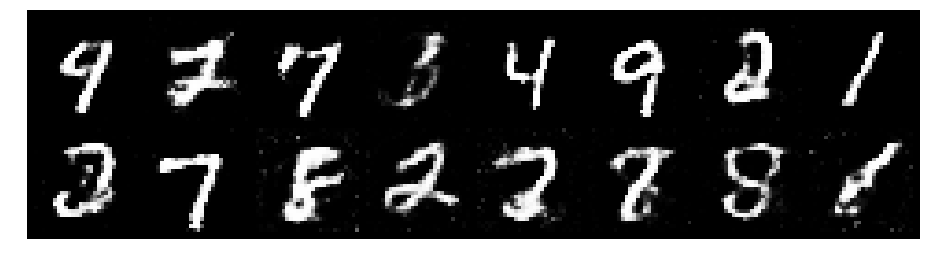

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.2713, Generator Loss: 1.0550
D(x): 0.5874, D(G(z)): 0.4657


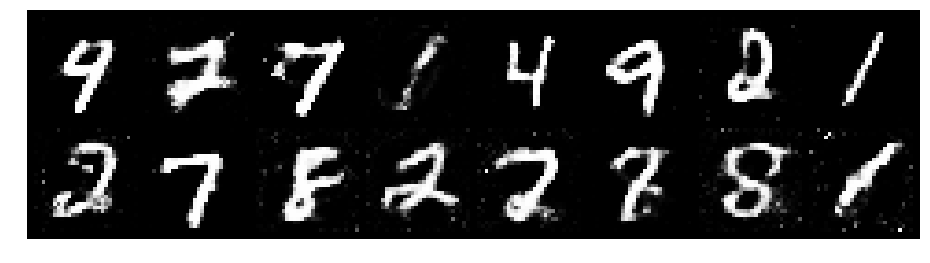

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.3541, Generator Loss: 0.9120
D(x): 0.4987, D(G(z)): 0.4293


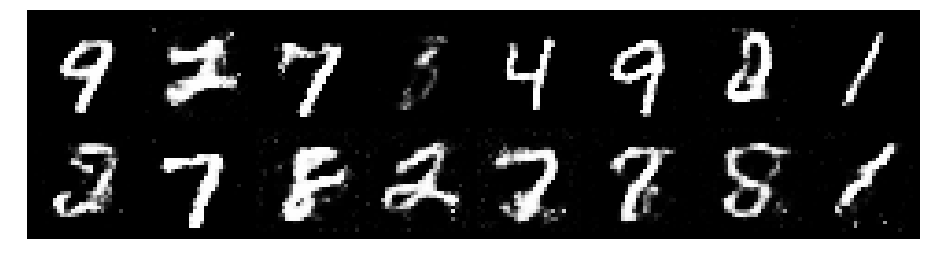

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.2726, Generator Loss: 0.9785
D(x): 0.5466, D(G(z)): 0.4266


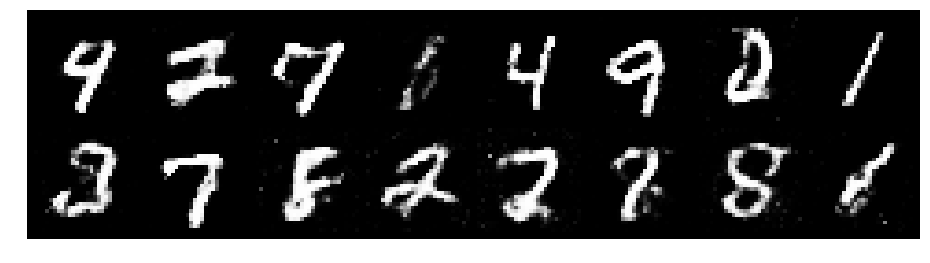

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.2361, Generator Loss: 0.9856
D(x): 0.5310, D(G(z)): 0.4160


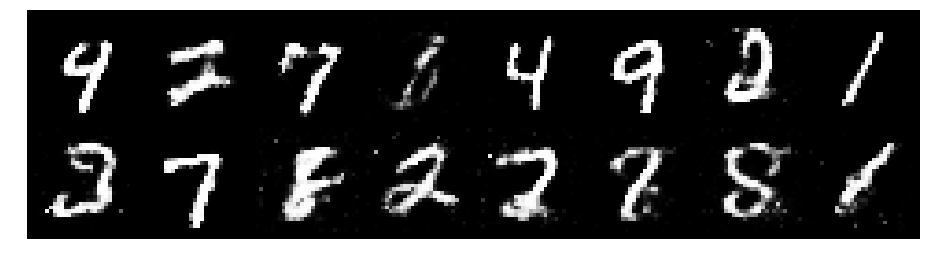

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.2574, Generator Loss: 0.9312
D(x): 0.5485, D(G(z)): 0.4288


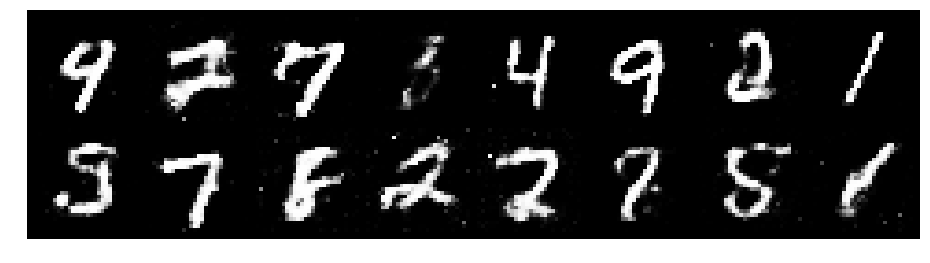

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 1.3058, Generator Loss: 1.0212
D(x): 0.5303, D(G(z)): 0.4260


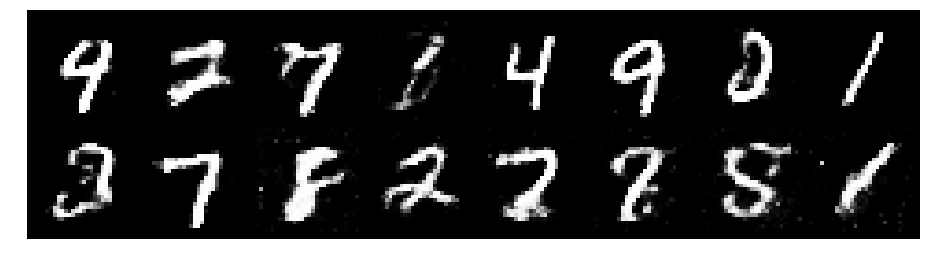

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.2678, Generator Loss: 0.9137
D(x): 0.5808, D(G(z)): 0.4446


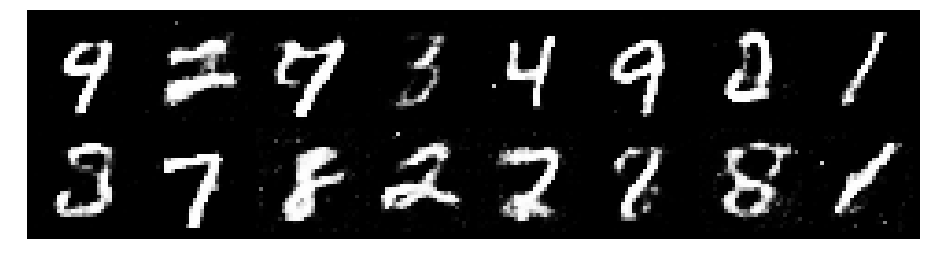

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.1894, Generator Loss: 1.0271
D(x): 0.6369, D(G(z)): 0.4310


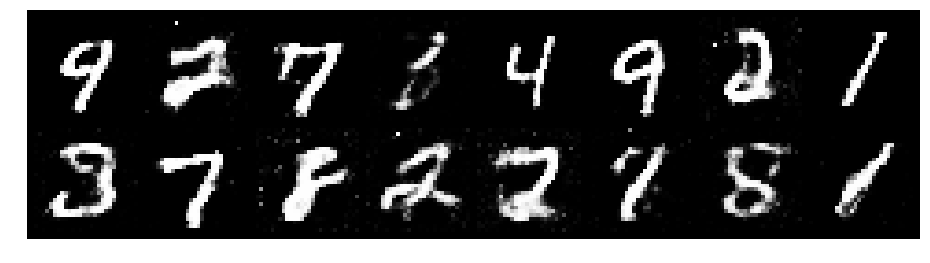

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.2437, Generator Loss: 1.0540
D(x): 0.5337, D(G(z)): 0.4028


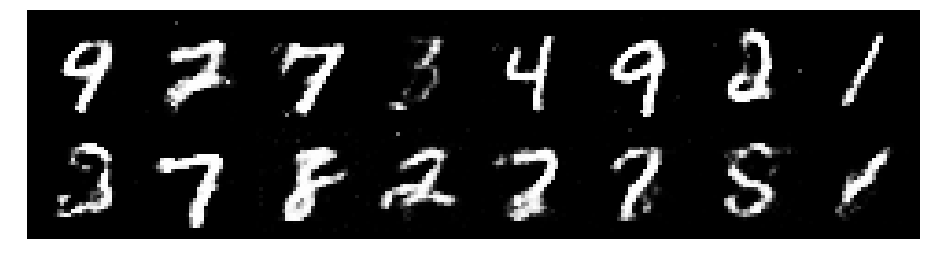

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 1.3510, Generator Loss: 0.8220
D(x): 0.5338, D(G(z)): 0.4546


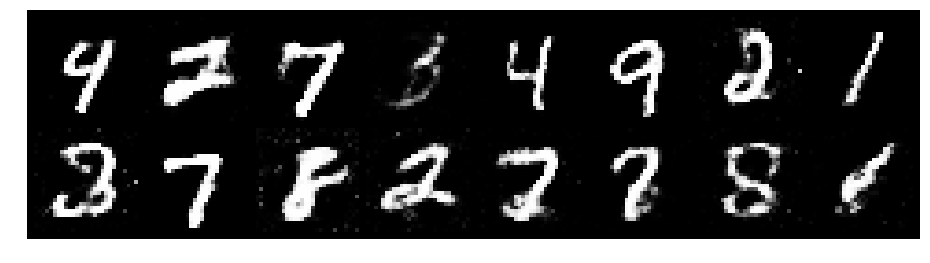

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.4191, Generator Loss: 0.7312
D(x): 0.5402, D(G(z)): 0.5025


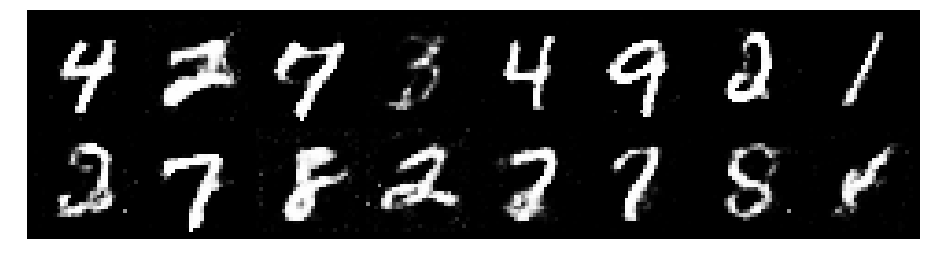

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.2094, Generator Loss: 0.8883
D(x): 0.5815, D(G(z)): 0.4393


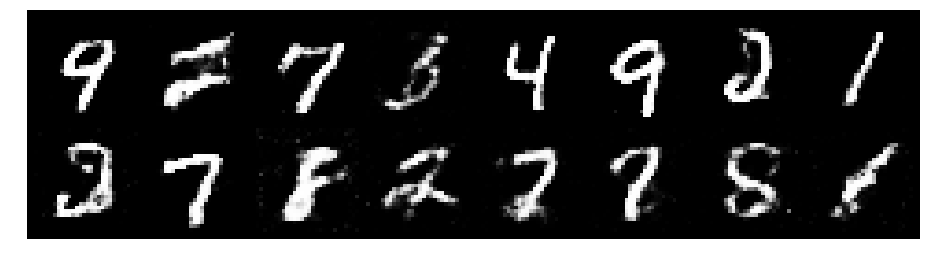

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.3509, Generator Loss: 0.9099
D(x): 0.5514, D(G(z)): 0.4724


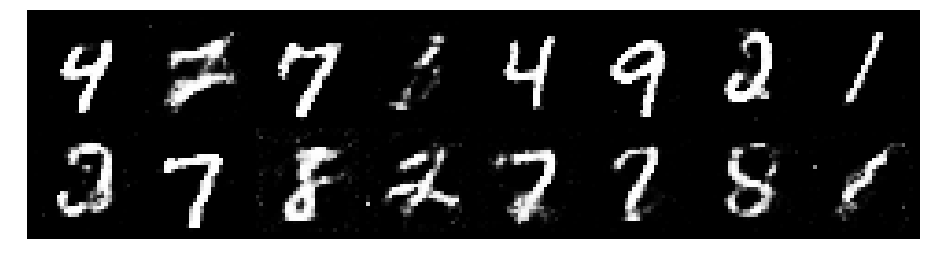

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.3484, Generator Loss: 0.9481
D(x): 0.5556, D(G(z)): 0.4743


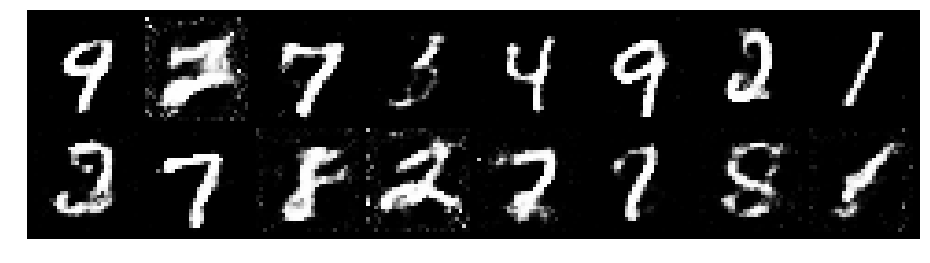

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.1910, Generator Loss: 0.9428
D(x): 0.5555, D(G(z)): 0.4106


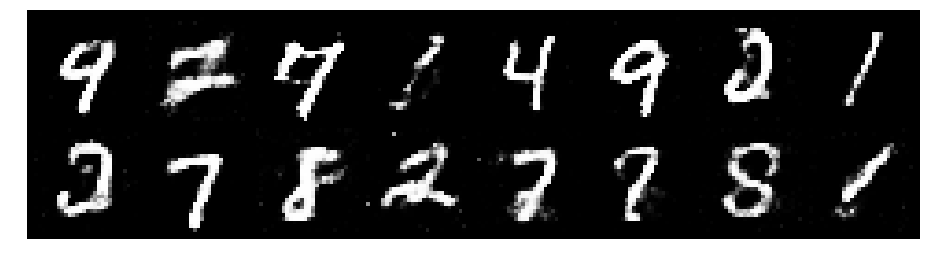

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.1736, Generator Loss: 0.9534
D(x): 0.5862, D(G(z)): 0.4173


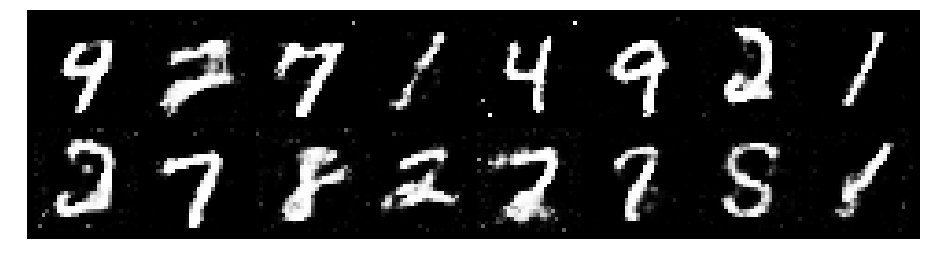

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.2558, Generator Loss: 1.0521
D(x): 0.5713, D(G(z)): 0.4283


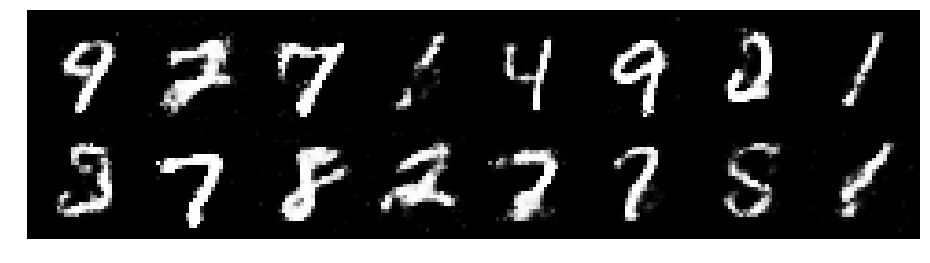

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.1608, Generator Loss: 0.9649
D(x): 0.5970, D(G(z)): 0.4190


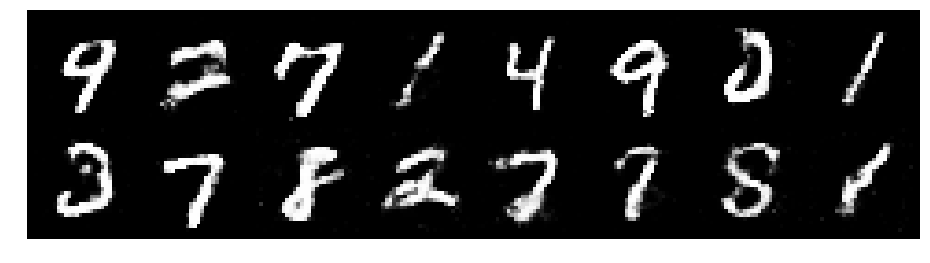

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.2218, Generator Loss: 0.9296
D(x): 0.5528, D(G(z)): 0.4176


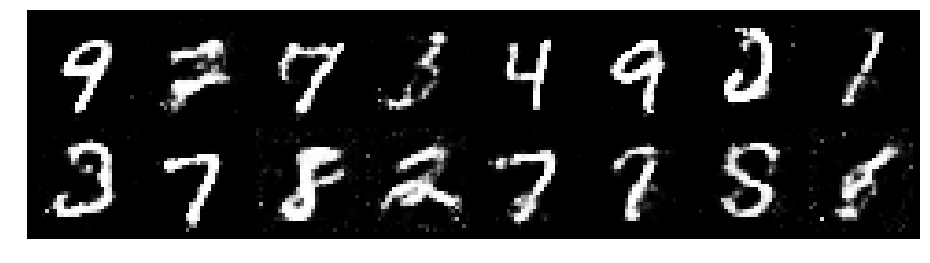

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.3279, Generator Loss: 0.9684
D(x): 0.5101, D(G(z)): 0.4293


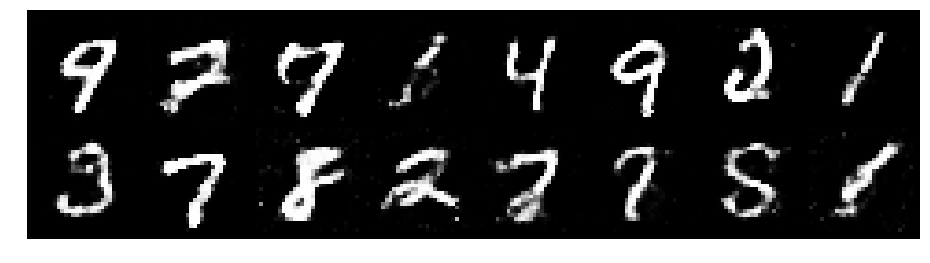

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.1693, Generator Loss: 0.9332
D(x): 0.5907, D(G(z)): 0.4258


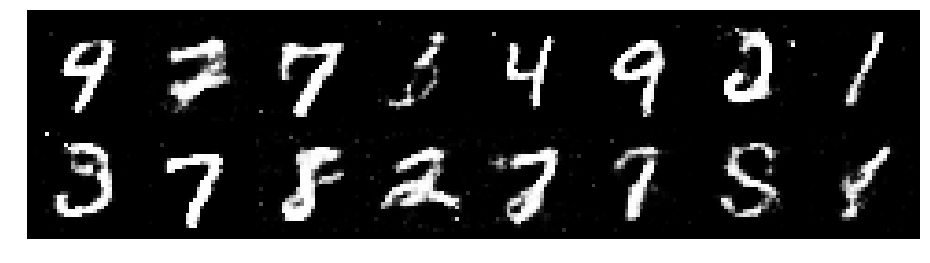

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.2461, Generator Loss: 0.9233
D(x): 0.5328, D(G(z)): 0.4073


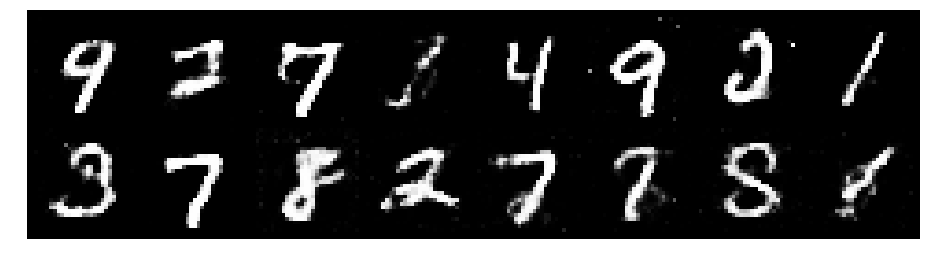

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.3173, Generator Loss: 0.9052
D(x): 0.5621, D(G(z)): 0.4555


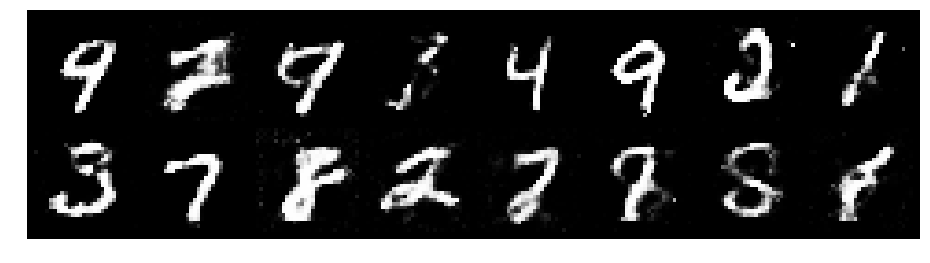

Epoch: [151/200], Batch Num: [0/600]
Discriminator Loss: 1.2828, Generator Loss: 0.8693
D(x): 0.5470, D(G(z)): 0.4482


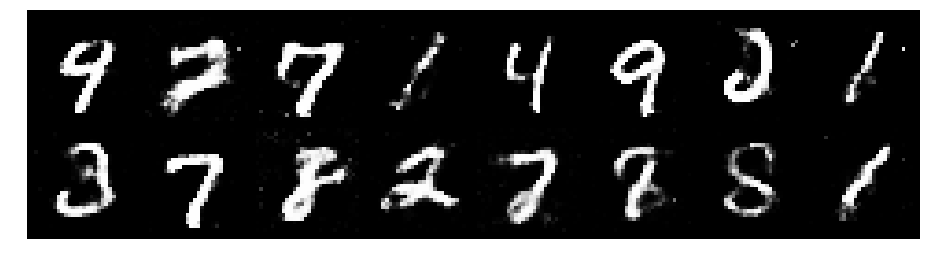

Epoch: [151/200], Batch Num: [100/600]
Discriminator Loss: 1.2308, Generator Loss: 1.0873
D(x): 0.5476, D(G(z)): 0.3904


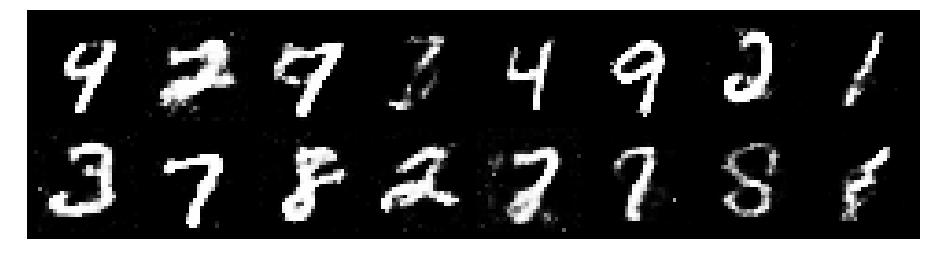

Epoch: [151/200], Batch Num: [200/600]
Discriminator Loss: 1.3873, Generator Loss: 0.7861
D(x): 0.5643, D(G(z)): 0.4958


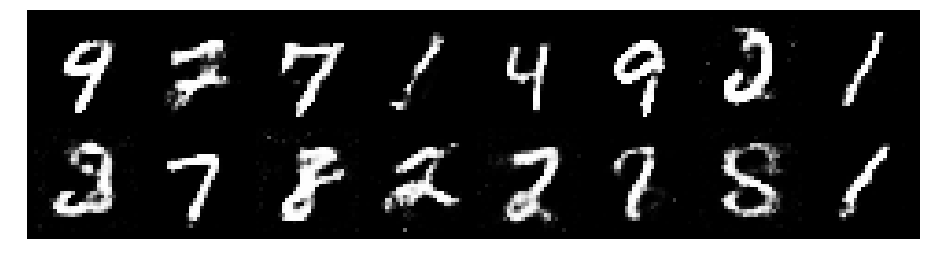

Epoch: [151/200], Batch Num: [300/600]
Discriminator Loss: 1.2543, Generator Loss: 0.9680
D(x): 0.5449, D(G(z)): 0.4015


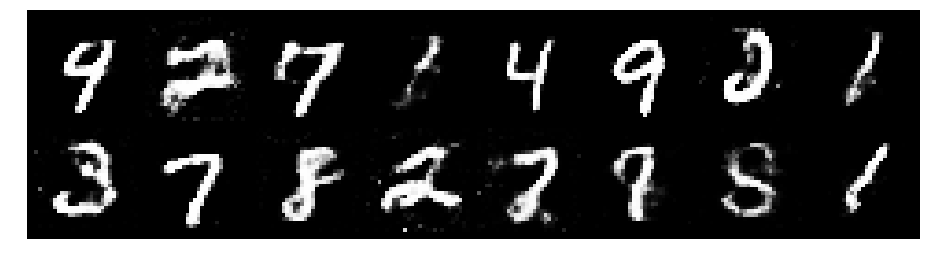

Epoch: [151/200], Batch Num: [400/600]
Discriminator Loss: 1.2811, Generator Loss: 0.9125
D(x): 0.5722, D(G(z)): 0.4534


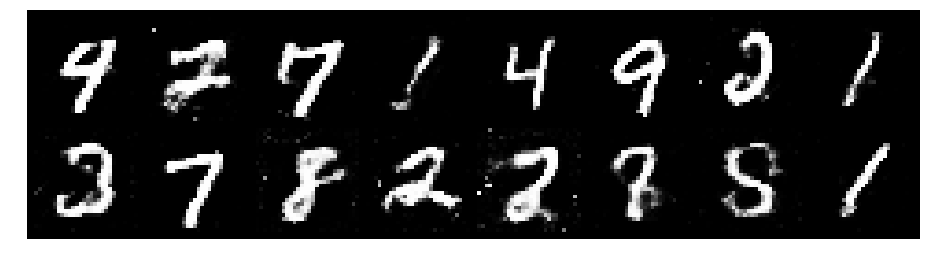

Epoch: [151/200], Batch Num: [500/600]
Discriminator Loss: 1.3533, Generator Loss: 0.9146
D(x): 0.5368, D(G(z)): 0.4595


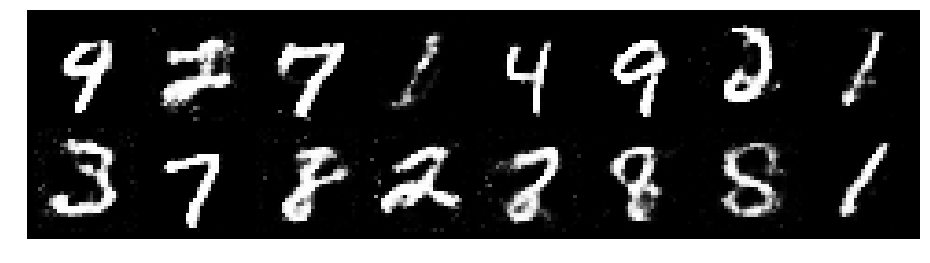

Epoch: [152/200], Batch Num: [0/600]
Discriminator Loss: 1.2210, Generator Loss: 0.8307
D(x): 0.5856, D(G(z)): 0.4547


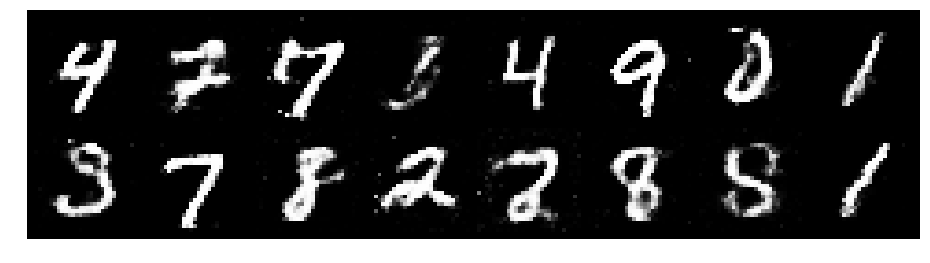

Epoch: [152/200], Batch Num: [100/600]
Discriminator Loss: 1.2334, Generator Loss: 0.8616
D(x): 0.5296, D(G(z)): 0.4159


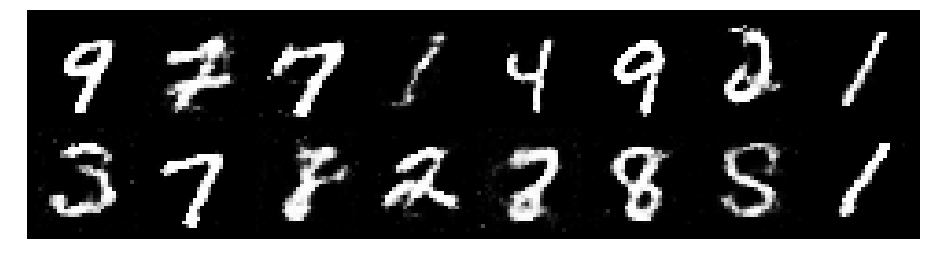

Epoch: [152/200], Batch Num: [200/600]
Discriminator Loss: 1.3377, Generator Loss: 0.8121
D(x): 0.5497, D(G(z)): 0.4735


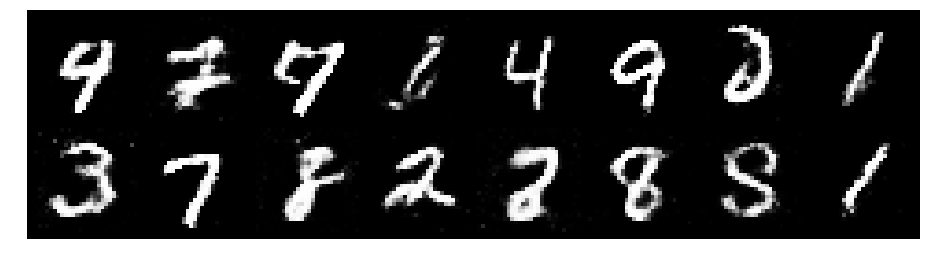

Epoch: [152/200], Batch Num: [300/600]
Discriminator Loss: 1.1355, Generator Loss: 0.9554
D(x): 0.5895, D(G(z)): 0.4145


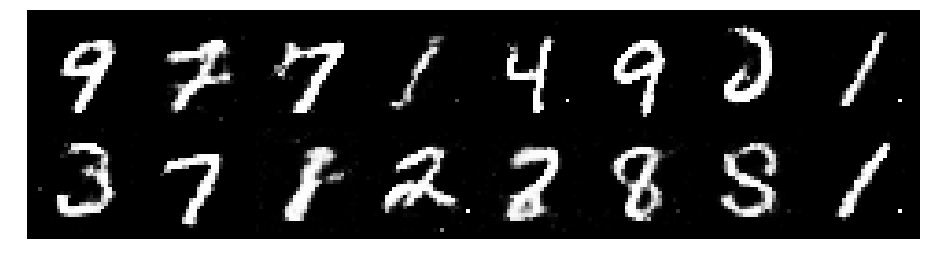

Epoch: [152/200], Batch Num: [400/600]
Discriminator Loss: 1.1889, Generator Loss: 0.9230
D(x): 0.6220, D(G(z)): 0.4476


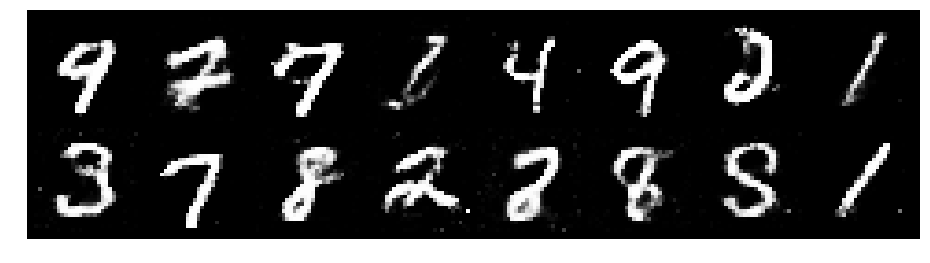

Epoch: [152/200], Batch Num: [500/600]
Discriminator Loss: 1.2097, Generator Loss: 0.8917
D(x): 0.5554, D(G(z)): 0.4192


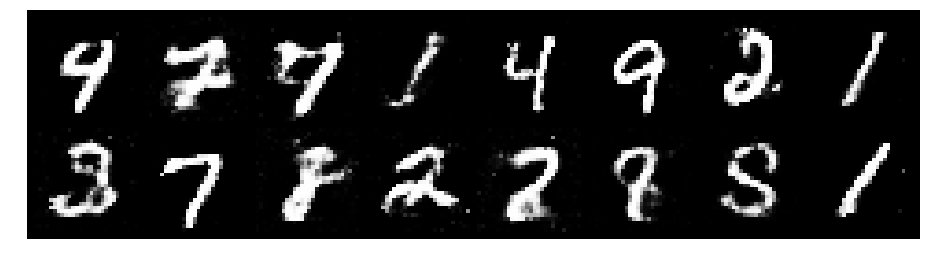

Epoch: [153/200], Batch Num: [0/600]
Discriminator Loss: 1.1143, Generator Loss: 0.9331
D(x): 0.5921, D(G(z)): 0.3989


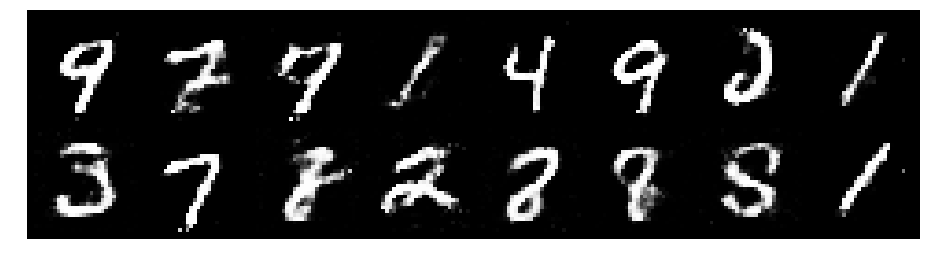

Epoch: [153/200], Batch Num: [100/600]
Discriminator Loss: 1.2402, Generator Loss: 0.9399
D(x): 0.5475, D(G(z)): 0.4223


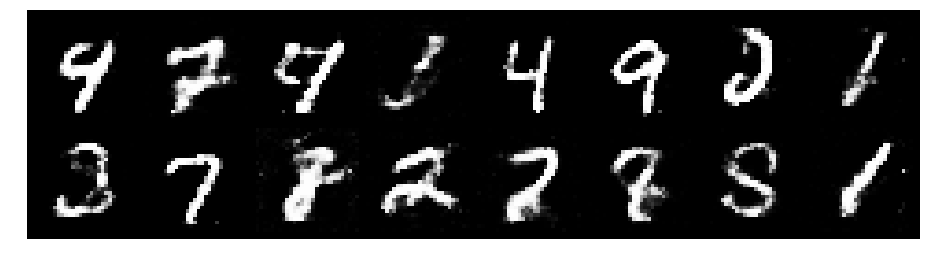

Epoch: [153/200], Batch Num: [200/600]
Discriminator Loss: 1.1805, Generator Loss: 0.9454
D(x): 0.5815, D(G(z)): 0.4336


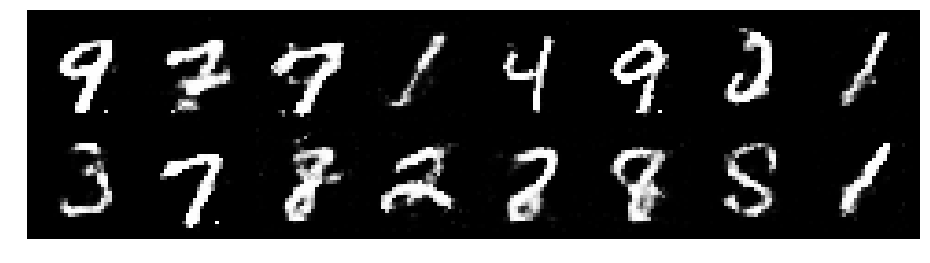

Epoch: [153/200], Batch Num: [300/600]
Discriminator Loss: 1.2335, Generator Loss: 0.9672
D(x): 0.5561, D(G(z)): 0.4262


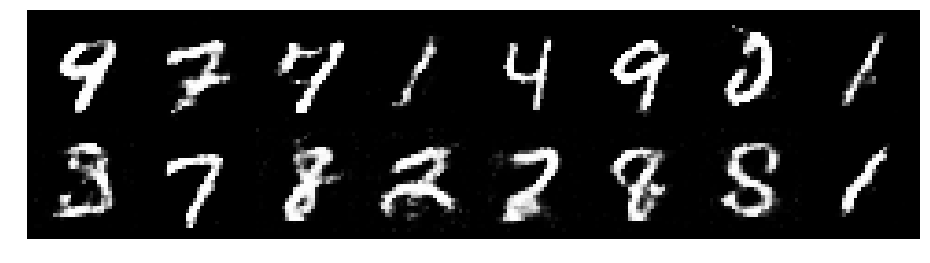

Epoch: [153/200], Batch Num: [400/600]
Discriminator Loss: 1.3258, Generator Loss: 0.8519
D(x): 0.5248, D(G(z)): 0.4444


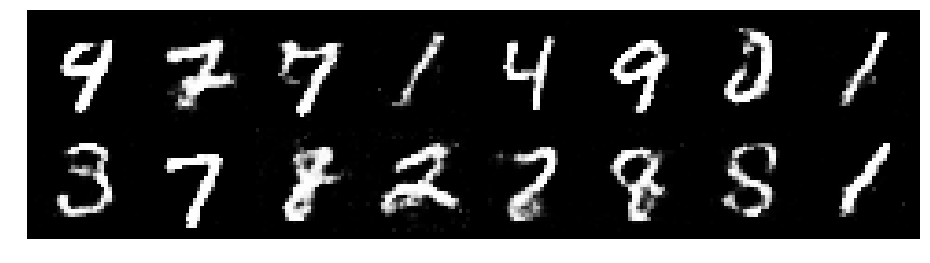

Epoch: [153/200], Batch Num: [500/600]
Discriminator Loss: 1.4765, Generator Loss: 0.9325
D(x): 0.4995, D(G(z)): 0.4645


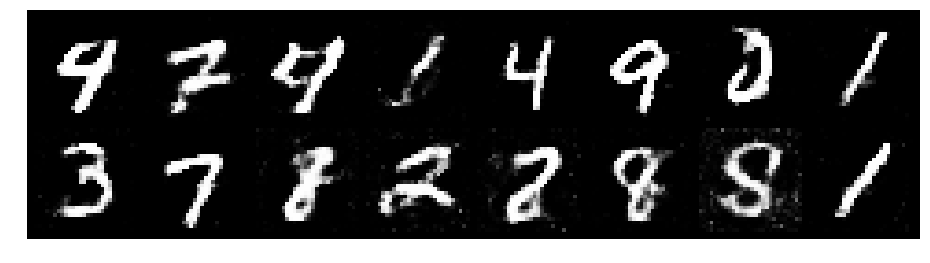

Epoch: [154/200], Batch Num: [0/600]
Discriminator Loss: 1.3540, Generator Loss: 0.8735
D(x): 0.5453, D(G(z)): 0.4510


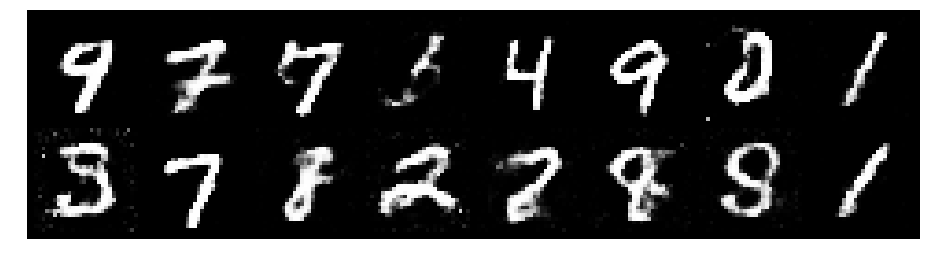

Epoch: [154/200], Batch Num: [100/600]
Discriminator Loss: 1.3249, Generator Loss: 0.9480
D(x): 0.5400, D(G(z)): 0.4397


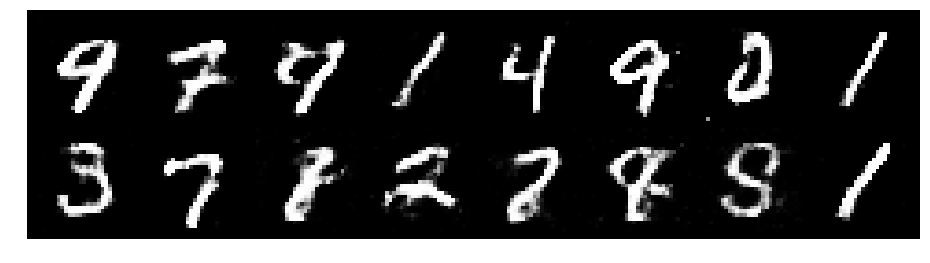

Epoch: [154/200], Batch Num: [200/600]
Discriminator Loss: 1.2983, Generator Loss: 0.8834
D(x): 0.5480, D(G(z)): 0.4644


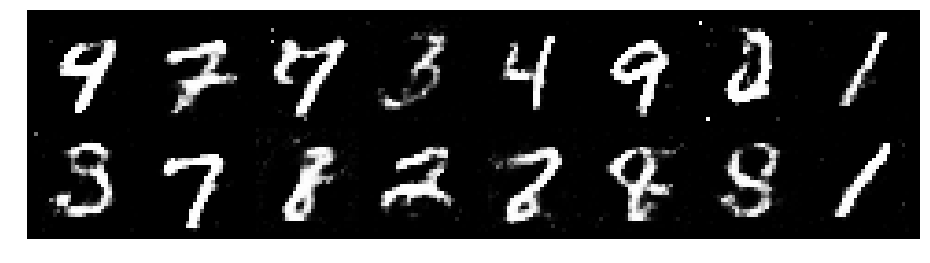

Epoch: [154/200], Batch Num: [300/600]
Discriminator Loss: 1.1996, Generator Loss: 0.8729
D(x): 0.5643, D(G(z)): 0.4162


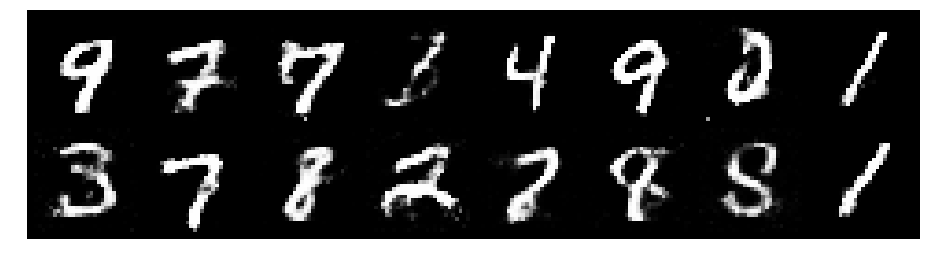

Epoch: [154/200], Batch Num: [400/600]
Discriminator Loss: 1.1790, Generator Loss: 1.0777
D(x): 0.5863, D(G(z)): 0.4210


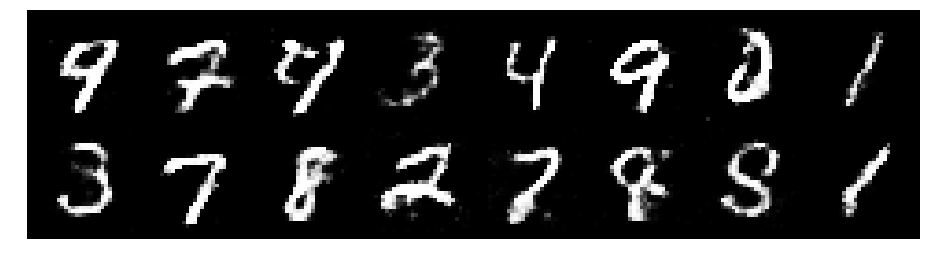

Epoch: [154/200], Batch Num: [500/600]
Discriminator Loss: 1.1670, Generator Loss: 0.9837
D(x): 0.5530, D(G(z)): 0.4006


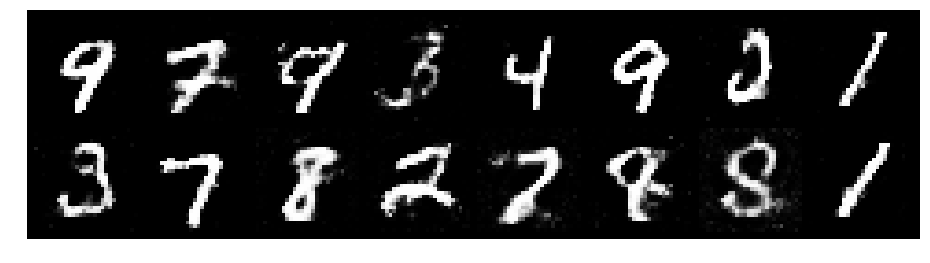

Epoch: [155/200], Batch Num: [0/600]
Discriminator Loss: 1.2963, Generator Loss: 0.8674
D(x): 0.5192, D(G(z)): 0.4359


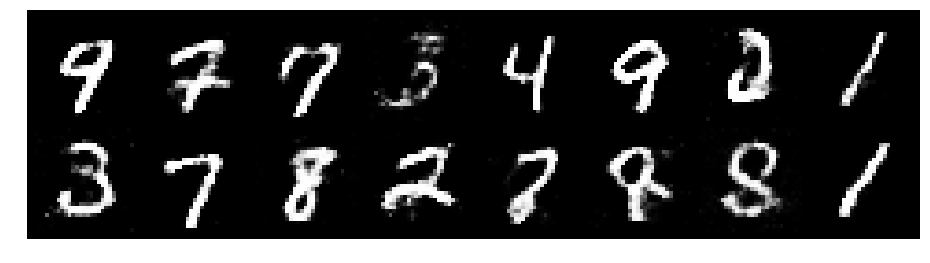

Epoch: [155/200], Batch Num: [100/600]
Discriminator Loss: 1.2104, Generator Loss: 0.8418
D(x): 0.5596, D(G(z)): 0.4357


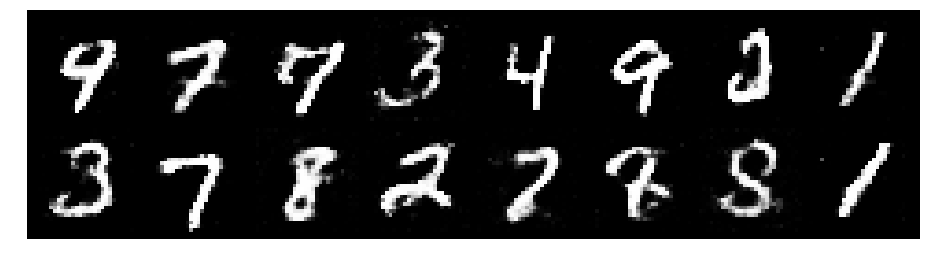

Epoch: [155/200], Batch Num: [200/600]
Discriminator Loss: 1.3411, Generator Loss: 0.8463
D(x): 0.5699, D(G(z)): 0.4781


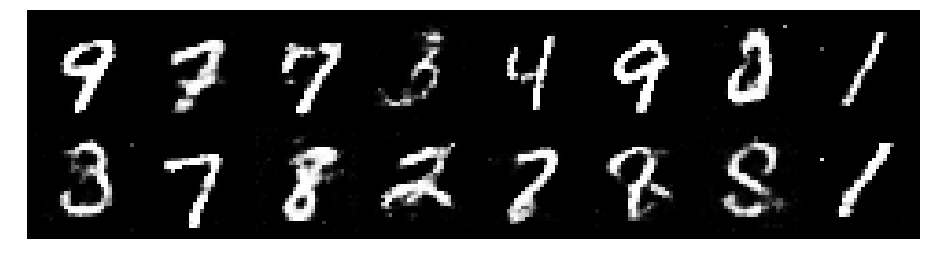

Epoch: [155/200], Batch Num: [300/600]
Discriminator Loss: 1.2305, Generator Loss: 0.8961
D(x): 0.5308, D(G(z)): 0.4103


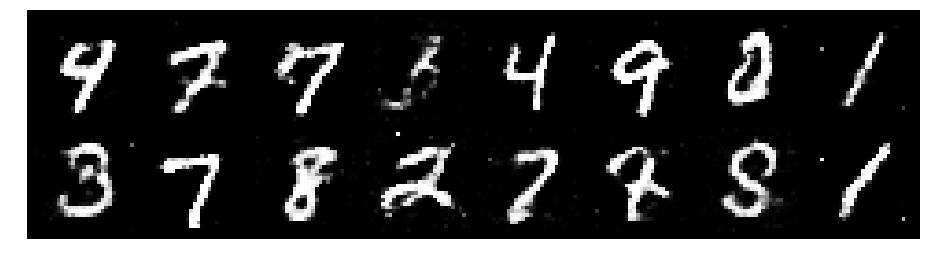

Epoch: [155/200], Batch Num: [400/600]
Discriminator Loss: 1.2095, Generator Loss: 1.0251
D(x): 0.5436, D(G(z)): 0.3876


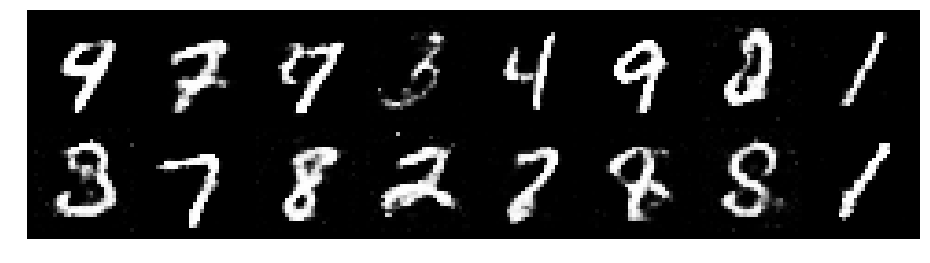

Epoch: [155/200], Batch Num: [500/600]
Discriminator Loss: 1.2464, Generator Loss: 0.9477
D(x): 0.5484, D(G(z)): 0.4268


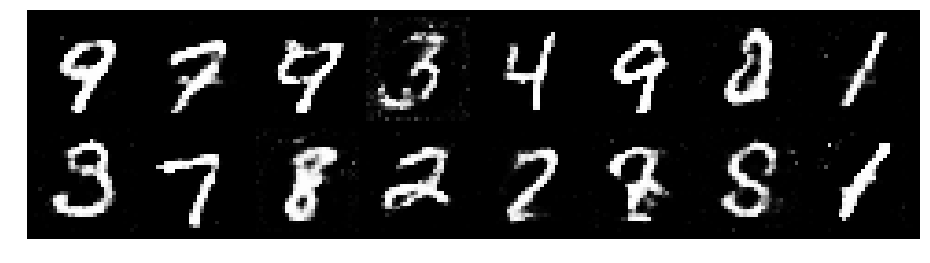

Epoch: [156/200], Batch Num: [0/600]
Discriminator Loss: 1.3486, Generator Loss: 0.7582
D(x): 0.5769, D(G(z)): 0.4868


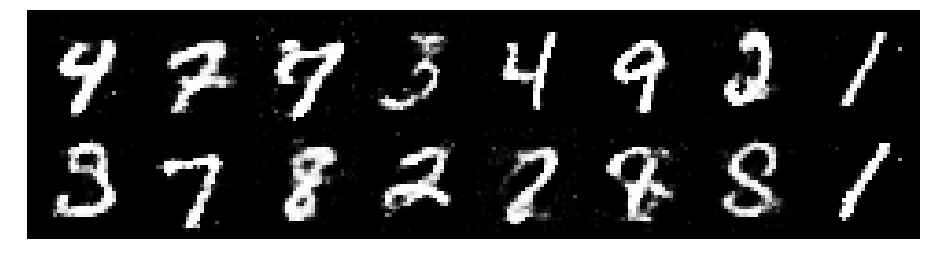

Epoch: [156/200], Batch Num: [100/600]
Discriminator Loss: 1.4470, Generator Loss: 0.8586
D(x): 0.5151, D(G(z)): 0.4891


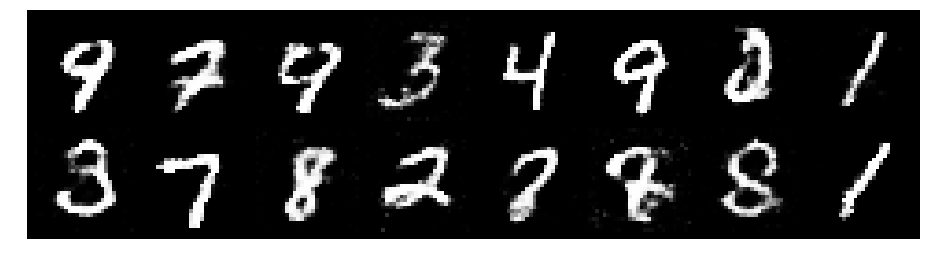

Epoch: [156/200], Batch Num: [200/600]
Discriminator Loss: 1.3449, Generator Loss: 0.9365
D(x): 0.4937, D(G(z)): 0.4137


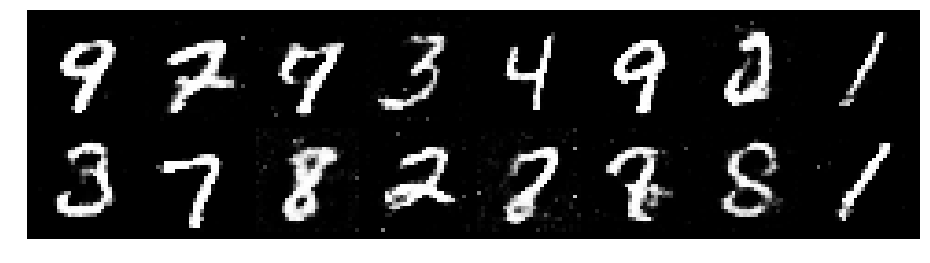

Epoch: [156/200], Batch Num: [300/600]
Discriminator Loss: 1.2663, Generator Loss: 0.8863
D(x): 0.5607, D(G(z)): 0.4499


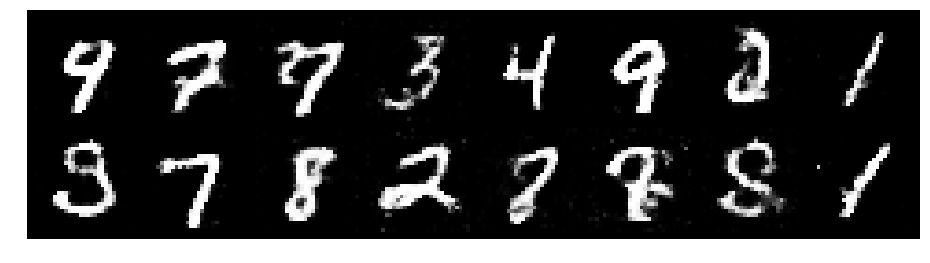

Epoch: [156/200], Batch Num: [400/600]
Discriminator Loss: 1.2425, Generator Loss: 0.8320
D(x): 0.5362, D(G(z)): 0.4322


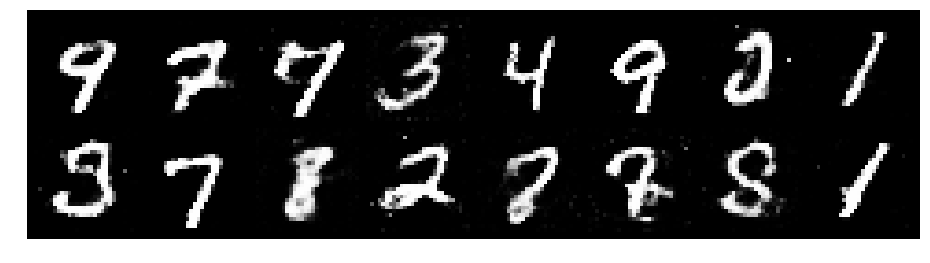

Epoch: [156/200], Batch Num: [500/600]
Discriminator Loss: 1.3231, Generator Loss: 0.8147
D(x): 0.5499, D(G(z)): 0.4715


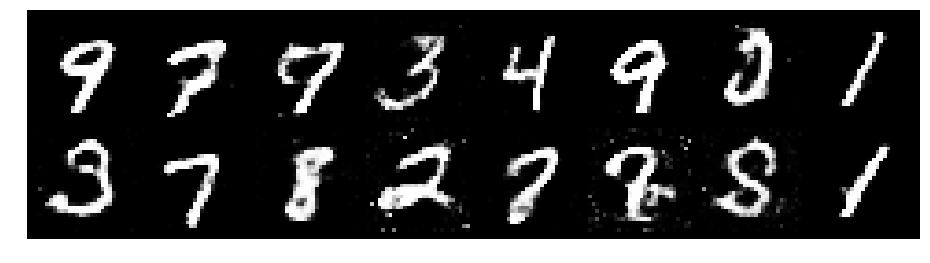

Epoch: [157/200], Batch Num: [0/600]
Discriminator Loss: 1.1864, Generator Loss: 1.0199
D(x): 0.5935, D(G(z)): 0.4302


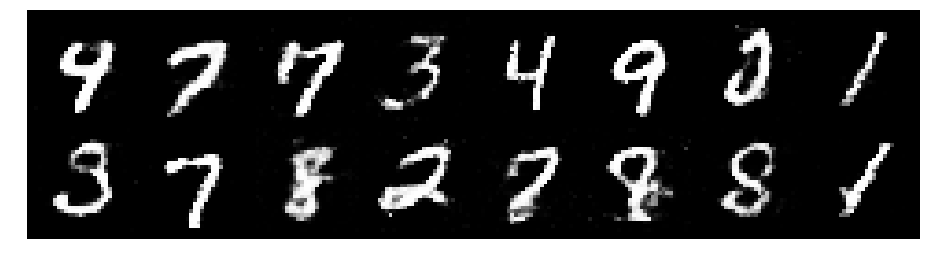

Epoch: [157/200], Batch Num: [100/600]
Discriminator Loss: 1.1904, Generator Loss: 1.0220
D(x): 0.5544, D(G(z)): 0.3892


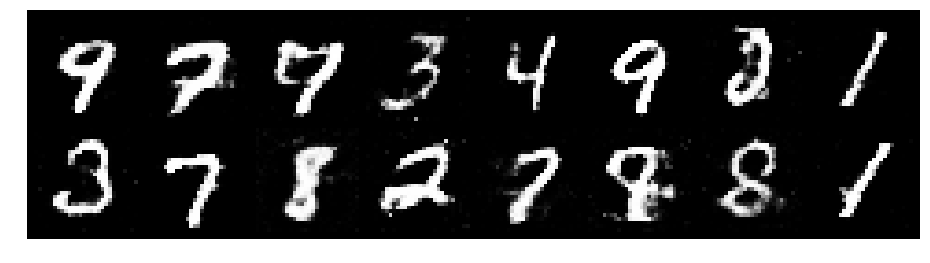

Epoch: [157/200], Batch Num: [200/600]
Discriminator Loss: 1.2257, Generator Loss: 0.9136
D(x): 0.5811, D(G(z)): 0.4352


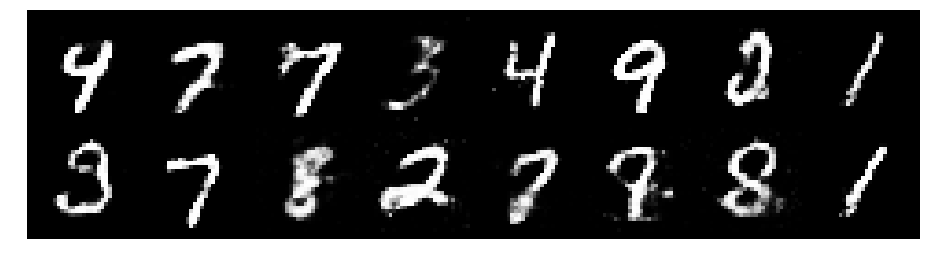

Epoch: [157/200], Batch Num: [300/600]
Discriminator Loss: 1.3181, Generator Loss: 0.9784
D(x): 0.5857, D(G(z)): 0.4603


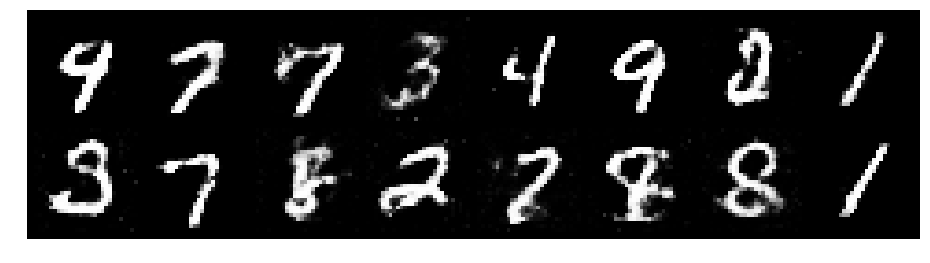

Epoch: [157/200], Batch Num: [400/600]
Discriminator Loss: 1.3507, Generator Loss: 0.9461
D(x): 0.5339, D(G(z)): 0.4429


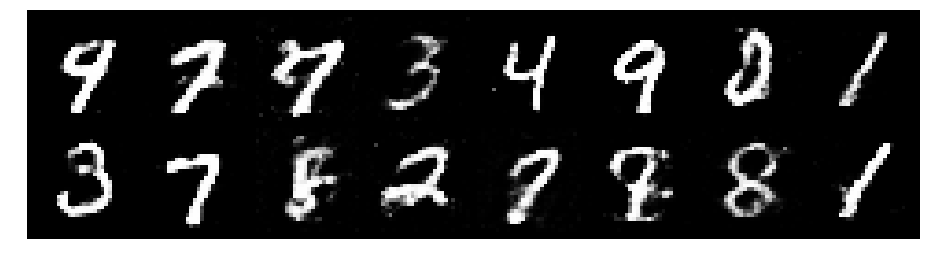

Epoch: [157/200], Batch Num: [500/600]
Discriminator Loss: 1.3368, Generator Loss: 0.8458
D(x): 0.5425, D(G(z)): 0.4649


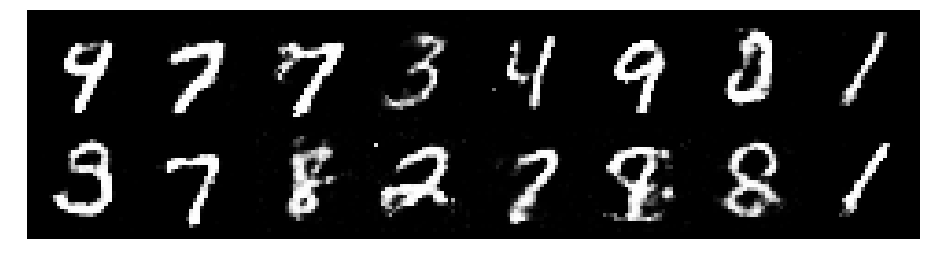

Epoch: [158/200], Batch Num: [0/600]
Discriminator Loss: 1.3950, Generator Loss: 0.8388
D(x): 0.5224, D(G(z)): 0.4793


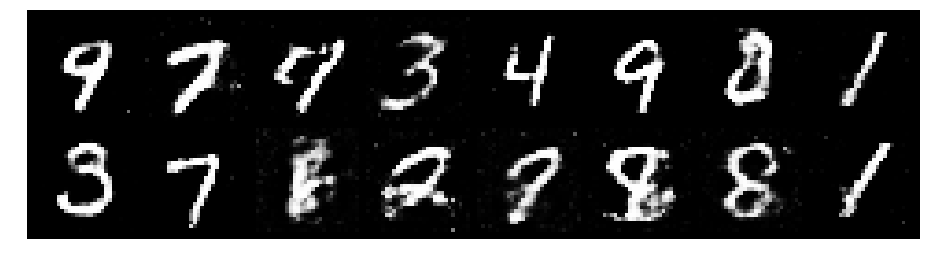

Epoch: [158/200], Batch Num: [100/600]
Discriminator Loss: 1.4485, Generator Loss: 0.8424
D(x): 0.4707, D(G(z)): 0.4533


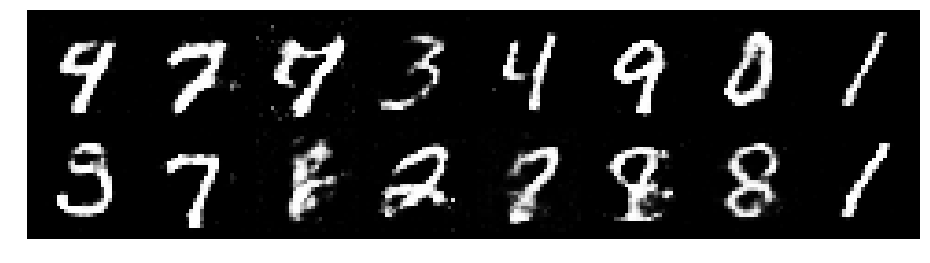

Epoch: [158/200], Batch Num: [200/600]
Discriminator Loss: 1.2129, Generator Loss: 0.9607
D(x): 0.5789, D(G(z)): 0.4149


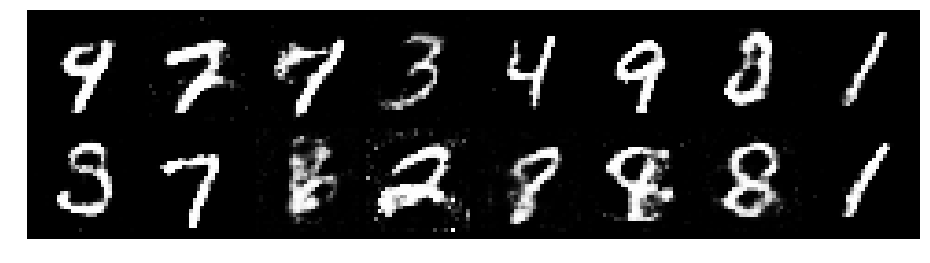

Epoch: [158/200], Batch Num: [300/600]
Discriminator Loss: 1.2042, Generator Loss: 0.9659
D(x): 0.5607, D(G(z)): 0.4056


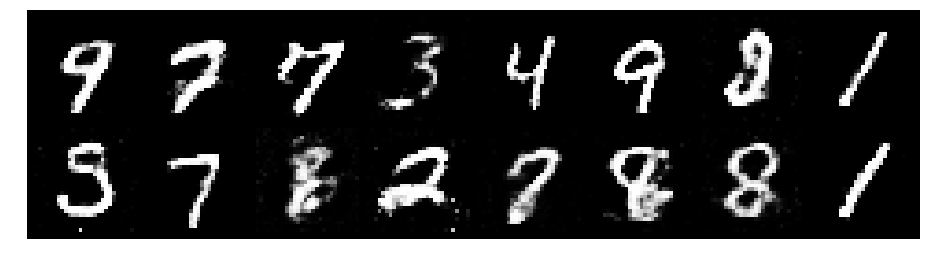

Epoch: [158/200], Batch Num: [400/600]
Discriminator Loss: 1.2654, Generator Loss: 0.9595
D(x): 0.5845, D(G(z)): 0.4599


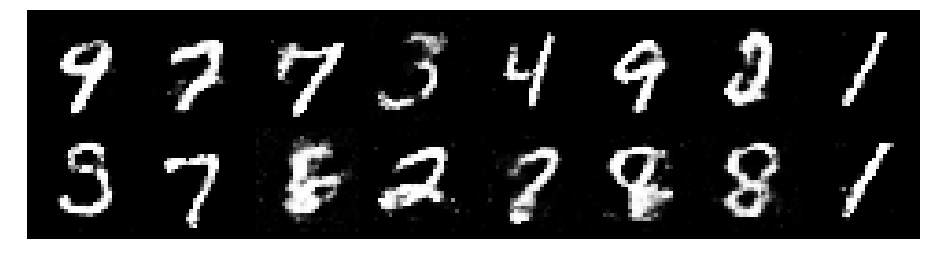

Epoch: [158/200], Batch Num: [500/600]
Discriminator Loss: 1.1506, Generator Loss: 0.9954
D(x): 0.5799, D(G(z)): 0.4022


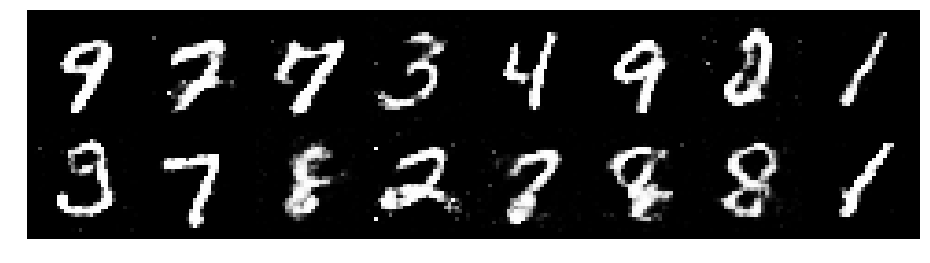

Epoch: [159/200], Batch Num: [0/600]
Discriminator Loss: 1.2654, Generator Loss: 0.8452
D(x): 0.5301, D(G(z)): 0.4455


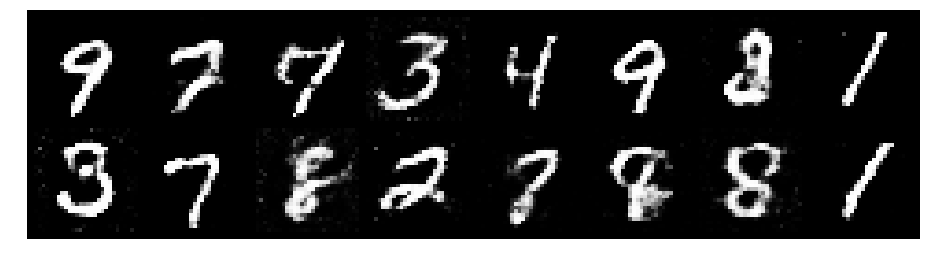

Epoch: [159/200], Batch Num: [100/600]
Discriminator Loss: 1.2431, Generator Loss: 0.9911
D(x): 0.5394, D(G(z)): 0.4236


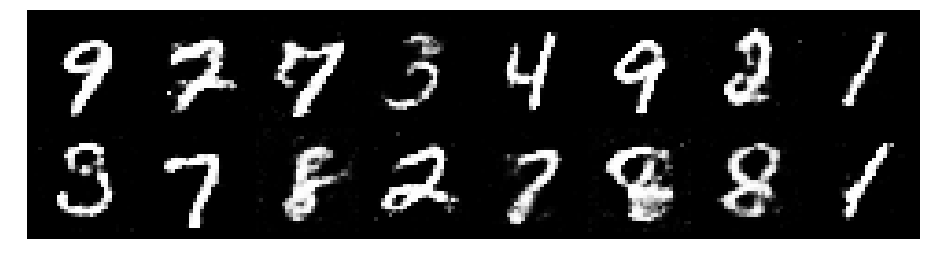

Epoch: [159/200], Batch Num: [200/600]
Discriminator Loss: 1.2964, Generator Loss: 0.9482
D(x): 0.5144, D(G(z)): 0.4036


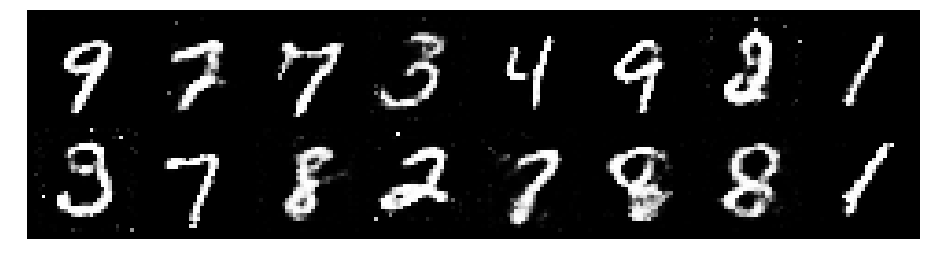

Epoch: [159/200], Batch Num: [300/600]
Discriminator Loss: 1.1608, Generator Loss: 1.0494
D(x): 0.5541, D(G(z)): 0.3913


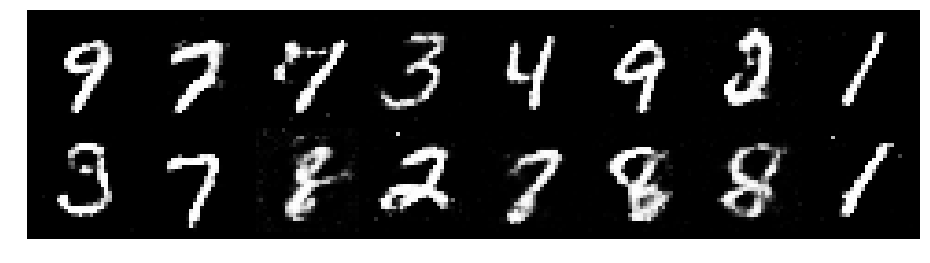

Epoch: [159/200], Batch Num: [400/600]
Discriminator Loss: 1.1991, Generator Loss: 1.0180
D(x): 0.5443, D(G(z)): 0.3956


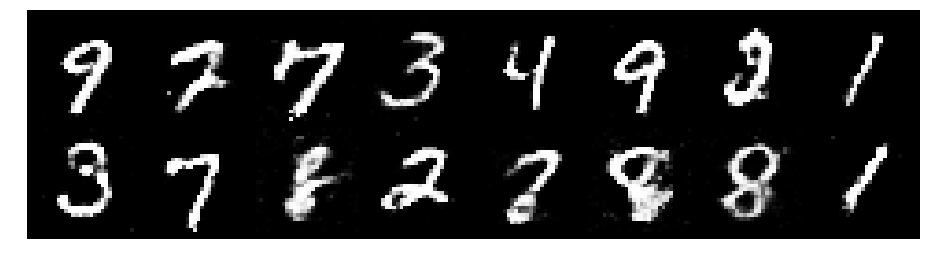

Epoch: [159/200], Batch Num: [500/600]
Discriminator Loss: 1.2190, Generator Loss: 0.8698
D(x): 0.5700, D(G(z)): 0.4486


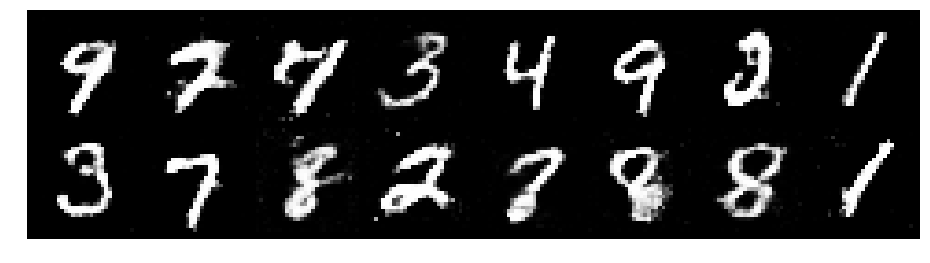

Epoch: [160/200], Batch Num: [0/600]
Discriminator Loss: 1.2837, Generator Loss: 0.8228
D(x): 0.5483, D(G(z)): 0.4514


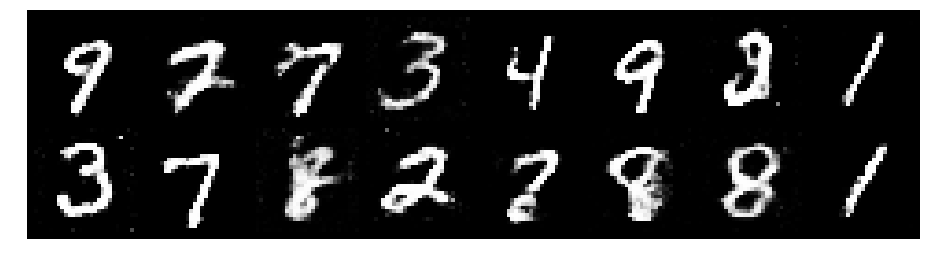

Epoch: [160/200], Batch Num: [100/600]
Discriminator Loss: 1.2950, Generator Loss: 0.9906
D(x): 0.5553, D(G(z)): 0.4505


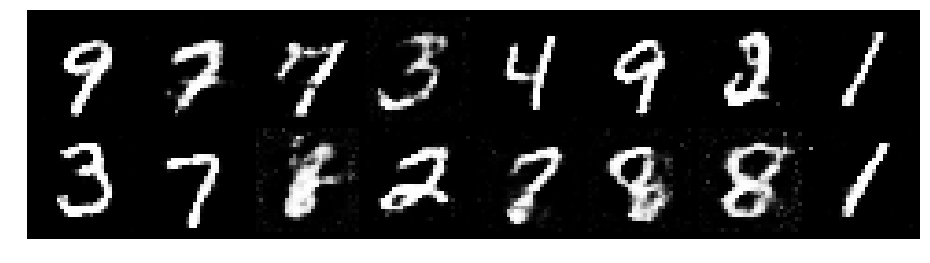

Epoch: [160/200], Batch Num: [200/600]
Discriminator Loss: 1.3114, Generator Loss: 0.8915
D(x): 0.5308, D(G(z)): 0.4543


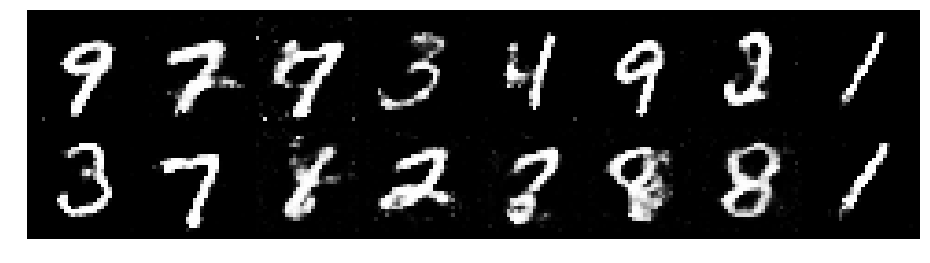

Epoch: [160/200], Batch Num: [300/600]
Discriminator Loss: 1.2671, Generator Loss: 0.9892
D(x): 0.5330, D(G(z)): 0.4207


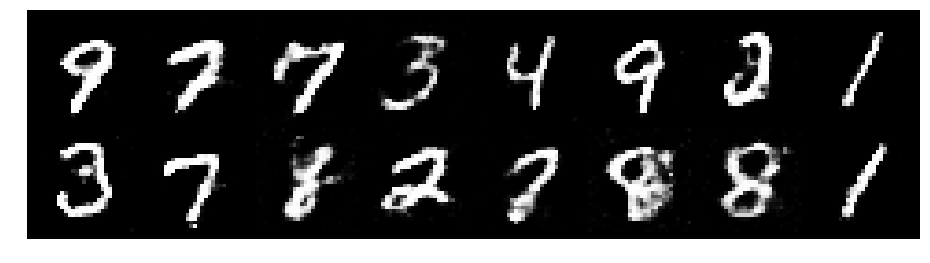

Epoch: [160/200], Batch Num: [400/600]
Discriminator Loss: 1.2274, Generator Loss: 0.8838
D(x): 0.5559, D(G(z)): 0.4312


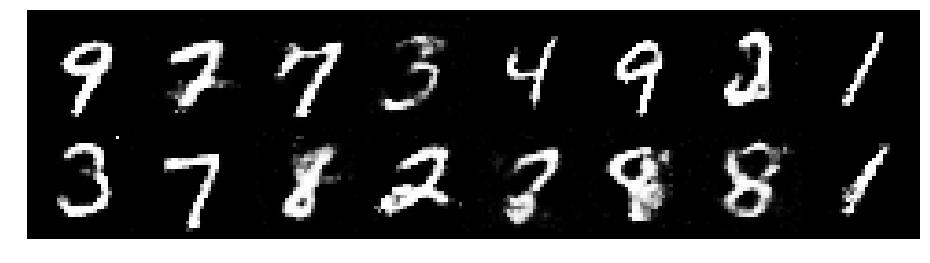

Epoch: [160/200], Batch Num: [500/600]
Discriminator Loss: 1.2211, Generator Loss: 0.9185
D(x): 0.5518, D(G(z)): 0.4332


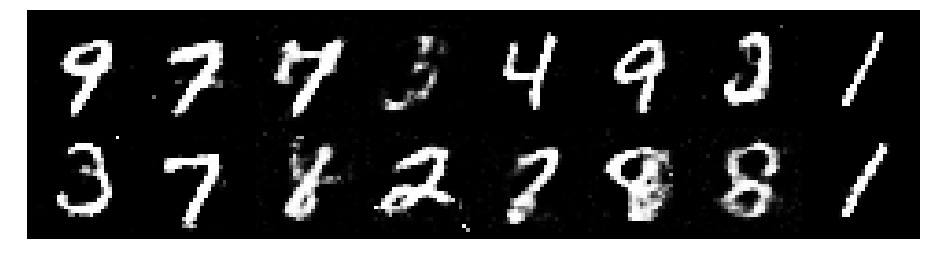

Epoch: [161/200], Batch Num: [0/600]
Discriminator Loss: 1.2881, Generator Loss: 0.8997
D(x): 0.5712, D(G(z)): 0.4816


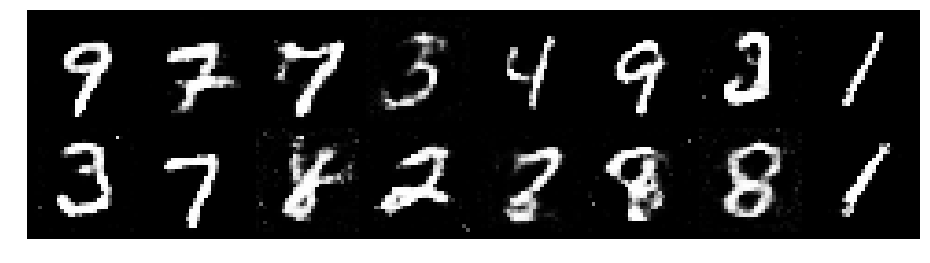

Epoch: [161/200], Batch Num: [100/600]
Discriminator Loss: 1.3193, Generator Loss: 1.0061
D(x): 0.5423, D(G(z)): 0.4352


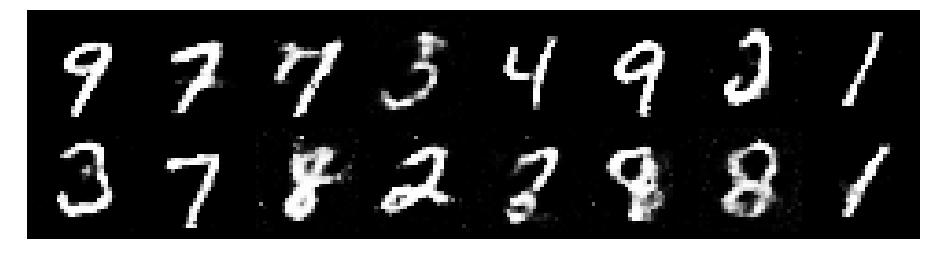

Epoch: [161/200], Batch Num: [200/600]
Discriminator Loss: 1.2381, Generator Loss: 0.9952
D(x): 0.6104, D(G(z)): 0.4609


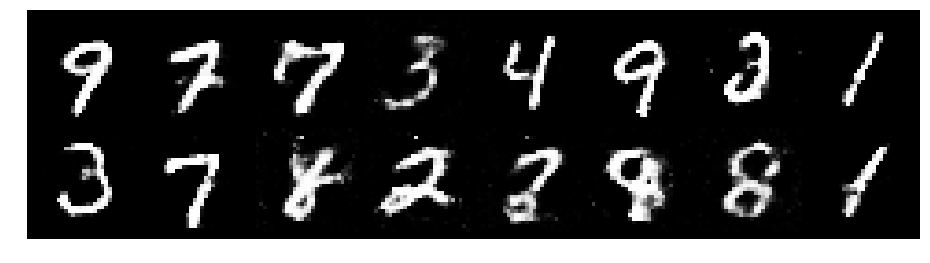

Epoch: [161/200], Batch Num: [300/600]
Discriminator Loss: 1.2312, Generator Loss: 0.9046
D(x): 0.5696, D(G(z)): 0.4565


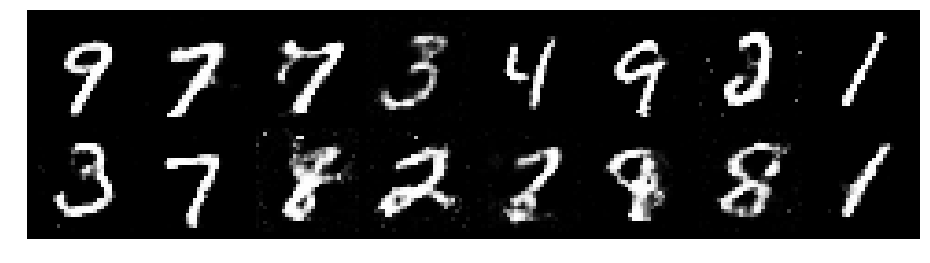

Epoch: [161/200], Batch Num: [400/600]
Discriminator Loss: 1.3643, Generator Loss: 0.8310
D(x): 0.5582, D(G(z)): 0.4994


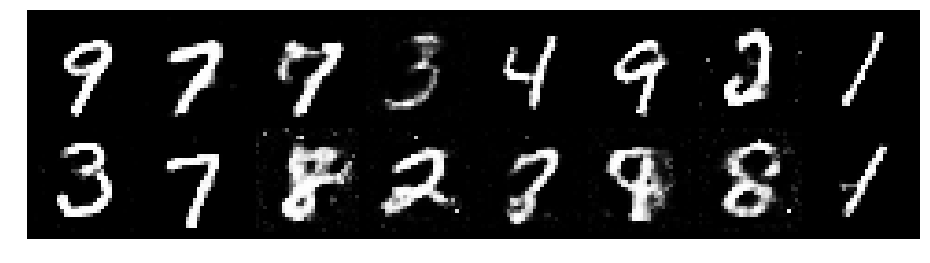

Epoch: [161/200], Batch Num: [500/600]
Discriminator Loss: 1.2718, Generator Loss: 0.8987
D(x): 0.5743, D(G(z)): 0.4499


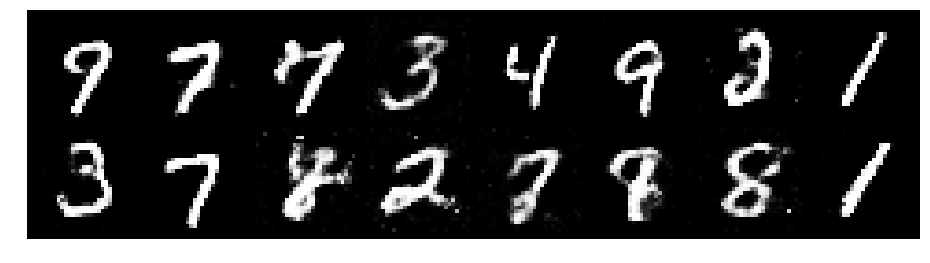

Epoch: [162/200], Batch Num: [0/600]
Discriminator Loss: 1.2664, Generator Loss: 0.8946
D(x): 0.5803, D(G(z)): 0.4562


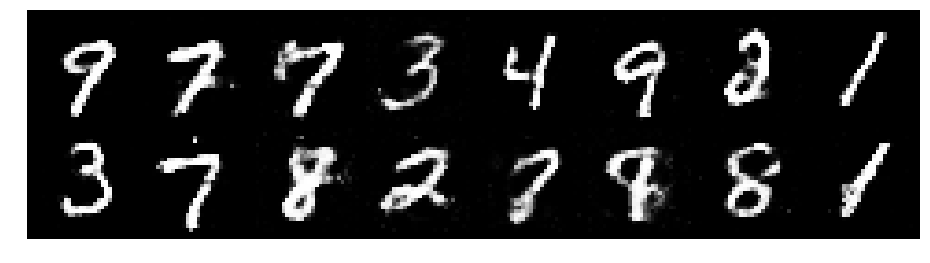

Epoch: [162/200], Batch Num: [100/600]
Discriminator Loss: 1.2877, Generator Loss: 0.9554
D(x): 0.5589, D(G(z)): 0.4352


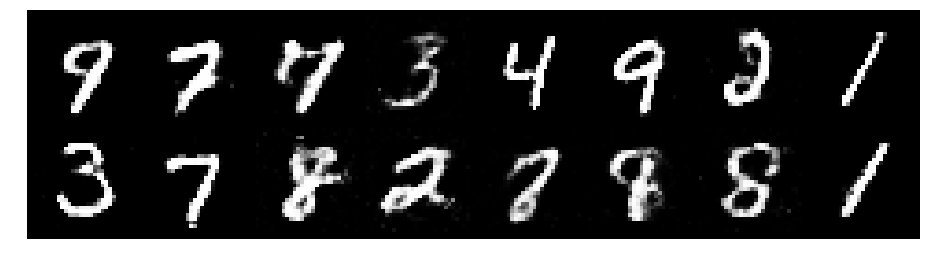

Epoch: [162/200], Batch Num: [200/600]
Discriminator Loss: 1.3091, Generator Loss: 0.8721
D(x): 0.5339, D(G(z)): 0.4558


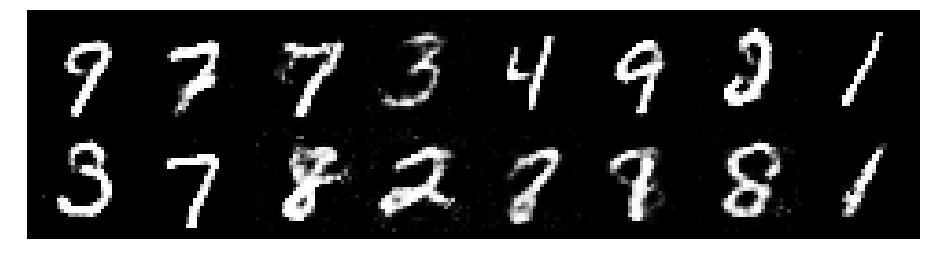

Epoch: [162/200], Batch Num: [300/600]
Discriminator Loss: 1.3052, Generator Loss: 0.9376
D(x): 0.5832, D(G(z)): 0.4766


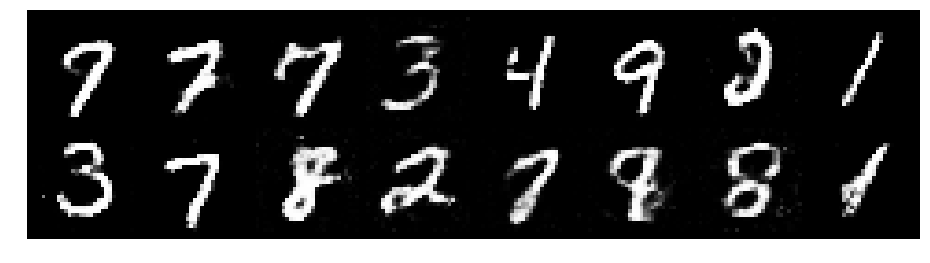

Epoch: [162/200], Batch Num: [400/600]
Discriminator Loss: 1.3436, Generator Loss: 0.8370
D(x): 0.5274, D(G(z)): 0.4636


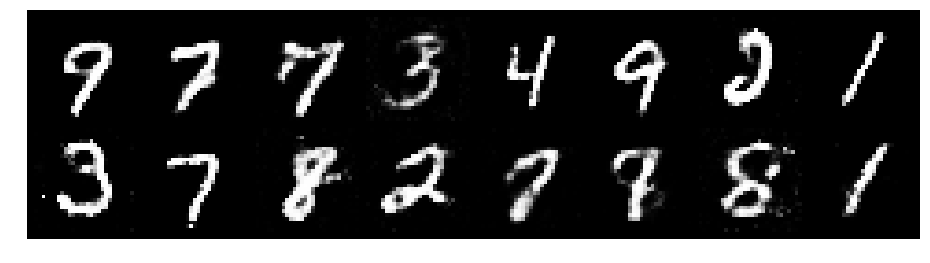

Epoch: [162/200], Batch Num: [500/600]
Discriminator Loss: 1.4199, Generator Loss: 0.8874
D(x): 0.5457, D(G(z)): 0.5041


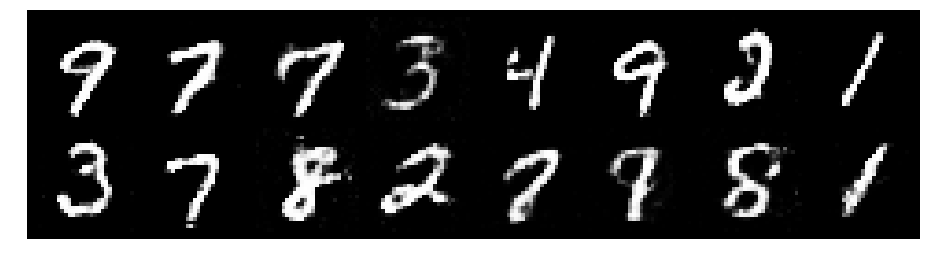

Epoch: [163/200], Batch Num: [0/600]
Discriminator Loss: 1.4411, Generator Loss: 0.8732
D(x): 0.5168, D(G(z)): 0.4810


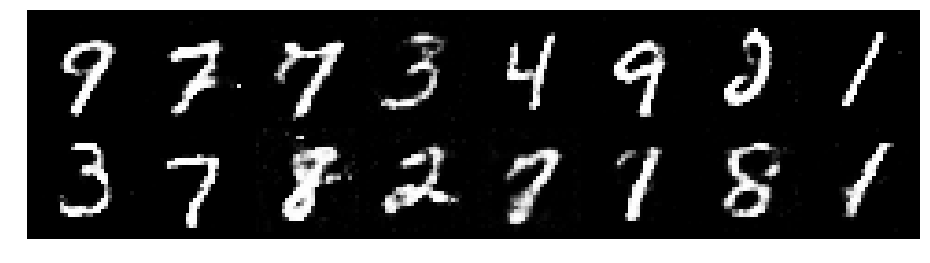

Epoch: [163/200], Batch Num: [100/600]
Discriminator Loss: 1.3452, Generator Loss: 0.9554
D(x): 0.5280, D(G(z)): 0.4570


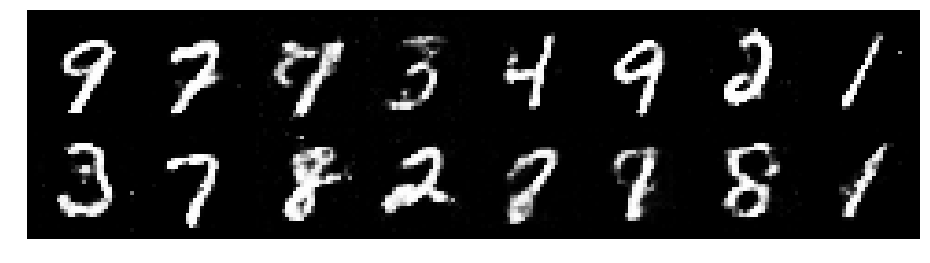

Epoch: [163/200], Batch Num: [200/600]
Discriminator Loss: 1.2840, Generator Loss: 0.8496
D(x): 0.5490, D(G(z)): 0.4545


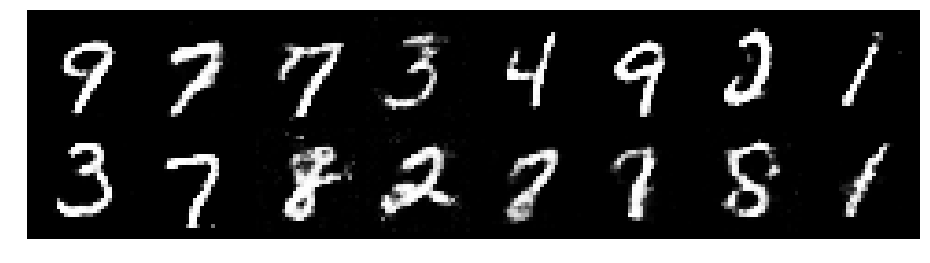

Epoch: [163/200], Batch Num: [300/600]
Discriminator Loss: 1.2489, Generator Loss: 0.8029
D(x): 0.5349, D(G(z)): 0.4311


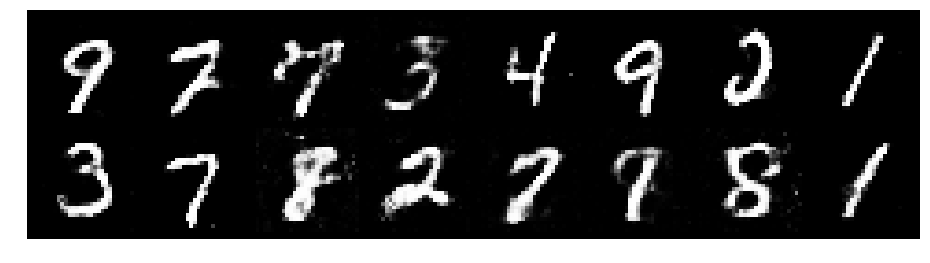

Epoch: [163/200], Batch Num: [400/600]
Discriminator Loss: 1.3144, Generator Loss: 0.8824
D(x): 0.5306, D(G(z)): 0.4281


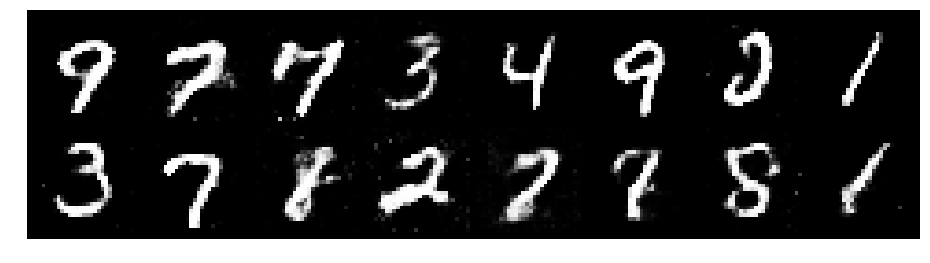

Epoch: [163/200], Batch Num: [500/600]
Discriminator Loss: 1.2334, Generator Loss: 0.9154
D(x): 0.5270, D(G(z)): 0.3969


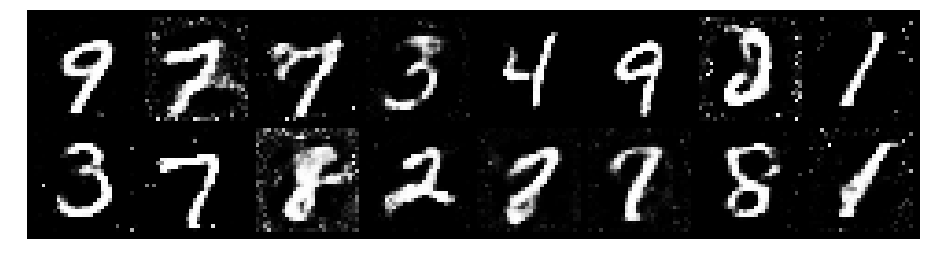

Epoch: [164/200], Batch Num: [0/600]
Discriminator Loss: 1.3692, Generator Loss: 0.9309
D(x): 0.5347, D(G(z)): 0.4610


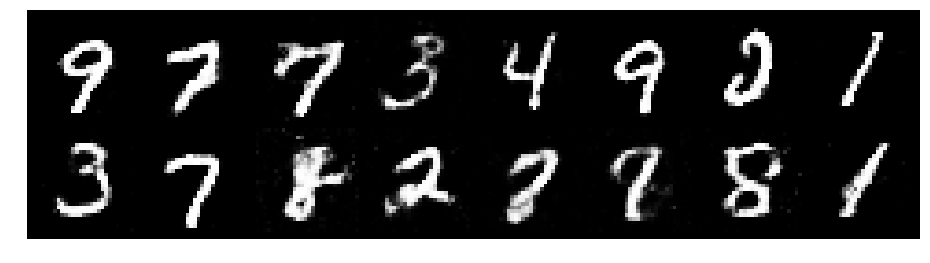

Epoch: [164/200], Batch Num: [100/600]
Discriminator Loss: 1.2705, Generator Loss: 0.9953
D(x): 0.5981, D(G(z)): 0.4692


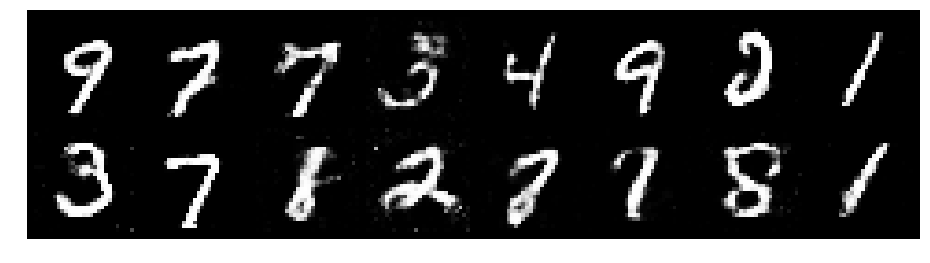

Epoch: [164/200], Batch Num: [200/600]
Discriminator Loss: 1.2509, Generator Loss: 1.0368
D(x): 0.5736, D(G(z)): 0.4248


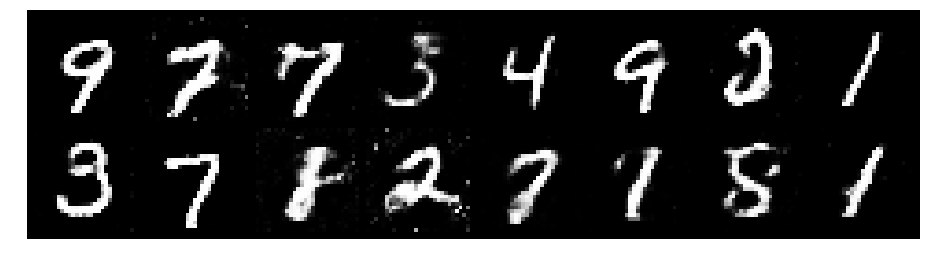

Epoch: [164/200], Batch Num: [300/600]
Discriminator Loss: 1.2120, Generator Loss: 0.9103
D(x): 0.5893, D(G(z)): 0.4364


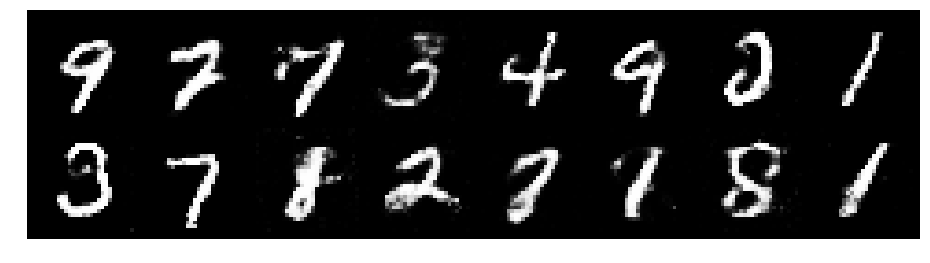

Epoch: [164/200], Batch Num: [400/600]
Discriminator Loss: 1.2685, Generator Loss: 0.8431
D(x): 0.5308, D(G(z)): 0.4407


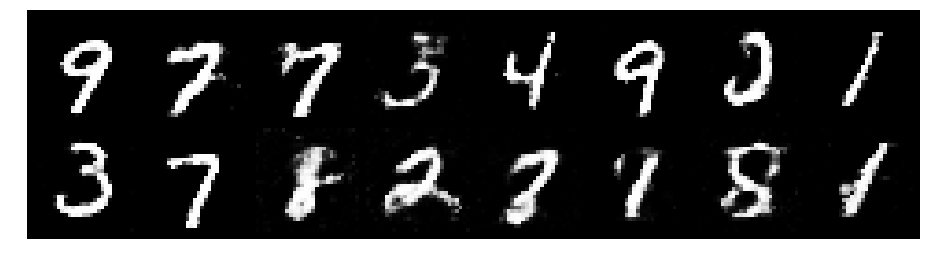

Epoch: [164/200], Batch Num: [500/600]
Discriminator Loss: 1.2522, Generator Loss: 0.8407
D(x): 0.5288, D(G(z)): 0.4289


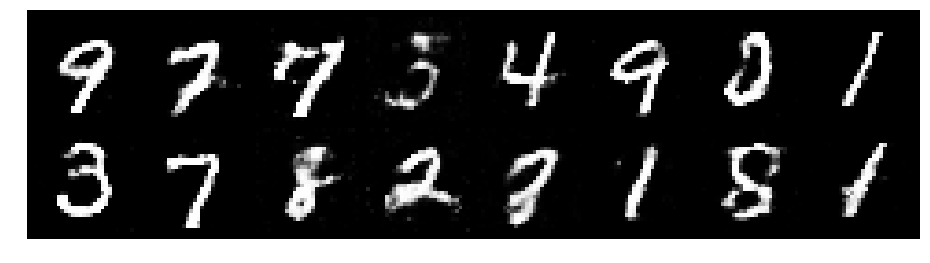

Epoch: [165/200], Batch Num: [0/600]
Discriminator Loss: 1.2606, Generator Loss: 0.8385
D(x): 0.5382, D(G(z)): 0.4288


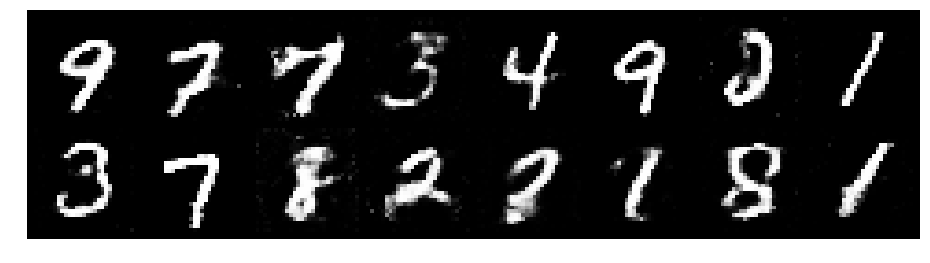

Epoch: [165/200], Batch Num: [100/600]
Discriminator Loss: 1.1118, Generator Loss: 0.9273
D(x): 0.6209, D(G(z)): 0.4177


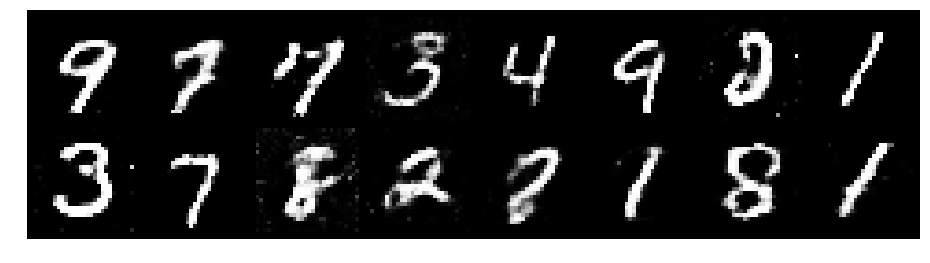

Epoch: [165/200], Batch Num: [200/600]
Discriminator Loss: 1.2336, Generator Loss: 0.8864
D(x): 0.5799, D(G(z)): 0.4579


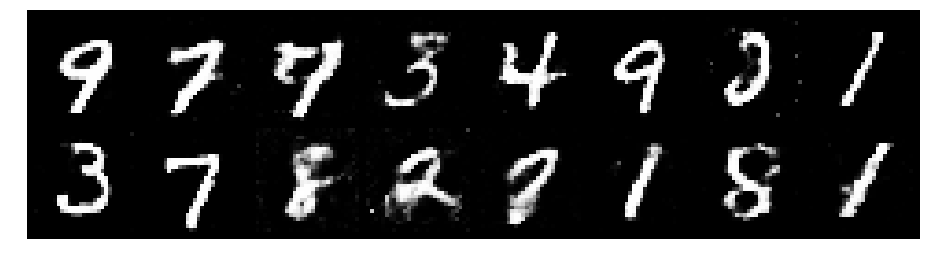

Epoch: [165/200], Batch Num: [300/600]
Discriminator Loss: 1.3326, Generator Loss: 0.8964
D(x): 0.5288, D(G(z)): 0.4554


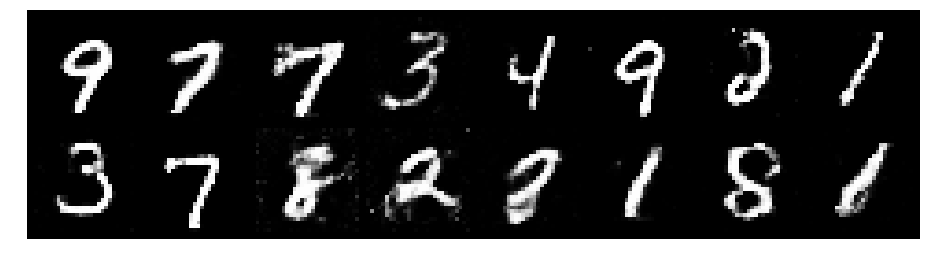

Epoch: [165/200], Batch Num: [400/600]
Discriminator Loss: 1.3582, Generator Loss: 0.7506
D(x): 0.5564, D(G(z)): 0.4901


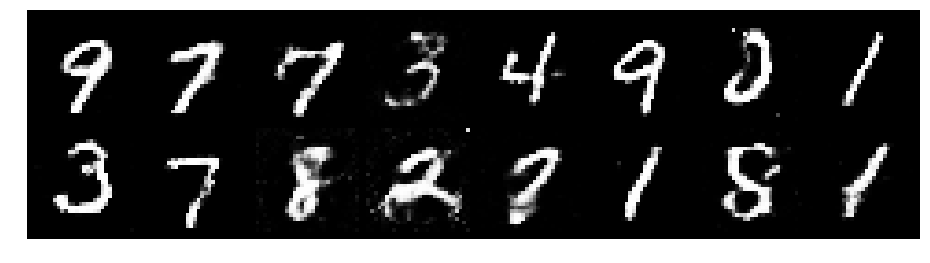

Epoch: [165/200], Batch Num: [500/600]
Discriminator Loss: 1.4348, Generator Loss: 0.8011
D(x): 0.5042, D(G(z)): 0.4794


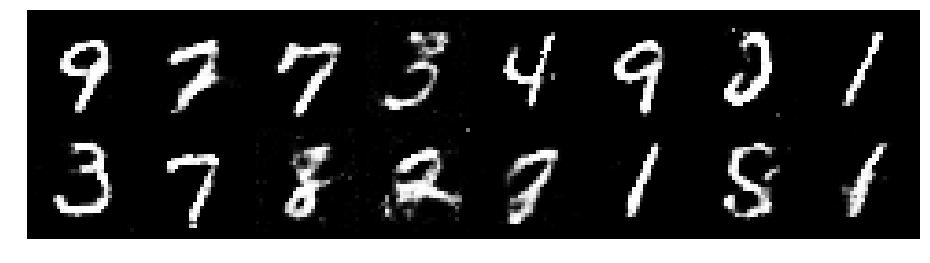

Epoch: [166/200], Batch Num: [0/600]
Discriminator Loss: 1.3065, Generator Loss: 0.8117
D(x): 0.5467, D(G(z)): 0.4642


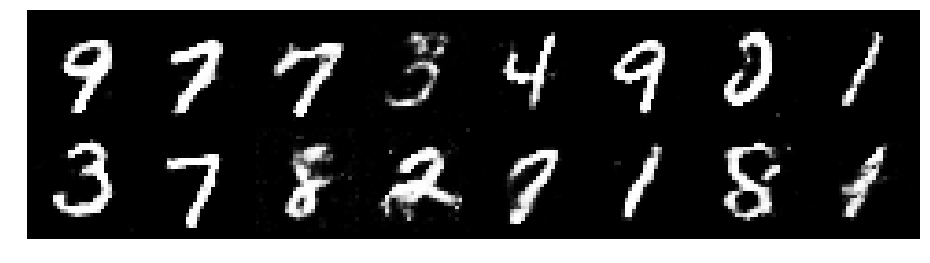

Epoch: [166/200], Batch Num: [100/600]
Discriminator Loss: 1.2351, Generator Loss: 1.0109
D(x): 0.5314, D(G(z)): 0.4159


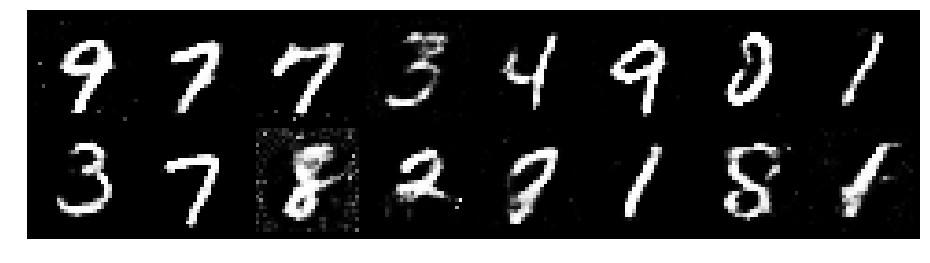

Epoch: [166/200], Batch Num: [200/600]
Discriminator Loss: 1.3016, Generator Loss: 0.8169
D(x): 0.5528, D(G(z)): 0.4699


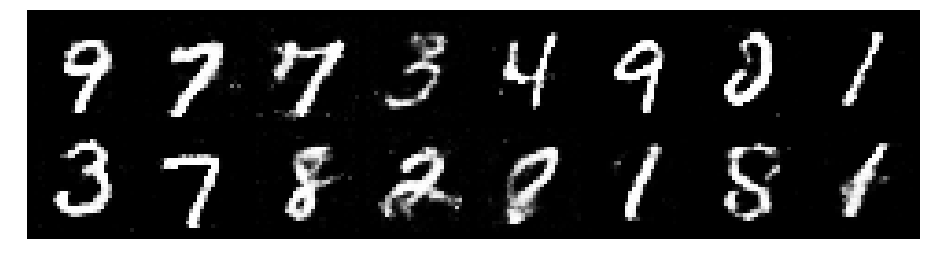

Epoch: [166/200], Batch Num: [300/600]
Discriminator Loss: 1.1487, Generator Loss: 0.9563
D(x): 0.5838, D(G(z)): 0.4094


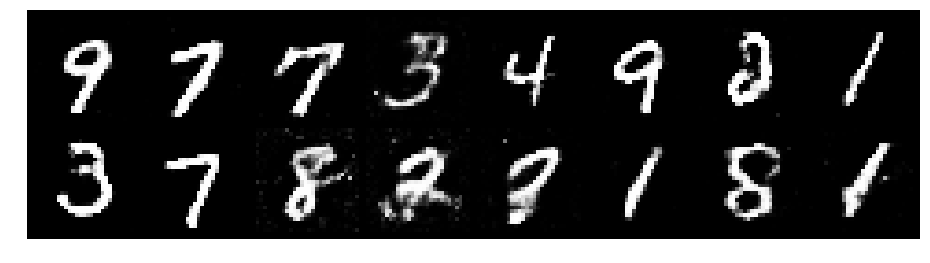

Epoch: [166/200], Batch Num: [400/600]
Discriminator Loss: 1.1831, Generator Loss: 0.9577
D(x): 0.5721, D(G(z)): 0.4169


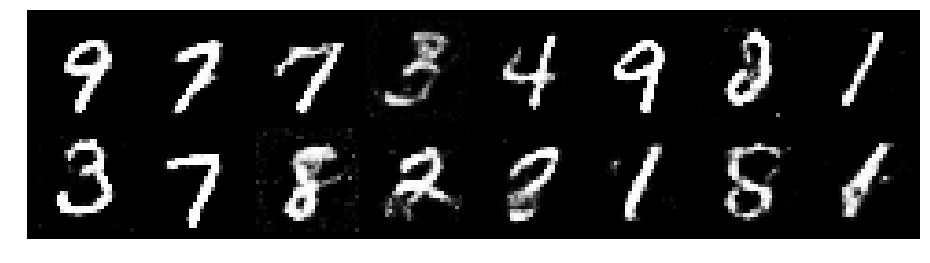

Epoch: [166/200], Batch Num: [500/600]
Discriminator Loss: 1.2693, Generator Loss: 0.8814
D(x): 0.5616, D(G(z)): 0.4518


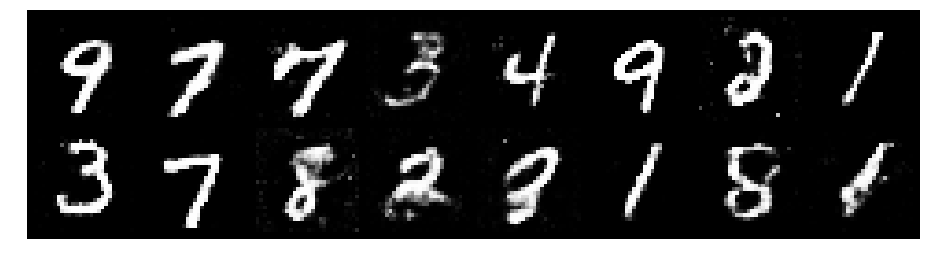

Epoch: [167/200], Batch Num: [0/600]
Discriminator Loss: 1.1579, Generator Loss: 0.9580
D(x): 0.5806, D(G(z)): 0.3877


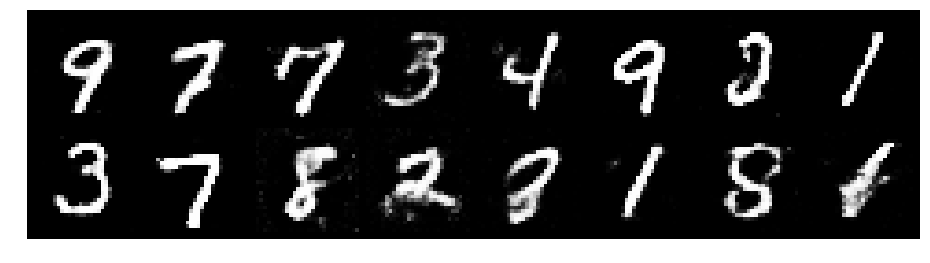

Epoch: [167/200], Batch Num: [100/600]
Discriminator Loss: 1.2430, Generator Loss: 0.9564
D(x): 0.5655, D(G(z)): 0.4355


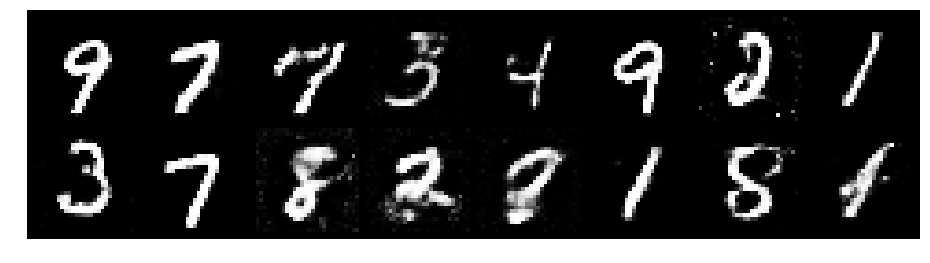

Epoch: [167/200], Batch Num: [200/600]
Discriminator Loss: 1.3232, Generator Loss: 0.9821
D(x): 0.5400, D(G(z)): 0.4216


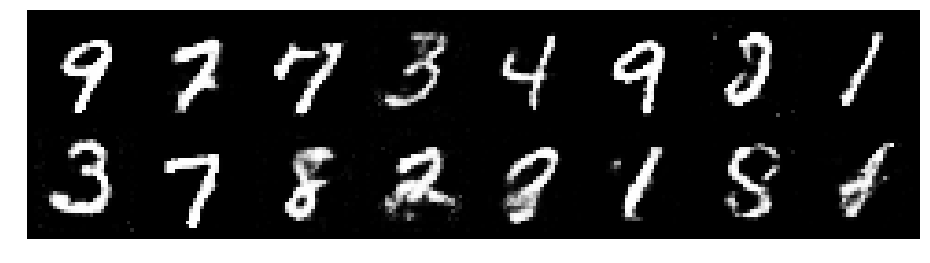

Epoch: [167/200], Batch Num: [300/600]
Discriminator Loss: 1.3870, Generator Loss: 0.9049
D(x): 0.5180, D(G(z)): 0.4400


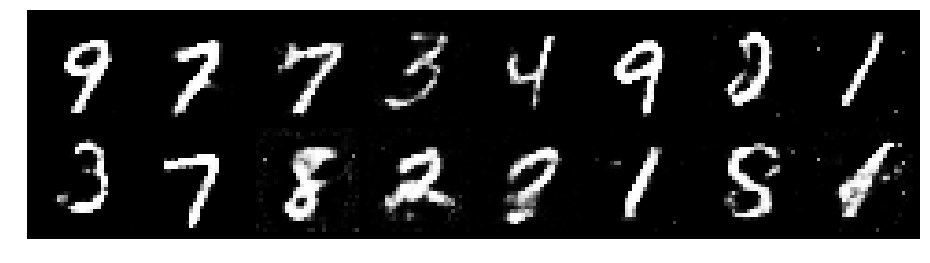

Epoch: [167/200], Batch Num: [400/600]
Discriminator Loss: 1.2724, Generator Loss: 0.8466
D(x): 0.5543, D(G(z)): 0.4550


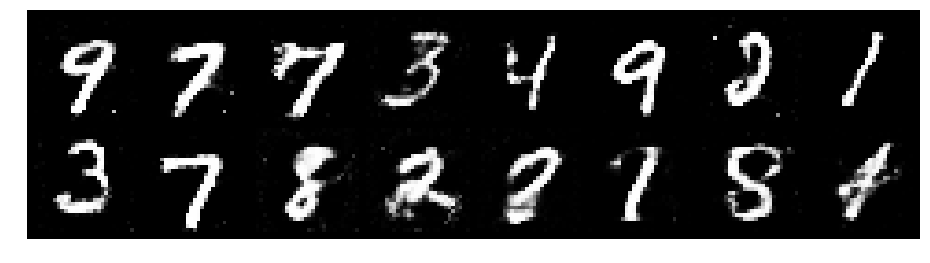

Epoch: [167/200], Batch Num: [500/600]
Discriminator Loss: 1.2605, Generator Loss: 0.8669
D(x): 0.5152, D(G(z)): 0.4146


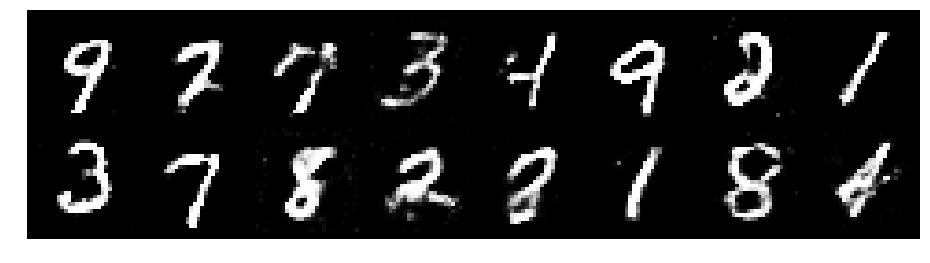

Epoch: [168/200], Batch Num: [0/600]
Discriminator Loss: 1.1558, Generator Loss: 0.9736
D(x): 0.5735, D(G(z)): 0.4108


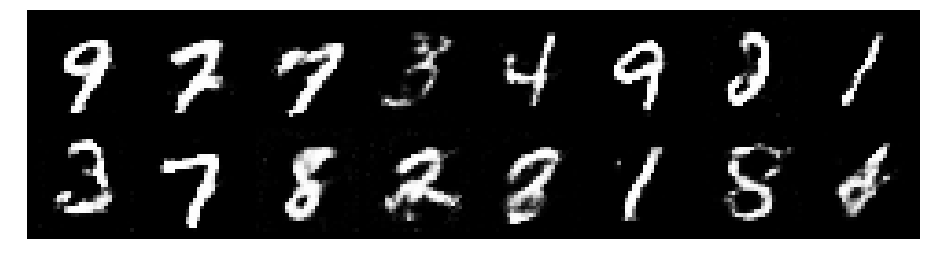

Epoch: [168/200], Batch Num: [100/600]
Discriminator Loss: 1.2481, Generator Loss: 0.9418
D(x): 0.5186, D(G(z)): 0.3949


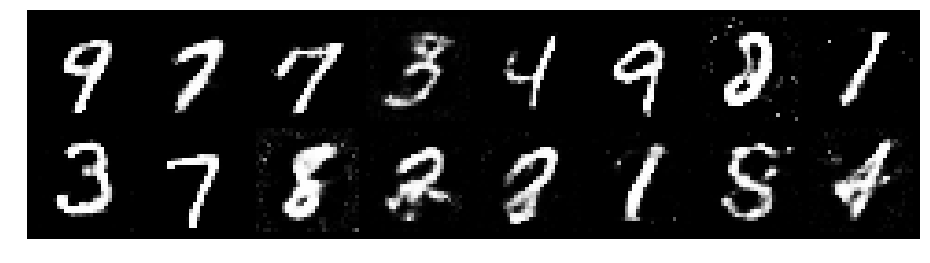

Epoch: [168/200], Batch Num: [200/600]
Discriminator Loss: 1.2714, Generator Loss: 0.8488
D(x): 0.5663, D(G(z)): 0.4558


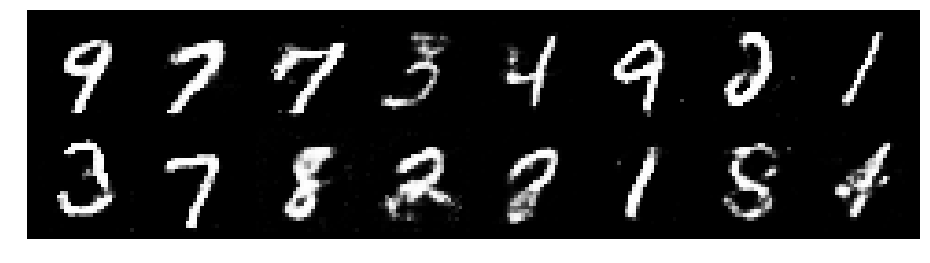

Epoch: [168/200], Batch Num: [300/600]
Discriminator Loss: 1.2251, Generator Loss: 0.8695
D(x): 0.5738, D(G(z)): 0.4263


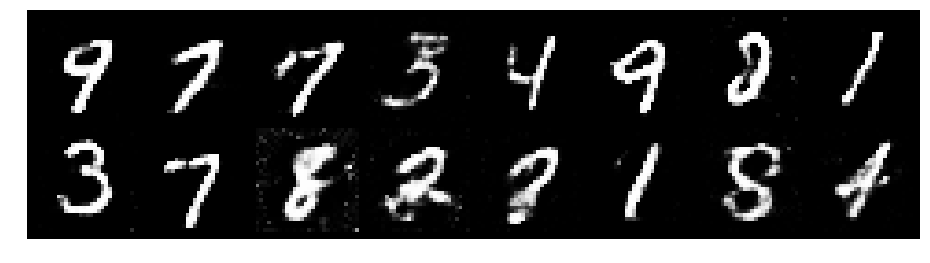

Epoch: [168/200], Batch Num: [400/600]
Discriminator Loss: 1.3956, Generator Loss: 0.7581
D(x): 0.5446, D(G(z)): 0.4802


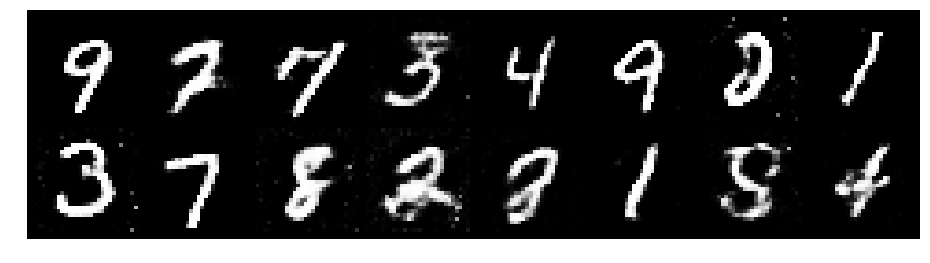

Epoch: [168/200], Batch Num: [500/600]
Discriminator Loss: 1.4092, Generator Loss: 0.8118
D(x): 0.5081, D(G(z)): 0.4650


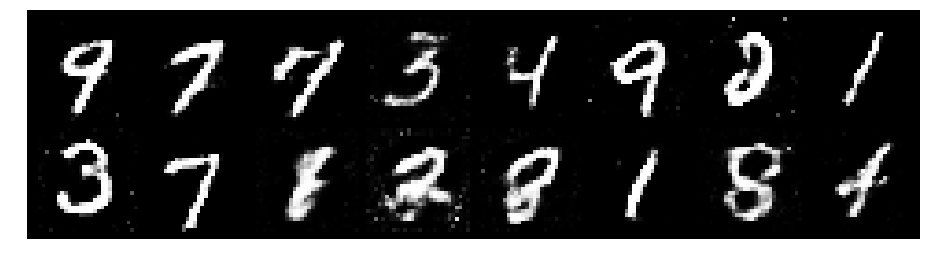

Epoch: [169/200], Batch Num: [0/600]
Discriminator Loss: 1.3291, Generator Loss: 0.8180
D(x): 0.5289, D(G(z)): 0.4695


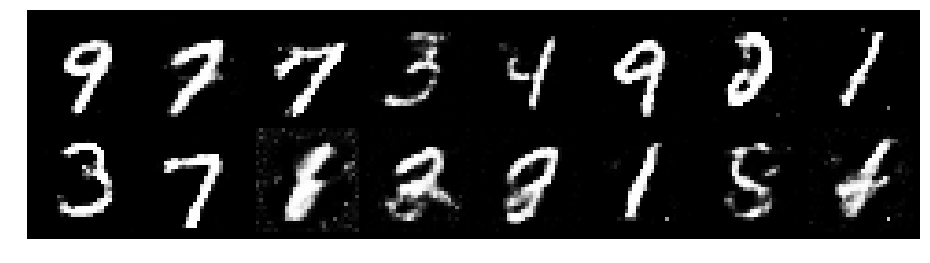

Epoch: [169/200], Batch Num: [100/600]
Discriminator Loss: 1.3886, Generator Loss: 0.8449
D(x): 0.5377, D(G(z)): 0.5004


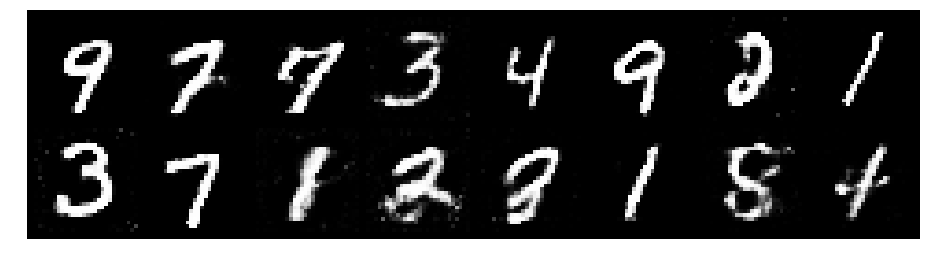

Epoch: [169/200], Batch Num: [200/600]
Discriminator Loss: 1.3387, Generator Loss: 0.8294
D(x): 0.5228, D(G(z)): 0.4488


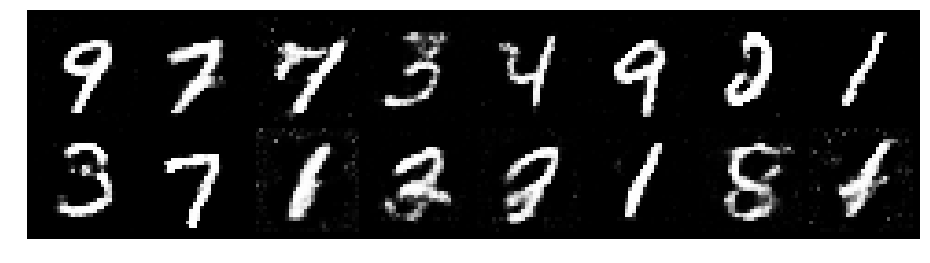

Epoch: [169/200], Batch Num: [300/600]
Discriminator Loss: 1.4256, Generator Loss: 0.7678
D(x): 0.5104, D(G(z)): 0.4836


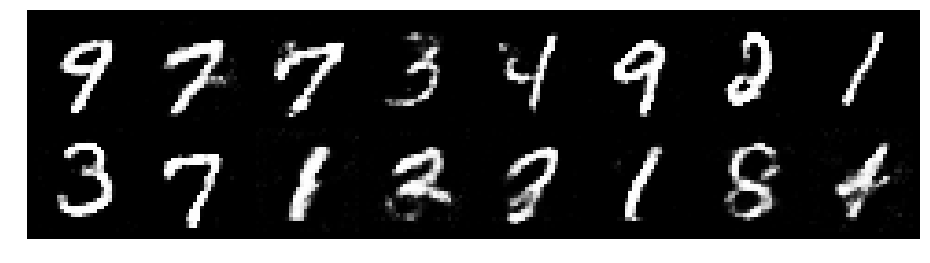

Epoch: [169/200], Batch Num: [400/600]
Discriminator Loss: 1.3412, Generator Loss: 0.7899
D(x): 0.5174, D(G(z)): 0.4516


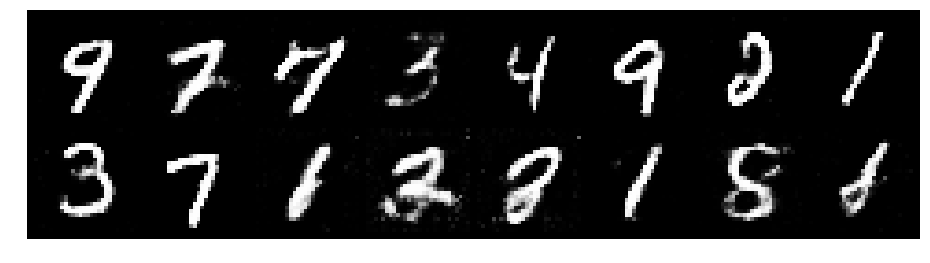

Epoch: [169/200], Batch Num: [500/600]
Discriminator Loss: 1.4232, Generator Loss: 0.8367
D(x): 0.5042, D(G(z)): 0.4655


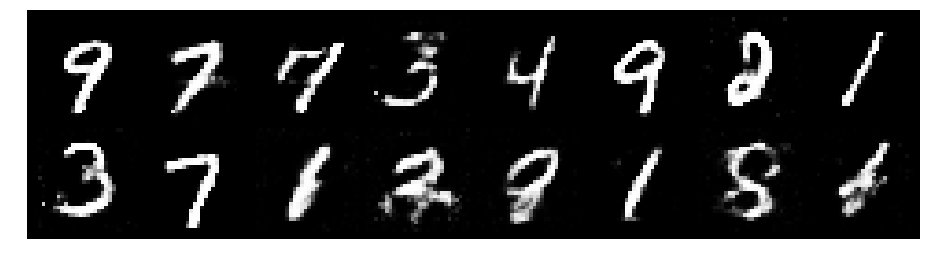

Epoch: [170/200], Batch Num: [0/600]
Discriminator Loss: 1.2654, Generator Loss: 0.8336
D(x): 0.5474, D(G(z)): 0.4391


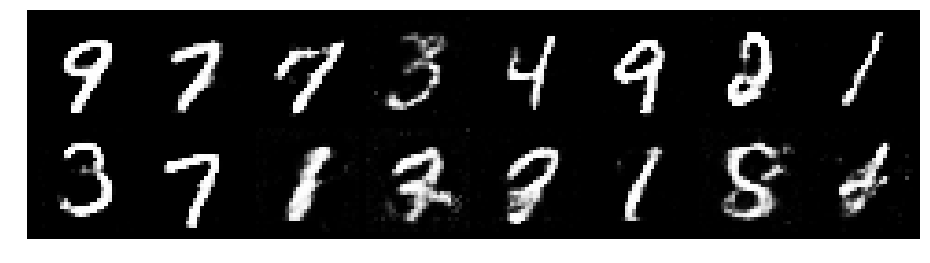

Epoch: [170/200], Batch Num: [100/600]
Discriminator Loss: 1.2782, Generator Loss: 0.8919
D(x): 0.5545, D(G(z)): 0.4506


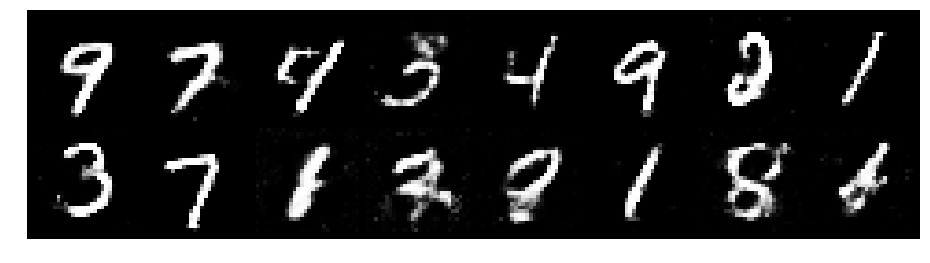

Epoch: [170/200], Batch Num: [200/600]
Discriminator Loss: 1.3018, Generator Loss: 1.0287
D(x): 0.5337, D(G(z)): 0.4207


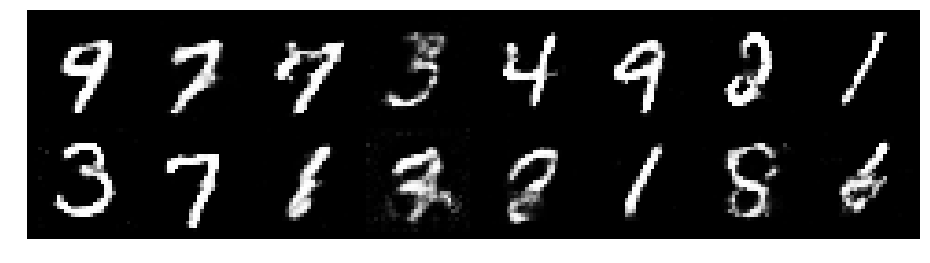

Epoch: [170/200], Batch Num: [300/600]
Discriminator Loss: 1.2298, Generator Loss: 0.8945
D(x): 0.5855, D(G(z)): 0.4513


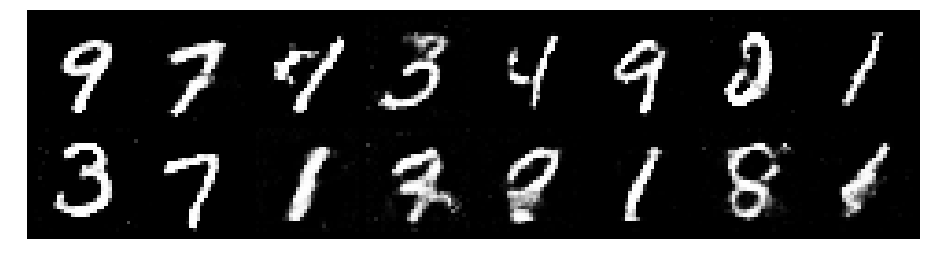

Epoch: [170/200], Batch Num: [400/600]
Discriminator Loss: 1.1758, Generator Loss: 0.8935
D(x): 0.5780, D(G(z)): 0.4241


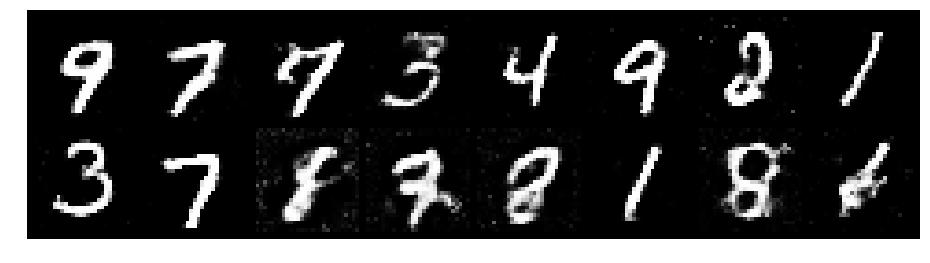

Epoch: [170/200], Batch Num: [500/600]
Discriminator Loss: 1.2257, Generator Loss: 1.0024
D(x): 0.5402, D(G(z)): 0.4114


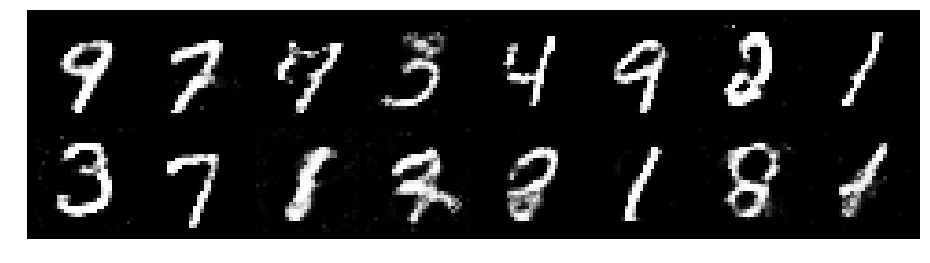

Epoch: [171/200], Batch Num: [0/600]
Discriminator Loss: 1.2333, Generator Loss: 0.8917
D(x): 0.5561, D(G(z)): 0.4238


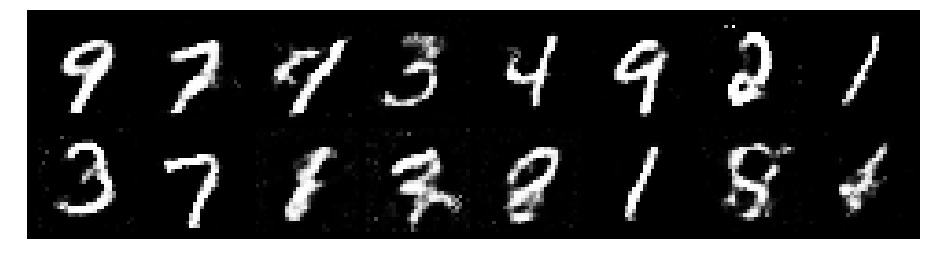

Epoch: [171/200], Batch Num: [100/600]
Discriminator Loss: 1.3275, Generator Loss: 0.8575
D(x): 0.5452, D(G(z)): 0.4495


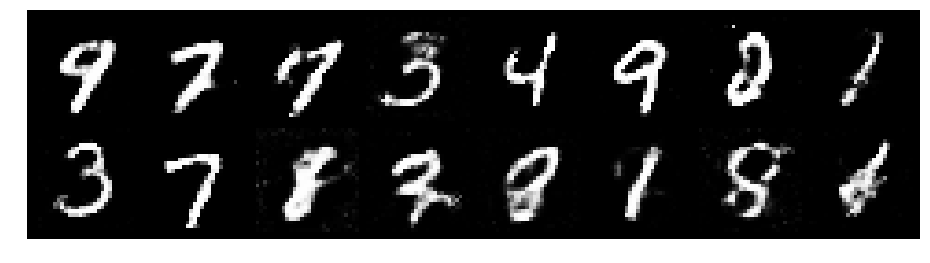

Epoch: [171/200], Batch Num: [200/600]
Discriminator Loss: 1.4204, Generator Loss: 0.9375
D(x): 0.5043, D(G(z)): 0.4667


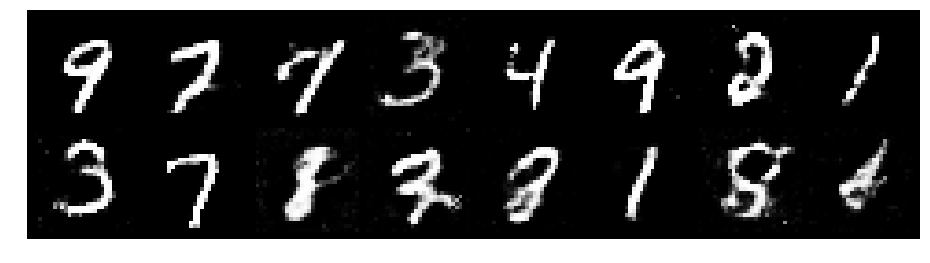

Epoch: [171/200], Batch Num: [300/600]
Discriminator Loss: 1.3134, Generator Loss: 0.7821
D(x): 0.5448, D(G(z)): 0.4799


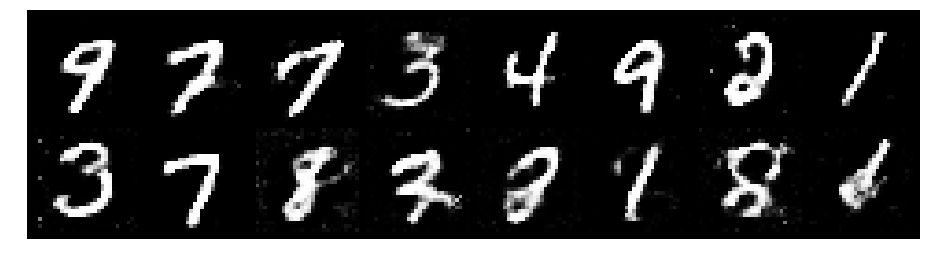

Epoch: [171/200], Batch Num: [400/600]
Discriminator Loss: 1.3491, Generator Loss: 0.7534
D(x): 0.5610, D(G(z)): 0.4840


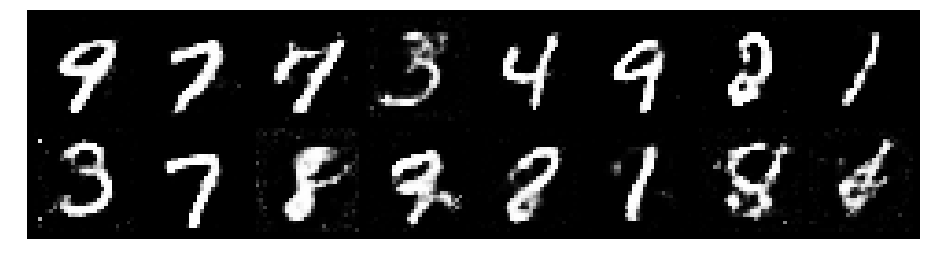

Epoch: [171/200], Batch Num: [500/600]
Discriminator Loss: 1.2919, Generator Loss: 0.8747
D(x): 0.5504, D(G(z)): 0.4448


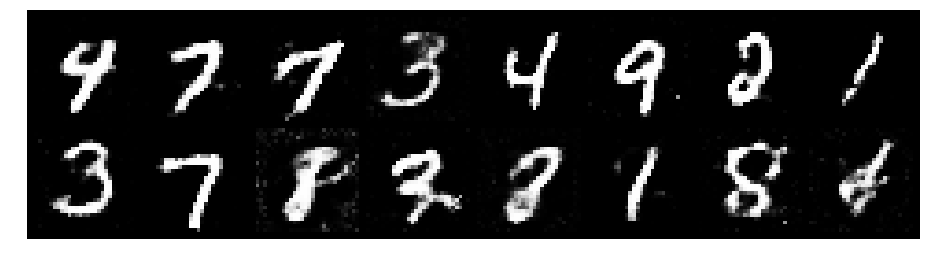

Epoch: [172/200], Batch Num: [0/600]
Discriminator Loss: 1.2875, Generator Loss: 0.8575
D(x): 0.5865, D(G(z)): 0.4839


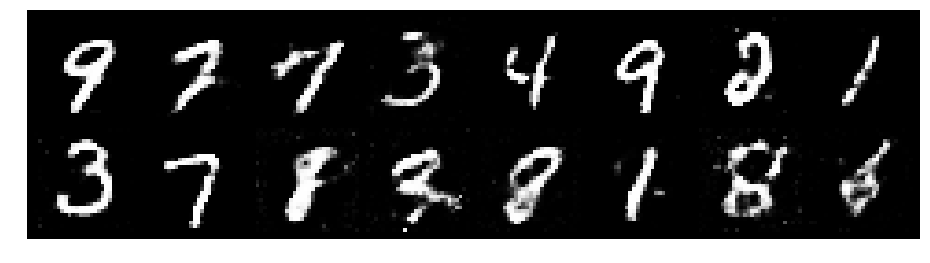

Epoch: [172/200], Batch Num: [100/600]
Discriminator Loss: 1.2930, Generator Loss: 0.7505
D(x): 0.5693, D(G(z)): 0.4894


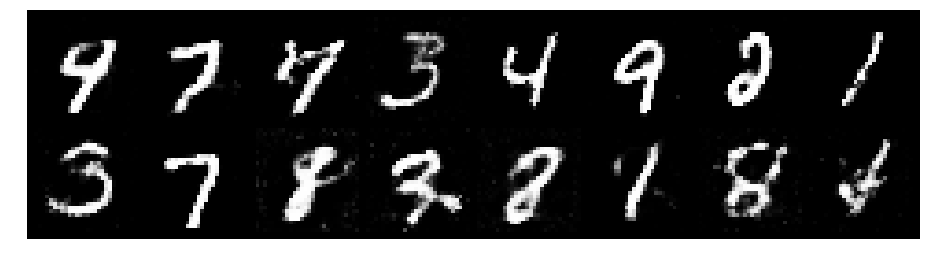

Epoch: [172/200], Batch Num: [200/600]
Discriminator Loss: 1.2920, Generator Loss: 0.8856
D(x): 0.5203, D(G(z)): 0.4424


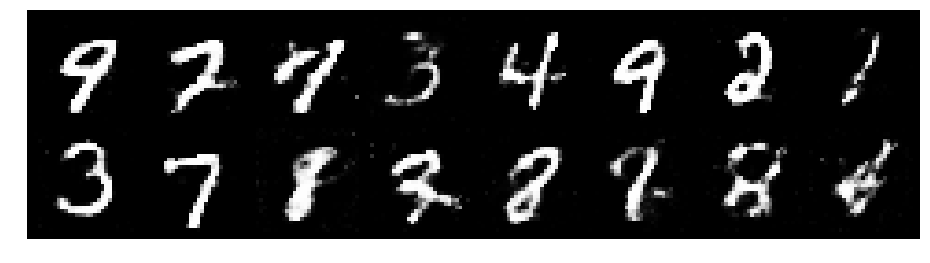

Epoch: [172/200], Batch Num: [300/600]
Discriminator Loss: 1.3357, Generator Loss: 0.9262
D(x): 0.5307, D(G(z)): 0.4618


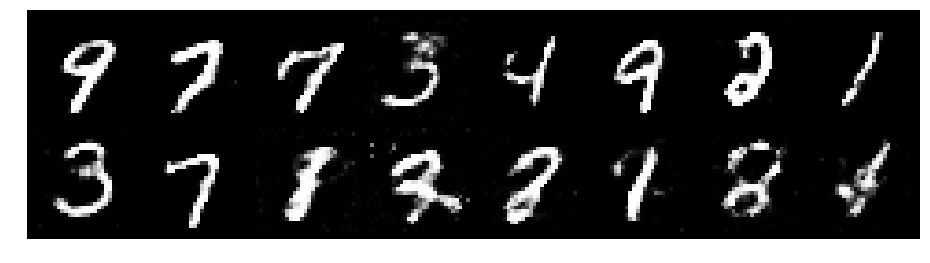

Epoch: [172/200], Batch Num: [400/600]
Discriminator Loss: 1.3352, Generator Loss: 0.8604
D(x): 0.5053, D(G(z)): 0.4187


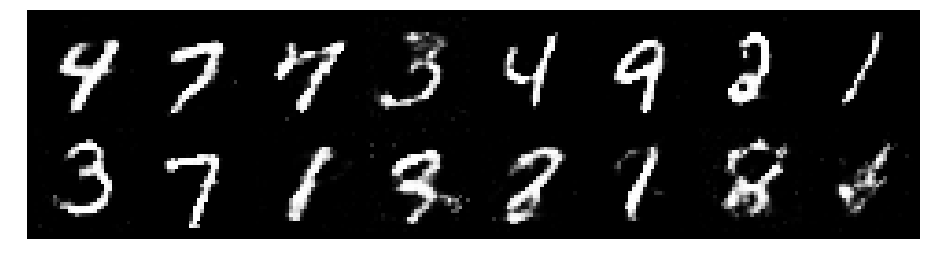

Epoch: [172/200], Batch Num: [500/600]
Discriminator Loss: 1.2992, Generator Loss: 0.8866
D(x): 0.5299, D(G(z)): 0.4503


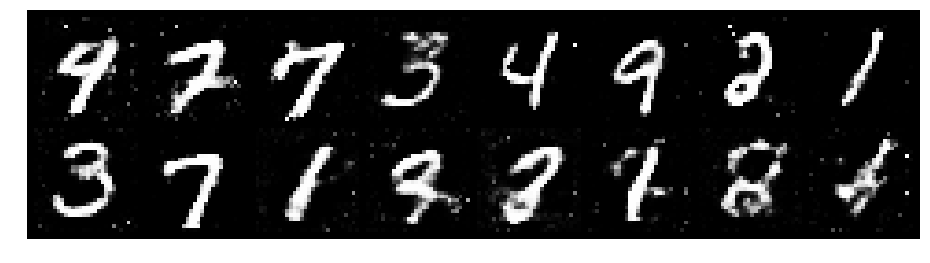

Epoch: [173/200], Batch Num: [0/600]
Discriminator Loss: 1.2317, Generator Loss: 0.8378
D(x): 0.5459, D(G(z)): 0.4296


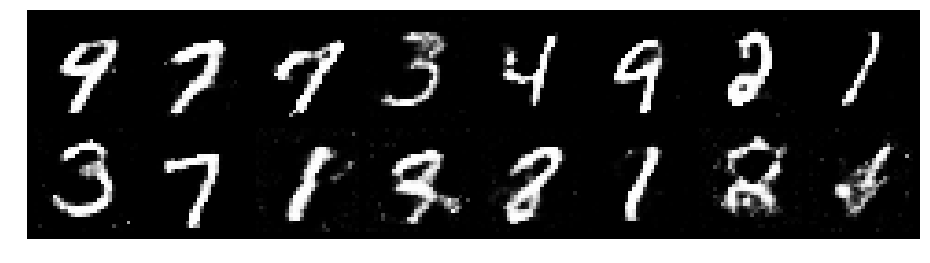

Epoch: [173/200], Batch Num: [100/600]
Discriminator Loss: 1.2010, Generator Loss: 0.8674
D(x): 0.5676, D(G(z)): 0.4361


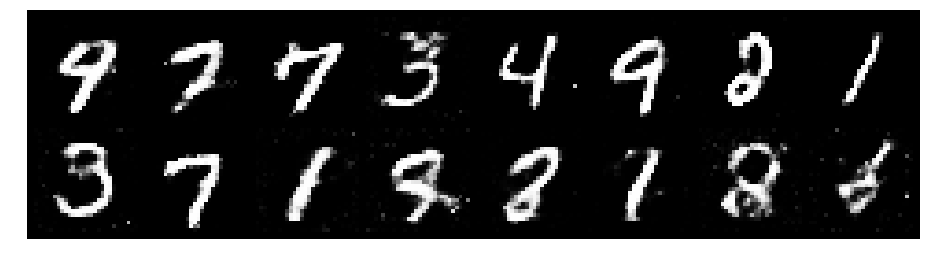

Epoch: [173/200], Batch Num: [200/600]
Discriminator Loss: 1.3491, Generator Loss: 0.8944
D(x): 0.5352, D(G(z)): 0.4783


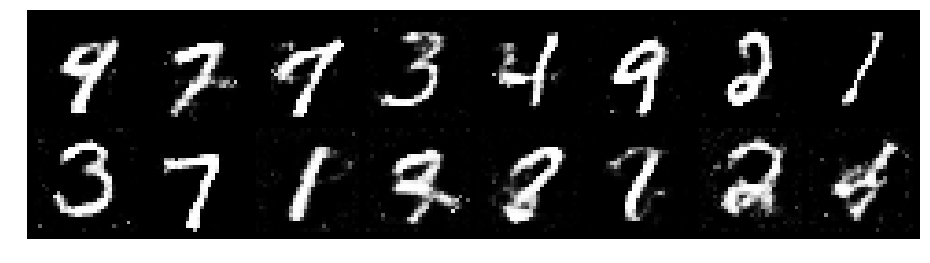

Epoch: [173/200], Batch Num: [300/600]
Discriminator Loss: 1.1798, Generator Loss: 1.0091
D(x): 0.5741, D(G(z)): 0.4074


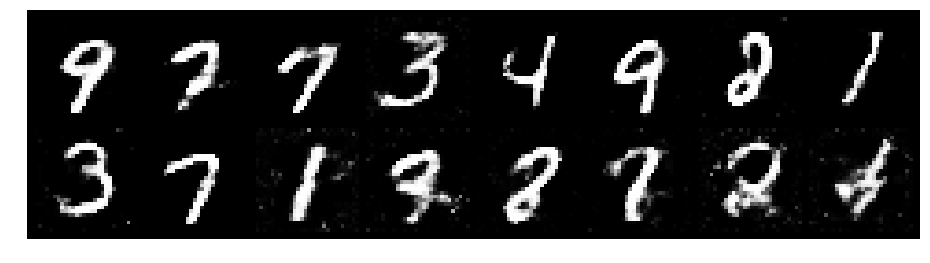

Epoch: [173/200], Batch Num: [400/600]
Discriminator Loss: 1.2365, Generator Loss: 0.9226
D(x): 0.5331, D(G(z)): 0.4035


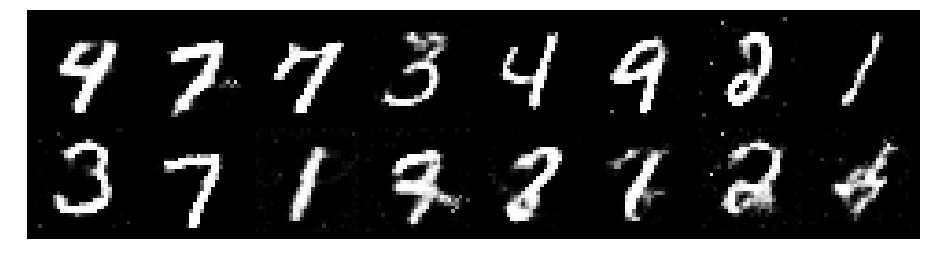

Epoch: [173/200], Batch Num: [500/600]
Discriminator Loss: 1.2117, Generator Loss: 0.8468
D(x): 0.5746, D(G(z)): 0.4351


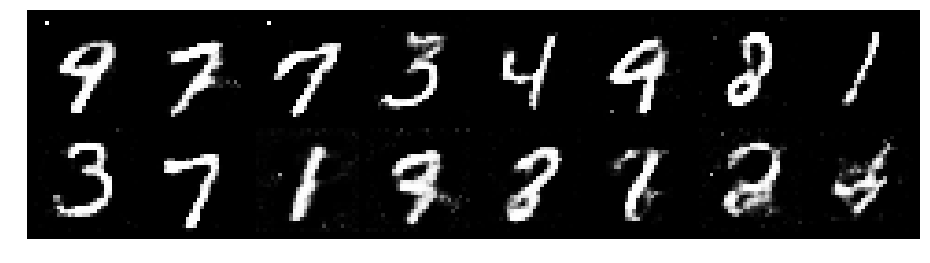

Epoch: [174/200], Batch Num: [0/600]
Discriminator Loss: 1.2604, Generator Loss: 0.8939
D(x): 0.5499, D(G(z)): 0.4452


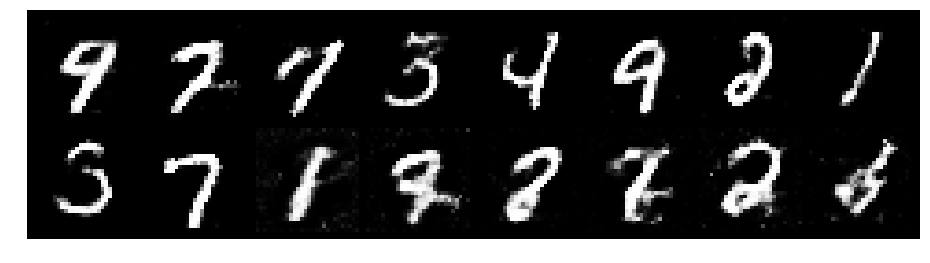

Epoch: [174/200], Batch Num: [100/600]
Discriminator Loss: 1.2250, Generator Loss: 0.9775
D(x): 0.5668, D(G(z)): 0.4366


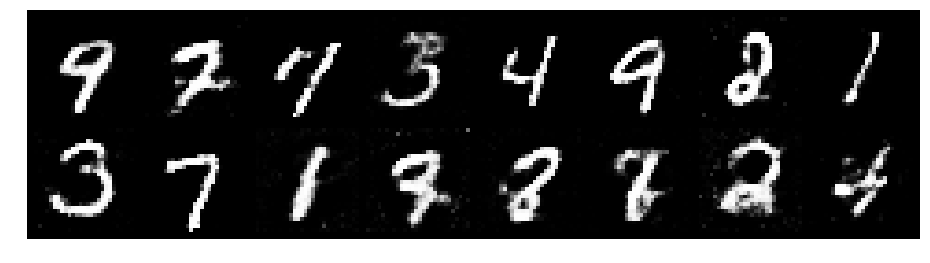

Epoch: [174/200], Batch Num: [200/600]
Discriminator Loss: 1.2520, Generator Loss: 0.8536
D(x): 0.5613, D(G(z)): 0.4623


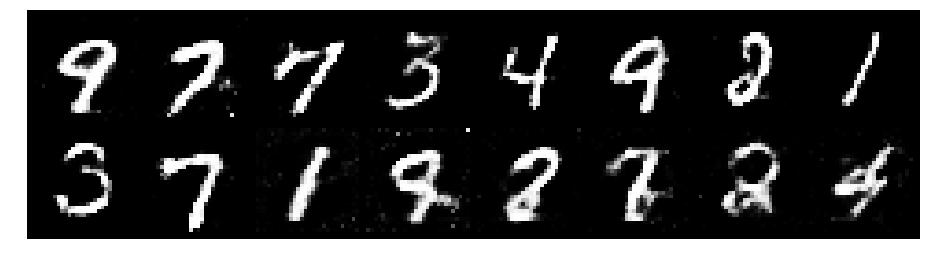

Epoch: [174/200], Batch Num: [300/600]
Discriminator Loss: 1.3326, Generator Loss: 0.9048
D(x): 0.5704, D(G(z)): 0.4398


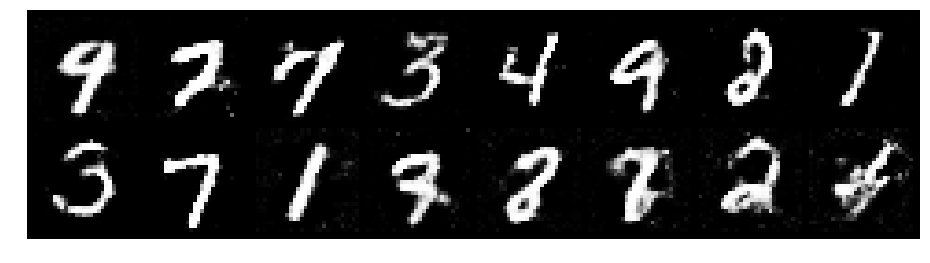

Epoch: [174/200], Batch Num: [400/600]
Discriminator Loss: 1.2572, Generator Loss: 0.8091
D(x): 0.5380, D(G(z)): 0.4367


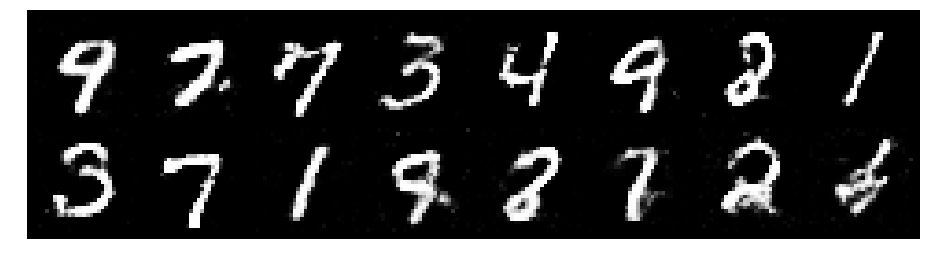

Epoch: [174/200], Batch Num: [500/600]
Discriminator Loss: 1.2755, Generator Loss: 0.8909
D(x): 0.5213, D(G(z)): 0.4302


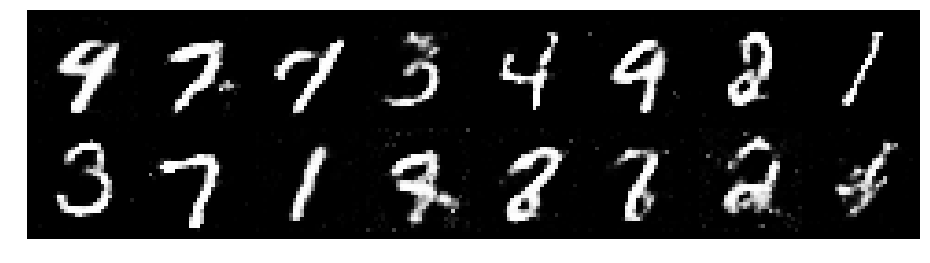

Epoch: [175/200], Batch Num: [0/600]
Discriminator Loss: 1.2590, Generator Loss: 0.7610
D(x): 0.5996, D(G(z)): 0.4758


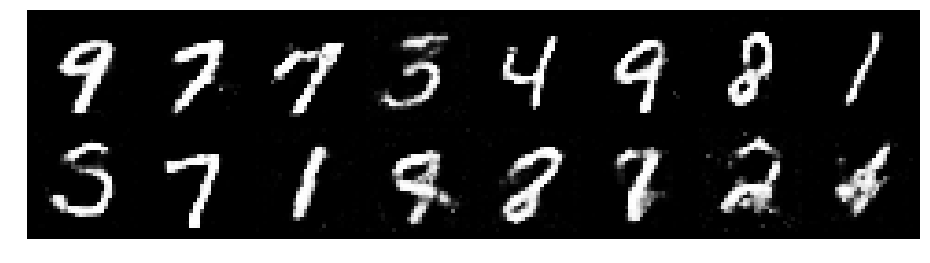

Epoch: [175/200], Batch Num: [100/600]
Discriminator Loss: 1.3374, Generator Loss: 0.8573
D(x): 0.5466, D(G(z)): 0.4617


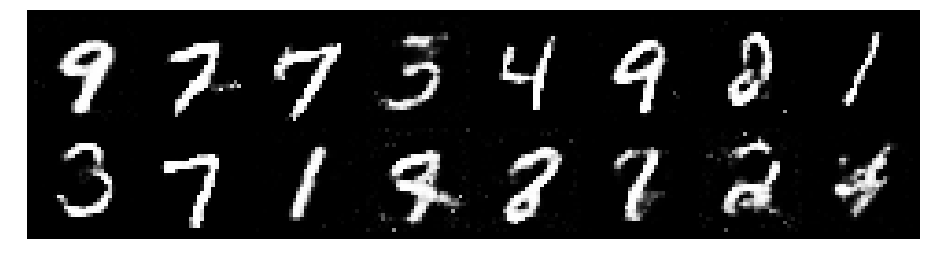

Epoch: [175/200], Batch Num: [200/600]
Discriminator Loss: 1.2836, Generator Loss: 0.8859
D(x): 0.5292, D(G(z)): 0.4163


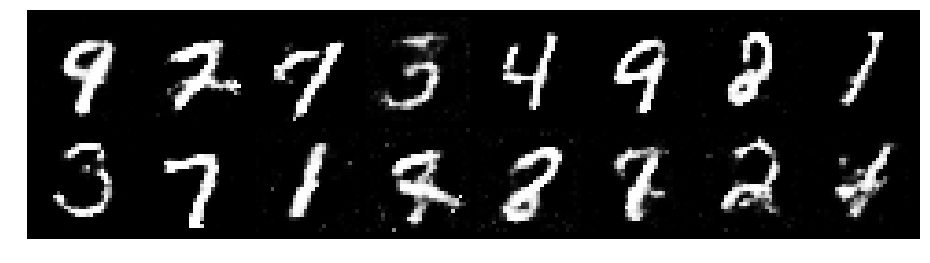

Epoch: [175/200], Batch Num: [300/600]
Discriminator Loss: 1.3683, Generator Loss: 0.8755
D(x): 0.4973, D(G(z)): 0.4408


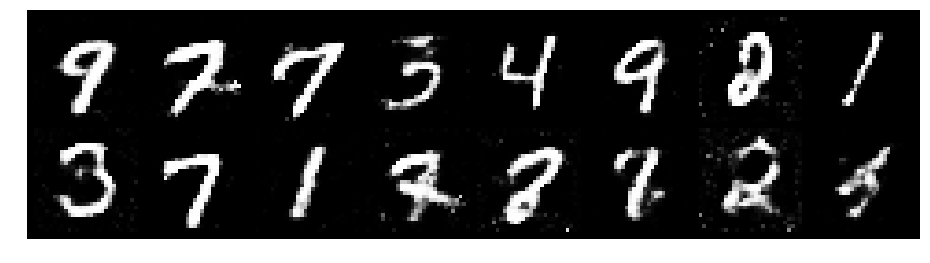

Epoch: [175/200], Batch Num: [400/600]
Discriminator Loss: 1.2050, Generator Loss: 0.9175
D(x): 0.5713, D(G(z)): 0.4239


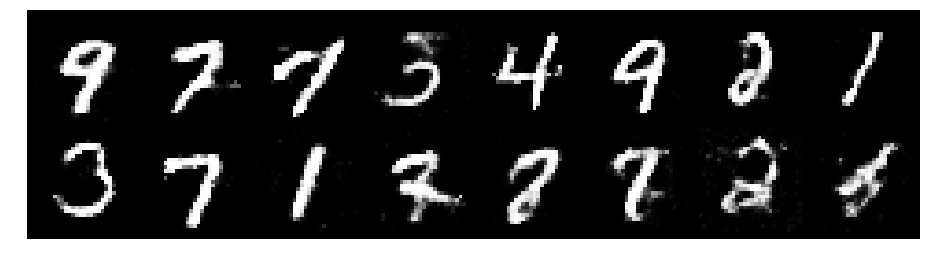

Epoch: [175/200], Batch Num: [500/600]
Discriminator Loss: 1.1774, Generator Loss: 0.7532
D(x): 0.5847, D(G(z)): 0.4327


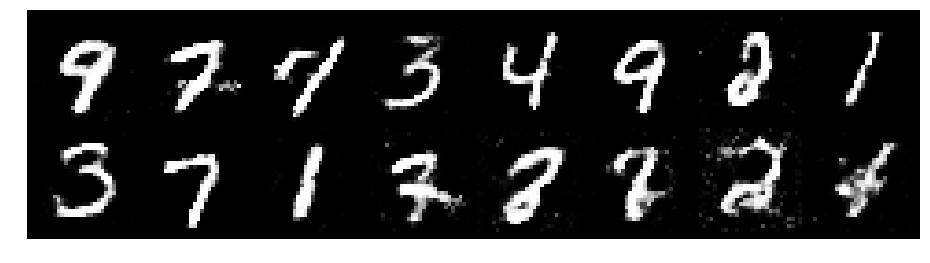

Epoch: [176/200], Batch Num: [0/600]
Discriminator Loss: 1.1800, Generator Loss: 0.9323
D(x): 0.5443, D(G(z)): 0.3945


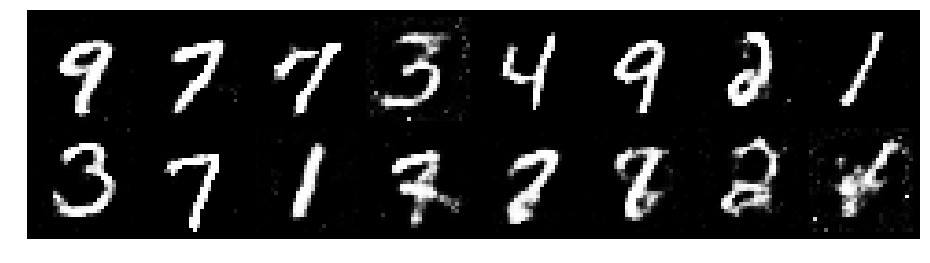

Epoch: [176/200], Batch Num: [100/600]
Discriminator Loss: 1.2044, Generator Loss: 0.8631
D(x): 0.5711, D(G(z)): 0.4388


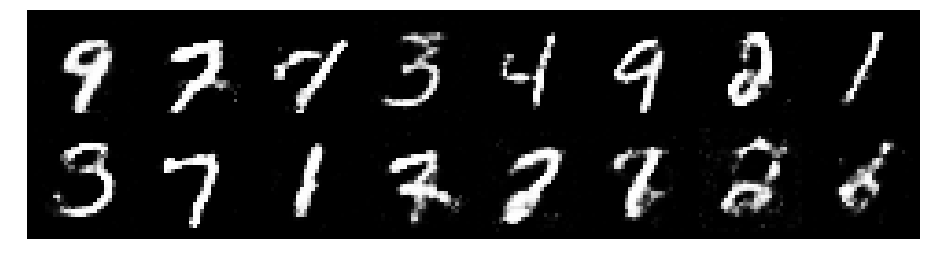

Epoch: [176/200], Batch Num: [200/600]
Discriminator Loss: 1.2120, Generator Loss: 0.8990
D(x): 0.5818, D(G(z)): 0.4333


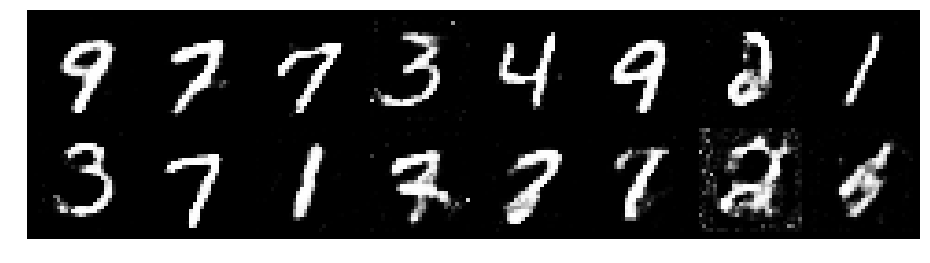

Epoch: [176/200], Batch Num: [300/600]
Discriminator Loss: 1.3122, Generator Loss: 0.8547
D(x): 0.5481, D(G(z)): 0.4549


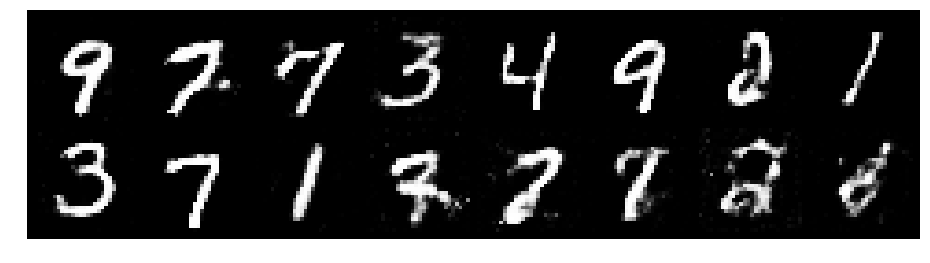

Epoch: [176/200], Batch Num: [400/600]
Discriminator Loss: 1.3045, Generator Loss: 0.9550
D(x): 0.5597, D(G(z)): 0.4273


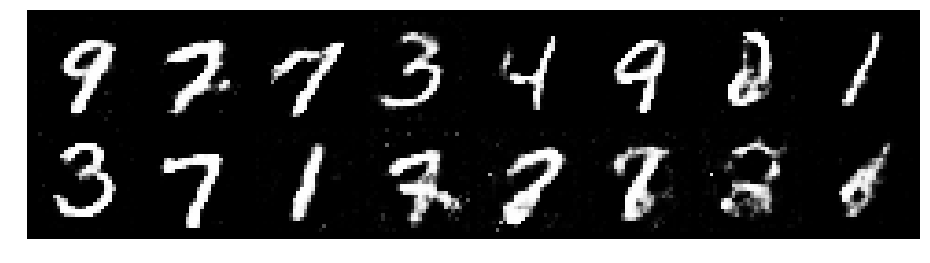

Epoch: [176/200], Batch Num: [500/600]
Discriminator Loss: 1.3795, Generator Loss: 0.8244
D(x): 0.5770, D(G(z)): 0.4772


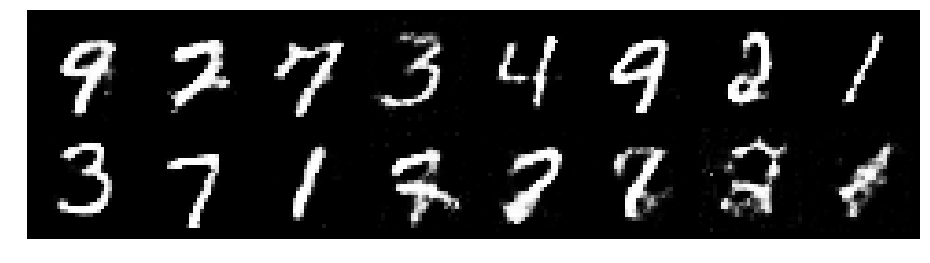

Epoch: [177/200], Batch Num: [0/600]
Discriminator Loss: 1.3535, Generator Loss: 0.9039
D(x): 0.5223, D(G(z)): 0.4594


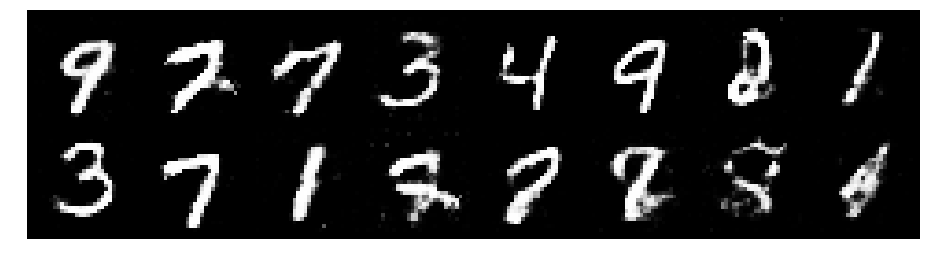

Epoch: [177/200], Batch Num: [100/600]
Discriminator Loss: 1.3298, Generator Loss: 0.8201
D(x): 0.5059, D(G(z)): 0.4500


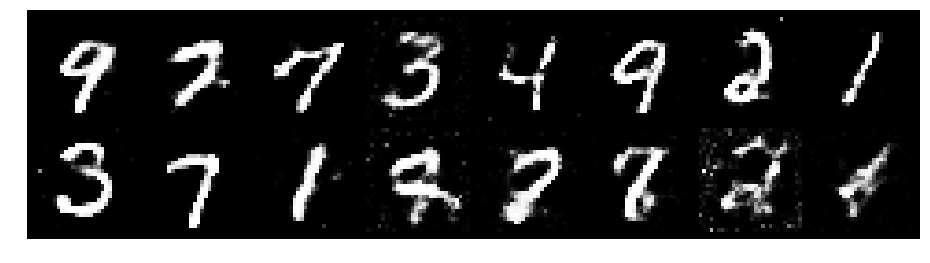

Epoch: [177/200], Batch Num: [200/600]
Discriminator Loss: 1.3289, Generator Loss: 0.8103
D(x): 0.5112, D(G(z)): 0.4550


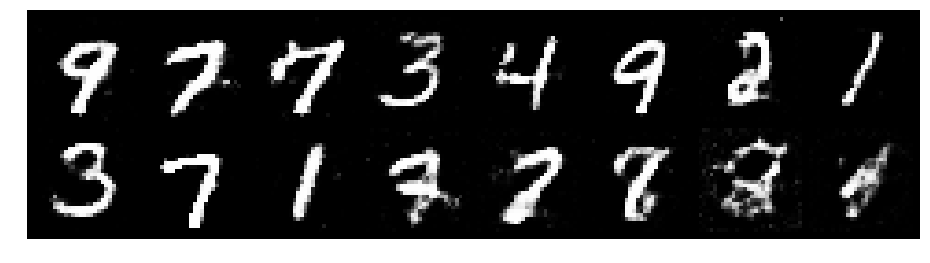

Epoch: [177/200], Batch Num: [300/600]
Discriminator Loss: 1.2513, Generator Loss: 0.8459
D(x): 0.5639, D(G(z)): 0.4489


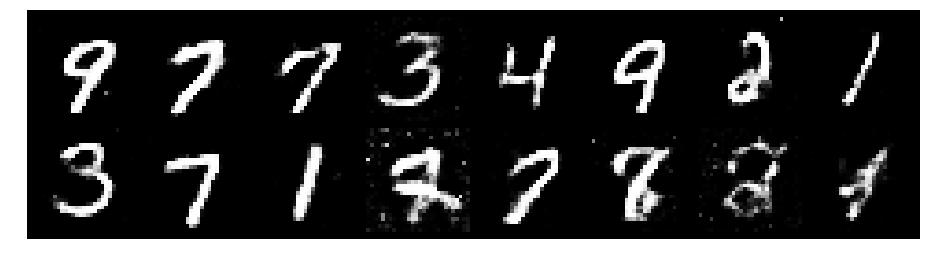

Epoch: [177/200], Batch Num: [400/600]
Discriminator Loss: 1.2203, Generator Loss: 0.8873
D(x): 0.5987, D(G(z)): 0.4714


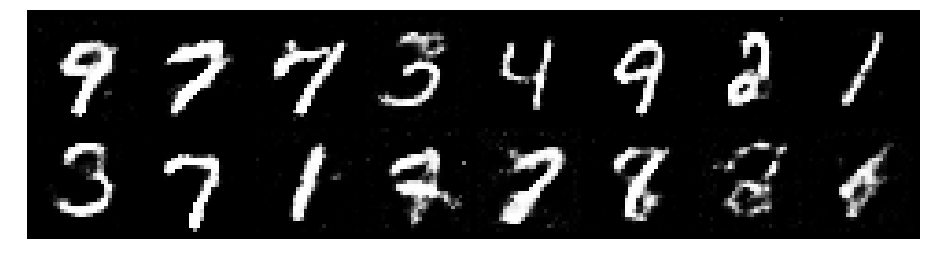

Epoch: [177/200], Batch Num: [500/600]
Discriminator Loss: 1.1201, Generator Loss: 1.0039
D(x): 0.5881, D(G(z)): 0.4025


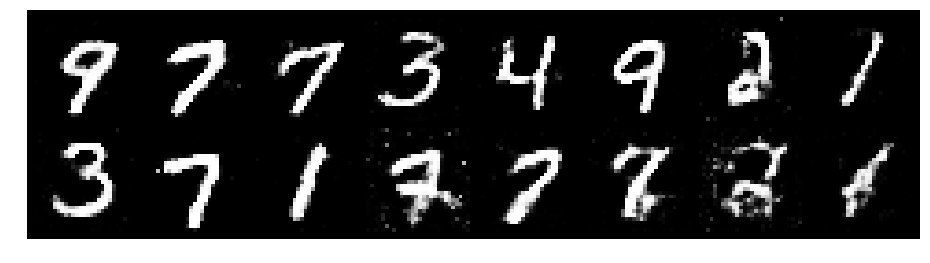

Epoch: [178/200], Batch Num: [0/600]
Discriminator Loss: 1.1569, Generator Loss: 1.0719
D(x): 0.5917, D(G(z)): 0.4097


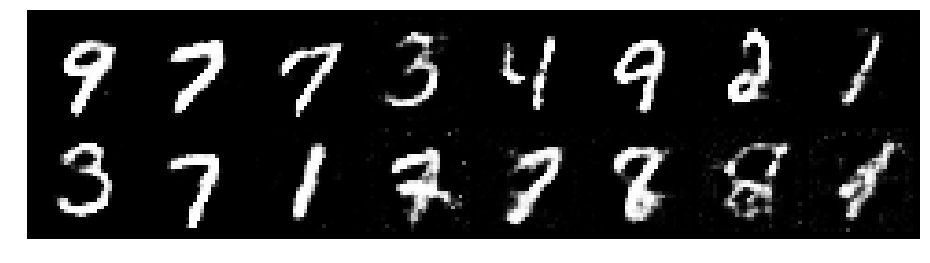

Epoch: [178/200], Batch Num: [100/600]
Discriminator Loss: 1.2719, Generator Loss: 0.8878
D(x): 0.5713, D(G(z)): 0.4422


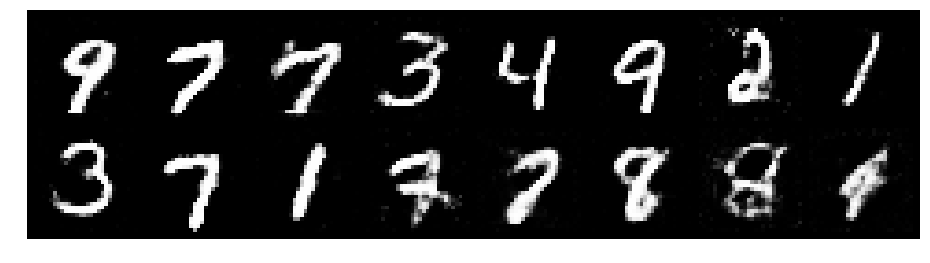

Epoch: [178/200], Batch Num: [200/600]
Discriminator Loss: 1.2146, Generator Loss: 0.9058
D(x): 0.5668, D(G(z)): 0.4346


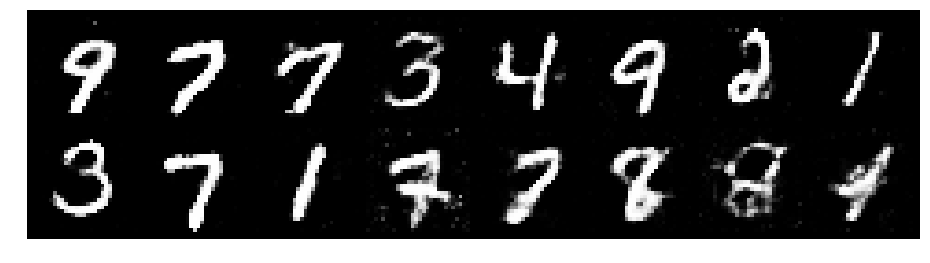

Epoch: [178/200], Batch Num: [300/600]
Discriminator Loss: 1.2990, Generator Loss: 0.9173
D(x): 0.5841, D(G(z)): 0.4765


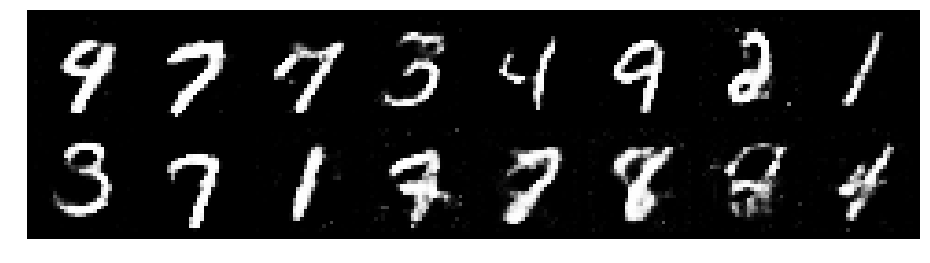

Epoch: [178/200], Batch Num: [400/600]
Discriminator Loss: 1.2680, Generator Loss: 1.0105
D(x): 0.5606, D(G(z)): 0.4317


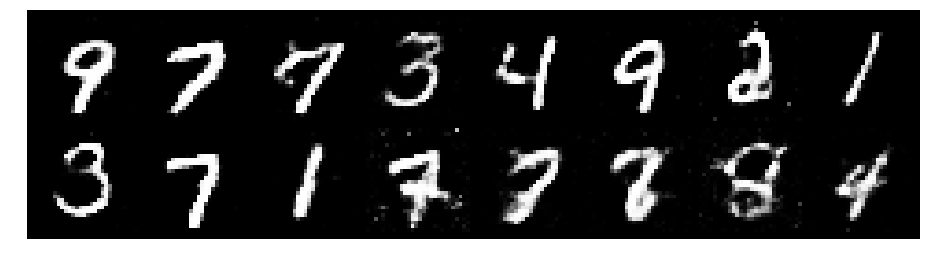

Epoch: [178/200], Batch Num: [500/600]
Discriminator Loss: 1.3106, Generator Loss: 0.7975
D(x): 0.5693, D(G(z)): 0.4773


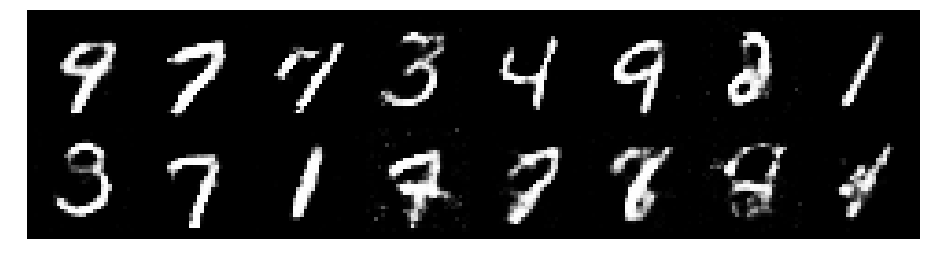

Epoch: [179/200], Batch Num: [0/600]
Discriminator Loss: 1.4410, Generator Loss: 0.7177
D(x): 0.5422, D(G(z)): 0.5262


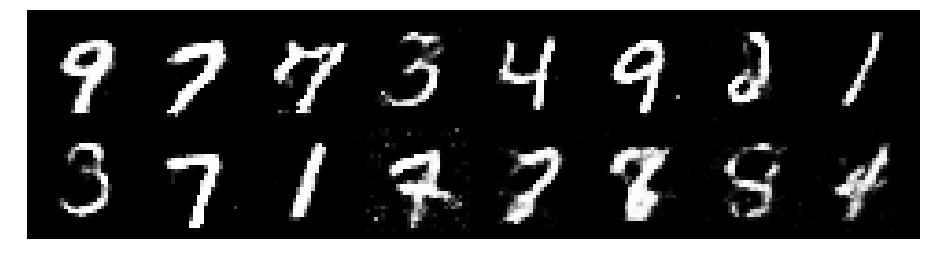

Epoch: [179/200], Batch Num: [100/600]
Discriminator Loss: 1.1946, Generator Loss: 0.8927
D(x): 0.5531, D(G(z)): 0.4166


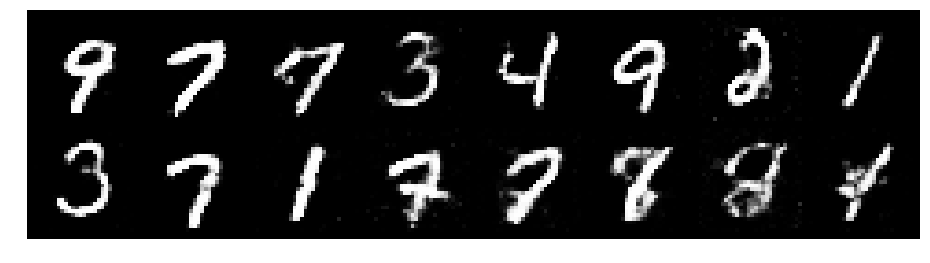

Epoch: [179/200], Batch Num: [200/600]
Discriminator Loss: 1.2416, Generator Loss: 0.9647
D(x): 0.5465, D(G(z)): 0.4251


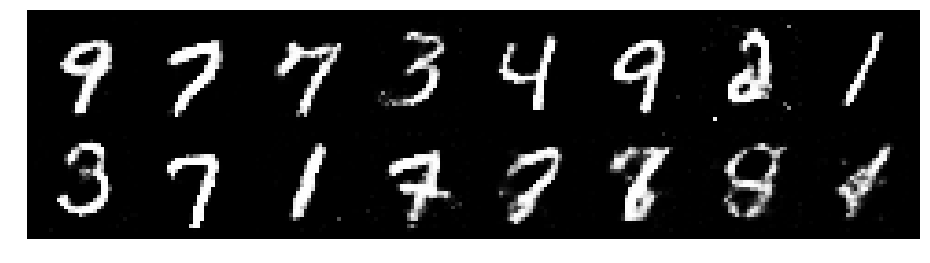

Epoch: [179/200], Batch Num: [300/600]
Discriminator Loss: 1.2263, Generator Loss: 0.8828
D(x): 0.5610, D(G(z)): 0.4357


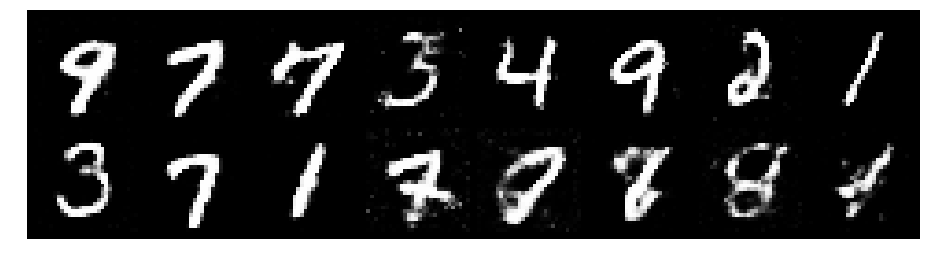

Epoch: [179/200], Batch Num: [400/600]
Discriminator Loss: 1.2025, Generator Loss: 0.9614
D(x): 0.5477, D(G(z)): 0.4002


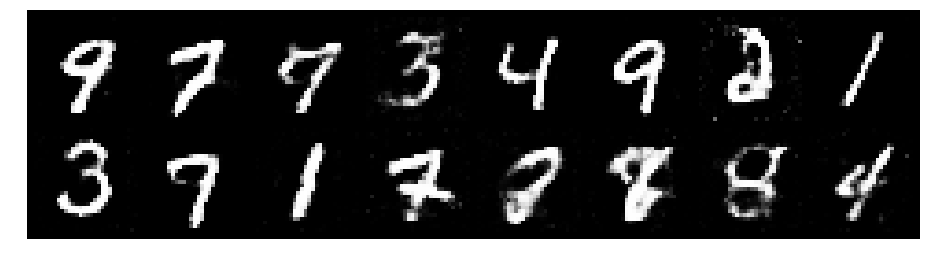

Epoch: [179/200], Batch Num: [500/600]
Discriminator Loss: 1.1532, Generator Loss: 0.9682
D(x): 0.6124, D(G(z)): 0.4167


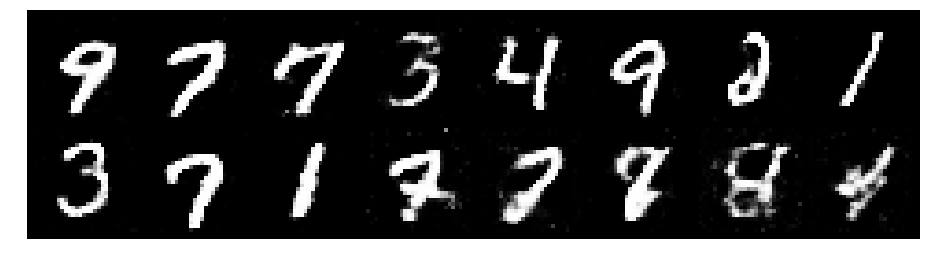

Epoch: [180/200], Batch Num: [0/600]
Discriminator Loss: 1.2399, Generator Loss: 0.8675
D(x): 0.5608, D(G(z)): 0.4321


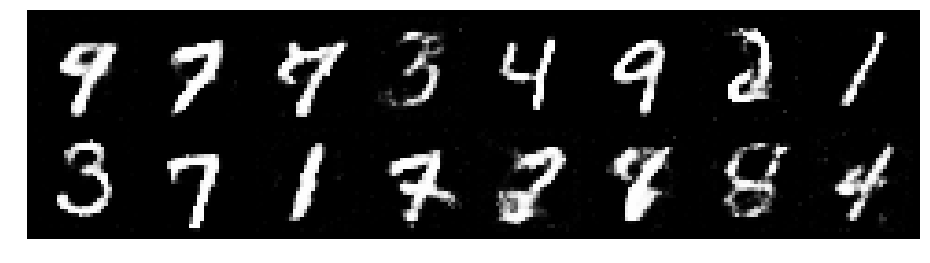

Epoch: [180/200], Batch Num: [100/600]
Discriminator Loss: 1.3423, Generator Loss: 0.6561
D(x): 0.5845, D(G(z)): 0.5123


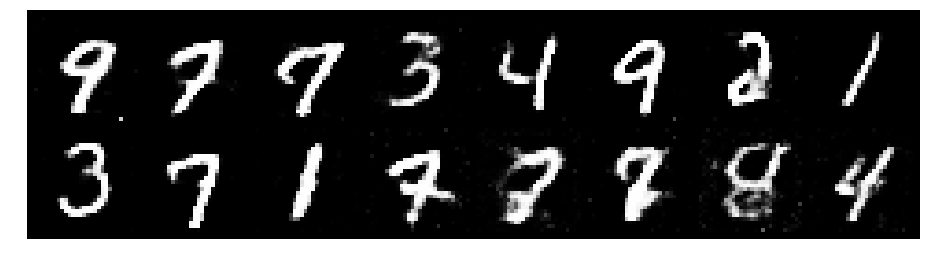

Epoch: [180/200], Batch Num: [200/600]
Discriminator Loss: 1.2938, Generator Loss: 0.9529
D(x): 0.5329, D(G(z)): 0.4204


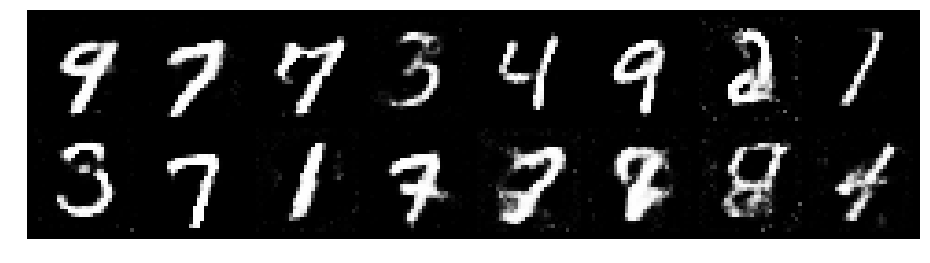

Epoch: [180/200], Batch Num: [300/600]
Discriminator Loss: 1.3158, Generator Loss: 0.8273
D(x): 0.5762, D(G(z)): 0.4816


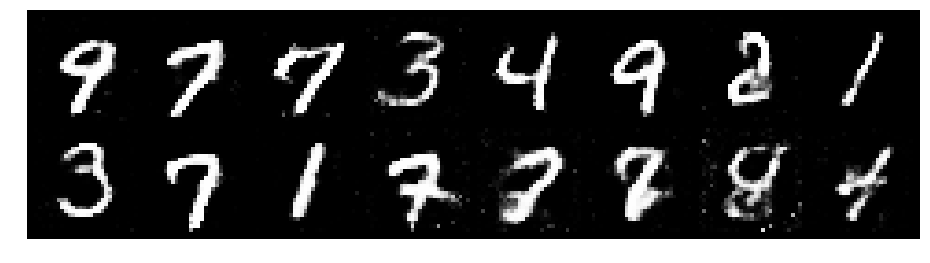

Epoch: [180/200], Batch Num: [400/600]
Discriminator Loss: 1.2364, Generator Loss: 0.8663
D(x): 0.5643, D(G(z)): 0.4540


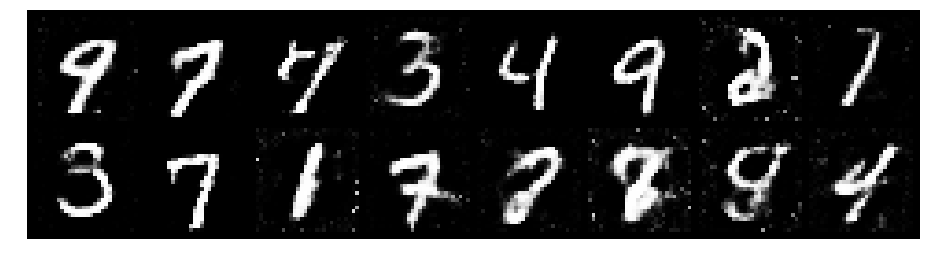

Epoch: [180/200], Batch Num: [500/600]
Discriminator Loss: 1.2395, Generator Loss: 0.8145
D(x): 0.5458, D(G(z)): 0.4351


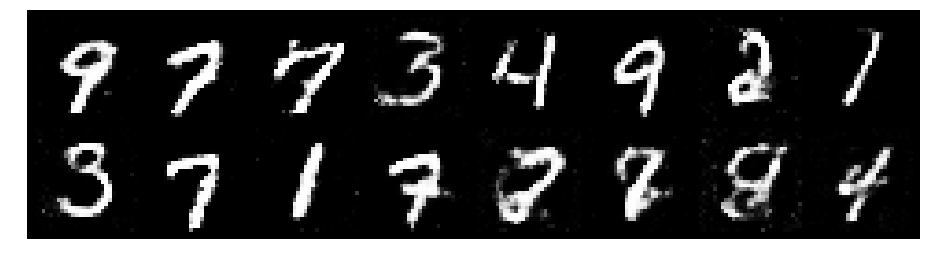

Epoch: [181/200], Batch Num: [0/600]
Discriminator Loss: 1.2353, Generator Loss: 1.0140
D(x): 0.5299, D(G(z)): 0.3997


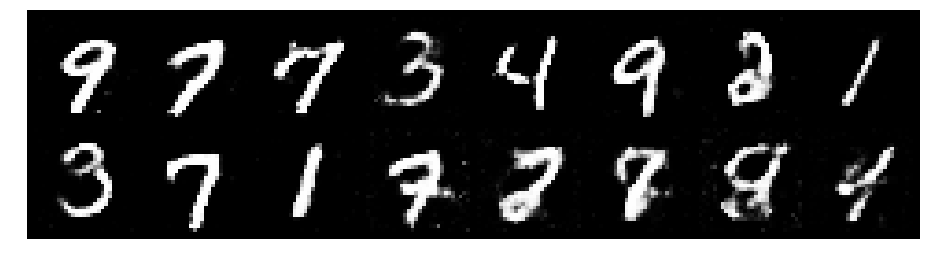

Epoch: [181/200], Batch Num: [100/600]
Discriminator Loss: 1.2123, Generator Loss: 0.9792
D(x): 0.5689, D(G(z)): 0.4183


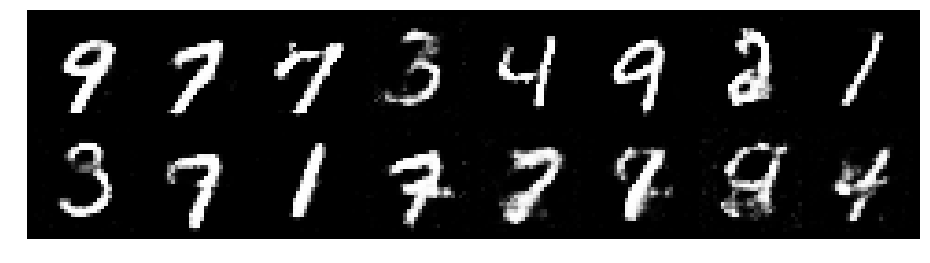

Epoch: [181/200], Batch Num: [200/600]
Discriminator Loss: 1.2700, Generator Loss: 0.9474
D(x): 0.5532, D(G(z)): 0.4439


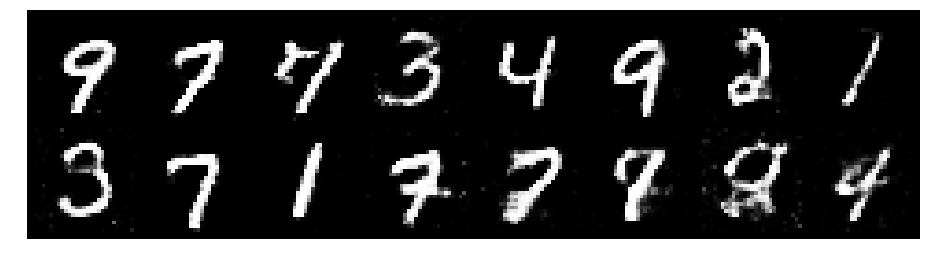

Epoch: [181/200], Batch Num: [300/600]
Discriminator Loss: 1.3010, Generator Loss: 0.8147
D(x): 0.5644, D(G(z)): 0.4619


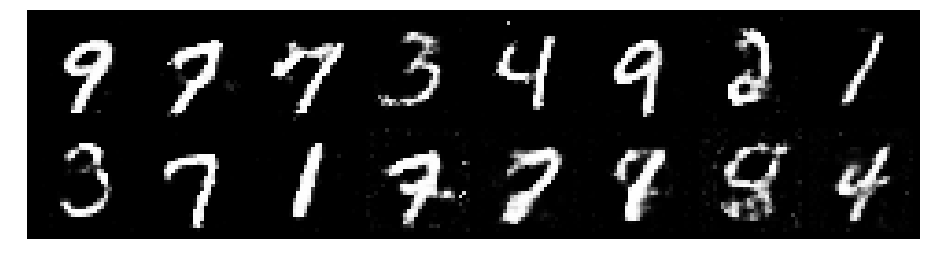

Epoch: [181/200], Batch Num: [400/600]
Discriminator Loss: 1.4279, Generator Loss: 0.8916
D(x): 0.5245, D(G(z)): 0.4916


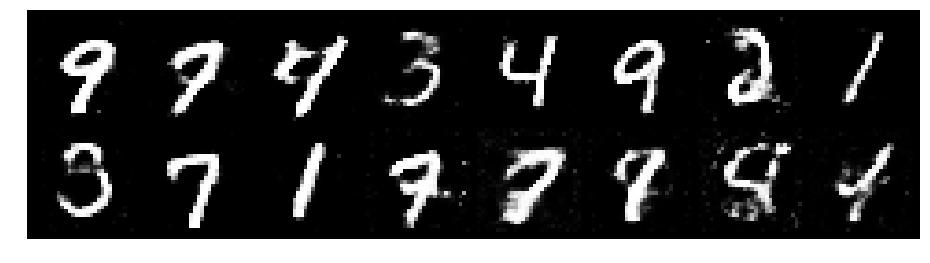

Epoch: [181/200], Batch Num: [500/600]
Discriminator Loss: 1.3936, Generator Loss: 0.8763
D(x): 0.5157, D(G(z)): 0.4771


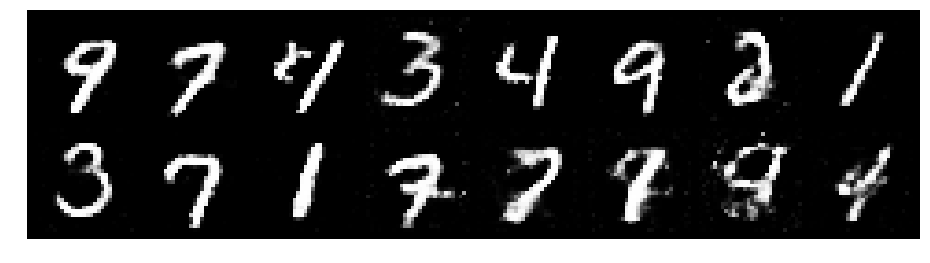

Epoch: [182/200], Batch Num: [0/600]
Discriminator Loss: 1.2765, Generator Loss: 0.9496
D(x): 0.5505, D(G(z)): 0.4515


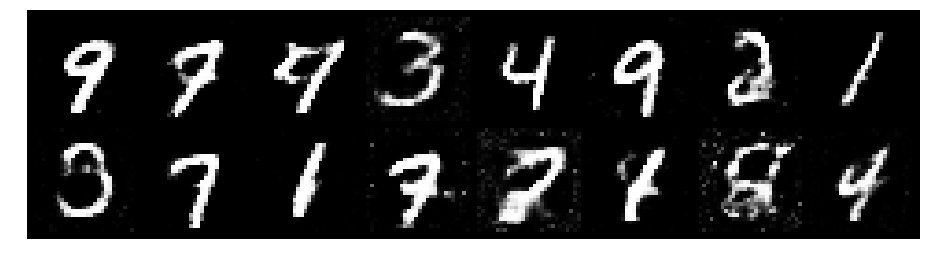

Epoch: [182/200], Batch Num: [100/600]
Discriminator Loss: 1.2175, Generator Loss: 1.0280
D(x): 0.6071, D(G(z)): 0.4418


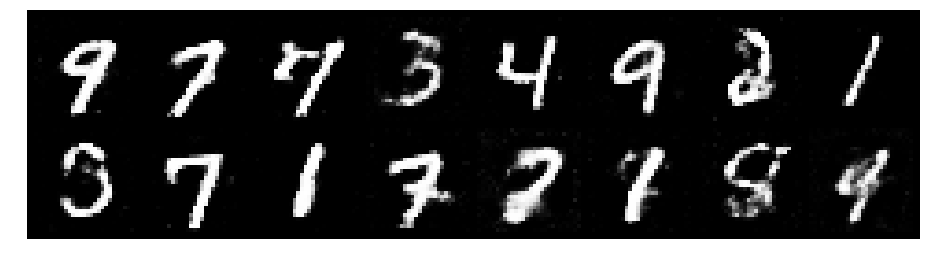

Epoch: [182/200], Batch Num: [200/600]
Discriminator Loss: 1.1688, Generator Loss: 0.9754
D(x): 0.5835, D(G(z)): 0.4199


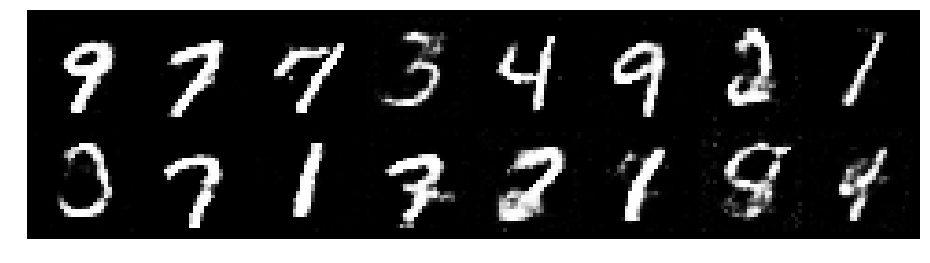

Epoch: [182/200], Batch Num: [300/600]
Discriminator Loss: 1.1307, Generator Loss: 0.8505
D(x): 0.5967, D(G(z)): 0.4096


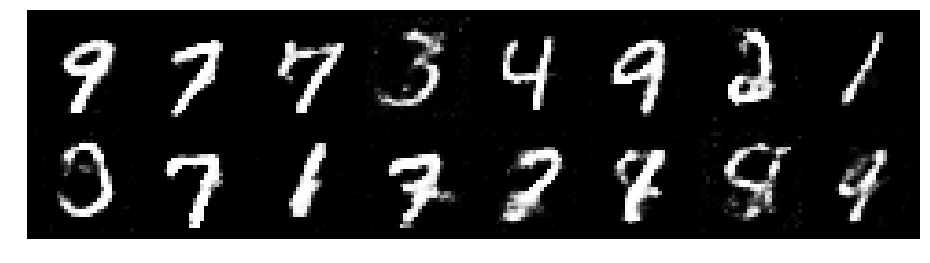

Epoch: [182/200], Batch Num: [400/600]
Discriminator Loss: 1.3206, Generator Loss: 0.7220
D(x): 0.5625, D(G(z)): 0.4740


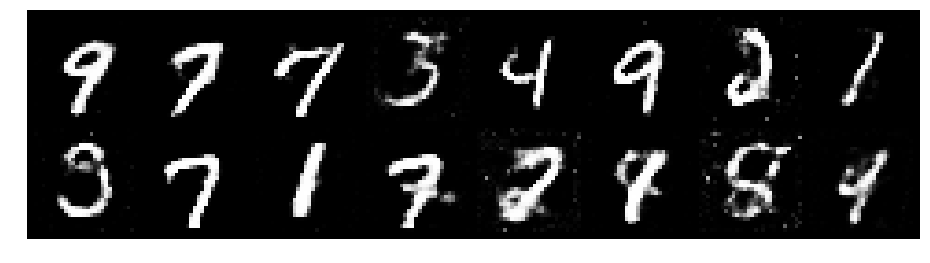

Epoch: [182/200], Batch Num: [500/600]
Discriminator Loss: 1.2744, Generator Loss: 0.8343
D(x): 0.5670, D(G(z)): 0.4562


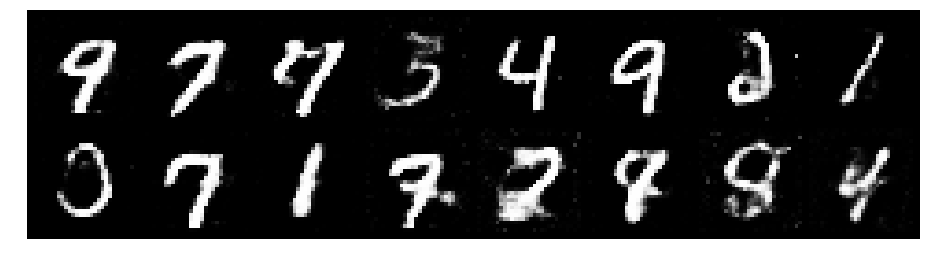

Epoch: [183/200], Batch Num: [0/600]
Discriminator Loss: 1.3370, Generator Loss: 0.8205
D(x): 0.5177, D(G(z)): 0.4544


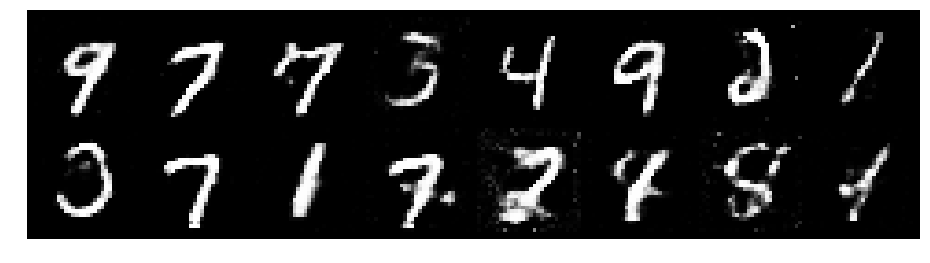

Epoch: [183/200], Batch Num: [100/600]
Discriminator Loss: 1.2516, Generator Loss: 0.9364
D(x): 0.5190, D(G(z)): 0.4156


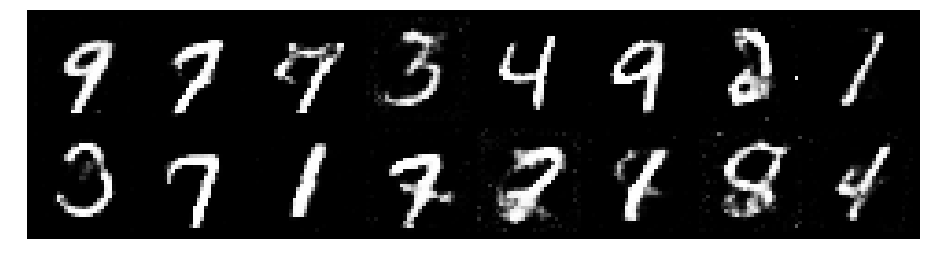

Epoch: [183/200], Batch Num: [200/600]
Discriminator Loss: 1.2684, Generator Loss: 0.9929
D(x): 0.5657, D(G(z)): 0.4352


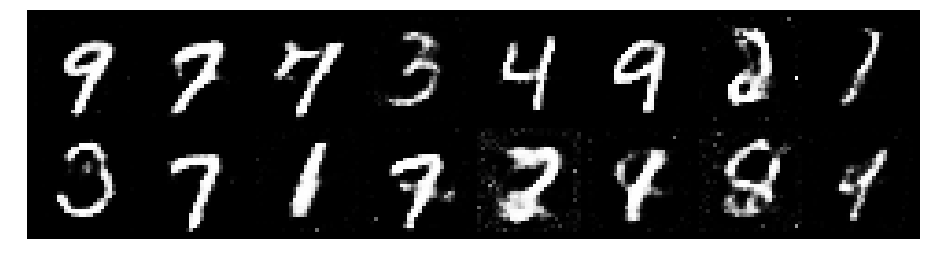

Epoch: [183/200], Batch Num: [300/600]
Discriminator Loss: 1.3845, Generator Loss: 0.8872
D(x): 0.5561, D(G(z)): 0.4845


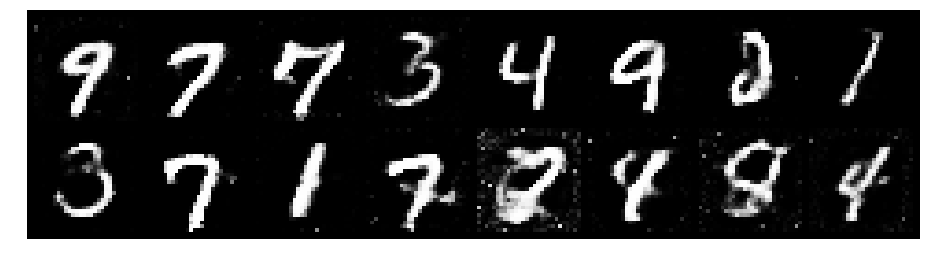

Epoch: [183/200], Batch Num: [400/600]
Discriminator Loss: 1.4756, Generator Loss: 0.8852
D(x): 0.4714, D(G(z)): 0.4348


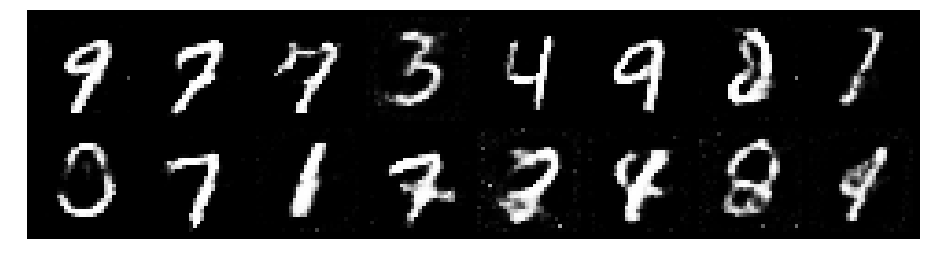

Epoch: [183/200], Batch Num: [500/600]
Discriminator Loss: 1.4642, Generator Loss: 0.7874
D(x): 0.5156, D(G(z)): 0.4999


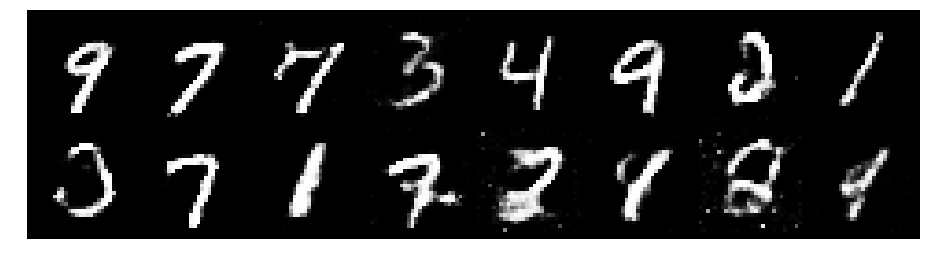

Epoch: [184/200], Batch Num: [0/600]
Discriminator Loss: 1.2621, Generator Loss: 0.9235
D(x): 0.5376, D(G(z)): 0.4352


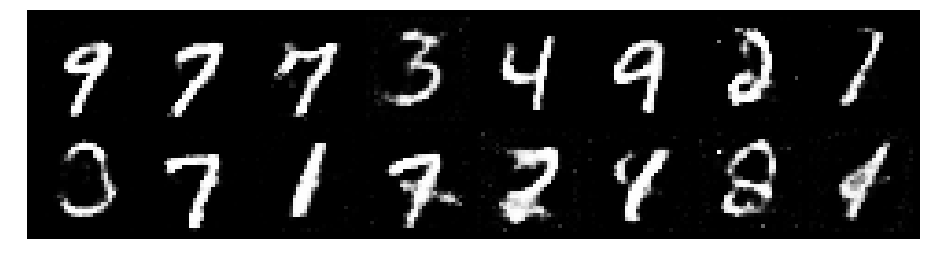

Epoch: [184/200], Batch Num: [100/600]
Discriminator Loss: 1.2386, Generator Loss: 0.9350
D(x): 0.5555, D(G(z)): 0.4372


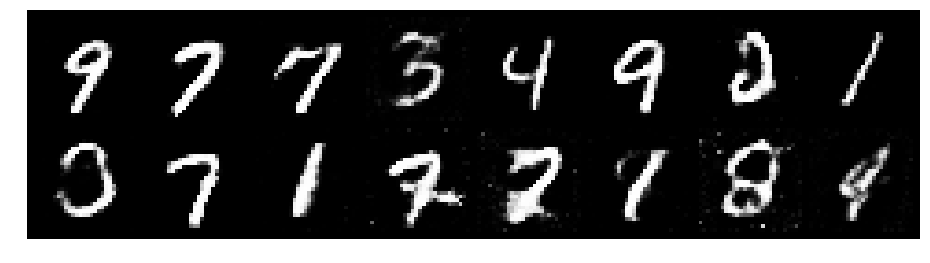

Epoch: [184/200], Batch Num: [200/600]
Discriminator Loss: 1.2820, Generator Loss: 0.8574
D(x): 0.5273, D(G(z)): 0.4398


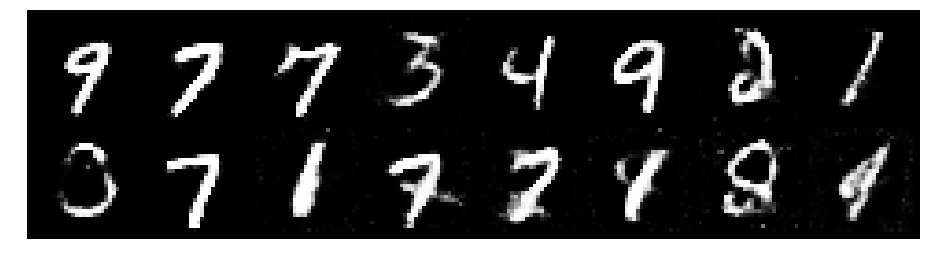

Epoch: [184/200], Batch Num: [300/600]
Discriminator Loss: 1.2049, Generator Loss: 0.8655
D(x): 0.5840, D(G(z)): 0.4426


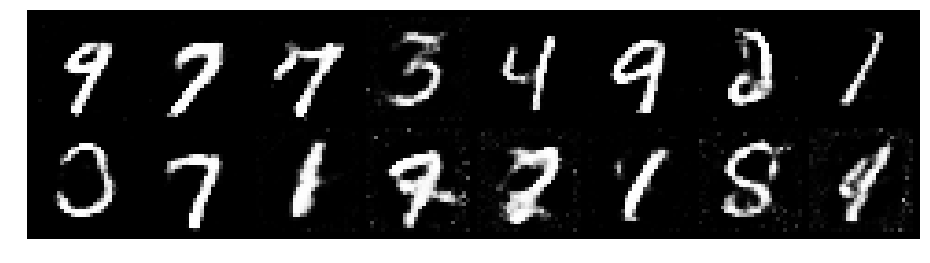

Epoch: [184/200], Batch Num: [400/600]
Discriminator Loss: 1.2695, Generator Loss: 0.8894
D(x): 0.5221, D(G(z)): 0.4112


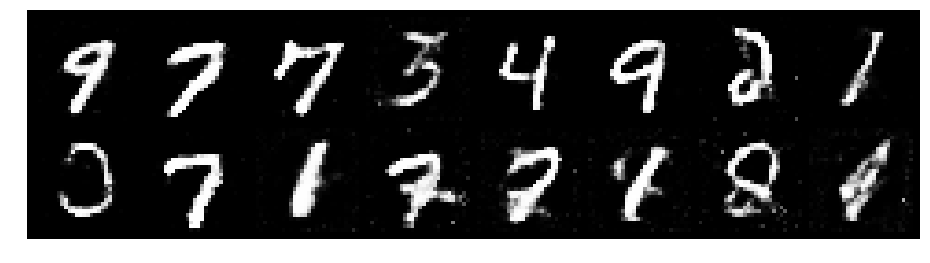

Epoch: [184/200], Batch Num: [500/600]
Discriminator Loss: 1.2237, Generator Loss: 0.8767
D(x): 0.5374, D(G(z)): 0.4182


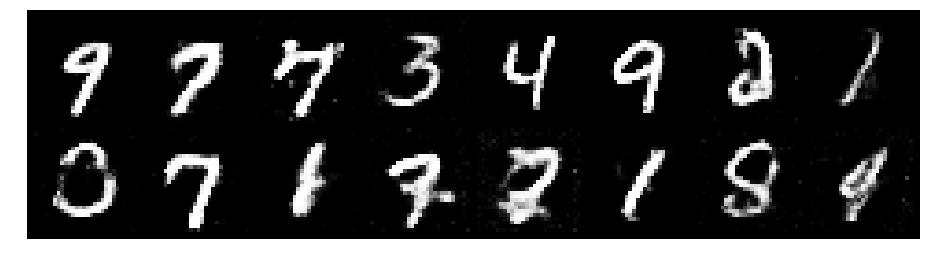

Epoch: [185/200], Batch Num: [0/600]
Discriminator Loss: 1.2197, Generator Loss: 0.9112
D(x): 0.5479, D(G(z)): 0.4134


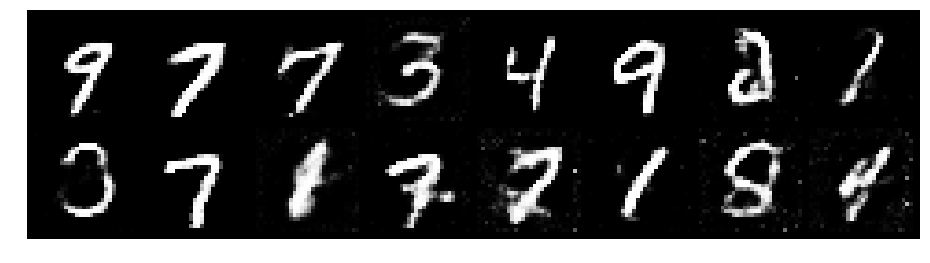

Epoch: [185/200], Batch Num: [100/600]
Discriminator Loss: 1.3507, Generator Loss: 0.8187
D(x): 0.5147, D(G(z)): 0.4594


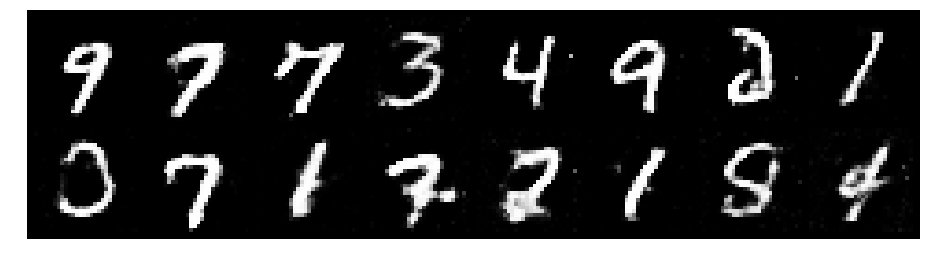

Epoch: [185/200], Batch Num: [200/600]
Discriminator Loss: 1.2385, Generator Loss: 0.9344
D(x): 0.5583, D(G(z)): 0.4402


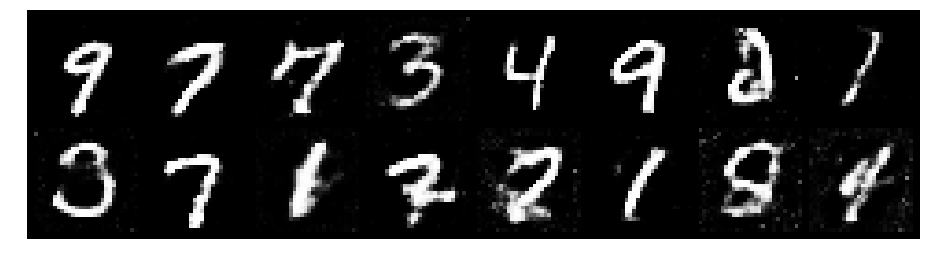

Epoch: [185/200], Batch Num: [300/600]
Discriminator Loss: 1.2970, Generator Loss: 0.8730
D(x): 0.5489, D(G(z)): 0.4472


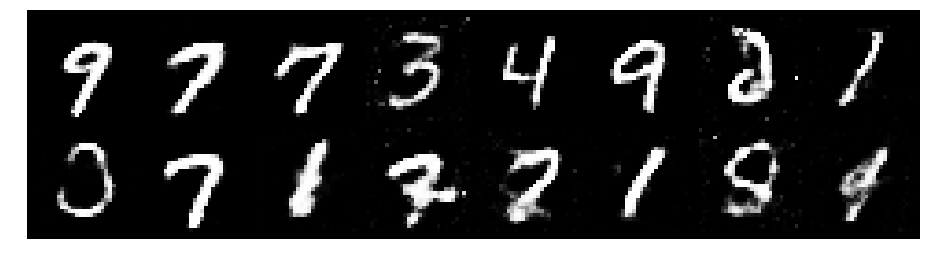

Epoch: [185/200], Batch Num: [400/600]
Discriminator Loss: 1.2831, Generator Loss: 0.9743
D(x): 0.5458, D(G(z)): 0.4333


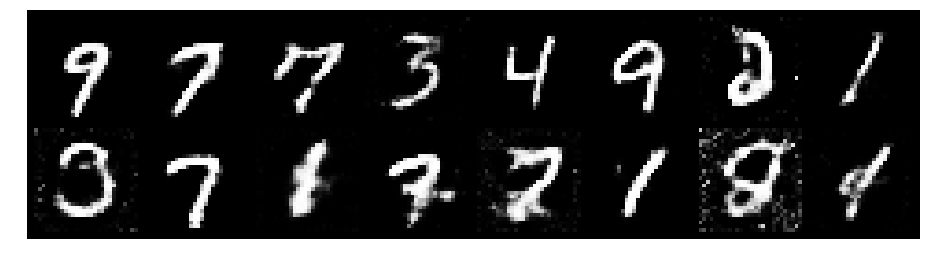

Epoch: [185/200], Batch Num: [500/600]
Discriminator Loss: 1.3598, Generator Loss: 0.9844
D(x): 0.5382, D(G(z)): 0.4564


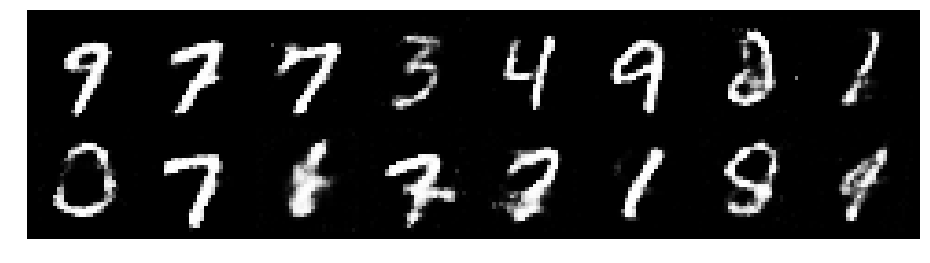

Epoch: [186/200], Batch Num: [0/600]
Discriminator Loss: 1.2503, Generator Loss: 0.9707
D(x): 0.5430, D(G(z)): 0.4190


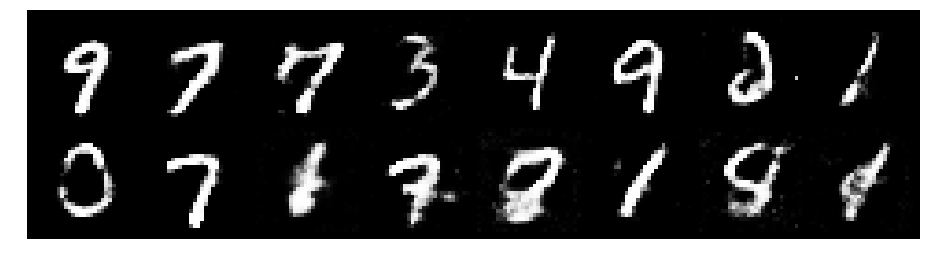

Epoch: [186/200], Batch Num: [100/600]
Discriminator Loss: 1.2574, Generator Loss: 0.8894
D(x): 0.5470, D(G(z)): 0.4376


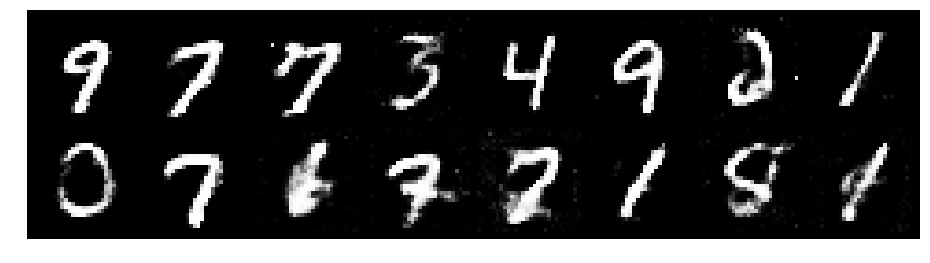

Epoch: [186/200], Batch Num: [200/600]
Discriminator Loss: 1.2610, Generator Loss: 0.8850
D(x): 0.5306, D(G(z)): 0.4306


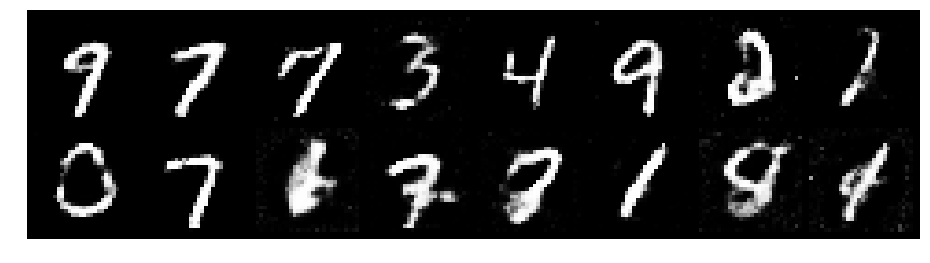

Epoch: [186/200], Batch Num: [300/600]
Discriminator Loss: 1.2036, Generator Loss: 1.0518
D(x): 0.5412, D(G(z)): 0.3951


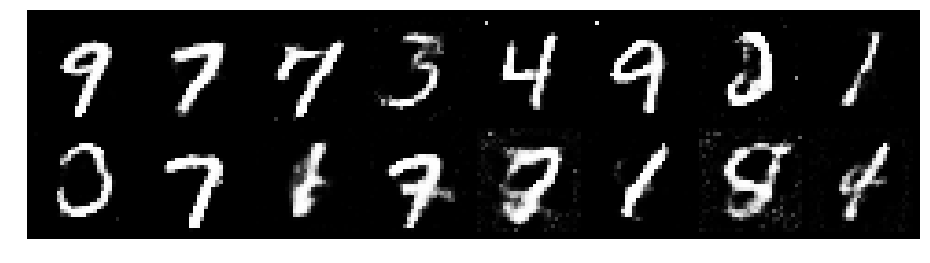

Epoch: [186/200], Batch Num: [400/600]
Discriminator Loss: 1.3462, Generator Loss: 0.8809
D(x): 0.5555, D(G(z)): 0.4643


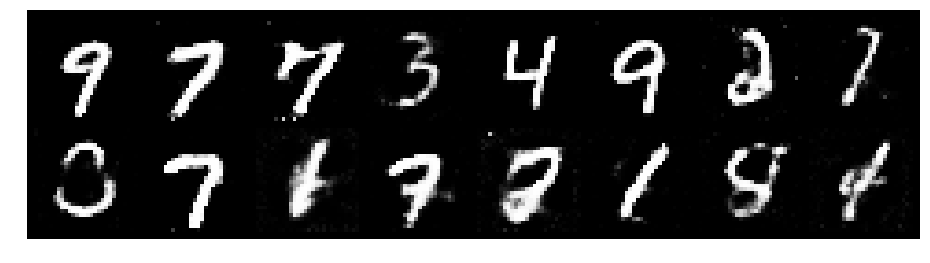

Epoch: [186/200], Batch Num: [500/600]
Discriminator Loss: 1.4569, Generator Loss: 0.8752
D(x): 0.5006, D(G(z)): 0.4383


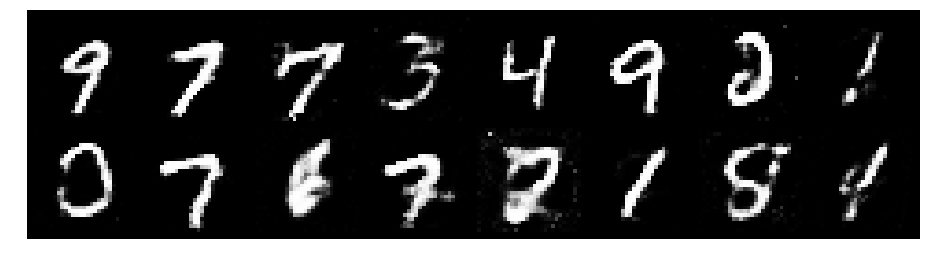

Epoch: [187/200], Batch Num: [0/600]
Discriminator Loss: 1.4135, Generator Loss: 0.7880
D(x): 0.4917, D(G(z)): 0.4852


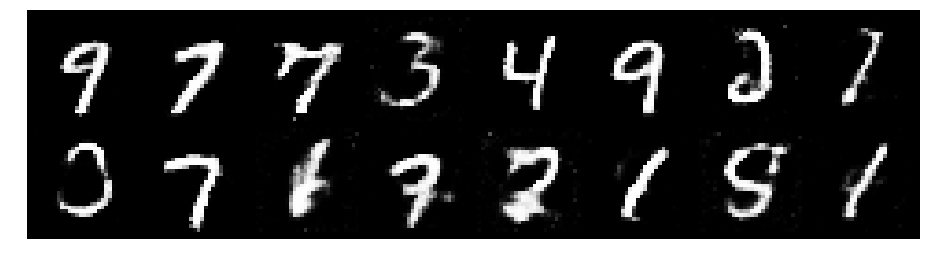

Epoch: [187/200], Batch Num: [100/600]
Discriminator Loss: 1.3593, Generator Loss: 0.7179
D(x): 0.5419, D(G(z)): 0.4862


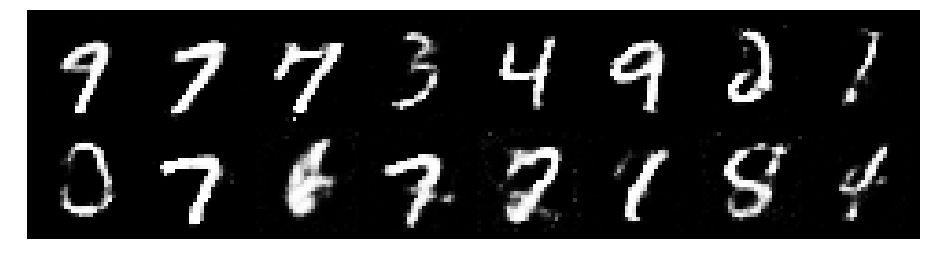

Epoch: [187/200], Batch Num: [200/600]
Discriminator Loss: 1.4375, Generator Loss: 0.8126
D(x): 0.4888, D(G(z)): 0.4699


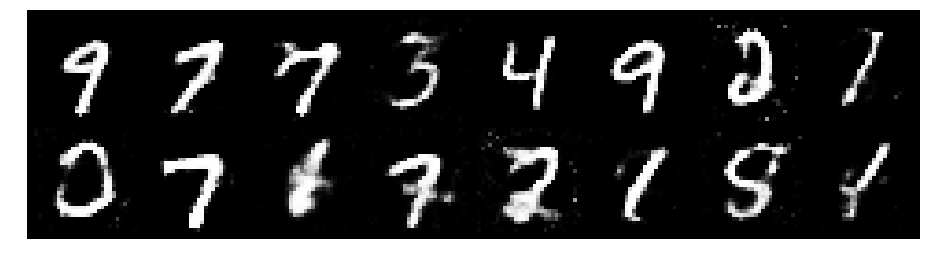

Epoch: [187/200], Batch Num: [300/600]
Discriminator Loss: 1.1716, Generator Loss: 0.9408
D(x): 0.5850, D(G(z)): 0.4124


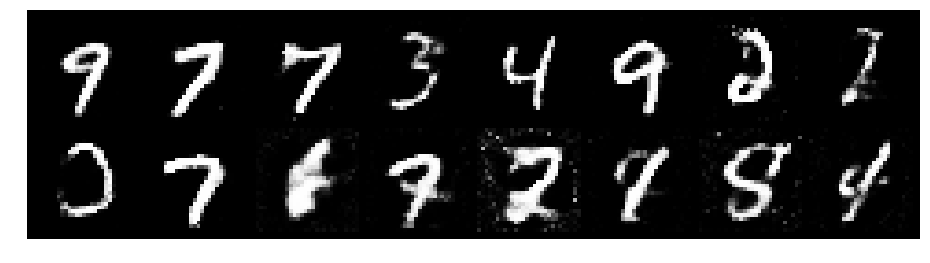

Epoch: [187/200], Batch Num: [400/600]
Discriminator Loss: 1.3414, Generator Loss: 0.9247
D(x): 0.5489, D(G(z)): 0.4735


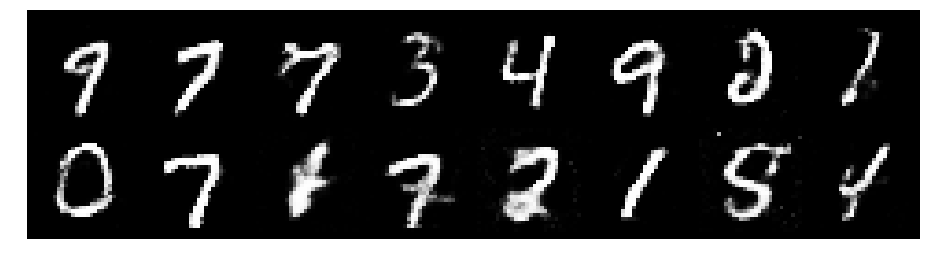

Epoch: [187/200], Batch Num: [500/600]
Discriminator Loss: 1.2606, Generator Loss: 0.8893
D(x): 0.5347, D(G(z)): 0.4200


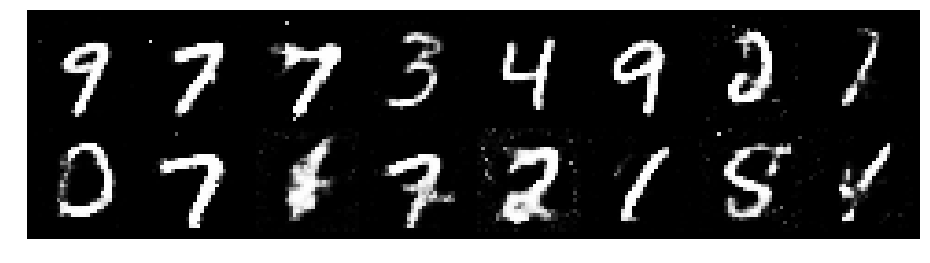

Epoch: [188/200], Batch Num: [0/600]
Discriminator Loss: 1.2569, Generator Loss: 0.8727
D(x): 0.5424, D(G(z)): 0.4198


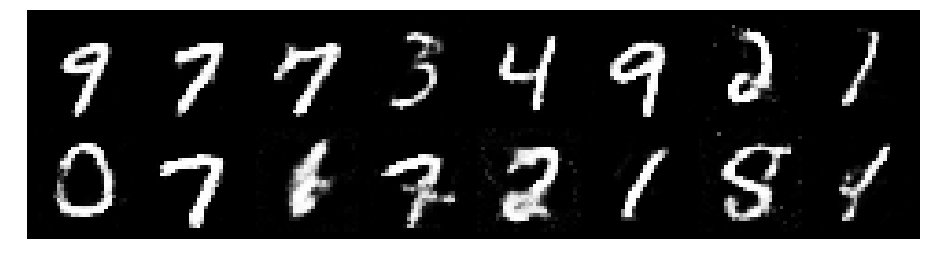

Epoch: [188/200], Batch Num: [100/600]
Discriminator Loss: 1.2612, Generator Loss: 0.9674
D(x): 0.5269, D(G(z)): 0.4000


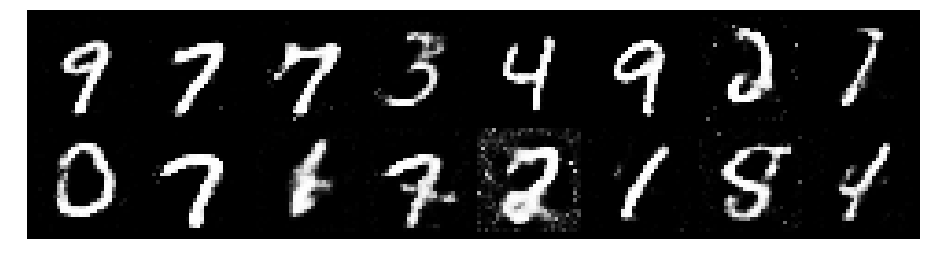

Epoch: [188/200], Batch Num: [200/600]
Discriminator Loss: 1.1920, Generator Loss: 0.9520
D(x): 0.5753, D(G(z)): 0.4259


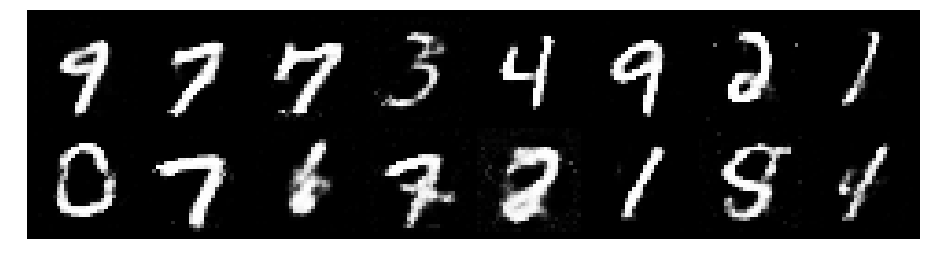

Epoch: [188/200], Batch Num: [300/600]
Discriminator Loss: 1.3518, Generator Loss: 1.0390
D(x): 0.5412, D(G(z)): 0.4242


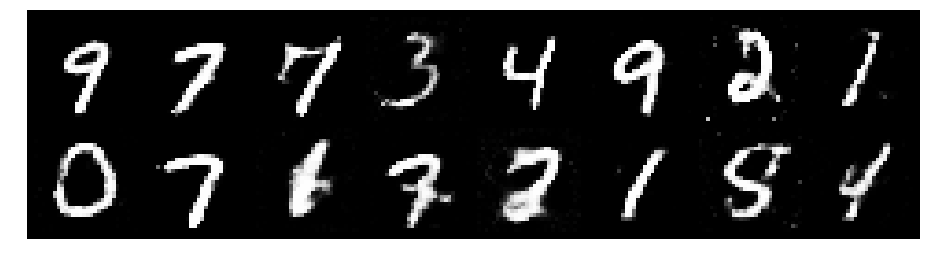

Epoch: [188/200], Batch Num: [400/600]
Discriminator Loss: 1.2430, Generator Loss: 0.9670
D(x): 0.5603, D(G(z)): 0.4259


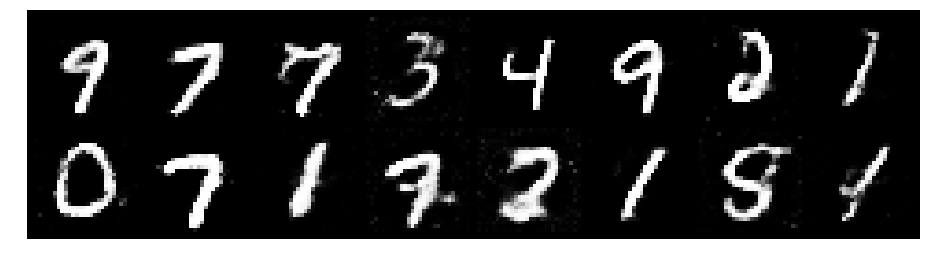

Epoch: [188/200], Batch Num: [500/600]
Discriminator Loss: 1.3457, Generator Loss: 0.8527
D(x): 0.5535, D(G(z)): 0.4686


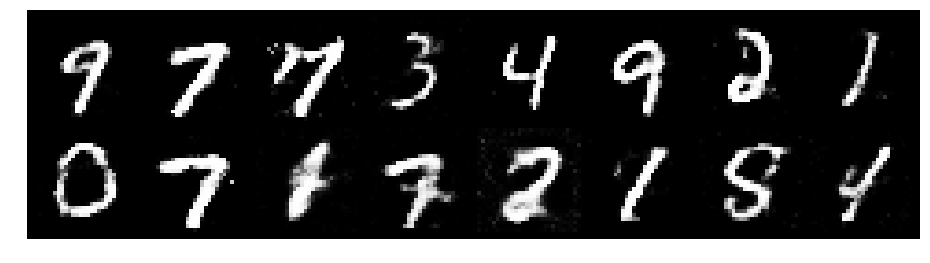

Epoch: [189/200], Batch Num: [0/600]
Discriminator Loss: 1.3956, Generator Loss: 0.8791
D(x): 0.5017, D(G(z)): 0.4515


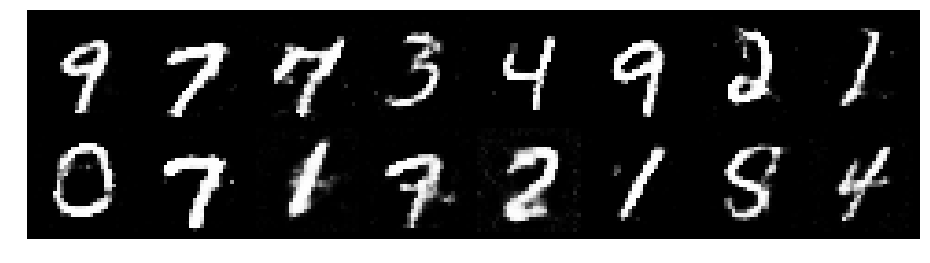

Epoch: [189/200], Batch Num: [100/600]
Discriminator Loss: 1.3199, Generator Loss: 0.8565
D(x): 0.4810, D(G(z)): 0.4121


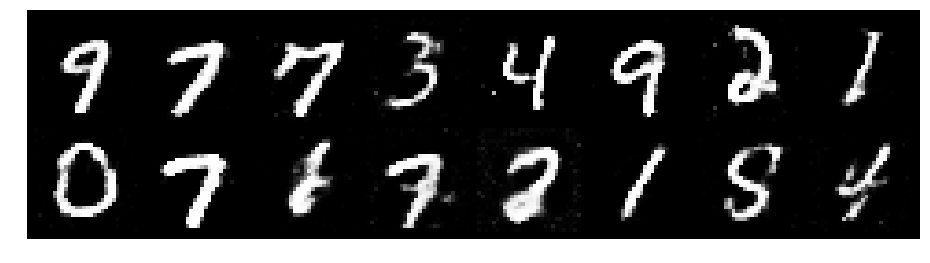

Epoch: [189/200], Batch Num: [200/600]
Discriminator Loss: 1.3183, Generator Loss: 0.8151
D(x): 0.5651, D(G(z)): 0.4701


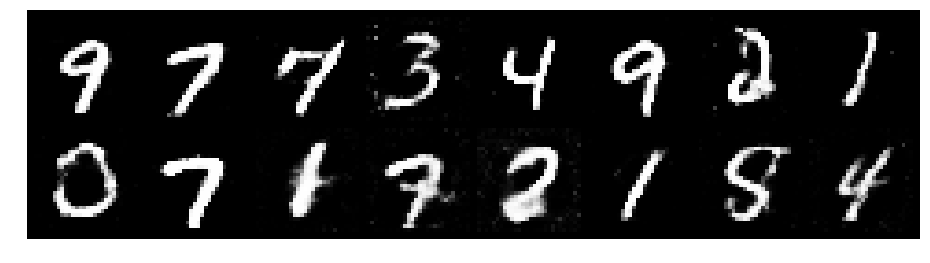

Epoch: [189/200], Batch Num: [300/600]
Discriminator Loss: 1.1328, Generator Loss: 0.9275
D(x): 0.5936, D(G(z)): 0.4009


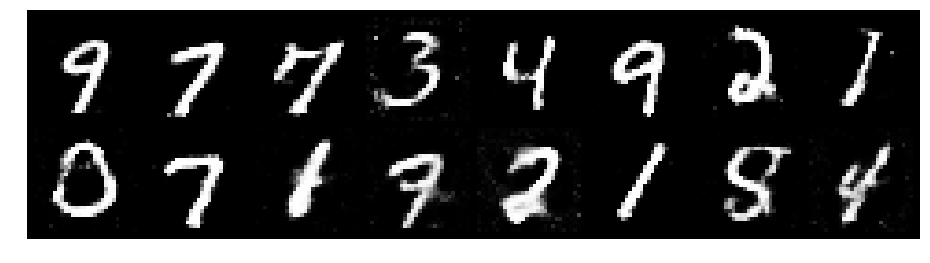

Epoch: [189/200], Batch Num: [400/600]
Discriminator Loss: 1.1928, Generator Loss: 0.9427
D(x): 0.5746, D(G(z)): 0.4198


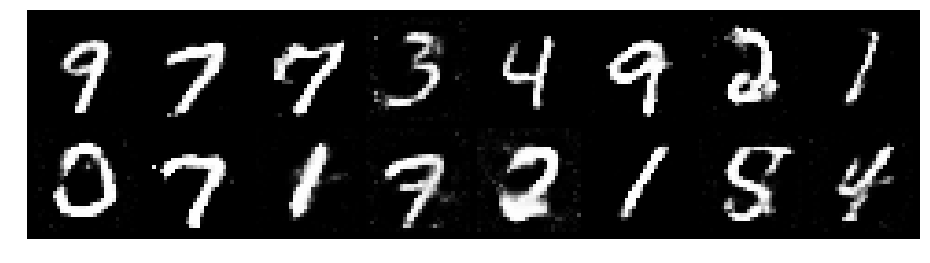

Epoch: [189/200], Batch Num: [500/600]
Discriminator Loss: 1.2179, Generator Loss: 0.9743
D(x): 0.5693, D(G(z)): 0.4173


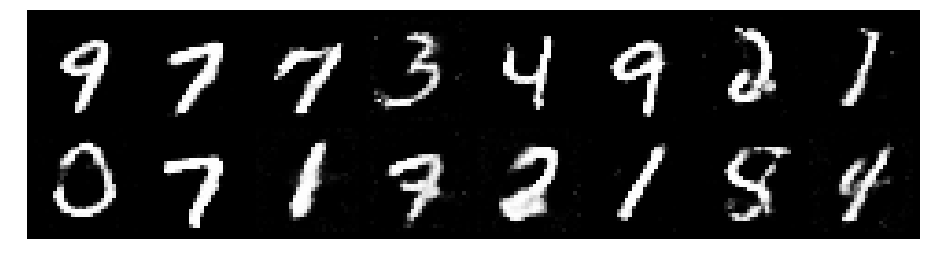

Epoch: [190/200], Batch Num: [0/600]
Discriminator Loss: 1.2418, Generator Loss: 0.8278
D(x): 0.5659, D(G(z)): 0.4457


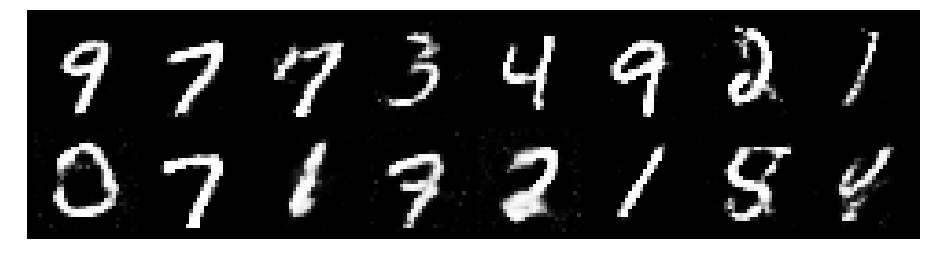

Epoch: [190/200], Batch Num: [100/600]
Discriminator Loss: 1.3633, Generator Loss: 0.7738
D(x): 0.5437, D(G(z)): 0.4733


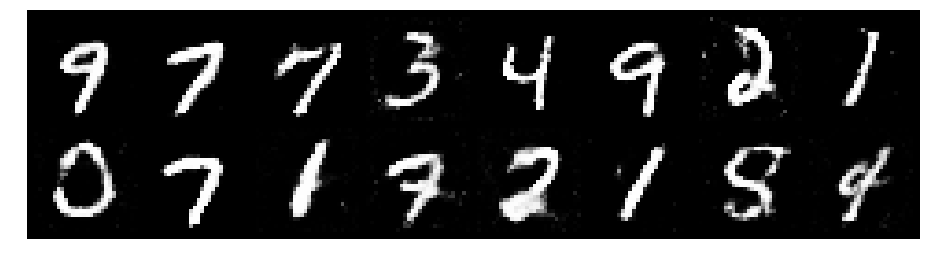

Epoch: [190/200], Batch Num: [200/600]
Discriminator Loss: 1.4337, Generator Loss: 0.9190
D(x): 0.5276, D(G(z)): 0.4690


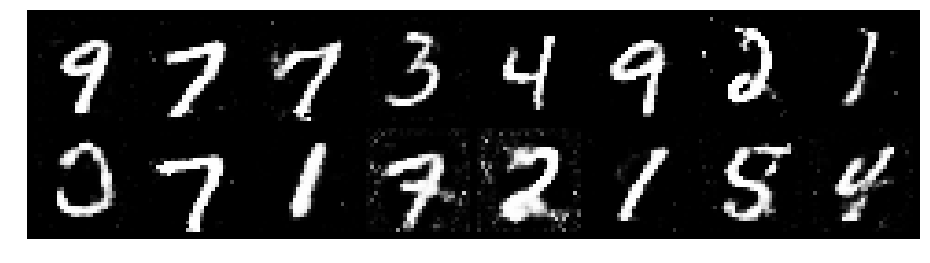

Epoch: [190/200], Batch Num: [300/600]
Discriminator Loss: 1.3433, Generator Loss: 0.7442
D(x): 0.5363, D(G(z)): 0.4785


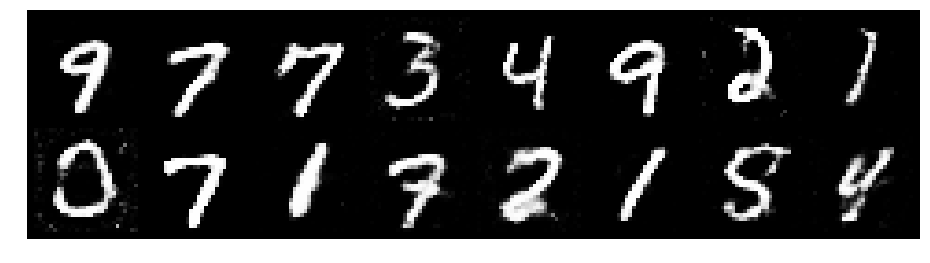

Epoch: [190/200], Batch Num: [400/600]
Discriminator Loss: 1.4199, Generator Loss: 0.8652
D(x): 0.5514, D(G(z)): 0.4968


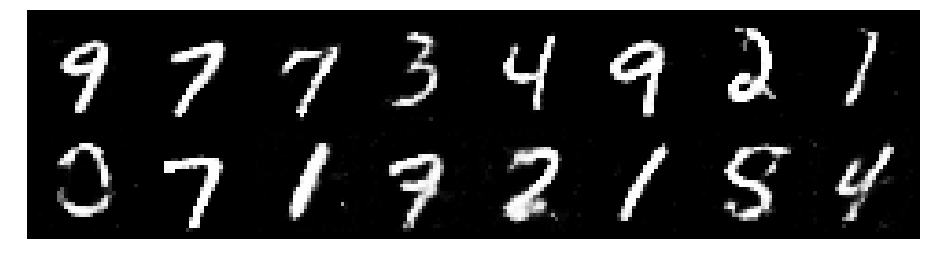

Epoch: [190/200], Batch Num: [500/600]
Discriminator Loss: 1.2734, Generator Loss: 0.9732
D(x): 0.5465, D(G(z)): 0.4162


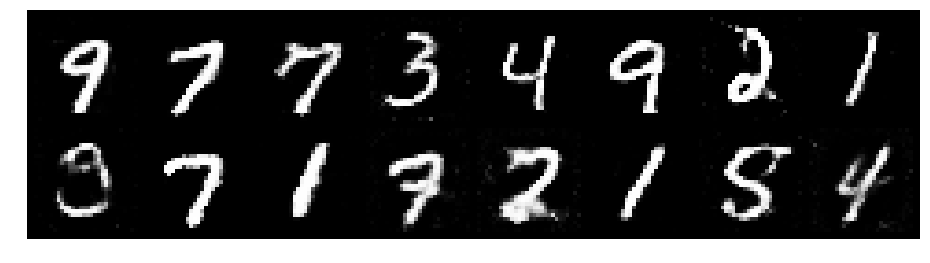

Epoch: [191/200], Batch Num: [0/600]
Discriminator Loss: 1.3813, Generator Loss: 0.8642
D(x): 0.5740, D(G(z)): 0.5103


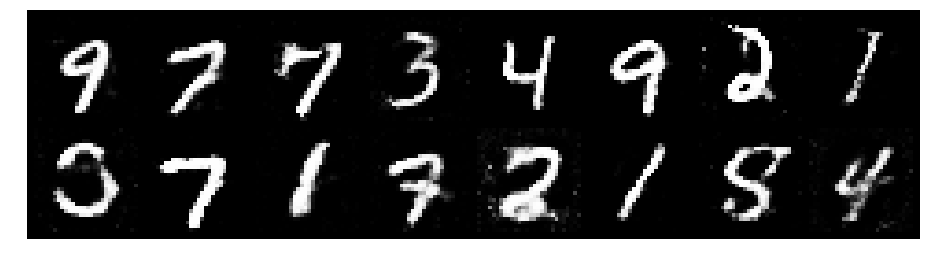

Epoch: [191/200], Batch Num: [100/600]
Discriminator Loss: 1.2314, Generator Loss: 0.8990
D(x): 0.5438, D(G(z)): 0.4277


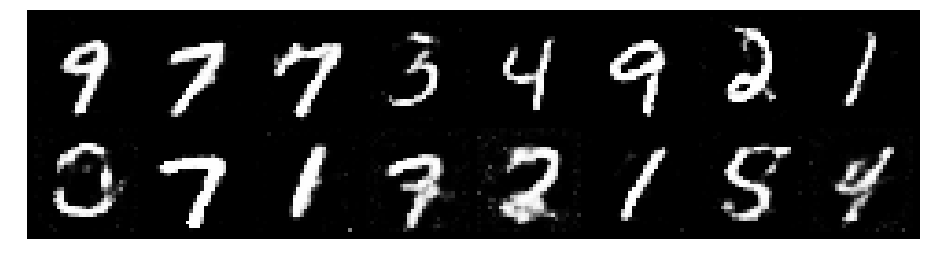

Epoch: [191/200], Batch Num: [200/600]
Discriminator Loss: 1.2612, Generator Loss: 0.8684
D(x): 0.5366, D(G(z)): 0.4315


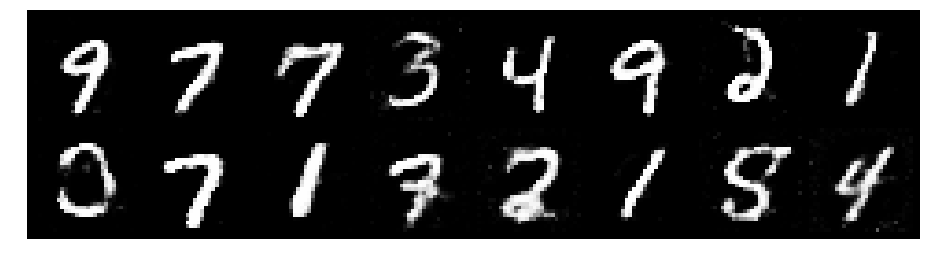

Epoch: [191/200], Batch Num: [300/600]
Discriminator Loss: 1.2251, Generator Loss: 0.9295
D(x): 0.5451, D(G(z)): 0.4171


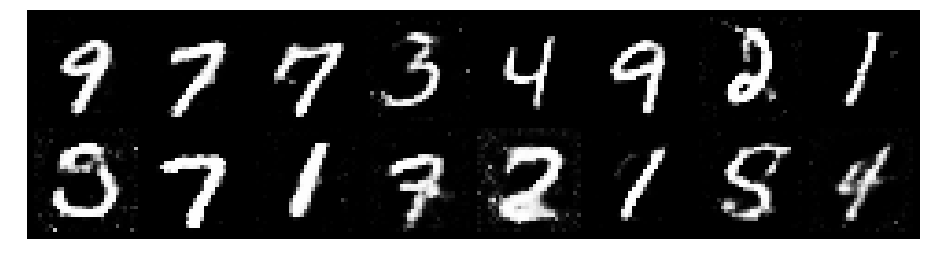

Epoch: [191/200], Batch Num: [400/600]
Discriminator Loss: 1.1880, Generator Loss: 0.9231
D(x): 0.5483, D(G(z)): 0.3875


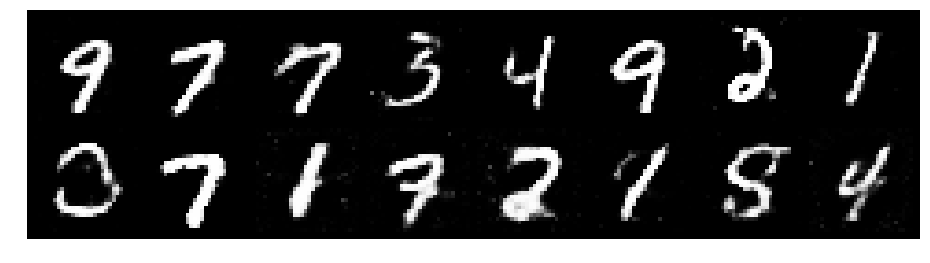

Epoch: [191/200], Batch Num: [500/600]
Discriminator Loss: 1.3484, Generator Loss: 0.8337
D(x): 0.5530, D(G(z)): 0.4671


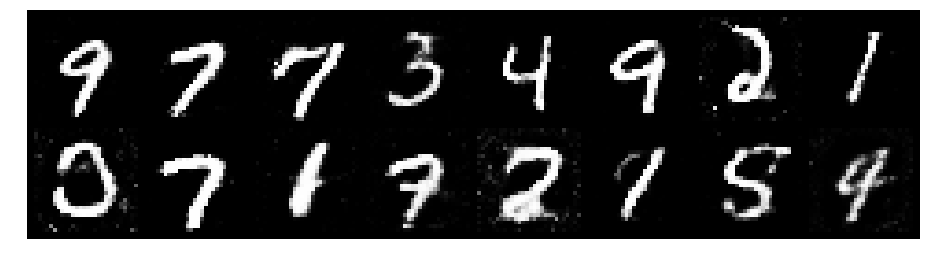

Epoch: [192/200], Batch Num: [0/600]
Discriminator Loss: 1.2910, Generator Loss: 0.8003
D(x): 0.5806, D(G(z)): 0.4641


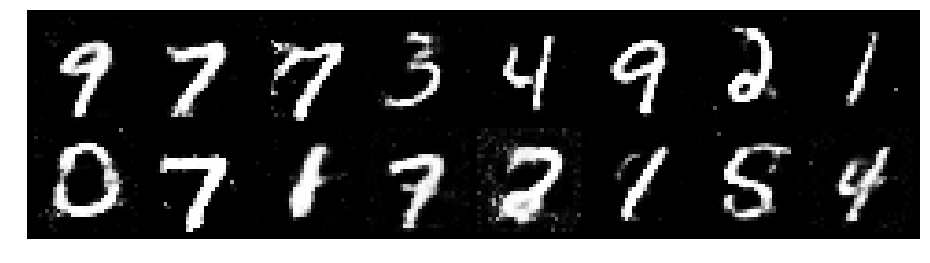

Epoch: [192/200], Batch Num: [100/600]
Discriminator Loss: 1.1973, Generator Loss: 0.8687
D(x): 0.5743, D(G(z)): 0.4296


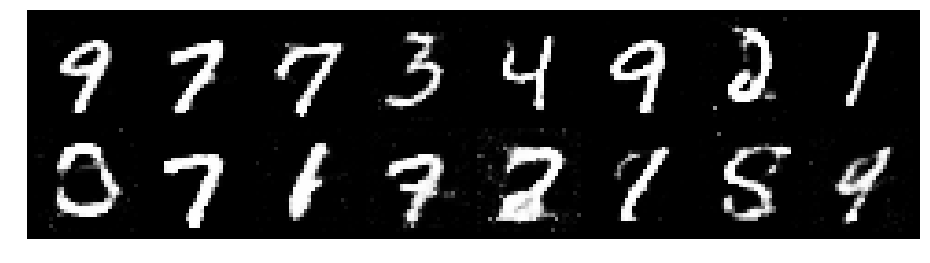

Epoch: [192/200], Batch Num: [200/600]
Discriminator Loss: 1.1942, Generator Loss: 0.9282
D(x): 0.5898, D(G(z)): 0.4464


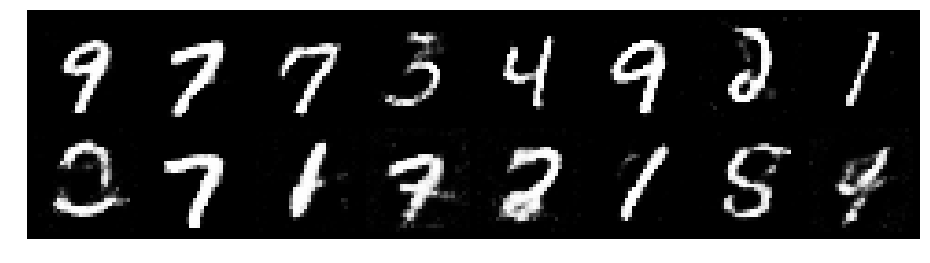

Epoch: [192/200], Batch Num: [300/600]
Discriminator Loss: 1.3073, Generator Loss: 0.9612
D(x): 0.5503, D(G(z)): 0.4483


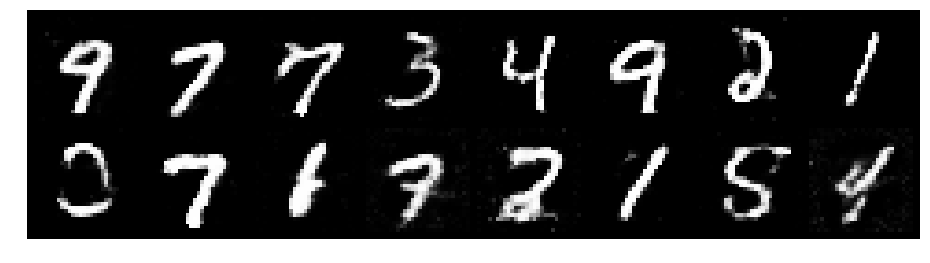

Epoch: [192/200], Batch Num: [400/600]
Discriminator Loss: 1.2084, Generator Loss: 1.0223
D(x): 0.5434, D(G(z)): 0.3886


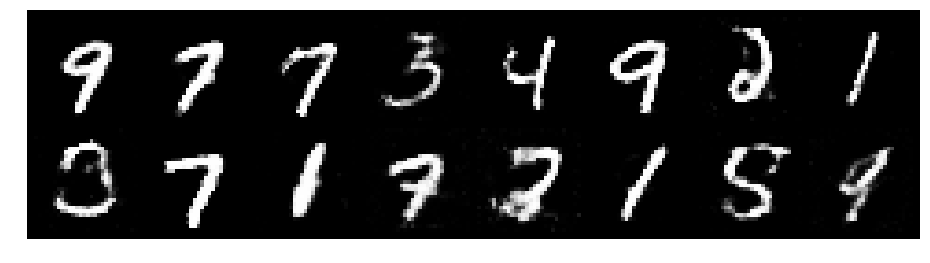

Epoch: [192/200], Batch Num: [500/600]
Discriminator Loss: 1.2651, Generator Loss: 0.8520
D(x): 0.5547, D(G(z)): 0.4500


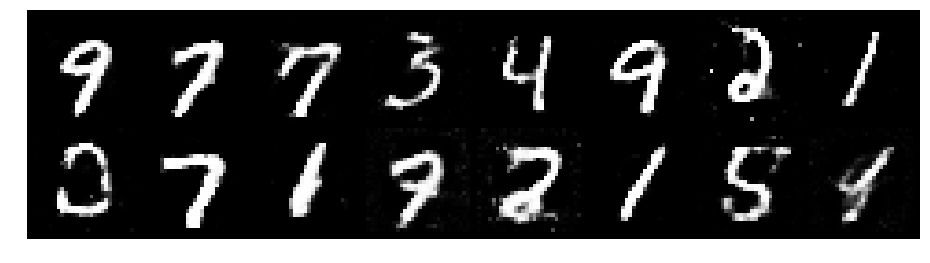

Epoch: [193/200], Batch Num: [0/600]
Discriminator Loss: 1.2780, Generator Loss: 0.8281
D(x): 0.5297, D(G(z)): 0.4350


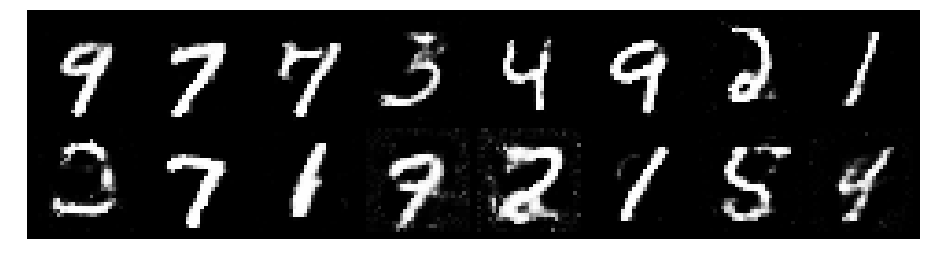

Epoch: [193/200], Batch Num: [100/600]
Discriminator Loss: 1.2092, Generator Loss: 0.9257
D(x): 0.5687, D(G(z)): 0.4348


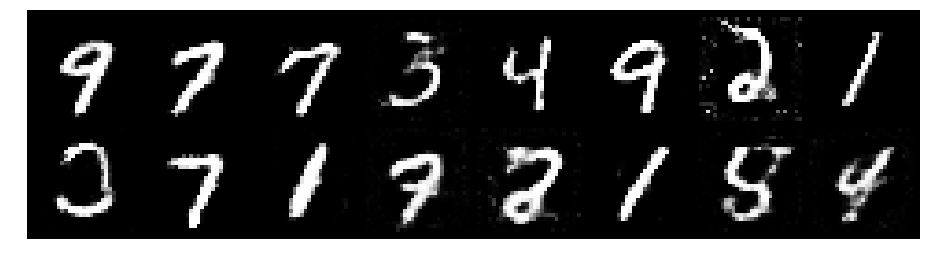

Epoch: [193/200], Batch Num: [200/600]
Discriminator Loss: 1.2392, Generator Loss: 0.7966
D(x): 0.5560, D(G(z)): 0.4312


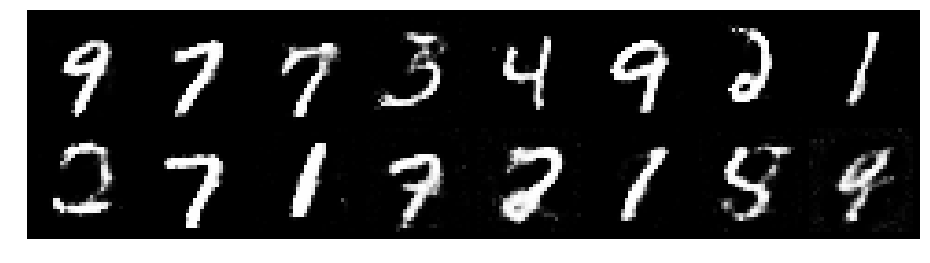

Epoch: [193/200], Batch Num: [300/600]
Discriminator Loss: 1.2454, Generator Loss: 1.0253
D(x): 0.5785, D(G(z)): 0.4186


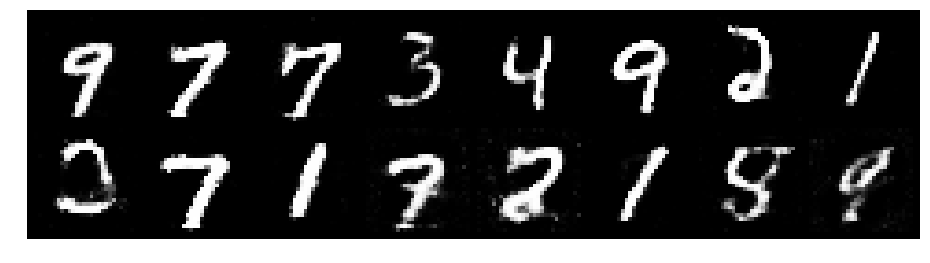

Epoch: [193/200], Batch Num: [400/600]
Discriminator Loss: 1.3433, Generator Loss: 0.9523
D(x): 0.5329, D(G(z)): 0.4355


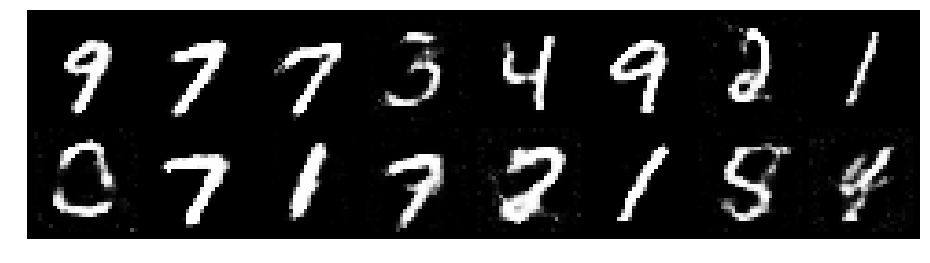

Epoch: [193/200], Batch Num: [500/600]
Discriminator Loss: 1.3173, Generator Loss: 0.8209
D(x): 0.5315, D(G(z)): 0.4650


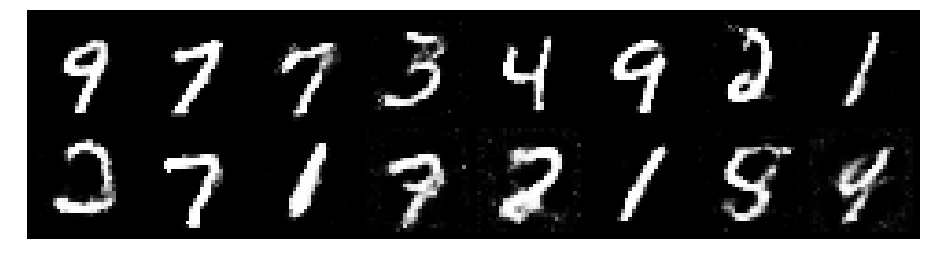

Epoch: [194/200], Batch Num: [0/600]
Discriminator Loss: 1.2232, Generator Loss: 0.8059
D(x): 0.6100, D(G(z)): 0.4928


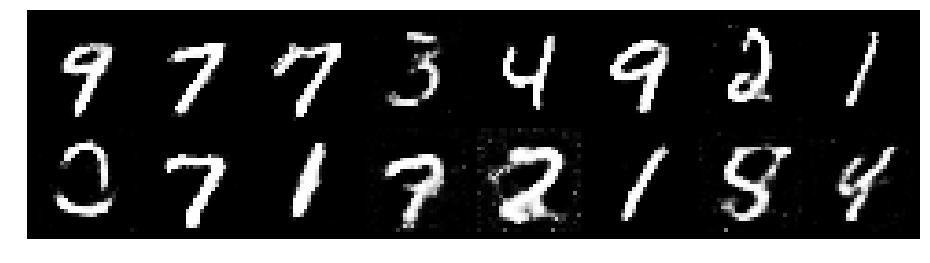

Epoch: [194/200], Batch Num: [100/600]
Discriminator Loss: 1.3107, Generator Loss: 0.8600
D(x): 0.5316, D(G(z)): 0.4461


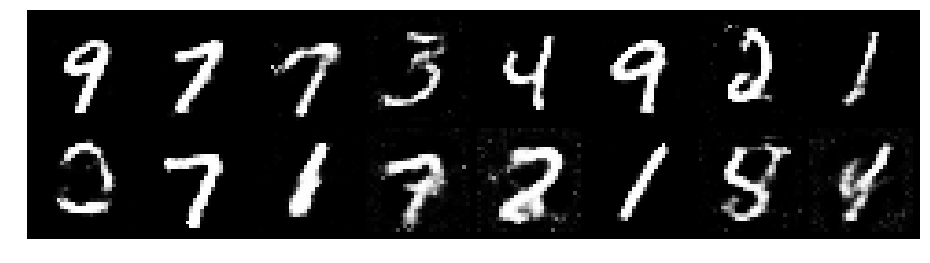

Epoch: [194/200], Batch Num: [200/600]
Discriminator Loss: 1.3301, Generator Loss: 0.8663
D(x): 0.5262, D(G(z)): 0.4581


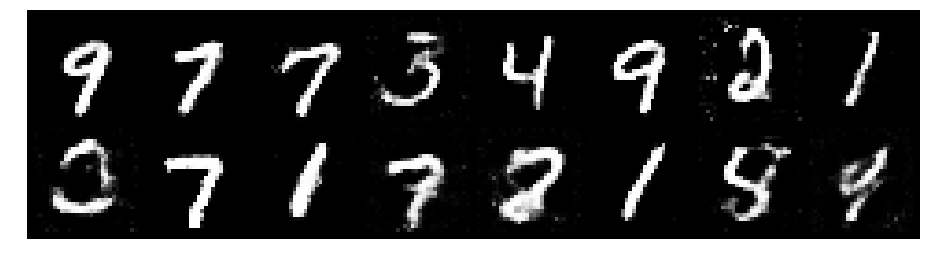

Epoch: [194/200], Batch Num: [300/600]
Discriminator Loss: 1.1763, Generator Loss: 0.9490
D(x): 0.5946, D(G(z)): 0.4342


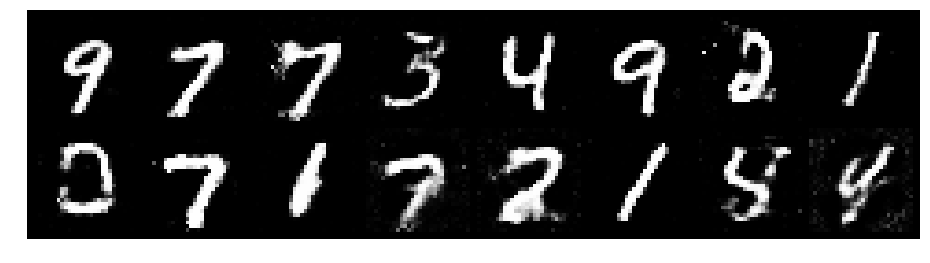

Epoch: [194/200], Batch Num: [400/600]
Discriminator Loss: 1.1675, Generator Loss: 1.1080
D(x): 0.5653, D(G(z)): 0.4004


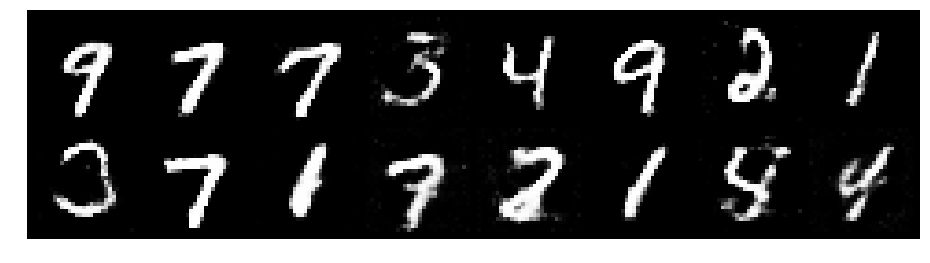

Epoch: [194/200], Batch Num: [500/600]
Discriminator Loss: 1.3085, Generator Loss: 0.9916
D(x): 0.5111, D(G(z)): 0.4189


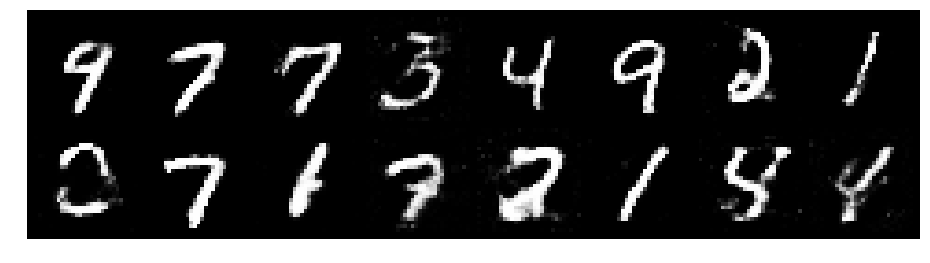

Epoch: [195/200], Batch Num: [0/600]
Discriminator Loss: 1.2895, Generator Loss: 0.8824
D(x): 0.5466, D(G(z)): 0.4565


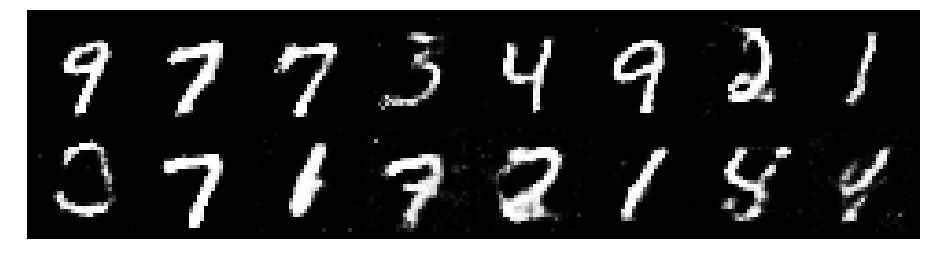

Epoch: [195/200], Batch Num: [100/600]
Discriminator Loss: 1.3294, Generator Loss: 0.8831
D(x): 0.5095, D(G(z)): 0.4485


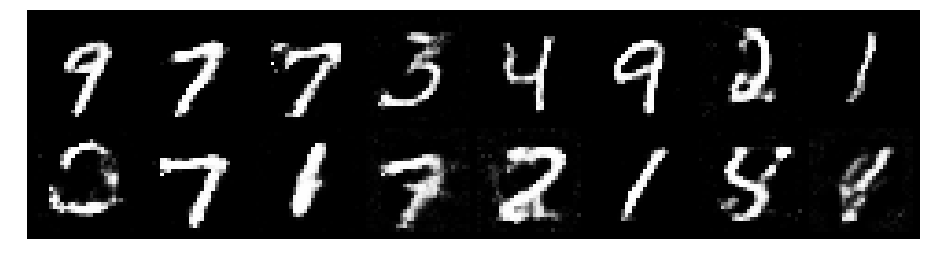

Epoch: [195/200], Batch Num: [200/600]
Discriminator Loss: 1.1439, Generator Loss: 0.9589
D(x): 0.5451, D(G(z)): 0.3796


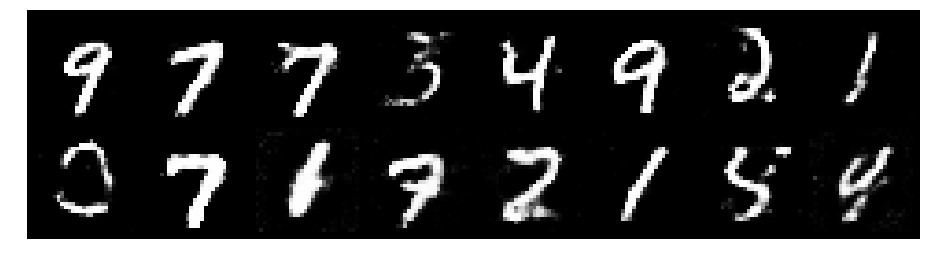

Epoch: [195/200], Batch Num: [300/600]
Discriminator Loss: 1.2063, Generator Loss: 0.9885
D(x): 0.5445, D(G(z)): 0.3750


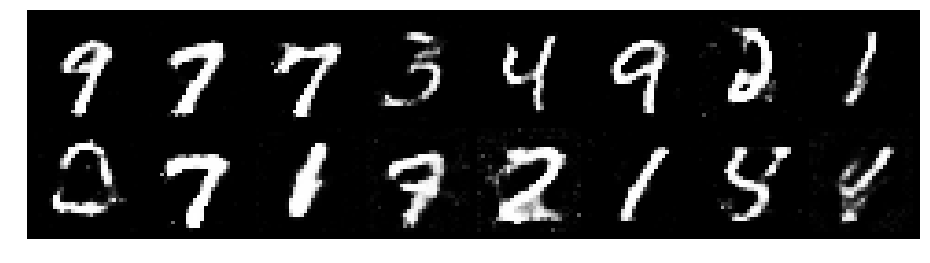

Epoch: [195/200], Batch Num: [400/600]
Discriminator Loss: 1.4185, Generator Loss: 1.0590
D(x): 0.4691, D(G(z)): 0.4045


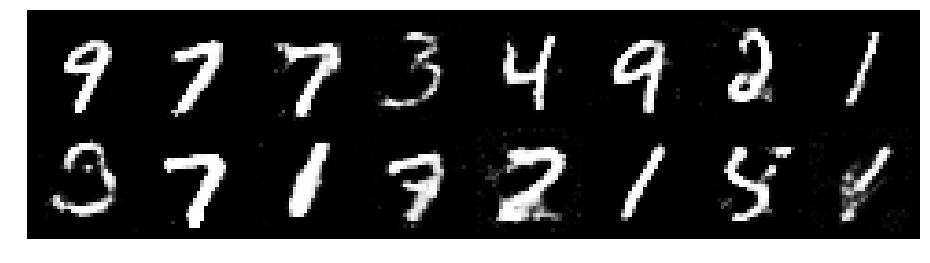

Epoch: [195/200], Batch Num: [500/600]
Discriminator Loss: 1.3543, Generator Loss: 1.0593
D(x): 0.5150, D(G(z)): 0.4266


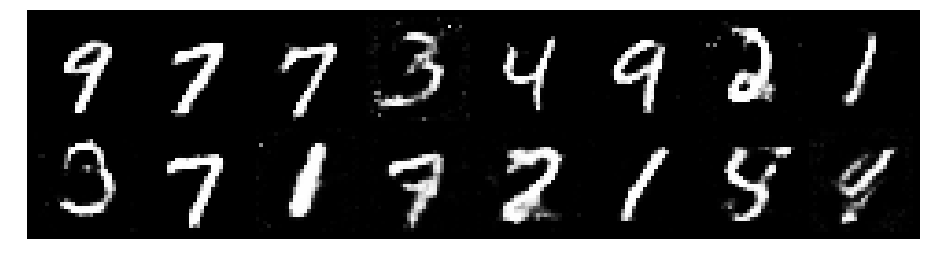

Epoch: [196/200], Batch Num: [0/600]
Discriminator Loss: 1.3343, Generator Loss: 0.8653
D(x): 0.5498, D(G(z)): 0.4803


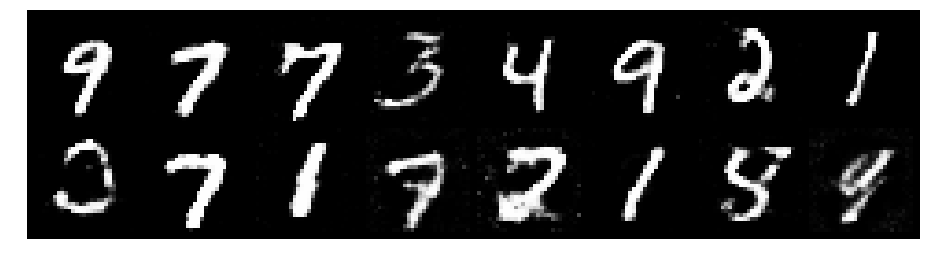

Epoch: [196/200], Batch Num: [100/600]
Discriminator Loss: 1.2719, Generator Loss: 0.8278
D(x): 0.5592, D(G(z)): 0.4531


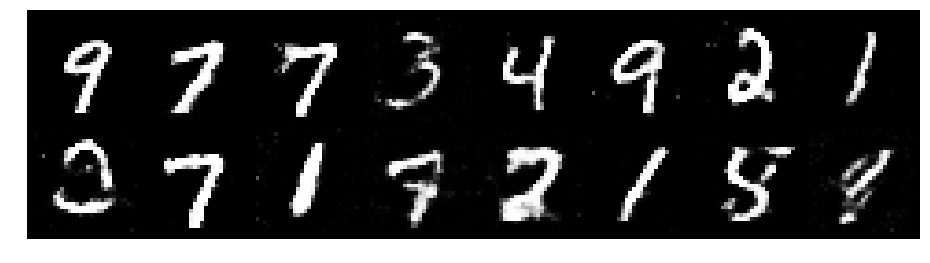

Epoch: [196/200], Batch Num: [200/600]
Discriminator Loss: 1.2643, Generator Loss: 0.8389
D(x): 0.5640, D(G(z)): 0.4599


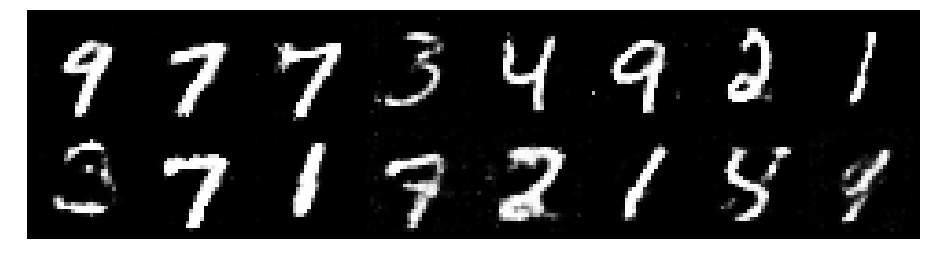

Epoch: [196/200], Batch Num: [300/600]
Discriminator Loss: 1.1959, Generator Loss: 1.0840
D(x): 0.6059, D(G(z)): 0.4195


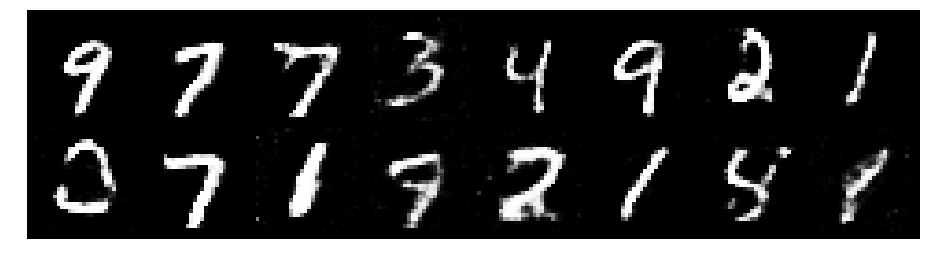

Epoch: [196/200], Batch Num: [400/600]
Discriminator Loss: 1.3365, Generator Loss: 1.0402
D(x): 0.5195, D(G(z)): 0.4361


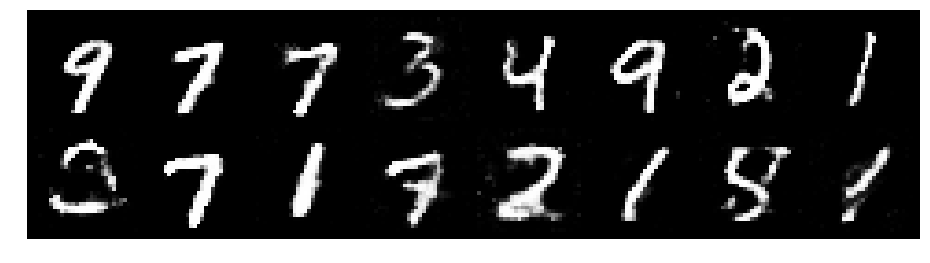

Epoch: [196/200], Batch Num: [500/600]
Discriminator Loss: 1.2817, Generator Loss: 0.8845
D(x): 0.5765, D(G(z)): 0.4601


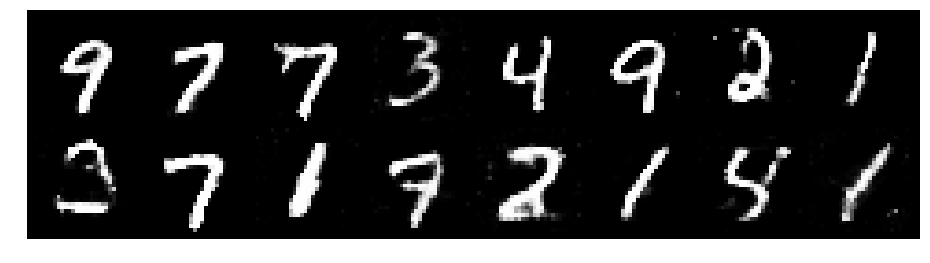

Epoch: [197/200], Batch Num: [0/600]
Discriminator Loss: 1.2327, Generator Loss: 0.9328
D(x): 0.5756, D(G(z)): 0.4406


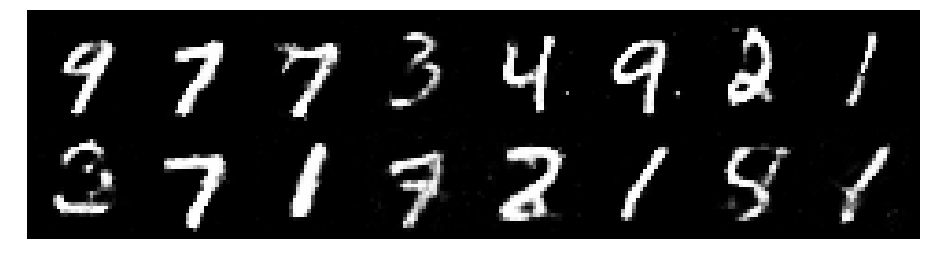

Epoch: [197/200], Batch Num: [100/600]
Discriminator Loss: 1.3183, Generator Loss: 0.7778
D(x): 0.5266, D(G(z)): 0.4329


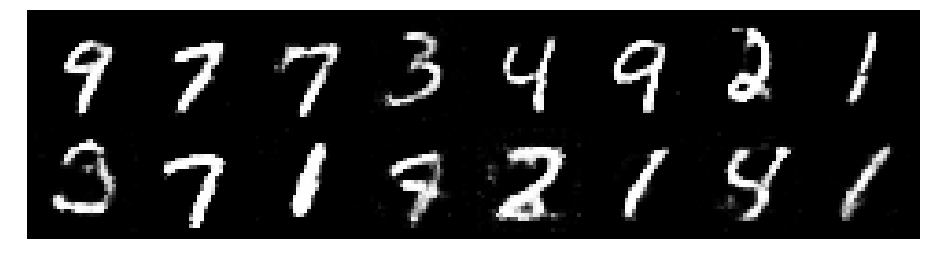

Epoch: [197/200], Batch Num: [200/600]
Discriminator Loss: 1.3725, Generator Loss: 0.9301
D(x): 0.5371, D(G(z)): 0.4774


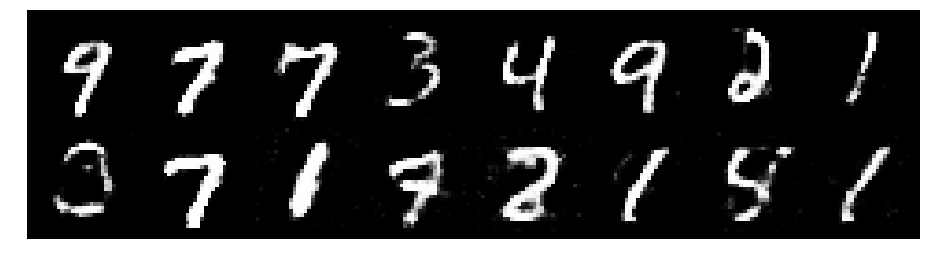

Epoch: [197/200], Batch Num: [300/600]
Discriminator Loss: 1.3297, Generator Loss: 0.8344
D(x): 0.5246, D(G(z)): 0.4542


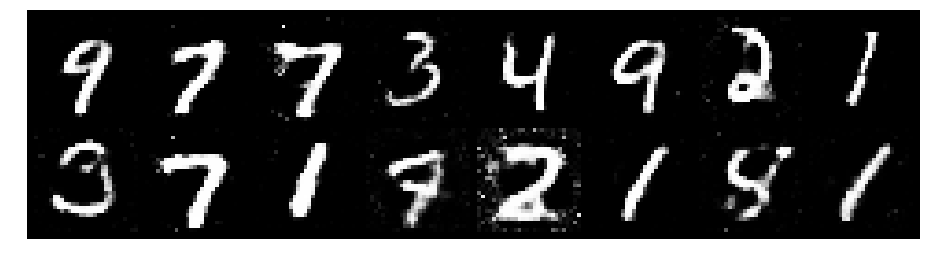

Epoch: [197/200], Batch Num: [400/600]
Discriminator Loss: 1.4133, Generator Loss: 0.8765
D(x): 0.5045, D(G(z)): 0.4585


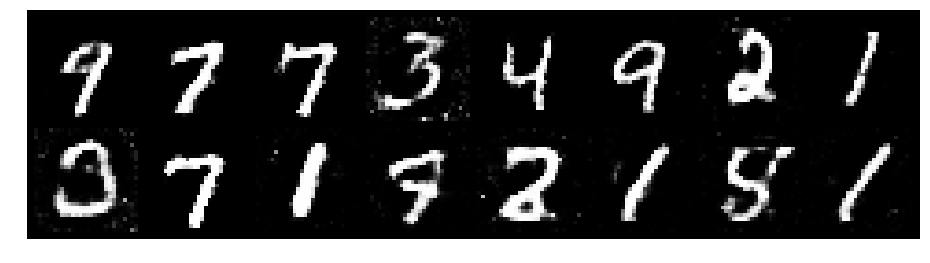

Epoch: [197/200], Batch Num: [500/600]
Discriminator Loss: 1.3371, Generator Loss: 0.8461
D(x): 0.5183, D(G(z)): 0.4508


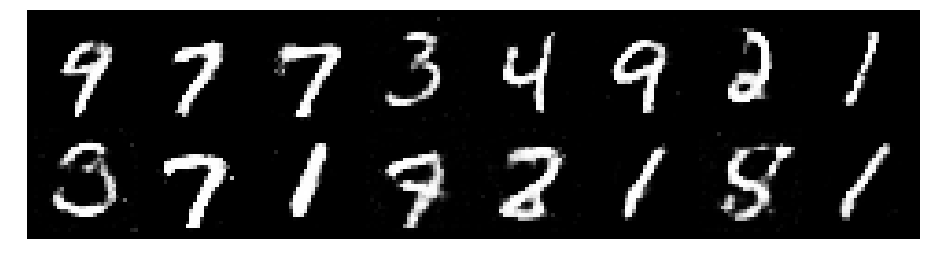

Epoch: [198/200], Batch Num: [0/600]
Discriminator Loss: 1.2797, Generator Loss: 0.8295
D(x): 0.5554, D(G(z)): 0.4427


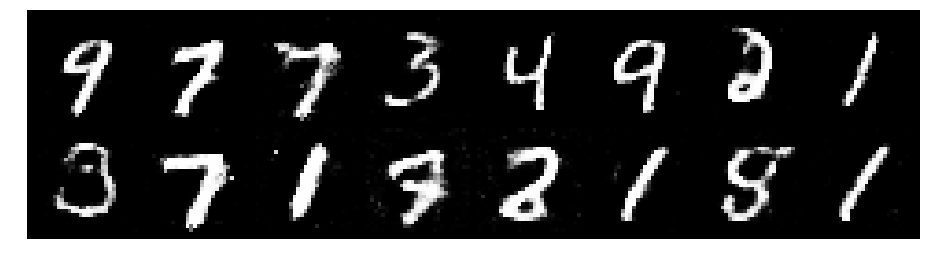

Epoch: [198/200], Batch Num: [100/600]
Discriminator Loss: 1.2668, Generator Loss: 0.9707
D(x): 0.5468, D(G(z)): 0.4296


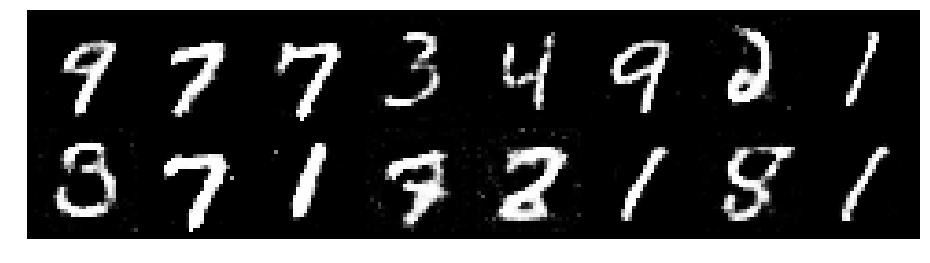

Epoch: [198/200], Batch Num: [200/600]
Discriminator Loss: 1.1963, Generator Loss: 0.9899
D(x): 0.5629, D(G(z)): 0.4043


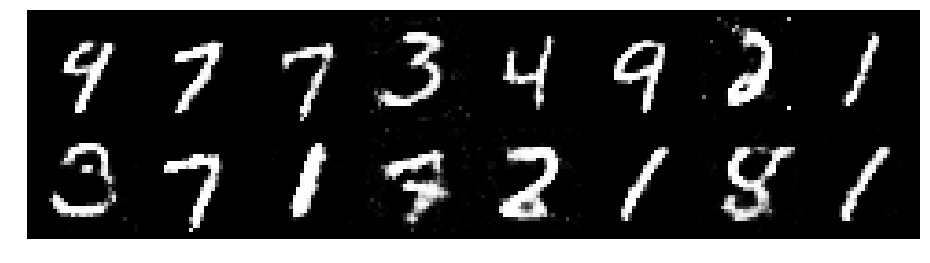

Epoch: [198/200], Batch Num: [300/600]
Discriminator Loss: 1.1710, Generator Loss: 0.8653
D(x): 0.5752, D(G(z)): 0.4237


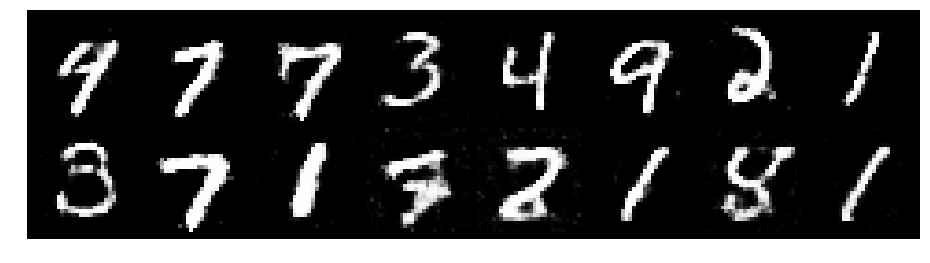

Epoch: [198/200], Batch Num: [400/600]
Discriminator Loss: 1.2705, Generator Loss: 0.7949
D(x): 0.5546, D(G(z)): 0.4558


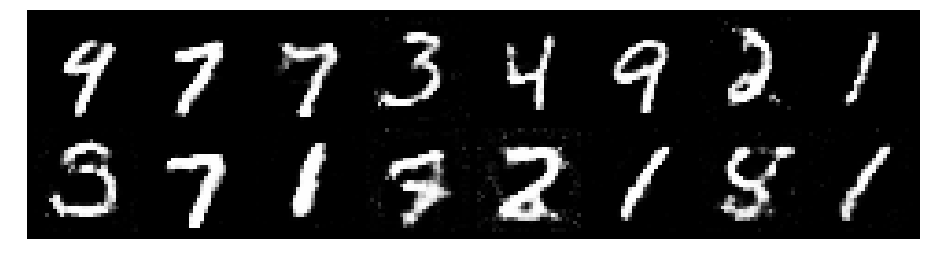

Epoch: [198/200], Batch Num: [500/600]
Discriminator Loss: 1.2351, Generator Loss: 0.8860
D(x): 0.5798, D(G(z)): 0.4535


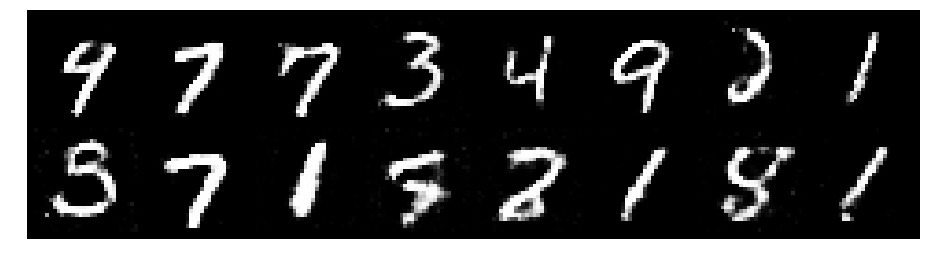

Epoch: [199/200], Batch Num: [0/600]
Discriminator Loss: 1.2430, Generator Loss: 0.9168
D(x): 0.5602, D(G(z)): 0.4294


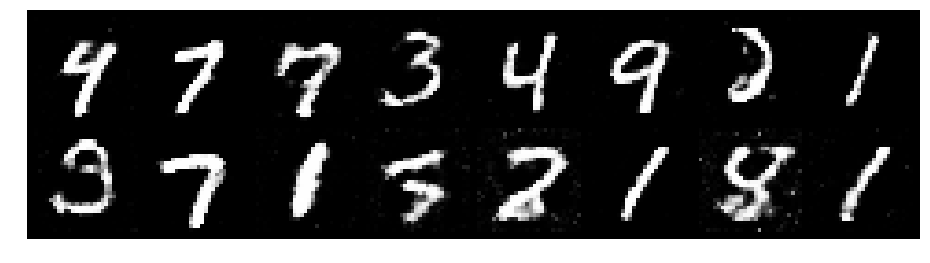

Epoch: [199/200], Batch Num: [100/600]
Discriminator Loss: 1.2844, Generator Loss: 0.8911
D(x): 0.5409, D(G(z)): 0.4408


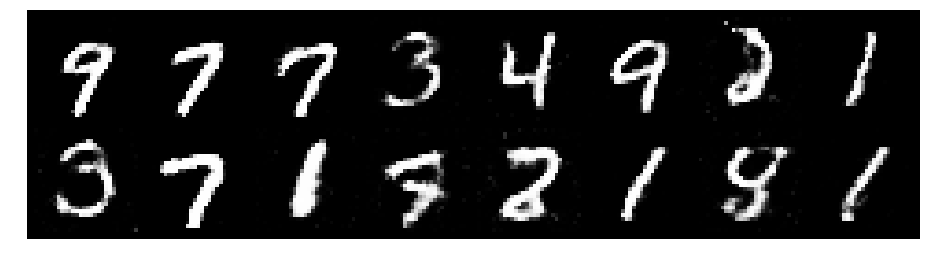

Epoch: [199/200], Batch Num: [200/600]
Discriminator Loss: 1.3162, Generator Loss: 0.8232
D(x): 0.5603, D(G(z)): 0.4655


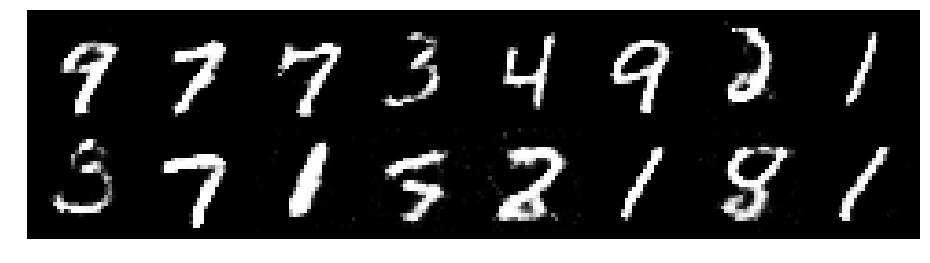

Epoch: [199/200], Batch Num: [300/600]
Discriminator Loss: 1.2416, Generator Loss: 0.7549
D(x): 0.5882, D(G(z)): 0.4679


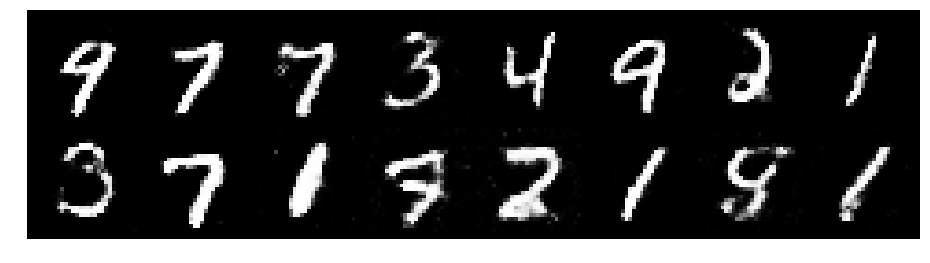

Epoch: [199/200], Batch Num: [400/600]
Discriminator Loss: 1.2690, Generator Loss: 0.9002
D(x): 0.5598, D(G(z)): 0.4613


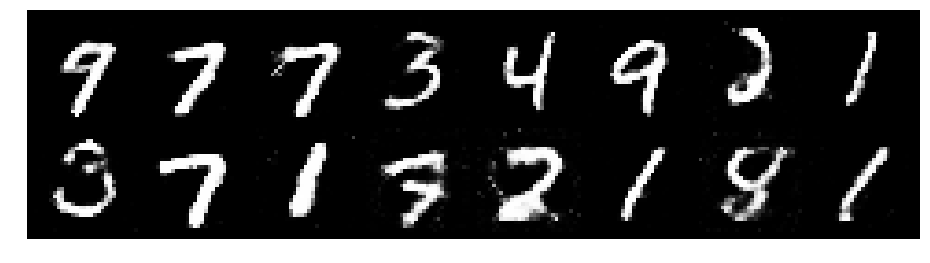

Epoch: [199/200], Batch Num: [500/600]
Discriminator Loss: 1.2200, Generator Loss: 0.8751
D(x): 0.5637, D(G(z)): 0.4205


In [19]:
for epoch in range(num_epochs):
    for batch_num, (real_batch,_) in enumerate(data_loader):
        
        N = len(real_batch)
        
        #Training discriminator
        real_images = Variable(image_to_vec(real_batch))
        fake_images = generator(create_noise(N)).detach() #To avoid calculating generator's gradients
        D_error,D_preds_real, D_preds_fake = train_discriminator(disc_optim,real_images,fake_images)
        
        #Training generator
        fake_images = generator(create_noise(N))
        G_error = train_generator(gen_optim,fake_images)
        
        #Logging error
        logger.log(D_error,G_error,epoch,batch_num,total_batches)
        
        #Displaying images after every few iterations
        if batch_num%100 == 0:
#             display.clear_output(True) # To clear output screen 
            test_images = vec_to_image(generator(test_noise))
            test_images = test_images.data
            
            logger.log_images(test_images,num_test_samples,epoch,batch_num,total_batches)
            logger.display_status(epoch,num_epochs,batch_num,total_batches,D_error,G_error,D_preds_real,D_preds_fake)
        
        logger.save_models(generator,discriminator,epoch)
